In [1]:
import tensorflow as tf
tf.__version__
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 6148636393364688219,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 758745297481376105
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 6918604064
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 10750230965741531589
 physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 2080 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 985435361489189970
 physical_device_desc: "device: XLA_GPU device"]

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [3]:
tf.debugging.set_log_device_placement(True)

a = tf.constant([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])
b = tf.constant([[1.0, 2.0], [3.0, 4.0], [5.0, 6.0]])
c = tf.matmul(a, b)
print(c)

Executing op MatMul in device /job:localhost/replica:0/task:0/device:GPU:0
tf.Tensor(
[[22. 28.]
 [49. 64.]], shape=(2, 2), dtype=float32)


In [4]:
import keras
from keras.models import Sequential, Model
from keras import layers, applications, optimizers
from keras.layers import Conv2D, MaxPool2D, AveragePooling2D, Dropout, Flatten, Dense, Activation, GlobalAveragePooling2D, GlobalMaxPooling2D, Input, concatenate
from keras.preprocessing.image import ImageDataGenerator, load_img

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import random

In [5]:
epochs = 100
batch_size = 5
image_size = 224

In [6]:
#load train data(25000 imgs each)

filenames = os.listdir('./input/train/train')
data = []
categories = []

for filename in filenames:
    category = filename.split('.')[0]
    if category == 'dog':
        categories.append(1)
    else:
        categories.append(0)
    
    image = keras.preprocessing.image.load_img(os.path.join('./input/train/train', filename),
                                               color_mode='rgb',
                                               target_size= (image_size,image_size))
    image = np.array(image)
    data.append(image)

data = np.array(data)
categories = np.array(categories)

print(data)
print(categories)

[[[[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 203 119]
   [241 202 123]
   [239 200 121]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 205 120]
   [242 203 124]
   [240 201 122]]

  [[203 164  87]
   [206 167  90]
   [209 170  93]
   ...
   [245 204 122]
   [243 204 125]
   [241 202 123]]

  ...

  [[154 123  56]
   [155 124  57]
   [156 125  58]
   ...
   [  3   3   1]
   [  3   3   1]
   [  3   3   1]]

  [[153 122  55]
   [153 122  55]
   [154 123  56]
   ...
   [  2   2   0]
   [  2   2   0]
   [  2   2   0]]

  [[151 120  53]
   [152 121  54]
   [153 122  55]
   ...
   [  1   1   0]
   [  1   1   0]
   [  1   1   0]]]


 [[[ 39  44  40]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [210 209 181]
   [207 204 171]
   [201 199 161]]

  [[ 40  45  41]
   [ 40  44  43]
   [ 41  45  46]
   ...
   [207 203 176]
   [203 200 169]
   [197 195 157]]

  [[ 39  44  40]
   [ 38  42  41]
   [ 37  41  42]
   ...
   [195 191 166]
   [198 193 164]
   [205 200

In [7]:
# shuffle dataset

idx = np.random.permutation(len(data))
data, categories = data[idx], categories[idx]

In [8]:
# split train 6(15,000) / val 2(5,000) / test 2(5,000)

x_train = data[:15000]
y_train = categories[:15000]
x_temp, y_temp = data[-10000:], categories[-10000:]

from sklearn.model_selection import train_test_split

x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5)

In [9]:
print(x_train, y_train)

print(x_temp, y_temp)
print(x_temp.shape, y_temp.shape)

print(x_val, y_val)

print(x_test, y_test)
print(x_test.shape, y_test.shape)

[[[[121 159 146]
   [123 168 135]
   [105 157 108]
   ...
   [127 195 118]
   [115 180 124]
   [ 93 158 102]]

  [[154 201 183]
   [ 90 137 101]
   [129 177 127]
   ...
   [178 249 171]
   [120 182 131]
   [ 99 161 110]]

  [[115 175 147]
   [137 192 152]
   [116 162 113]
   ...
   [162 236 157]
   [159 218 172]
   [140 199 153]]

  ...

  [[181 246 222]
   [157 218 202]
   [ 32  94  45]
   ...
   [ 62 101  54]
   [ 66 133  89]
   [144 211 167]]

  [[175 240 220]
   [154 214 202]
   [ 51 112  68]
   ...
   [ 68 107  60]
   [ 90 153 106]
   [120 183 136]]

  [[182 246 232]
   [168 228 220]
   [ 97 157 119]
   ...
   [101 143  97]
   [109 169 118]
   [107 167 116]]]


 [[[ 68  80  60]
   [ 77  88  71]
   [131 142 125]
   ...
   [172 155 139]
   [177 160 142]
   [213 194 177]]

  [[ 68  80  60]
   [ 77  88  71]
   [131 142 125]
   ...
   [172 155 139]
   [177 160 142]
   [213 194 177]]

  [[ 25  37  17]
   [ 18  29  12]
   [ 93 104  88]
   ...
   [206 189 173]
   [118 101  83]
   [180 161

In [10]:
# data augmentation in train set (train 15,000 to 75,000)

x_train_temp = x_train
y_train_temp = y_train

x_train_aug = []
y_train_aug = []

for img, label in zip(x_train_temp, y_train_temp):
    curImg = img
    
    flipped1 = tf.image.flip_left_right(curImg)
    flipped2 = tf.image.flip_up_down(curImg)
    
    x_train_aug.append(flipped1)
    x_train_aug.append(flipped2)
    
    for i in range(3):
        cropped = curImg[random.randrange(0,100):random.randrange(180,225), random.randrange(0,100):random.randrange(180,225)]
        cropped = cv2.resize(cropped, (image_size, image_size))
        x_train_aug.append(cropped)
    
    for i in range(0, 5):
        y_train_aug.append(label)
        
x_train_aug = np.array(x_train_aug)
y_train_aug = np.array(y_train_aug)

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReverseV2 in device /job:localhost/replica:0/task:0

In [11]:
x_train = np.concatenate((x_train, x_train_aug))
y_train = np.concatenate((y_train, y_train_aug))

In [12]:
def inception_module(x,
                     filters_1x1,
                     filters_3x3_reduce,
                     filters_3x3,
                     filters_5x5_reduce,
                     filters_5x5,
                     filters_pool_proj,
                     name=None):
    
    conv_1x1 = Conv2D(filters_1x1, (1, 1), padding='same', activation='relu',
                      kernel_initializer=kernel_init, bias_initializer=bias_init)(x)
    
    conv_3x3 = Conv2D(filters_3x3_reduce, (1, 1), padding='same', activation='relu',
                      kernel_initializer=kernel_init, bias_initializer=bias_init)(x)
    conv_3x3 = Conv2D(filters_3x3, (3, 3), padding='same', activation='relu',
                      kernel_initializer=kernel_init, bias_initializer=bias_init)(conv_3x3)

    conv_5x5 = Conv2D(filters_5x5_reduce, (1, 1), padding='same', activation='relu',
                      kernel_initializer=kernel_init, bias_initializer=bias_init)(x)
    conv_5x5 = Conv2D(filters_5x5, (5, 5), padding='same', activation='relu',
                      kernel_initializer=kernel_init, bias_initializer=bias_init)(conv_5x5)

    pool_proj = MaxPool2D((3, 3), strides=(1, 1), padding='same')(x)
    pool_proj = Conv2D(filters_pool_proj, (1, 1), padding='same', activation='relu',
                       kernel_initializer=kernel_init, bias_initializer=bias_init)(pool_proj)

    module = concatenate([conv_1x1, conv_3x3, conv_5x5, pool_proj], axis=3, name=name)
    
    return module

In [13]:
kernel_init = keras.initializers.glorot_uniform()
bias_init = keras.initializers.Constant(0.2)

In [14]:
input_layer = Input(shape=(image_size, image_size, 3))

x = Conv2D(64, (7, 7), padding='same', strides=(2, 2), activation='relu', name='conv_1_7x7/2',
           kernel_initializer=kernel_init, bias_initializer=bias_init)(input_layer)
x = MaxPool2D((3, 3), padding='same', strides=(2, 2), name='max_pool_1_3x3/2')(x)
x = Conv2D(64, (1, 1), padding='same', strides=(1, 1), activation='relu', name='conv_2a_3x3/1')(x)
x = Conv2D(192, (3, 3), padding='same', strides=(1, 1), activation='relu', name='conv_2b_3x3/1')(x)
x = MaxPool2D((3, 3), padding='same', strides=(2, 2), name='max_pool_2_3x3/2')(x)

x = inception_module(x, filters_1x1=64, filters_3x3_reduce=96, filters_3x3=128,
                     filters_5x5_reduce=16, filters_5x5=32, filters_pool_proj=32,
                     name='inception_3a')

x = inception_module(x, filters_1x1=128, filters_3x3_reduce=128, filters_3x3=192,
                     filters_5x5_reduce=32, filters_5x5=96, filters_pool_proj=64,
                     name='inception_3b')

x = MaxPool2D((3, 3), padding='same', strides=(2, 2), name='max_pool_3_3x3/2')(x)

x = inception_module(x, filters_1x1=192, filters_3x3_reduce=96, filters_3x3=208,
                     filters_5x5_reduce=16, filters_5x5=48, filters_pool_proj=64,
                     name='inception_4a')


x1 = AveragePooling2D((5, 5), strides=3)(x)
x1 = Conv2D(128, (1, 1), padding='same', activation='relu')(x1)
x1 = Flatten()(x1)
x1 = Dense(1024, activation='relu')(x1)
x1 = Dropout(0.7)(x1)
x1 = Dense(2, activation='softmax', name='auxilliary_output_1')(x1)

x = inception_module(x, filters_1x1=160, filters_3x3_reduce=112, filters_3x3=224,
                     filters_5x5_reduce=24, filters_5x5=64, filters_pool_proj=64,
                     name='inception_4b')

x = inception_module(x, filters_1x1=128, filters_3x3_reduce=128, filters_3x3=256,
                     filters_5x5_reduce=24, filters_5x5=64, filters_pool_proj=64,
                     name='inception_4c')

x = inception_module(x, filters_1x1=112, filters_3x3_reduce=144, filters_3x3=288,
                     filters_5x5_reduce=32, filters_5x5=64, filters_pool_proj=64,
                     name='inception_4d')


x2 = AveragePooling2D((5, 5), strides=3)(x)
x2 = Conv2D(128, (1, 1), padding='same', activation='relu')(x2)
x2 = Flatten()(x2)
x2 = Dense(1024, activation='relu')(x2)
x2 = Dropout(0.7)(x2)
x2 = Dense(2, activation='softmax', name='auxilliary_output_2')(x2)

x = inception_module(x, filters_1x1=256, filters_3x3_reduce=160, filters_3x3=320,
                     filters_5x5_reduce=32, filters_5x5=128, filters_pool_proj=128,
                     name='inception_4e')

x = MaxPool2D((3, 3), padding='same', strides=(2, 2), name='max_pool_4_3x3/2')(x)

x = inception_module(x, filters_1x1=256, filters_3x3_reduce=160, filters_3x3=320,
                     filters_5x5_reduce=32, filters_5x5=128, filters_pool_proj=128,
                     name='inception_5a')

x = inception_module(x, filters_1x1=384, filters_3x3_reduce=192, filters_3x3=384,
                     filters_5x5_reduce=48, filters_5x5=128, filters_pool_proj=128,
                     name='inception_5b')

x = GlobalAveragePooling2D(name='avg_pool_5_3x3/1')(x)

x = Dropout(0.4)(x)

x = Dense(2, activation='softmax', name='output')(x)


Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/r

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/tas

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/repli

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/r

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/tas

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Add in device /job:localhost/replica:0/task

In [15]:
%load_ext tensorboard

import datetime

In [16]:
model = Model(input_layer, [x, x1, x2], name='inception_v1')

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalN

In [17]:
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9, clipnorm=1.),
    metrics=['accuracy']
)

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

In [18]:
model.summary()

Model: "inception_v1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv_1_7x7/2 (Conv2D)           (None, 112, 112, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
max_pool_1_3x3/2 (MaxPooling2D) (None, 56, 56, 64)   0           conv_1_7x7/2[0][0]               
__________________________________________________________________________________________________
conv_2a_3x3/1 (Conv2D)          (None, 56, 56, 64)   4160        max_pool_1_3x3/2[0][0]           
_______________________________________________________________________________________

Total params: 10,309,430
Trainable params: 10,309,430
Non-trainable params: 0
__________________________________________________________________________________________________


In [19]:
log_dir = "logs/inception_da_new/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [20]:
from keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler

early_stopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10)
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

In [21]:
def scheduler(epoch, lr):
   if epoch < 10:
     return lr
   else:
     return lr * 0.96
    
lr_scheduler = tf.keras.callbacks.LearningRateScheduler(scheduler)

In [22]:
%tensorboard --logdir logs/inception_da_new

Reusing TensorBoard on port 6006 (pid 18636), started 10:52:54 ago. (Use '!kill 18636' to kill it.)

In [23]:
# without early stopping

epochs = 30

history = model.fit(
    x_train, y_train,
    epochs=epochs,
    validation_data=(x_val, y_val),
    # validation_steps=x_val.size//batch_size,
    # steps_per_epoch=x_train.size//batch_size,
    verbose=1,
    callbacks=[tensorboard_callback, lr_scheduler]
)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Add in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op SummaryWriter 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:lo

Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device 

Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:loc

Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localho

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /j

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost

  27/2813 [..............................] - ETA: 3:03 - loss: 3.0399 - output_loss: 0.8298 - auxilliary_output_1_loss: 1.2360 - auxilliary_output_2_loss: 0.9741 - output_accuracy: 0.5347 - auxilliary_output_1_accuracy: 0.4873 - auxilliary_output_2_accuracy: 0.5035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  49/2813 [..............................] - ETA: 3:01 - loss: 2.6665 - output_loss: 0.8038 - auxilliary_output_1_loss: 1.0062 - auxilliary_output_2_loss: 0.8565 - output_accuracy: 0.5102 - auxilliary_output_1_accuracy: 0.4853 - auxilliary_output_2_accuracy: 0.5083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  71/2813 [..............................] - ETA: 2:59 - loss: 2.5095 - output_loss: 0.7861 - auxilliary_output_1_loss: 0.9143 - auxilliary_output_2_loss: 0.8091 - output_accuracy: 0.5057 - auxilliary_output_1_accuracy: 0.4789 - auxilliary_output_2_accuracy: 0.5106Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  93/2813 [..............................] - ETA: 2:58 - loss: 2.4212 - output_loss: 0.7750 - auxilliary_output_1_loss: 0.8625 - auxilliary_output_2_loss: 0.7837 - output_accuracy: 0.5017 - auxilliary_output_1_accuracy: 0.4805 - auxilliary_output_2_accuracy: 0.5138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 115/2813 [>.............................] - ETA: 2:56 - loss: 2.3653 - output_loss: 0.7679 - auxilliary_output_1_loss: 0.8306 - auxilliary_output_2_loss: 0.7668 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4845 - auxilliary_output_2_accuracy: 0.5128Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 137/2813 [>.............................] - ETA: 2:55 - loss: 2.3240 - output_loss: 0.7599 - auxilliary_output_1_loss: 0.8086 - auxilliary_output_2_loss: 0.7554 - output_accuracy: 0.4925 - auxilliary_output_1_accuracy: 0.4879 - auxilliary_output_2_accuracy: 0.5144Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 159/2813 [>.............................] - ETA: 2:53 - loss: 2.2960 - output_loss: 0.7558 - auxilliary_output_1_loss: 0.7930 - auxilliary_output_2_loss: 0.7472 - output_accuracy: 0.4894 - auxilliary_output_1_accuracy: 0.4837 - auxilliary_output_2_accuracy: 0.5085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 181/2813 [>.............................] - ETA: 2:52 - loss: 2.2746 - output_loss: 0.7531 - auxilliary_output_1_loss: 0.7809 - auxilliary_output_2_loss: 0.7406 - output_accuracy: 0.4907 - auxilliary_output_1_accuracy: 0.4860 - auxilliary_output_2_accuracy: 0.5086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 203/2813 [=>............................] - ETA: 2:50 - loss: 2.2549 - output_loss: 0.7479 - auxilliary_output_1_loss: 0.7714 - auxilliary_output_2_loss: 0.7355 - output_accuracy: 0.4929 - auxilliary_output_1_accuracy: 0.4855 - auxilliary_output_2_accuracy: 0.5080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 225/2813 [=>............................] - ETA: 2:49 - loss: 2.2384 - output_loss: 0.7431 - auxilliary_output_1_loss: 0.7639 - auxilliary_output_2_loss: 0.7314 - output_accuracy: 0.4979 - auxilliary_output_1_accuracy: 0.4889 - auxilliary_output_2_accuracy: 0.5106Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 247/2813 [=>............................] - ETA: 2:47 - loss: 2.2255 - output_loss: 0.7395 - auxilliary_output_1_loss: 0.7578 - auxilliary_output_2_loss: 0.7283 - output_accuracy: 0.4995 - auxilliary_output_1_accuracy: 0.4876 - auxilliary_output_2_accuracy: 0.5090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 269/2813 [=>............................] - ETA: 2:46 - loss: 2.2151 - output_loss: 0.7371 - auxilliary_output_1_loss: 0.7526 - auxilliary_output_2_loss: 0.7255 - output_accuracy: 0.4998 - auxilliary_output_1_accuracy: 0.4879 - auxilliary_output_2_accuracy: 0.5085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 291/2813 [==>...........................] - ETA: 2:44 - loss: 2.2057 - output_loss: 0.7343 - auxilliary_output_1_loss: 0.7482 - auxilliary_output_2_loss: 0.7232 - output_accuracy: 0.5001 - auxilliary_output_1_accuracy: 0.4878 - auxilliary_output_2_accuracy: 0.5083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 313/2813 [==>...........................] - ETA: 2:43 - loss: 2.1979 - output_loss: 0.7324 - auxilliary_output_1_loss: 0.7443 - auxilliary_output_2_loss: 0.7212 - output_accuracy: 0.4993 - auxilliary_output_1_accuracy: 0.4879 - auxilliary_output_2_accuracy: 0.5074Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 335/2813 [==>...........................] - ETA: 2:42 - loss: 2.1905 - output_loss: 0.7301 - auxilliary_output_1_loss: 0.7410 - auxilliary_output_2_loss: 0.7194 - output_accuracy: 0.5005 - auxilliary_output_1_accuracy: 0.4883 - auxilliary_output_2_accuracy: 0.5082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 357/2813 [==>...........................] - ETA: 2:40 - loss: 2.1847 - output_loss: 0.7289 - auxilliary_output_1_loss: 0.7382 - auxilliary_output_2_loss: 0.7177 - output_accuracy: 0.4979 - auxilliary_output_1_accuracy: 0.4880 - auxilliary_output_2_accuracy: 0.5086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 379/2813 [===>..........................] - ETA: 2:39 - loss: 2.1799 - output_loss: 0.7279 - auxilliary_output_1_loss: 0.7356 - auxilliary_output_2_loss: 0.7164 - output_accuracy: 0.4985 - auxilliary_output_1_accuracy: 0.4891 - auxilliary_output_2_accuracy: 0.5058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 401/2813 [===>..........................] - ETA: 2:37 - loss: 2.1755 - output_loss: 0.7271 - auxilliary_output_1_loss: 0.7333 - auxilliary_output_2_loss: 0.7151 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4901 - auxilliary_output_2_accuracy: 0.5058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 423/2813 [===>..........................] - ETA: 2:36 - loss: 2.1711 - output_loss: 0.7259 - auxilliary_output_1_loss: 0.7312 - auxilliary_output_2_loss: 0.7140 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4918 - auxilliary_output_2_accuracy: 0.5052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 445/2813 [===>..........................] - ETA: 2:34 - loss: 2.1669 - output_loss: 0.7246 - auxilliary_output_1_loss: 0.7293 - auxilliary_output_2_loss: 0.7130 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4926 - auxilliary_output_2_accuracy: 0.5049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 467/2813 [===>..........................] - ETA: 2:33 - loss: 2.1630 - output_loss: 0.7234 - auxilliary_output_1_loss: 0.7276 - auxilliary_output_2_loss: 0.7120 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4930 - auxilliary_output_2_accuracy: 0.5057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 489/2813 [====>.........................] - ETA: 2:31 - loss: 2.1597 - output_loss: 0.7224 - auxilliary_output_1_loss: 0.7261 - auxilliary_output_2_loss: 0.7112 - output_accuracy: 0.4971 - auxilliary_output_1_accuracy: 0.4934 - auxilliary_output_2_accuracy: 0.5046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 511/2813 [====>.........................] - ETA: 2:30 - loss: 2.1565 - output_loss: 0.7214 - auxilliary_output_1_loss: 0.7246 - auxilliary_output_2_loss: 0.7105 - output_accuracy: 0.4976 - auxilliary_output_1_accuracy: 0.4948 - auxilliary_output_2_accuracy: 0.5039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 533/2813 [====>.........................] - ETA: 2:28 - loss: 2.1537 - output_loss: 0.7205 - auxilliary_output_1_loss: 0.7234 - auxilliary_output_2_loss: 0.7098 - output_accuracy: 0.4974 - auxilliary_output_1_accuracy: 0.4945 - auxilliary_output_2_accuracy: 0.5025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 555/2813 [====>.........................] - ETA: 2:27 - loss: 2.1517 - output_loss: 0.7204 - auxilliary_output_1_loss: 0.7222 - auxilliary_output_2_loss: 0.7091 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4952 - auxilliary_output_2_accuracy: 0.5028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 577/2813 [=====>........................] - ETA: 2:25 - loss: 2.1493 - output_loss: 0.7197 - auxilliary_output_1_loss: 0.7211 - auxilliary_output_2_loss: 0.7085 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4959 - auxilliary_output_2_accuracy: 0.5024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 599/2813 [=====>........................] - ETA: 2:24 - loss: 2.1472 - output_loss: 0.7190 - auxilliary_output_1_loss: 0.7201 - auxilliary_output_2_loss: 0.7080 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4945 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 621/2813 [=====>........................] - ETA: 2:23 - loss: 2.1450 - output_loss: 0.7183 - auxilliary_output_1_loss: 0.7192 - auxilliary_output_2_loss: 0.7075 - output_accuracy: 0.4951 - auxilliary_output_1_accuracy: 0.4950 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 643/2813 [=====>........................] - ETA: 2:21 - loss: 2.1430 - output_loss: 0.7176 - auxilliary_output_1_loss: 0.7183 - auxilliary_output_2_loss: 0.7070 - output_accuracy: 0.4947 - auxilliary_output_1_accuracy: 0.4940 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 665/2813 [======>.......................] - ETA: 2:20 - loss: 2.1411 - output_loss: 0.7169 - auxilliary_output_1_loss: 0.7176 - auxilliary_output_2_loss: 0.7066 - output_accuracy: 0.4944 - auxilliary_output_1_accuracy: 0.4933 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 687/2813 [======>.......................] - ETA: 2:18 - loss: 2.1391 - output_loss: 0.7162 - auxilliary_output_1_loss: 0.7167 - auxilliary_output_2_loss: 0.7061 - output_accuracy: 0.4945 - auxilliary_output_1_accuracy: 0.4944 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 709/2813 [======>.......................] - ETA: 2:17 - loss: 2.1377 - output_loss: 0.7158 - auxilliary_output_1_loss: 0.7161 - auxilliary_output_2_loss: 0.7058 - output_accuracy: 0.4946 - auxilliary_output_1_accuracy: 0.4946 - auxilliary_output_2_accuracy: 0.5015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 731/2813 [======>.......................] - ETA: 2:15 - loss: 2.1360 - output_loss: 0.7153 - auxilliary_output_1_loss: 0.7154 - auxilliary_output_2_loss: 0.7054 - output_accuracy: 0.4943 - auxilliary_output_1_accuracy: 0.4952 - auxilliary_output_2_accuracy: 0.5021Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 753/2813 [=======>......................] - ETA: 2:14 - loss: 2.1345 - output_loss: 0.7147 - auxilliary_output_1_loss: 0.7147 - auxilliary_output_2_loss: 0.7051 - output_accuracy: 0.4949 - auxilliary_output_1_accuracy: 0.4954 - auxilliary_output_2_accuracy: 0.5018Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 775/2813 [=======>......................] - ETA: 2:12 - loss: 2.1332 - output_loss: 0.7143 - auxilliary_output_1_loss: 0.7141 - auxilliary_output_2_loss: 0.7047 - output_accuracy: 0.4948 - auxilliary_output_1_accuracy: 0.4959 - auxilliary_output_2_accuracy: 0.5019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 797/2813 [=======>......................] - ETA: 2:11 - loss: 2.1320 - output_loss: 0.7139 - auxilliary_output_1_loss: 0.7136 - auxilliary_output_2_loss: 0.7045 - output_accuracy: 0.4951 - auxilliary_output_1_accuracy: 0.4954 - auxilliary_output_2_accuracy: 0.5007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 819/2813 [=======>......................] - ETA: 2:10 - loss: 2.1307 - output_loss: 0.7135 - auxilliary_output_1_loss: 0.7130 - auxilliary_output_2_loss: 0.7042 - output_accuracy: 0.4947 - auxilliary_output_1_accuracy: 0.4955 - auxilliary_output_2_accuracy: 0.5007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 841/2813 [=======>......................] - ETA: 2:08 - loss: 2.1296 - output_loss: 0.7131 - auxilliary_output_1_loss: 0.7125 - auxilliary_output_2_loss: 0.7039 - output_accuracy: 0.4946 - auxilliary_output_1_accuracy: 0.4955 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 863/2813 [========>.....................] - ETA: 2:07 - loss: 2.1283 - output_loss: 0.7126 - auxilliary_output_1_loss: 0.7120 - auxilliary_output_2_loss: 0.7037 - output_accuracy: 0.4950 - auxilliary_output_1_accuracy: 0.4953 - auxilliary_output_2_accuracy: 0.5005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 885/2813 [========>.....................] - ETA: 2:05 - loss: 2.1272 - output_loss: 0.7122 - auxilliary_output_1_loss: 0.7116 - auxilliary_output_2_loss: 0.7035 - output_accuracy: 0.4953 - auxilliary_output_1_accuracy: 0.4948 - auxilliary_output_2_accuracy: 0.5001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 907/2813 [========>.....................] - ETA: 2:04 - loss: 2.1261 - output_loss: 0.7117 - auxilliary_output_1_loss: 0.7112 - auxilliary_output_2_loss: 0.7032 - output_accuracy: 0.4955 - auxilliary_output_1_accuracy: 0.4950 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 929/2813 [========>.....................] - ETA: 2:02 - loss: 2.1250 - output_loss: 0.7113 - auxilliary_output_1_loss: 0.7108 - auxilliary_output_2_loss: 0.7030 - output_accuracy: 0.4959 - auxilliary_output_1_accuracy: 0.4951 - auxilliary_output_2_accuracy: 0.4998Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 951/2813 [=========>....................] - ETA: 2:01 - loss: 2.1240 - output_loss: 0.7109 - auxilliary_output_1_loss: 0.7104 - auxilliary_output_2_loss: 0.7028 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4954 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 973/2813 [=========>....................] - ETA: 2:00 - loss: 2.1231 - output_loss: 0.7106 - auxilliary_output_1_loss: 0.7100 - auxilliary_output_2_loss: 0.7025 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4956 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 995/2813 [=========>....................] - ETA: 1:58 - loss: 2.1221 - output_loss: 0.7102 - auxilliary_output_1_loss: 0.7096 - auxilliary_output_2_loss: 0.7023 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4958 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1017/2813 [=========>....................] - ETA: 1:57 - loss: 2.1212 - output_loss: 0.7099 - auxilliary_output_1_loss: 0.7092 - auxilliary_output_2_loss: 0.7021 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4960 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1039/2813 [==========>...................] - ETA: 1:55 - loss: 2.1204 - output_loss: 0.7096 - auxilliary_output_1_loss: 0.7089 - auxilliary_output_2_loss: 0.7019 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4959 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1061/2813 [==========>...................] - ETA: 1:54 - loss: 2.1196 - output_loss: 0.7093 - auxilliary_output_1_loss: 0.7086 - auxilliary_output_2_loss: 0.7017 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.5013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1083/2813 [==========>...................] - ETA: 1:52 - loss: 2.1188 - output_loss: 0.7090 - auxilliary_output_1_loss: 0.7083 - auxilliary_output_2_loss: 0.7015 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1105/2813 [==========>...................] - ETA: 1:51 - loss: 2.1181 - output_loss: 0.7087 - auxilliary_output_1_loss: 0.7080 - auxilliary_output_2_loss: 0.7014 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1127/2813 [===========>..................] - ETA: 1:50 - loss: 2.1174 - output_loss: 0.7084 - auxilliary_output_1_loss: 0.7077 - auxilliary_output_2_loss: 0.7013 - output_accuracy: 0.4960 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1149/2813 [===========>..................] - ETA: 1:48 - loss: 2.1167 - output_loss: 0.7082 - auxilliary_output_1_loss: 0.7074 - auxilliary_output_2_loss: 0.7011 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1171/2813 [===========>..................] - ETA: 1:47 - loss: 2.1161 - output_loss: 0.7079 - auxilliary_output_1_loss: 0.7072 - auxilliary_output_2_loss: 0.7010 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4966 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1193/2813 [===========>..................] - ETA: 1:45 - loss: 2.1155 - output_loss: 0.7077 - auxilliary_output_1_loss: 0.7069 - auxilliary_output_2_loss: 0.7008 - output_accuracy: 0.4954 - auxilliary_output_1_accuracy: 0.4966 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1215/2813 [===========>..................] - ETA: 1:44 - loss: 2.1148 - output_loss: 0.7074 - auxilliary_output_1_loss: 0.7067 - auxilliary_output_2_loss: 0.7007 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4972 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1237/2813 [============>.................] - ETA: 1:42 - loss: 2.1144 - output_loss: 0.7073 - auxilliary_output_1_loss: 0.7065 - auxilliary_output_2_loss: 0.7006 - output_accuracy: 0.4954 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1259/2813 [============>.................] - ETA: 1:41 - loss: 2.1138 - output_loss: 0.7071 - auxilliary_output_1_loss: 0.7062 - auxilliary_output_2_loss: 0.7005 - output_accuracy: 0.4951 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1281/2813 [============>.................] - ETA: 1:40 - loss: 2.1132 - output_loss: 0.7068 - auxilliary_output_1_loss: 0.7060 - auxilliary_output_2_loss: 0.7004 - output_accuracy: 0.4957 - auxilliary_output_1_accuracy: 0.4969 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1303/2813 [============>.................] - ETA: 1:38 - loss: 2.1127 - output_loss: 0.7066 - auxilliary_output_1_loss: 0.7058 - auxilliary_output_2_loss: 0.7003 - output_accuracy: 0.4959 - auxilliary_output_1_accuracy: 0.4971 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1325/2813 [=============>................] - ETA: 1:37 - loss: 2.1121 - output_loss: 0.7064 - auxilliary_output_1_loss: 0.7056 - auxilliary_output_2_loss: 0.7002 - output_accuracy: 0.4958 - auxilliary_output_1_accuracy: 0.4972 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1347/2813 [=============>................] - ETA: 1:35 - loss: 2.1117 - output_loss: 0.7062 - auxilliary_output_1_loss: 0.7054 - auxilliary_output_2_loss: 0.7001 - output_accuracy: 0.4959 - auxilliary_output_1_accuracy: 0.4969 - auxilliary_output_2_accuracy: 0.5007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1369/2813 [=============>................] - ETA: 1:34 - loss: 2.1112 - output_loss: 0.7060 - auxilliary_output_1_loss: 0.7052 - auxilliary_output_2_loss: 0.7000 - output_accuracy: 0.4959 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1391/2813 [=============>................] - ETA: 1:32 - loss: 2.1108 - output_loss: 0.7058 - auxilliary_output_1_loss: 0.7051 - auxilliary_output_2_loss: 0.6999 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4964 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1413/2813 [==============>...............] - ETA: 1:31 - loss: 2.1104 - output_loss: 0.7057 - auxilliary_output_1_loss: 0.7049 - auxilliary_output_2_loss: 0.6998 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4966 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1435/2813 [==============>...............] - ETA: 1:30 - loss: 2.1099 - output_loss: 0.7055 - auxilliary_output_1_loss: 0.7047 - auxilliary_output_2_loss: 0.6997 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4970 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1457/2813 [==============>...............] - ETA: 1:28 - loss: 2.1095 - output_loss: 0.7053 - auxilliary_output_1_loss: 0.7045 - auxilliary_output_2_loss: 0.6996 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1479/2813 [==============>...............] - ETA: 1:27 - loss: 2.1091 - output_loss: 0.7052 - auxilliary_output_1_loss: 0.7044 - auxilliary_output_2_loss: 0.6995 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.5000Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1501/2813 [===============>..............] - ETA: 1:25 - loss: 2.1087 - output_loss: 0.7050 - auxilliary_output_1_loss: 0.7042 - auxilliary_output_2_loss: 0.6995 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4966 - auxilliary_output_2_accuracy: 0.4995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1523/2813 [===============>..............] - ETA: 1:24 - loss: 2.1083 - output_loss: 0.7049 - auxilliary_output_1_loss: 0.7041 - auxilliary_output_2_loss: 0.6994 - output_accuracy: 0.4960 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4993Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1545/2813 [===============>..............] - ETA: 1:22 - loss: 2.1079 - output_loss: 0.7047 - auxilliary_output_1_loss: 0.7039 - auxilliary_output_2_loss: 0.6993 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4969 - auxilliary_output_2_accuracy: 0.4996Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1567/2813 [===============>..............] - ETA: 1:21 - loss: 2.1075 - output_loss: 0.7045 - auxilliary_output_1_loss: 0.7038 - auxilliary_output_2_loss: 0.6992 - output_accuracy: 0.4966 - auxilliary_output_1_accuracy: 0.4974 - auxilliary_output_2_accuracy: 0.5000Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1589/2813 [===============>..............] - ETA: 1:19 - loss: 2.1072 - output_loss: 0.7044 - auxilliary_output_1_loss: 0.7036 - auxilliary_output_2_loss: 0.6992 - output_accuracy: 0.4960 - auxilliary_output_1_accuracy: 0.4972 - auxilliary_output_2_accuracy: 0.4998Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1611/2813 [================>.............] - ETA: 1:18 - loss: 2.1068 - output_loss: 0.7043 - auxilliary_output_1_loss: 0.7035 - auxilliary_output_2_loss: 0.6991 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4972 - auxilliary_output_2_accuracy: 0.5001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1633/2813 [================>.............] - ETA: 1:17 - loss: 2.1064 - output_loss: 0.7041 - auxilliary_output_1_loss: 0.7033 - auxilliary_output_2_loss: 0.6990 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4976 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1655/2813 [================>.............] - ETA: 1:15 - loss: 2.1061 - output_loss: 0.7040 - auxilliary_output_1_loss: 0.7032 - auxilliary_output_2_loss: 0.6989 - output_accuracy: 0.4968 - auxilliary_output_1_accuracy: 0.4977 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1677/2813 [================>.............] - ETA: 1:14 - loss: 2.1057 - output_loss: 0.7038 - auxilliary_output_1_loss: 0.7031 - auxilliary_output_2_loss: 0.6988 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1699/2813 [=================>............] - ETA: 1:12 - loss: 2.1054 - output_loss: 0.7037 - auxilliary_output_1_loss: 0.7030 - auxilliary_output_2_loss: 0.6988 - output_accuracy: 0.4974 - auxilliary_output_1_accuracy: 0.4979 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1721/2813 [=================>............] - ETA: 1:11 - loss: 2.1052 - output_loss: 0.7036 - auxilliary_output_1_loss: 0.7029 - auxilliary_output_2_loss: 0.6987 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4979 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1743/2813 [=================>............] - ETA: 1:09 - loss: 2.1048 - output_loss: 0.7034 - auxilliary_output_1_loss: 0.7027 - auxilliary_output_2_loss: 0.6987 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4980 - auxilliary_output_2_accuracy: 0.5007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1765/2813 [=================>............] - ETA: 1:08 - loss: 2.1046 - output_loss: 0.7033 - auxilliary_output_1_loss: 0.7027 - auxilliary_output_2_loss: 0.6986 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4977 - auxilliary_output_2_accuracy: 0.5003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1787/2813 [==================>...........] - ETA: 1:07 - loss: 2.1043 - output_loss: 0.7032 - auxilliary_output_1_loss: 0.7025 - auxilliary_output_2_loss: 0.6986 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1809/2813 [==================>...........] - ETA: 1:05 - loss: 2.1041 - output_loss: 0.7031 - auxilliary_output_1_loss: 0.7024 - auxilliary_output_2_loss: 0.6985 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1831/2813 [==================>...........] - ETA: 1:04 - loss: 2.1038 - output_loss: 0.7030 - auxilliary_output_1_loss: 0.7024 - auxilliary_output_2_loss: 0.6985 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1853/2813 [==================>...........] - ETA: 1:02 - loss: 2.1036 - output_loss: 0.7029 - auxilliary_output_1_loss: 0.7023 - auxilliary_output_2_loss: 0.6984 - output_accuracy: 0.4967 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1875/2813 [==================>...........] - ETA: 1:01 - loss: 2.1033 - output_loss: 0.7028 - auxilliary_output_1_loss: 0.7022 - auxilliary_output_2_loss: 0.6984 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4974 - auxilliary_output_2_accuracy: 0.5001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1897/2813 [===================>..........] - ETA: 59s - loss: 2.1030 - output_loss: 0.7027 - auxilliary_output_1_loss: 0.7021 - auxilliary_output_2_loss: 0.6983 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4975 - auxilliary_output_2_accuracy: 0.5001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1919/2813 [===================>..........] - ETA: 58s - loss: 2.1029 - output_loss: 0.7026 - auxilliary_output_1_loss: 0.7020 - auxilliary_output_2_loss: 0.6983 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4977 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1941/2813 [===================>..........] - ETA: 56s - loss: 2.1026 - output_loss: 0.7025 - auxilliary_output_1_loss: 0.7019 - auxilliary_output_2_loss: 0.6982 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4976 - auxilliary_output_2_accuracy: 0.4999Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1963/2813 [===================>..........] - ETA: 55s - loss: 2.1024 - output_loss: 0.7024 - auxilliary_output_1_loss: 0.7018 - auxilliary_output_2_loss: 0.6982 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4973 - auxilliary_output_2_accuracy: 0.4995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1985/2813 [====================>.........] - ETA: 54s - loss: 2.1022 - output_loss: 0.7023 - auxilliary_output_1_loss: 0.7017 - auxilliary_output_2_loss: 0.6981 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4969 - auxilliary_output_2_accuracy: 0.4994Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2007/2813 [====================>.........] - ETA: 52s - loss: 2.1020 - output_loss: 0.7022 - auxilliary_output_1_loss: 0.7016 - auxilliary_output_2_loss: 0.6981 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2029/2813 [====================>.........] - ETA: 51s - loss: 2.1017 - output_loss: 0.7021 - auxilliary_output_1_loss: 0.7016 - auxilliary_output_2_loss: 0.6980 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.4992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2051/2813 [====================>.........] - ETA: 49s - loss: 2.1015 - output_loss: 0.7020 - auxilliary_output_1_loss: 0.7015 - auxilliary_output_2_loss: 0.6980 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.4991Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2073/2813 [=====================>........] - ETA: 48s - loss: 2.1013 - output_loss: 0.7019 - auxilliary_output_1_loss: 0.7014 - auxilliary_output_2_loss: 0.6980 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4962 - auxilliary_output_2_accuracy: 0.4989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2095/2813 [=====================>........] - ETA: 46s - loss: 2.1011 - output_loss: 0.7019 - auxilliary_output_1_loss: 0.7013 - auxilliary_output_2_loss: 0.6979 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4961 - auxilliary_output_2_accuracy: 0.4986Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2117/2813 [=====================>........] - ETA: 45s - loss: 2.1009 - output_loss: 0.7018 - auxilliary_output_1_loss: 0.7012 - auxilliary_output_2_loss: 0.6979 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2139/2813 [=====================>........] - ETA: 44s - loss: 2.1007 - output_loss: 0.7017 - auxilliary_output_1_loss: 0.7012 - auxilliary_output_2_loss: 0.6978 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4962 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2161/2813 [======================>.......] - ETA: 42s - loss: 2.1005 - output_loss: 0.7016 - auxilliary_output_1_loss: 0.7011 - auxilliary_output_2_loss: 0.6978 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4960 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2183/2813 [======================>.......] - ETA: 41s - loss: 2.1003 - output_loss: 0.7015 - auxilliary_output_1_loss: 0.7010 - auxilliary_output_2_loss: 0.6977 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4959 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2205/2813 [======================>.......] - ETA: 39s - loss: 2.1001 - output_loss: 0.7015 - auxilliary_output_1_loss: 0.7009 - auxilliary_output_2_loss: 0.6977 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4959 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2227/2813 [======================>.......] - ETA: 38s - loss: 2.0999 - output_loss: 0.7014 - auxilliary_output_1_loss: 0.7009 - auxilliary_output_2_loss: 0.6977 - output_accuracy: 0.4964 - auxilliary_output_1_accuracy: 0.4961 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2249/2813 [======================>.......] - ETA: 36s - loss: 2.0998 - output_loss: 0.7013 - auxilliary_output_1_loss: 0.7008 - auxilliary_output_2_loss: 0.6976 - output_accuracy: 0.4961 - auxilliary_output_1_accuracy: 0.4958 - auxilliary_output_2_accuracy: 0.4984Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2271/2813 [=======================>......] - ETA: 35s - loss: 2.0996 - output_loss: 0.7012 - auxilliary_output_1_loss: 0.7007 - auxilliary_output_2_loss: 0.6976 - output_accuracy: 0.4962 - auxilliary_output_1_accuracy: 0.4958 - auxilliary_output_2_accuracy: 0.4985Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2293/2813 [=======================>......] - ETA: 33s - loss: 2.0994 - output_loss: 0.7012 - auxilliary_output_1_loss: 0.7006 - auxilliary_output_2_loss: 0.6976 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4958 - auxilliary_output_2_accuracy: 0.4984Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2315/2813 [=======================>......] - ETA: 32s - loss: 2.0992 - output_loss: 0.7011 - auxilliary_output_1_loss: 0.7006 - auxilliary_output_2_loss: 0.6975 - output_accuracy: 0.4963 - auxilliary_output_1_accuracy: 0.4956 - auxilliary_output_2_accuracy: 0.4982Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2337/2813 [=======================>......] - ETA: 31s - loss: 2.0990 - output_loss: 0.7010 - auxilliary_output_1_loss: 0.7005 - auxilliary_output_2_loss: 0.6975 - output_accuracy: 0.4965 - auxilliary_output_1_accuracy: 0.4957 - auxilliary_output_2_accuracy: 0.4984Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2359/2813 [========================>.....] - ETA: 29s - loss: 2.0988 - output_loss: 0.7009 - auxilliary_output_1_loss: 0.7004 - auxilliary_output_2_loss: 0.6974 - output_accuracy: 0.4968 - auxilliary_output_1_accuracy: 0.4961 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2381/2813 [========================>.....] - ETA: 28s - loss: 2.0985 - output_loss: 0.7008 - auxilliary_output_1_loss: 0.7003 - auxilliary_output_2_loss: 0.6974 - output_accuracy: 0.4972 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4991Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2403/2813 [========================>.....] - ETA: 26s - loss: 2.0984 - output_loss: 0.7008 - auxilliary_output_1_loss: 0.7003 - auxilliary_output_2_loss: 0.6973 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.4993Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2425/2813 [========================>.....] - ETA: 25s - loss: 2.0982 - output_loss: 0.7007 - auxilliary_output_1_loss: 0.7002 - auxilliary_output_2_loss: 0.6973 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4993Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2447/2813 [=========================>....] - ETA: 23s - loss: 2.0981 - output_loss: 0.7006 - auxilliary_output_1_loss: 0.7002 - auxilliary_output_2_loss: 0.6973 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4993Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2469/2813 [=========================>....] - ETA: 22s - loss: 2.0979 - output_loss: 0.7006 - auxilliary_output_1_loss: 0.7001 - auxilliary_output_2_loss: 0.6973 - output_accuracy: 0.4974 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.4992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2491/2813 [=========================>....] - ETA: 21s - loss: 2.0978 - output_loss: 0.7005 - auxilliary_output_1_loss: 0.7000 - auxilliary_output_2_loss: 0.6972 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2513/2813 [=========================>....] - ETA: 19s - loss: 2.0976 - output_loss: 0.7005 - auxilliary_output_1_loss: 0.7000 - auxilliary_output_2_loss: 0.6972 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2535/2813 [==========================>...] - ETA: 18s - loss: 2.0975 - output_loss: 0.7004 - auxilliary_output_1_loss: 0.6999 - auxilliary_output_2_loss: 0.6972 - output_accuracy: 0.4969 - auxilliary_output_1_accuracy: 0.4962 - auxilliary_output_2_accuracy: 0.4985Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2557/2813 [==========================>...] - ETA: 16s - loss: 2.0973 - output_loss: 0.7003 - auxilliary_output_1_loss: 0.6999 - auxilliary_output_2_loss: 0.6971 - output_accuracy: 0.4971 - auxilliary_output_1_accuracy: 0.4965 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2579/2813 [==========================>...] - ETA: 15s - loss: 2.0972 - output_loss: 0.7003 - auxilliary_output_1_loss: 0.6998 - auxilliary_output_2_loss: 0.6971 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.4989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2601/2813 [==========================>...] - ETA: 13s - loss: 2.0970 - output_loss: 0.7002 - auxilliary_output_1_loss: 0.6997 - auxilliary_output_2_loss: 0.6970 - output_accuracy: 0.4977 - auxilliary_output_1_accuracy: 0.4971 - auxilliary_output_2_accuracy: 0.4992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2623/2813 [==========================>...] - ETA: 12s - loss: 2.0969 - output_loss: 0.7002 - auxilliary_output_1_loss: 0.6997 - auxilliary_output_2_loss: 0.6970 - output_accuracy: 0.4976 - auxilliary_output_1_accuracy: 0.4970 - auxilliary_output_2_accuracy: 0.4992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2645/2813 [===========================>..] - ETA: 10s - loss: 2.0968 - output_loss: 0.7001 - auxilliary_output_1_loss: 0.6997 - auxilliary_output_2_loss: 0.6970 - output_accuracy: 0.4977 - auxilliary_output_1_accuracy: 0.4970 - auxilliary_output_2_accuracy: 0.4992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2667/2813 [===========================>..] - ETA: 9s - loss: 2.0967 - output_loss: 0.7001 - auxilliary_output_1_loss: 0.6996 - auxilliary_output_2_loss: 0.6970 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2689/2813 [===========================>..] - ETA: 8s - loss: 2.0965 - output_loss: 0.7000 - auxilliary_output_1_loss: 0.6996 - auxilliary_output_2_loss: 0.6970 - output_accuracy: 0.4974 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2711/2813 [===========================>..] - ETA: 6s - loss: 2.0964 - output_loss: 0.6999 - auxilliary_output_1_loss: 0.6995 - auxilliary_output_2_loss: 0.6969 - output_accuracy: 0.4975 - auxilliary_output_1_accuracy: 0.4967 - auxilliary_output_2_accuracy: 0.4988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2733/2813 [============================>.] - ETA: 5s - loss: 2.0963 - output_loss: 0.6999 - auxilliary_output_1_loss: 0.6995 - auxilliary_output_2_loss: 0.6969 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2755/2813 [============================>.] - ETA: 3s - loss: 2.0961 - output_loss: 0.6998 - auxilliary_output_1_loss: 0.6994 - auxilliary_output_2_loss: 0.6969 - output_accuracy: 0.4972 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2777/2813 [============================>.] - ETA: 2s - loss: 2.0960 - output_loss: 0.6998 - auxilliary_output_1_loss: 0.6994 - auxilliary_output_2_loss: 0.6968 - output_accuracy: 0.4974 - auxilliary_output_1_accuracy: 0.4969 - auxilliary_output_2_accuracy: 0.4991Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2799/2813 [============================>.] - ETA: 0s - loss: 2.0959 - output_loss: 0.6998 - auxilliary_output_1_loss: 0.6993 - auxilliary_output_2_loss: 0.6968 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2813/2813 [==============================] - ETA: 0s - loss: 2.0959 - output_loss: 0.6997 - auxilliary_output_1_loss: 0.6993 - auxilliary_output_2_loss: 0.6968 - output_accuracy: 0.4973 - auxilliary_output_1_accuracy: 0.4968 - auxilliary_output_2_accuracy: 0.4988Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Exec

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  28/2813 [..............................] - ETA: 2:55 - loss: 2.0814 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.4821 - auxilliary_output_1_accuracy: 0.4777 - auxilliary_output_2_accuracy: 0.4900Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  50/2813 [..............................] - ETA: 2:57 - loss: 2.0799 - output_loss: 0.6932 - auxilliary_output_1_loss: 0.6931 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.4988 - auxilliary_output_1_accuracy: 0.4963 - auxilliary_output_2_accuracy: 0.5025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  72/2813 [..............................] - ETA: 2:57 - loss: 2.0812 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6940 - output_accuracy: 0.4931 - auxilliary_output_1_accuracy: 0.4957 - auxilliary_output_2_accuracy: 0.4974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  94/2813 [>.............................] - ETA: 2:56 - loss: 2.0791 - output_loss: 0.6929 - auxilliary_output_1_loss: 0.6930 - auxilliary_output_2_loss: 0.6931 - output_accuracy: 0.5047 - auxilliary_output_1_accuracy: 0.5033 - auxilliary_output_2_accuracy: 0.5090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 116/2813 [>.............................] - ETA: 2:55 - loss: 2.0800 - output_loss: 0.6933 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5046 - auxilliary_output_1_accuracy: 0.5035 - auxilliary_output_2_accuracy: 0.5081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 2:53 - loss: 2.0796 - output_loss: 0.6932 - auxilliary_output_1_loss: 0.6932 - auxilliary_output_2_loss: 0.6932 - output_accuracy: 0.5088 - auxilliary_output_1_accuracy: 0.5077 - auxilliary_output_2_accuracy: 0.5122Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 160/2813 [>.............................] - ETA: 2:52 - loss: 2.0801 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6933 - output_accuracy: 0.5084 - auxilliary_output_1_accuracy: 0.5074 - auxilliary_output_2_accuracy: 0.5113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 182/2813 [>.............................] - ETA: 2:51 - loss: 2.0800 - output_loss: 0.6933 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5100 - auxilliary_output_1_accuracy: 0.5091 - auxilliary_output_2_accuracy: 0.5115Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 2:50 - loss: 2.0803 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5077 - auxilliary_output_1_accuracy: 0.5070 - auxilliary_output_2_accuracy: 0.5089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 226/2813 [=>............................] - ETA: 2:48 - loss: 2.0805 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5059 - auxilliary_output_1_accuracy: 0.5058 - auxilliary_output_2_accuracy: 0.5076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 248/2813 [=>............................] - ETA: 2:47 - loss: 2.0803 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5068 - auxilliary_output_1_accuracy: 0.5064 - auxilliary_output_2_accuracy: 0.5081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 2:45 - loss: 2.0803 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5039 - auxilliary_output_1_accuracy: 0.5058 - auxilliary_output_2_accuracy: 0.5074Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 292/2813 [==>...........................] - ETA: 2:44 - loss: 2.0803 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5024 - auxilliary_output_1_accuracy: 0.5054 - auxilliary_output_2_accuracy: 0.5065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 314/2813 [==>...........................] - ETA: 2:43 - loss: 2.0802 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5021 - auxilliary_output_1_accuracy: 0.5059 - auxilliary_output_2_accuracy: 0.5079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 2:41 - loss: 2.0800 - output_loss: 0.6933 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5037 - auxilliary_output_1_accuracy: 0.5073 - auxilliary_output_2_accuracy: 0.5090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 358/2813 [==>...........................] - ETA: 2:40 - loss: 2.0802 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5033 - auxilliary_output_1_accuracy: 0.5066 - auxilliary_output_2_accuracy: 0.5083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 380/2813 [===>..........................] - ETA: 2:38 - loss: 2.0804 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5016 - auxilliary_output_1_accuracy: 0.5045 - auxilliary_output_2_accuracy: 0.5055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 2:37 - loss: 2.0806 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.4998 - auxilliary_output_1_accuracy: 0.5032 - auxilliary_output_2_accuracy: 0.5037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 2:36 - loss: 2.0805 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.4999 - auxilliary_output_1_accuracy: 0.5041 - auxilliary_output_2_accuracy: 0.5041Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 446/2813 [===>..........................] - ETA: 2:34 - loss: 2.0803 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5003 - auxilliary_output_1_accuracy: 0.5048 - auxilliary_output_2_accuracy: 0.5059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 468/2813 [===>..........................] - ETA: 2:33 - loss: 2.0802 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5018 - auxilliary_output_1_accuracy: 0.5059 - auxilliary_output_2_accuracy: 0.5071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 490/2813 [====>.........................] - ETA: 2:31 - loss: 2.0805 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.5010 - auxilliary_output_1_accuracy: 0.5047 - auxilliary_output_2_accuracy: 0.5047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 512/2813 [====>.........................] - ETA: 2:30 - loss: 2.0808 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5009 - auxilliary_output_1_accuracy: 0.5043 - auxilliary_output_2_accuracy: 0.5043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 534/2813 [====>.........................] - ETA: 2:29 - loss: 2.0807 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5033 - auxilliary_output_1_accuracy: 0.5037 - auxilliary_output_2_accuracy: 0.5050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 2:27 - loss: 2.0806 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.5037 - auxilliary_output_1_accuracy: 0.5034 - auxilliary_output_2_accuracy: 0.5053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 578/2813 [=====>........................] - ETA: 2:26 - loss: 2.0808 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5031 - auxilliary_output_1_accuracy: 0.5021 - auxilliary_output_2_accuracy: 0.5045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 600/2813 [=====>........................] - ETA: 2:24 - loss: 2.0807 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5040 - auxilliary_output_1_accuracy: 0.5017 - auxilliary_output_2_accuracy: 0.5045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 2:23 - loss: 2.0808 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5035 - auxilliary_output_1_accuracy: 0.5014 - auxilliary_output_2_accuracy: 0.5040Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 644/2813 [=====>........................] - ETA: 2:21 - loss: 2.0808 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5037 - auxilliary_output_1_accuracy: 0.5007 - auxilliary_output_2_accuracy: 0.5038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 666/2813 [======>.......................] - ETA: 2:20 - loss: 2.0808 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5034 - auxilliary_output_1_accuracy: 0.5003 - auxilliary_output_2_accuracy: 0.5036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 688/2813 [======>.......................] - ETA: 2:19 - loss: 2.0808 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5035 - auxilliary_output_1_accuracy: 0.4996 - auxilliary_output_2_accuracy: 0.5030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 710/2813 [======>.......................] - ETA: 2:17 - loss: 2.0809 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5030 - auxilliary_output_1_accuracy: 0.4987 - auxilliary_output_2_accuracy: 0.5024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 732/2813 [======>.......................] - ETA: 2:16 - loss: 2.0809 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5027 - auxilliary_output_1_accuracy: 0.4986 - auxilliary_output_2_accuracy: 0.5021Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 754/2813 [=======>......................] - ETA: 2:14 - loss: 2.0808 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5030 - auxilliary_output_1_accuracy: 0.4993 - auxilliary_output_2_accuracy: 0.5026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 776/2813 [=======>......................] - ETA: 2:13 - loss: 2.0811 - output_loss: 0.6937 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5014 - auxilliary_output_1_accuracy: 0.4981 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 798/2813 [=======>......................] - ETA: 2:11 - loss: 2.0811 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5020 - auxilliary_output_1_accuracy: 0.4988 - auxilliary_output_2_accuracy: 0.5017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 820/2813 [=======>......................] - ETA: 2:10 - loss: 2.0811 - output_loss: 0.6937 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5016 - auxilliary_output_1_accuracy: 0.4980 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 842/2813 [=======>......................] - ETA: 2:08 - loss: 2.0812 - output_loss: 0.6937 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5014 - auxilliary_output_1_accuracy: 0.4978 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 864/2813 [========>.....................] - ETA: 2:07 - loss: 2.0813 - output_loss: 0.6937 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5017 - auxilliary_output_1_accuracy: 0.4976 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 886/2813 [========>.....................] - ETA: 2:06 - loss: 2.0812 - output_loss: 0.6937 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5020 - auxilliary_output_1_accuracy: 0.4980 - auxilliary_output_2_accuracy: 0.5011Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 2:04 - loss: 2.0812 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5021 - auxilliary_output_1_accuracy: 0.4983 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 930/2813 [========>.....................] - ETA: 2:03 - loss: 2.0811 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5035 - auxilliary_output_1_accuracy: 0.4988 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 952/2813 [=========>....................] - ETA: 2:01 - loss: 2.0811 - output_loss: 0.6936 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5041 - auxilliary_output_1_accuracy: 0.4982 - auxilliary_output_2_accuracy: 0.5003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 974/2813 [=========>....................] - ETA: 2:00 - loss: 2.0811 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5047 - auxilliary_output_1_accuracy: 0.4982 - auxilliary_output_2_accuracy: 0.5003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 996/2813 [=========>....................] - ETA: 1:59 - loss: 2.0811 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5054 - auxilliary_output_1_accuracy: 0.4987 - auxilliary_output_2_accuracy: 0.5007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1018/2813 [=========>....................] - ETA: 1:57 - loss: 2.0813 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5056 - auxilliary_output_1_accuracy: 0.4987 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1040/2813 [==========>...................] - ETA: 1:56 - loss: 2.0812 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5058 - auxilliary_output_1_accuracy: 0.4985 - auxilliary_output_2_accuracy: 0.5009Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1062/2813 [==========>...................] - ETA: 1:54 - loss: 2.0811 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5064 - auxilliary_output_1_accuracy: 0.4984 - auxilliary_output_2_accuracy: 0.5005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 1:53 - loss: 2.0811 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5069 - auxilliary_output_1_accuracy: 0.4983 - auxilliary_output_2_accuracy: 0.5002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1106/2813 [==========>...................] - ETA: 1:52 - loss: 2.0810 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5071 - auxilliary_output_1_accuracy: 0.4989 - auxilliary_output_2_accuracy: 0.4999Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1128/2813 [===========>..................] - ETA: 1:50 - loss: 2.0814 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5071 - auxilliary_output_1_accuracy: 0.4991 - auxilliary_output_2_accuracy: 0.5005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 1:49 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6943 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5072 - auxilliary_output_1_accuracy: 0.4991 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1172/2813 [===========>..................] - ETA: 1:47 - loss: 2.0814 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5082 - auxilliary_output_1_accuracy: 0.4991 - auxilliary_output_2_accuracy: 0.5013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1194/2813 [===========>..................] - ETA: 1:46 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5081 - auxilliary_output_1_accuracy: 0.4990 - auxilliary_output_2_accuracy: 0.5013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 1:44 - loss: 2.0815 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5082 - auxilliary_output_1_accuracy: 0.4992 - auxilliary_output_2_accuracy: 0.5016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1238/2813 [============>.................] - ETA: 1:43 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6943 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5082 - auxilliary_output_1_accuracy: 0.4989 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1260/2813 [============>.................] - ETA: 1:41 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5080 - auxilliary_output_1_accuracy: 0.4988 - auxilliary_output_2_accuracy: 0.5006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 1:40 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5077 - auxilliary_output_1_accuracy: 0.4990 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1304/2813 [============>.................] - ETA: 1:39 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5072 - auxilliary_output_1_accuracy: 0.4993 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1326/2813 [=============>................] - ETA: 1:37 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5072 - auxilliary_output_1_accuracy: 0.4993 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 1:36 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5069 - auxilliary_output_1_accuracy: 0.4992 - auxilliary_output_2_accuracy: 0.5008Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 1:34 - loss: 2.0816 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5066 - auxilliary_output_1_accuracy: 0.4992 - auxilliary_output_2_accuracy: 0.5005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1392/2813 [=============>................] - ETA: 1:33 - loss: 2.0815 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5070 - auxilliary_output_1_accuracy: 0.4997 - auxilliary_output_2_accuracy: 0.5010Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1414/2813 [==============>...............] - ETA: 1:31 - loss: 2.0814 - output_loss: 0.6935 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5071 - auxilliary_output_1_accuracy: 0.4999 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1436/2813 [==============>...............] - ETA: 1:30 - loss: 2.0814 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5073 - auxilliary_output_1_accuracy: 0.5000 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1458/2813 [==============>...............] - ETA: 1:28 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5073 - auxilliary_output_1_accuracy: 0.4998 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1480/2813 [==============>...............] - ETA: 1:27 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5073 - auxilliary_output_1_accuracy: 0.4997 - auxilliary_output_2_accuracy: 0.5017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 1:26 - loss: 2.0815 - output_loss: 0.6934 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5075 - auxilliary_output_1_accuracy: 0.4996 - auxilliary_output_2_accuracy: 0.5017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1524/2813 [===============>..............] - ETA: 1:24 - loss: 2.0814 - output_loss: 0.6933 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5083 - auxilliary_output_1_accuracy: 0.4998 - auxilliary_output_2_accuracy: 0.5016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1546/2813 [===============>..............] - ETA: 1:23 - loss: 2.0812 - output_loss: 0.6931 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5091 - auxilliary_output_1_accuracy: 0.4994 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 1:21 - loss: 2.0812 - output_loss: 0.6931 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5095 - auxilliary_output_1_accuracy: 0.4994 - auxilliary_output_2_accuracy: 0.5012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1590/2813 [===============>..............] - ETA: 1:20 - loss: 2.0811 - output_loss: 0.6930 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5099 - auxilliary_output_1_accuracy: 0.4993 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1612/2813 [================>.............] - ETA: 1:18 - loss: 2.0811 - output_loss: 0.6930 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5100 - auxilliary_output_1_accuracy: 0.4994 - auxilliary_output_2_accuracy: 0.5015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1634/2813 [================>.............] - ETA: 1:17 - loss: 2.0810 - output_loss: 0.6929 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5111 - auxilliary_output_1_accuracy: 0.5000 - auxilliary_output_2_accuracy: 0.5017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1656/2813 [================>.............] - ETA: 1:15 - loss: 2.0810 - output_loss: 0.6929 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5114 - auxilliary_output_1_accuracy: 0.4999 - auxilliary_output_2_accuracy: 0.5015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1678/2813 [================>.............] - ETA: 1:14 - loss: 2.0809 - output_loss: 0.6928 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5121 - auxilliary_output_1_accuracy: 0.5000 - auxilliary_output_2_accuracy: 0.5013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1700/2813 [=================>............] - ETA: 1:13 - loss: 2.0809 - output_loss: 0.6928 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5122 - auxilliary_output_1_accuracy: 0.5001 - auxilliary_output_2_accuracy: 0.5015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1722/2813 [=================>............] - ETA: 1:11 - loss: 2.0809 - output_loss: 0.6928 - auxilliary_output_1_loss: 0.6942 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5124 - auxilliary_output_1_accuracy: 0.5001 - auxilliary_output_2_accuracy: 0.5016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1744/2813 [=================>............] - ETA: 1:10 - loss: 2.0808 - output_loss: 0.6928 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5129 - auxilliary_output_1_accuracy: 0.5003 - auxilliary_output_2_accuracy: 0.5016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1766/2813 [=================>............] - ETA: 1:08 - loss: 2.0808 - output_loss: 0.6928 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5129 - auxilliary_output_1_accuracy: 0.5004 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1788/2813 [==================>...........] - ETA: 1:07 - loss: 2.0808 - output_loss: 0.6927 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5134 - auxilliary_output_1_accuracy: 0.5005 - auxilliary_output_2_accuracy: 0.5014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1810/2813 [==================>...........] - ETA: 1:05 - loss: 2.0806 - output_loss: 0.6925 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5141 - auxilliary_output_1_accuracy: 0.5006 - auxilliary_output_2_accuracy: 0.5017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1832/2813 [==================>...........] - ETA: 1:04 - loss: 2.0804 - output_loss: 0.6925 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5144 - auxilliary_output_1_accuracy: 0.5008 - auxilliary_output_2_accuracy: 0.5019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 1:02 - loss: 2.0805 - output_loss: 0.6925 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6939 - output_accuracy: 0.5144 - auxilliary_output_1_accuracy: 0.5007 - auxilliary_output_2_accuracy: 0.5018Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1876/2813 [===================>..........] - ETA: 1:01 - loss: 2.0802 - output_loss: 0.6924 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5150 - auxilliary_output_1_accuracy: 0.5007 - auxilliary_output_2_accuracy: 0.5026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1898/2813 [===================>..........] - ETA: 1:00 - loss: 2.0802 - output_loss: 0.6924 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5152 - auxilliary_output_1_accuracy: 0.5009 - auxilliary_output_2_accuracy: 0.5028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1920/2813 [===================>..........] - ETA: 58s - loss: 2.0802 - output_loss: 0.6923 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5157 - auxilliary_output_1_accuracy: 0.5006 - auxilliary_output_2_accuracy: 0.5027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1942/2813 [===================>..........] - ETA: 57s - loss: 2.0801 - output_loss: 0.6922 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5160 - auxilliary_output_1_accuracy: 0.5006 - auxilliary_output_2_accuracy: 0.5032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1964/2813 [===================>..........] - ETA: 55s - loss: 2.0801 - output_loss: 0.6922 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5163 - auxilliary_output_1_accuracy: 0.5005 - auxilliary_output_2_accuracy: 0.5031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1986/2813 [====================>.........] - ETA: 54s - loss: 2.0800 - output_loss: 0.6922 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5164 - auxilliary_output_1_accuracy: 0.5007 - auxilliary_output_2_accuracy: 0.5032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2008/2813 [====================>.........] - ETA: 52s - loss: 2.0799 - output_loss: 0.6921 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6937 - output_accuracy: 0.5165 - auxilliary_output_1_accuracy: 0.5010 - auxilliary_output_2_accuracy: 0.5036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 51s - loss: 2.0799 - output_loss: 0.6921 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6938 - output_accuracy: 0.5168 - auxilliary_output_1_accuracy: 0.5009 - auxilliary_output_2_accuracy: 0.5037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2052/2813 [====================>.........] - ETA: 49s - loss: 2.0795 - output_loss: 0.6919 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5176 - auxilliary_output_1_accuracy: 0.5008 - auxilliary_output_2_accuracy: 0.5042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2074/2813 [=====================>........] - ETA: 48s - loss: 2.0797 - output_loss: 0.6921 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.5177 - auxilliary_output_1_accuracy: 0.5009 - auxilliary_output_2_accuracy: 0.5043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 47s - loss: 2.0797 - output_loss: 0.6920 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6936 - output_accuracy: 0.5180 - auxilliary_output_1_accuracy: 0.5006 - auxilliary_output_2_accuracy: 0.5045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2118/2813 [=====================>........] - ETA: 45s - loss: 2.0795 - output_loss: 0.6920 - auxilliary_output_1_loss: 0.6941 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5183 - auxilliary_output_1_accuracy: 0.5006 - auxilliary_output_2_accuracy: 0.5052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2140/2813 [=====================>........] - ETA: 44s - loss: 2.0794 - output_loss: 0.6919 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6935 - output_accuracy: 0.5188 - auxilliary_output_1_accuracy: 0.5009 - auxilliary_output_2_accuracy: 0.5052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 42s - loss: 2.0791 - output_loss: 0.6917 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5193 - auxilliary_output_1_accuracy: 0.5011 - auxilliary_output_2_accuracy: 0.5058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2184/2813 [======================>.......] - ETA: 41s - loss: 2.0791 - output_loss: 0.6917 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5197 - auxilliary_output_1_accuracy: 0.5012 - auxilliary_output_2_accuracy: 0.5061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2206/2813 [======================>.......] - ETA: 39s - loss: 2.0791 - output_loss: 0.6917 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5192 - auxilliary_output_1_accuracy: 0.5012 - auxilliary_output_2_accuracy: 0.5060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 38s - loss: 2.0791 - output_loss: 0.6917 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6934 - output_accuracy: 0.5193 - auxilliary_output_1_accuracy: 0.5012 - auxilliary_output_2_accuracy: 0.5064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2250/2813 [======================>.......] - ETA: 36s - loss: 2.0789 - output_loss: 0.6917 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6933 - output_accuracy: 0.5198 - auxilliary_output_1_accuracy: 0.5016 - auxilliary_output_2_accuracy: 0.5070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2272/2813 [=======================>......] - ETA: 35s - loss: 2.0787 - output_loss: 0.6915 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6932 - output_accuracy: 0.5203 - auxilliary_output_1_accuracy: 0.5015 - auxilliary_output_2_accuracy: 0.5078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 34s - loss: 2.0783 - output_loss: 0.6914 - auxilliary_output_1_loss: 0.6940 - auxilliary_output_2_loss: 0.6930 - output_accuracy: 0.5210 - auxilliary_output_1_accuracy: 0.5014 - auxilliary_output_2_accuracy: 0.5087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 32s - loss: 2.0781 - output_loss: 0.6913 - auxilliary_output_1_loss: 0.6939 - auxilliary_output_2_loss: 0.6929 - output_accuracy: 0.5214 - auxilliary_output_1_accuracy: 0.5020 - auxilliary_output_2_accuracy: 0.5090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2338/2813 [=======================>......] - ETA: 31s - loss: 2.0780 - output_loss: 0.6913 - auxilliary_output_1_loss: 0.6939 - auxilliary_output_2_loss: 0.6929 - output_accuracy: 0.5216 - auxilliary_output_1_accuracy: 0.5023 - auxilliary_output_2_accuracy: 0.5094Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2360/2813 [========================>.....] - ETA: 29s - loss: 2.0778 - output_loss: 0.6912 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6928 - output_accuracy: 0.5218 - auxilliary_output_1_accuracy: 0.5025 - auxilliary_output_2_accuracy: 0.5099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2382/2813 [========================>.....] - ETA: 28s - loss: 2.0776 - output_loss: 0.6912 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6926 - output_accuracy: 0.5219 - auxilliary_output_1_accuracy: 0.5030 - auxilliary_output_2_accuracy: 0.5107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2404/2813 [========================>.....] - ETA: 26s - loss: 2.0775 - output_loss: 0.6911 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6926 - output_accuracy: 0.5223 - auxilliary_output_1_accuracy: 0.5031 - auxilliary_output_2_accuracy: 0.5109Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2426/2813 [========================>.....] - ETA: 25s - loss: 2.0776 - output_loss: 0.6911 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6927 - output_accuracy: 0.5226 - auxilliary_output_1_accuracy: 0.5030 - auxilliary_output_2_accuracy: 0.5111Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 23s - loss: 2.0775 - output_loss: 0.6910 - auxilliary_output_1_loss: 0.6938 - auxilliary_output_2_loss: 0.6927 - output_accuracy: 0.5229 - auxilliary_output_1_accuracy: 0.5028 - auxilliary_output_2_accuracy: 0.5114Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2470/2813 [=========================>....] - ETA: 22s - loss: 2.0773 - output_loss: 0.6910 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6926 - output_accuracy: 0.5232 - auxilliary_output_1_accuracy: 0.5035 - auxilliary_output_2_accuracy: 0.5117Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2492/2813 [=========================>....] - ETA: 21s - loss: 2.0773 - output_loss: 0.6910 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6926 - output_accuracy: 0.5232 - auxilliary_output_1_accuracy: 0.5037 - auxilliary_output_2_accuracy: 0.5119Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 19s - loss: 2.0771 - output_loss: 0.6910 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6925 - output_accuracy: 0.5235 - auxilliary_output_1_accuracy: 0.5039 - auxilliary_output_2_accuracy: 0.5125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2536/2813 [==========================>...] - ETA: 18s - loss: 2.0771 - output_loss: 0.6909 - auxilliary_output_1_loss: 0.6937 - auxilliary_output_2_loss: 0.6925 - output_accuracy: 0.5238 - auxilliary_output_1_accuracy: 0.5042 - auxilliary_output_2_accuracy: 0.5128Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2558/2813 [==========================>...] - ETA: 16s - loss: 2.0767 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5244 - auxilliary_output_1_accuracy: 0.5047 - auxilliary_output_2_accuracy: 0.5135Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2580/2813 [==========================>...] - ETA: 15s - loss: 2.0766 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6923 - output_accuracy: 0.5246 - auxilliary_output_1_accuracy: 0.5047 - auxilliary_output_2_accuracy: 0.5139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2602/2813 [==========================>...] - ETA: 13s - loss: 2.0768 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5243 - auxilliary_output_1_accuracy: 0.5046 - auxilliary_output_2_accuracy: 0.5137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2624/2813 [==========================>...] - ETA: 12s - loss: 2.0769 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5242 - auxilliary_output_1_accuracy: 0.5046 - auxilliary_output_2_accuracy: 0.5134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2646/2813 [===========================>..] - ETA: 10s - loss: 2.0769 - output_loss: 0.6909 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5240 - auxilliary_output_1_accuracy: 0.5045 - auxilliary_output_2_accuracy: 0.5134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2668/2813 [===========================>..] - ETA: 9s - loss: 2.0769 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6936 - auxilliary_output_2_loss: 0.6925 - output_accuracy: 0.5241 - auxilliary_output_1_accuracy: 0.5044 - auxilliary_output_2_accuracy: 0.5132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2690/2813 [===========================>..] - ETA: 8s - loss: 2.0768 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5241 - auxilliary_output_1_accuracy: 0.5045 - auxilliary_output_2_accuracy: 0.5131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2712/2813 [===========================>..] - ETA: 6s - loss: 2.0767 - output_loss: 0.6908 - auxilliary_output_1_loss: 0.6935 - auxilliary_output_2_loss: 0.6924 - output_accuracy: 0.5244 - auxilliary_output_1_accuracy: 0.5049 - auxilliary_output_2_accuracy: 0.5134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2734/2813 [============================>.] - ETA: 5s - loss: 2.0764 - output_loss: 0.6907 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6923 - output_accuracy: 0.5246 - auxilliary_output_1_accuracy: 0.5054 - auxilliary_output_2_accuracy: 0.5139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2756/2813 [============================>.] - ETA: 3s - loss: 2.0763 - output_loss: 0.6906 - auxilliary_output_1_loss: 0.6934 - auxilliary_output_2_loss: 0.6923 - output_accuracy: 0.5250 - auxilliary_output_1_accuracy: 0.5057 - auxilliary_output_2_accuracy: 0.5143Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2778/2813 [============================>.] - ETA: 2s - loss: 2.0759 - output_loss: 0.6904 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6922 - output_accuracy: 0.5254 - auxilliary_output_1_accuracy: 0.5063 - auxilliary_output_2_accuracy: 0.5148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2800/2813 [============================>.] - ETA: 0s - loss: 2.0759 - output_loss: 0.6905 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6922 - output_accuracy: 0.5258 - auxilliary_output_1_accuracy: 0.5066 - auxilliary_output_2_accuracy: 0.5150Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 2.0759 - output_loss: 0.6904 - auxilliary_output_1_loss: 0.6933 - auxilliary_output_2_loss: 0.6922 - output_accuracy: 0.5258 - auxilliary_output_1_accuracy: 0.5065 - auxilliary_output_2_accuracy: 0.5150Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  33/2813 [..............................] - ETA: 2:57 - loss: 2.0549 - output_loss: 0.6784 - auxilliary_output_1_loss: 0.6964 - auxilliary_output_2_loss: 0.6801 - output_accuracy: 0.5739 - auxilliary_output_1_accuracy: 0.5360 - auxilliary_output_2_accuracy: 0.5881Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  55/2813 [..............................] - ETA: 2:57 - loss: 2.0621 - output_loss: 0.6817 - auxilliary_output_1_loss: 0.6964 - auxilliary_output_2_loss: 0.6840 - output_accuracy: 0.5733 - auxilliary_output_1_accuracy: 0.5205 - auxilliary_output_2_accuracy: 0.5886Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  77/2813 [..............................] - ETA: 2:57 - loss: 2.0618 - output_loss: 0.6822 - auxilliary_output_1_loss: 0.6952 - auxilliary_output_2_loss: 0.6844 - output_accuracy: 0.5747 - auxilliary_output_1_accuracy: 0.5166 - auxilliary_output_2_accuracy: 0.5820Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  99/2813 [>.............................] - ETA: 2:56 - loss: 2.0587 - output_loss: 0.6828 - auxilliary_output_1_loss: 0.6921 - auxilliary_output_2_loss: 0.6837 - output_accuracy: 0.5698 - auxilliary_output_1_accuracy: 0.5224 - auxilliary_output_2_accuracy: 0.5777Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 2:55 - loss: 2.0622 - output_loss: 0.6841 - auxilliary_output_1_loss: 0.6924 - auxilliary_output_2_loss: 0.6856 - output_accuracy: 0.5602 - auxilliary_output_1_accuracy: 0.5217 - auxilliary_output_2_accuracy: 0.5671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 143/2813 [>.............................] - ETA: 2:53 - loss: 2.0634 - output_loss: 0.6846 - auxilliary_output_1_loss: 0.6924 - auxilliary_output_2_loss: 0.6865 - output_accuracy: 0.5568 - auxilliary_output_1_accuracy: 0.5212 - auxilliary_output_2_accuracy: 0.5647Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 165/2813 [>.............................] - ETA: 2:52 - loss: 2.0641 - output_loss: 0.6853 - auxilliary_output_1_loss: 0.6919 - auxilliary_output_2_loss: 0.6869 - output_accuracy: 0.5536 - auxilliary_output_1_accuracy: 0.5269 - auxilliary_output_2_accuracy: 0.5623Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 2:51 - loss: 2.0627 - output_loss: 0.6848 - auxilliary_output_1_loss: 0.6913 - auxilliary_output_2_loss: 0.6865 - output_accuracy: 0.5558 - auxilliary_output_1_accuracy: 0.5309 - auxilliary_output_2_accuracy: 0.5627Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 2:49 - loss: 2.0630 - output_loss: 0.6847 - auxilliary_output_1_loss: 0.6918 - auxilliary_output_2_loss: 0.6866 - output_accuracy: 0.5558 - auxilliary_output_1_accuracy: 0.5269 - auxilliary_output_2_accuracy: 0.5612Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 231/2813 [=>............................] - ETA: 2:48 - loss: 2.0591 - output_loss: 0.6835 - auxilliary_output_1_loss: 0.6905 - auxilliary_output_2_loss: 0.6851 - output_accuracy: 0.5578 - auxilliary_output_1_accuracy: 0.5307 - auxilliary_output_2_accuracy: 0.5648Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 253/2813 [=>............................] - ETA: 2:46 - loss: 2.0592 - output_loss: 0.6835 - auxilliary_output_1_loss: 0.6904 - auxilliary_output_2_loss: 0.6852 - output_accuracy: 0.5584 - auxilliary_output_1_accuracy: 0.5317 - auxilliary_output_2_accuracy: 0.5641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 275/2813 [=>............................] - ETA: 2:45 - loss: 2.0555 - output_loss: 0.6823 - auxilliary_output_1_loss: 0.6892 - auxilliary_output_2_loss: 0.6841 - output_accuracy: 0.5607 - auxilliary_output_1_accuracy: 0.5356 - auxilliary_output_2_accuracy: 0.5661Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 297/2813 [==>...........................] - ETA: 2:43 - loss: 2.0556 - output_loss: 0.6828 - auxilliary_output_1_loss: 0.6887 - auxilliary_output_2_loss: 0.6841 - output_accuracy: 0.5614 - auxilliary_output_1_accuracy: 0.5381 - auxilliary_output_2_accuracy: 0.5668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 319/2813 [==>...........................] - ETA: 2:42 - loss: 2.0538 - output_loss: 0.6823 - auxilliary_output_1_loss: 0.6881 - auxilliary_output_2_loss: 0.6834 - output_accuracy: 0.5639 - auxilliary_output_1_accuracy: 0.5418 - auxilliary_output_2_accuracy: 0.5681Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 2:41 - loss: 2.0534 - output_loss: 0.6820 - auxilliary_output_1_loss: 0.6879 - auxilliary_output_2_loss: 0.6835 - output_accuracy: 0.5631 - auxilliary_output_1_accuracy: 0.5422 - auxilliary_output_2_accuracy: 0.5673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 363/2813 [==>...........................] - ETA: 2:39 - loss: 2.0530 - output_loss: 0.6819 - auxilliary_output_1_loss: 0.6877 - auxilliary_output_2_loss: 0.6834 - output_accuracy: 0.5623 - auxilliary_output_1_accuracy: 0.5436 - auxilliary_output_2_accuracy: 0.5667Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 385/2813 [===>..........................] - ETA: 2:38 - loss: 2.0512 - output_loss: 0.6811 - auxilliary_output_1_loss: 0.6874 - auxilliary_output_2_loss: 0.6827 - output_accuracy: 0.5647 - auxilliary_output_1_accuracy: 0.5450 - auxilliary_output_2_accuracy: 0.5680Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 2:36 - loss: 2.0505 - output_loss: 0.6809 - auxilliary_output_1_loss: 0.6871 - auxilliary_output_2_loss: 0.6824 - output_accuracy: 0.5658 - auxilliary_output_1_accuracy: 0.5473 - auxilliary_output_2_accuracy: 0.5690Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 429/2813 [===>..........................] - ETA: 2:35 - loss: 2.0493 - output_loss: 0.6809 - auxilliary_output_1_loss: 0.6866 - auxilliary_output_2_loss: 0.6818 - output_accuracy: 0.5656 - auxilliary_output_1_accuracy: 0.5490 - auxilliary_output_2_accuracy: 0.5699Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 451/2813 [===>..........................] - ETA: 2:33 - loss: 2.0478 - output_loss: 0.6806 - auxilliary_output_1_loss: 0.6860 - auxilliary_output_2_loss: 0.6811 - output_accuracy: 0.5670 - auxilliary_output_1_accuracy: 0.5502 - auxilliary_output_2_accuracy: 0.5718Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 473/2813 [====>.........................] - ETA: 2:32 - loss: 2.0481 - output_loss: 0.6806 - auxilliary_output_1_loss: 0.6862 - auxilliary_output_2_loss: 0.6813 - output_accuracy: 0.5667 - auxilliary_output_1_accuracy: 0.5499 - auxilliary_output_2_accuracy: 0.5716Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 495/2813 [====>.........................] - ETA: 2:31 - loss: 2.0465 - output_loss: 0.6801 - auxilliary_output_1_loss: 0.6860 - auxilliary_output_2_loss: 0.6804 - output_accuracy: 0.5682 - auxilliary_output_1_accuracy: 0.5515 - auxilliary_output_2_accuracy: 0.5735Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 517/2813 [====>.........................] - ETA: 2:29 - loss: 2.0442 - output_loss: 0.6794 - auxilliary_output_1_loss: 0.6852 - auxilliary_output_2_loss: 0.6797 - output_accuracy: 0.5698 - auxilliary_output_1_accuracy: 0.5538 - auxilliary_output_2_accuracy: 0.5751Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 539/2813 [====>.........................] - ETA: 2:28 - loss: 2.0419 - output_loss: 0.6786 - auxilliary_output_1_loss: 0.6842 - auxilliary_output_2_loss: 0.6790 - output_accuracy: 0.5718 - auxilliary_output_1_accuracy: 0.5565 - auxilliary_output_2_accuracy: 0.5762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 561/2813 [====>.........................] - ETA: 2:26 - loss: 2.0435 - output_loss: 0.6790 - auxilliary_output_1_loss: 0.6852 - auxilliary_output_2_loss: 0.6793 - output_accuracy: 0.5716 - auxilliary_output_1_accuracy: 0.5553 - auxilliary_output_2_accuracy: 0.5763Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 583/2813 [=====>........................] - ETA: 2:25 - loss: 2.0438 - output_loss: 0.6792 - auxilliary_output_1_loss: 0.6851 - auxilliary_output_2_loss: 0.6796 - output_accuracy: 0.5711 - auxilliary_output_1_accuracy: 0.5552 - auxilliary_output_2_accuracy: 0.5753Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 605/2813 [=====>........................] - ETA: 2:23 - loss: 2.0435 - output_loss: 0.6792 - auxilliary_output_1_loss: 0.6850 - auxilliary_output_2_loss: 0.6794 - output_accuracy: 0.5715 - auxilliary_output_1_accuracy: 0.5561 - auxilliary_output_2_accuracy: 0.5755Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 627/2813 [=====>........................] - ETA: 2:22 - loss: 2.0413 - output_loss: 0.6783 - auxilliary_output_1_loss: 0.6842 - auxilliary_output_2_loss: 0.6788 - output_accuracy: 0.5737 - auxilliary_output_1_accuracy: 0.5578 - auxilliary_output_2_accuracy: 0.5766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 649/2813 [=====>........................] - ETA: 2:21 - loss: 2.0408 - output_loss: 0.6781 - auxilliary_output_1_loss: 0.6842 - auxilliary_output_2_loss: 0.6786 - output_accuracy: 0.5749 - auxilliary_output_1_accuracy: 0.5581 - auxilliary_output_2_accuracy: 0.5780Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 671/2813 [======>.......................] - ETA: 2:19 - loss: 2.0406 - output_loss: 0.6779 - auxilliary_output_1_loss: 0.6842 - auxilliary_output_2_loss: 0.6786 - output_accuracy: 0.5753 - auxilliary_output_1_accuracy: 0.5582 - auxilliary_output_2_accuracy: 0.5778Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 2:18 - loss: 2.0401 - output_loss: 0.6778 - auxilliary_output_1_loss: 0.6839 - auxilliary_output_2_loss: 0.6784 - output_accuracy: 0.5752 - auxilliary_output_1_accuracy: 0.5588 - auxilliary_output_2_accuracy: 0.5788Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 715/2813 [======>.......................] - ETA: 2:16 - loss: 2.0362 - output_loss: 0.6765 - auxilliary_output_1_loss: 0.6826 - auxilliary_output_2_loss: 0.6771 - output_accuracy: 0.5784 - auxilliary_output_1_accuracy: 0.5621 - auxilliary_output_2_accuracy: 0.5818Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 737/2813 [======>.......................] - ETA: 2:15 - loss: 2.0362 - output_loss: 0.6768 - auxilliary_output_1_loss: 0.6823 - auxilliary_output_2_loss: 0.6772 - output_accuracy: 0.5784 - auxilliary_output_1_accuracy: 0.5627 - auxilliary_output_2_accuracy: 0.5818Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 759/2813 [=======>......................] - ETA: 2:13 - loss: 2.0366 - output_loss: 0.6769 - auxilliary_output_1_loss: 0.6826 - auxilliary_output_2_loss: 0.6772 - output_accuracy: 0.5785 - auxilliary_output_1_accuracy: 0.5630 - auxilliary_output_2_accuracy: 0.5820Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 781/2813 [=======>......................] - ETA: 2:12 - loss: 2.0362 - output_loss: 0.6769 - auxilliary_output_1_loss: 0.6822 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5789 - auxilliary_output_1_accuracy: 0.5640 - auxilliary_output_2_accuracy: 0.5827Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 803/2813 [=======>......................] - ETA: 2:10 - loss: 2.0358 - output_loss: 0.6771 - auxilliary_output_1_loss: 0.6818 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5786 - auxilliary_output_1_accuracy: 0.5647 - auxilliary_output_2_accuracy: 0.5826Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 825/2813 [=======>......................] - ETA: 2:09 - loss: 2.0359 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6817 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5780 - auxilliary_output_1_accuracy: 0.5653 - auxilliary_output_2_accuracy: 0.5827Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 847/2813 [========>.....................] - ETA: 2:08 - loss: 2.0361 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6818 - auxilliary_output_2_loss: 0.6771 - output_accuracy: 0.5780 - auxilliary_output_1_accuracy: 0.5648 - auxilliary_output_2_accuracy: 0.5822Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 2:06 - loss: 2.0358 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6816 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5782 - auxilliary_output_1_accuracy: 0.5656 - auxilliary_output_2_accuracy: 0.5826Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 891/2813 [========>.....................] - ETA: 2:05 - loss: 2.0357 - output_loss: 0.6771 - auxilliary_output_1_loss: 0.6816 - auxilliary_output_2_loss: 0.6769 - output_accuracy: 0.5781 - auxilliary_output_1_accuracy: 0.5661 - auxilliary_output_2_accuracy: 0.5829Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 913/2813 [========>.....................] - ETA: 2:03 - loss: 2.0373 - output_loss: 0.6776 - auxilliary_output_1_loss: 0.6822 - auxilliary_output_2_loss: 0.6774 - output_accuracy: 0.5763 - auxilliary_output_1_accuracy: 0.5649 - auxilliary_output_2_accuracy: 0.5809Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 2:02 - loss: 2.0380 - output_loss: 0.6779 - auxilliary_output_1_loss: 0.6824 - auxilliary_output_2_loss: 0.6776 - output_accuracy: 0.5757 - auxilliary_output_1_accuracy: 0.5641 - auxilliary_output_2_accuracy: 0.5798Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 957/2813 [=========>....................] - ETA: 2:00 - loss: 2.0374 - output_loss: 0.6778 - auxilliary_output_1_loss: 0.6822 - auxilliary_output_2_loss: 0.6773 - output_accuracy: 0.5762 - auxilliary_output_1_accuracy: 0.5645 - auxilliary_output_2_accuracy: 0.5803Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 979/2813 [=========>....................] - ETA: 1:59 - loss: 2.0375 - output_loss: 0.6779 - auxilliary_output_1_loss: 0.6822 - auxilliary_output_2_loss: 0.6774 - output_accuracy: 0.5761 - auxilliary_output_1_accuracy: 0.5643 - auxilliary_output_2_accuracy: 0.5800Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 1:58 - loss: 2.0372 - output_loss: 0.6779 - auxilliary_output_1_loss: 0.6820 - auxilliary_output_2_loss: 0.6774 - output_accuracy: 0.5764 - auxilliary_output_1_accuracy: 0.5649 - auxilliary_output_2_accuracy: 0.5800Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1023/2813 [=========>....................] - ETA: 1:56 - loss: 2.0373 - output_loss: 0.6779 - auxilliary_output_1_loss: 0.6820 - auxilliary_output_2_loss: 0.6774 - output_accuracy: 0.5767 - auxilliary_output_1_accuracy: 0.5650 - auxilliary_output_2_accuracy: 0.5802Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1045/2813 [==========>...................] - ETA: 1:55 - loss: 2.0361 - output_loss: 0.6775 - auxilliary_output_1_loss: 0.6816 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5775 - auxilliary_output_1_accuracy: 0.5653 - auxilliary_output_2_accuracy: 0.5808Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 1:53 - loss: 2.0361 - output_loss: 0.6776 - auxilliary_output_1_loss: 0.6816 - auxilliary_output_2_loss: 0.6770 - output_accuracy: 0.5775 - auxilliary_output_1_accuracy: 0.5653 - auxilliary_output_2_accuracy: 0.5811Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1089/2813 [==========>...................] - ETA: 1:52 - loss: 2.0360 - output_loss: 0.6776 - auxilliary_output_1_loss: 0.6815 - auxilliary_output_2_loss: 0.6769 - output_accuracy: 0.5773 - auxilliary_output_1_accuracy: 0.5654 - auxilliary_output_2_accuracy: 0.5813Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1111/2813 [==========>...................] - ETA: 1:50 - loss: 2.0356 - output_loss: 0.6776 - auxilliary_output_1_loss: 0.6814 - auxilliary_output_2_loss: 0.6766 - output_accuracy: 0.5778 - auxilliary_output_1_accuracy: 0.5662 - auxilliary_output_2_accuracy: 0.5820Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 1:49 - loss: 2.0346 - output_loss: 0.6773 - auxilliary_output_1_loss: 0.6810 - auxilliary_output_2_loss: 0.6763 - output_accuracy: 0.5787 - auxilliary_output_1_accuracy: 0.5668 - auxilliary_output_2_accuracy: 0.5828Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 1:48 - loss: 2.0337 - output_loss: 0.6771 - auxilliary_output_1_loss: 0.6807 - auxilliary_output_2_loss: 0.6759 - output_accuracy: 0.5792 - auxilliary_output_1_accuracy: 0.5676 - auxilliary_output_2_accuracy: 0.5832Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1177/2813 [===========>..................] - ETA: 1:46 - loss: 2.0328 - output_loss: 0.6768 - auxilliary_output_1_loss: 0.6803 - auxilliary_output_2_loss: 0.6756 - output_accuracy: 0.5797 - auxilliary_output_1_accuracy: 0.5685 - auxilliary_output_2_accuracy: 0.5839Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1199/2813 [===========>..................] - ETA: 1:45 - loss: 2.0327 - output_loss: 0.6768 - auxilliary_output_1_loss: 0.6802 - auxilliary_output_2_loss: 0.6756 - output_accuracy: 0.5795 - auxilliary_output_1_accuracy: 0.5688 - auxilliary_output_2_accuracy: 0.5840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1221/2813 [============>.................] - ETA: 1:43 - loss: 2.0329 - output_loss: 0.6769 - auxilliary_output_1_loss: 0.6803 - auxilliary_output_2_loss: 0.6757 - output_accuracy: 0.5795 - auxilliary_output_1_accuracy: 0.5692 - auxilliary_output_2_accuracy: 0.5839Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1243/2813 [============>.................] - ETA: 1:42 - loss: 2.0333 - output_loss: 0.6770 - auxilliary_output_1_loss: 0.6805 - auxilliary_output_2_loss: 0.6758 - output_accuracy: 0.5789 - auxilliary_output_1_accuracy: 0.5691 - auxilliary_output_2_accuracy: 0.5837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1265/2813 [============>.................] - ETA: 1:40 - loss: 2.0338 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6807 - auxilliary_output_2_loss: 0.6760 - output_accuracy: 0.5788 - auxilliary_output_1_accuracy: 0.5690 - auxilliary_output_2_accuracy: 0.5835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 1:39 - loss: 2.0342 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6808 - auxilliary_output_2_loss: 0.6761 - output_accuracy: 0.5786 - auxilliary_output_1_accuracy: 0.5688 - auxilliary_output_2_accuracy: 0.5832Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1309/2813 [============>.................] - ETA: 1:37 - loss: 2.0341 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6807 - auxilliary_output_2_loss: 0.6762 - output_accuracy: 0.5787 - auxilliary_output_1_accuracy: 0.5693 - auxilliary_output_2_accuracy: 0.5831Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1331/2813 [=============>................] - ETA: 1:36 - loss: 2.0339 - output_loss: 0.6772 - auxilliary_output_1_loss: 0.6807 - auxilliary_output_2_loss: 0.6761 - output_accuracy: 0.5787 - auxilliary_output_1_accuracy: 0.5693 - auxilliary_output_2_accuracy: 0.5834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 1:35 - loss: 2.0336 - output_loss: 0.6770 - auxilliary_output_1_loss: 0.6806 - auxilliary_output_2_loss: 0.6760 - output_accuracy: 0.5788 - auxilliary_output_1_accuracy: 0.5694 - auxilliary_output_2_accuracy: 0.5835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1375/2813 [=============>................] - ETA: 1:33 - loss: 2.0333 - output_loss: 0.6768 - auxilliary_output_1_loss: 0.6805 - auxilliary_output_2_loss: 0.6759 - output_accuracy: 0.5790 - auxilliary_output_1_accuracy: 0.5698 - auxilliary_output_2_accuracy: 0.5837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1397/2813 [=============>................] - ETA: 1:32 - loss: 2.0321 - output_loss: 0.6765 - auxilliary_output_1_loss: 0.6801 - auxilliary_output_2_loss: 0.6755 - output_accuracy: 0.5797 - auxilliary_output_1_accuracy: 0.5704 - auxilliary_output_2_accuracy: 0.5843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1419/2813 [==============>...............] - ETA: 1:30 - loss: 2.0315 - output_loss: 0.6763 - auxilliary_output_1_loss: 0.6800 - auxilliary_output_2_loss: 0.6753 - output_accuracy: 0.5801 - auxilliary_output_1_accuracy: 0.5711 - auxilliary_output_2_accuracy: 0.5849Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1441/2813 [==============>...............] - ETA: 1:29 - loss: 2.0312 - output_loss: 0.6762 - auxilliary_output_1_loss: 0.6798 - auxilliary_output_2_loss: 0.6752 - output_accuracy: 0.5804 - auxilliary_output_1_accuracy: 0.5712 - auxilliary_output_2_accuracy: 0.5849Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1463/2813 [==============>...............] - ETA: 1:27 - loss: 2.0312 - output_loss: 0.6762 - auxilliary_output_1_loss: 0.6797 - auxilliary_output_2_loss: 0.6753 - output_accuracy: 0.5803 - auxilliary_output_1_accuracy: 0.5713 - auxilliary_output_2_accuracy: 0.5847Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1485/2813 [==============>...............] - ETA: 1:26 - loss: 2.0312 - output_loss: 0.6762 - auxilliary_output_1_loss: 0.6797 - auxilliary_output_2_loss: 0.6753 - output_accuracy: 0.5802 - auxilliary_output_1_accuracy: 0.5709 - auxilliary_output_2_accuracy: 0.5848Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1507/2813 [===============>..............] - ETA: 1:25 - loss: 2.0307 - output_loss: 0.6760 - auxilliary_output_1_loss: 0.6794 - auxilliary_output_2_loss: 0.6752 - output_accuracy: 0.5805 - auxilliary_output_1_accuracy: 0.5714 - auxilliary_output_2_accuracy: 0.5851Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1529/2813 [===============>..............] - ETA: 1:23 - loss: 2.0302 - output_loss: 0.6758 - auxilliary_output_1_loss: 0.6793 - auxilliary_output_2_loss: 0.6750 - output_accuracy: 0.5811 - auxilliary_output_1_accuracy: 0.5716 - auxilliary_output_2_accuracy: 0.5855Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1551/2813 [===============>..............] - ETA: 1:22 - loss: 2.0292 - output_loss: 0.6755 - auxilliary_output_1_loss: 0.6791 - auxilliary_output_2_loss: 0.6747 - output_accuracy: 0.5817 - auxilliary_output_1_accuracy: 0.5722 - auxilliary_output_2_accuracy: 0.5864Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1573/2813 [===============>..............] - ETA: 1:20 - loss: 2.0292 - output_loss: 0.6756 - auxilliary_output_1_loss: 0.6790 - auxilliary_output_2_loss: 0.6747 - output_accuracy: 0.5820 - auxilliary_output_1_accuracy: 0.5723 - auxilliary_output_2_accuracy: 0.5864Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1595/2813 [================>.............] - ETA: 1:19 - loss: 2.0284 - output_loss: 0.6754 - auxilliary_output_1_loss: 0.6786 - auxilliary_output_2_loss: 0.6744 - output_accuracy: 0.5824 - auxilliary_output_1_accuracy: 0.5728 - auxilliary_output_2_accuracy: 0.5866Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1617/2813 [================>.............] - ETA: 1:17 - loss: 2.0282 - output_loss: 0.6752 - auxilliary_output_1_loss: 0.6786 - auxilliary_output_2_loss: 0.6744 - output_accuracy: 0.5824 - auxilliary_output_1_accuracy: 0.5731 - auxilliary_output_2_accuracy: 0.5867Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 1:16 - loss: 2.0276 - output_loss: 0.6751 - auxilliary_output_1_loss: 0.6783 - auxilliary_output_2_loss: 0.6742 - output_accuracy: 0.5828 - auxilliary_output_1_accuracy: 0.5735 - auxilliary_output_2_accuracy: 0.5869Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1661/2813 [================>.............] - ETA: 1:15 - loss: 2.0271 - output_loss: 0.6749 - auxilliary_output_1_loss: 0.6782 - auxilliary_output_2_loss: 0.6740 - output_accuracy: 0.5830 - auxilliary_output_1_accuracy: 0.5738 - auxilliary_output_2_accuracy: 0.5873Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1683/2813 [================>.............] - ETA: 1:13 - loss: 2.0268 - output_loss: 0.6748 - auxilliary_output_1_loss: 0.6781 - auxilliary_output_2_loss: 0.6739 - output_accuracy: 0.5833 - auxilliary_output_1_accuracy: 0.5744 - auxilliary_output_2_accuracy: 0.5875Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1705/2813 [=================>............] - ETA: 1:12 - loss: 2.0266 - output_loss: 0.6747 - auxilliary_output_1_loss: 0.6780 - auxilliary_output_2_loss: 0.6739 - output_accuracy: 0.5835 - auxilliary_output_1_accuracy: 0.5745 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1727/2813 [=================>............] - ETA: 1:10 - loss: 2.0256 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6777 - auxilliary_output_2_loss: 0.6736 - output_accuracy: 0.5838 - auxilliary_output_1_accuracy: 0.5751 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1749/2813 [=================>............] - ETA: 1:09 - loss: 2.0267 - output_loss: 0.6747 - auxilliary_output_1_loss: 0.6780 - auxilliary_output_2_loss: 0.6739 - output_accuracy: 0.5832 - auxilliary_output_1_accuracy: 0.5748 - auxilliary_output_2_accuracy: 0.5872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1771/2813 [=================>............] - ETA: 1:07 - loss: 2.0270 - output_loss: 0.6749 - auxilliary_output_1_loss: 0.6780 - auxilliary_output_2_loss: 0.6740 - output_accuracy: 0.5826 - auxilliary_output_1_accuracy: 0.5747 - auxilliary_output_2_accuracy: 0.5868Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1793/2813 [==================>...........] - ETA: 1:06 - loss: 2.0267 - output_loss: 0.6749 - auxilliary_output_1_loss: 0.6779 - auxilliary_output_2_loss: 0.6739 - output_accuracy: 0.5827 - auxilliary_output_1_accuracy: 0.5750 - auxilliary_output_2_accuracy: 0.5871Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 1:05 - loss: 2.0257 - output_loss: 0.6745 - auxilliary_output_1_loss: 0.6776 - auxilliary_output_2_loss: 0.6736 - output_accuracy: 0.5833 - auxilliary_output_1_accuracy: 0.5757 - auxilliary_output_2_accuracy: 0.5877Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1837/2813 [==================>...........] - ETA: 1:03 - loss: 2.0259 - output_loss: 0.6746 - auxilliary_output_1_loss: 0.6777 - auxilliary_output_2_loss: 0.6736 - output_accuracy: 0.5833 - auxilliary_output_1_accuracy: 0.5755 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1859/2813 [==================>...........] - ETA: 1:02 - loss: 2.0259 - output_loss: 0.6746 - auxilliary_output_1_loss: 0.6776 - auxilliary_output_2_loss: 0.6737 - output_accuracy: 0.5833 - auxilliary_output_1_accuracy: 0.5758 - auxilliary_output_2_accuracy: 0.5872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 1:00 - loss: 2.0256 - output_loss: 0.6745 - auxilliary_output_1_loss: 0.6775 - auxilliary_output_2_loss: 0.6736 - output_accuracy: 0.5836 - auxilliary_output_1_accuracy: 0.5760 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1903/2813 [===================>..........] - ETA: 59s - loss: 2.0246 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6771 - auxilliary_output_2_loss: 0.6733 - output_accuracy: 0.5841 - auxilliary_output_1_accuracy: 0.5767 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1925/2813 [===================>..........] - ETA: 57s - loss: 2.0244 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6770 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5842 - auxilliary_output_1_accuracy: 0.5769 - auxilliary_output_2_accuracy: 0.5880Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 56s - loss: 2.0245 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6770 - auxilliary_output_2_loss: 0.6733 - output_accuracy: 0.5839 - auxilliary_output_1_accuracy: 0.5769 - auxilliary_output_2_accuracy: 0.5876Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1969/2813 [===================>..........] - ETA: 55s - loss: 2.0248 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6771 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5835 - auxilliary_output_1_accuracy: 0.5767 - auxilliary_output_2_accuracy: 0.5873Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1991/2813 [====================>.........] - ETA: 53s - loss: 2.0252 - output_loss: 0.6744 - auxilliary_output_1_loss: 0.6772 - auxilliary_output_2_loss: 0.6736 - output_accuracy: 0.5831 - auxilliary_output_1_accuracy: 0.5764 - auxilliary_output_2_accuracy: 0.5869Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 52s - loss: 2.0248 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6770 - auxilliary_output_2_loss: 0.6735 - output_accuracy: 0.5834 - auxilliary_output_1_accuracy: 0.5768 - auxilliary_output_2_accuracy: 0.5871Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2035/2813 [====================>.........] - ETA: 50s - loss: 2.0248 - output_loss: 0.6745 - auxilliary_output_1_loss: 0.6770 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5836 - auxilliary_output_1_accuracy: 0.5768 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2057/2813 [====================>.........] - ETA: 49s - loss: 2.0248 - output_loss: 0.6745 - auxilliary_output_1_loss: 0.6770 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5837 - auxilliary_output_1_accuracy: 0.5768 - auxilliary_output_2_accuracy: 0.5875Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 47s - loss: 2.0244 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6768 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5840 - auxilliary_output_1_accuracy: 0.5773 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 46s - loss: 2.0244 - output_loss: 0.6744 - auxilliary_output_1_loss: 0.6769 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5840 - auxilliary_output_1_accuracy: 0.5773 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2123/2813 [=====================>........] - ETA: 45s - loss: 2.0239 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6768 - auxilliary_output_2_loss: 0.6730 - output_accuracy: 0.5844 - auxilliary_output_1_accuracy: 0.5776 - auxilliary_output_2_accuracy: 0.5882Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2145/2813 [=====================>........] - ETA: 43s - loss: 2.0239 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6767 - auxilliary_output_2_loss: 0.6730 - output_accuracy: 0.5843 - auxilliary_output_1_accuracy: 0.5779 - auxilliary_output_2_accuracy: 0.5880Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2167/2813 [======================>.......] - ETA: 42s - loss: 2.0237 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6766 - auxilliary_output_2_loss: 0.6730 - output_accuracy: 0.5845 - auxilliary_output_1_accuracy: 0.5781 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2189/2813 [======================>.......] - ETA: 40s - loss: 2.0240 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6767 - auxilliary_output_2_loss: 0.6731 - output_accuracy: 0.5846 - auxilliary_output_1_accuracy: 0.5780 - auxilliary_output_2_accuracy: 0.5879Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2211/2813 [======================>.......] - ETA: 39s - loss: 2.0241 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6767 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5847 - auxilliary_output_1_accuracy: 0.5779 - auxilliary_output_2_accuracy: 0.5875Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 37s - loss: 2.0242 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6768 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5846 - auxilliary_output_1_accuracy: 0.5777 - auxilliary_output_2_accuracy: 0.5872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2255/2813 [=======================>......] - ETA: 36s - loss: 2.0238 - output_loss: 0.6740 - auxilliary_output_1_loss: 0.6767 - auxilliary_output_2_loss: 0.6731 - output_accuracy: 0.5851 - auxilliary_output_1_accuracy: 0.5779 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2277/2813 [=======================>......] - ETA: 34s - loss: 2.0238 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6767 - auxilliary_output_2_loss: 0.6731 - output_accuracy: 0.5849 - auxilliary_output_1_accuracy: 0.5783 - auxilliary_output_2_accuracy: 0.5876Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 33s - loss: 2.0244 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6768 - auxilliary_output_2_loss: 0.6733 - output_accuracy: 0.5847 - auxilliary_output_1_accuracy: 0.5782 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2321/2813 [=======================>......] - ETA: 32s - loss: 2.0248 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6772 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5843 - auxilliary_output_1_accuracy: 0.5775 - auxilliary_output_2_accuracy: 0.5867Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2343/2813 [=======================>......] - ETA: 30s - loss: 2.0250 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6774 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5844 - auxilliary_output_1_accuracy: 0.5770 - auxilliary_output_2_accuracy: 0.5867Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2365/2813 [========================>.....] - ETA: 29s - loss: 2.0249 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6774 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5846 - auxilliary_output_1_accuracy: 0.5769 - auxilliary_output_2_accuracy: 0.5872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2387/2813 [========================>.....] - ETA: 27s - loss: 2.0249 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6774 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5845 - auxilliary_output_1_accuracy: 0.5770 - auxilliary_output_2_accuracy: 0.5873Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2409/2813 [========================>.....] - ETA: 26s - loss: 2.0249 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6775 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5848 - auxilliary_output_1_accuracy: 0.5771 - auxilliary_output_2_accuracy: 0.5875Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2431/2813 [========================>.....] - ETA: 24s - loss: 2.0251 - output_loss: 0.6742 - auxilliary_output_1_loss: 0.6775 - auxilliary_output_2_loss: 0.6735 - output_accuracy: 0.5845 - auxilliary_output_1_accuracy: 0.5772 - auxilliary_output_2_accuracy: 0.5873Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2453/2813 [=========================>....] - ETA: 23s - loss: 2.0251 - output_loss: 0.6743 - auxilliary_output_1_loss: 0.6773 - auxilliary_output_2_loss: 0.6735 - output_accuracy: 0.5844 - auxilliary_output_1_accuracy: 0.5773 - auxilliary_output_2_accuracy: 0.5872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2475/2813 [=========================>....] - ETA: 22s - loss: 2.0246 - output_loss: 0.6741 - auxilliary_output_1_loss: 0.6771 - auxilliary_output_2_loss: 0.6734 - output_accuracy: 0.5847 - auxilliary_output_1_accuracy: 0.5777 - auxilliary_output_2_accuracy: 0.5874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2497/2813 [=========================>....] - ETA: 20s - loss: 2.0237 - output_loss: 0.6738 - auxilliary_output_1_loss: 0.6769 - auxilliary_output_2_loss: 0.6730 - output_accuracy: 0.5853 - auxilliary_output_1_accuracy: 0.5782 - auxilliary_output_2_accuracy: 0.5878Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2519/2813 [=========================>....] - ETA: 19s - loss: 2.0239 - output_loss: 0.6739 - auxilliary_output_1_loss: 0.6768 - auxilliary_output_2_loss: 0.6732 - output_accuracy: 0.5852 - auxilliary_output_1_accuracy: 0.5783 - auxilliary_output_2_accuracy: 0.5878Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2541/2813 [==========================>...] - ETA: 17s - loss: 2.0234 - output_loss: 0.6737 - auxilliary_output_1_loss: 0.6766 - auxilliary_output_2_loss: 0.6730 - output_accuracy: 0.5857 - auxilliary_output_1_accuracy: 0.5788 - auxilliary_output_2_accuracy: 0.5882Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2563/2813 [==========================>...] - ETA: 16s - loss: 2.0230 - output_loss: 0.6736 - auxilliary_output_1_loss: 0.6765 - auxilliary_output_2_loss: 0.6729 - output_accuracy: 0.5860 - auxilliary_output_1_accuracy: 0.5790 - auxilliary_output_2_accuracy: 0.5884Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 14s - loss: 2.0225 - output_loss: 0.6735 - auxilliary_output_1_loss: 0.6763 - auxilliary_output_2_loss: 0.6727 - output_accuracy: 0.5865 - auxilliary_output_1_accuracy: 0.5794 - auxilliary_output_2_accuracy: 0.5887Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2607/2813 [==========================>...] - ETA: 13s - loss: 2.0233 - output_loss: 0.6739 - auxilliary_output_1_loss: 0.6765 - auxilliary_output_2_loss: 0.6729 - output_accuracy: 0.5858 - auxilliary_output_1_accuracy: 0.5790 - auxilliary_output_2_accuracy: 0.5883Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2629/2813 [===========================>..] - ETA: 12s - loss: 2.0231 - output_loss: 0.6740 - auxilliary_output_1_loss: 0.6764 - auxilliary_output_2_loss: 0.6728 - output_accuracy: 0.5859 - auxilliary_output_1_accuracy: 0.5794 - auxilliary_output_2_accuracy: 0.5886Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2651/2813 [===========================>..] - ETA: 10s - loss: 2.0229 - output_loss: 0.6739 - auxilliary_output_1_loss: 0.6763 - auxilliary_output_2_loss: 0.6727 - output_accuracy: 0.5861 - auxilliary_output_1_accuracy: 0.5796 - auxilliary_output_2_accuracy: 0.5887Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2673/2813 [===========================>..] - ETA: 9s - loss: 2.0224 - output_loss: 0.6737 - auxilliary_output_1_loss: 0.6761 - auxilliary_output_2_loss: 0.6726 - output_accuracy: 0.5864 - auxilliary_output_1_accuracy: 0.5800 - auxilliary_output_2_accuracy: 0.5890Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2695/2813 [===========================>..] - ETA: 7s - loss: 2.0220 - output_loss: 0.6736 - auxilliary_output_1_loss: 0.6759 - auxilliary_output_2_loss: 0.6725 - output_accuracy: 0.5866 - auxilliary_output_1_accuracy: 0.5803 - auxilliary_output_2_accuracy: 0.5891Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2717/2813 [===========================>..] - ETA: 6s - loss: 2.0218 - output_loss: 0.6735 - auxilliary_output_1_loss: 0.6759 - auxilliary_output_2_loss: 0.6724 - output_accuracy: 0.5866 - auxilliary_output_1_accuracy: 0.5806 - auxilliary_output_2_accuracy: 0.5892Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2739/2813 [============================>.] - ETA: 4s - loss: 2.0218 - output_loss: 0.6735 - auxilliary_output_1_loss: 0.6759 - auxilliary_output_2_loss: 0.6724 - output_accuracy: 0.5866 - auxilliary_output_1_accuracy: 0.5807 - auxilliary_output_2_accuracy: 0.5891Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 3s - loss: 2.0214 - output_loss: 0.6734 - auxilliary_output_1_loss: 0.6758 - auxilliary_output_2_loss: 0.6723 - output_accuracy: 0.5869 - auxilliary_output_1_accuracy: 0.5809 - auxilliary_output_2_accuracy: 0.5893Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2783/2813 [============================>.] - ETA: 1s - loss: 2.0212 - output_loss: 0.6733 - auxilliary_output_1_loss: 0.6757 - auxilliary_output_2_loss: 0.6723 - output_accuracy: 0.5871 - auxilliary_output_1_accuracy: 0.5812 - auxilliary_output_2_accuracy: 0.5894Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 0s - loss: 2.0211 - output_loss: 0.6732 - auxilliary_output_1_loss: 0.6756 - auxilliary_output_2_loss: 0.6723 - output_accuracy: 0.5872 - auxilliary_output_1_accuracy: 0.5813 - auxilliary_output_2_accuracy: 0.5893Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 2.0211 - output_loss: 0.6732 - auxilliary_output_1_loss: 0.6756 - auxilliary_output_2_loss: 0.6723 - output_accuracy: 0.5871 - auxilliary_output_1_accuracy: 0.5813 - auxilliary_output_2_accuracy: 0.5893Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 187s 67ms/step - loss: 2.0211 - output_loss: 0.6732 - auxilliary_output_1_loss: 0.6756 - auxilliary_output_2_loss: 0.6723 - output_accuracy: 0.5871 - auxilliary_output_1_accuracy: 0.5813 - auxilliary_output_2_accuracy: 0.5893 - val_loss: 1.9946 - val_output_loss: 0.6664 - val_auxilliary_output_1_loss: 0.6589 - val_auxilliary_output_2_loss: 0.6693 - val_output_accuracy: 0.5766 - val_auxilliary_output_1_accuracy: 0.5944 - val_auxilliary_output_2_accuracy: 0.5704
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/dev

  38/2813 [..............................] - ETA: 2:57 - loss: 1.9710 - output_loss: 0.6594 - auxilliary_output_1_loss: 0.6563 - auxilliary_output_2_loss: 0.6554 - output_accuracy: 0.6012 - auxilliary_output_1_accuracy: 0.6151 - auxilliary_output_2_accuracy: 0.5979Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  60/2813 [..............................] - ETA: 2:57 - loss: 1.9502 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6516 - auxilliary_output_2_loss: 0.6497 - output_accuracy: 0.6156 - auxilliary_output_1_accuracy: 0.6234 - auxilliary_output_2_accuracy: 0.6130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  82/2813 [..............................] - ETA: 2:56 - loss: 1.9476 - output_loss: 0.6481 - auxilliary_output_1_loss: 0.6487 - auxilliary_output_2_loss: 0.6508 - output_accuracy: 0.6185 - auxilliary_output_1_accuracy: 0.6242 - auxilliary_output_2_accuracy: 0.6181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 104/2813 [>.............................] - ETA: 2:55 - loss: 1.9541 - output_loss: 0.6511 - auxilliary_output_1_loss: 0.6510 - auxilliary_output_2_loss: 0.6520 - output_accuracy: 0.6151 - auxilliary_output_1_accuracy: 0.6211 - auxilliary_output_2_accuracy: 0.6121Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 2:54 - loss: 1.9617 - output_loss: 0.6539 - auxilliary_output_1_loss: 0.6533 - auxilliary_output_2_loss: 0.6545 - output_accuracy: 0.6101 - auxilliary_output_1_accuracy: 0.6148 - auxilliary_output_2_accuracy: 0.6079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 148/2813 [>.............................] - ETA: 2:53 - loss: 1.9687 - output_loss: 0.6558 - auxilliary_output_1_loss: 0.6546 - auxilliary_output_2_loss: 0.6583 - output_accuracy: 0.6068 - auxilliary_output_1_accuracy: 0.6106 - auxilliary_output_2_accuracy: 0.6024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 170/2813 [>.............................] - ETA: 2:52 - loss: 1.9639 - output_loss: 0.6537 - auxilliary_output_1_loss: 0.6537 - auxilliary_output_2_loss: 0.6565 - output_accuracy: 0.6127 - auxilliary_output_1_accuracy: 0.6127 - auxilliary_output_2_accuracy: 0.6079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 2:50 - loss: 1.9692 - output_loss: 0.6557 - auxilliary_output_1_loss: 0.6558 - auxilliary_output_2_loss: 0.6577 - output_accuracy: 0.6138 - auxilliary_output_1_accuracy: 0.6130 - auxilliary_output_2_accuracy: 0.6094Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 214/2813 [=>............................] - ETA: 2:49 - loss: 1.9738 - output_loss: 0.6582 - auxilliary_output_1_loss: 0.6579 - auxilliary_output_2_loss: 0.6577 - output_accuracy: 0.6076 - auxilliary_output_1_accuracy: 0.6095 - auxilliary_output_2_accuracy: 0.6076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 236/2813 [=>............................] - ETA: 2:48 - loss: 1.9796 - output_loss: 0.6603 - auxilliary_output_1_loss: 0.6600 - auxilliary_output_2_loss: 0.6594 - output_accuracy: 0.6059 - auxilliary_output_1_accuracy: 0.6079 - auxilliary_output_2_accuracy: 0.6035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 258/2813 [=>............................] - ETA: 2:46 - loss: 1.9770 - output_loss: 0.6595 - auxilliary_output_1_loss: 0.6592 - auxilliary_output_2_loss: 0.6584 - output_accuracy: 0.6089 - auxilliary_output_1_accuracy: 0.6089 - auxilliary_output_2_accuracy: 0.6055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 280/2813 [=>............................] - ETA: 2:45 - loss: 1.9811 - output_loss: 0.6610 - auxilliary_output_1_loss: 0.6605 - auxilliary_output_2_loss: 0.6596 - output_accuracy: 0.6079 - auxilliary_output_1_accuracy: 0.6089 - auxilliary_output_2_accuracy: 0.6064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 302/2813 [==>...........................] - ETA: 2:44 - loss: 1.9881 - output_loss: 0.6629 - auxilliary_output_1_loss: 0.6635 - auxilliary_output_2_loss: 0.6617 - output_accuracy: 0.6030 - auxilliary_output_1_accuracy: 0.6032 - auxilliary_output_2_accuracy: 0.6015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 324/2813 [==>...........................] - ETA: 2:42 - loss: 1.9920 - output_loss: 0.6640 - auxilliary_output_1_loss: 0.6648 - auxilliary_output_2_loss: 0.6632 - output_accuracy: 0.6014 - auxilliary_output_1_accuracy: 0.6001 - auxilliary_output_2_accuracy: 0.5981Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 346/2813 [==>...........................] - ETA: 2:41 - loss: 1.9926 - output_loss: 0.6641 - auxilliary_output_1_loss: 0.6652 - auxilliary_output_2_loss: 0.6632 - output_accuracy: 0.6016 - auxilliary_output_1_accuracy: 0.5993 - auxilliary_output_2_accuracy: 0.5994Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 368/2813 [==>...........................] - ETA: 2:39 - loss: 1.9956 - output_loss: 0.6653 - auxilliary_output_1_loss: 0.6658 - auxilliary_output_2_loss: 0.6645 - output_accuracy: 0.6016 - auxilliary_output_1_accuracy: 0.5990 - auxilliary_output_2_accuracy: 0.5985Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 390/2813 [===>..........................] - ETA: 2:38 - loss: 1.9981 - output_loss: 0.6663 - auxilliary_output_1_loss: 0.6665 - auxilliary_output_2_loss: 0.6653 - output_accuracy: 0.5991 - auxilliary_output_1_accuracy: 0.5977 - auxilliary_output_2_accuracy: 0.5972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 412/2813 [===>..........................] - ETA: 2:37 - loss: 1.9984 - output_loss: 0.6664 - auxilliary_output_1_loss: 0.6667 - auxilliary_output_2_loss: 0.6653 - output_accuracy: 0.5995 - auxilliary_output_1_accuracy: 0.5975 - auxilliary_output_2_accuracy: 0.5988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 434/2813 [===>..........................] - ETA: 2:35 - loss: 1.9987 - output_loss: 0.6665 - auxilliary_output_1_loss: 0.6669 - auxilliary_output_2_loss: 0.6653 - output_accuracy: 0.5989 - auxilliary_output_1_accuracy: 0.5976 - auxilliary_output_2_accuracy: 0.5978Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 456/2813 [===>..........................] - ETA: 2:34 - loss: 1.9996 - output_loss: 0.6665 - auxilliary_output_1_loss: 0.6677 - auxilliary_output_2_loss: 0.6654 - output_accuracy: 0.5997 - auxilliary_output_1_accuracy: 0.5974 - auxilliary_output_2_accuracy: 0.5979Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 2:32 - loss: 2.0005 - output_loss: 0.6666 - auxilliary_output_1_loss: 0.6682 - auxilliary_output_2_loss: 0.6657 - output_accuracy: 0.5988 - auxilliary_output_1_accuracy: 0.5966 - auxilliary_output_2_accuracy: 0.5977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 500/2813 [====>.........................] - ETA: 2:31 - loss: 1.9999 - output_loss: 0.6662 - auxilliary_output_1_loss: 0.6680 - auxilliary_output_2_loss: 0.6657 - output_accuracy: 0.5989 - auxilliary_output_1_accuracy: 0.5963 - auxilliary_output_2_accuracy: 0.5970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 522/2813 [====>.........................] - ETA: 2:29 - loss: 1.9996 - output_loss: 0.6660 - auxilliary_output_1_loss: 0.6681 - auxilliary_output_2_loss: 0.6655 - output_accuracy: 0.5993 - auxilliary_output_1_accuracy: 0.5966 - auxilliary_output_2_accuracy: 0.5968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 544/2813 [====>.........................] - ETA: 2:28 - loss: 1.9978 - output_loss: 0.6653 - auxilliary_output_1_loss: 0.6675 - auxilliary_output_2_loss: 0.6650 - output_accuracy: 0.6004 - auxilliary_output_1_accuracy: 0.5975 - auxilliary_output_2_accuracy: 0.5975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 566/2813 [=====>........................] - ETA: 2:27 - loss: 1.9987 - output_loss: 0.6653 - auxilliary_output_1_loss: 0.6681 - auxilliary_output_2_loss: 0.6653 - output_accuracy: 0.6007 - auxilliary_output_1_accuracy: 0.5973 - auxilliary_output_2_accuracy: 0.5974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 588/2813 [=====>........................] - ETA: 2:25 - loss: 1.9979 - output_loss: 0.6647 - auxilliary_output_1_loss: 0.6683 - auxilliary_output_2_loss: 0.6649 - output_accuracy: 0.6012 - auxilliary_output_1_accuracy: 0.5968 - auxilliary_output_2_accuracy: 0.5977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 610/2813 [=====>........................] - ETA: 2:24 - loss: 1.9978 - output_loss: 0.6649 - auxilliary_output_1_loss: 0.6680 - auxilliary_output_2_loss: 0.6648 - output_accuracy: 0.6009 - auxilliary_output_1_accuracy: 0.5979 - auxilliary_output_2_accuracy: 0.5975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 632/2813 [=====>........................] - ETA: 2:22 - loss: 1.9957 - output_loss: 0.6640 - auxilliary_output_1_loss: 0.6675 - auxilliary_output_2_loss: 0.6642 - output_accuracy: 0.6024 - auxilliary_output_1_accuracy: 0.5989 - auxilliary_output_2_accuracy: 0.5982Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 2:21 - loss: 1.9947 - output_loss: 0.6635 - auxilliary_output_1_loss: 0.6673 - auxilliary_output_2_loss: 0.6640 - output_accuracy: 0.6026 - auxilliary_output_1_accuracy: 0.5994 - auxilliary_output_2_accuracy: 0.5982Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 676/2813 [======>.......................] - ETA: 2:19 - loss: 1.9953 - output_loss: 0.6637 - auxilliary_output_1_loss: 0.6673 - auxilliary_output_2_loss: 0.6643 - output_accuracy: 0.6020 - auxilliary_output_1_accuracy: 0.5989 - auxilliary_output_2_accuracy: 0.5974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 698/2813 [======>.......................] - ETA: 2:18 - loss: 1.9951 - output_loss: 0.6642 - auxilliary_output_1_loss: 0.6667 - auxilliary_output_2_loss: 0.6642 - output_accuracy: 0.6017 - auxilliary_output_1_accuracy: 0.5997 - auxilliary_output_2_accuracy: 0.5981Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 2:17 - loss: 1.9960 - output_loss: 0.6643 - auxilliary_output_1_loss: 0.6672 - auxilliary_output_2_loss: 0.6645 - output_accuracy: 0.6015 - auxilliary_output_1_accuracy: 0.5993 - auxilliary_output_2_accuracy: 0.5988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 742/2813 [======>.......................] - ETA: 2:15 - loss: 1.9961 - output_loss: 0.6643 - auxilliary_output_1_loss: 0.6670 - auxilliary_output_2_loss: 0.6647 - output_accuracy: 0.6007 - auxilliary_output_1_accuracy: 0.5992 - auxilliary_output_2_accuracy: 0.5984Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 764/2813 [=======>......................] - ETA: 2:14 - loss: 1.9942 - output_loss: 0.6639 - auxilliary_output_1_loss: 0.6663 - auxilliary_output_2_loss: 0.6641 - output_accuracy: 0.6017 - auxilliary_output_1_accuracy: 0.6000 - auxilliary_output_2_accuracy: 0.5992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 2:12 - loss: 1.9921 - output_loss: 0.6631 - auxilliary_output_1_loss: 0.6655 - auxilliary_output_2_loss: 0.6635 - output_accuracy: 0.6026 - auxilliary_output_1_accuracy: 0.6012 - auxilliary_output_2_accuracy: 0.5996Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 808/2813 [=======>......................] - ETA: 2:11 - loss: 1.9904 - output_loss: 0.6625 - auxilliary_output_1_loss: 0.6648 - auxilliary_output_2_loss: 0.6631 - output_accuracy: 0.6033 - auxilliary_output_1_accuracy: 0.6021 - auxilliary_output_2_accuracy: 0.6002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 830/2813 [=======>......................] - ETA: 2:09 - loss: 1.9888 - output_loss: 0.6620 - auxilliary_output_1_loss: 0.6642 - auxilliary_output_2_loss: 0.6625 - output_accuracy: 0.6040 - auxilliary_output_1_accuracy: 0.6029 - auxilliary_output_2_accuracy: 0.6012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 2:08 - loss: 1.9879 - output_loss: 0.6616 - auxilliary_output_1_loss: 0.6639 - auxilliary_output_2_loss: 0.6624 - output_accuracy: 0.6044 - auxilliary_output_1_accuracy: 0.6032 - auxilliary_output_2_accuracy: 0.6019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 874/2813 [========>.....................] - ETA: 2:07 - loss: 1.9872 - output_loss: 0.6613 - auxilliary_output_1_loss: 0.6636 - auxilliary_output_2_loss: 0.6623 - output_accuracy: 0.6043 - auxilliary_output_1_accuracy: 0.6030 - auxilliary_output_2_accuracy: 0.6019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 896/2813 [========>.....................] - ETA: 2:05 - loss: 1.9868 - output_loss: 0.6612 - auxilliary_output_1_loss: 0.6635 - auxilliary_output_2_loss: 0.6621 - output_accuracy: 0.6045 - auxilliary_output_1_accuracy: 0.6030 - auxilliary_output_2_accuracy: 0.6019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 2:04 - loss: 1.9866 - output_loss: 0.6610 - auxilliary_output_1_loss: 0.6635 - auxilliary_output_2_loss: 0.6621 - output_accuracy: 0.6052 - auxilliary_output_1_accuracy: 0.6032 - auxilliary_output_2_accuracy: 0.6022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 2:02 - loss: 1.9854 - output_loss: 0.6605 - auxilliary_output_1_loss: 0.6632 - auxilliary_output_2_loss: 0.6616 - output_accuracy: 0.6057 - auxilliary_output_1_accuracy: 0.6038 - auxilliary_output_2_accuracy: 0.6028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 962/2813 [=========>....................] - ETA: 2:01 - loss: 1.9854 - output_loss: 0.6604 - auxilliary_output_1_loss: 0.6633 - auxilliary_output_2_loss: 0.6617 - output_accuracy: 0.6059 - auxilliary_output_1_accuracy: 0.6042 - auxilliary_output_2_accuracy: 0.6032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 984/2813 [=========>....................] - ETA: 1:59 - loss: 1.9834 - output_loss: 0.6595 - auxilliary_output_1_loss: 0.6628 - auxilliary_output_2_loss: 0.6611 - output_accuracy: 0.6066 - auxilliary_output_1_accuracy: 0.6047 - auxilliary_output_2_accuracy: 0.6039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1006/2813 [=========>....................] - ETA: 1:58 - loss: 1.9822 - output_loss: 0.6592 - auxilliary_output_1_loss: 0.6623 - auxilliary_output_2_loss: 0.6606 - output_accuracy: 0.6069 - auxilliary_output_1_accuracy: 0.6049 - auxilliary_output_2_accuracy: 0.6044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1028/2813 [=========>....................] - ETA: 1:57 - loss: 1.9811 - output_loss: 0.6588 - auxilliary_output_1_loss: 0.6620 - auxilliary_output_2_loss: 0.6603 - output_accuracy: 0.6078 - auxilliary_output_1_accuracy: 0.6059 - auxilliary_output_2_accuracy: 0.6053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1050/2813 [==========>...................] - ETA: 1:55 - loss: 1.9818 - output_loss: 0.6591 - auxilliary_output_1_loss: 0.6621 - auxilliary_output_2_loss: 0.6606 - output_accuracy: 0.6074 - auxilliary_output_1_accuracy: 0.6058 - auxilliary_output_2_accuracy: 0.6045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 1:54 - loss: 1.9825 - output_loss: 0.6593 - auxilliary_output_1_loss: 0.6623 - auxilliary_output_2_loss: 0.6608 - output_accuracy: 0.6070 - auxilliary_output_1_accuracy: 0.6052 - auxilliary_output_2_accuracy: 0.6037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1094/2813 [==========>...................] - ETA: 1:52 - loss: 1.9808 - output_loss: 0.6588 - auxilliary_output_1_loss: 0.6617 - auxilliary_output_2_loss: 0.6603 - output_accuracy: 0.6076 - auxilliary_output_1_accuracy: 0.6063 - auxilliary_output_2_accuracy: 0.6043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1116/2813 [==========>...................] - ETA: 1:51 - loss: 1.9797 - output_loss: 0.6585 - auxilliary_output_1_loss: 0.6614 - auxilliary_output_2_loss: 0.6598 - output_accuracy: 0.6081 - auxilliary_output_1_accuracy: 0.6069 - auxilliary_output_2_accuracy: 0.6051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 1:49 - loss: 1.9787 - output_loss: 0.6581 - auxilliary_output_1_loss: 0.6611 - auxilliary_output_2_loss: 0.6595 - output_accuracy: 0.6084 - auxilliary_output_1_accuracy: 0.6070 - auxilliary_output_2_accuracy: 0.6054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1160/2813 [===========>..................] - ETA: 1:48 - loss: 1.9764 - output_loss: 0.6573 - auxilliary_output_1_loss: 0.6605 - auxilliary_output_2_loss: 0.6587 - output_accuracy: 0.6096 - auxilliary_output_1_accuracy: 0.6080 - auxilliary_output_2_accuracy: 0.6065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1182/2813 [===========>..................] - ETA: 1:46 - loss: 1.9766 - output_loss: 0.6574 - auxilliary_output_1_loss: 0.6603 - auxilliary_output_2_loss: 0.6588 - output_accuracy: 0.6103 - auxilliary_output_1_accuracy: 0.6084 - auxilliary_output_2_accuracy: 0.6071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1204/2813 [===========>..................] - ETA: 1:45 - loss: 1.9747 - output_loss: 0.6568 - auxilliary_output_1_loss: 0.6597 - auxilliary_output_2_loss: 0.6582 - output_accuracy: 0.6111 - auxilliary_output_1_accuracy: 0.6089 - auxilliary_output_2_accuracy: 0.6076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1226/2813 [============>.................] - ETA: 1:44 - loss: 1.9731 - output_loss: 0.6563 - auxilliary_output_1_loss: 0.6593 - auxilliary_output_2_loss: 0.6576 - output_accuracy: 0.6119 - auxilliary_output_1_accuracy: 0.6096 - auxilliary_output_2_accuracy: 0.6084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1248/2813 [============>.................] - ETA: 1:42 - loss: 1.9718 - output_loss: 0.6558 - auxilliary_output_1_loss: 0.6588 - auxilliary_output_2_loss: 0.6572 - output_accuracy: 0.6126 - auxilliary_output_1_accuracy: 0.6102 - auxilliary_output_2_accuracy: 0.6091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1270/2813 [============>.................] - ETA: 1:41 - loss: 1.9715 - output_loss: 0.6557 - auxilliary_output_1_loss: 0.6587 - auxilliary_output_2_loss: 0.6571 - output_accuracy: 0.6130 - auxilliary_output_1_accuracy: 0.6106 - auxilliary_output_2_accuracy: 0.6093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1292/2813 [============>.................] - ETA: 1:39 - loss: 1.9720 - output_loss: 0.6558 - auxilliary_output_1_loss: 0.6589 - auxilliary_output_2_loss: 0.6573 - output_accuracy: 0.6126 - auxilliary_output_1_accuracy: 0.6105 - auxilliary_output_2_accuracy: 0.6091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1314/2813 [=============>................] - ETA: 1:38 - loss: 1.9713 - output_loss: 0.6556 - auxilliary_output_1_loss: 0.6586 - auxilliary_output_2_loss: 0.6571 - output_accuracy: 0.6129 - auxilliary_output_1_accuracy: 0.6107 - auxilliary_output_2_accuracy: 0.6096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1336/2813 [=============>................] - ETA: 1:36 - loss: 1.9699 - output_loss: 0.6551 - auxilliary_output_1_loss: 0.6582 - auxilliary_output_2_loss: 0.6566 - output_accuracy: 0.6137 - auxilliary_output_1_accuracy: 0.6113 - auxilliary_output_2_accuracy: 0.6101Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1358/2813 [=============>................] - ETA: 1:35 - loss: 1.9698 - output_loss: 0.6551 - auxilliary_output_1_loss: 0.6581 - auxilliary_output_2_loss: 0.6565 - output_accuracy: 0.6140 - auxilliary_output_1_accuracy: 0.6116 - auxilliary_output_2_accuracy: 0.6107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1380/2813 [=============>................] - ETA: 1:33 - loss: 1.9692 - output_loss: 0.6550 - auxilliary_output_1_loss: 0.6580 - auxilliary_output_2_loss: 0.6563 - output_accuracy: 0.6137 - auxilliary_output_1_accuracy: 0.6114 - auxilliary_output_2_accuracy: 0.6108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1402/2813 [=============>................] - ETA: 1:32 - loss: 1.9687 - output_loss: 0.6547 - auxilliary_output_1_loss: 0.6579 - auxilliary_output_2_loss: 0.6561 - output_accuracy: 0.6140 - auxilliary_output_1_accuracy: 0.6119 - auxilliary_output_2_accuracy: 0.6110Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 1:31 - loss: 1.9685 - output_loss: 0.6546 - auxilliary_output_1_loss: 0.6578 - auxilliary_output_2_loss: 0.6561 - output_accuracy: 0.6139 - auxilliary_output_1_accuracy: 0.6117 - auxilliary_output_2_accuracy: 0.6110Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1446/2813 [==============>...............] - ETA: 1:29 - loss: 1.9681 - output_loss: 0.6544 - auxilliary_output_1_loss: 0.6578 - auxilliary_output_2_loss: 0.6560 - output_accuracy: 0.6144 - auxilliary_output_1_accuracy: 0.6121 - auxilliary_output_2_accuracy: 0.6113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1468/2813 [==============>...............] - ETA: 1:28 - loss: 1.9666 - output_loss: 0.6538 - auxilliary_output_1_loss: 0.6574 - auxilliary_output_2_loss: 0.6554 - output_accuracy: 0.6150 - auxilliary_output_1_accuracy: 0.6129 - auxilliary_output_2_accuracy: 0.6118Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1490/2813 [==============>...............] - ETA: 1:26 - loss: 1.9655 - output_loss: 0.6534 - auxilliary_output_1_loss: 0.6570 - auxilliary_output_2_loss: 0.6550 - output_accuracy: 0.6157 - auxilliary_output_1_accuracy: 0.6132 - auxilliary_output_2_accuracy: 0.6123Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1512/2813 [===============>..............] - ETA: 1:25 - loss: 1.9643 - output_loss: 0.6531 - auxilliary_output_1_loss: 0.6566 - auxilliary_output_2_loss: 0.6546 - output_accuracy: 0.6160 - auxilliary_output_1_accuracy: 0.6137 - auxilliary_output_2_accuracy: 0.6127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1534/2813 [===============>..............] - ETA: 1:23 - loss: 1.9625 - output_loss: 0.6525 - auxilliary_output_1_loss: 0.6561 - auxilliary_output_2_loss: 0.6540 - output_accuracy: 0.6170 - auxilliary_output_1_accuracy: 0.6147 - auxilliary_output_2_accuracy: 0.6137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1556/2813 [===============>..............] - ETA: 1:22 - loss: 1.9622 - output_loss: 0.6522 - auxilliary_output_1_loss: 0.6561 - auxilliary_output_2_loss: 0.6539 - output_accuracy: 0.6172 - auxilliary_output_1_accuracy: 0.6149 - auxilliary_output_2_accuracy: 0.6140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1578/2813 [===============>..............] - ETA: 1:20 - loss: 1.9621 - output_loss: 0.6523 - auxilliary_output_1_loss: 0.6559 - auxilliary_output_2_loss: 0.6539 - output_accuracy: 0.6173 - auxilliary_output_1_accuracy: 0.6151 - auxilliary_output_2_accuracy: 0.6137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 1:19 - loss: 1.9625 - output_loss: 0.6523 - auxilliary_output_1_loss: 0.6562 - auxilliary_output_2_loss: 0.6540 - output_accuracy: 0.6170 - auxilliary_output_1_accuracy: 0.6146 - auxilliary_output_2_accuracy: 0.6134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1622/2813 [================>.............] - ETA: 1:18 - loss: 1.9616 - output_loss: 0.6521 - auxilliary_output_1_loss: 0.6559 - auxilliary_output_2_loss: 0.6536 - output_accuracy: 0.6171 - auxilliary_output_1_accuracy: 0.6150 - auxilliary_output_2_accuracy: 0.6136Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1644/2813 [================>.............] - ETA: 1:16 - loss: 1.9609 - output_loss: 0.6519 - auxilliary_output_1_loss: 0.6556 - auxilliary_output_2_loss: 0.6534 - output_accuracy: 0.6173 - auxilliary_output_1_accuracy: 0.6155 - auxilliary_output_2_accuracy: 0.6140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 1:15 - loss: 1.9611 - output_loss: 0.6520 - auxilliary_output_1_loss: 0.6556 - auxilliary_output_2_loss: 0.6535 - output_accuracy: 0.6171 - auxilliary_output_1_accuracy: 0.6154 - auxilliary_output_2_accuracy: 0.6137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1688/2813 [=================>............] - ETA: 1:13 - loss: 1.9611 - output_loss: 0.6520 - auxilliary_output_1_loss: 0.6556 - auxilliary_output_2_loss: 0.6535 - output_accuracy: 0.6168 - auxilliary_output_1_accuracy: 0.6154 - auxilliary_output_2_accuracy: 0.6135Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1710/2813 [=================>............] - ETA: 1:12 - loss: 1.9599 - output_loss: 0.6515 - auxilliary_output_1_loss: 0.6552 - auxilliary_output_2_loss: 0.6532 - output_accuracy: 0.6174 - auxilliary_output_1_accuracy: 0.6158 - auxilliary_output_2_accuracy: 0.6140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 1:10 - loss: 1.9596 - output_loss: 0.6514 - auxilliary_output_1_loss: 0.6552 - auxilliary_output_2_loss: 0.6531 - output_accuracy: 0.6175 - auxilliary_output_1_accuracy: 0.6156 - auxilliary_output_2_accuracy: 0.6140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1754/2813 [=================>............] - ETA: 1:09 - loss: 1.9586 - output_loss: 0.6510 - auxilliary_output_1_loss: 0.6548 - auxilliary_output_2_loss: 0.6527 - output_accuracy: 0.6178 - auxilliary_output_1_accuracy: 0.6160 - auxilliary_output_2_accuracy: 0.6145Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1776/2813 [=================>............] - ETA: 1:07 - loss: 1.9589 - output_loss: 0.6511 - auxilliary_output_1_loss: 0.6549 - auxilliary_output_2_loss: 0.6528 - output_accuracy: 0.6178 - auxilliary_output_1_accuracy: 0.6162 - auxilliary_output_2_accuracy: 0.6147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 1:06 - loss: 1.9590 - output_loss: 0.6511 - auxilliary_output_1_loss: 0.6550 - auxilliary_output_2_loss: 0.6529 - output_accuracy: 0.6178 - auxilliary_output_1_accuracy: 0.6162 - auxilliary_output_2_accuracy: 0.6148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1820/2813 [==================>...........] - ETA: 1:05 - loss: 1.9585 - output_loss: 0.6510 - auxilliary_output_1_loss: 0.6548 - auxilliary_output_2_loss: 0.6527 - output_accuracy: 0.6178 - auxilliary_output_1_accuracy: 0.6163 - auxilliary_output_2_accuracy: 0.6152Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1842/2813 [==================>...........] - ETA: 1:03 - loss: 1.9579 - output_loss: 0.6507 - auxilliary_output_1_loss: 0.6547 - auxilliary_output_2_loss: 0.6526 - output_accuracy: 0.6181 - auxilliary_output_1_accuracy: 0.6165 - auxilliary_output_2_accuracy: 0.6154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 1:02 - loss: 1.9566 - output_loss: 0.6502 - auxilliary_output_1_loss: 0.6543 - auxilliary_output_2_loss: 0.6521 - output_accuracy: 0.6186 - auxilliary_output_1_accuracy: 0.6169 - auxilliary_output_2_accuracy: 0.6157Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 1:00 - loss: 1.9566 - output_loss: 0.6503 - auxilliary_output_1_loss: 0.6543 - auxilliary_output_2_loss: 0.6520 - output_accuracy: 0.6185 - auxilliary_output_1_accuracy: 0.6170 - auxilliary_output_2_accuracy: 0.6159Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1908/2813 [===================>..........] - ETA: 59s - loss: 1.9566 - output_loss: 0.6503 - auxilliary_output_1_loss: 0.6543 - auxilliary_output_2_loss: 0.6521 - output_accuracy: 0.6187 - auxilliary_output_1_accuracy: 0.6171 - auxilliary_output_2_accuracy: 0.6159Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1930/2813 [===================>..........] - ETA: 57s - loss: 1.9561 - output_loss: 0.6501 - auxilliary_output_1_loss: 0.6541 - auxilliary_output_2_loss: 0.6519 - output_accuracy: 0.6187 - auxilliary_output_1_accuracy: 0.6174 - auxilliary_output_2_accuracy: 0.6161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1952/2813 [===================>..........] - ETA: 56s - loss: 1.9561 - output_loss: 0.6501 - auxilliary_output_1_loss: 0.6542 - auxilliary_output_2_loss: 0.6519 - output_accuracy: 0.6189 - auxilliary_output_1_accuracy: 0.6173 - auxilliary_output_2_accuracy: 0.6163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1974/2813 [====================>.........] - ETA: 55s - loss: 1.9547 - output_loss: 0.6494 - auxilliary_output_1_loss: 0.6538 - auxilliary_output_2_loss: 0.6514 - output_accuracy: 0.6195 - auxilliary_output_1_accuracy: 0.6176 - auxilliary_output_2_accuracy: 0.6168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1996/2813 [====================>.........] - ETA: 53s - loss: 1.9545 - output_loss: 0.6494 - auxilliary_output_1_loss: 0.6537 - auxilliary_output_2_loss: 0.6514 - output_accuracy: 0.6196 - auxilliary_output_1_accuracy: 0.6178 - auxilliary_output_2_accuracy: 0.6171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 52s - loss: 1.9544 - output_loss: 0.6494 - auxilliary_output_1_loss: 0.6537 - auxilliary_output_2_loss: 0.6513 - output_accuracy: 0.6196 - auxilliary_output_1_accuracy: 0.6177 - auxilliary_output_2_accuracy: 0.6171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2040/2813 [====================>.........] - ETA: 50s - loss: 1.9537 - output_loss: 0.6491 - auxilliary_output_1_loss: 0.6536 - auxilliary_output_2_loss: 0.6510 - output_accuracy: 0.6201 - auxilliary_output_1_accuracy: 0.6177 - auxilliary_output_2_accuracy: 0.6177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2062/2813 [====================>.........] - ETA: 49s - loss: 1.9536 - output_loss: 0.6491 - auxilliary_output_1_loss: 0.6535 - auxilliary_output_2_loss: 0.6510 - output_accuracy: 0.6202 - auxilliary_output_1_accuracy: 0.6177 - auxilliary_output_2_accuracy: 0.6178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 47s - loss: 1.9533 - output_loss: 0.6490 - auxilliary_output_1_loss: 0.6534 - auxilliary_output_2_loss: 0.6509 - output_accuracy: 0.6201 - auxilliary_output_1_accuracy: 0.6177 - auxilliary_output_2_accuracy: 0.6178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2106/2813 [=====================>........] - ETA: 46s - loss: 1.9528 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6532 - auxilliary_output_2_loss: 0.6507 - output_accuracy: 0.6200 - auxilliary_output_1_accuracy: 0.6180 - auxilliary_output_2_accuracy: 0.6180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2128/2813 [=====================>........] - ETA: 44s - loss: 1.9526 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6531 - auxilliary_output_2_loss: 0.6506 - output_accuracy: 0.6201 - auxilliary_output_1_accuracy: 0.6180 - auxilliary_output_2_accuracy: 0.6184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2150/2813 [=====================>........] - ETA: 43s - loss: 1.9528 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6532 - auxilliary_output_2_loss: 0.6507 - output_accuracy: 0.6200 - auxilliary_output_1_accuracy: 0.6180 - auxilliary_output_2_accuracy: 0.6182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2172/2813 [======================>.......] - ETA: 42s - loss: 1.9529 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6533 - auxilliary_output_2_loss: 0.6508 - output_accuracy: 0.6200 - auxilliary_output_1_accuracy: 0.6180 - auxilliary_output_2_accuracy: 0.6182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2194/2813 [======================>.......] - ETA: 40s - loss: 1.9526 - output_loss: 0.6487 - auxilliary_output_1_loss: 0.6532 - auxilliary_output_2_loss: 0.6507 - output_accuracy: 0.6201 - auxilliary_output_1_accuracy: 0.6181 - auxilliary_output_2_accuracy: 0.6183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2216/2813 [======================>.......] - ETA: 39s - loss: 1.9531 - output_loss: 0.6489 - auxilliary_output_1_loss: 0.6534 - auxilliary_output_2_loss: 0.6508 - output_accuracy: 0.6200 - auxilliary_output_1_accuracy: 0.6180 - auxilliary_output_2_accuracy: 0.6184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2238/2813 [======================>.......] - ETA: 37s - loss: 1.9527 - output_loss: 0.6487 - auxilliary_output_1_loss: 0.6533 - auxilliary_output_2_loss: 0.6506 - output_accuracy: 0.6204 - auxilliary_output_1_accuracy: 0.6182 - auxilliary_output_2_accuracy: 0.6187Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2260/2813 [=======================>......] - ETA: 36s - loss: 1.9513 - output_loss: 0.6483 - auxilliary_output_1_loss: 0.6529 - auxilliary_output_2_loss: 0.6502 - output_accuracy: 0.6207 - auxilliary_output_1_accuracy: 0.6188 - auxilliary_output_2_accuracy: 0.6193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2282/2813 [=======================>......] - ETA: 34s - loss: 1.9511 - output_loss: 0.6482 - auxilliary_output_1_loss: 0.6528 - auxilliary_output_2_loss: 0.6501 - output_accuracy: 0.6208 - auxilliary_output_1_accuracy: 0.6188 - auxilliary_output_2_accuracy: 0.6193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2304/2813 [=======================>......] - ETA: 33s - loss: 1.9506 - output_loss: 0.6479 - auxilliary_output_1_loss: 0.6527 - auxilliary_output_2_loss: 0.6500 - output_accuracy: 0.6211 - auxilliary_output_1_accuracy: 0.6189 - auxilliary_output_2_accuracy: 0.6194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2326/2813 [=======================>......] - ETA: 31s - loss: 1.9507 - output_loss: 0.6479 - auxilliary_output_1_loss: 0.6527 - auxilliary_output_2_loss: 0.6500 - output_accuracy: 0.6212 - auxilliary_output_1_accuracy: 0.6189 - auxilliary_output_2_accuracy: 0.6194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2348/2813 [========================>.....] - ETA: 30s - loss: 1.9505 - output_loss: 0.6478 - auxilliary_output_1_loss: 0.6527 - auxilliary_output_2_loss: 0.6499 - output_accuracy: 0.6215 - auxilliary_output_1_accuracy: 0.6191 - auxilliary_output_2_accuracy: 0.6196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 29s - loss: 1.9506 - output_loss: 0.6479 - auxilliary_output_1_loss: 0.6527 - auxilliary_output_2_loss: 0.6499 - output_accuracy: 0.6215 - auxilliary_output_1_accuracy: 0.6192 - auxilliary_output_2_accuracy: 0.6196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2392/2813 [========================>.....] - ETA: 27s - loss: 1.9498 - output_loss: 0.6476 - auxilliary_output_1_loss: 0.6525 - auxilliary_output_2_loss: 0.6497 - output_accuracy: 0.6218 - auxilliary_output_1_accuracy: 0.6194 - auxilliary_output_2_accuracy: 0.6200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2414/2813 [========================>.....] - ETA: 26s - loss: 1.9501 - output_loss: 0.6477 - auxilliary_output_1_loss: 0.6526 - auxilliary_output_2_loss: 0.6498 - output_accuracy: 0.6215 - auxilliary_output_1_accuracy: 0.6194 - auxilliary_output_2_accuracy: 0.6198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2436/2813 [========================>.....] - ETA: 24s - loss: 1.9496 - output_loss: 0.6475 - auxilliary_output_1_loss: 0.6523 - auxilliary_output_2_loss: 0.6497 - output_accuracy: 0.6218 - auxilliary_output_1_accuracy: 0.6195 - auxilliary_output_2_accuracy: 0.6202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2458/2813 [=========================>....] - ETA: 23s - loss: 1.9497 - output_loss: 0.6475 - auxilliary_output_1_loss: 0.6524 - auxilliary_output_2_loss: 0.6497 - output_accuracy: 0.6220 - auxilliary_output_1_accuracy: 0.6195 - auxilliary_output_2_accuracy: 0.6203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2480/2813 [=========================>....] - ETA: 21s - loss: 1.9496 - output_loss: 0.6475 - auxilliary_output_1_loss: 0.6524 - auxilliary_output_2_loss: 0.6498 - output_accuracy: 0.6222 - auxilliary_output_1_accuracy: 0.6195 - auxilliary_output_2_accuracy: 0.6205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2502/2813 [=========================>....] - ETA: 20s - loss: 1.9493 - output_loss: 0.6473 - auxilliary_output_1_loss: 0.6523 - auxilliary_output_2_loss: 0.6496 - output_accuracy: 0.6224 - auxilliary_output_1_accuracy: 0.6197 - auxilliary_output_2_accuracy: 0.6205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2524/2813 [=========================>....] - ETA: 18s - loss: 1.9499 - output_loss: 0.6475 - auxilliary_output_1_loss: 0.6525 - auxilliary_output_2_loss: 0.6498 - output_accuracy: 0.6223 - auxilliary_output_1_accuracy: 0.6196 - auxilliary_output_2_accuracy: 0.6204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 17s - loss: 1.9494 - output_loss: 0.6473 - auxilliary_output_1_loss: 0.6524 - auxilliary_output_2_loss: 0.6496 - output_accuracy: 0.6226 - auxilliary_output_1_accuracy: 0.6198 - auxilliary_output_2_accuracy: 0.6206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2568/2813 [==========================>...] - ETA: 16s - loss: 1.9490 - output_loss: 0.6471 - auxilliary_output_1_loss: 0.6524 - auxilliary_output_2_loss: 0.6496 - output_accuracy: 0.6226 - auxilliary_output_1_accuracy: 0.6200 - auxilliary_output_2_accuracy: 0.6205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2590/2813 [==========================>...] - ETA: 14s - loss: 1.9488 - output_loss: 0.6470 - auxilliary_output_1_loss: 0.6523 - auxilliary_output_2_loss: 0.6495 - output_accuracy: 0.6228 - auxilliary_output_1_accuracy: 0.6200 - auxilliary_output_2_accuracy: 0.6207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 13s - loss: 1.9488 - output_loss: 0.6470 - auxilliary_output_1_loss: 0.6524 - auxilliary_output_2_loss: 0.6494 - output_accuracy: 0.6230 - auxilliary_output_1_accuracy: 0.6200 - auxilliary_output_2_accuracy: 0.6208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2634/2813 [===========================>..] - ETA: 11s - loss: 1.9491 - output_loss: 0.6472 - auxilliary_output_1_loss: 0.6525 - auxilliary_output_2_loss: 0.6495 - output_accuracy: 0.6226 - auxilliary_output_1_accuracy: 0.6199 - auxilliary_output_2_accuracy: 0.6203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2656/2813 [===========================>..] - ETA: 10s - loss: 1.9484 - output_loss: 0.6470 - auxilliary_output_1_loss: 0.6521 - auxilliary_output_2_loss: 0.6493 - output_accuracy: 0.6230 - auxilliary_output_1_accuracy: 0.6202 - auxilliary_output_2_accuracy: 0.6206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 8s - loss: 1.9476 - output_loss: 0.6468 - auxilliary_output_1_loss: 0.6519 - auxilliary_output_2_loss: 0.6490 - output_accuracy: 0.6231 - auxilliary_output_1_accuracy: 0.6204 - auxilliary_output_2_accuracy: 0.6208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2700/2813 [===========================>..] - ETA: 7s - loss: 1.9469 - output_loss: 0.6465 - auxilliary_output_1_loss: 0.6517 - auxilliary_output_2_loss: 0.6487 - output_accuracy: 0.6235 - auxilliary_output_1_accuracy: 0.6208 - auxilliary_output_2_accuracy: 0.6213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2722/2813 [============================>.] - ETA: 5s - loss: 1.9471 - output_loss: 0.6466 - auxilliary_output_1_loss: 0.6517 - auxilliary_output_2_loss: 0.6488 - output_accuracy: 0.6234 - auxilliary_output_1_accuracy: 0.6208 - auxilliary_output_2_accuracy: 0.6211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 4s - loss: 1.9471 - output_loss: 0.6466 - auxilliary_output_1_loss: 0.6517 - auxilliary_output_2_loss: 0.6488 - output_accuracy: 0.6235 - auxilliary_output_1_accuracy: 0.6209 - auxilliary_output_2_accuracy: 0.6213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2766/2813 [============================>.] - ETA: 3s - loss: 1.9472 - output_loss: 0.6467 - auxilliary_output_1_loss: 0.6517 - auxilliary_output_2_loss: 0.6489 - output_accuracy: 0.6234 - auxilliary_output_1_accuracy: 0.6210 - auxilliary_output_2_accuracy: 0.6212Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 1s - loss: 1.9474 - output_loss: 0.6466 - auxilliary_output_1_loss: 0.6519 - auxilliary_output_2_loss: 0.6489 - output_accuracy: 0.6234 - auxilliary_output_1_accuracy: 0.6207 - auxilliary_output_2_accuracy: 0.6212Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2810/2813 [============================>.] - ETA: 0s - loss: 1.9474 - output_loss: 0.6466 - auxilliary_output_1_loss: 0.6519 - auxilliary_output_2_loss: 0.6488 - output_accuracy: 0.6233 - auxilliary_output_1_accuracy: 0.6207 - auxilliary_output_2_accuracy: 0.6210Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.9473 - output_loss: 0.6466 - auxilliary_output_1_loss: 0.6519 - auxilliary_output_2_loss: 0.6488 - output_accuracy: 0.6234 - auxilliary_output_1_accuracy: 0.6207 - auxilliary_output_2_accuracy: 0.6211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 5/30
Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
  21/2813 [..............................] - ETA: 2:54 - loss: 1.8784 - output_loss: 0.6170 - auxilliary_output_1_loss: 0.6305 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6503 - auxilliary_output_1_accuracy: 0.6458 - auxilliary_output_2_accuracy: 0.6607Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  43/2813 [..............................] - ETA: 2:57 - loss: 1.9117 - output_loss: 0.6371 - auxilliary_output_1_loss: 0.6376 - auxilliary_output_2_loss: 0.6370 - output_accuracy: 0.6221 - auxilliary_output_1_accuracy: 0.6374 - auxilliary_output_2_accuracy: 0.6432Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  65/2813 [..............................] - ETA: 2:57 - loss: 1.8962 - output_loss: 0.6324 - auxilliary_output_1_loss: 0.6316 - auxilliary_output_2_loss: 0.6321 - output_accuracy: 0.6380 - auxilliary_output_1_accuracy: 0.6481 - auxilliary_output_2_accuracy: 0.6495Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  87/2813 [..............................] - ETA: 2:56 - loss: 1.8996 - output_loss: 0.6311 - auxilliary_output_1_loss: 0.6354 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6379 - auxilliary_output_1_accuracy: 0.6440 - auxilliary_output_2_accuracy: 0.6473Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 109/2813 [>.............................] - ETA: 2:55 - loss: 1.8920 - output_loss: 0.6268 - auxilliary_output_1_loss: 0.6343 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6405 - auxilliary_output_1_accuracy: 0.6433 - auxilliary_output_2_accuracy: 0.6454Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 131/2813 [>.............................] - ETA: 2:54 - loss: 1.8931 - output_loss: 0.6276 - auxilliary_output_1_loss: 0.6343 - auxilliary_output_2_loss: 0.6311 - output_accuracy: 0.6393 - auxilliary_output_1_accuracy: 0.6410 - auxilliary_output_2_accuracy: 0.6450Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 153/2813 [>.............................] - ETA: 2:53 - loss: 1.9034 - output_loss: 0.6305 - auxilliary_output_1_loss: 0.6405 - auxilliary_output_2_loss: 0.6324 - output_accuracy: 0.6340 - auxilliary_output_1_accuracy: 0.6342 - auxilliary_output_2_accuracy: 0.6409Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 175/2813 [>.............................] - ETA: 2:51 - loss: 1.9021 - output_loss: 0.6310 - auxilliary_output_1_loss: 0.6393 - auxilliary_output_2_loss: 0.6318 - output_accuracy: 0.6332 - auxilliary_output_1_accuracy: 0.6339 - auxilliary_output_2_accuracy: 0.6386Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 197/2813 [=>............................] - ETA: 2:50 - loss: 1.9094 - output_loss: 0.6339 - auxilliary_output_1_loss: 0.6412 - auxilliary_output_2_loss: 0.6343 - output_accuracy: 0.6315 - auxilliary_output_1_accuracy: 0.6323 - auxilliary_output_2_accuracy: 0.6378Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 219/2813 [=>............................] - ETA: 2:49 - loss: 1.9110 - output_loss: 0.6341 - auxilliary_output_1_loss: 0.6418 - auxilliary_output_2_loss: 0.6351 - output_accuracy: 0.6323 - auxilliary_output_1_accuracy: 0.6307 - auxilliary_output_2_accuracy: 0.6371Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 241/2813 [=>............................] - ETA: 2:47 - loss: 1.9120 - output_loss: 0.6341 - auxilliary_output_1_loss: 0.6425 - auxilliary_output_2_loss: 0.6354 - output_accuracy: 0.6330 - auxilliary_output_1_accuracy: 0.6298 - auxilliary_output_2_accuracy: 0.6359Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 263/2813 [=>............................] - ETA: 2:46 - loss: 1.9107 - output_loss: 0.6334 - auxilliary_output_1_loss: 0.6422 - auxilliary_output_2_loss: 0.6351 - output_accuracy: 0.6347 - auxilliary_output_1_accuracy: 0.6322 - auxilliary_output_2_accuracy: 0.6368Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 285/2813 [==>...........................] - ETA: 2:45 - loss: 1.9070 - output_loss: 0.6319 - auxilliary_output_1_loss: 0.6413 - auxilliary_output_2_loss: 0.6338 - output_accuracy: 0.6364 - auxilliary_output_1_accuracy: 0.6341 - auxilliary_output_2_accuracy: 0.6379Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 307/2813 [==>...........................] - ETA: 2:43 - loss: 1.9105 - output_loss: 0.6330 - auxilliary_output_1_loss: 0.6428 - auxilliary_output_2_loss: 0.6347 - output_accuracy: 0.6363 - auxilliary_output_1_accuracy: 0.6312 - auxilliary_output_2_accuracy: 0.6357Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 329/2813 [==>...........................] - ETA: 2:42 - loss: 1.9053 - output_loss: 0.6310 - auxilliary_output_1_loss: 0.6414 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6375 - auxilliary_output_1_accuracy: 0.6321 - auxilliary_output_2_accuracy: 0.6379Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 351/2813 [==>...........................] - ETA: 2:40 - loss: 1.9051 - output_loss: 0.6306 - auxilliary_output_1_loss: 0.6411 - auxilliary_output_2_loss: 0.6335 - output_accuracy: 0.6368 - auxilliary_output_1_accuracy: 0.6329 - auxilliary_output_2_accuracy: 0.6368Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 373/2813 [==>...........................] - ETA: 2:39 - loss: 1.9067 - output_loss: 0.6309 - auxilliary_output_1_loss: 0.6419 - auxilliary_output_2_loss: 0.6338 - output_accuracy: 0.6361 - auxilliary_output_1_accuracy: 0.6335 - auxilliary_output_2_accuracy: 0.6366Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 395/2813 [===>..........................] - ETA: 2:38 - loss: 1.9059 - output_loss: 0.6309 - auxilliary_output_1_loss: 0.6411 - auxilliary_output_2_loss: 0.6339 - output_accuracy: 0.6381 - auxilliary_output_1_accuracy: 0.6351 - auxilliary_output_2_accuracy: 0.6377Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 417/2813 [===>..........................] - ETA: 2:36 - loss: 1.9100 - output_loss: 0.6321 - auxilliary_output_1_loss: 0.6428 - auxilliary_output_2_loss: 0.6352 - output_accuracy: 0.6367 - auxilliary_output_1_accuracy: 0.6330 - auxilliary_output_2_accuracy: 0.6361Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 439/2813 [===>..........................] - ETA: 2:35 - loss: 1.9114 - output_loss: 0.6324 - auxilliary_output_1_loss: 0.6435 - auxilliary_output_2_loss: 0.6356 - output_accuracy: 0.6371 - auxilliary_output_1_accuracy: 0.6312 - auxilliary_output_2_accuracy: 0.6362Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 461/2813 [===>..........................] - ETA: 2:33 - loss: 1.9088 - output_loss: 0.6315 - auxilliary_output_1_loss: 0.6427 - auxilliary_output_2_loss: 0.6346 - output_accuracy: 0.6379 - auxilliary_output_1_accuracy: 0.6320 - auxilliary_output_2_accuracy: 0.6382Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 483/2813 [====>.........................] - ETA: 2:32 - loss: 1.9109 - output_loss: 0.6323 - auxilliary_output_1_loss: 0.6426 - auxilliary_output_2_loss: 0.6359 - output_accuracy: 0.6370 - auxilliary_output_1_accuracy: 0.6318 - auxilliary_output_2_accuracy: 0.6371Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 2:30 - loss: 1.9121 - output_loss: 0.6332 - auxilliary_output_1_loss: 0.6425 - auxilliary_output_2_loss: 0.6364 - output_accuracy: 0.6366 - auxilliary_output_1_accuracy: 0.6317 - auxilliary_output_2_accuracy: 0.6362Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 527/2813 [====>.........................] - ETA: 2:29 - loss: 1.9118 - output_loss: 0.6332 - auxilliary_output_1_loss: 0.6423 - auxilliary_output_2_loss: 0.6364 - output_accuracy: 0.6367 - auxilliary_output_1_accuracy: 0.6334 - auxilliary_output_2_accuracy: 0.6367Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 549/2813 [====>.........................] - ETA: 2:28 - loss: 1.9103 - output_loss: 0.6328 - auxilliary_output_1_loss: 0.6416 - auxilliary_output_2_loss: 0.6358 - output_accuracy: 0.6371 - auxilliary_output_1_accuracy: 0.6338 - auxilliary_output_2_accuracy: 0.6379Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 571/2813 [=====>........................] - ETA: 2:26 - loss: 1.9098 - output_loss: 0.6324 - auxilliary_output_1_loss: 0.6415 - auxilliary_output_2_loss: 0.6359 - output_accuracy: 0.6370 - auxilliary_output_1_accuracy: 0.6335 - auxilliary_output_2_accuracy: 0.6377Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 593/2813 [=====>........................] - ETA: 2:25 - loss: 1.9107 - output_loss: 0.6328 - auxilliary_output_1_loss: 0.6415 - auxilliary_output_2_loss: 0.6365 - output_accuracy: 0.6365 - auxilliary_output_1_accuracy: 0.6342 - auxilliary_output_2_accuracy: 0.6364Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 615/2813 [=====>........................] - ETA: 2:23 - loss: 1.9104 - output_loss: 0.6324 - auxilliary_output_1_loss: 0.6416 - auxilliary_output_2_loss: 0.6364 - output_accuracy: 0.6363 - auxilliary_output_1_accuracy: 0.6341 - auxilliary_output_2_accuracy: 0.6363Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 2:22 - loss: 1.9078 - output_loss: 0.6316 - auxilliary_output_1_loss: 0.6407 - auxilliary_output_2_loss: 0.6355 - output_accuracy: 0.6369 - auxilliary_output_1_accuracy: 0.6347 - auxilliary_output_2_accuracy: 0.6370Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 659/2813 [======>.......................] - ETA: 2:21 - loss: 1.9081 - output_loss: 0.6317 - auxilliary_output_1_loss: 0.6408 - auxilliary_output_2_loss: 0.6356 - output_accuracy: 0.6369 - auxilliary_output_1_accuracy: 0.6339 - auxilliary_output_2_accuracy: 0.6363Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 681/2813 [======>.......................] - ETA: 2:19 - loss: 1.9058 - output_loss: 0.6309 - auxilliary_output_1_loss: 0.6401 - auxilliary_output_2_loss: 0.6348 - output_accuracy: 0.6382 - auxilliary_output_1_accuracy: 0.6344 - auxilliary_output_2_accuracy: 0.6373Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 703/2813 [======>.......................] - ETA: 2:18 - loss: 1.9054 - output_loss: 0.6307 - auxilliary_output_1_loss: 0.6401 - auxilliary_output_2_loss: 0.6346 - output_accuracy: 0.6388 - auxilliary_output_1_accuracy: 0.6345 - auxilliary_output_2_accuracy: 0.6374Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 725/2813 [======>.......................] - ETA: 2:16 - loss: 1.9035 - output_loss: 0.6301 - auxilliary_output_1_loss: 0.6395 - auxilliary_output_2_loss: 0.6339 - output_accuracy: 0.6399 - auxilliary_output_1_accuracy: 0.6358 - auxilliary_output_2_accuracy: 0.6381Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 747/2813 [======>.......................] - ETA: 2:15 - loss: 1.9045 - output_loss: 0.6303 - auxilliary_output_1_loss: 0.6402 - auxilliary_output_2_loss: 0.6340 - output_accuracy: 0.6401 - auxilliary_output_1_accuracy: 0.6353 - auxilliary_output_2_accuracy: 0.6383Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 769/2813 [=======>......................] - ETA: 2:13 - loss: 1.9053 - output_loss: 0.6303 - auxilliary_output_1_loss: 0.6409 - auxilliary_output_2_loss: 0.6341 - output_accuracy: 0.6400 - auxilliary_output_1_accuracy: 0.6343 - auxilliary_output_2_accuracy: 0.6383Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 791/2813 [=======>......................] - ETA: 2:12 - loss: 1.9034 - output_loss: 0.6297 - auxilliary_output_1_loss: 0.6403 - auxilliary_output_2_loss: 0.6334 - output_accuracy: 0.6404 - auxilliary_output_1_accuracy: 0.6353 - auxilliary_output_2_accuracy: 0.6389Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 813/2813 [=======>......................] - ETA: 2:11 - loss: 1.9024 - output_loss: 0.6293 - auxilliary_output_1_loss: 0.6402 - auxilliary_output_2_loss: 0.6329 - output_accuracy: 0.6413 - auxilliary_output_1_accuracy: 0.6354 - auxilliary_output_2_accuracy: 0.6395Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 835/2813 [=======>......................] - ETA: 2:09 - loss: 1.9011 - output_loss: 0.6287 - auxilliary_output_1_loss: 0.6398 - auxilliary_output_2_loss: 0.6325 - output_accuracy: 0.6421 - auxilliary_output_1_accuracy: 0.6361 - auxilliary_output_2_accuracy: 0.6402Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 857/2813 [========>.....................] - ETA: 2:08 - loss: 1.9007 - output_loss: 0.6286 - auxilliary_output_1_loss: 0.6398 - auxilliary_output_2_loss: 0.6323 - output_accuracy: 0.6427 - auxilliary_output_1_accuracy: 0.6362 - auxilliary_output_2_accuracy: 0.6407Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 879/2813 [========>.....................] - ETA: 2:06 - loss: 1.9003 - output_loss: 0.6284 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6323 - output_accuracy: 0.6427 - auxilliary_output_1_accuracy: 0.6366 - auxilliary_output_2_accuracy: 0.6408Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 901/2813 [========>.....................] - ETA: 2:05 - loss: 1.8988 - output_loss: 0.6281 - auxilliary_output_1_loss: 0.6389 - auxilliary_output_2_loss: 0.6318 - output_accuracy: 0.6432 - auxilliary_output_1_accuracy: 0.6375 - auxilliary_output_2_accuracy: 0.6418Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 923/2813 [========>.....................] - ETA: 2:03 - loss: 1.9000 - output_loss: 0.6283 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6321 - output_accuracy: 0.6429 - auxilliary_output_1_accuracy: 0.6369 - auxilliary_output_2_accuracy: 0.6417Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 945/2813 [=========>....................] - ETA: 2:02 - loss: 1.9000 - output_loss: 0.6282 - auxilliary_output_1_loss: 0.6397 - auxilliary_output_2_loss: 0.6321 - output_accuracy: 0.6432 - auxilliary_output_1_accuracy: 0.6367 - auxilliary_output_2_accuracy: 0.6419Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 967/2813 [=========>....................] - ETA: 2:00 - loss: 1.9000 - output_loss: 0.6283 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6321 - output_accuracy: 0.6432 - auxilliary_output_1_accuracy: 0.6368 - auxilliary_output_2_accuracy: 0.6421Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 989/2813 [=========>....................] - ETA: 1:59 - loss: 1.9007 - output_loss: 0.6287 - auxilliary_output_1_loss: 0.6397 - auxilliary_output_2_loss: 0.6324 - output_accuracy: 0.6427 - auxilliary_output_1_accuracy: 0.6366 - auxilliary_output_2_accuracy: 0.6417Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1011/2813 [=========>....................] - ETA: 1:58 - loss: 1.9016 - output_loss: 0.6288 - auxilliary_output_1_loss: 0.6402 - auxilliary_output_2_loss: 0.6326 - output_accuracy: 0.6422 - auxilliary_output_1_accuracy: 0.6359 - auxilliary_output_2_accuracy: 0.6416Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1033/2813 [==========>...................] - ETA: 1:56 - loss: 1.9026 - output_loss: 0.6292 - auxilliary_output_1_loss: 0.6404 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6418 - auxilliary_output_1_accuracy: 0.6360 - auxilliary_output_2_accuracy: 0.6411Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1055/2813 [==========>...................] - ETA: 1:55 - loss: 1.9030 - output_loss: 0.6293 - auxilliary_output_1_loss: 0.6406 - auxilliary_output_2_loss: 0.6331 - output_accuracy: 0.6414 - auxilliary_output_1_accuracy: 0.6359 - auxilliary_output_2_accuracy: 0.6408Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1077/2813 [==========>...................] - ETA: 1:53 - loss: 1.9024 - output_loss: 0.6288 - auxilliary_output_1_loss: 0.6407 - auxilliary_output_2_loss: 0.6328 - output_accuracy: 0.6417 - auxilliary_output_1_accuracy: 0.6356 - auxilliary_output_2_accuracy: 0.6410Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1099/2813 [==========>...................] - ETA: 1:52 - loss: 1.9030 - output_loss: 0.6290 - auxilliary_output_1_loss: 0.6410 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6412 - auxilliary_output_1_accuracy: 0.6350 - auxilliary_output_2_accuracy: 0.6407Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1121/2813 [==========>...................] - ETA: 1:50 - loss: 1.9019 - output_loss: 0.6287 - auxilliary_output_1_loss: 0.6406 - auxilliary_output_2_loss: 0.6326 - output_accuracy: 0.6418 - auxilliary_output_1_accuracy: 0.6354 - auxilliary_output_2_accuracy: 0.6412Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1143/2813 [===========>..................] - ETA: 1:49 - loss: 1.9021 - output_loss: 0.6286 - auxilliary_output_1_loss: 0.6409 - auxilliary_output_2_loss: 0.6326 - output_accuracy: 0.6414 - auxilliary_output_1_accuracy: 0.6354 - auxilliary_output_2_accuracy: 0.6410Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1165/2813 [===========>..................] - ETA: 1:48 - loss: 1.9017 - output_loss: 0.6285 - auxilliary_output_1_loss: 0.6407 - auxilliary_output_2_loss: 0.6325 - output_accuracy: 0.6417 - auxilliary_output_1_accuracy: 0.6355 - auxilliary_output_2_accuracy: 0.6411Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1187/2813 [===========>..................] - ETA: 1:46 - loss: 1.9004 - output_loss: 0.6280 - auxilliary_output_1_loss: 0.6404 - auxilliary_output_2_loss: 0.6320 - output_accuracy: 0.6422 - auxilliary_output_1_accuracy: 0.6357 - auxilliary_output_2_accuracy: 0.6418Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1209/2813 [===========>..................] - ETA: 1:45 - loss: 1.9002 - output_loss: 0.6279 - auxilliary_output_1_loss: 0.6403 - auxilliary_output_2_loss: 0.6319 - output_accuracy: 0.6426 - auxilliary_output_1_accuracy: 0.6361 - auxilliary_output_2_accuracy: 0.6421Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1231/2813 [============>.................] - ETA: 1:43 - loss: 1.9032 - output_loss: 0.6290 - auxilliary_output_1_loss: 0.6414 - auxilliary_output_2_loss: 0.6328 - output_accuracy: 0.6404 - auxilliary_output_1_accuracy: 0.6343 - auxilliary_output_2_accuracy: 0.6405Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1253/2813 [============>.................] - ETA: 1:42 - loss: 1.9045 - output_loss: 0.6296 - auxilliary_output_1_loss: 0.6415 - auxilliary_output_2_loss: 0.6334 - output_accuracy: 0.6403 - auxilliary_output_1_accuracy: 0.6340 - auxilliary_output_2_accuracy: 0.6397Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1275/2813 [============>.................] - ETA: 1:40 - loss: 1.9039 - output_loss: 0.6295 - auxilliary_output_1_loss: 0.6413 - auxilliary_output_2_loss: 0.6331 - output_accuracy: 0.6405 - auxilliary_output_1_accuracy: 0.6344 - auxilliary_output_2_accuracy: 0.6400Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1297/2813 [============>.................] - ETA: 1:39 - loss: 1.9035 - output_loss: 0.6295 - auxilliary_output_1_loss: 0.6409 - auxilliary_output_2_loss: 0.6331 - output_accuracy: 0.6404 - auxilliary_output_1_accuracy: 0.6346 - auxilliary_output_2_accuracy: 0.6400Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1319/2813 [=============>................] - ETA: 1:38 - loss: 1.9032 - output_loss: 0.6294 - auxilliary_output_1_loss: 0.6408 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6405 - auxilliary_output_1_accuracy: 0.6349 - auxilliary_output_2_accuracy: 0.6402Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1341/2813 [=============>................] - ETA: 1:36 - loss: 1.9030 - output_loss: 0.6293 - auxilliary_output_1_loss: 0.6409 - auxilliary_output_2_loss: 0.6328 - output_accuracy: 0.6405 - auxilliary_output_1_accuracy: 0.6351 - auxilliary_output_2_accuracy: 0.6405Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1363/2813 [=============>................] - ETA: 1:35 - loss: 1.9030 - output_loss: 0.6293 - auxilliary_output_1_loss: 0.6408 - auxilliary_output_2_loss: 0.6329 - output_accuracy: 0.6407 - auxilliary_output_1_accuracy: 0.6355 - auxilliary_output_2_accuracy: 0.6408Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1385/2813 [=============>................] - ETA: 1:33 - loss: 1.9024 - output_loss: 0.6292 - auxilliary_output_1_loss: 0.6404 - auxilliary_output_2_loss: 0.6328 - output_accuracy: 0.6413 - auxilliary_output_1_accuracy: 0.6364 - auxilliary_output_2_accuracy: 0.6415Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1407/2813 [==============>...............] - ETA: 1:32 - loss: 1.9027 - output_loss: 0.6293 - auxilliary_output_1_loss: 0.6405 - auxilliary_output_2_loss: 0.6329 - output_accuracy: 0.6414 - auxilliary_output_1_accuracy: 0.6360 - auxilliary_output_2_accuracy: 0.6412Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1429/2813 [==============>...............] - ETA: 1:30 - loss: 1.9027 - output_loss: 0.6292 - auxilliary_output_1_loss: 0.6405 - auxilliary_output_2_loss: 0.6330 - output_accuracy: 0.6413 - auxilliary_output_1_accuracy: 0.6358 - auxilliary_output_2_accuracy: 0.6411Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 1:29 - loss: 1.9015 - output_loss: 0.6289 - auxilliary_output_1_loss: 0.6401 - auxilliary_output_2_loss: 0.6326 - output_accuracy: 0.6419 - auxilliary_output_1_accuracy: 0.6361 - auxilliary_output_2_accuracy: 0.6419Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1473/2813 [==============>...............] - ETA: 1:27 - loss: 1.9006 - output_loss: 0.6285 - auxilliary_output_1_loss: 0.6398 - auxilliary_output_2_loss: 0.6323 - output_accuracy: 0.6423 - auxilliary_output_1_accuracy: 0.6368 - auxilliary_output_2_accuracy: 0.6426Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1495/2813 [==============>...............] - ETA: 1:26 - loss: 1.8999 - output_loss: 0.6284 - auxilliary_output_1_loss: 0.6395 - auxilliary_output_2_loss: 0.6320 - output_accuracy: 0.6427 - auxilliary_output_1_accuracy: 0.6372 - auxilliary_output_2_accuracy: 0.6432Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1517/2813 [===============>..............] - ETA: 1:25 - loss: 1.9008 - output_loss: 0.6287 - auxilliary_output_1_loss: 0.6399 - auxilliary_output_2_loss: 0.6322 - output_accuracy: 0.6424 - auxilliary_output_1_accuracy: 0.6369 - auxilliary_output_2_accuracy: 0.6430Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1539/2813 [===============>..............] - ETA: 1:23 - loss: 1.9002 - output_loss: 0.6286 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6320 - output_accuracy: 0.6427 - auxilliary_output_1_accuracy: 0.6371 - auxilliary_output_2_accuracy: 0.6433Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1561/2813 [===============>..............] - ETA: 1:22 - loss: 1.9000 - output_loss: 0.6285 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6319 - output_accuracy: 0.6426 - auxilliary_output_1_accuracy: 0.6373 - auxilliary_output_2_accuracy: 0.6433Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 1:20 - loss: 1.8999 - output_loss: 0.6285 - auxilliary_output_1_loss: 0.6395 - auxilliary_output_2_loss: 0.6319 - output_accuracy: 0.6428 - auxilliary_output_1_accuracy: 0.6374 - auxilliary_output_2_accuracy: 0.6432Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1605/2813 [================>.............] - ETA: 1:19 - loss: 1.9012 - output_loss: 0.6290 - auxilliary_output_1_loss: 0.6399 - auxilliary_output_2_loss: 0.6323 - output_accuracy: 0.6423 - auxilliary_output_1_accuracy: 0.6369 - auxilliary_output_2_accuracy: 0.6426Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1627/2813 [================>.............] - ETA: 1:17 - loss: 1.9017 - output_loss: 0.6292 - auxilliary_output_1_loss: 0.6401 - auxilliary_output_2_loss: 0.6325 - output_accuracy: 0.6420 - auxilliary_output_1_accuracy: 0.6367 - auxilliary_output_2_accuracy: 0.6425Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1649/2813 [================>.............] - ETA: 1:16 - loss: 1.9022 - output_loss: 0.6294 - auxilliary_output_1_loss: 0.6402 - auxilliary_output_2_loss: 0.6326 - output_accuracy: 0.6418 - auxilliary_output_1_accuracy: 0.6366 - auxilliary_output_2_accuracy: 0.6425Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1671/2813 [================>.............] - ETA: 1:14 - loss: 1.9007 - output_loss: 0.6290 - auxilliary_output_1_loss: 0.6396 - auxilliary_output_2_loss: 0.6321 - output_accuracy: 0.6424 - auxilliary_output_1_accuracy: 0.6372 - auxilliary_output_2_accuracy: 0.6432Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1693/2813 [=================>............] - ETA: 1:13 - loss: 1.8996 - output_loss: 0.6286 - auxilliary_output_1_loss: 0.6393 - auxilliary_output_2_loss: 0.6317 - output_accuracy: 0.6428 - auxilliary_output_1_accuracy: 0.6376 - auxilliary_output_2_accuracy: 0.6436Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1715/2813 [=================>............] - ETA: 1:12 - loss: 1.8991 - output_loss: 0.6285 - auxilliary_output_1_loss: 0.6391 - auxilliary_output_2_loss: 0.6315 - output_accuracy: 0.6432 - auxilliary_output_1_accuracy: 0.6382 - auxilliary_output_2_accuracy: 0.6440Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1737/2813 [=================>............] - ETA: 1:10 - loss: 1.8996 - output_loss: 0.6286 - auxilliary_output_1_loss: 0.6394 - auxilliary_output_2_loss: 0.6316 - output_accuracy: 0.6430 - auxilliary_output_1_accuracy: 0.6378 - auxilliary_output_2_accuracy: 0.6439Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1759/2813 [=================>............] - ETA: 1:09 - loss: 1.8989 - output_loss: 0.6284 - auxilliary_output_1_loss: 0.6391 - auxilliary_output_2_loss: 0.6314 - output_accuracy: 0.6432 - auxilliary_output_1_accuracy: 0.6381 - auxilliary_output_2_accuracy: 0.6441Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1781/2813 [=================>............] - ETA: 1:07 - loss: 1.8989 - output_loss: 0.6282 - auxilliary_output_1_loss: 0.6394 - auxilliary_output_2_loss: 0.6313 - output_accuracy: 0.6435 - auxilliary_output_1_accuracy: 0.6380 - auxilliary_output_2_accuracy: 0.6444Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1803/2813 [==================>...........] - ETA: 1:06 - loss: 1.8981 - output_loss: 0.6278 - auxilliary_output_1_loss: 0.6393 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6438 - auxilliary_output_1_accuracy: 0.6381 - auxilliary_output_2_accuracy: 0.6447Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1825/2813 [==================>...........] - ETA: 1:04 - loss: 1.8979 - output_loss: 0.6278 - auxilliary_output_1_loss: 0.6392 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6440 - auxilliary_output_1_accuracy: 0.6383 - auxilliary_output_2_accuracy: 0.6448Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1847/2813 [==================>...........] - ETA: 1:03 - loss: 1.8978 - output_loss: 0.6278 - auxilliary_output_1_loss: 0.6391 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6440 - auxilliary_output_1_accuracy: 0.6383 - auxilliary_output_2_accuracy: 0.6447Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1869/2813 [==================>...........] - ETA: 1:01 - loss: 1.8973 - output_loss: 0.6275 - auxilliary_output_1_loss: 0.6391 - auxilliary_output_2_loss: 0.6307 - output_accuracy: 0.6444 - auxilliary_output_1_accuracy: 0.6382 - auxilliary_output_2_accuracy: 0.6450Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1891/2813 [===================>..........] - ETA: 1:00 - loss: 1.8965 - output_loss: 0.6272 - auxilliary_output_1_loss: 0.6390 - auxilliary_output_2_loss: 0.6303 - output_accuracy: 0.6446 - auxilliary_output_1_accuracy: 0.6385 - auxilliary_output_2_accuracy: 0.6453Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1913/2813 [===================>..........] - ETA: 59s - loss: 1.8966 - output_loss: 0.6272 - auxilliary_output_1_loss: 0.6388 - auxilliary_output_2_loss: 0.6305 - output_accuracy: 0.6447 - auxilliary_output_1_accuracy: 0.6386 - auxilliary_output_2_accuracy: 0.6452Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1935/2813 [===================>..........] - ETA: 57s - loss: 1.8964 - output_loss: 0.6270 - auxilliary_output_1_loss: 0.6389 - auxilliary_output_2_loss: 0.6304 - output_accuracy: 0.6446 - auxilliary_output_1_accuracy: 0.6383 - auxilliary_output_2_accuracy: 0.6451Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1957/2813 [===================>..........] - ETA: 56s - loss: 1.8960 - output_loss: 0.6269 - auxilliary_output_1_loss: 0.6388 - auxilliary_output_2_loss: 0.6303 - output_accuracy: 0.6450 - auxilliary_output_1_accuracy: 0.6384 - auxilliary_output_2_accuracy: 0.6454Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1979/2813 [====================>.........] - ETA: 54s - loss: 1.8952 - output_loss: 0.6266 - auxilliary_output_1_loss: 0.6386 - auxilliary_output_2_loss: 0.6300 - output_accuracy: 0.6453 - auxilliary_output_1_accuracy: 0.6388 - auxilliary_output_2_accuracy: 0.6457Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2001/2813 [====================>.........] - ETA: 53s - loss: 1.8945 - output_loss: 0.6263 - auxilliary_output_1_loss: 0.6384 - auxilliary_output_2_loss: 0.6297 - output_accuracy: 0.6455 - auxilliary_output_1_accuracy: 0.6389 - auxilliary_output_2_accuracy: 0.6459Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2023/2813 [====================>.........] - ETA: 51s - loss: 1.8943 - output_loss: 0.6263 - auxilliary_output_1_loss: 0.6384 - auxilliary_output_2_loss: 0.6296 - output_accuracy: 0.6457 - auxilliary_output_1_accuracy: 0.6389 - auxilliary_output_2_accuracy: 0.6461Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2045/2813 [====================>.........] - ETA: 50s - loss: 1.8938 - output_loss: 0.6261 - auxilliary_output_1_loss: 0.6383 - auxilliary_output_2_loss: 0.6294 - output_accuracy: 0.6459 - auxilliary_output_1_accuracy: 0.6392 - auxilliary_output_2_accuracy: 0.6460Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2067/2813 [=====================>........] - ETA: 48s - loss: 1.8939 - output_loss: 0.6261 - auxilliary_output_1_loss: 0.6383 - auxilliary_output_2_loss: 0.6295 - output_accuracy: 0.6459 - auxilliary_output_1_accuracy: 0.6391 - auxilliary_output_2_accuracy: 0.6460Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2089/2813 [=====================>........] - ETA: 47s - loss: 1.8932 - output_loss: 0.6259 - auxilliary_output_1_loss: 0.6380 - auxilliary_output_2_loss: 0.6293 - output_accuracy: 0.6462 - auxilliary_output_1_accuracy: 0.6396 - auxilliary_output_2_accuracy: 0.6462Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2111/2813 [=====================>........] - ETA: 46s - loss: 1.8929 - output_loss: 0.6259 - auxilliary_output_1_loss: 0.6378 - auxilliary_output_2_loss: 0.6292 - output_accuracy: 0.6463 - auxilliary_output_1_accuracy: 0.6399 - auxilliary_output_2_accuracy: 0.6466Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2133/2813 [=====================>........] - ETA: 44s - loss: 1.8920 - output_loss: 0.6256 - auxilliary_output_1_loss: 0.6376 - auxilliary_output_2_loss: 0.6289 - output_accuracy: 0.6468 - auxilliary_output_1_accuracy: 0.6401 - auxilliary_output_2_accuracy: 0.6469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2155/2813 [=====================>........] - ETA: 43s - loss: 1.8919 - output_loss: 0.6255 - auxilliary_output_1_loss: 0.6376 - auxilliary_output_2_loss: 0.6288 - output_accuracy: 0.6470 - auxilliary_output_1_accuracy: 0.6402 - auxilliary_output_2_accuracy: 0.6471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2177/2813 [======================>.......] - ETA: 41s - loss: 1.8909 - output_loss: 0.6252 - auxilliary_output_1_loss: 0.6372 - auxilliary_output_2_loss: 0.6284 - output_accuracy: 0.6473 - auxilliary_output_1_accuracy: 0.6405 - auxilliary_output_2_accuracy: 0.6475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2199/2813 [======================>.......] - ETA: 40s - loss: 1.8905 - output_loss: 0.6250 - auxilliary_output_1_loss: 0.6371 - auxilliary_output_2_loss: 0.6284 - output_accuracy: 0.6475 - auxilliary_output_1_accuracy: 0.6406 - auxilliary_output_2_accuracy: 0.6474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2221/2813 [======================>.......] - ETA: 38s - loss: 1.8900 - output_loss: 0.6250 - auxilliary_output_1_loss: 0.6369 - auxilliary_output_2_loss: 0.6282 - output_accuracy: 0.6476 - auxilliary_output_1_accuracy: 0.6410 - auxilliary_output_2_accuracy: 0.6478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2243/2813 [======================>.......] - ETA: 37s - loss: 1.8895 - output_loss: 0.6248 - auxilliary_output_1_loss: 0.6367 - auxilliary_output_2_loss: 0.6280 - output_accuracy: 0.6476 - auxilliary_output_1_accuracy: 0.6411 - auxilliary_output_2_accuracy: 0.6477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2265/2813 [=======================>......] - ETA: 35s - loss: 1.8892 - output_loss: 0.6246 - auxilliary_output_1_loss: 0.6367 - auxilliary_output_2_loss: 0.6279 - output_accuracy: 0.6478 - auxilliary_output_1_accuracy: 0.6411 - auxilliary_output_2_accuracy: 0.6480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2287/2813 [=======================>......] - ETA: 34s - loss: 1.8890 - output_loss: 0.6247 - auxilliary_output_1_loss: 0.6365 - auxilliary_output_2_loss: 0.6278 - output_accuracy: 0.6476 - auxilliary_output_1_accuracy: 0.6413 - auxilliary_output_2_accuracy: 0.6480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2309/2813 [=======================>......] - ETA: 33s - loss: 1.8882 - output_loss: 0.6245 - auxilliary_output_1_loss: 0.6362 - auxilliary_output_2_loss: 0.6275 - output_accuracy: 0.6479 - auxilliary_output_1_accuracy: 0.6416 - auxilliary_output_2_accuracy: 0.6483Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2331/2813 [=======================>......] - ETA: 31s - loss: 1.8888 - output_loss: 0.6246 - auxilliary_output_1_loss: 0.6364 - auxilliary_output_2_loss: 0.6277 - output_accuracy: 0.6476 - auxilliary_output_1_accuracy: 0.6416 - auxilliary_output_2_accuracy: 0.6481Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2353/2813 [========================>.....] - ETA: 30s - loss: 1.8888 - output_loss: 0.6246 - auxilliary_output_1_loss: 0.6366 - auxilliary_output_2_loss: 0.6276 - output_accuracy: 0.6477 - auxilliary_output_1_accuracy: 0.6415 - auxilliary_output_2_accuracy: 0.6482Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2375/2813 [========================>.....] - ETA: 28s - loss: 1.8882 - output_loss: 0.6244 - auxilliary_output_1_loss: 0.6364 - auxilliary_output_2_loss: 0.6274 - output_accuracy: 0.6481 - auxilliary_output_1_accuracy: 0.6418 - auxilliary_output_2_accuracy: 0.6485Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 27s - loss: 1.8875 - output_loss: 0.6241 - auxilliary_output_1_loss: 0.6362 - auxilliary_output_2_loss: 0.6272 - output_accuracy: 0.6482 - auxilliary_output_1_accuracy: 0.6420 - auxilliary_output_2_accuracy: 0.6486Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2419/2813 [========================>.....] - ETA: 25s - loss: 1.8875 - output_loss: 0.6241 - auxilliary_output_1_loss: 0.6362 - auxilliary_output_2_loss: 0.6272 - output_accuracy: 0.6483 - auxilliary_output_1_accuracy: 0.6421 - auxilliary_output_2_accuracy: 0.6484Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2441/2813 [=========================>....] - ETA: 24s - loss: 1.8871 - output_loss: 0.6240 - auxilliary_output_1_loss: 0.6361 - auxilliary_output_2_loss: 0.6270 - output_accuracy: 0.6484 - auxilliary_output_1_accuracy: 0.6423 - auxilliary_output_2_accuracy: 0.6485Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2463/2813 [=========================>....] - ETA: 22s - loss: 1.8867 - output_loss: 0.6238 - auxilliary_output_1_loss: 0.6360 - auxilliary_output_2_loss: 0.6269 - output_accuracy: 0.6485 - auxilliary_output_1_accuracy: 0.6425 - auxilliary_output_2_accuracy: 0.6487Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2485/2813 [=========================>....] - ETA: 21s - loss: 1.8870 - output_loss: 0.6239 - auxilliary_output_1_loss: 0.6362 - auxilliary_output_2_loss: 0.6270 - output_accuracy: 0.6483 - auxilliary_output_1_accuracy: 0.6424 - auxilliary_output_2_accuracy: 0.6486Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2507/2813 [=========================>....] - ETA: 20s - loss: 1.8859 - output_loss: 0.6234 - auxilliary_output_1_loss: 0.6359 - auxilliary_output_2_loss: 0.6266 - output_accuracy: 0.6488 - auxilliary_output_1_accuracy: 0.6426 - auxilliary_output_2_accuracy: 0.6491Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 18s - loss: 1.8855 - output_loss: 0.6233 - auxilliary_output_1_loss: 0.6358 - auxilliary_output_2_loss: 0.6264 - output_accuracy: 0.6490 - auxilliary_output_1_accuracy: 0.6428 - auxilliary_output_2_accuracy: 0.6493Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2551/2813 [==========================>...] - ETA: 17s - loss: 1.8850 - output_loss: 0.6231 - auxilliary_output_1_loss: 0.6357 - auxilliary_output_2_loss: 0.6262 - output_accuracy: 0.6492 - auxilliary_output_1_accuracy: 0.6428 - auxilliary_output_2_accuracy: 0.6495Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2573/2813 [==========================>...] - ETA: 15s - loss: 1.8842 - output_loss: 0.6228 - auxilliary_output_1_loss: 0.6354 - auxilliary_output_2_loss: 0.6259 - output_accuracy: 0.6495 - auxilliary_output_1_accuracy: 0.6431 - auxilliary_output_2_accuracy: 0.6498Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2595/2813 [==========================>...] - ETA: 14s - loss: 1.8834 - output_loss: 0.6225 - auxilliary_output_1_loss: 0.6351 - auxilliary_output_2_loss: 0.6258 - output_accuracy: 0.6498 - auxilliary_output_1_accuracy: 0.6433 - auxilliary_output_2_accuracy: 0.6500Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2617/2813 [==========================>...] - ETA: 12s - loss: 1.8840 - output_loss: 0.6227 - auxilliary_output_1_loss: 0.6354 - auxilliary_output_2_loss: 0.6259 - output_accuracy: 0.6496 - auxilliary_output_1_accuracy: 0.6431 - auxilliary_output_2_accuracy: 0.6498Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2639/2813 [===========================>..] - ETA: 11s - loss: 1.8838 - output_loss: 0.6226 - auxilliary_output_1_loss: 0.6354 - auxilliary_output_2_loss: 0.6258 - output_accuracy: 0.6497 - auxilliary_output_1_accuracy: 0.6430 - auxilliary_output_2_accuracy: 0.6498Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2661/2813 [===========================>..] - ETA: 9s - loss: 1.8833 - output_loss: 0.6225 - auxilliary_output_1_loss: 0.6352 - auxilliary_output_2_loss: 0.6256 - output_accuracy: 0.6498 - auxilliary_output_1_accuracy: 0.6432 - auxilliary_output_2_accuracy: 0.6499 Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2683/2813 [===========================>..] - ETA: 8s - loss: 1.8827 - output_loss: 0.6223 - auxilliary_output_1_loss: 0.6350 - auxilliary_output_2_loss: 0.6255 - output_accuracy: 0.6499 - auxilliary_output_1_accuracy: 0.6434 - auxilliary_output_2_accuracy: 0.6501Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2705/2813 [===========================>..] - ETA: 7s - loss: 1.8822 - output_loss: 0.6221 - auxilliary_output_1_loss: 0.6349 - auxilliary_output_2_loss: 0.6252 - output_accuracy: 0.6500 - auxilliary_output_1_accuracy: 0.6435 - auxilliary_output_2_accuracy: 0.6504Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2727/2813 [============================>.] - ETA: 5s - loss: 1.8821 - output_loss: 0.6221 - auxilliary_output_1_loss: 0.6349 - auxilliary_output_2_loss: 0.6251 - output_accuracy: 0.6500 - auxilliary_output_1_accuracy: 0.6435 - auxilliary_output_2_accuracy: 0.6504Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2749/2813 [============================>.] - ETA: 4s - loss: 1.8817 - output_loss: 0.6219 - auxilliary_output_1_loss: 0.6348 - auxilliary_output_2_loss: 0.6250 - output_accuracy: 0.6502 - auxilliary_output_1_accuracy: 0.6436 - auxilliary_output_2_accuracy: 0.6505Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2771/2813 [============================>.] - ETA: 2s - loss: 1.8813 - output_loss: 0.6217 - auxilliary_output_1_loss: 0.6347 - auxilliary_output_2_loss: 0.6248 - output_accuracy: 0.6505 - auxilliary_output_1_accuracy: 0.6439 - auxilliary_output_2_accuracy: 0.6508Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2793/2813 [============================>.] - ETA: 1s - loss: 1.8807 - output_loss: 0.6215 - auxilliary_output_1_loss: 0.6345 - auxilliary_output_2_loss: 0.6247 - output_accuracy: 0.6507 - auxilliary_output_1_accuracy: 0.6441 - auxilliary_output_2_accuracy: 0.6509Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.8810 - output_loss: 0.6216 - auxilliary_output_1_loss: 0.6346 - auxilliary_output_2_loss: 0.6247 - output_accuracy: 0.6507 - auxilliary_output_1_accuracy: 0.6439 - auxilliary_output_2_accuracy: 0.6509Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in d

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  26/2813 [..............................] - ETA: 2:54 - loss: 1.8448 - output_loss: 0.6131 - auxilliary_output_1_loss: 0.6186 - auxilliary_output_2_loss: 0.6130 - output_accuracy: 0.6815 - auxilliary_output_1_accuracy: 0.6575 - auxilliary_output_2_accuracy: 0.6755Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  48/2813 [..............................] - ETA: 2:56 - loss: 1.8259 - output_loss: 0.6075 - auxilliary_output_1_loss: 0.6122 - auxilliary_output_2_loss: 0.6062 - output_accuracy: 0.6816 - auxilliary_output_1_accuracy: 0.6667 - auxilliary_output_2_accuracy: 0.6790Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  70/2813 [..............................] - ETA: 2:56 - loss: 1.8396 - output_loss: 0.6093 - auxilliary_output_1_loss: 0.6191 - auxilliary_output_2_loss: 0.6111 - output_accuracy: 0.6741 - auxilliary_output_1_accuracy: 0.6612 - auxilliary_output_2_accuracy: 0.6656Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  92/2813 [..............................] - ETA: 2:55 - loss: 1.8556 - output_loss: 0.6142 - auxilliary_output_1_loss: 0.6247 - auxilliary_output_2_loss: 0.6167 - output_accuracy: 0.6647 - auxilliary_output_1_accuracy: 0.6549 - auxilliary_output_2_accuracy: 0.6627Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 114/2813 [>.............................] - ETA: 2:54 - loss: 1.8546 - output_loss: 0.6126 - auxilliary_output_1_loss: 0.6262 - auxilliary_output_2_loss: 0.6157 - output_accuracy: 0.6686 - auxilliary_output_1_accuracy: 0.6582 - auxilliary_output_2_accuracy: 0.6672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 136/2813 [>.............................] - ETA: 2:53 - loss: 1.8701 - output_loss: 0.6183 - auxilliary_output_1_loss: 0.6291 - auxilliary_output_2_loss: 0.6227 - output_accuracy: 0.6572 - auxilliary_output_1_accuracy: 0.6519 - auxilliary_output_2_accuracy: 0.6565Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 158/2813 [>.............................] - ETA: 2:51 - loss: 1.8864 - output_loss: 0.6247 - auxilliary_output_1_loss: 0.6337 - auxilliary_output_2_loss: 0.6280 - output_accuracy: 0.6491 - auxilliary_output_1_accuracy: 0.6438 - auxilliary_output_2_accuracy: 0.6497Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 180/2813 [>.............................] - ETA: 2:50 - loss: 1.8948 - output_loss: 0.6270 - auxilliary_output_1_loss: 0.6369 - auxilliary_output_2_loss: 0.6309 - output_accuracy: 0.6462 - auxilliary_output_1_accuracy: 0.6406 - auxilliary_output_2_accuracy: 0.6457Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 202/2813 [=>............................] - ETA: 2:49 - loss: 1.8880 - output_loss: 0.6244 - auxilliary_output_1_loss: 0.6351 - auxilliary_output_2_loss: 0.6285 - output_accuracy: 0.6490 - auxilliary_output_1_accuracy: 0.6411 - auxilliary_output_2_accuracy: 0.6479Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 224/2813 [=>............................] - ETA: 2:48 - loss: 1.8803 - output_loss: 0.6213 - auxilliary_output_1_loss: 0.6335 - auxilliary_output_2_loss: 0.6255 - output_accuracy: 0.6521 - auxilliary_output_1_accuracy: 0.6436 - auxilliary_output_2_accuracy: 0.6507Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 246/2813 [=>............................] - ETA: 2:46 - loss: 1.8763 - output_loss: 0.6201 - auxilliary_output_1_loss: 0.6321 - auxilliary_output_2_loss: 0.6241 - output_accuracy: 0.6538 - auxilliary_output_1_accuracy: 0.6451 - auxilliary_output_2_accuracy: 0.6526Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 268/2813 [=>............................] - ETA: 2:45 - loss: 1.8770 - output_loss: 0.6199 - auxilliary_output_1_loss: 0.6329 - auxilliary_output_2_loss: 0.6242 - output_accuracy: 0.6543 - auxilliary_output_1_accuracy: 0.6449 - auxilliary_output_2_accuracy: 0.6535Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 2:44 - loss: 1.8770 - output_loss: 0.6193 - auxilliary_output_1_loss: 0.6338 - auxilliary_output_2_loss: 0.6239 - output_accuracy: 0.6551 - auxilliary_output_1_accuracy: 0.6445 - auxilliary_output_2_accuracy: 0.6540Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 312/2813 [==>...........................] - ETA: 2:42 - loss: 1.8762 - output_loss: 0.6190 - auxilliary_output_1_loss: 0.6336 - auxilliary_output_2_loss: 0.6235 - output_accuracy: 0.6559 - auxilliary_output_1_accuracy: 0.6446 - auxilliary_output_2_accuracy: 0.6542Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 334/2813 [==>...........................] - ETA: 2:41 - loss: 1.8739 - output_loss: 0.6184 - auxilliary_output_1_loss: 0.6327 - auxilliary_output_2_loss: 0.6227 - output_accuracy: 0.6569 - auxilliary_output_1_accuracy: 0.6460 - auxilliary_output_2_accuracy: 0.6554Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 356/2813 [==>...........................] - ETA: 2:40 - loss: 1.8666 - output_loss: 0.6160 - auxilliary_output_1_loss: 0.6307 - auxilliary_output_2_loss: 0.6199 - output_accuracy: 0.6602 - auxilliary_output_1_accuracy: 0.6473 - auxilliary_output_2_accuracy: 0.6589Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 378/2813 [===>..........................] - ETA: 2:38 - loss: 1.8650 - output_loss: 0.6153 - auxilliary_output_1_loss: 0.6311 - auxilliary_output_2_loss: 0.6186 - output_accuracy: 0.6610 - auxilliary_output_1_accuracy: 0.6467 - auxilliary_output_2_accuracy: 0.6592Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 400/2813 [===>..........................] - ETA: 2:37 - loss: 1.8694 - output_loss: 0.6165 - auxilliary_output_1_loss: 0.6326 - auxilliary_output_2_loss: 0.6203 - output_accuracy: 0.6594 - auxilliary_output_1_accuracy: 0.6452 - auxilliary_output_2_accuracy: 0.6567Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 2:36 - loss: 1.8685 - output_loss: 0.6162 - auxilliary_output_1_loss: 0.6325 - auxilliary_output_2_loss: 0.6198 - output_accuracy: 0.6594 - auxilliary_output_1_accuracy: 0.6459 - auxilliary_output_2_accuracy: 0.6559Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 444/2813 [===>..........................] - ETA: 2:34 - loss: 1.8658 - output_loss: 0.6152 - auxilliary_output_1_loss: 0.6320 - auxilliary_output_2_loss: 0.6186 - output_accuracy: 0.6598 - auxilliary_output_1_accuracy: 0.6459 - auxilliary_output_2_accuracy: 0.6567Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 466/2813 [===>..........................] - ETA: 2:33 - loss: 1.8645 - output_loss: 0.6149 - auxilliary_output_1_loss: 0.6312 - auxilliary_output_2_loss: 0.6184 - output_accuracy: 0.6597 - auxilliary_output_1_accuracy: 0.6470 - auxilliary_output_2_accuracy: 0.6563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 488/2813 [====>.........................] - ETA: 2:32 - loss: 1.8611 - output_loss: 0.6136 - auxilliary_output_1_loss: 0.6301 - auxilliary_output_2_loss: 0.6173 - output_accuracy: 0.6614 - auxilliary_output_1_accuracy: 0.6486 - auxilliary_output_2_accuracy: 0.6587Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 510/2813 [====>.........................] - ETA: 2:30 - loss: 1.8574 - output_loss: 0.6125 - auxilliary_output_1_loss: 0.6288 - auxilliary_output_2_loss: 0.6161 - output_accuracy: 0.6626 - auxilliary_output_1_accuracy: 0.6499 - auxilliary_output_2_accuracy: 0.6602Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 532/2813 [====>.........................] - ETA: 2:29 - loss: 1.8509 - output_loss: 0.6101 - auxilliary_output_1_loss: 0.6271 - auxilliary_output_2_loss: 0.6137 - output_accuracy: 0.6647 - auxilliary_output_1_accuracy: 0.6511 - auxilliary_output_2_accuracy: 0.6624Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 554/2813 [====>.........................] - ETA: 2:27 - loss: 1.8505 - output_loss: 0.6102 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6136 - output_accuracy: 0.6642 - auxilliary_output_1_accuracy: 0.6509 - auxilliary_output_2_accuracy: 0.6619Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 576/2813 [=====>........................] - ETA: 2:26 - loss: 1.8499 - output_loss: 0.6099 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6134 - output_accuracy: 0.6638 - auxilliary_output_1_accuracy: 0.6510 - auxilliary_output_2_accuracy: 0.6623Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 598/2813 [=====>........................] - ETA: 2:25 - loss: 1.8496 - output_loss: 0.6098 - auxilliary_output_1_loss: 0.6269 - auxilliary_output_2_loss: 0.6129 - output_accuracy: 0.6641 - auxilliary_output_1_accuracy: 0.6513 - auxilliary_output_2_accuracy: 0.6630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 620/2813 [=====>........................] - ETA: 2:23 - loss: 1.8494 - output_loss: 0.6097 - auxilliary_output_1_loss: 0.6271 - auxilliary_output_2_loss: 0.6126 - output_accuracy: 0.6640 - auxilliary_output_1_accuracy: 0.6511 - auxilliary_output_2_accuracy: 0.6631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 642/2813 [=====>........................] - ETA: 2:22 - loss: 1.8500 - output_loss: 0.6100 - auxilliary_output_1_loss: 0.6272 - auxilliary_output_2_loss: 0.6128 - output_accuracy: 0.6640 - auxilliary_output_1_accuracy: 0.6508 - auxilliary_output_2_accuracy: 0.6628Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 664/2813 [======>.......................] - ETA: 2:20 - loss: 1.8504 - output_loss: 0.6101 - auxilliary_output_1_loss: 0.6273 - auxilliary_output_2_loss: 0.6130 - output_accuracy: 0.6638 - auxilliary_output_1_accuracy: 0.6507 - auxilliary_output_2_accuracy: 0.6622Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 686/2813 [======>.......................] - ETA: 2:19 - loss: 1.8486 - output_loss: 0.6095 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6126 - output_accuracy: 0.6643 - auxilliary_output_1_accuracy: 0.6513 - auxilliary_output_2_accuracy: 0.6629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 708/2813 [======>.......................] - ETA: 2:17 - loss: 1.8469 - output_loss: 0.6088 - auxilliary_output_1_loss: 0.6263 - auxilliary_output_2_loss: 0.6118 - output_accuracy: 0.6652 - auxilliary_output_1_accuracy: 0.6518 - auxilliary_output_2_accuracy: 0.6639Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 730/2813 [======>.......................] - ETA: 2:16 - loss: 1.8477 - output_loss: 0.6090 - auxilliary_output_1_loss: 0.6264 - auxilliary_output_2_loss: 0.6123 - output_accuracy: 0.6645 - auxilliary_output_1_accuracy: 0.6519 - auxilliary_output_2_accuracy: 0.6631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 752/2813 [=======>......................] - ETA: 2:15 - loss: 1.8475 - output_loss: 0.6088 - auxilliary_output_1_loss: 0.6262 - auxilliary_output_2_loss: 0.6125 - output_accuracy: 0.6644 - auxilliary_output_1_accuracy: 0.6518 - auxilliary_output_2_accuracy: 0.6628Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 774/2813 [=======>......................] - ETA: 2:13 - loss: 1.8464 - output_loss: 0.6084 - auxilliary_output_1_loss: 0.6261 - auxilliary_output_2_loss: 0.6119 - output_accuracy: 0.6646 - auxilliary_output_1_accuracy: 0.6521 - auxilliary_output_2_accuracy: 0.6635Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 796/2813 [=======>......................] - ETA: 2:11 - loss: 1.8471 - output_loss: 0.6085 - auxilliary_output_1_loss: 0.6267 - auxilliary_output_2_loss: 0.6119 - output_accuracy: 0.6643 - auxilliary_output_1_accuracy: 0.6515 - auxilliary_output_2_accuracy: 0.6631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 818/2813 [=======>......................] - ETA: 2:10 - loss: 1.8473 - output_loss: 0.6085 - auxilliary_output_1_loss: 0.6270 - auxilliary_output_2_loss: 0.6118 - output_accuracy: 0.6638 - auxilliary_output_1_accuracy: 0.6512 - auxilliary_output_2_accuracy: 0.6633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 840/2813 [=======>......................] - ETA: 2:09 - loss: 1.8469 - output_loss: 0.6086 - auxilliary_output_1_loss: 0.6267 - auxilliary_output_2_loss: 0.6116 - output_accuracy: 0.6637 - auxilliary_output_1_accuracy: 0.6512 - auxilliary_output_2_accuracy: 0.6634Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 862/2813 [========>.....................] - ETA: 2:07 - loss: 1.8477 - output_loss: 0.6088 - auxilliary_output_1_loss: 0.6271 - auxilliary_output_2_loss: 0.6118 - output_accuracy: 0.6637 - auxilliary_output_1_accuracy: 0.6507 - auxilliary_output_2_accuracy: 0.6634Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 884/2813 [========>.....................] - ETA: 2:06 - loss: 1.8462 - output_loss: 0.6084 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6112 - output_accuracy: 0.6642 - auxilliary_output_1_accuracy: 0.6513 - auxilliary_output_2_accuracy: 0.6641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 906/2813 [========>.....................] - ETA: 2:04 - loss: 1.8449 - output_loss: 0.6077 - auxilliary_output_1_loss: 0.6265 - auxilliary_output_2_loss: 0.6107 - output_accuracy: 0.6647 - auxilliary_output_1_accuracy: 0.6518 - auxilliary_output_2_accuracy: 0.6647Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 928/2813 [========>.....................] - ETA: 2:03 - loss: 1.8456 - output_loss: 0.6079 - auxilliary_output_1_loss: 0.6269 - auxilliary_output_2_loss: 0.6108 - output_accuracy: 0.6645 - auxilliary_output_1_accuracy: 0.6517 - auxilliary_output_2_accuracy: 0.6646Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 950/2813 [=========>....................] - ETA: 2:01 - loss: 1.8469 - output_loss: 0.6084 - auxilliary_output_1_loss: 0.6274 - auxilliary_output_2_loss: 0.6111 - output_accuracy: 0.6638 - auxilliary_output_1_accuracy: 0.6514 - auxilliary_output_2_accuracy: 0.6643Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 972/2813 [=========>....................] - ETA: 2:00 - loss: 1.8464 - output_loss: 0.6082 - auxilliary_output_1_loss: 0.6273 - auxilliary_output_2_loss: 0.6109 - output_accuracy: 0.6644 - auxilliary_output_1_accuracy: 0.6516 - auxilliary_output_2_accuracy: 0.6643Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 994/2813 [=========>....................] - ETA: 1:58 - loss: 1.8458 - output_loss: 0.6079 - auxilliary_output_1_loss: 0.6272 - auxilliary_output_2_loss: 0.6107 - output_accuracy: 0.6645 - auxilliary_output_1_accuracy: 0.6518 - auxilliary_output_2_accuracy: 0.6650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1016/2813 [=========>....................] - ETA: 1:57 - loss: 1.8448 - output_loss: 0.6075 - auxilliary_output_1_loss: 0.6270 - auxilliary_output_2_loss: 0.6103 - output_accuracy: 0.6654 - auxilliary_output_1_accuracy: 0.6520 - auxilliary_output_2_accuracy: 0.6654Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1038/2813 [==========>...................] - ETA: 1:55 - loss: 1.8438 - output_loss: 0.6072 - auxilliary_output_1_loss: 0.6267 - auxilliary_output_2_loss: 0.6099 - output_accuracy: 0.6656 - auxilliary_output_1_accuracy: 0.6523 - auxilliary_output_2_accuracy: 0.6657Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1060/2813 [==========>...................] - ETA: 1:54 - loss: 1.8429 - output_loss: 0.6070 - auxilliary_output_1_loss: 0.6265 - auxilliary_output_2_loss: 0.6094 - output_accuracy: 0.6654 - auxilliary_output_1_accuracy: 0.6526 - auxilliary_output_2_accuracy: 0.6660Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1082/2813 [==========>...................] - ETA: 1:53 - loss: 1.8422 - output_loss: 0.6067 - auxilliary_output_1_loss: 0.6264 - auxilliary_output_2_loss: 0.6091 - output_accuracy: 0.6653 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6662Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1104/2813 [==========>...................] - ETA: 1:51 - loss: 1.8414 - output_loss: 0.6064 - auxilliary_output_1_loss: 0.6262 - auxilliary_output_2_loss: 0.6088 - output_accuracy: 0.6659 - auxilliary_output_1_accuracy: 0.6531 - auxilliary_output_2_accuracy: 0.6668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1126/2813 [===========>..................] - ETA: 1:50 - loss: 1.8397 - output_loss: 0.6058 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6082 - output_accuracy: 0.6661 - auxilliary_output_1_accuracy: 0.6533 - auxilliary_output_2_accuracy: 0.6669Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1148/2813 [===========>..................] - ETA: 1:48 - loss: 1.8392 - output_loss: 0.6056 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6079 - output_accuracy: 0.6664 - auxilliary_output_1_accuracy: 0.6530 - auxilliary_output_2_accuracy: 0.6670Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1170/2813 [===========>..................] - ETA: 1:47 - loss: 1.8394 - output_loss: 0.6058 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6080 - output_accuracy: 0.6663 - auxilliary_output_1_accuracy: 0.6528 - auxilliary_output_2_accuracy: 0.6673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1192/2813 [===========>..................] - ETA: 1:45 - loss: 1.8394 - output_loss: 0.6058 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6080 - output_accuracy: 0.6666 - auxilliary_output_1_accuracy: 0.6526 - auxilliary_output_2_accuracy: 0.6673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1214/2813 [===========>..................] - ETA: 1:44 - loss: 1.8373 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6251 - auxilliary_output_2_loss: 0.6072 - output_accuracy: 0.6673 - auxilliary_output_1_accuracy: 0.6532 - auxilliary_output_2_accuracy: 0.6677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 1:42 - loss: 1.8366 - output_loss: 0.6046 - auxilliary_output_1_loss: 0.6252 - auxilliary_output_2_loss: 0.6068 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6535 - auxilliary_output_2_accuracy: 0.6681Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1258/2813 [============>.................] - ETA: 1:41 - loss: 1.8364 - output_loss: 0.6045 - auxilliary_output_1_loss: 0.6251 - auxilliary_output_2_loss: 0.6067 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6536 - auxilliary_output_2_accuracy: 0.6682Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1280/2813 [============>.................] - ETA: 1:40 - loss: 1.8365 - output_loss: 0.6045 - auxilliary_output_1_loss: 0.6252 - auxilliary_output_2_loss: 0.6068 - output_accuracy: 0.6669 - auxilliary_output_1_accuracy: 0.6534 - auxilliary_output_2_accuracy: 0.6684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1302/2813 [============>.................] - ETA: 1:38 - loss: 1.8362 - output_loss: 0.6044 - auxilliary_output_1_loss: 0.6251 - auxilliary_output_2_loss: 0.6067 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6534 - auxilliary_output_2_accuracy: 0.6683Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1324/2813 [=============>................] - ETA: 1:37 - loss: 1.8376 - output_loss: 0.6048 - auxilliary_output_1_loss: 0.6256 - auxilliary_output_2_loss: 0.6071 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6679Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1346/2813 [=============>................] - ETA: 1:35 - loss: 1.8373 - output_loss: 0.6047 - auxilliary_output_1_loss: 0.6256 - auxilliary_output_2_loss: 0.6071 - output_accuracy: 0.6672 - auxilliary_output_1_accuracy: 0.6525 - auxilliary_output_2_accuracy: 0.6680Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 1:34 - loss: 1.8360 - output_loss: 0.6043 - auxilliary_output_1_loss: 0.6252 - auxilliary_output_2_loss: 0.6065 - output_accuracy: 0.6677 - auxilliary_output_1_accuracy: 0.6530 - auxilliary_output_2_accuracy: 0.6686Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1390/2813 [=============>................] - ETA: 1:32 - loss: 1.8359 - output_loss: 0.6042 - auxilliary_output_1_loss: 0.6252 - auxilliary_output_2_loss: 0.6065 - output_accuracy: 0.6676 - auxilliary_output_1_accuracy: 0.6533 - auxilliary_output_2_accuracy: 0.6686Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1412/2813 [==============>...............] - ETA: 1:31 - loss: 1.8346 - output_loss: 0.6039 - auxilliary_output_1_loss: 0.6248 - auxilliary_output_2_loss: 0.6060 - output_accuracy: 0.6682 - auxilliary_output_1_accuracy: 0.6539 - auxilliary_output_2_accuracy: 0.6692Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1434/2813 [==============>...............] - ETA: 1:29 - loss: 1.8319 - output_loss: 0.6031 - auxilliary_output_1_loss: 0.6238 - auxilliary_output_2_loss: 0.6050 - output_accuracy: 0.6688 - auxilliary_output_1_accuracy: 0.6547 - auxilliary_output_2_accuracy: 0.6700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1456/2813 [==============>...............] - ETA: 1:28 - loss: 1.8335 - output_loss: 0.6035 - auxilliary_output_1_loss: 0.6245 - auxilliary_output_2_loss: 0.6055 - output_accuracy: 0.6685 - auxilliary_output_1_accuracy: 0.6543 - auxilliary_output_2_accuracy: 0.6697Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1478/2813 [==============>...............] - ETA: 1:27 - loss: 1.8342 - output_loss: 0.6037 - auxilliary_output_1_loss: 0.6249 - auxilliary_output_2_loss: 0.6056 - output_accuracy: 0.6686 - auxilliary_output_1_accuracy: 0.6541 - auxilliary_output_2_accuracy: 0.6700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1500/2813 [==============>...............] - ETA: 1:25 - loss: 1.8360 - output_loss: 0.6043 - auxilliary_output_1_loss: 0.6254 - auxilliary_output_2_loss: 0.6063 - output_accuracy: 0.6678 - auxilliary_output_1_accuracy: 0.6535 - auxilliary_output_2_accuracy: 0.6690Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1522/2813 [===============>..............] - ETA: 1:24 - loss: 1.8369 - output_loss: 0.6046 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6067 - output_accuracy: 0.6675 - auxilliary_output_1_accuracy: 0.6534 - auxilliary_output_2_accuracy: 0.6682Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1544/2813 [===============>..............] - ETA: 1:22 - loss: 1.8383 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6264 - auxilliary_output_2_loss: 0.6070 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6526 - auxilliary_output_2_accuracy: 0.6681Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1566/2813 [===============>..............] - ETA: 1:21 - loss: 1.8379 - output_loss: 0.6048 - auxilliary_output_1_loss: 0.6263 - auxilliary_output_2_loss: 0.6069 - output_accuracy: 0.6672 - auxilliary_output_1_accuracy: 0.6528 - auxilliary_output_2_accuracy: 0.6681Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1588/2813 [===============>..............] - ETA: 1:19 - loss: 1.8383 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6265 - auxilliary_output_2_loss: 0.6069 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6682Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1610/2813 [================>.............] - ETA: 1:18 - loss: 1.8377 - output_loss: 0.6047 - auxilliary_output_1_loss: 0.6263 - auxilliary_output_2_loss: 0.6066 - output_accuracy: 0.6674 - auxilliary_output_1_accuracy: 0.6532 - auxilliary_output_2_accuracy: 0.6686Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1632/2813 [================>.............] - ETA: 1:16 - loss: 1.8374 - output_loss: 0.6046 - auxilliary_output_1_loss: 0.6263 - auxilliary_output_2_loss: 0.6065 - output_accuracy: 0.6674 - auxilliary_output_1_accuracy: 0.6532 - auxilliary_output_2_accuracy: 0.6687Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1654/2813 [================>.............] - ETA: 1:15 - loss: 1.8374 - output_loss: 0.6048 - auxilliary_output_1_loss: 0.6261 - auxilliary_output_2_loss: 0.6065 - output_accuracy: 0.6672 - auxilliary_output_1_accuracy: 0.6532 - auxilliary_output_2_accuracy: 0.6685Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1676/2813 [================>.............] - ETA: 1:14 - loss: 1.8380 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6065 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6529 - auxilliary_output_2_accuracy: 0.6684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1698/2813 [=================>............] - ETA: 1:12 - loss: 1.8386 - output_loss: 0.6051 - auxilliary_output_1_loss: 0.6268 - auxilliary_output_2_loss: 0.6067 - output_accuracy: 0.6669 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6683Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1720/2813 [=================>............] - ETA: 1:11 - loss: 1.8379 - output_loss: 0.6047 - auxilliary_output_1_loss: 0.6269 - auxilliary_output_2_loss: 0.6064 - output_accuracy: 0.6672 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1742/2813 [=================>............] - ETA: 1:09 - loss: 1.8385 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6269 - auxilliary_output_2_loss: 0.6066 - output_accuracy: 0.6669 - auxilliary_output_1_accuracy: 0.6527 - auxilliary_output_2_accuracy: 0.6683Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1764/2813 [=================>............] - ETA: 1:08 - loss: 1.8386 - output_loss: 0.6049 - auxilliary_output_1_loss: 0.6271 - auxilliary_output_2_loss: 0.6066 - output_accuracy: 0.6668 - auxilliary_output_1_accuracy: 0.6525 - auxilliary_output_2_accuracy: 0.6684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1786/2813 [==================>...........] - ETA: 1:06 - loss: 1.8375 - output_loss: 0.6046 - auxilliary_output_1_loss: 0.6267 - auxilliary_output_2_loss: 0.6062 - output_accuracy: 0.6671 - auxilliary_output_1_accuracy: 0.6530 - auxilliary_output_2_accuracy: 0.6687Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1808/2813 [==================>...........] - ETA: 1:05 - loss: 1.8371 - output_loss: 0.6044 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6060 - output_accuracy: 0.6672 - auxilliary_output_1_accuracy: 0.6529 - auxilliary_output_2_accuracy: 0.6689Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1830/2813 [==================>...........] - ETA: 1:04 - loss: 1.8367 - output_loss: 0.6042 - auxilliary_output_1_loss: 0.6267 - auxilliary_output_2_loss: 0.6058 - output_accuracy: 0.6675 - auxilliary_output_1_accuracy: 0.6530 - auxilliary_output_2_accuracy: 0.6691Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1852/2813 [==================>...........] - ETA: 1:02 - loss: 1.8356 - output_loss: 0.6037 - auxilliary_output_1_loss: 0.6264 - auxilliary_output_2_loss: 0.6055 - output_accuracy: 0.6680 - auxilliary_output_1_accuracy: 0.6536 - auxilliary_output_2_accuracy: 0.6695Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1874/2813 [==================>...........] - ETA: 1:01 - loss: 1.8357 - output_loss: 0.6038 - auxilliary_output_1_loss: 0.6264 - auxilliary_output_2_loss: 0.6056 - output_accuracy: 0.6679 - auxilliary_output_1_accuracy: 0.6535 - auxilliary_output_2_accuracy: 0.6695Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1896/2813 [===================>..........] - ETA: 59s - loss: 1.8356 - output_loss: 0.6036 - auxilliary_output_1_loss: 0.6266 - auxilliary_output_2_loss: 0.6054 - output_accuracy: 0.6680 - auxilliary_output_1_accuracy: 0.6535 - auxilliary_output_2_accuracy: 0.6695Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1918/2813 [===================>..........] - ETA: 58s - loss: 1.8349 - output_loss: 0.6033 - auxilliary_output_1_loss: 0.6263 - auxilliary_output_2_loss: 0.6052 - output_accuracy: 0.6682 - auxilliary_output_1_accuracy: 0.6538 - auxilliary_output_2_accuracy: 0.6698Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1940/2813 [===================>..........] - ETA: 56s - loss: 1.8338 - output_loss: 0.6029 - auxilliary_output_1_loss: 0.6261 - auxilliary_output_2_loss: 0.6048 - output_accuracy: 0.6687 - auxilliary_output_1_accuracy: 0.6539 - auxilliary_output_2_accuracy: 0.6703Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1962/2813 [===================>..........] - ETA: 55s - loss: 1.8334 - output_loss: 0.6028 - auxilliary_output_1_loss: 0.6261 - auxilliary_output_2_loss: 0.6045 - output_accuracy: 0.6689 - auxilliary_output_1_accuracy: 0.6539 - auxilliary_output_2_accuracy: 0.6705Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1984/2813 [====================>.........] - ETA: 53s - loss: 1.8329 - output_loss: 0.6026 - auxilliary_output_1_loss: 0.6259 - auxilliary_output_2_loss: 0.6044 - output_accuracy: 0.6692 - auxilliary_output_1_accuracy: 0.6540 - auxilliary_output_2_accuracy: 0.6705Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2006/2813 [====================>.........] - ETA: 52s - loss: 1.8322 - output_loss: 0.6023 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6042 - output_accuracy: 0.6697 - auxilliary_output_1_accuracy: 0.6544 - auxilliary_output_2_accuracy: 0.6708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2028/2813 [====================>.........] - ETA: 51s - loss: 1.8329 - output_loss: 0.6027 - auxilliary_output_1_loss: 0.6258 - auxilliary_output_2_loss: 0.6044 - output_accuracy: 0.6695 - auxilliary_output_1_accuracy: 0.6543 - auxilliary_output_2_accuracy: 0.6707Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2050/2813 [====================>.........] - ETA: 49s - loss: 1.8330 - output_loss: 0.6028 - auxilliary_output_1_loss: 0.6258 - auxilliary_output_2_loss: 0.6044 - output_accuracy: 0.6693 - auxilliary_output_1_accuracy: 0.6543 - auxilliary_output_2_accuracy: 0.6706Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2072/2813 [=====================>........] - ETA: 48s - loss: 1.8330 - output_loss: 0.6028 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6045 - output_accuracy: 0.6694 - auxilliary_output_1_accuracy: 0.6544 - auxilliary_output_2_accuracy: 0.6706Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2094/2813 [=====================>........] - ETA: 46s - loss: 1.8328 - output_loss: 0.6028 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6044 - output_accuracy: 0.6693 - auxilliary_output_1_accuracy: 0.6544 - auxilliary_output_2_accuracy: 0.6708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2116/2813 [=====================>........] - ETA: 45s - loss: 1.8328 - output_loss: 0.6028 - auxilliary_output_1_loss: 0.6257 - auxilliary_output_2_loss: 0.6043 - output_accuracy: 0.6693 - auxilliary_output_1_accuracy: 0.6543 - auxilliary_output_2_accuracy: 0.6709Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2138/2813 [=====================>........] - ETA: 43s - loss: 1.8322 - output_loss: 0.6026 - auxilliary_output_1_loss: 0.6256 - auxilliary_output_2_loss: 0.6040 - output_accuracy: 0.6696 - auxilliary_output_1_accuracy: 0.6548 - auxilliary_output_2_accuracy: 0.6710Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2160/2813 [======================>.......] - ETA: 42s - loss: 1.8321 - output_loss: 0.6026 - auxilliary_output_1_loss: 0.6255 - auxilliary_output_2_loss: 0.6040 - output_accuracy: 0.6695 - auxilliary_output_1_accuracy: 0.6549 - auxilliary_output_2_accuracy: 0.6708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 41s - loss: 1.8308 - output_loss: 0.6021 - auxilliary_output_1_loss: 0.6251 - auxilliary_output_2_loss: 0.6035 - output_accuracy: 0.6700 - auxilliary_output_1_accuracy: 0.6553 - auxilliary_output_2_accuracy: 0.6711Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2204/2813 [======================>.......] - ETA: 39s - loss: 1.8298 - output_loss: 0.6018 - auxilliary_output_1_loss: 0.6249 - auxilliary_output_2_loss: 0.6031 - output_accuracy: 0.6702 - auxilliary_output_1_accuracy: 0.6554 - auxilliary_output_2_accuracy: 0.6715Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2226/2813 [======================>.......] - ETA: 38s - loss: 1.8294 - output_loss: 0.6017 - auxilliary_output_1_loss: 0.6248 - auxilliary_output_2_loss: 0.6028 - output_accuracy: 0.6704 - auxilliary_output_1_accuracy: 0.6556 - auxilliary_output_2_accuracy: 0.6718Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2248/2813 [======================>.......] - ETA: 36s - loss: 1.8293 - output_loss: 0.6018 - auxilliary_output_1_loss: 0.6248 - auxilliary_output_2_loss: 0.6027 - output_accuracy: 0.6703 - auxilliary_output_1_accuracy: 0.6557 - auxilliary_output_2_accuracy: 0.6720Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2270/2813 [=======================>......] - ETA: 35s - loss: 1.8292 - output_loss: 0.6018 - auxilliary_output_1_loss: 0.6248 - auxilliary_output_2_loss: 0.6027 - output_accuracy: 0.6705 - auxilliary_output_1_accuracy: 0.6555 - auxilliary_output_2_accuracy: 0.6721Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2292/2813 [=======================>......] - ETA: 33s - loss: 1.8289 - output_loss: 0.6016 - auxilliary_output_1_loss: 0.6247 - auxilliary_output_2_loss: 0.6026 - output_accuracy: 0.6707 - auxilliary_output_1_accuracy: 0.6557 - auxilliary_output_2_accuracy: 0.6722Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 32s - loss: 1.8280 - output_loss: 0.6013 - auxilliary_output_1_loss: 0.6246 - auxilliary_output_2_loss: 0.6022 - output_accuracy: 0.6711 - auxilliary_output_1_accuracy: 0.6558 - auxilliary_output_2_accuracy: 0.6725Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2336/2813 [=======================>......] - ETA: 31s - loss: 1.8268 - output_loss: 0.6009 - auxilliary_output_1_loss: 0.6241 - auxilliary_output_2_loss: 0.6018 - output_accuracy: 0.6714 - auxilliary_output_1_accuracy: 0.6563 - auxilliary_output_2_accuracy: 0.6730Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2358/2813 [========================>.....] - ETA: 29s - loss: 1.8271 - output_loss: 0.6009 - auxilliary_output_1_loss: 0.6243 - auxilliary_output_2_loss: 0.6019 - output_accuracy: 0.6714 - auxilliary_output_1_accuracy: 0.6562 - auxilliary_output_2_accuracy: 0.6731Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2380/2813 [========================>.....] - ETA: 28s - loss: 1.8267 - output_loss: 0.6007 - auxilliary_output_1_loss: 0.6242 - auxilliary_output_2_loss: 0.6018 - output_accuracy: 0.6716 - auxilliary_output_1_accuracy: 0.6564 - auxilliary_output_2_accuracy: 0.6731Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2402/2813 [========================>.....] - ETA: 26s - loss: 1.8262 - output_loss: 0.6005 - auxilliary_output_1_loss: 0.6241 - auxilliary_output_2_loss: 0.6016 - output_accuracy: 0.6719 - auxilliary_output_1_accuracy: 0.6568 - auxilliary_output_2_accuracy: 0.6734Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2424/2813 [========================>.....] - ETA: 25s - loss: 1.8268 - output_loss: 0.6007 - auxilliary_output_1_loss: 0.6244 - auxilliary_output_2_loss: 0.6017 - output_accuracy: 0.6715 - auxilliary_output_1_accuracy: 0.6565 - auxilliary_output_2_accuracy: 0.6732Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2446/2813 [=========================>....] - ETA: 23s - loss: 1.8264 - output_loss: 0.6005 - auxilliary_output_1_loss: 0.6242 - auxilliary_output_2_loss: 0.6016 - output_accuracy: 0.6719 - auxilliary_output_1_accuracy: 0.6566 - auxilliary_output_2_accuracy: 0.6735Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2468/2813 [=========================>....] - ETA: 22s - loss: 1.8263 - output_loss: 0.6005 - auxilliary_output_1_loss: 0.6242 - auxilliary_output_2_loss: 0.6016 - output_accuracy: 0.6719 - auxilliary_output_1_accuracy: 0.6564 - auxilliary_output_2_accuracy: 0.6735Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2490/2813 [=========================>....] - ETA: 20s - loss: 1.8258 - output_loss: 0.6002 - auxilliary_output_1_loss: 0.6243 - auxilliary_output_2_loss: 0.6014 - output_accuracy: 0.6722 - auxilliary_output_1_accuracy: 0.6565 - auxilliary_output_2_accuracy: 0.6738Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2512/2813 [=========================>....] - ETA: 19s - loss: 1.8255 - output_loss: 0.6001 - auxilliary_output_1_loss: 0.6241 - auxilliary_output_2_loss: 0.6014 - output_accuracy: 0.6723 - auxilliary_output_1_accuracy: 0.6565 - auxilliary_output_2_accuracy: 0.6739Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2534/2813 [==========================>...] - ETA: 18s - loss: 1.8253 - output_loss: 0.6000 - auxilliary_output_1_loss: 0.6241 - auxilliary_output_2_loss: 0.6013 - output_accuracy: 0.6725 - auxilliary_output_1_accuracy: 0.6565 - auxilliary_output_2_accuracy: 0.6740Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2556/2813 [==========================>...] - ETA: 16s - loss: 1.8247 - output_loss: 0.5997 - auxilliary_output_1_loss: 0.6240 - auxilliary_output_2_loss: 0.6011 - output_accuracy: 0.6729 - auxilliary_output_1_accuracy: 0.6567 - auxilliary_output_2_accuracy: 0.6743Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2578/2813 [==========================>...] - ETA: 15s - loss: 1.8244 - output_loss: 0.5995 - auxilliary_output_1_loss: 0.6240 - auxilliary_output_2_loss: 0.6009 - output_accuracy: 0.6732 - auxilliary_output_1_accuracy: 0.6567 - auxilliary_output_2_accuracy: 0.6745Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2600/2813 [==========================>...] - ETA: 13s - loss: 1.8235 - output_loss: 0.5992 - auxilliary_output_1_loss: 0.6237 - auxilliary_output_2_loss: 0.6007 - output_accuracy: 0.6734 - auxilliary_output_1_accuracy: 0.6571 - auxilliary_output_2_accuracy: 0.6748Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2622/2813 [==========================>...] - ETA: 12s - loss: 1.8225 - output_loss: 0.5988 - auxilliary_output_1_loss: 0.6234 - auxilliary_output_2_loss: 0.6003 - output_accuracy: 0.6738 - auxilliary_output_1_accuracy: 0.6575 - auxilliary_output_2_accuracy: 0.6751Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2644/2813 [===========================>..] - ETA: 10s - loss: 1.8219 - output_loss: 0.5986 - auxilliary_output_1_loss: 0.6232 - auxilliary_output_2_loss: 0.6001 - output_accuracy: 0.6739 - auxilliary_output_1_accuracy: 0.6579 - auxilliary_output_2_accuracy: 0.6754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2666/2813 [===========================>..] - ETA: 9s - loss: 1.8216 - output_loss: 0.5986 - auxilliary_output_1_loss: 0.6230 - auxilliary_output_2_loss: 0.6000 - output_accuracy: 0.6739 - auxilliary_output_1_accuracy: 0.6579 - auxilliary_output_2_accuracy: 0.6754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2688/2813 [===========================>..] - ETA: 8s - loss: 1.8213 - output_loss: 0.5985 - auxilliary_output_1_loss: 0.6229 - auxilliary_output_2_loss: 0.5999 - output_accuracy: 0.6740 - auxilliary_output_1_accuracy: 0.6580 - auxilliary_output_2_accuracy: 0.6756Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2710/2813 [===========================>..] - ETA: 6s - loss: 1.8205 - output_loss: 0.5982 - auxilliary_output_1_loss: 0.6226 - auxilliary_output_2_loss: 0.5996 - output_accuracy: 0.6741 - auxilliary_output_1_accuracy: 0.6582 - auxilliary_output_2_accuracy: 0.6757Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2732/2813 [============================>.] - ETA: 5s - loss: 1.8206 - output_loss: 0.5982 - auxilliary_output_1_loss: 0.6227 - auxilliary_output_2_loss: 0.5996 - output_accuracy: 0.6743 - auxilliary_output_1_accuracy: 0.6582 - auxilliary_output_2_accuracy: 0.6757Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2754/2813 [============================>.] - ETA: 3s - loss: 1.8206 - output_loss: 0.5983 - auxilliary_output_1_loss: 0.6227 - auxilliary_output_2_loss: 0.5996 - output_accuracy: 0.6743 - auxilliary_output_1_accuracy: 0.6580 - auxilliary_output_2_accuracy: 0.6758Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2776/2813 [============================>.] - ETA: 2s - loss: 1.8203 - output_loss: 0.5981 - auxilliary_output_1_loss: 0.6228 - auxilliary_output_2_loss: 0.5994 - output_accuracy: 0.6745 - auxilliary_output_1_accuracy: 0.6579 - auxilliary_output_2_accuracy: 0.6761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2798/2813 [============================>.] - ETA: 0s - loss: 1.8198 - output_loss: 0.5979 - auxilliary_output_1_loss: 0.6227 - auxilliary_output_2_loss: 0.5992 - output_accuracy: 0.6748 - auxilliary_output_1_accuracy: 0.6582 - auxilliary_output_2_accuracy: 0.6762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.8192 - output_loss: 0.5977 - auxilliary_output_1_loss: 0.6225 - auxilliary_output_2_loss: 0.5990 - output_accuracy: 0.6750 - auxilliary_output_1_accuracy: 0.6584 - auxilliary_output_2_accuracy: 0.6764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  31/2813 [..............................] - ETA: 2:55 - loss: 1.7245 - output_loss: 0.5563 - auxilliary_output_1_loss: 0.6127 - auxilliary_output_2_loss: 0.5556 - output_accuracy: 0.6935 - auxilliary_output_1_accuracy: 0.6623 - auxilliary_output_2_accuracy: 0.7137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  53/2813 [..............................] - ETA: 2:55 - loss: 1.7215 - output_loss: 0.5582 - auxilliary_output_1_loss: 0.6046 - auxilliary_output_2_loss: 0.5587 - output_accuracy: 0.7046 - auxilliary_output_1_accuracy: 0.6663 - auxilliary_output_2_accuracy: 0.7176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  75/2813 [..............................] - ETA: 2:55 - loss: 1.7332 - output_loss: 0.5622 - auxilliary_output_1_loss: 0.6060 - auxilliary_output_2_loss: 0.5650 - output_accuracy: 0.7033 - auxilliary_output_1_accuracy: 0.6654 - auxilliary_output_2_accuracy: 0.7100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  97/2813 [>.............................] - ETA: 2:54 - loss: 1.7453 - output_loss: 0.5677 - auxilliary_output_1_loss: 0.6067 - auxilliary_output_2_loss: 0.5709 - output_accuracy: 0.7023 - auxilliary_output_1_accuracy: 0.6720 - auxilliary_output_2_accuracy: 0.7052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 119/2813 [>.............................] - ETA: 2:53 - loss: 1.7473 - output_loss: 0.5673 - auxilliary_output_1_loss: 0.6120 - auxilliary_output_2_loss: 0.5681 - output_accuracy: 0.7001 - auxilliary_output_1_accuracy: 0.6728 - auxilliary_output_2_accuracy: 0.7051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 141/2813 [>.............................] - ETA: 2:52 - loss: 1.7440 - output_loss: 0.5662 - auxilliary_output_1_loss: 0.6112 - auxilliary_output_2_loss: 0.5667 - output_accuracy: 0.7035 - auxilliary_output_1_accuracy: 0.6751 - auxilliary_output_2_accuracy: 0.7110Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 163/2813 [>.............................] - ETA: 2:50 - loss: 1.7327 - output_loss: 0.5636 - auxilliary_output_1_loss: 0.6055 - auxilliary_output_2_loss: 0.5636 - output_accuracy: 0.7076 - auxilliary_output_1_accuracy: 0.6791 - auxilliary_output_2_accuracy: 0.7115Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 185/2813 [>.............................] - ETA: 2:49 - loss: 1.7324 - output_loss: 0.5639 - auxilliary_output_1_loss: 0.6055 - auxilliary_output_2_loss: 0.5630 - output_accuracy: 0.7088 - auxilliary_output_1_accuracy: 0.6791 - auxilliary_output_2_accuracy: 0.7130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 2:48 - loss: 1.7358 - output_loss: 0.5665 - auxilliary_output_1_loss: 0.6046 - auxilliary_output_2_loss: 0.5647 - output_accuracy: 0.7077 - auxilliary_output_1_accuracy: 0.6809 - auxilliary_output_2_accuracy: 0.7107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 229/2813 [=>............................] - ETA: 2:46 - loss: 1.7309 - output_loss: 0.5641 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5634 - output_accuracy: 0.7080 - auxilliary_output_1_accuracy: 0.6808 - auxilliary_output_2_accuracy: 0.7108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 251/2813 [=>............................] - ETA: 2:45 - loss: 1.7406 - output_loss: 0.5677 - auxilliary_output_1_loss: 0.6060 - auxilliary_output_2_loss: 0.5668 - output_accuracy: 0.7053 - auxilliary_output_1_accuracy: 0.6805 - auxilliary_output_2_accuracy: 0.7085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 273/2813 [=>............................] - ETA: 2:43 - loss: 1.7421 - output_loss: 0.5685 - auxilliary_output_1_loss: 0.6059 - auxilliary_output_2_loss: 0.5677 - output_accuracy: 0.7036 - auxilliary_output_1_accuracy: 0.6793 - auxilliary_output_2_accuracy: 0.7060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 295/2813 [==>...........................] - ETA: 2:42 - loss: 1.7510 - output_loss: 0.5715 - auxilliary_output_1_loss: 0.6084 - auxilliary_output_2_loss: 0.5711 - output_accuracy: 0.7015 - auxilliary_output_1_accuracy: 0.6769 - auxilliary_output_2_accuracy: 0.7030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 317/2813 [==>...........................] - ETA: 2:41 - loss: 1.7551 - output_loss: 0.5731 - auxilliary_output_1_loss: 0.6091 - auxilliary_output_2_loss: 0.5730 - output_accuracy: 0.7003 - auxilliary_output_1_accuracy: 0.6757 - auxilliary_output_2_accuracy: 0.7022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 339/2813 [==>...........................] - ETA: 2:39 - loss: 1.7505 - output_loss: 0.5718 - auxilliary_output_1_loss: 0.6067 - auxilliary_output_2_loss: 0.5719 - output_accuracy: 0.7022 - auxilliary_output_1_accuracy: 0.6772 - auxilliary_output_2_accuracy: 0.7029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 361/2813 [==>...........................] - ETA: 2:38 - loss: 1.7437 - output_loss: 0.5696 - auxilliary_output_1_loss: 0.6047 - auxilliary_output_2_loss: 0.5694 - output_accuracy: 0.7046 - auxilliary_output_1_accuracy: 0.6788 - auxilliary_output_2_accuracy: 0.7050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 383/2813 [===>..........................] - ETA: 2:36 - loss: 1.7464 - output_loss: 0.5709 - auxilliary_output_1_loss: 0.6049 - auxilliary_output_2_loss: 0.5706 - output_accuracy: 0.7045 - auxilliary_output_1_accuracy: 0.6785 - auxilliary_output_2_accuracy: 0.7043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 405/2813 [===>..........................] - ETA: 2:35 - loss: 1.7417 - output_loss: 0.5690 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5692 - output_accuracy: 0.7064 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7063Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 427/2813 [===>..........................] - ETA: 2:34 - loss: 1.7427 - output_loss: 0.5691 - auxilliary_output_1_loss: 0.6042 - auxilliary_output_2_loss: 0.5695 - output_accuracy: 0.7066 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 449/2813 [===>..........................] - ETA: 2:32 - loss: 1.7419 - output_loss: 0.5684 - auxilliary_output_1_loss: 0.6049 - auxilliary_output_2_loss: 0.5686 - output_accuracy: 0.7066 - auxilliary_output_1_accuracy: 0.6803 - auxilliary_output_2_accuracy: 0.7068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 471/2813 [====>.........................] - ETA: 2:31 - loss: 1.7463 - output_loss: 0.5700 - auxilliary_output_1_loss: 0.6063 - auxilliary_output_2_loss: 0.5700 - output_accuracy: 0.7052 - auxilliary_output_1_accuracy: 0.6792 - auxilliary_output_2_accuracy: 0.7059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 493/2813 [====>.........................] - ETA: 2:29 - loss: 1.7463 - output_loss: 0.5699 - auxilliary_output_1_loss: 0.6066 - auxilliary_output_2_loss: 0.5698 - output_accuracy: 0.7052 - auxilliary_output_1_accuracy: 0.6801 - auxilliary_output_2_accuracy: 0.7060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 515/2813 [====>.........................] - ETA: 2:28 - loss: 1.7461 - output_loss: 0.5699 - auxilliary_output_1_loss: 0.6062 - auxilliary_output_2_loss: 0.5700 - output_accuracy: 0.7048 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 537/2813 [====>.........................] - ETA: 2:26 - loss: 1.7459 - output_loss: 0.5696 - auxilliary_output_1_loss: 0.6063 - auxilliary_output_2_loss: 0.5700 - output_accuracy: 0.7048 - auxilliary_output_1_accuracy: 0.6798 - auxilliary_output_2_accuracy: 0.7044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 559/2813 [====>.........................] - ETA: 2:25 - loss: 1.7426 - output_loss: 0.5682 - auxilliary_output_1_loss: 0.6056 - auxilliary_output_2_loss: 0.5689 - output_accuracy: 0.7058 - auxilliary_output_1_accuracy: 0.6803 - auxilliary_output_2_accuracy: 0.7046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 581/2813 [=====>........................] - ETA: 2:24 - loss: 1.7420 - output_loss: 0.5680 - auxilliary_output_1_loss: 0.6052 - auxilliary_output_2_loss: 0.5688 - output_accuracy: 0.7065 - auxilliary_output_1_accuracy: 0.6810 - auxilliary_output_2_accuracy: 0.7051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 603/2813 [=====>........................] - ETA: 2:22 - loss: 1.7362 - output_loss: 0.5658 - auxilliary_output_1_loss: 0.6036 - auxilliary_output_2_loss: 0.5668 - output_accuracy: 0.7088 - auxilliary_output_1_accuracy: 0.6824 - auxilliary_output_2_accuracy: 0.7067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 625/2813 [=====>........................] - ETA: 2:21 - loss: 1.7333 - output_loss: 0.5648 - auxilliary_output_1_loss: 0.6025 - auxilliary_output_2_loss: 0.5661 - output_accuracy: 0.7096 - auxilliary_output_1_accuracy: 0.6833 - auxilliary_output_2_accuracy: 0.7071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 647/2813 [=====>........................] - ETA: 2:19 - loss: 1.7318 - output_loss: 0.5644 - auxilliary_output_1_loss: 0.6019 - auxilliary_output_2_loss: 0.5655 - output_accuracy: 0.7097 - auxilliary_output_1_accuracy: 0.6834 - auxilliary_output_2_accuracy: 0.7074Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 669/2813 [======>.......................] - ETA: 2:18 - loss: 1.7259 - output_loss: 0.5624 - auxilliary_output_1_loss: 0.5997 - auxilliary_output_2_loss: 0.5639 - output_accuracy: 0.7110 - auxilliary_output_1_accuracy: 0.6852 - auxilliary_output_2_accuracy: 0.7090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 691/2813 [======>.......................] - ETA: 2:16 - loss: 1.7285 - output_loss: 0.5632 - auxilliary_output_1_loss: 0.6004 - auxilliary_output_2_loss: 0.5649 - output_accuracy: 0.7100 - auxilliary_output_1_accuracy: 0.6847 - auxilliary_output_2_accuracy: 0.7079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 713/2813 [======>.......................] - ETA: 2:15 - loss: 1.7291 - output_loss: 0.5635 - auxilliary_output_1_loss: 0.6006 - auxilliary_output_2_loss: 0.5650 - output_accuracy: 0.7095 - auxilliary_output_1_accuracy: 0.6840 - auxilliary_output_2_accuracy: 0.7077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 735/2813 [======>.......................] - ETA: 2:14 - loss: 1.7306 - output_loss: 0.5638 - auxilliary_output_1_loss: 0.6017 - auxilliary_output_2_loss: 0.5651 - output_accuracy: 0.7090 - auxilliary_output_1_accuracy: 0.6834 - auxilliary_output_2_accuracy: 0.7077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 757/2813 [=======>......................] - ETA: 2:12 - loss: 1.7319 - output_loss: 0.5642 - auxilliary_output_1_loss: 0.6023 - auxilliary_output_2_loss: 0.5654 - output_accuracy: 0.7089 - auxilliary_output_1_accuracy: 0.6831 - auxilliary_output_2_accuracy: 0.7073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 779/2813 [=======>......................] - ETA: 2:11 - loss: 1.7324 - output_loss: 0.5644 - auxilliary_output_1_loss: 0.6025 - auxilliary_output_2_loss: 0.5655 - output_accuracy: 0.7088 - auxilliary_output_1_accuracy: 0.6835 - auxilliary_output_2_accuracy: 0.7070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 801/2813 [=======>......................] - ETA: 2:09 - loss: 1.7319 - output_loss: 0.5643 - auxilliary_output_1_loss: 0.6021 - auxilliary_output_2_loss: 0.5654 - output_accuracy: 0.7089 - auxilliary_output_1_accuracy: 0.6840 - auxilliary_output_2_accuracy: 0.7072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 823/2813 [=======>......................] - ETA: 2:08 - loss: 1.7360 - output_loss: 0.5657 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5668 - output_accuracy: 0.7073 - auxilliary_output_1_accuracy: 0.6827 - auxilliary_output_2_accuracy: 0.7055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 845/2813 [========>.....................] - ETA: 2:07 - loss: 1.7349 - output_loss: 0.5654 - auxilliary_output_1_loss: 0.6028 - auxilliary_output_2_loss: 0.5667 - output_accuracy: 0.7073 - auxilliary_output_1_accuracy: 0.6831 - auxilliary_output_2_accuracy: 0.7054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 867/2813 [========>.....................] - ETA: 2:05 - loss: 1.7344 - output_loss: 0.5651 - auxilliary_output_1_loss: 0.6027 - auxilliary_output_2_loss: 0.5665 - output_accuracy: 0.7071 - auxilliary_output_1_accuracy: 0.6834 - auxilliary_output_2_accuracy: 0.7056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 889/2813 [========>.....................] - ETA: 2:04 - loss: 1.7326 - output_loss: 0.5646 - auxilliary_output_1_loss: 0.6020 - auxilliary_output_2_loss: 0.5660 - output_accuracy: 0.7074 - auxilliary_output_1_accuracy: 0.6836 - auxilliary_output_2_accuracy: 0.7058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 911/2813 [========>.....................] - ETA: 2:02 - loss: 1.7334 - output_loss: 0.5650 - auxilliary_output_1_loss: 0.6022 - auxilliary_output_2_loss: 0.5662 - output_accuracy: 0.7066 - auxilliary_output_1_accuracy: 0.6830 - auxilliary_output_2_accuracy: 0.7050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 933/2813 [========>.....................] - ETA: 2:01 - loss: 1.7325 - output_loss: 0.5644 - auxilliary_output_1_loss: 0.6023 - auxilliary_output_2_loss: 0.5658 - output_accuracy: 0.7074 - auxilliary_output_1_accuracy: 0.6829 - auxilliary_output_2_accuracy: 0.7056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 955/2813 [=========>....................] - ETA: 1:59 - loss: 1.7297 - output_loss: 0.5634 - auxilliary_output_1_loss: 0.6018 - auxilliary_output_2_loss: 0.5646 - output_accuracy: 0.7081 - auxilliary_output_1_accuracy: 0.6834 - auxilliary_output_2_accuracy: 0.7067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 977/2813 [=========>....................] - ETA: 1:58 - loss: 1.7299 - output_loss: 0.5633 - auxilliary_output_1_loss: 0.6020 - auxilliary_output_2_loss: 0.5646 - output_accuracy: 0.7078 - auxilliary_output_1_accuracy: 0.6832 - auxilliary_output_2_accuracy: 0.7066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 999/2813 [=========>....................] - ETA: 1:57 - loss: 1.7308 - output_loss: 0.5635 - auxilliary_output_1_loss: 0.6026 - auxilliary_output_2_loss: 0.5648 - output_accuracy: 0.7072 - auxilliary_output_1_accuracy: 0.6823 - auxilliary_output_2_accuracy: 0.7064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 1:55 - loss: 1.7305 - output_loss: 0.5632 - auxilliary_output_1_loss: 0.6027 - auxilliary_output_2_loss: 0.5646 - output_accuracy: 0.7074 - auxilliary_output_1_accuracy: 0.6820 - auxilliary_output_2_accuracy: 0.7066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1043/2813 [==========>...................] - ETA: 1:54 - loss: 1.7331 - output_loss: 0.5644 - auxilliary_output_1_loss: 0.6032 - auxilliary_output_2_loss: 0.5656 - output_accuracy: 0.7063 - auxilliary_output_1_accuracy: 0.6810 - auxilliary_output_2_accuracy: 0.7061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1065/2813 [==========>...................] - ETA: 1:52 - loss: 1.7333 - output_loss: 0.5643 - auxilliary_output_1_loss: 0.6031 - auxilliary_output_2_loss: 0.5658 - output_accuracy: 0.7066 - auxilliary_output_1_accuracy: 0.6812 - auxilliary_output_2_accuracy: 0.7060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1087/2813 [==========>...................] - ETA: 1:51 - loss: 1.7361 - output_loss: 0.5656 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5670 - output_accuracy: 0.7054 - auxilliary_output_1_accuracy: 0.6803 - auxilliary_output_2_accuracy: 0.7050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1109/2813 [==========>...................] - ETA: 1:49 - loss: 1.7356 - output_loss: 0.5653 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5668 - output_accuracy: 0.7059 - auxilliary_output_1_accuracy: 0.6806 - auxilliary_output_2_accuracy: 0.7055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1131/2813 [===========>..................] - ETA: 1:48 - loss: 1.7371 - output_loss: 0.5659 - auxilliary_output_1_loss: 0.6040 - auxilliary_output_2_loss: 0.5673 - output_accuracy: 0.7055 - auxilliary_output_1_accuracy: 0.6805 - auxilliary_output_2_accuracy: 0.7052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 1:47 - loss: 1.7376 - output_loss: 0.5660 - auxilliary_output_1_loss: 0.6042 - auxilliary_output_2_loss: 0.5674 - output_accuracy: 0.7054 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1175/2813 [===========>..................] - ETA: 1:45 - loss: 1.7367 - output_loss: 0.5658 - auxilliary_output_1_loss: 0.6037 - auxilliary_output_2_loss: 0.5672 - output_accuracy: 0.7052 - auxilliary_output_1_accuracy: 0.6804 - auxilliary_output_2_accuracy: 0.7052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1197/2813 [===========>..................] - ETA: 1:44 - loss: 1.7382 - output_loss: 0.5666 - auxilliary_output_1_loss: 0.6040 - auxilliary_output_2_loss: 0.5676 - output_accuracy: 0.7046 - auxilliary_output_1_accuracy: 0.6801 - auxilliary_output_2_accuracy: 0.7050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1219/2813 [============>.................] - ETA: 1:42 - loss: 1.7375 - output_loss: 0.5663 - auxilliary_output_1_loss: 0.6038 - auxilliary_output_2_loss: 0.5673 - output_accuracy: 0.7049 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1241/2813 [============>.................] - ETA: 1:41 - loss: 1.7385 - output_loss: 0.5667 - auxilliary_output_1_loss: 0.6041 - auxilliary_output_2_loss: 0.5677 - output_accuracy: 0.7046 - auxilliary_output_1_accuracy: 0.6800 - auxilliary_output_2_accuracy: 0.7048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1263/2813 [============>.................] - ETA: 1:40 - loss: 1.7373 - output_loss: 0.5662 - auxilliary_output_1_loss: 0.6040 - auxilliary_output_2_loss: 0.5671 - output_accuracy: 0.7046 - auxilliary_output_1_accuracy: 0.6798 - auxilliary_output_2_accuracy: 0.7050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1285/2813 [============>.................] - ETA: 1:38 - loss: 1.7367 - output_loss: 0.5659 - auxilliary_output_1_loss: 0.6039 - auxilliary_output_2_loss: 0.5669 - output_accuracy: 0.7044 - auxilliary_output_1_accuracy: 0.6798 - auxilliary_output_2_accuracy: 0.7047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1307/2813 [============>.................] - ETA: 1:37 - loss: 1.7346 - output_loss: 0.5650 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.5661 - output_accuracy: 0.7051 - auxilliary_output_1_accuracy: 0.6801 - auxilliary_output_2_accuracy: 0.7053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1329/2813 [=============>................] - ETA: 1:35 - loss: 1.7335 - output_loss: 0.5647 - auxilliary_output_1_loss: 0.6030 - auxilliary_output_2_loss: 0.5657 - output_accuracy: 0.7053 - auxilliary_output_1_accuracy: 0.6802 - auxilliary_output_2_accuracy: 0.7053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1351/2813 [=============>................] - ETA: 1:34 - loss: 1.7315 - output_loss: 0.5639 - auxilliary_output_1_loss: 0.6026 - auxilliary_output_2_loss: 0.5650 - output_accuracy: 0.7059 - auxilliary_output_1_accuracy: 0.6807 - auxilliary_output_2_accuracy: 0.7057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1373/2813 [=============>................] - ETA: 1:32 - loss: 1.7299 - output_loss: 0.5633 - auxilliary_output_1_loss: 0.6020 - auxilliary_output_2_loss: 0.5645 - output_accuracy: 0.7063 - auxilliary_output_1_accuracy: 0.6814 - auxilliary_output_2_accuracy: 0.7062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1395/2813 [=============>................] - ETA: 1:31 - loss: 1.7300 - output_loss: 0.5633 - auxilliary_output_1_loss: 0.6024 - auxilliary_output_2_loss: 0.5643 - output_accuracy: 0.7061 - auxilliary_output_1_accuracy: 0.6811 - auxilliary_output_2_accuracy: 0.7061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1417/2813 [==============>...............] - ETA: 1:30 - loss: 1.7293 - output_loss: 0.5630 - auxilliary_output_1_loss: 0.6023 - auxilliary_output_2_loss: 0.5640 - output_accuracy: 0.7063 - auxilliary_output_1_accuracy: 0.6816 - auxilliary_output_2_accuracy: 0.7066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1439/2813 [==============>...............] - ETA: 1:28 - loss: 1.7286 - output_loss: 0.5628 - auxilliary_output_1_loss: 0.6020 - auxilliary_output_2_loss: 0.5637 - output_accuracy: 0.7065 - auxilliary_output_1_accuracy: 0.6819 - auxilliary_output_2_accuracy: 0.7068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1461/2813 [==============>...............] - ETA: 1:27 - loss: 1.7307 - output_loss: 0.5633 - auxilliary_output_1_loss: 0.6030 - auxilliary_output_2_loss: 0.5644 - output_accuracy: 0.7062 - auxilliary_output_1_accuracy: 0.6817 - auxilliary_output_2_accuracy: 0.7066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1483/2813 [==============>...............] - ETA: 1:25 - loss: 1.7305 - output_loss: 0.5631 - auxilliary_output_1_loss: 0.6029 - auxilliary_output_2_loss: 0.5645 - output_accuracy: 0.7066 - auxilliary_output_1_accuracy: 0.6819 - auxilliary_output_2_accuracy: 0.7069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1505/2813 [===============>..............] - ETA: 1:24 - loss: 1.7298 - output_loss: 0.5628 - auxilliary_output_1_loss: 0.6026 - auxilliary_output_2_loss: 0.5643 - output_accuracy: 0.7069 - auxilliary_output_1_accuracy: 0.6823 - auxilliary_output_2_accuracy: 0.7070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1527/2813 [===============>..............] - ETA: 1:23 - loss: 1.7299 - output_loss: 0.5628 - auxilliary_output_1_loss: 0.6028 - auxilliary_output_2_loss: 0.5643 - output_accuracy: 0.7071 - auxilliary_output_1_accuracy: 0.6823 - auxilliary_output_2_accuracy: 0.7072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1549/2813 [===============>..............] - ETA: 1:21 - loss: 1.7294 - output_loss: 0.5627 - auxilliary_output_1_loss: 0.6026 - auxilliary_output_2_loss: 0.5641 - output_accuracy: 0.7071 - auxilliary_output_1_accuracy: 0.6822 - auxilliary_output_2_accuracy: 0.7071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1571/2813 [===============>..............] - ETA: 1:20 - loss: 1.7282 - output_loss: 0.5623 - auxilliary_output_1_loss: 0.6022 - auxilliary_output_2_loss: 0.5636 - output_accuracy: 0.7072 - auxilliary_output_1_accuracy: 0.6825 - auxilliary_output_2_accuracy: 0.7075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1593/2813 [===============>..............] - ETA: 1:18 - loss: 1.7275 - output_loss: 0.5619 - auxilliary_output_1_loss: 0.6022 - auxilliary_output_2_loss: 0.5634 - output_accuracy: 0.7076 - auxilliary_output_1_accuracy: 0.6823 - auxilliary_output_2_accuracy: 0.7078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1615/2813 [================>.............] - ETA: 1:17 - loss: 1.7252 - output_loss: 0.5612 - auxilliary_output_1_loss: 0.6014 - auxilliary_output_2_loss: 0.5626 - output_accuracy: 0.7081 - auxilliary_output_1_accuracy: 0.6827 - auxilliary_output_2_accuracy: 0.7083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1637/2813 [================>.............] - ETA: 1:15 - loss: 1.7240 - output_loss: 0.5607 - auxilliary_output_1_loss: 0.6010 - auxilliary_output_2_loss: 0.5622 - output_accuracy: 0.7087 - auxilliary_output_1_accuracy: 0.6831 - auxilliary_output_2_accuracy: 0.7086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1659/2813 [================>.............] - ETA: 1:14 - loss: 1.7222 - output_loss: 0.5602 - auxilliary_output_1_loss: 0.6004 - auxilliary_output_2_loss: 0.5616 - output_accuracy: 0.7090 - auxilliary_output_1_accuracy: 0.6836 - auxilliary_output_2_accuracy: 0.7092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1681/2813 [================>.............] - ETA: 1:13 - loss: 1.7215 - output_loss: 0.5599 - auxilliary_output_1_loss: 0.6003 - auxilliary_output_2_loss: 0.5613 - output_accuracy: 0.7093 - auxilliary_output_1_accuracy: 0.6834 - auxilliary_output_2_accuracy: 0.7094Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1703/2813 [=================>............] - ETA: 1:11 - loss: 1.7209 - output_loss: 0.5597 - auxilliary_output_1_loss: 0.6002 - auxilliary_output_2_loss: 0.5610 - output_accuracy: 0.7096 - auxilliary_output_1_accuracy: 0.6837 - auxilliary_output_2_accuracy: 0.7099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1725/2813 [=================>............] - ETA: 1:10 - loss: 1.7197 - output_loss: 0.5594 - auxilliary_output_1_loss: 0.5997 - auxilliary_output_2_loss: 0.5607 - output_accuracy: 0.7100 - auxilliary_output_1_accuracy: 0.6840 - auxilliary_output_2_accuracy: 0.7104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1747/2813 [=================>............] - ETA: 1:08 - loss: 1.7186 - output_loss: 0.5588 - auxilliary_output_1_loss: 0.5997 - auxilliary_output_2_loss: 0.5601 - output_accuracy: 0.7106 - auxilliary_output_1_accuracy: 0.6844 - auxilliary_output_2_accuracy: 0.7108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1769/2813 [=================>............] - ETA: 1:07 - loss: 1.7178 - output_loss: 0.5586 - auxilliary_output_1_loss: 0.5994 - auxilliary_output_2_loss: 0.5598 - output_accuracy: 0.7106 - auxilliary_output_1_accuracy: 0.6844 - auxilliary_output_2_accuracy: 0.7108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1791/2813 [==================>...........] - ETA: 1:05 - loss: 1.7182 - output_loss: 0.5585 - auxilliary_output_1_loss: 0.5998 - auxilliary_output_2_loss: 0.5598 - output_accuracy: 0.7106 - auxilliary_output_1_accuracy: 0.6845 - auxilliary_output_2_accuracy: 0.7108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1813/2813 [==================>...........] - ETA: 1:04 - loss: 1.7168 - output_loss: 0.5581 - auxilliary_output_1_loss: 0.5993 - auxilliary_output_2_loss: 0.5594 - output_accuracy: 0.7109 - auxilliary_output_1_accuracy: 0.6846 - auxilliary_output_2_accuracy: 0.7113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1835/2813 [==================>...........] - ETA: 1:03 - loss: 1.7159 - output_loss: 0.5577 - auxilliary_output_1_loss: 0.5992 - auxilliary_output_2_loss: 0.5590 - output_accuracy: 0.7112 - auxilliary_output_1_accuracy: 0.6847 - auxilliary_output_2_accuracy: 0.7115Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1857/2813 [==================>...........] - ETA: 1:01 - loss: 1.7135 - output_loss: 0.5567 - auxilliary_output_1_loss: 0.5985 - auxilliary_output_2_loss: 0.5583 - output_accuracy: 0.7117 - auxilliary_output_1_accuracy: 0.6850 - auxilliary_output_2_accuracy: 0.7119Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1879/2813 [===================>..........] - ETA: 1:00 - loss: 1.7117 - output_loss: 0.5561 - auxilliary_output_1_loss: 0.5977 - auxilliary_output_2_loss: 0.5578 - output_accuracy: 0.7120 - auxilliary_output_1_accuracy: 0.6854 - auxilliary_output_2_accuracy: 0.7122Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1901/2813 [===================>..........] - ETA: 58s - loss: 1.7117 - output_loss: 0.5561 - auxilliary_output_1_loss: 0.5978 - auxilliary_output_2_loss: 0.5578 - output_accuracy: 0.7120 - auxilliary_output_1_accuracy: 0.6855 - auxilliary_output_2_accuracy: 0.7124Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1923/2813 [===================>..........] - ETA: 57s - loss: 1.7124 - output_loss: 0.5562 - auxilliary_output_1_loss: 0.5981 - auxilliary_output_2_loss: 0.5580 - output_accuracy: 0.7116 - auxilliary_output_1_accuracy: 0.6850 - auxilliary_output_2_accuracy: 0.7122Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1945/2813 [===================>..........] - ETA: 56s - loss: 1.7117 - output_loss: 0.5559 - auxilliary_output_1_loss: 0.5980 - auxilliary_output_2_loss: 0.5578 - output_accuracy: 0.7118 - auxilliary_output_1_accuracy: 0.6850 - auxilliary_output_2_accuracy: 0.7125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 54s - loss: 1.7097 - output_loss: 0.5552 - auxilliary_output_1_loss: 0.5974 - auxilliary_output_2_loss: 0.5571 - output_accuracy: 0.7123 - auxilliary_output_1_accuracy: 0.6853 - auxilliary_output_2_accuracy: 0.7130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1989/2813 [====================>.........] - ETA: 53s - loss: 1.7080 - output_loss: 0.5546 - auxilliary_output_1_loss: 0.5968 - auxilliary_output_2_loss: 0.5565 - output_accuracy: 0.7129 - auxilliary_output_1_accuracy: 0.6859 - auxilliary_output_2_accuracy: 0.7135Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2011/2813 [====================>.........] - ETA: 51s - loss: 1.7079 - output_loss: 0.5545 - auxilliary_output_1_loss: 0.5969 - auxilliary_output_2_loss: 0.5565 - output_accuracy: 0.7130 - auxilliary_output_1_accuracy: 0.6861 - auxilliary_output_2_accuracy: 0.7136Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2033/2813 [====================>.........] - ETA: 50s - loss: 1.7059 - output_loss: 0.5537 - auxilliary_output_1_loss: 0.5963 - auxilliary_output_2_loss: 0.5559 - output_accuracy: 0.7135 - auxilliary_output_1_accuracy: 0.6864 - auxilliary_output_2_accuracy: 0.7141Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2055/2813 [====================>.........] - ETA: 48s - loss: 1.7046 - output_loss: 0.5533 - auxilliary_output_1_loss: 0.5959 - auxilliary_output_2_loss: 0.5555 - output_accuracy: 0.7141 - auxilliary_output_1_accuracy: 0.6869 - auxilliary_output_2_accuracy: 0.7145Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2077/2813 [=====================>........] - ETA: 47s - loss: 1.7049 - output_loss: 0.5534 - auxilliary_output_1_loss: 0.5960 - auxilliary_output_2_loss: 0.5556 - output_accuracy: 0.7138 - auxilliary_output_1_accuracy: 0.6868 - auxilliary_output_2_accuracy: 0.7144Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 46s - loss: 1.7044 - output_loss: 0.5532 - auxilliary_output_1_loss: 0.5959 - auxilliary_output_2_loss: 0.5553 - output_accuracy: 0.7139 - auxilliary_output_1_accuracy: 0.6868 - auxilliary_output_2_accuracy: 0.7145Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2121/2813 [=====================>........] - ETA: 44s - loss: 1.7034 - output_loss: 0.5528 - auxilliary_output_1_loss: 0.5958 - auxilliary_output_2_loss: 0.5548 - output_accuracy: 0.7142 - auxilliary_output_1_accuracy: 0.6870 - auxilliary_output_2_accuracy: 0.7149Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2143/2813 [=====================>........] - ETA: 43s - loss: 1.7015 - output_loss: 0.5521 - auxilliary_output_1_loss: 0.5952 - auxilliary_output_2_loss: 0.5542 - output_accuracy: 0.7147 - auxilliary_output_1_accuracy: 0.6873 - auxilliary_output_2_accuracy: 0.7154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2165/2813 [======================>.......] - ETA: 41s - loss: 1.6996 - output_loss: 0.5514 - auxilliary_output_1_loss: 0.5947 - auxilliary_output_2_loss: 0.5535 - output_accuracy: 0.7152 - auxilliary_output_1_accuracy: 0.6876 - auxilliary_output_2_accuracy: 0.7158Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2187/2813 [======================>.......] - ETA: 40s - loss: 1.6983 - output_loss: 0.5509 - auxilliary_output_1_loss: 0.5945 - auxilliary_output_2_loss: 0.5529 - output_accuracy: 0.7154 - auxilliary_output_1_accuracy: 0.6876 - auxilliary_output_2_accuracy: 0.7160Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2209/2813 [======================>.......] - ETA: 38s - loss: 1.6978 - output_loss: 0.5507 - auxilliary_output_1_loss: 0.5943 - auxilliary_output_2_loss: 0.5528 - output_accuracy: 0.7157 - auxilliary_output_1_accuracy: 0.6877 - auxilliary_output_2_accuracy: 0.7162Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2231/2813 [======================>.......] - ETA: 37s - loss: 1.6965 - output_loss: 0.5501 - auxilliary_output_1_loss: 0.5941 - auxilliary_output_2_loss: 0.5523 - output_accuracy: 0.7162 - auxilliary_output_1_accuracy: 0.6879 - auxilliary_output_2_accuracy: 0.7165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2253/2813 [=======================>......] - ETA: 36s - loss: 1.6957 - output_loss: 0.5498 - auxilliary_output_1_loss: 0.5938 - auxilliary_output_2_loss: 0.5521 - output_accuracy: 0.7164 - auxilliary_output_1_accuracy: 0.6880 - auxilliary_output_2_accuracy: 0.7167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2275/2813 [=======================>......] - ETA: 34s - loss: 1.6942 - output_loss: 0.5493 - auxilliary_output_1_loss: 0.5933 - auxilliary_output_2_loss: 0.5517 - output_accuracy: 0.7168 - auxilliary_output_1_accuracy: 0.6884 - auxilliary_output_2_accuracy: 0.7169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2297/2813 [=======================>......] - ETA: 33s - loss: 1.6926 - output_loss: 0.5487 - auxilliary_output_1_loss: 0.5928 - auxilliary_output_2_loss: 0.5510 - output_accuracy: 0.7172 - auxilliary_output_1_accuracy: 0.6885 - auxilliary_output_2_accuracy: 0.7174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2319/2813 [=======================>......] - ETA: 31s - loss: 1.6910 - output_loss: 0.5481 - auxilliary_output_1_loss: 0.5923 - auxilliary_output_2_loss: 0.5505 - output_accuracy: 0.7178 - auxilliary_output_1_accuracy: 0.6890 - auxilliary_output_2_accuracy: 0.7179Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2341/2813 [=======================>......] - ETA: 30s - loss: 1.6893 - output_loss: 0.5476 - auxilliary_output_1_loss: 0.5918 - auxilliary_output_2_loss: 0.5499 - output_accuracy: 0.7181 - auxilliary_output_1_accuracy: 0.6895 - auxilliary_output_2_accuracy: 0.7182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2363/2813 [========================>.....] - ETA: 29s - loss: 1.6878 - output_loss: 0.5470 - auxilliary_output_1_loss: 0.5915 - auxilliary_output_2_loss: 0.5494 - output_accuracy: 0.7186 - auxilliary_output_1_accuracy: 0.6899 - auxilliary_output_2_accuracy: 0.7186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2385/2813 [========================>.....] - ETA: 27s - loss: 1.6864 - output_loss: 0.5464 - auxilliary_output_1_loss: 0.5911 - auxilliary_output_2_loss: 0.5489 - output_accuracy: 0.7190 - auxilliary_output_1_accuracy: 0.6903 - auxilliary_output_2_accuracy: 0.7191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2407/2813 [========================>.....] - ETA: 26s - loss: 1.6847 - output_loss: 0.5458 - auxilliary_output_1_loss: 0.5906 - auxilliary_output_2_loss: 0.5483 - output_accuracy: 0.7193 - auxilliary_output_1_accuracy: 0.6907 - auxilliary_output_2_accuracy: 0.7194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2429/2813 [========================>.....] - ETA: 24s - loss: 1.6834 - output_loss: 0.5453 - auxilliary_output_1_loss: 0.5902 - auxilliary_output_2_loss: 0.5478 - output_accuracy: 0.7196 - auxilliary_output_1_accuracy: 0.6912 - auxilliary_output_2_accuracy: 0.7198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2451/2813 [=========================>....] - ETA: 23s - loss: 1.6821 - output_loss: 0.5450 - auxilliary_output_1_loss: 0.5898 - auxilliary_output_2_loss: 0.5474 - output_accuracy: 0.7199 - auxilliary_output_1_accuracy: 0.6915 - auxilliary_output_2_accuracy: 0.7201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2473/2813 [=========================>....] - ETA: 21s - loss: 1.6804 - output_loss: 0.5445 - auxilliary_output_1_loss: 0.5891 - auxilliary_output_2_loss: 0.5469 - output_accuracy: 0.7202 - auxilliary_output_1_accuracy: 0.6920 - auxilliary_output_2_accuracy: 0.7203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2495/2813 [=========================>....] - ETA: 20s - loss: 1.6799 - output_loss: 0.5442 - auxilliary_output_1_loss: 0.5890 - auxilliary_output_2_loss: 0.5467 - output_accuracy: 0.7203 - auxilliary_output_1_accuracy: 0.6923 - auxilliary_output_2_accuracy: 0.7205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2517/2813 [=========================>....] - ETA: 19s - loss: 1.6786 - output_loss: 0.5438 - auxilliary_output_1_loss: 0.5885 - auxilliary_output_2_loss: 0.5464 - output_accuracy: 0.7206 - auxilliary_output_1_accuracy: 0.6927 - auxilliary_output_2_accuracy: 0.7209Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2539/2813 [==========================>...] - ETA: 17s - loss: 1.6769 - output_loss: 0.5432 - auxilliary_output_1_loss: 0.5880 - auxilliary_output_2_loss: 0.5458 - output_accuracy: 0.7209 - auxilliary_output_1_accuracy: 0.6930 - auxilliary_output_2_accuracy: 0.7212Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2561/2813 [==========================>...] - ETA: 16s - loss: 1.6756 - output_loss: 0.5428 - auxilliary_output_1_loss: 0.5875 - auxilliary_output_2_loss: 0.5454 - output_accuracy: 0.7212 - auxilliary_output_1_accuracy: 0.6933 - auxilliary_output_2_accuracy: 0.7216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2583/2813 [==========================>...] - ETA: 14s - loss: 1.6749 - output_loss: 0.5426 - auxilliary_output_1_loss: 0.5872 - auxilliary_output_2_loss: 0.5451 - output_accuracy: 0.7215 - auxilliary_output_1_accuracy: 0.6936 - auxilliary_output_2_accuracy: 0.7219Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2605/2813 [==========================>...] - ETA: 13s - loss: 1.6736 - output_loss: 0.5421 - auxilliary_output_1_loss: 0.5869 - auxilliary_output_2_loss: 0.5446 - output_accuracy: 0.7218 - auxilliary_output_1_accuracy: 0.6937 - auxilliary_output_2_accuracy: 0.7223Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2627/2813 [===========================>..] - ETA: 12s - loss: 1.6721 - output_loss: 0.5416 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.5440 - output_accuracy: 0.7222 - auxilliary_output_1_accuracy: 0.6942 - auxilliary_output_2_accuracy: 0.7225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2649/2813 [===========================>..] - ETA: 10s - loss: 1.6708 - output_loss: 0.5412 - auxilliary_output_1_loss: 0.5861 - auxilliary_output_2_loss: 0.5435 - output_accuracy: 0.7225 - auxilliary_output_1_accuracy: 0.6945 - auxilliary_output_2_accuracy: 0.7229Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2671/2813 [===========================>..] - ETA: 9s - loss: 1.6702 - output_loss: 0.5409 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.5434 - output_accuracy: 0.7226 - auxilliary_output_1_accuracy: 0.6947 - auxilliary_output_2_accuracy: 0.7230Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2693/2813 [===========================>..] - ETA: 7s - loss: 1.6697 - output_loss: 0.5406 - auxilliary_output_1_loss: 0.5859 - auxilliary_output_2_loss: 0.5431 - output_accuracy: 0.7227 - auxilliary_output_1_accuracy: 0.6948 - auxilliary_output_2_accuracy: 0.7233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2715/2813 [===========================>..] - ETA: 6s - loss: 1.6696 - output_loss: 0.5406 - auxilliary_output_1_loss: 0.5858 - auxilliary_output_2_loss: 0.5431 - output_accuracy: 0.7227 - auxilliary_output_1_accuracy: 0.6947 - auxilliary_output_2_accuracy: 0.7232Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2737/2813 [============================>.] - ETA: 4s - loss: 1.6684 - output_loss: 0.5402 - auxilliary_output_1_loss: 0.5855 - auxilliary_output_2_loss: 0.5427 - output_accuracy: 0.7230 - auxilliary_output_1_accuracy: 0.6951 - auxilliary_output_2_accuracy: 0.7236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2759/2813 [============================>.] - ETA: 3s - loss: 1.6674 - output_loss: 0.5397 - auxilliary_output_1_loss: 0.5854 - auxilliary_output_2_loss: 0.5423 - output_accuracy: 0.7232 - auxilliary_output_1_accuracy: 0.6953 - auxilliary_output_2_accuracy: 0.7238Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2781/2813 [============================>.] - ETA: 2s - loss: 1.6660 - output_loss: 0.5393 - auxilliary_output_1_loss: 0.5849 - auxilliary_output_2_loss: 0.5418 - output_accuracy: 0.7235 - auxilliary_output_1_accuracy: 0.6957 - auxilliary_output_2_accuracy: 0.7242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2803/2813 [============================>.] - ETA: 0s - loss: 1.6641 - output_loss: 0.5386 - auxilliary_output_1_loss: 0.5843 - auxilliary_output_2_loss: 0.5412 - output_accuracy: 0.7239 - auxilliary_output_1_accuracy: 0.6960 - auxilliary_output_2_accuracy: 0.7247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.6639 - output_loss: 0.5385 - auxilliary_output_1_loss: 0.5843 - auxilliary_output_2_loss: 0.5411 - output_accuracy: 0.7239 - auxilliary_output_1_accuracy: 0.6961 - auxilliary_output_2_accuracy: 0.7247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 185s 66ms/step - loss: 1.6638 - output_los

  36/2813 [..............................] - ETA: 2:57 - loss: 1.5434 - output_loss: 0.4864 - auxilliary_output_1_loss: 0.5626 - auxilliary_output_2_loss: 0.4943 - output_accuracy: 0.7613 - auxilliary_output_1_accuracy: 0.7057 - auxilliary_output_2_accuracy: 0.7535Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  58/2813 [..............................] - ETA: 2:57 - loss: 1.5731 - output_loss: 0.5034 - auxilliary_output_1_loss: 0.5650 - auxilliary_output_2_loss: 0.5047 - output_accuracy: 0.7468 - auxilliary_output_1_accuracy: 0.7031 - auxilliary_output_2_accuracy: 0.7419Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  80/2813 [..............................] - ETA: 2:57 - loss: 1.5096 - output_loss: 0.4813 - auxilliary_output_1_loss: 0.5444 - auxilliary_output_2_loss: 0.4839 - output_accuracy: 0.7625 - auxilliary_output_1_accuracy: 0.7180 - auxilliary_output_2_accuracy: 0.7551Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 102/2813 [>.............................] - ETA: 2:56 - loss: 1.5231 - output_loss: 0.4863 - auxilliary_output_1_loss: 0.5478 - auxilliary_output_2_loss: 0.4890 - output_accuracy: 0.7598 - auxilliary_output_1_accuracy: 0.7163 - auxilliary_output_2_accuracy: 0.7540Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 124/2813 [>.............................] - ETA: 2:55 - loss: 1.5154 - output_loss: 0.4840 - auxilliary_output_1_loss: 0.5449 - auxilliary_output_2_loss: 0.4865 - output_accuracy: 0.7623 - auxilliary_output_1_accuracy: 0.7165 - auxilliary_output_2_accuracy: 0.7588Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 146/2813 [>.............................] - ETA: 2:53 - loss: 1.5126 - output_loss: 0.4834 - auxilliary_output_1_loss: 0.5417 - auxilliary_output_2_loss: 0.4875 - output_accuracy: 0.7607 - auxilliary_output_1_accuracy: 0.7192 - auxilliary_output_2_accuracy: 0.7596Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 168/2813 [>.............................] - ETA: 2:52 - loss: 1.5086 - output_loss: 0.4827 - auxilliary_output_1_loss: 0.5405 - auxilliary_output_2_loss: 0.4854 - output_accuracy: 0.7619 - auxilliary_output_1_accuracy: 0.7184 - auxilliary_output_2_accuracy: 0.7600Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 190/2813 [=>............................] - ETA: 2:50 - loss: 1.5109 - output_loss: 0.4826 - auxilliary_output_1_loss: 0.5421 - auxilliary_output_2_loss: 0.4862 - output_accuracy: 0.7625 - auxilliary_output_1_accuracy: 0.7169 - auxilliary_output_2_accuracy: 0.7617Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 212/2813 [=>............................] - ETA: 2:49 - loss: 1.5071 - output_loss: 0.4813 - auxilliary_output_1_loss: 0.5406 - auxilliary_output_2_loss: 0.4851 - output_accuracy: 0.7619 - auxilliary_output_1_accuracy: 0.7211 - auxilliary_output_2_accuracy: 0.7625Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 234/2813 [=>............................] - ETA: 2:47 - loss: 1.5206 - output_loss: 0.4863 - auxilliary_output_1_loss: 0.5446 - auxilliary_output_2_loss: 0.4897 - output_accuracy: 0.7573 - auxilliary_output_1_accuracy: 0.7182 - auxilliary_output_2_accuracy: 0.7581Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 256/2813 [=>............................] - ETA: 2:46 - loss: 1.5136 - output_loss: 0.4843 - auxilliary_output_1_loss: 0.5417 - auxilliary_output_2_loss: 0.4876 - output_accuracy: 0.7578 - auxilliary_output_1_accuracy: 0.7184 - auxilliary_output_2_accuracy: 0.7588Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 278/2813 [=>............................] - ETA: 2:44 - loss: 1.5157 - output_loss: 0.4852 - auxilliary_output_1_loss: 0.5416 - auxilliary_output_2_loss: 0.4890 - output_accuracy: 0.7582 - auxilliary_output_1_accuracy: 0.7179 - auxilliary_output_2_accuracy: 0.7590Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 300/2813 [==>...........................] - ETA: 2:43 - loss: 1.5077 - output_loss: 0.4809 - auxilliary_output_1_loss: 0.5403 - auxilliary_output_2_loss: 0.4864 - output_accuracy: 0.7601 - auxilliary_output_1_accuracy: 0.7207 - auxilliary_output_2_accuracy: 0.7603Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 322/2813 [==>...........................] - ETA: 2:41 - loss: 1.5089 - output_loss: 0.4819 - auxilliary_output_1_loss: 0.5406 - auxilliary_output_2_loss: 0.4863 - output_accuracy: 0.7599 - auxilliary_output_1_accuracy: 0.7213 - auxilliary_output_2_accuracy: 0.7603Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 344/2813 [==>...........................] - ETA: 2:40 - loss: 1.5173 - output_loss: 0.4852 - auxilliary_output_1_loss: 0.5428 - auxilliary_output_2_loss: 0.4894 - output_accuracy: 0.7579 - auxilliary_output_1_accuracy: 0.7189 - auxilliary_output_2_accuracy: 0.7575Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 366/2813 [==>...........................] - ETA: 2:38 - loss: 1.5189 - output_loss: 0.4851 - auxilliary_output_1_loss: 0.5439 - auxilliary_output_2_loss: 0.4899 - output_accuracy: 0.7576 - auxilliary_output_1_accuracy: 0.7196 - auxilliary_output_2_accuracy: 0.7573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 388/2813 [===>..........................] - ETA: 2:37 - loss: 1.5178 - output_loss: 0.4845 - auxilliary_output_1_loss: 0.5436 - auxilliary_output_2_loss: 0.4896 - output_accuracy: 0.7567 - auxilliary_output_1_accuracy: 0.7207 - auxilliary_output_2_accuracy: 0.7572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 410/2813 [===>..........................] - ETA: 2:36 - loss: 1.5128 - output_loss: 0.4821 - auxilliary_output_1_loss: 0.5434 - auxilliary_output_2_loss: 0.4873 - output_accuracy: 0.7585 - auxilliary_output_1_accuracy: 0.7214 - auxilliary_output_2_accuracy: 0.7587Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 432/2813 [===>..........................] - ETA: 2:34 - loss: 1.5063 - output_loss: 0.4798 - auxilliary_output_1_loss: 0.5418 - auxilliary_output_2_loss: 0.4847 - output_accuracy: 0.7601 - auxilliary_output_1_accuracy: 0.7228 - auxilliary_output_2_accuracy: 0.7601Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 454/2813 [===>..........................] - ETA: 2:33 - loss: 1.5058 - output_loss: 0.4799 - auxilliary_output_1_loss: 0.5412 - auxilliary_output_2_loss: 0.4847 - output_accuracy: 0.7601 - auxilliary_output_1_accuracy: 0.7240 - auxilliary_output_2_accuracy: 0.7598Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 476/2813 [====>.........................] - ETA: 2:31 - loss: 1.5030 - output_loss: 0.4790 - auxilliary_output_1_loss: 0.5406 - auxilliary_output_2_loss: 0.4834 - output_accuracy: 0.7604 - auxilliary_output_1_accuracy: 0.7247 - auxilliary_output_2_accuracy: 0.7605Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 498/2813 [====>.........................] - ETA: 2:30 - loss: 1.5040 - output_loss: 0.4792 - auxilliary_output_1_loss: 0.5416 - auxilliary_output_2_loss: 0.4833 - output_accuracy: 0.7607 - auxilliary_output_1_accuracy: 0.7244 - auxilliary_output_2_accuracy: 0.7610Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 520/2813 [====>.........................] - ETA: 2:28 - loss: 1.5012 - output_loss: 0.4779 - auxilliary_output_1_loss: 0.5412 - auxilliary_output_2_loss: 0.4822 - output_accuracy: 0.7614 - auxilliary_output_1_accuracy: 0.7251 - auxilliary_output_2_accuracy: 0.7618Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 542/2813 [====>.........................] - ETA: 2:27 - loss: 1.4953 - output_loss: 0.4755 - auxilliary_output_1_loss: 0.5401 - auxilliary_output_2_loss: 0.4797 - output_accuracy: 0.7633 - auxilliary_output_1_accuracy: 0.7262 - auxilliary_output_2_accuracy: 0.7637Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 564/2813 [=====>........................] - ETA: 2:25 - loss: 1.4941 - output_loss: 0.4754 - auxilliary_output_1_loss: 0.5389 - auxilliary_output_2_loss: 0.4799 - output_accuracy: 0.7639 - auxilliary_output_1_accuracy: 0.7268 - auxilliary_output_2_accuracy: 0.7639Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 586/2813 [=====>........................] - ETA: 2:24 - loss: 1.4959 - output_loss: 0.4768 - auxilliary_output_1_loss: 0.5382 - auxilliary_output_2_loss: 0.4809 - output_accuracy: 0.7635 - auxilliary_output_1_accuracy: 0.7274 - auxilliary_output_2_accuracy: 0.7630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 608/2813 [=====>........................] - ETA: 2:22 - loss: 1.4969 - output_loss: 0.4769 - auxilliary_output_1_loss: 0.5391 - auxilliary_output_2_loss: 0.4809 - output_accuracy: 0.7637 - auxilliary_output_1_accuracy: 0.7273 - auxilliary_output_2_accuracy: 0.7630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 630/2813 [=====>........................] - ETA: 2:21 - loss: 1.4976 - output_loss: 0.4772 - auxilliary_output_1_loss: 0.5393 - auxilliary_output_2_loss: 0.4810 - output_accuracy: 0.7632 - auxilliary_output_1_accuracy: 0.7272 - auxilliary_output_2_accuracy: 0.7621Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 652/2813 [=====>........................] - ETA: 2:20 - loss: 1.4969 - output_loss: 0.4769 - auxilliary_output_1_loss: 0.5393 - auxilliary_output_2_loss: 0.4807 - output_accuracy: 0.7638 - auxilliary_output_1_accuracy: 0.7272 - auxilliary_output_2_accuracy: 0.7623Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 674/2813 [======>.......................] - ETA: 2:18 - loss: 1.4920 - output_loss: 0.4753 - auxilliary_output_1_loss: 0.5375 - auxilliary_output_2_loss: 0.4792 - output_accuracy: 0.7648 - auxilliary_output_1_accuracy: 0.7282 - auxilliary_output_2_accuracy: 0.7632Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 696/2813 [======>.......................] - ETA: 2:17 - loss: 1.4887 - output_loss: 0.4746 - auxilliary_output_1_loss: 0.5358 - auxilliary_output_2_loss: 0.4783 - output_accuracy: 0.7655 - auxilliary_output_1_accuracy: 0.7293 - auxilliary_output_2_accuracy: 0.7637Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 718/2813 [======>.......................] - ETA: 2:15 - loss: 1.4914 - output_loss: 0.4754 - auxilliary_output_1_loss: 0.5370 - auxilliary_output_2_loss: 0.4790 - output_accuracy: 0.7650 - auxilliary_output_1_accuracy: 0.7288 - auxilliary_output_2_accuracy: 0.7629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 740/2813 [======>.......................] - ETA: 2:14 - loss: 1.4933 - output_loss: 0.4761 - auxilliary_output_1_loss: 0.5376 - auxilliary_output_2_loss: 0.4797 - output_accuracy: 0.7647 - auxilliary_output_1_accuracy: 0.7279 - auxilliary_output_2_accuracy: 0.7630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 762/2813 [=======>......................] - ETA: 2:12 - loss: 1.4930 - output_loss: 0.4760 - auxilliary_output_1_loss: 0.5376 - auxilliary_output_2_loss: 0.4794 - output_accuracy: 0.7652 - auxilliary_output_1_accuracy: 0.7281 - auxilliary_output_2_accuracy: 0.7634Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 784/2813 [=======>......................] - ETA: 2:11 - loss: 1.4968 - output_loss: 0.4772 - auxilliary_output_1_loss: 0.5389 - auxilliary_output_2_loss: 0.4807 - output_accuracy: 0.7649 - auxilliary_output_1_accuracy: 0.7277 - auxilliary_output_2_accuracy: 0.7629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 2:10 - loss: 1.4988 - output_loss: 0.4778 - auxilliary_output_1_loss: 0.5394 - auxilliary_output_2_loss: 0.4816 - output_accuracy: 0.7650 - auxilliary_output_1_accuracy: 0.7276 - auxilliary_output_2_accuracy: 0.7621Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 828/2813 [=======>......................] - ETA: 2:08 - loss: 1.4999 - output_loss: 0.4779 - auxilliary_output_1_loss: 0.5403 - auxilliary_output_2_loss: 0.4816 - output_accuracy: 0.7649 - auxilliary_output_1_accuracy: 0.7275 - auxilliary_output_2_accuracy: 0.7622Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 850/2813 [========>.....................] - ETA: 2:07 - loss: 1.4972 - output_loss: 0.4770 - auxilliary_output_1_loss: 0.5394 - auxilliary_output_2_loss: 0.4808 - output_accuracy: 0.7654 - auxilliary_output_1_accuracy: 0.7276 - auxilliary_output_2_accuracy: 0.7624Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 872/2813 [========>.....................] - ETA: 2:05 - loss: 1.4937 - output_loss: 0.4760 - auxilliary_output_1_loss: 0.5380 - auxilliary_output_2_loss: 0.4797 - output_accuracy: 0.7662 - auxilliary_output_1_accuracy: 0.7287 - auxilliary_output_2_accuracy: 0.7632Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 894/2813 [========>.....................] - ETA: 2:04 - loss: 1.4967 - output_loss: 0.4769 - auxilliary_output_1_loss: 0.5392 - auxilliary_output_2_loss: 0.4805 - output_accuracy: 0.7657 - auxilliary_output_1_accuracy: 0.7287 - auxilliary_output_2_accuracy: 0.7626Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 916/2813 [========>.....................] - ETA: 2:02 - loss: 1.4971 - output_loss: 0.4770 - auxilliary_output_1_loss: 0.5394 - auxilliary_output_2_loss: 0.4807 - output_accuracy: 0.7653 - auxilliary_output_1_accuracy: 0.7285 - auxilliary_output_2_accuracy: 0.7625Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 2:01 - loss: 1.4944 - output_loss: 0.4759 - auxilliary_output_1_loss: 0.5388 - auxilliary_output_2_loss: 0.4796 - output_accuracy: 0.7658 - auxilliary_output_1_accuracy: 0.7292 - auxilliary_output_2_accuracy: 0.7636Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 960/2813 [=========>....................] - ETA: 1:59 - loss: 1.4944 - output_loss: 0.4758 - auxilliary_output_1_loss: 0.5392 - auxilliary_output_2_loss: 0.4794 - output_accuracy: 0.7657 - auxilliary_output_1_accuracy: 0.7292 - auxilliary_output_2_accuracy: 0.7635Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 982/2813 [=========>....................] - ETA: 1:58 - loss: 1.4928 - output_loss: 0.4754 - auxilliary_output_1_loss: 0.5384 - auxilliary_output_2_loss: 0.4791 - output_accuracy: 0.7661 - auxilliary_output_1_accuracy: 0.7294 - auxilliary_output_2_accuracy: 0.7640Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1004/2813 [=========>....................] - ETA: 1:57 - loss: 1.4943 - output_loss: 0.4757 - auxilliary_output_1_loss: 0.5392 - auxilliary_output_2_loss: 0.4793 - output_accuracy: 0.7653 - auxilliary_output_1_accuracy: 0.7287 - auxilliary_output_2_accuracy: 0.7635Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1026/2813 [=========>....................] - ETA: 1:55 - loss: 1.4917 - output_loss: 0.4749 - auxilliary_output_1_loss: 0.5384 - auxilliary_output_2_loss: 0.4785 - output_accuracy: 0.7658 - auxilliary_output_1_accuracy: 0.7294 - auxilliary_output_2_accuracy: 0.7641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1048/2813 [==========>...................] - ETA: 1:54 - loss: 1.4904 - output_loss: 0.4743 - auxilliary_output_1_loss: 0.5382 - auxilliary_output_2_loss: 0.4779 - output_accuracy: 0.7663 - auxilliary_output_1_accuracy: 0.7293 - auxilliary_output_2_accuracy: 0.7645Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1070/2813 [==========>...................] - ETA: 1:52 - loss: 1.4882 - output_loss: 0.4736 - auxilliary_output_1_loss: 0.5375 - auxilliary_output_2_loss: 0.4771 - output_accuracy: 0.7667 - auxilliary_output_1_accuracy: 0.7302 - auxilliary_output_2_accuracy: 0.7651Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1092/2813 [==========>...................] - ETA: 1:51 - loss: 1.4868 - output_loss: 0.4730 - auxilliary_output_1_loss: 0.5371 - auxilliary_output_2_loss: 0.4767 - output_accuracy: 0.7672 - auxilliary_output_1_accuracy: 0.7307 - auxilliary_output_2_accuracy: 0.7654Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1114/2813 [==========>...................] - ETA: 1:49 - loss: 1.4839 - output_loss: 0.4722 - auxilliary_output_1_loss: 0.5359 - auxilliary_output_2_loss: 0.4758 - output_accuracy: 0.7678 - auxilliary_output_1_accuracy: 0.7315 - auxilliary_output_2_accuracy: 0.7662Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1136/2813 [===========>..................] - ETA: 1:48 - loss: 1.4848 - output_loss: 0.4723 - auxilliary_output_1_loss: 0.5368 - auxilliary_output_2_loss: 0.4758 - output_accuracy: 0.7679 - auxilliary_output_1_accuracy: 0.7317 - auxilliary_output_2_accuracy: 0.7665Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1158/2813 [===========>..................] - ETA: 1:47 - loss: 1.4811 - output_loss: 0.4710 - auxilliary_output_1_loss: 0.5357 - auxilliary_output_2_loss: 0.4745 - output_accuracy: 0.7686 - auxilliary_output_1_accuracy: 0.7321 - auxilliary_output_2_accuracy: 0.7671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1180/2813 [===========>..................] - ETA: 1:45 - loss: 1.4823 - output_loss: 0.4716 - auxilliary_output_1_loss: 0.5358 - auxilliary_output_2_loss: 0.4749 - output_accuracy: 0.7683 - auxilliary_output_1_accuracy: 0.7321 - auxilliary_output_2_accuracy: 0.7668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1202/2813 [===========>..................] - ETA: 1:44 - loss: 1.4804 - output_loss: 0.4712 - auxilliary_output_1_loss: 0.5350 - auxilliary_output_2_loss: 0.4742 - output_accuracy: 0.7687 - auxilliary_output_1_accuracy: 0.7323 - auxilliary_output_2_accuracy: 0.7674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1224/2813 [============>.................] - ETA: 1:42 - loss: 1.4795 - output_loss: 0.4704 - auxilliary_output_1_loss: 0.5355 - auxilliary_output_2_loss: 0.4735 - output_accuracy: 0.7694 - auxilliary_output_1_accuracy: 0.7325 - auxilliary_output_2_accuracy: 0.7680Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1246/2813 [============>.................] - ETA: 1:41 - loss: 1.4783 - output_loss: 0.4701 - auxilliary_output_1_loss: 0.5353 - auxilliary_output_2_loss: 0.4729 - output_accuracy: 0.7697 - auxilliary_output_1_accuracy: 0.7322 - auxilliary_output_2_accuracy: 0.7684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1268/2813 [============>.................] - ETA: 1:39 - loss: 1.4802 - output_loss: 0.4702 - auxilliary_output_1_loss: 0.5368 - auxilliary_output_2_loss: 0.4732 - output_accuracy: 0.7702 - auxilliary_output_1_accuracy: 0.7322 - auxilliary_output_2_accuracy: 0.7685Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1290/2813 [============>.................] - ETA: 1:38 - loss: 1.4803 - output_loss: 0.4704 - auxilliary_output_1_loss: 0.5366 - auxilliary_output_2_loss: 0.4733 - output_accuracy: 0.7695 - auxilliary_output_1_accuracy: 0.7321 - auxilliary_output_2_accuracy: 0.7684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1312/2813 [============>.................] - ETA: 1:37 - loss: 1.4807 - output_loss: 0.4705 - auxilliary_output_1_loss: 0.5365 - auxilliary_output_2_loss: 0.4736 - output_accuracy: 0.7693 - auxilliary_output_1_accuracy: 0.7323 - auxilliary_output_2_accuracy: 0.7680Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1334/2813 [=============>................] - ETA: 1:35 - loss: 1.4801 - output_loss: 0.4701 - auxilliary_output_1_loss: 0.5367 - auxilliary_output_2_loss: 0.4734 - output_accuracy: 0.7696 - auxilliary_output_1_accuracy: 0.7324 - auxilliary_output_2_accuracy: 0.7684Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1356/2813 [=============>................] - ETA: 1:34 - loss: 1.4787 - output_loss: 0.4698 - auxilliary_output_1_loss: 0.5360 - auxilliary_output_2_loss: 0.4729 - output_accuracy: 0.7699 - auxilliary_output_1_accuracy: 0.7328 - auxilliary_output_2_accuracy: 0.7688Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1378/2813 [=============>................] - ETA: 1:32 - loss: 1.4766 - output_loss: 0.4691 - auxilliary_output_1_loss: 0.5354 - auxilliary_output_2_loss: 0.4722 - output_accuracy: 0.7704 - auxilliary_output_1_accuracy: 0.7333 - auxilliary_output_2_accuracy: 0.7693Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1400/2813 [=============>................] - ETA: 1:31 - loss: 1.4729 - output_loss: 0.4678 - auxilliary_output_1_loss: 0.5341 - auxilliary_output_2_loss: 0.4710 - output_accuracy: 0.7711 - auxilliary_output_1_accuracy: 0.7336 - auxilliary_output_2_accuracy: 0.7700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1422/2813 [==============>...............] - ETA: 1:29 - loss: 1.4714 - output_loss: 0.4673 - auxilliary_output_1_loss: 0.5335 - auxilliary_output_2_loss: 0.4706 - output_accuracy: 0.7713 - auxilliary_output_1_accuracy: 0.7342 - auxilliary_output_2_accuracy: 0.7702Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1444/2813 [==============>...............] - ETA: 1:28 - loss: 1.4729 - output_loss: 0.4672 - auxilliary_output_1_loss: 0.5347 - auxilliary_output_2_loss: 0.4709 - output_accuracy: 0.7714 - auxilliary_output_1_accuracy: 0.7337 - auxilliary_output_2_accuracy: 0.7700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1466/2813 [==============>...............] - ETA: 1:27 - loss: 1.4724 - output_loss: 0.4671 - auxilliary_output_1_loss: 0.5343 - auxilliary_output_2_loss: 0.4710 - output_accuracy: 0.7715 - auxilliary_output_1_accuracy: 0.7340 - auxilliary_output_2_accuracy: 0.7701Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1488/2813 [==============>...............] - ETA: 1:25 - loss: 1.4728 - output_loss: 0.4672 - auxilliary_output_1_loss: 0.5345 - auxilliary_output_2_loss: 0.4712 - output_accuracy: 0.7712 - auxilliary_output_1_accuracy: 0.7338 - auxilliary_output_2_accuracy: 0.7698Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1510/2813 [===============>..............] - ETA: 1:24 - loss: 1.4725 - output_loss: 0.4671 - auxilliary_output_1_loss: 0.5343 - auxilliary_output_2_loss: 0.4711 - output_accuracy: 0.7715 - auxilliary_output_1_accuracy: 0.7341 - auxilliary_output_2_accuracy: 0.7700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1532/2813 [===============>..............] - ETA: 1:22 - loss: 1.4733 - output_loss: 0.4673 - auxilliary_output_1_loss: 0.5347 - auxilliary_output_2_loss: 0.4713 - output_accuracy: 0.7716 - auxilliary_output_1_accuracy: 0.7343 - auxilliary_output_2_accuracy: 0.7698Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1554/2813 [===============>..............] - ETA: 1:21 - loss: 1.4726 - output_loss: 0.4670 - auxilliary_output_1_loss: 0.5346 - auxilliary_output_2_loss: 0.4710 - output_accuracy: 0.7718 - auxilliary_output_1_accuracy: 0.7344 - auxilliary_output_2_accuracy: 0.7700Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1576/2813 [===============>..............] - ETA: 1:19 - loss: 1.4701 - output_loss: 0.4663 - auxilliary_output_1_loss: 0.5337 - auxilliary_output_2_loss: 0.4702 - output_accuracy: 0.7722 - auxilliary_output_1_accuracy: 0.7346 - auxilliary_output_2_accuracy: 0.7704Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1598/2813 [================>.............] - ETA: 1:18 - loss: 1.4701 - output_loss: 0.4662 - auxilliary_output_1_loss: 0.5336 - auxilliary_output_2_loss: 0.4703 - output_accuracy: 0.7722 - auxilliary_output_1_accuracy: 0.7347 - auxilliary_output_2_accuracy: 0.7704Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1620/2813 [================>.............] - ETA: 1:17 - loss: 1.4693 - output_loss: 0.4659 - auxilliary_output_1_loss: 0.5335 - auxilliary_output_2_loss: 0.4699 - output_accuracy: 0.7724 - auxilliary_output_1_accuracy: 0.7347 - auxilliary_output_2_accuracy: 0.7704Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1642/2813 [================>.............] - ETA: 1:15 - loss: 1.4675 - output_loss: 0.4652 - auxilliary_output_1_loss: 0.5329 - auxilliary_output_2_loss: 0.4694 - output_accuracy: 0.7727 - auxilliary_output_1_accuracy: 0.7352 - auxilliary_output_2_accuracy: 0.7708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1664/2813 [================>.............] - ETA: 1:14 - loss: 1.4664 - output_loss: 0.4649 - auxilliary_output_1_loss: 0.5325 - auxilliary_output_2_loss: 0.4690 - output_accuracy: 0.7727 - auxilliary_output_1_accuracy: 0.7352 - auxilliary_output_2_accuracy: 0.7708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1686/2813 [================>.............] - ETA: 1:12 - loss: 1.4653 - output_loss: 0.4645 - auxilliary_output_1_loss: 0.5320 - auxilliary_output_2_loss: 0.4687 - output_accuracy: 0.7730 - auxilliary_output_1_accuracy: 0.7355 - auxilliary_output_2_accuracy: 0.7710Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1708/2813 [=================>............] - ETA: 1:11 - loss: 1.4644 - output_loss: 0.4642 - auxilliary_output_1_loss: 0.5318 - auxilliary_output_2_loss: 0.4683 - output_accuracy: 0.7730 - auxilliary_output_1_accuracy: 0.7356 - auxilliary_output_2_accuracy: 0.7712Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1730/2813 [=================>............] - ETA: 1:09 - loss: 1.4625 - output_loss: 0.4637 - auxilliary_output_1_loss: 0.5311 - auxilliary_output_2_loss: 0.4677 - output_accuracy: 0.7733 - auxilliary_output_1_accuracy: 0.7359 - auxilliary_output_2_accuracy: 0.7715Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 1:08 - loss: 1.4633 - output_loss: 0.4641 - auxilliary_output_1_loss: 0.5310 - auxilliary_output_2_loss: 0.4682 - output_accuracy: 0.7731 - auxilliary_output_1_accuracy: 0.7359 - auxilliary_output_2_accuracy: 0.7712Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1774/2813 [=================>............] - ETA: 1:07 - loss: 1.4645 - output_loss: 0.4645 - auxilliary_output_1_loss: 0.5314 - auxilliary_output_2_loss: 0.4686 - output_accuracy: 0.7728 - auxilliary_output_1_accuracy: 0.7357 - auxilliary_output_2_accuracy: 0.7711Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1796/2813 [==================>...........] - ETA: 1:05 - loss: 1.4650 - output_loss: 0.4647 - auxilliary_output_1_loss: 0.5314 - auxilliary_output_2_loss: 0.4689 - output_accuracy: 0.7725 - auxilliary_output_1_accuracy: 0.7355 - auxilliary_output_2_accuracy: 0.7708Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1818/2813 [==================>...........] - ETA: 1:04 - loss: 1.4642 - output_loss: 0.4645 - auxilliary_output_1_loss: 0.5309 - auxilliary_output_2_loss: 0.4688 - output_accuracy: 0.7728 - auxilliary_output_1_accuracy: 0.7357 - auxilliary_output_2_accuracy: 0.7709Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1840/2813 [==================>...........] - ETA: 1:02 - loss: 1.4643 - output_loss: 0.4644 - auxilliary_output_1_loss: 0.5311 - auxilliary_output_2_loss: 0.4689 - output_accuracy: 0.7732 - auxilliary_output_1_accuracy: 0.7357 - auxilliary_output_2_accuracy: 0.7712Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1862/2813 [==================>...........] - ETA: 1:01 - loss: 1.4635 - output_loss: 0.4641 - auxilliary_output_1_loss: 0.5308 - auxilliary_output_2_loss: 0.4687 - output_accuracy: 0.7733 - auxilliary_output_1_accuracy: 0.7362 - auxilliary_output_2_accuracy: 0.7714Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 59s - loss: 1.4624 - output_loss: 0.4637 - auxilliary_output_1_loss: 0.5302 - auxilliary_output_2_loss: 0.4685 - output_accuracy: 0.7735 - auxilliary_output_1_accuracy: 0.7366 - auxilliary_output_2_accuracy: 0.7716 Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1906/2813 [===================>..........] - ETA: 58s - loss: 1.4616 - output_loss: 0.4634 - auxilliary_output_1_loss: 0.5300 - auxilliary_output_2_loss: 0.4682 - output_accuracy: 0.7735 - auxilliary_output_1_accuracy: 0.7369 - auxilliary_output_2_accuracy: 0.7718Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1928/2813 [===================>..........] - ETA: 57s - loss: 1.4608 - output_loss: 0.4632 - auxilliary_output_1_loss: 0.5296 - auxilliary_output_2_loss: 0.4680 - output_accuracy: 0.7736 - auxilliary_output_1_accuracy: 0.7372 - auxilliary_output_2_accuracy: 0.7718Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1950/2813 [===================>..........] - ETA: 55s - loss: 1.4616 - output_loss: 0.4634 - auxilliary_output_1_loss: 0.5300 - auxilliary_output_2_loss: 0.4682 - output_accuracy: 0.7735 - auxilliary_output_1_accuracy: 0.7368 - auxilliary_output_2_accuracy: 0.7717Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1972/2813 [====================>.........] - ETA: 54s - loss: 1.4607 - output_loss: 0.4631 - auxilliary_output_1_loss: 0.5297 - auxilliary_output_2_loss: 0.4680 - output_accuracy: 0.7735 - auxilliary_output_1_accuracy: 0.7371 - auxilliary_output_2_accuracy: 0.7718Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1994/2813 [====================>.........] - ETA: 52s - loss: 1.4587 - output_loss: 0.4625 - auxilliary_output_1_loss: 0.5288 - auxilliary_output_2_loss: 0.4674 - output_accuracy: 0.7738 - auxilliary_output_1_accuracy: 0.7376 - auxilliary_output_2_accuracy: 0.7721Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2016/2813 [====================>.........] - ETA: 51s - loss: 1.4563 - output_loss: 0.4616 - auxilliary_output_1_loss: 0.5281 - auxilliary_output_2_loss: 0.4666 - output_accuracy: 0.7742 - auxilliary_output_1_accuracy: 0.7381 - auxilliary_output_2_accuracy: 0.7727Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2038/2813 [====================>.........] - ETA: 50s - loss: 1.4548 - output_loss: 0.4612 - auxilliary_output_1_loss: 0.5275 - auxilliary_output_2_loss: 0.4662 - output_accuracy: 0.7743 - auxilliary_output_1_accuracy: 0.7386 - auxilliary_output_2_accuracy: 0.7729Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2060/2813 [====================>.........] - ETA: 48s - loss: 1.4543 - output_loss: 0.4610 - auxilliary_output_1_loss: 0.5273 - auxilliary_output_2_loss: 0.4661 - output_accuracy: 0.7743 - auxilliary_output_1_accuracy: 0.7387 - auxilliary_output_2_accuracy: 0.7729Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2082/2813 [=====================>........] - ETA: 47s - loss: 1.4544 - output_loss: 0.4610 - auxilliary_output_1_loss: 0.5275 - auxilliary_output_2_loss: 0.4659 - output_accuracy: 0.7742 - auxilliary_output_1_accuracy: 0.7387 - auxilliary_output_2_accuracy: 0.7729Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2104/2813 [=====================>........] - ETA: 45s - loss: 1.4537 - output_loss: 0.4608 - auxilliary_output_1_loss: 0.5273 - auxilliary_output_2_loss: 0.4656 - output_accuracy: 0.7745 - auxilliary_output_1_accuracy: 0.7387 - auxilliary_output_2_accuracy: 0.7732Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2126/2813 [=====================>........] - ETA: 44s - loss: 1.4530 - output_loss: 0.4606 - auxilliary_output_1_loss: 0.5270 - auxilliary_output_2_loss: 0.4654 - output_accuracy: 0.7746 - auxilliary_output_1_accuracy: 0.7388 - auxilliary_output_2_accuracy: 0.7734Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2148/2813 [=====================>........] - ETA: 42s - loss: 1.4540 - output_loss: 0.4606 - auxilliary_output_1_loss: 0.5279 - auxilliary_output_2_loss: 0.4654 - output_accuracy: 0.7746 - auxilliary_output_1_accuracy: 0.7387 - auxilliary_output_2_accuracy: 0.7734Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2170/2813 [======================>.......] - ETA: 41s - loss: 1.4531 - output_loss: 0.4603 - auxilliary_output_1_loss: 0.5276 - auxilliary_output_2_loss: 0.4651 - output_accuracy: 0.7750 - auxilliary_output_1_accuracy: 0.7387 - auxilliary_output_2_accuracy: 0.7737Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2192/2813 [======================>.......] - ETA: 40s - loss: 1.4531 - output_loss: 0.4604 - auxilliary_output_1_loss: 0.5276 - auxilliary_output_2_loss: 0.4652 - output_accuracy: 0.7750 - auxilliary_output_1_accuracy: 0.7388 - auxilliary_output_2_accuracy: 0.7736Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2214/2813 [======================>.......] - ETA: 38s - loss: 1.4518 - output_loss: 0.4598 - auxilliary_output_1_loss: 0.5275 - auxilliary_output_2_loss: 0.4645 - output_accuracy: 0.7754 - auxilliary_output_1_accuracy: 0.7390 - auxilliary_output_2_accuracy: 0.7740Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2236/2813 [======================>.......] - ETA: 37s - loss: 1.4514 - output_loss: 0.4594 - auxilliary_output_1_loss: 0.5277 - auxilliary_output_2_loss: 0.4643 - output_accuracy: 0.7755 - auxilliary_output_1_accuracy: 0.7391 - auxilliary_output_2_accuracy: 0.7743Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2258/2813 [=======================>......] - ETA: 35s - loss: 1.4504 - output_loss: 0.4591 - auxilliary_output_1_loss: 0.5274 - auxilliary_output_2_loss: 0.4640 - output_accuracy: 0.7757 - auxilliary_output_1_accuracy: 0.7393 - auxilliary_output_2_accuracy: 0.7744Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2280/2813 [=======================>......] - ETA: 34s - loss: 1.4497 - output_loss: 0.4587 - auxilliary_output_1_loss: 0.5274 - auxilliary_output_2_loss: 0.4637 - output_accuracy: 0.7760 - auxilliary_output_1_accuracy: 0.7396 - auxilliary_output_2_accuracy: 0.7748Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2302/2813 [=======================>......] - ETA: 32s - loss: 1.4479 - output_loss: 0.4581 - auxilliary_output_1_loss: 0.5267 - auxilliary_output_2_loss: 0.4632 - output_accuracy: 0.7764 - auxilliary_output_1_accuracy: 0.7401 - auxilliary_output_2_accuracy: 0.7752Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2324/2813 [=======================>......] - ETA: 31s - loss: 1.4475 - output_loss: 0.4577 - auxilliary_output_1_loss: 0.5270 - auxilliary_output_2_loss: 0.4628 - output_accuracy: 0.7766 - auxilliary_output_1_accuracy: 0.7401 - auxilliary_output_2_accuracy: 0.7753Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2346/2813 [========================>.....] - ETA: 30s - loss: 1.4462 - output_loss: 0.4573 - auxilliary_output_1_loss: 0.5267 - auxilliary_output_2_loss: 0.4623 - output_accuracy: 0.7769 - auxilliary_output_1_accuracy: 0.7403 - auxilliary_output_2_accuracy: 0.7757Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2368/2813 [========================>.....] - ETA: 28s - loss: 1.4453 - output_loss: 0.4569 - auxilliary_output_1_loss: 0.5265 - auxilliary_output_2_loss: 0.4619 - output_accuracy: 0.7772 - auxilliary_output_1_accuracy: 0.7404 - auxilliary_output_2_accuracy: 0.7760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2390/2813 [========================>.....] - ETA: 27s - loss: 1.4440 - output_loss: 0.4563 - auxilliary_output_1_loss: 0.5262 - auxilliary_output_2_loss: 0.4615 - output_accuracy: 0.7777 - auxilliary_output_1_accuracy: 0.7406 - auxilliary_output_2_accuracy: 0.7765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2412/2813 [========================>.....] - ETA: 25s - loss: 1.4431 - output_loss: 0.4560 - auxilliary_output_1_loss: 0.5260 - auxilliary_output_2_loss: 0.4611 - output_accuracy: 0.7778 - auxilliary_output_1_accuracy: 0.7409 - auxilliary_output_2_accuracy: 0.7767Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2434/2813 [========================>.....] - ETA: 24s - loss: 1.4416 - output_loss: 0.4553 - auxilliary_output_1_loss: 0.5256 - auxilliary_output_2_loss: 0.4607 - output_accuracy: 0.7782 - auxilliary_output_1_accuracy: 0.7412 - auxilliary_output_2_accuracy: 0.7770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2456/2813 [=========================>....] - ETA: 23s - loss: 1.4416 - output_loss: 0.4554 - auxilliary_output_1_loss: 0.5257 - auxilliary_output_2_loss: 0.4606 - output_accuracy: 0.7780 - auxilliary_output_1_accuracy: 0.7410 - auxilliary_output_2_accuracy: 0.7770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2478/2813 [=========================>....] - ETA: 21s - loss: 1.4415 - output_loss: 0.4553 - auxilliary_output_1_loss: 0.5257 - auxilliary_output_2_loss: 0.4605 - output_accuracy: 0.7781 - auxilliary_output_1_accuracy: 0.7412 - auxilliary_output_2_accuracy: 0.7772Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2500/2813 [=========================>....] - ETA: 20s - loss: 1.4409 - output_loss: 0.4551 - auxilliary_output_1_loss: 0.5255 - auxilliary_output_2_loss: 0.4603 - output_accuracy: 0.7783 - auxilliary_output_1_accuracy: 0.7413 - auxilliary_output_2_accuracy: 0.7773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2522/2813 [=========================>....] - ETA: 18s - loss: 1.4401 - output_loss: 0.4547 - auxilliary_output_1_loss: 0.5254 - auxilliary_output_2_loss: 0.4599 - output_accuracy: 0.7785 - auxilliary_output_1_accuracy: 0.7416 - auxilliary_output_2_accuracy: 0.7775Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2544/2813 [==========================>...] - ETA: 17s - loss: 1.4401 - output_loss: 0.4547 - auxilliary_output_1_loss: 0.5254 - auxilliary_output_2_loss: 0.4600 - output_accuracy: 0.7786 - auxilliary_output_1_accuracy: 0.7416 - auxilliary_output_2_accuracy: 0.7776Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2566/2813 [==========================>...] - ETA: 15s - loss: 1.4397 - output_loss: 0.4545 - auxilliary_output_1_loss: 0.5254 - auxilliary_output_2_loss: 0.4598 - output_accuracy: 0.7787 - auxilliary_output_1_accuracy: 0.7416 - auxilliary_output_2_accuracy: 0.7776Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2588/2813 [==========================>...] - ETA: 14s - loss: 1.4389 - output_loss: 0.4544 - auxilliary_output_1_loss: 0.5250 - auxilliary_output_2_loss: 0.4595 - output_accuracy: 0.7787 - auxilliary_output_1_accuracy: 0.7418 - auxilliary_output_2_accuracy: 0.7778Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2610/2813 [==========================>...] - ETA: 13s - loss: 1.4388 - output_loss: 0.4543 - auxilliary_output_1_loss: 0.5250 - auxilliary_output_2_loss: 0.4595 - output_accuracy: 0.7785 - auxilliary_output_1_accuracy: 0.7418 - auxilliary_output_2_accuracy: 0.7777Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2632/2813 [===========================>..] - ETA: 11s - loss: 1.4381 - output_loss: 0.4541 - auxilliary_output_1_loss: 0.5248 - auxilliary_output_2_loss: 0.4592 - output_accuracy: 0.7786 - auxilliary_output_1_accuracy: 0.7419 - auxilliary_output_2_accuracy: 0.7778Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2654/2813 [===========================>..] - ETA: 10s - loss: 1.4381 - output_loss: 0.4541 - auxilliary_output_1_loss: 0.5249 - auxilliary_output_2_loss: 0.4591 - output_accuracy: 0.7786 - auxilliary_output_1_accuracy: 0.7417 - auxilliary_output_2_accuracy: 0.7779Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2676/2813 [===========================>..] - ETA: 8s - loss: 1.4376 - output_loss: 0.4538 - auxilliary_output_1_loss: 0.5249 - auxilliary_output_2_loss: 0.4590 - output_accuracy: 0.7787 - auxilliary_output_1_accuracy: 0.7417 - auxilliary_output_2_accuracy: 0.7780Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 7s - loss: 1.4376 - output_loss: 0.4539 - auxilliary_output_1_loss: 0.5247 - auxilliary_output_2_loss: 0.4590 - output_accuracy: 0.7788 - auxilliary_output_1_accuracy: 0.7418 - auxilliary_output_2_accuracy: 0.7780Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2720/2813 [============================>.] - ETA: 6s - loss: 1.4374 - output_loss: 0.4538 - auxilliary_output_1_loss: 0.5247 - auxilliary_output_2_loss: 0.4590 - output_accuracy: 0.7790 - auxilliary_output_1_accuracy: 0.7420 - auxilliary_output_2_accuracy: 0.7781Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2742/2813 [============================>.] - ETA: 4s - loss: 1.4369 - output_loss: 0.4534 - auxilliary_output_1_loss: 0.5247 - auxilliary_output_2_loss: 0.4587 - output_accuracy: 0.7791 - auxilliary_output_1_accuracy: 0.7422 - auxilliary_output_2_accuracy: 0.7781Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2764/2813 [============================>.] - ETA: 3s - loss: 1.4367 - output_loss: 0.4533 - auxilliary_output_1_loss: 0.5247 - auxilliary_output_2_loss: 0.4587 - output_accuracy: 0.7792 - auxilliary_output_1_accuracy: 0.7422 - auxilliary_output_2_accuracy: 0.7782Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2786/2813 [============================>.] - ETA: 1s - loss: 1.4354 - output_loss: 0.4529 - auxilliary_output_1_loss: 0.5243 - auxilliary_output_2_loss: 0.4583 - output_accuracy: 0.7796 - auxilliary_output_1_accuracy: 0.7425 - auxilliary_output_2_accuracy: 0.7785Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2808/2813 [============================>.] - ETA: 0s - loss: 1.4346 - output_loss: 0.4525 - auxilliary_output_1_loss: 0.5241 - auxilliary_output_2_loss: 0.4580 - output_accuracy: 0.7798 - auxilliary_output_1_accuracy: 0.7428 - auxilliary_output_2_accuracy: 0.7786Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.4347 - output_loss: 0.4526 - auxilliary_output_1_loss: 0.5241 - auxilliary_output_2_loss: 0.4581 - output_accuracy: 0.7797 - auxilliary_output_1_accuracy: 0.7427 - auxilliary_output_2_accuracy: 0.7785Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/dev

  41/2813 [..............................] - ETA: 2:54 - loss: 1.3247 - output_loss: 0.4078 - auxilliary_output_1_loss: 0.5043 - auxilliary_output_2_loss: 0.4126 - output_accuracy: 0.8079 - auxilliary_output_1_accuracy: 0.7500 - auxilliary_output_2_accuracy: 0.8003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  63/2813 [..............................] - ETA: 2:54 - loss: 1.3085 - output_loss: 0.4047 - auxilliary_output_1_loss: 0.4937 - auxilliary_output_2_loss: 0.4102 - output_accuracy: 0.8125 - auxilliary_output_1_accuracy: 0.7540 - auxilliary_output_2_accuracy: 0.8041Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  85/2813 [..............................] - ETA: 2:53 - loss: 1.3042 - output_loss: 0.4067 - auxilliary_output_1_loss: 0.4854 - auxilliary_output_2_loss: 0.4121 - output_accuracy: 0.8103 - auxilliary_output_1_accuracy: 0.7592 - auxilliary_output_2_accuracy: 0.8022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 107/2813 [>.............................] - ETA: 2:52 - loss: 1.3014 - output_loss: 0.4049 - auxilliary_output_1_loss: 0.4871 - auxilliary_output_2_loss: 0.4094 - output_accuracy: 0.8119 - auxilliary_output_1_accuracy: 0.7617 - auxilliary_output_2_accuracy: 0.8078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 129/2813 [>.............................] - ETA: 2:51 - loss: 1.3092 - output_loss: 0.4052 - auxilliary_output_1_loss: 0.4948 - auxilliary_output_2_loss: 0.4092 - output_accuracy: 0.8094 - auxilliary_output_1_accuracy: 0.7597 - auxilliary_output_2_accuracy: 0.8069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 151/2813 [>.............................] - ETA: 2:50 - loss: 1.2860 - output_loss: 0.3978 - auxilliary_output_1_loss: 0.4856 - auxilliary_output_2_loss: 0.4026 - output_accuracy: 0.8133 - auxilliary_output_1_accuracy: 0.7666 - auxilliary_output_2_accuracy: 0.8111Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 173/2813 [>.............................] - ETA: 2:49 - loss: 1.2803 - output_loss: 0.3960 - auxilliary_output_1_loss: 0.4834 - auxilliary_output_2_loss: 0.4009 - output_accuracy: 0.8143 - auxilliary_output_1_accuracy: 0.7691 - auxilliary_output_2_accuracy: 0.8127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 195/2813 [=>............................] - ETA: 2:47 - loss: 1.2878 - output_loss: 0.3984 - auxilliary_output_1_loss: 0.4865 - auxilliary_output_2_loss: 0.4029 - output_accuracy: 0.8136 - auxilliary_output_1_accuracy: 0.7704 - auxilliary_output_2_accuracy: 0.8127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 217/2813 [=>............................] - ETA: 2:46 - loss: 1.3074 - output_loss: 0.4040 - auxilliary_output_1_loss: 0.4944 - auxilliary_output_2_loss: 0.4090 - output_accuracy: 0.8082 - auxilliary_output_1_accuracy: 0.7670 - auxilliary_output_2_accuracy: 0.8093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 239/2813 [=>............................] - ETA: 2:45 - loss: 1.3139 - output_loss: 0.4055 - auxilliary_output_1_loss: 0.4979 - auxilliary_output_2_loss: 0.4105 - output_accuracy: 0.8066 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 261/2813 [=>............................] - ETA: 2:43 - loss: 1.3147 - output_loss: 0.4058 - auxilliary_output_1_loss: 0.4983 - auxilliary_output_2_loss: 0.4106 - output_accuracy: 0.8063 - auxilliary_output_1_accuracy: 0.7657 - auxilliary_output_2_accuracy: 0.8076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 283/2813 [==>...........................] - ETA: 2:42 - loss: 1.3200 - output_loss: 0.4085 - auxilliary_output_1_loss: 0.4982 - auxilliary_output_2_loss: 0.4133 - output_accuracy: 0.8043 - auxilliary_output_1_accuracy: 0.7631 - auxilliary_output_2_accuracy: 0.8052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 305/2813 [==>...........................] - ETA: 2:41 - loss: 1.3124 - output_loss: 0.4063 - auxilliary_output_1_loss: 0.4957 - auxilliary_output_2_loss: 0.4105 - output_accuracy: 0.8053 - auxilliary_output_1_accuracy: 0.7640 - auxilliary_output_2_accuracy: 0.8066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 327/2813 [==>...........................] - ETA: 2:39 - loss: 1.3092 - output_loss: 0.4051 - auxilliary_output_1_loss: 0.4949 - auxilliary_output_2_loss: 0.4092 - output_accuracy: 0.8057 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 349/2813 [==>...........................] - ETA: 2:38 - loss: 1.3046 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4938 - auxilliary_output_2_loss: 0.4072 - output_accuracy: 0.8068 - auxilliary_output_1_accuracy: 0.7660 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 371/2813 [==>...........................] - ETA: 2:37 - loss: 1.3086 - output_loss: 0.4057 - auxilliary_output_1_loss: 0.4932 - auxilliary_output_2_loss: 0.4097 - output_accuracy: 0.8051 - auxilliary_output_1_accuracy: 0.7659 - auxilliary_output_2_accuracy: 0.8060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 393/2813 [===>..........................] - ETA: 2:35 - loss: 1.3035 - output_loss: 0.4039 - auxilliary_output_1_loss: 0.4906 - auxilliary_output_2_loss: 0.4090 - output_accuracy: 0.8057 - auxilliary_output_1_accuracy: 0.7678 - auxilliary_output_2_accuracy: 0.8061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 415/2813 [===>..........................] - ETA: 2:34 - loss: 1.3097 - output_loss: 0.4055 - auxilliary_output_1_loss: 0.4938 - auxilliary_output_2_loss: 0.4104 - output_accuracy: 0.8046 - auxilliary_output_1_accuracy: 0.7643 - auxilliary_output_2_accuracy: 0.8055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 437/2813 [===>..........................] - ETA: 2:32 - loss: 1.3114 - output_loss: 0.4062 - auxilliary_output_1_loss: 0.4940 - auxilliary_output_2_loss: 0.4112 - output_accuracy: 0.8050 - auxilliary_output_1_accuracy: 0.7632 - auxilliary_output_2_accuracy: 0.8053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 459/2813 [===>..........................] - ETA: 2:31 - loss: 1.3085 - output_loss: 0.4055 - auxilliary_output_1_loss: 0.4924 - auxilliary_output_2_loss: 0.4107 - output_accuracy: 0.8060 - auxilliary_output_1_accuracy: 0.7656 - auxilliary_output_2_accuracy: 0.8062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 481/2813 [====>.........................] - ETA: 2:30 - loss: 1.3090 - output_loss: 0.4055 - auxilliary_output_1_loss: 0.4926 - auxilliary_output_2_loss: 0.4109 - output_accuracy: 0.8055 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 503/2813 [====>.........................] - ETA: 2:28 - loss: 1.3096 - output_loss: 0.4062 - auxilliary_output_1_loss: 0.4921 - auxilliary_output_2_loss: 0.4113 - output_accuracy: 0.8055 - auxilliary_output_1_accuracy: 0.7646 - auxilliary_output_2_accuracy: 0.8052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 525/2813 [====>.........................] - ETA: 2:27 - loss: 1.3136 - output_loss: 0.4074 - auxilliary_output_1_loss: 0.4939 - auxilliary_output_2_loss: 0.4123 - output_accuracy: 0.8048 - auxilliary_output_1_accuracy: 0.7632 - auxilliary_output_2_accuracy: 0.8048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 547/2813 [====>.........................] - ETA: 2:25 - loss: 1.3134 - output_loss: 0.4079 - auxilliary_output_1_loss: 0.4933 - auxilliary_output_2_loss: 0.4121 - output_accuracy: 0.8044 - auxilliary_output_1_accuracy: 0.7639 - auxilliary_output_2_accuracy: 0.8052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 569/2813 [=====>........................] - ETA: 2:24 - loss: 1.3128 - output_loss: 0.4077 - auxilliary_output_1_loss: 0.4930 - auxilliary_output_2_loss: 0.4121 - output_accuracy: 0.8049 - auxilliary_output_1_accuracy: 0.7637 - auxilliary_output_2_accuracy: 0.8060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 2:23 - loss: 1.3104 - output_loss: 0.4063 - auxilliary_output_1_loss: 0.4935 - auxilliary_output_2_loss: 0.4106 - output_accuracy: 0.8054 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 613/2813 [=====>........................] - ETA: 2:21 - loss: 1.3124 - output_loss: 0.4069 - auxilliary_output_1_loss: 0.4937 - auxilliary_output_2_loss: 0.4119 - output_accuracy: 0.8050 - auxilliary_output_1_accuracy: 0.7646 - auxilliary_output_2_accuracy: 0.8062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 635/2813 [=====>........................] - ETA: 2:20 - loss: 1.3105 - output_loss: 0.4066 - auxilliary_output_1_loss: 0.4925 - auxilliary_output_2_loss: 0.4114 - output_accuracy: 0.8054 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8063Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 657/2813 [======>.......................] - ETA: 2:18 - loss: 1.3093 - output_loss: 0.4060 - auxilliary_output_1_loss: 0.4926 - auxilliary_output_2_loss: 0.4106 - output_accuracy: 0.8061 - auxilliary_output_1_accuracy: 0.7658 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 679/2813 [======>.......................] - ETA: 2:17 - loss: 1.3069 - output_loss: 0.4051 - auxilliary_output_1_loss: 0.4918 - auxilliary_output_2_loss: 0.4099 - output_accuracy: 0.8064 - auxilliary_output_1_accuracy: 0.7668 - auxilliary_output_2_accuracy: 0.8079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 701/2813 [======>.......................] - ETA: 2:15 - loss: 1.3063 - output_loss: 0.4048 - auxilliary_output_1_loss: 0.4920 - auxilliary_output_2_loss: 0.4095 - output_accuracy: 0.8068 - auxilliary_output_1_accuracy: 0.7673 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 2:14 - loss: 1.3041 - output_loss: 0.4042 - auxilliary_output_1_loss: 0.4911 - auxilliary_output_2_loss: 0.4089 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7684 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 745/2813 [======>.......................] - ETA: 2:13 - loss: 1.3049 - output_loss: 0.4042 - auxilliary_output_1_loss: 0.4918 - auxilliary_output_2_loss: 0.4089 - output_accuracy: 0.8070 - auxilliary_output_1_accuracy: 0.7683 - auxilliary_output_2_accuracy: 0.8081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 767/2813 [=======>......................] - ETA: 2:11 - loss: 1.3068 - output_loss: 0.4047 - auxilliary_output_1_loss: 0.4925 - auxilliary_output_2_loss: 0.4095 - output_accuracy: 0.8067 - auxilliary_output_1_accuracy: 0.7675 - auxilliary_output_2_accuracy: 0.8078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 789/2813 [=======>......................] - ETA: 2:10 - loss: 1.3078 - output_loss: 0.4047 - auxilliary_output_1_loss: 0.4934 - auxilliary_output_2_loss: 0.4098 - output_accuracy: 0.8068 - auxilliary_output_1_accuracy: 0.7678 - auxilliary_output_2_accuracy: 0.8072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 811/2813 [=======>......................] - ETA: 2:08 - loss: 1.3093 - output_loss: 0.4053 - auxilliary_output_1_loss: 0.4937 - auxilliary_output_2_loss: 0.4104 - output_accuracy: 0.8065 - auxilliary_output_1_accuracy: 0.7678 - auxilliary_output_2_accuracy: 0.8068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 833/2813 [=======>......................] - ETA: 2:07 - loss: 1.3078 - output_loss: 0.4046 - auxilliary_output_1_loss: 0.4931 - auxilliary_output_2_loss: 0.4101 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7677 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 855/2813 [========>.....................] - ETA: 2:06 - loss: 1.3074 - output_loss: 0.4045 - auxilliary_output_1_loss: 0.4929 - auxilliary_output_2_loss: 0.4099 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7675 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 877/2813 [========>.....................] - ETA: 2:04 - loss: 1.3065 - output_loss: 0.4044 - auxilliary_output_1_loss: 0.4924 - auxilliary_output_2_loss: 0.4097 - output_accuracy: 0.8072 - auxilliary_output_1_accuracy: 0.7678 - auxilliary_output_2_accuracy: 0.8077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 899/2813 [========>.....................] - ETA: 2:03 - loss: 1.3069 - output_loss: 0.4045 - auxilliary_output_1_loss: 0.4927 - auxilliary_output_2_loss: 0.4097 - output_accuracy: 0.8073 - auxilliary_output_1_accuracy: 0.7677 - auxilliary_output_2_accuracy: 0.8076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 921/2813 [========>.....................] - ETA: 2:01 - loss: 1.3072 - output_loss: 0.4049 - auxilliary_output_1_loss: 0.4922 - auxilliary_output_2_loss: 0.4101 - output_accuracy: 0.8069 - auxilliary_output_1_accuracy: 0.7674 - auxilliary_output_2_accuracy: 0.8074Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 943/2813 [=========>....................] - ETA: 2:00 - loss: 1.3084 - output_loss: 0.4051 - auxilliary_output_1_loss: 0.4928 - auxilliary_output_2_loss: 0.4105 - output_accuracy: 0.8073 - auxilliary_output_1_accuracy: 0.7673 - auxilliary_output_2_accuracy: 0.8073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 965/2813 [=========>....................] - ETA: 1:59 - loss: 1.3115 - output_loss: 0.4058 - auxilliary_output_1_loss: 0.4945 - auxilliary_output_2_loss: 0.4112 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7666 - auxilliary_output_2_accuracy: 0.8071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 987/2813 [=========>....................] - ETA: 1:57 - loss: 1.3098 - output_loss: 0.4054 - auxilliary_output_1_loss: 0.4935 - auxilliary_output_2_loss: 0.4109 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7667 - auxilliary_output_2_accuracy: 0.8071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1009/2813 [=========>....................] - ETA: 1:56 - loss: 1.3140 - output_loss: 0.4064 - auxilliary_output_1_loss: 0.4957 - auxilliary_output_2_loss: 0.4119 - output_accuracy: 0.8066 - auxilliary_output_1_accuracy: 0.7659 - auxilliary_output_2_accuracy: 0.8065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1031/2813 [=========>....................] - ETA: 1:54 - loss: 1.3145 - output_loss: 0.4064 - auxilliary_output_1_loss: 0.4962 - auxilliary_output_2_loss: 0.4119 - output_accuracy: 0.8063 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1053/2813 [==========>...................] - ETA: 1:53 - loss: 1.3144 - output_loss: 0.4065 - auxilliary_output_1_loss: 0.4959 - auxilliary_output_2_loss: 0.4120 - output_accuracy: 0.8062 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1075/2813 [==========>...................] - ETA: 1:51 - loss: 1.3112 - output_loss: 0.4054 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4111 - output_accuracy: 0.8071 - auxilliary_output_1_accuracy: 0.7656 - auxilliary_output_2_accuracy: 0.8068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1097/2813 [==========>...................] - ETA: 1:50 - loss: 1.3098 - output_loss: 0.4050 - auxilliary_output_1_loss: 0.4939 - auxilliary_output_2_loss: 0.4109 - output_accuracy: 0.8075 - auxilliary_output_1_accuracy: 0.7660 - auxilliary_output_2_accuracy: 0.8071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1119/2813 [==========>...................] - ETA: 1:49 - loss: 1.3085 - output_loss: 0.4046 - auxilliary_output_1_loss: 0.4934 - auxilliary_output_2_loss: 0.4105 - output_accuracy: 0.8079 - auxilliary_output_1_accuracy: 0.7662 - auxilliary_output_2_accuracy: 0.8076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1141/2813 [===========>..................] - ETA: 1:47 - loss: 1.3095 - output_loss: 0.4045 - auxilliary_output_1_loss: 0.4943 - auxilliary_output_2_loss: 0.4106 - output_accuracy: 0.8082 - auxilliary_output_1_accuracy: 0.7659 - auxilliary_output_2_accuracy: 0.8077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1163/2813 [===========>..................] - ETA: 1:46 - loss: 1.3104 - output_loss: 0.4049 - auxilliary_output_1_loss: 0.4946 - auxilliary_output_2_loss: 0.4109 - output_accuracy: 0.8080 - auxilliary_output_1_accuracy: 0.7657 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1185/2813 [===========>..................] - ETA: 1:44 - loss: 1.3103 - output_loss: 0.4050 - auxilliary_output_1_loss: 0.4942 - auxilliary_output_2_loss: 0.4110 - output_accuracy: 0.8079 - auxilliary_output_1_accuracy: 0.7655 - auxilliary_output_2_accuracy: 0.8073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1207/2813 [===========>..................] - ETA: 1:43 - loss: 1.3098 - output_loss: 0.4049 - auxilliary_output_1_loss: 0.4938 - auxilliary_output_2_loss: 0.4111 - output_accuracy: 0.8080 - auxilliary_output_1_accuracy: 0.7659 - auxilliary_output_2_accuracy: 0.8072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1229/2813 [============>.................] - ETA: 1:42 - loss: 1.3076 - output_loss: 0.4039 - auxilliary_output_1_loss: 0.4934 - auxilliary_output_2_loss: 0.4103 - output_accuracy: 0.8085 - auxilliary_output_1_accuracy: 0.7659 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1251/2813 [============>.................] - ETA: 1:40 - loss: 1.3080 - output_loss: 0.4042 - auxilliary_output_1_loss: 0.4932 - auxilliary_output_2_loss: 0.4106 - output_accuracy: 0.8087 - auxilliary_output_1_accuracy: 0.7656 - auxilliary_output_2_accuracy: 0.8076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1273/2813 [============>.................] - ETA: 1:39 - loss: 1.3110 - output_loss: 0.4051 - auxilliary_output_1_loss: 0.4944 - auxilliary_output_2_loss: 0.4115 - output_accuracy: 0.8082 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1295/2813 [============>.................] - ETA: 1:37 - loss: 1.3125 - output_loss: 0.4057 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4121 - output_accuracy: 0.8077 - auxilliary_output_1_accuracy: 0.7650 - auxilliary_output_2_accuracy: 0.8066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1317/2813 [=============>................] - ETA: 1:36 - loss: 1.3111 - output_loss: 0.4052 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4112 - output_accuracy: 0.8079 - auxilliary_output_1_accuracy: 0.7655 - auxilliary_output_2_accuracy: 0.8070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1339/2813 [=============>................] - ETA: 1:34 - loss: 1.3102 - output_loss: 0.4049 - auxilliary_output_1_loss: 0.4945 - auxilliary_output_2_loss: 0.4108 - output_accuracy: 0.8081 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1361/2813 [=============>................] - ETA: 1:33 - loss: 1.3115 - output_loss: 0.4053 - auxilliary_output_1_loss: 0.4950 - auxilliary_output_2_loss: 0.4112 - output_accuracy: 0.8077 - auxilliary_output_1_accuracy: 0.7650 - auxilliary_output_2_accuracy: 0.8069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1383/2813 [=============>................] - ETA: 1:32 - loss: 1.3101 - output_loss: 0.4047 - auxilliary_output_1_loss: 0.4949 - auxilliary_output_2_loss: 0.4105 - output_accuracy: 0.8081 - auxilliary_output_1_accuracy: 0.7651 - auxilliary_output_2_accuracy: 0.8074Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1405/2813 [=============>................] - ETA: 1:30 - loss: 1.3084 - output_loss: 0.4040 - auxilliary_output_1_loss: 0.4944 - auxilliary_output_2_loss: 0.4100 - output_accuracy: 0.8085 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1427/2813 [==============>...............] - ETA: 1:29 - loss: 1.3074 - output_loss: 0.4040 - auxilliary_output_1_loss: 0.4936 - auxilliary_output_2_loss: 0.4098 - output_accuracy: 0.8084 - auxilliary_output_1_accuracy: 0.7656 - auxilliary_output_2_accuracy: 0.8079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1449/2813 [==============>...............] - ETA: 1:27 - loss: 1.3072 - output_loss: 0.4040 - auxilliary_output_1_loss: 0.4933 - auxilliary_output_2_loss: 0.4099 - output_accuracy: 0.8085 - auxilliary_output_1_accuracy: 0.7660 - auxilliary_output_2_accuracy: 0.8079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1471/2813 [==============>...............] - ETA: 1:26 - loss: 1.3084 - output_loss: 0.4043 - auxilliary_output_1_loss: 0.4940 - auxilliary_output_2_loss: 0.4101 - output_accuracy: 0.8079 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1493/2813 [==============>...............] - ETA: 1:25 - loss: 1.3085 - output_loss: 0.4043 - auxilliary_output_1_loss: 0.4939 - auxilliary_output_2_loss: 0.4102 - output_accuracy: 0.8081 - auxilliary_output_1_accuracy: 0.7656 - auxilliary_output_2_accuracy: 0.8077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1515/2813 [===============>..............] - ETA: 1:23 - loss: 1.3097 - output_loss: 0.4046 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4104 - output_accuracy: 0.8082 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 1:22 - loss: 1.3090 - output_loss: 0.4043 - auxilliary_output_1_loss: 0.4945 - auxilliary_output_2_loss: 0.4102 - output_accuracy: 0.8084 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1559/2813 [===============>..............] - ETA: 1:20 - loss: 1.3085 - output_loss: 0.4042 - auxilliary_output_1_loss: 0.4942 - auxilliary_output_2_loss: 0.4102 - output_accuracy: 0.8085 - auxilliary_output_1_accuracy: 0.7655 - auxilliary_output_2_accuracy: 0.8081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1581/2813 [===============>..............] - ETA: 1:19 - loss: 1.3081 - output_loss: 0.4040 - auxilliary_output_1_loss: 0.4941 - auxilliary_output_2_loss: 0.4100 - output_accuracy: 0.8087 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1603/2813 [================>.............] - ETA: 1:18 - loss: 1.3070 - output_loss: 0.4037 - auxilliary_output_1_loss: 0.4936 - auxilliary_output_2_loss: 0.4097 - output_accuracy: 0.8089 - auxilliary_output_1_accuracy: 0.7657 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1625/2813 [================>.............] - ETA: 1:16 - loss: 1.3066 - output_loss: 0.4037 - auxilliary_output_1_loss: 0.4933 - auxilliary_output_2_loss: 0.4096 - output_accuracy: 0.8091 - auxilliary_output_1_accuracy: 0.7658 - auxilliary_output_2_accuracy: 0.8087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1647/2813 [================>.............] - ETA: 1:15 - loss: 1.3065 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4933 - auxilliary_output_2_loss: 0.4096 - output_accuracy: 0.8092 - auxilliary_output_1_accuracy: 0.7657 - auxilliary_output_2_accuracy: 0.8087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 1:13 - loss: 1.3056 - output_loss: 0.4032 - auxilliary_output_1_loss: 0.4933 - auxilliary_output_2_loss: 0.4091 - output_accuracy: 0.8097 - auxilliary_output_1_accuracy: 0.7661 - auxilliary_output_2_accuracy: 0.8090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1691/2813 [=================>............] - ETA: 1:12 - loss: 1.3067 - output_loss: 0.4037 - auxilliary_output_1_loss: 0.4935 - auxilliary_output_2_loss: 0.4096 - output_accuracy: 0.8095 - auxilliary_output_1_accuracy: 0.7658 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1713/2813 [=================>............] - ETA: 1:10 - loss: 1.3067 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4935 - auxilliary_output_2_loss: 0.4096 - output_accuracy: 0.8095 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1735/2813 [=================>............] - ETA: 1:09 - loss: 1.3069 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4938 - auxilliary_output_2_loss: 0.4095 - output_accuracy: 0.8093 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1757/2813 [=================>............] - ETA: 1:08 - loss: 1.3049 - output_loss: 0.4030 - auxilliary_output_1_loss: 0.4931 - auxilliary_output_2_loss: 0.4089 - output_accuracy: 0.8097 - auxilliary_output_1_accuracy: 0.7658 - auxilliary_output_2_accuracy: 0.8087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1779/2813 [=================>............] - ETA: 1:06 - loss: 1.3064 - output_loss: 0.4034 - auxilliary_output_1_loss: 0.4937 - auxilliary_output_2_loss: 0.4094 - output_accuracy: 0.8093 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1801/2813 [==================>...........] - ETA: 1:05 - loss: 1.3060 - output_loss: 0.4031 - auxilliary_output_1_loss: 0.4939 - auxilliary_output_2_loss: 0.4091 - output_accuracy: 0.8096 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1823/2813 [==================>...........] - ETA: 1:03 - loss: 1.3075 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4942 - auxilliary_output_2_loss: 0.4097 - output_accuracy: 0.8095 - auxilliary_output_1_accuracy: 0.7649 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1845/2813 [==================>...........] - ETA: 1:02 - loss: 1.3082 - output_loss: 0.4036 - auxilliary_output_1_loss: 0.4949 - auxilliary_output_2_loss: 0.4098 - output_accuracy: 0.8095 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1867/2813 [==================>...........] - ETA: 1:00 - loss: 1.3072 - output_loss: 0.4031 - auxilliary_output_1_loss: 0.4949 - auxilliary_output_2_loss: 0.4092 - output_accuracy: 0.8096 - auxilliary_output_1_accuracy: 0.7648 - auxilliary_output_2_accuracy: 0.8085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1889/2813 [===================>..........] - ETA: 59s - loss: 1.3065 - output_loss: 0.4030 - auxilliary_output_1_loss: 0.4945 - auxilliary_output_2_loss: 0.4090 - output_accuracy: 0.8094 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1911/2813 [===================>..........] - ETA: 58s - loss: 1.3053 - output_loss: 0.4025 - auxilliary_output_1_loss: 0.4943 - auxilliary_output_2_loss: 0.4085 - output_accuracy: 0.8098 - auxilliary_output_1_accuracy: 0.7654 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1933/2813 [===================>..........] - ETA: 56s - loss: 1.3059 - output_loss: 0.4026 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4086 - output_accuracy: 0.8100 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1955/2813 [===================>..........] - ETA: 55s - loss: 1.3060 - output_loss: 0.4026 - auxilliary_output_1_loss: 0.4948 - auxilliary_output_2_loss: 0.4086 - output_accuracy: 0.8099 - auxilliary_output_1_accuracy: 0.7651 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1977/2813 [====================>.........] - ETA: 53s - loss: 1.3051 - output_loss: 0.4023 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4081 - output_accuracy: 0.8100 - auxilliary_output_1_accuracy: 0.7653 - auxilliary_output_2_accuracy: 0.8089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1999/2813 [====================>.........] - ETA: 52s - loss: 1.3057 - output_loss: 0.4025 - auxilliary_output_1_loss: 0.4947 - auxilliary_output_2_loss: 0.4084 - output_accuracy: 0.8099 - auxilliary_output_1_accuracy: 0.7651 - auxilliary_output_2_accuracy: 0.8086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2021/2813 [====================>.........] - ETA: 51s - loss: 1.3068 - output_loss: 0.4029 - auxilliary_output_1_loss: 0.4952 - auxilliary_output_2_loss: 0.4088 - output_accuracy: 0.8097 - auxilliary_output_1_accuracy: 0.7648 - auxilliary_output_2_accuracy: 0.8085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2043/2813 [====================>.........] - ETA: 49s - loss: 1.3061 - output_loss: 0.4025 - auxilliary_output_1_loss: 0.4952 - auxilliary_output_2_loss: 0.4084 - output_accuracy: 0.8100 - auxilliary_output_1_accuracy: 0.7648 - auxilliary_output_2_accuracy: 0.8088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2065/2813 [=====================>........] - ETA: 48s - loss: 1.3063 - output_loss: 0.4025 - auxilliary_output_1_loss: 0.4953 - auxilliary_output_2_loss: 0.4084 - output_accuracy: 0.8102 - auxilliary_output_1_accuracy: 0.7646 - auxilliary_output_2_accuracy: 0.8090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2087/2813 [=====================>........] - ETA: 46s - loss: 1.3069 - output_loss: 0.4026 - auxilliary_output_1_loss: 0.4956 - auxilliary_output_2_loss: 0.4087 - output_accuracy: 0.8100 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2109/2813 [=====================>........] - ETA: 45s - loss: 1.3059 - output_loss: 0.4022 - auxilliary_output_1_loss: 0.4954 - auxilliary_output_2_loss: 0.4083 - output_accuracy: 0.8103 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2131/2813 [=====================>........] - ETA: 43s - loss: 1.3057 - output_loss: 0.4022 - auxilliary_output_1_loss: 0.4952 - auxilliary_output_2_loss: 0.4084 - output_accuracy: 0.8102 - auxilliary_output_1_accuracy: 0.7647 - auxilliary_output_2_accuracy: 0.8092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2153/2813 [=====================>........] - ETA: 42s - loss: 1.3056 - output_loss: 0.4022 - auxilliary_output_1_loss: 0.4950 - auxilliary_output_2_loss: 0.4085 - output_accuracy: 0.8104 - auxilliary_output_1_accuracy: 0.7648 - auxilliary_output_2_accuracy: 0.8093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2175/2813 [======================>.......] - ETA: 41s - loss: 1.3065 - output_loss: 0.4023 - auxilliary_output_1_loss: 0.4955 - auxilliary_output_2_loss: 0.4087 - output_accuracy: 0.8104 - auxilliary_output_1_accuracy: 0.7648 - auxilliary_output_2_accuracy: 0.8093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2197/2813 [======================>.......] - ETA: 39s - loss: 1.3069 - output_loss: 0.4024 - auxilliary_output_1_loss: 0.4958 - auxilliary_output_2_loss: 0.4087 - output_accuracy: 0.8104 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2219/2813 [======================>.......] - ETA: 38s - loss: 1.3068 - output_loss: 0.4022 - auxilliary_output_1_loss: 0.4960 - auxilliary_output_2_loss: 0.4086 - output_accuracy: 0.8104 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2241/2813 [======================>.......] - ETA: 36s - loss: 1.3058 - output_loss: 0.4019 - auxilliary_output_1_loss: 0.4957 - auxilliary_output_2_loss: 0.4081 - output_accuracy: 0.8107 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2263/2813 [=======================>......] - ETA: 35s - loss: 1.3058 - output_loss: 0.4018 - auxilliary_output_1_loss: 0.4961 - auxilliary_output_2_loss: 0.4080 - output_accuracy: 0.8106 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2285/2813 [=======================>......] - ETA: 34s - loss: 1.3062 - output_loss: 0.4018 - auxilliary_output_1_loss: 0.4964 - auxilliary_output_2_loss: 0.4079 - output_accuracy: 0.8106 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2307/2813 [=======================>......] - ETA: 32s - loss: 1.3066 - output_loss: 0.4019 - auxilliary_output_1_loss: 0.4967 - auxilliary_output_2_loss: 0.4081 - output_accuracy: 0.8108 - auxilliary_output_1_accuracy: 0.7643 - auxilliary_output_2_accuracy: 0.8097Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2329/2813 [=======================>......] - ETA: 31s - loss: 1.3068 - output_loss: 0.4019 - auxilliary_output_1_loss: 0.4969 - auxilliary_output_2_loss: 0.4081 - output_accuracy: 0.8107 - auxilliary_output_1_accuracy: 0.7645 - auxilliary_output_2_accuracy: 0.8097Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2351/2813 [========================>.....] - ETA: 29s - loss: 1.3070 - output_loss: 0.4019 - auxilliary_output_1_loss: 0.4971 - auxilliary_output_2_loss: 0.4080 - output_accuracy: 0.8106 - auxilliary_output_1_accuracy: 0.7642 - auxilliary_output_2_accuracy: 0.8096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2373/2813 [========================>.....] - ETA: 28s - loss: 1.3063 - output_loss: 0.4015 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4077 - output_accuracy: 0.8108 - auxilliary_output_1_accuracy: 0.7643 - auxilliary_output_2_accuracy: 0.8098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2395/2813 [========================>.....] - ETA: 26s - loss: 1.3069 - output_loss: 0.4017 - auxilliary_output_1_loss: 0.4973 - auxilliary_output_2_loss: 0.4079 - output_accuracy: 0.8106 - auxilliary_output_1_accuracy: 0.7643 - auxilliary_output_2_accuracy: 0.8096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2417/2813 [========================>.....] - ETA: 25s - loss: 1.3075 - output_loss: 0.4017 - auxilliary_output_1_loss: 0.4978 - auxilliary_output_2_loss: 0.4080 - output_accuracy: 0.8108 - auxilliary_output_1_accuracy: 0.7638 - auxilliary_output_2_accuracy: 0.8097Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2439/2813 [=========================>....] - ETA: 24s - loss: 1.3073 - output_loss: 0.4015 - auxilliary_output_1_loss: 0.4979 - auxilliary_output_2_loss: 0.4078 - output_accuracy: 0.8111 - auxilliary_output_1_accuracy: 0.7636 - auxilliary_output_2_accuracy: 0.8100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2461/2813 [=========================>....] - ETA: 22s - loss: 1.3070 - output_loss: 0.4014 - auxilliary_output_1_loss: 0.4978 - auxilliary_output_2_loss: 0.4078 - output_accuracy: 0.8111 - auxilliary_output_1_accuracy: 0.7635 - auxilliary_output_2_accuracy: 0.8099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 21s - loss: 1.3081 - output_loss: 0.4017 - auxilliary_output_1_loss: 0.4984 - auxilliary_output_2_loss: 0.4081 - output_accuracy: 0.8110 - auxilliary_output_1_accuracy: 0.7632 - auxilliary_output_2_accuracy: 0.8099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2505/2813 [=========================>....] - ETA: 19s - loss: 1.3073 - output_loss: 0.4015 - auxilliary_output_1_loss: 0.4980 - auxilliary_output_2_loss: 0.4078 - output_accuracy: 0.8111 - auxilliary_output_1_accuracy: 0.7635 - auxilliary_output_2_accuracy: 0.8100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2527/2813 [=========================>....] - ETA: 18s - loss: 1.3070 - output_loss: 0.4013 - auxilliary_output_1_loss: 0.4981 - auxilliary_output_2_loss: 0.4077 - output_accuracy: 0.8112 - auxilliary_output_1_accuracy: 0.7637 - auxilliary_output_2_accuracy: 0.8100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2549/2813 [==========================>...] - ETA: 17s - loss: 1.3072 - output_loss: 0.4013 - auxilliary_output_1_loss: 0.4982 - auxilliary_output_2_loss: 0.4077 - output_accuracy: 0.8112 - auxilliary_output_1_accuracy: 0.7637 - auxilliary_output_2_accuracy: 0.8098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2571/2813 [==========================>...] - ETA: 15s - loss: 1.3077 - output_loss: 0.4014 - auxilliary_output_1_loss: 0.4984 - auxilliary_output_2_loss: 0.4078 - output_accuracy: 0.8111 - auxilliary_output_1_accuracy: 0.7635 - auxilliary_output_2_accuracy: 0.8098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2593/2813 [==========================>...] - ETA: 14s - loss: 1.3077 - output_loss: 0.4014 - auxilliary_output_1_loss: 0.4984 - auxilliary_output_2_loss: 0.4078 - output_accuracy: 0.8111 - auxilliary_output_1_accuracy: 0.7632 - auxilliary_output_2_accuracy: 0.8098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 12s - loss: 1.3063 - output_loss: 0.4010 - auxilliary_output_1_loss: 0.4979 - auxilliary_output_2_loss: 0.4075 - output_accuracy: 0.8114 - auxilliary_output_1_accuracy: 0.7636 - auxilliary_output_2_accuracy: 0.8100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2637/2813 [===========================>..] - ETA: 11s - loss: 1.3053 - output_loss: 0.4007 - auxilliary_output_1_loss: 0.4975 - auxilliary_output_2_loss: 0.4071 - output_accuracy: 0.8116 - auxilliary_output_1_accuracy: 0.7638 - auxilliary_output_2_accuracy: 0.8103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2659/2813 [===========================>..] - ETA: 9s - loss: 1.3049 - output_loss: 0.4006 - auxilliary_output_1_loss: 0.4974 - auxilliary_output_2_loss: 0.4070 - output_accuracy: 0.8118 - auxilliary_output_1_accuracy: 0.7641 - auxilliary_output_2_accuracy: 0.8103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2681/2813 [===========================>..] - ETA: 8s - loss: 1.3044 - output_loss: 0.4004 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4069 - output_accuracy: 0.8118 - auxilliary_output_1_accuracy: 0.7641 - auxilliary_output_2_accuracy: 0.8103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2703/2813 [===========================>..] - ETA: 7s - loss: 1.3041 - output_loss: 0.4003 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4068 - output_accuracy: 0.8119 - auxilliary_output_1_accuracy: 0.7640 - auxilliary_output_2_accuracy: 0.8103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2725/2813 [============================>.] - ETA: 5s - loss: 1.3043 - output_loss: 0.4004 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4068 - output_accuracy: 0.8119 - auxilliary_output_1_accuracy: 0.7641 - auxilliary_output_2_accuracy: 0.8103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2747/2813 [============================>.] - ETA: 4s - loss: 1.3043 - output_loss: 0.4004 - auxilliary_output_1_loss: 0.4971 - auxilliary_output_2_loss: 0.4068 - output_accuracy: 0.8120 - auxilliary_output_1_accuracy: 0.7641 - auxilliary_output_2_accuracy: 0.8104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2769/2813 [============================>.] - ETA: 2s - loss: 1.3039 - output_loss: 0.4002 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4067 - output_accuracy: 0.8122 - auxilliary_output_1_accuracy: 0.7643 - auxilliary_output_2_accuracy: 0.8107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2791/2813 [============================>.] - ETA: 1s - loss: 1.3036 - output_loss: 0.4001 - auxilliary_output_1_loss: 0.4968 - auxilliary_output_2_loss: 0.4066 - output_accuracy: 0.8123 - auxilliary_output_1_accuracy: 0.7644 - auxilliary_output_2_accuracy: 0.8107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.3034 - output_loss: 0.4000 - auxilliary_output_1_loss: 0.4970 - auxilliary_output_2_loss: 0.4065 - output_accuracy: 0.8124 - auxilliary_output_1_accuracy: 0.7647 - auxilliary_output_2_accuracy: 0.8109Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:loca

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/re

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  24/2813 [..............................] - ETA: 2:52 - loss: 1.3581 - output_loss: 0.4025 - auxilliary_output_1_loss: 0.5398 - auxilliary_output_2_loss: 0.4158 - output_accuracy: 0.8099 - auxilliary_output_1_accuracy: 0.7474 - auxilliary_output_2_accuracy: 0.8073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  46/2813 [..............................] - ETA: 2:54 - loss: 1.2755 - output_loss: 0.3854 - auxilliary_output_1_loss: 0.4960 - auxilliary_output_2_loss: 0.3941 - output_accuracy: 0.8159 - auxilliary_output_1_accuracy: 0.7704 - auxilliary_output_2_accuracy: 0.8125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  68/2813 [..............................] - ETA: 2:54 - loss: 1.2920 - output_loss: 0.3934 - auxilliary_output_1_loss: 0.4952 - auxilliary_output_2_loss: 0.4033 - output_accuracy: 0.8134 - auxilliary_output_1_accuracy: 0.7652 - auxilliary_output_2_accuracy: 0.8125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  90/2813 [..............................] - ETA: 2:54 - loss: 1.2509 - output_loss: 0.3803 - auxilliary_output_1_loss: 0.4826 - auxilliary_output_2_loss: 0.3880 - output_accuracy: 0.8233 - auxilliary_output_1_accuracy: 0.7722 - auxilliary_output_2_accuracy: 0.8201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 112/2813 [>.............................] - ETA: 2:53 - loss: 1.2381 - output_loss: 0.3726 - auxilliary_output_1_loss: 0.4839 - auxilliary_output_2_loss: 0.3816 - output_accuracy: 0.8273 - auxilliary_output_1_accuracy: 0.7790 - auxilliary_output_2_accuracy: 0.8231Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 134/2813 [>.............................] - ETA: 2:52 - loss: 1.2501 - output_loss: 0.3768 - auxilliary_output_1_loss: 0.4882 - auxilliary_output_2_loss: 0.3852 - output_accuracy: 0.8258 - auxilliary_output_1_accuracy: 0.7775 - auxilliary_output_2_accuracy: 0.8225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 156/2813 [>.............................] - ETA: 2:51 - loss: 1.2387 - output_loss: 0.3753 - auxilliary_output_1_loss: 0.4799 - auxilliary_output_2_loss: 0.3835 - output_accuracy: 0.8269 - auxilliary_output_1_accuracy: 0.7796 - auxilliary_output_2_accuracy: 0.8243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 178/2813 [>.............................] - ETA: 2:50 - loss: 1.2282 - output_loss: 0.3704 - auxilliary_output_1_loss: 0.4786 - auxilliary_output_2_loss: 0.3791 - output_accuracy: 0.8290 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 200/2813 [=>............................] - ETA: 2:49 - loss: 1.2186 - output_loss: 0.3656 - auxilliary_output_1_loss: 0.4786 - auxilliary_output_2_loss: 0.3743 - output_accuracy: 0.8333 - auxilliary_output_1_accuracy: 0.7834 - auxilliary_output_2_accuracy: 0.8291Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 222/2813 [=>............................] - ETA: 2:47 - loss: 1.2266 - output_loss: 0.3704 - auxilliary_output_1_loss: 0.4786 - auxilliary_output_2_loss: 0.3776 - output_accuracy: 0.8298 - auxilliary_output_1_accuracy: 0.7804 - auxilliary_output_2_accuracy: 0.8267Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 244/2813 [=>............................] - ETA: 2:46 - loss: 1.2208 - output_loss: 0.3689 - auxilliary_output_1_loss: 0.4763 - auxilliary_output_2_loss: 0.3756 - output_accuracy: 0.8295 - auxilliary_output_1_accuracy: 0.7815 - auxilliary_output_2_accuracy: 0.8271Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 266/2813 [=>............................] - ETA: 2:45 - loss: 1.2308 - output_loss: 0.3719 - auxilliary_output_1_loss: 0.4799 - auxilliary_output_2_loss: 0.3790 - output_accuracy: 0.8287 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8264Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 288/2813 [==>...........................] - ETA: 2:43 - loss: 1.2321 - output_loss: 0.3728 - auxilliary_output_1_loss: 0.4803 - auxilliary_output_2_loss: 0.3791 - output_accuracy: 0.8276 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8254Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 310/2813 [==>...........................] - ETA: 2:42 - loss: 1.2268 - output_loss: 0.3714 - auxilliary_output_1_loss: 0.4770 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8286 - auxilliary_output_1_accuracy: 0.7826 - auxilliary_output_2_accuracy: 0.8256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 332/2813 [==>...........................] - ETA: 2:41 - loss: 1.2204 - output_loss: 0.3704 - auxilliary_output_1_loss: 0.4730 - auxilliary_output_2_loss: 0.3770 - output_accuracy: 0.8292 - auxilliary_output_1_accuracy: 0.7849 - auxilliary_output_2_accuracy: 0.8259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 354/2813 [==>...........................] - ETA: 2:39 - loss: 1.2204 - output_loss: 0.3702 - auxilliary_output_1_loss: 0.4735 - auxilliary_output_2_loss: 0.3766 - output_accuracy: 0.8292 - auxilliary_output_1_accuracy: 0.7828 - auxilliary_output_2_accuracy: 0.8265Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 2:38 - loss: 1.2193 - output_loss: 0.3706 - auxilliary_output_1_loss: 0.4719 - auxilliary_output_2_loss: 0.3768 - output_accuracy: 0.8280 - auxilliary_output_1_accuracy: 0.7825 - auxilliary_output_2_accuracy: 0.8263Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 398/2813 [===>..........................] - ETA: 2:36 - loss: 1.2173 - output_loss: 0.3702 - auxilliary_output_1_loss: 0.4705 - auxilliary_output_2_loss: 0.3766 - output_accuracy: 0.8280 - auxilliary_output_1_accuracy: 0.7828 - auxilliary_output_2_accuracy: 0.8262Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 420/2813 [===>..........................] - ETA: 2:35 - loss: 1.2162 - output_loss: 0.3690 - auxilliary_output_1_loss: 0.4717 - auxilliary_output_2_loss: 0.3755 - output_accuracy: 0.8277 - auxilliary_output_1_accuracy: 0.7829 - auxilliary_output_2_accuracy: 0.8262Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 442/2813 [===>..........................] - ETA: 2:33 - loss: 1.2146 - output_loss: 0.3690 - auxilliary_output_1_loss: 0.4702 - auxilliary_output_2_loss: 0.3754 - output_accuracy: 0.8274 - auxilliary_output_1_accuracy: 0.7835 - auxilliary_output_2_accuracy: 0.8266Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 464/2813 [===>..........................] - ETA: 2:32 - loss: 1.2161 - output_loss: 0.3691 - auxilliary_output_1_loss: 0.4714 - auxilliary_output_2_loss: 0.3755 - output_accuracy: 0.8277 - auxilliary_output_1_accuracy: 0.7833 - auxilliary_output_2_accuracy: 0.8266Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 486/2813 [====>.........................] - ETA: 2:30 - loss: 1.2173 - output_loss: 0.3696 - auxilliary_output_1_loss: 0.4717 - auxilliary_output_2_loss: 0.3760 - output_accuracy: 0.8274 - auxilliary_output_1_accuracy: 0.7823 - auxilliary_output_2_accuracy: 0.8263Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 2:29 - loss: 1.2118 - output_loss: 0.3673 - auxilliary_output_1_loss: 0.4701 - auxilliary_output_2_loss: 0.3743 - output_accuracy: 0.8289 - auxilliary_output_1_accuracy: 0.7830 - auxilliary_output_2_accuracy: 0.8272Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 530/2813 [====>.........................] - ETA: 2:28 - loss: 1.2123 - output_loss: 0.3677 - auxilliary_output_1_loss: 0.4701 - auxilliary_output_2_loss: 0.3745 - output_accuracy: 0.8288 - auxilliary_output_1_accuracy: 0.7830 - auxilliary_output_2_accuracy: 0.8269Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 552/2813 [====>.........................] - ETA: 2:26 - loss: 1.2150 - output_loss: 0.3683 - auxilliary_output_1_loss: 0.4715 - auxilliary_output_2_loss: 0.3752 - output_accuracy: 0.8287 - auxilliary_output_1_accuracy: 0.7828 - auxilliary_output_2_accuracy: 0.8267Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 574/2813 [=====>........................] - ETA: 2:25 - loss: 1.2145 - output_loss: 0.3682 - auxilliary_output_1_loss: 0.4710 - auxilliary_output_2_loss: 0.3753 - output_accuracy: 0.8293 - auxilliary_output_1_accuracy: 0.7833 - auxilliary_output_2_accuracy: 0.8270Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 596/2813 [=====>........................] - ETA: 2:23 - loss: 1.2236 - output_loss: 0.3714 - auxilliary_output_1_loss: 0.4741 - auxilliary_output_2_loss: 0.3781 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7819 - auxilliary_output_2_accuracy: 0.8252Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 618/2813 [=====>........................] - ETA: 2:22 - loss: 1.2232 - output_loss: 0.3708 - auxilliary_output_1_loss: 0.4745 - auxilliary_output_2_loss: 0.3779 - output_accuracy: 0.8279 - auxilliary_output_1_accuracy: 0.7819 - auxilliary_output_2_accuracy: 0.8261Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 640/2813 [=====>........................] - ETA: 2:20 - loss: 1.2267 - output_loss: 0.3718 - auxilliary_output_1_loss: 0.4758 - auxilliary_output_2_loss: 0.3791 - output_accuracy: 0.8274 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8252Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 662/2813 [======>.......................] - ETA: 2:19 - loss: 1.2241 - output_loss: 0.3710 - auxilliary_output_1_loss: 0.4747 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8280 - auxilliary_output_1_accuracy: 0.7817 - auxilliary_output_2_accuracy: 0.8256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 684/2813 [======>.......................] - ETA: 2:17 - loss: 1.2215 - output_loss: 0.3704 - auxilliary_output_1_loss: 0.4740 - auxilliary_output_2_loss: 0.3771 - output_accuracy: 0.8279 - auxilliary_output_1_accuracy: 0.7816 - auxilliary_output_2_accuracy: 0.8258Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 706/2813 [======>.......................] - ETA: 2:16 - loss: 1.2236 - output_loss: 0.3710 - auxilliary_output_1_loss: 0.4749 - auxilliary_output_2_loss: 0.3777 - output_accuracy: 0.8280 - auxilliary_output_1_accuracy: 0.7808 - auxilliary_output_2_accuracy: 0.8254Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 728/2813 [======>.......................] - ETA: 2:15 - loss: 1.2272 - output_loss: 0.3722 - auxilliary_output_1_loss: 0.4763 - auxilliary_output_2_loss: 0.3787 - output_accuracy: 0.8275 - auxilliary_output_1_accuracy: 0.7794 - auxilliary_output_2_accuracy: 0.8252Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 750/2813 [======>.......................] - ETA: 2:13 - loss: 1.2268 - output_loss: 0.3720 - auxilliary_output_1_loss: 0.4765 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8275 - auxilliary_output_1_accuracy: 0.7799 - auxilliary_output_2_accuracy: 0.8255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 772/2813 [=======>......................] - ETA: 2:12 - loss: 1.2293 - output_loss: 0.3725 - auxilliary_output_1_loss: 0.4776 - auxilliary_output_2_loss: 0.3792 - output_accuracy: 0.8270 - auxilliary_output_1_accuracy: 0.7798 - auxilliary_output_2_accuracy: 0.8248Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 794/2813 [=======>......................] - ETA: 2:10 - loss: 1.2309 - output_loss: 0.3734 - auxilliary_output_1_loss: 0.4777 - auxilliary_output_2_loss: 0.3798 - output_accuracy: 0.8269 - auxilliary_output_1_accuracy: 0.7793 - auxilliary_output_2_accuracy: 0.8247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 816/2813 [=======>......................] - ETA: 2:09 - loss: 1.2302 - output_loss: 0.3736 - auxilliary_output_1_loss: 0.4768 - auxilliary_output_2_loss: 0.3799 - output_accuracy: 0.8268 - auxilliary_output_1_accuracy: 0.7800 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 838/2813 [=======>......................] - ETA: 2:07 - loss: 1.2296 - output_loss: 0.3732 - auxilliary_output_1_loss: 0.4769 - auxilliary_output_2_loss: 0.3794 - output_accuracy: 0.8266 - auxilliary_output_1_accuracy: 0.7801 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 860/2813 [========>.....................] - ETA: 2:06 - loss: 1.2281 - output_loss: 0.3729 - auxilliary_output_1_loss: 0.4759 - auxilliary_output_2_loss: 0.3792 - output_accuracy: 0.8268 - auxilliary_output_1_accuracy: 0.7806 - auxilliary_output_2_accuracy: 0.8248Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 882/2813 [========>.....................] - ETA: 2:05 - loss: 1.2260 - output_loss: 0.3723 - auxilliary_output_1_loss: 0.4750 - auxilliary_output_2_loss: 0.3787 - output_accuracy: 0.8270 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 904/2813 [========>.....................] - ETA: 2:03 - loss: 1.2263 - output_loss: 0.3725 - auxilliary_output_1_loss: 0.4749 - auxilliary_output_2_loss: 0.3789 - output_accuracy: 0.8268 - auxilliary_output_1_accuracy: 0.7810 - auxilliary_output_2_accuracy: 0.8249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 926/2813 [========>.....................] - ETA: 2:02 - loss: 1.2339 - output_loss: 0.3751 - auxilliary_output_1_loss: 0.4769 - auxilliary_output_2_loss: 0.3819 - output_accuracy: 0.8256 - auxilliary_output_1_accuracy: 0.7796 - auxilliary_output_2_accuracy: 0.8239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 948/2813 [=========>....................] - ETA: 2:00 - loss: 1.2348 - output_loss: 0.3755 - auxilliary_output_1_loss: 0.4770 - auxilliary_output_2_loss: 0.3822 - output_accuracy: 0.8254 - auxilliary_output_1_accuracy: 0.7793 - auxilliary_output_2_accuracy: 0.8237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 970/2813 [=========>....................] - ETA: 1:59 - loss: 1.2344 - output_loss: 0.3756 - auxilliary_output_1_loss: 0.4765 - auxilliary_output_2_loss: 0.3823 - output_accuracy: 0.8252 - auxilliary_output_1_accuracy: 0.7792 - auxilliary_output_2_accuracy: 0.8234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 992/2813 [=========>....................] - ETA: 1:57 - loss: 1.2324 - output_loss: 0.3748 - auxilliary_output_1_loss: 0.4761 - auxilliary_output_2_loss: 0.3815 - output_accuracy: 0.8258 - auxilliary_output_1_accuracy: 0.7798 - auxilliary_output_2_accuracy: 0.8239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1014/2813 [=========>....................] - ETA: 1:56 - loss: 1.2324 - output_loss: 0.3750 - auxilliary_output_1_loss: 0.4757 - auxilliary_output_2_loss: 0.3817 - output_accuracy: 0.8254 - auxilliary_output_1_accuracy: 0.7796 - auxilliary_output_2_accuracy: 0.8235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1036/2813 [==========>...................] - ETA: 1:54 - loss: 1.2336 - output_loss: 0.3756 - auxilliary_output_1_loss: 0.4759 - auxilliary_output_2_loss: 0.3821 - output_accuracy: 0.8251 - auxilliary_output_1_accuracy: 0.7799 - auxilliary_output_2_accuracy: 0.8234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1058/2813 [==========>...................] - ETA: 1:53 - loss: 1.2346 - output_loss: 0.3760 - auxilliary_output_1_loss: 0.4759 - auxilliary_output_2_loss: 0.3827 - output_accuracy: 0.8247 - auxilliary_output_1_accuracy: 0.7794 - auxilliary_output_2_accuracy: 0.8230Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1080/2813 [==========>...................] - ETA: 1:52 - loss: 1.2331 - output_loss: 0.3758 - auxilliary_output_1_loss: 0.4749 - auxilliary_output_2_loss: 0.3824 - output_accuracy: 0.8250 - auxilliary_output_1_accuracy: 0.7801 - auxilliary_output_2_accuracy: 0.8233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1102/2813 [==========>...................] - ETA: 1:50 - loss: 1.2312 - output_loss: 0.3752 - auxilliary_output_1_loss: 0.4742 - auxilliary_output_2_loss: 0.3818 - output_accuracy: 0.8253 - auxilliary_output_1_accuracy: 0.7804 - auxilliary_output_2_accuracy: 0.8235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1124/2813 [==========>...................] - ETA: 1:49 - loss: 1.2317 - output_loss: 0.3752 - auxilliary_output_1_loss: 0.4746 - auxilliary_output_2_loss: 0.3818 - output_accuracy: 0.8250 - auxilliary_output_1_accuracy: 0.7804 - auxilliary_output_2_accuracy: 0.8234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1146/2813 [===========>..................] - ETA: 1:47 - loss: 1.2312 - output_loss: 0.3750 - auxilliary_output_1_loss: 0.4746 - auxilliary_output_2_loss: 0.3816 - output_accuracy: 0.8252 - auxilliary_output_1_accuracy: 0.7802 - auxilliary_output_2_accuracy: 0.8235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1168/2813 [===========>..................] - ETA: 1:46 - loss: 1.2284 - output_loss: 0.3741 - auxilliary_output_1_loss: 0.4738 - auxilliary_output_2_loss: 0.3806 - output_accuracy: 0.8260 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1190/2813 [===========>..................] - ETA: 1:44 - loss: 1.2298 - output_loss: 0.3742 - auxilliary_output_1_loss: 0.4747 - auxilliary_output_2_loss: 0.3809 - output_accuracy: 0.8258 - auxilliary_output_1_accuracy: 0.7814 - auxilliary_output_2_accuracy: 0.8243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1212/2813 [===========>..................] - ETA: 1:43 - loss: 1.2306 - output_loss: 0.3743 - auxilliary_output_1_loss: 0.4751 - auxilliary_output_2_loss: 0.3812 - output_accuracy: 0.8258 - auxilliary_output_1_accuracy: 0.7817 - auxilliary_output_2_accuracy: 0.8241Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1234/2813 [============>.................] - ETA: 1:42 - loss: 1.2312 - output_loss: 0.3740 - auxilliary_output_1_loss: 0.4762 - auxilliary_output_2_loss: 0.3811 - output_accuracy: 0.8258 - auxilliary_output_1_accuracy: 0.7819 - auxilliary_output_2_accuracy: 0.8242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1256/2813 [============>.................] - ETA: 1:40 - loss: 1.2329 - output_loss: 0.3747 - auxilliary_output_1_loss: 0.4765 - auxilliary_output_2_loss: 0.3818 - output_accuracy: 0.8253 - auxilliary_output_1_accuracy: 0.7815 - auxilliary_output_2_accuracy: 0.8236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1278/2813 [============>.................] - ETA: 1:39 - loss: 1.2313 - output_loss: 0.3742 - auxilliary_output_1_loss: 0.4759 - auxilliary_output_2_loss: 0.3812 - output_accuracy: 0.8253 - auxilliary_output_1_accuracy: 0.7816 - auxilliary_output_2_accuracy: 0.8240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1300/2813 [============>.................] - ETA: 1:37 - loss: 1.2321 - output_loss: 0.3744 - auxilliary_output_1_loss: 0.4762 - auxilliary_output_2_loss: 0.3815 - output_accuracy: 0.8254 - auxilliary_output_1_accuracy: 0.7818 - auxilliary_output_2_accuracy: 0.8240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 1:36 - loss: 1.2311 - output_loss: 0.3742 - auxilliary_output_1_loss: 0.4755 - auxilliary_output_2_loss: 0.3813 - output_accuracy: 0.8256 - auxilliary_output_1_accuracy: 0.7820 - auxilliary_output_2_accuracy: 0.8242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1344/2813 [=============>................] - ETA: 1:34 - loss: 1.2311 - output_loss: 0.3741 - auxilliary_output_1_loss: 0.4758 - auxilliary_output_2_loss: 0.3812 - output_accuracy: 0.8255 - auxilliary_output_1_accuracy: 0.7821 - auxilliary_output_2_accuracy: 0.8244Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1366/2813 [=============>................] - ETA: 1:33 - loss: 1.2310 - output_loss: 0.3739 - auxilliary_output_1_loss: 0.4761 - auxilliary_output_2_loss: 0.3810 - output_accuracy: 0.8257 - auxilliary_output_1_accuracy: 0.7820 - auxilliary_output_2_accuracy: 0.8246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1388/2813 [=============>................] - ETA: 1:32 - loss: 1.2310 - output_loss: 0.3739 - auxilliary_output_1_loss: 0.4761 - auxilliary_output_2_loss: 0.3810 - output_accuracy: 0.8257 - auxilliary_output_1_accuracy: 0.7820 - auxilliary_output_2_accuracy: 0.8247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1410/2813 [==============>...............] - ETA: 1:30 - loss: 1.2314 - output_loss: 0.3741 - auxilliary_output_1_loss: 0.4762 - auxilliary_output_2_loss: 0.3811 - output_accuracy: 0.8254 - auxilliary_output_1_accuracy: 0.7818 - auxilliary_output_2_accuracy: 0.8243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1432/2813 [==============>...............] - ETA: 1:29 - loss: 1.2326 - output_loss: 0.3744 - auxilliary_output_1_loss: 0.4767 - auxilliary_output_2_loss: 0.3815 - output_accuracy: 0.8253 - auxilliary_output_1_accuracy: 0.7811 - auxilliary_output_2_accuracy: 0.8240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 1:27 - loss: 1.2323 - output_loss: 0.3743 - auxilliary_output_1_loss: 0.4765 - auxilliary_output_2_loss: 0.3815 - output_accuracy: 0.8252 - auxilliary_output_1_accuracy: 0.7811 - auxilliary_output_2_accuracy: 0.8239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1476/2813 [==============>...............] - ETA: 1:26 - loss: 1.2317 - output_loss: 0.3742 - auxilliary_output_1_loss: 0.4761 - auxilliary_output_2_loss: 0.3814 - output_accuracy: 0.8252 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1498/2813 [==============>...............] - ETA: 1:25 - loss: 1.2321 - output_loss: 0.3741 - auxilliary_output_1_loss: 0.4767 - auxilliary_output_2_loss: 0.3813 - output_accuracy: 0.8252 - auxilliary_output_1_accuracy: 0.7810 - auxilliary_output_2_accuracy: 0.8237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1520/2813 [===============>..............] - ETA: 1:23 - loss: 1.2318 - output_loss: 0.3738 - auxilliary_output_1_loss: 0.4771 - auxilliary_output_2_loss: 0.3809 - output_accuracy: 0.8255 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1542/2813 [===============>..............] - ETA: 1:22 - loss: 1.2310 - output_loss: 0.3734 - auxilliary_output_1_loss: 0.4770 - auxilliary_output_2_loss: 0.3806 - output_accuracy: 0.8259 - auxilliary_output_1_accuracy: 0.7811 - auxilliary_output_2_accuracy: 0.8242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1564/2813 [===============>..............] - ETA: 1:20 - loss: 1.2296 - output_loss: 0.3728 - auxilliary_output_1_loss: 0.4768 - auxilliary_output_2_loss: 0.3799 - output_accuracy: 0.8260 - auxilliary_output_1_accuracy: 0.7811 - auxilliary_output_2_accuracy: 0.8246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1586/2813 [===============>..............] - ETA: 1:19 - loss: 1.2309 - output_loss: 0.3731 - auxilliary_output_1_loss: 0.4778 - auxilliary_output_2_loss: 0.3801 - output_accuracy: 0.8260 - auxilliary_output_1_accuracy: 0.7805 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1608/2813 [================>.............] - ETA: 1:17 - loss: 1.2309 - output_loss: 0.3729 - auxilliary_output_1_loss: 0.4780 - auxilliary_output_2_loss: 0.3800 - output_accuracy: 0.8261 - auxilliary_output_1_accuracy: 0.7807 - auxilliary_output_2_accuracy: 0.8246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1630/2813 [================>.............] - ETA: 1:16 - loss: 1.2323 - output_loss: 0.3732 - auxilliary_output_1_loss: 0.4787 - auxilliary_output_2_loss: 0.3804 - output_accuracy: 0.8259 - auxilliary_output_1_accuracy: 0.7802 - auxilliary_output_2_accuracy: 0.8243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1652/2813 [================>.............] - ETA: 1:15 - loss: 1.2317 - output_loss: 0.3732 - auxilliary_output_1_loss: 0.4783 - auxilliary_output_2_loss: 0.3802 - output_accuracy: 0.8261 - auxilliary_output_1_accuracy: 0.7805 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1674/2813 [================>.............] - ETA: 1:13 - loss: 1.2298 - output_loss: 0.3728 - auxilliary_output_1_loss: 0.4771 - auxilliary_output_2_loss: 0.3799 - output_accuracy: 0.8262 - auxilliary_output_1_accuracy: 0.7811 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1696/2813 [=================>............] - ETA: 1:12 - loss: 1.2298 - output_loss: 0.3728 - auxilliary_output_1_loss: 0.4770 - auxilliary_output_2_loss: 0.3800 - output_accuracy: 0.8264 - auxilliary_output_1_accuracy: 0.7810 - auxilliary_output_2_accuracy: 0.8245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1718/2813 [=================>............] - ETA: 1:10 - loss: 1.2275 - output_loss: 0.3719 - auxilliary_output_1_loss: 0.4765 - auxilliary_output_2_loss: 0.3790 - output_accuracy: 0.8267 - auxilliary_output_1_accuracy: 0.7815 - auxilliary_output_2_accuracy: 0.8249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1740/2813 [=================>............] - ETA: 1:09 - loss: 1.2276 - output_loss: 0.3721 - auxilliary_output_1_loss: 0.4763 - auxilliary_output_2_loss: 0.3792 - output_accuracy: 0.8267 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.8249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1762/2813 [=================>............] - ETA: 1:07 - loss: 1.2261 - output_loss: 0.3717 - auxilliary_output_1_loss: 0.4756 - auxilliary_output_2_loss: 0.3788 - output_accuracy: 0.8270 - auxilliary_output_1_accuracy: 0.7816 - auxilliary_output_2_accuracy: 0.8252Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1784/2813 [==================>...........] - ETA: 1:06 - loss: 1.2238 - output_loss: 0.3711 - auxilliary_output_1_loss: 0.4745 - auxilliary_output_2_loss: 0.3782 - output_accuracy: 0.8274 - auxilliary_output_1_accuracy: 0.7821 - auxilliary_output_2_accuracy: 0.8256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1806/2813 [==================>...........] - ETA: 1:05 - loss: 1.2243 - output_loss: 0.3713 - auxilliary_output_1_loss: 0.4746 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7819 - auxilliary_output_2_accuracy: 0.8254Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1828/2813 [==================>...........] - ETA: 1:03 - loss: 1.2254 - output_loss: 0.3714 - auxilliary_output_1_loss: 0.4753 - auxilliary_output_2_loss: 0.3787 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7818 - auxilliary_output_2_accuracy: 0.8255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1850/2813 [==================>...........] - ETA: 1:02 - loss: 1.2259 - output_loss: 0.3717 - auxilliary_output_1_loss: 0.4754 - auxilliary_output_2_loss: 0.3788 - output_accuracy: 0.8269 - auxilliary_output_1_accuracy: 0.7818 - auxilliary_output_2_accuracy: 0.8255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1872/2813 [==================>...........] - ETA: 1:00 - loss: 1.2267 - output_loss: 0.3719 - auxilliary_output_1_loss: 0.4758 - auxilliary_output_2_loss: 0.3790 - output_accuracy: 0.8268 - auxilliary_output_1_accuracy: 0.7816 - auxilliary_output_2_accuracy: 0.8253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1894/2813 [===================>..........] - ETA: 59s - loss: 1.2261 - output_loss: 0.3716 - auxilliary_output_1_loss: 0.4758 - auxilliary_output_2_loss: 0.3787 - output_accuracy: 0.8269 - auxilliary_output_1_accuracy: 0.7813 - auxilliary_output_2_accuracy: 0.8253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1916/2813 [===================>..........] - ETA: 57s - loss: 1.2250 - output_loss: 0.3713 - auxilliary_output_1_loss: 0.4753 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7816 - auxilliary_output_2_accuracy: 0.8257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1938/2813 [===================>..........] - ETA: 56s - loss: 1.2256 - output_loss: 0.3714 - auxilliary_output_1_loss: 0.4756 - auxilliary_output_2_loss: 0.3785 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7814 - auxilliary_output_2_accuracy: 0.8258Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1960/2813 [===================>..........] - ETA: 55s - loss: 1.2254 - output_loss: 0.3715 - auxilliary_output_1_loss: 0.4753 - auxilliary_output_2_loss: 0.3786 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7817 - auxilliary_output_2_accuracy: 0.8257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1982/2813 [====================>.........] - ETA: 53s - loss: 1.2250 - output_loss: 0.3714 - auxilliary_output_1_loss: 0.4752 - auxilliary_output_2_loss: 0.3784 - output_accuracy: 0.8272 - auxilliary_output_1_accuracy: 0.7818 - auxilliary_output_2_accuracy: 0.8256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2004/2813 [====================>.........] - ETA: 52s - loss: 1.2245 - output_loss: 0.3711 - auxilliary_output_1_loss: 0.4752 - auxilliary_output_2_loss: 0.3782 - output_accuracy: 0.8275 - auxilliary_output_1_accuracy: 0.7820 - auxilliary_output_2_accuracy: 0.8259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2026/2813 [====================>.........] - ETA: 50s - loss: 1.2240 - output_loss: 0.3709 - auxilliary_output_1_loss: 0.4753 - auxilliary_output_2_loss: 0.3779 - output_accuracy: 0.8276 - auxilliary_output_1_accuracy: 0.7820 - auxilliary_output_2_accuracy: 0.8260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2048/2813 [====================>.........] - ETA: 49s - loss: 1.2232 - output_loss: 0.3707 - auxilliary_output_1_loss: 0.4749 - auxilliary_output_2_loss: 0.3776 - output_accuracy: 0.8277 - auxilliary_output_1_accuracy: 0.7821 - auxilliary_output_2_accuracy: 0.8260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2070/2813 [=====================>........] - ETA: 48s - loss: 1.2208 - output_loss: 0.3700 - auxilliary_output_1_loss: 0.4738 - auxilliary_output_2_loss: 0.3770 - output_accuracy: 0.8282 - auxilliary_output_1_accuracy: 0.7826 - auxilliary_output_2_accuracy: 0.8265Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2092/2813 [=====================>........] - ETA: 46s - loss: 1.2197 - output_loss: 0.3695 - auxilliary_output_1_loss: 0.4735 - auxilliary_output_2_loss: 0.3767 - output_accuracy: 0.8286 - auxilliary_output_1_accuracy: 0.7830 - auxilliary_output_2_accuracy: 0.8267Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2114/2813 [=====================>........] - ETA: 45s - loss: 1.2182 - output_loss: 0.3691 - auxilliary_output_1_loss: 0.4729 - auxilliary_output_2_loss: 0.3762 - output_accuracy: 0.8289 - auxilliary_output_1_accuracy: 0.7834 - auxilliary_output_2_accuracy: 0.8270Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2136/2813 [=====================>........] - ETA: 43s - loss: 1.2180 - output_loss: 0.3689 - auxilliary_output_1_loss: 0.4728 - auxilliary_output_2_loss: 0.3762 - output_accuracy: 0.8289 - auxilliary_output_1_accuracy: 0.7836 - auxilliary_output_2_accuracy: 0.8269Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2158/2813 [======================>.......] - ETA: 42s - loss: 1.2186 - output_loss: 0.3690 - auxilliary_output_1_loss: 0.4732 - auxilliary_output_2_loss: 0.3764 - output_accuracy: 0.8289 - auxilliary_output_1_accuracy: 0.7832 - auxilliary_output_2_accuracy: 0.8269Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2180/2813 [======================>.......] - ETA: 40s - loss: 1.2195 - output_loss: 0.3693 - auxilliary_output_1_loss: 0.4736 - auxilliary_output_2_loss: 0.3767 - output_accuracy: 0.8289 - auxilliary_output_1_accuracy: 0.7831 - auxilliary_output_2_accuracy: 0.8269Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2202/2813 [======================>.......] - ETA: 39s - loss: 1.2192 - output_loss: 0.3692 - auxilliary_output_1_loss: 0.4734 - auxilliary_output_2_loss: 0.3765 - output_accuracy: 0.8290 - auxilliary_output_1_accuracy: 0.7829 - auxilliary_output_2_accuracy: 0.8270Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2224/2813 [======================>.......] - ETA: 38s - loss: 1.2183 - output_loss: 0.3690 - auxilliary_output_1_loss: 0.4730 - auxilliary_output_2_loss: 0.3763 - output_accuracy: 0.8291 - auxilliary_output_1_accuracy: 0.7832 - auxilliary_output_2_accuracy: 0.8271Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2246/2813 [======================>.......] - ETA: 36s - loss: 1.2166 - output_loss: 0.3684 - auxilliary_output_1_loss: 0.4726 - auxilliary_output_2_loss: 0.3756 - output_accuracy: 0.8294 - auxilliary_output_1_accuracy: 0.7834 - auxilliary_output_2_accuracy: 0.8274Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 35s - loss: 1.2155 - output_loss: 0.3681 - auxilliary_output_1_loss: 0.4720 - auxilliary_output_2_loss: 0.3753 - output_accuracy: 0.8297 - auxilliary_output_1_accuracy: 0.7836 - auxilliary_output_2_accuracy: 0.8276Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2290/2813 [=======================>......] - ETA: 33s - loss: 1.2147 - output_loss: 0.3679 - auxilliary_output_1_loss: 0.4715 - auxilliary_output_2_loss: 0.3753 - output_accuracy: 0.8297 - auxilliary_output_1_accuracy: 0.7838 - auxilliary_output_2_accuracy: 0.8276Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2312/2813 [=======================>......] - ETA: 32s - loss: 1.2138 - output_loss: 0.3675 - auxilliary_output_1_loss: 0.4715 - auxilliary_output_2_loss: 0.3749 - output_accuracy: 0.8299 - auxilliary_output_1_accuracy: 0.7839 - auxilliary_output_2_accuracy: 0.8278Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2334/2813 [=======================>......] - ETA: 30s - loss: 1.2144 - output_loss: 0.3677 - auxilliary_output_1_loss: 0.4716 - auxilliary_output_2_loss: 0.3751 - output_accuracy: 0.8297 - auxilliary_output_1_accuracy: 0.7837 - auxilliary_output_2_accuracy: 0.8276Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2356/2813 [========================>.....] - ETA: 29s - loss: 1.2127 - output_loss: 0.3672 - auxilliary_output_1_loss: 0.4709 - auxilliary_output_2_loss: 0.3746 - output_accuracy: 0.8299 - auxilliary_output_1_accuracy: 0.7840 - auxilliary_output_2_accuracy: 0.8278Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2378/2813 [========================>.....] - ETA: 28s - loss: 1.2118 - output_loss: 0.3669 - auxilliary_output_1_loss: 0.4707 - auxilliary_output_2_loss: 0.3742 - output_accuracy: 0.8301 - auxilliary_output_1_accuracy: 0.7842 - auxilliary_output_2_accuracy: 0.8280Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 26s - loss: 1.2109 - output_loss: 0.3665 - auxilliary_output_1_loss: 0.4704 - auxilliary_output_2_loss: 0.3740 - output_accuracy: 0.8303 - auxilliary_output_1_accuracy: 0.7844 - auxilliary_output_2_accuracy: 0.8282Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2422/2813 [========================>.....] - ETA: 25s - loss: 1.2120 - output_loss: 0.3670 - auxilliary_output_1_loss: 0.4705 - auxilliary_output_2_loss: 0.3745 - output_accuracy: 0.8301 - auxilliary_output_1_accuracy: 0.7844 - auxilliary_output_2_accuracy: 0.8279Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2444/2813 [=========================>....] - ETA: 23s - loss: 1.2114 - output_loss: 0.3667 - auxilliary_output_1_loss: 0.4703 - auxilliary_output_2_loss: 0.3743 - output_accuracy: 0.8304 - auxilliary_output_1_accuracy: 0.7845 - auxilliary_output_2_accuracy: 0.8282Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2466/2813 [=========================>....] - ETA: 22s - loss: 1.2100 - output_loss: 0.3664 - auxilliary_output_1_loss: 0.4698 - auxilliary_output_2_loss: 0.3739 - output_accuracy: 0.8305 - auxilliary_output_1_accuracy: 0.7848 - auxilliary_output_2_accuracy: 0.8283Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2488/2813 [=========================>....] - ETA: 21s - loss: 1.2098 - output_loss: 0.3663 - auxilliary_output_1_loss: 0.4697 - auxilliary_output_2_loss: 0.3738 - output_accuracy: 0.8306 - auxilliary_output_1_accuracy: 0.7847 - auxilliary_output_2_accuracy: 0.8284Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2510/2813 [=========================>....] - ETA: 19s - loss: 1.2087 - output_loss: 0.3660 - auxilliary_output_1_loss: 0.4693 - auxilliary_output_2_loss: 0.3734 - output_accuracy: 0.8308 - auxilliary_output_1_accuracy: 0.7850 - auxilliary_output_2_accuracy: 0.8285Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2532/2813 [==========================>...] - ETA: 18s - loss: 1.2081 - output_loss: 0.3659 - auxilliary_output_1_loss: 0.4689 - auxilliary_output_2_loss: 0.3732 - output_accuracy: 0.8309 - auxilliary_output_1_accuracy: 0.7852 - auxilliary_output_2_accuracy: 0.8286Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2554/2813 [==========================>...] - ETA: 16s - loss: 1.2072 - output_loss: 0.3657 - auxilliary_output_1_loss: 0.4685 - auxilliary_output_2_loss: 0.3730 - output_accuracy: 0.8310 - auxilliary_output_1_accuracy: 0.7853 - auxilliary_output_2_accuracy: 0.8287Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2576/2813 [==========================>...] - ETA: 15s - loss: 1.2066 - output_loss: 0.3656 - auxilliary_output_1_loss: 0.4681 - auxilliary_output_2_loss: 0.3729 - output_accuracy: 0.8310 - auxilliary_output_1_accuracy: 0.7853 - auxilliary_output_2_accuracy: 0.8286Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2598/2813 [==========================>...] - ETA: 13s - loss: 1.2059 - output_loss: 0.3652 - auxilliary_output_1_loss: 0.4680 - auxilliary_output_2_loss: 0.3726 - output_accuracy: 0.8314 - auxilliary_output_1_accuracy: 0.7855 - auxilliary_output_2_accuracy: 0.8288Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2620/2813 [==========================>...] - ETA: 12s - loss: 1.2053 - output_loss: 0.3651 - auxilliary_output_1_loss: 0.4678 - auxilliary_output_2_loss: 0.3725 - output_accuracy: 0.8313 - auxilliary_output_1_accuracy: 0.7857 - auxilliary_output_2_accuracy: 0.8288Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2642/2813 [===========================>..] - ETA: 11s - loss: 1.2051 - output_loss: 0.3650 - auxilliary_output_1_loss: 0.4678 - auxilliary_output_2_loss: 0.3724 - output_accuracy: 0.8313 - auxilliary_output_1_accuracy: 0.7859 - auxilliary_output_2_accuracy: 0.8289Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2664/2813 [===========================>..] - ETA: 9s - loss: 1.2075 - output_loss: 0.3655 - auxilliary_output_1_loss: 0.4690 - auxilliary_output_2_loss: 0.3729 - output_accuracy: 0.8308 - auxilliary_output_1_accuracy: 0.7851 - auxilliary_output_2_accuracy: 0.8284Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2686/2813 [===========================>..] - ETA: 8s - loss: 1.2076 - output_loss: 0.3656 - auxilliary_output_1_loss: 0.4690 - auxilliary_output_2_loss: 0.3730 - output_accuracy: 0.8307 - auxilliary_output_1_accuracy: 0.7850 - auxilliary_output_2_accuracy: 0.8283Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2708/2813 [===========================>..] - ETA: 6s - loss: 1.2077 - output_loss: 0.3657 - auxilliary_output_1_loss: 0.4689 - auxilliary_output_2_loss: 0.3731 - output_accuracy: 0.8305 - auxilliary_output_1_accuracy: 0.7851 - auxilliary_output_2_accuracy: 0.8283Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2730/2813 [============================>.] - ETA: 5s - loss: 1.2068 - output_loss: 0.3655 - auxilliary_output_1_loss: 0.4684 - auxilliary_output_2_loss: 0.3729 - output_accuracy: 0.8306 - auxilliary_output_1_accuracy: 0.7855 - auxilliary_output_2_accuracy: 0.8284Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2752/2813 [============================>.] - ETA: 3s - loss: 1.2071 - output_loss: 0.3656 - auxilliary_output_1_loss: 0.4685 - auxilliary_output_2_loss: 0.3730 - output_accuracy: 0.8306 - auxilliary_output_1_accuracy: 0.7856 - auxilliary_output_2_accuracy: 0.8284Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2774/2813 [============================>.] - ETA: 2s - loss: 1.2059 - output_loss: 0.3653 - auxilliary_output_1_loss: 0.4679 - auxilliary_output_2_loss: 0.3727 - output_accuracy: 0.8308 - auxilliary_output_1_accuracy: 0.7858 - auxilliary_output_2_accuracy: 0.8286Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2796/2813 [============================>.] - ETA: 1s - loss: 1.2059 - output_loss: 0.3653 - auxilliary_output_1_loss: 0.4679 - auxilliary_output_2_loss: 0.3727 - output_accuracy: 0.8307 - auxilliary_output_1_accuracy: 0.7860 - auxilliary_output_2_accuracy: 0.8284Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.2056 - output_loss: 0.3652 - auxilliary_output_1_loss: 0.4678 - auxilliary_output_2_loss: 0.3726 - output_accuracy: 0.8307 - auxilliary_output_1_accuracy: 0.7861 - auxilliary_output_2_accuracy: 0.8285Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  29/2813 [..............................] - ETA: 2:53 - loss: 1.0522 - output_loss: 0.3224 - auxilliary_output_1_loss: 0.4040 - auxilliary_output_2_loss: 0.3258 - output_accuracy: 0.8502 - auxilliary_output_1_accuracy: 0.8168 - auxilliary_output_2_accuracy: 0.8481Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  51/2813 [..............................] - ETA: 2:54 - loss: 1.0850 - output_loss: 0.3283 - auxilliary_output_1_loss: 0.4199 - auxilliary_output_2_loss: 0.3368 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.8456Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  73/2813 [..............................] - ETA: 2:55 - loss: 1.0512 - output_loss: 0.3162 - auxilliary_output_1_loss: 0.4111 - auxilliary_output_2_loss: 0.3239 - output_accuracy: 0.8549 - auxilliary_output_1_accuracy: 0.8215 - auxilliary_output_2_accuracy: 0.8540Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  95/2813 [>.............................] - ETA: 2:54 - loss: 1.0920 - output_loss: 0.3306 - auxilliary_output_1_loss: 0.4223 - auxilliary_output_2_loss: 0.3391 - output_accuracy: 0.8530 - auxilliary_output_1_accuracy: 0.8141 - auxilliary_output_2_accuracy: 0.8467Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 117/2813 [>.............................] - ETA: 2:53 - loss: 1.1340 - output_loss: 0.3446 - auxilliary_output_1_loss: 0.4388 - auxilliary_output_2_loss: 0.3506 - output_accuracy: 0.8419 - auxilliary_output_1_accuracy: 0.8002 - auxilliary_output_2_accuracy: 0.8379Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 139/2813 [>.............................] - ETA: 2:51 - loss: 1.1473 - output_loss: 0.3487 - auxilliary_output_1_loss: 0.4435 - auxilliary_output_2_loss: 0.3551 - output_accuracy: 0.8386 - auxilliary_output_1_accuracy: 0.7968 - auxilliary_output_2_accuracy: 0.8334Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 2:50 - loss: 1.1260 - output_loss: 0.3411 - auxilliary_output_1_loss: 0.4363 - auxilliary_output_2_loss: 0.3486 - output_accuracy: 0.8432 - auxilliary_output_1_accuracy: 0.8032 - auxilliary_output_2_accuracy: 0.8389Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 183/2813 [>.............................] - ETA: 2:49 - loss: 1.1204 - output_loss: 0.3399 - auxilliary_output_1_loss: 0.4333 - auxilliary_output_2_loss: 0.3473 - output_accuracy: 0.8455 - auxilliary_output_1_accuracy: 0.8040 - auxilliary_output_2_accuracy: 0.8395Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 205/2813 [=>............................] - ETA: 2:47 - loss: 1.1206 - output_loss: 0.3398 - auxilliary_output_1_loss: 0.4328 - auxilliary_output_2_loss: 0.3480 - output_accuracy: 0.8463 - auxilliary_output_1_accuracy: 0.8044 - auxilliary_output_2_accuracy: 0.8396Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 227/2813 [=>............................] - ETA: 2:46 - loss: 1.1233 - output_loss: 0.3410 - auxilliary_output_1_loss: 0.4324 - auxilliary_output_2_loss: 0.3499 - output_accuracy: 0.8435 - auxilliary_output_1_accuracy: 0.8064 - auxilliary_output_2_accuracy: 0.8376Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 249/2813 [=>............................] - ETA: 2:45 - loss: 1.1008 - output_loss: 0.3342 - auxilliary_output_1_loss: 0.4242 - auxilliary_output_2_loss: 0.3425 - output_accuracy: 0.8470 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8410Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 271/2813 [=>............................] - ETA: 2:43 - loss: 1.1052 - output_loss: 0.3340 - auxilliary_output_1_loss: 0.4288 - auxilliary_output_2_loss: 0.3425 - output_accuracy: 0.8476 - auxilliary_output_1_accuracy: 0.8110 - auxilliary_output_2_accuracy: 0.8423Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 2:42 - loss: 1.1130 - output_loss: 0.3352 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3436 - output_accuracy: 0.8466 - auxilliary_output_1_accuracy: 0.8112 - auxilliary_output_2_accuracy: 0.8412Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 315/2813 [==>...........................] - ETA: 2:40 - loss: 1.1166 - output_loss: 0.3350 - auxilliary_output_1_loss: 0.4371 - auxilliary_output_2_loss: 0.3445 - output_accuracy: 0.8465 - auxilliary_output_1_accuracy: 0.8093 - auxilliary_output_2_accuracy: 0.8413Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 337/2813 [==>...........................] - ETA: 2:39 - loss: 1.1169 - output_loss: 0.3347 - auxilliary_output_1_loss: 0.4375 - auxilliary_output_2_loss: 0.3447 - output_accuracy: 0.8477 - auxilliary_output_1_accuracy: 0.8104 - auxilliary_output_2_accuracy: 0.8429Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 359/2813 [==>...........................] - ETA: 2:38 - loss: 1.1167 - output_loss: 0.3352 - auxilliary_output_1_loss: 0.4362 - auxilliary_output_2_loss: 0.3453 - output_accuracy: 0.8469 - auxilliary_output_1_accuracy: 0.8108 - auxilliary_output_2_accuracy: 0.8418Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 381/2813 [===>..........................] - ETA: 2:36 - loss: 1.1169 - output_loss: 0.3358 - auxilliary_output_1_loss: 0.4347 - auxilliary_output_2_loss: 0.3463 - output_accuracy: 0.8464 - auxilliary_output_1_accuracy: 0.8119 - auxilliary_output_2_accuracy: 0.8418Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 403/2813 [===>..........................] - ETA: 2:35 - loss: 1.1113 - output_loss: 0.3331 - auxilliary_output_1_loss: 0.4346 - auxilliary_output_2_loss: 0.3436 - output_accuracy: 0.8474 - auxilliary_output_1_accuracy: 0.8124 - auxilliary_output_2_accuracy: 0.8433Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 425/2813 [===>..........................] - ETA: 2:33 - loss: 1.1162 - output_loss: 0.3344 - auxilliary_output_1_loss: 0.4371 - auxilliary_output_2_loss: 0.3447 - output_accuracy: 0.8468 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.8431Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 447/2813 [===>..........................] - ETA: 2:32 - loss: 1.1143 - output_loss: 0.3334 - auxilliary_output_1_loss: 0.4367 - auxilliary_output_2_loss: 0.3441 - output_accuracy: 0.8476 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8438Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 469/2813 [====>.........................] - ETA: 2:31 - loss: 1.1152 - output_loss: 0.3343 - auxilliary_output_1_loss: 0.4366 - auxilliary_output_2_loss: 0.3442 - output_accuracy: 0.8468 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8436Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 491/2813 [====>.........................] - ETA: 2:29 - loss: 1.1135 - output_loss: 0.3337 - auxilliary_output_1_loss: 0.4368 - auxilliary_output_2_loss: 0.3430 - output_accuracy: 0.8467 - auxilliary_output_1_accuracy: 0.8107 - auxilliary_output_2_accuracy: 0.8436Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 513/2813 [====>.........................] - ETA: 2:28 - loss: 1.1206 - output_loss: 0.3348 - auxilliary_output_1_loss: 0.4417 - auxilliary_output_2_loss: 0.3441 - output_accuracy: 0.8464 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8438Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 535/2813 [====>.........................] - ETA: 2:26 - loss: 1.1155 - output_loss: 0.3336 - auxilliary_output_1_loss: 0.4393 - auxilliary_output_2_loss: 0.3426 - output_accuracy: 0.8473 - auxilliary_output_1_accuracy: 0.8122 - auxilliary_output_2_accuracy: 0.8450Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 557/2813 [====>.........................] - ETA: 2:25 - loss: 1.1109 - output_loss: 0.3324 - auxilliary_output_1_loss: 0.4370 - auxilliary_output_2_loss: 0.3416 - output_accuracy: 0.8480 - auxilliary_output_1_accuracy: 0.8135 - auxilliary_output_2_accuracy: 0.8457Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 579/2813 [=====>........................] - ETA: 2:24 - loss: 1.1194 - output_loss: 0.3346 - auxilliary_output_1_loss: 0.4411 - auxilliary_output_2_loss: 0.3437 - output_accuracy: 0.8470 - auxilliary_output_1_accuracy: 0.8112 - auxilliary_output_2_accuracy: 0.8448Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 601/2813 [=====>........................] - ETA: 2:22 - loss: 1.1210 - output_loss: 0.3354 - auxilliary_output_1_loss: 0.4415 - auxilliary_output_2_loss: 0.3441 - output_accuracy: 0.8463 - auxilliary_output_1_accuracy: 0.8104 - auxilliary_output_2_accuracy: 0.8443Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 623/2813 [=====>........................] - ETA: 2:21 - loss: 1.1200 - output_loss: 0.3350 - auxilliary_output_1_loss: 0.4414 - auxilliary_output_2_loss: 0.3437 - output_accuracy: 0.8468 - auxilliary_output_1_accuracy: 0.8093 - auxilliary_output_2_accuracy: 0.8446Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 645/2813 [=====>........................] - ETA: 2:19 - loss: 1.1164 - output_loss: 0.3336 - auxilliary_output_1_loss: 0.4407 - auxilliary_output_2_loss: 0.3421 - output_accuracy: 0.8475 - auxilliary_output_1_accuracy: 0.8097 - auxilliary_output_2_accuracy: 0.8453Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 667/2813 [======>.......................] - ETA: 2:18 - loss: 1.1107 - output_loss: 0.3316 - auxilliary_output_1_loss: 0.4387 - auxilliary_output_2_loss: 0.3404 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8101 - auxilliary_output_2_accuracy: 0.8467Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 689/2813 [======>.......................] - ETA: 2:17 - loss: 1.1108 - output_loss: 0.3319 - auxilliary_output_1_loss: 0.4383 - auxilliary_output_2_loss: 0.3406 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 711/2813 [======>.......................] - ETA: 2:15 - loss: 1.1106 - output_loss: 0.3319 - auxilliary_output_1_loss: 0.4384 - auxilliary_output_2_loss: 0.3403 - output_accuracy: 0.8485 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 733/2813 [======>.......................] - ETA: 2:14 - loss: 1.1091 - output_loss: 0.3315 - auxilliary_output_1_loss: 0.4373 - auxilliary_output_2_loss: 0.3402 - output_accuracy: 0.8487 - auxilliary_output_1_accuracy: 0.8108 - auxilliary_output_2_accuracy: 0.8472Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 755/2813 [=======>......................] - ETA: 2:12 - loss: 1.1101 - output_loss: 0.3315 - auxilliary_output_1_loss: 0.4385 - auxilliary_output_2_loss: 0.3402 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8473Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 777/2813 [=======>......................] - ETA: 2:11 - loss: 1.1117 - output_loss: 0.3322 - auxilliary_output_1_loss: 0.4386 - auxilliary_output_2_loss: 0.3409 - output_accuracy: 0.8479 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8463Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 799/2813 [=======>......................] - ETA: 2:09 - loss: 1.1132 - output_loss: 0.3328 - auxilliary_output_1_loss: 0.4390 - auxilliary_output_2_loss: 0.3414 - output_accuracy: 0.8475 - auxilliary_output_1_accuracy: 0.8095 - auxilliary_output_2_accuracy: 0.8458Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 821/2813 [=======>......................] - ETA: 2:08 - loss: 1.1146 - output_loss: 0.3332 - auxilliary_output_1_loss: 0.4396 - auxilliary_output_2_loss: 0.3418 - output_accuracy: 0.8477 - auxilliary_output_1_accuracy: 0.8093 - auxilliary_output_2_accuracy: 0.8460Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 843/2813 [=======>......................] - ETA: 2:07 - loss: 1.1129 - output_loss: 0.3327 - auxilliary_output_1_loss: 0.4392 - auxilliary_output_2_loss: 0.3410 - output_accuracy: 0.8479 - auxilliary_output_1_accuracy: 0.8095 - auxilliary_output_2_accuracy: 0.8463Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 865/2813 [========>.....................] - ETA: 2:05 - loss: 1.1096 - output_loss: 0.3319 - auxilliary_output_1_loss: 0.4375 - auxilliary_output_2_loss: 0.3401 - output_accuracy: 0.8483 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8467Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 887/2813 [========>.....................] - ETA: 2:04 - loss: 1.1089 - output_loss: 0.3318 - auxilliary_output_1_loss: 0.4373 - auxilliary_output_2_loss: 0.3398 - output_accuracy: 0.8484 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8467Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 909/2813 [========>.....................] - ETA: 2:02 - loss: 1.1066 - output_loss: 0.3314 - auxilliary_output_1_loss: 0.4359 - auxilliary_output_2_loss: 0.3393 - output_accuracy: 0.8484 - auxilliary_output_1_accuracy: 0.8108 - auxilliary_output_2_accuracy: 0.8466Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 931/2813 [========>.....................] - ETA: 2:01 - loss: 1.1036 - output_loss: 0.3307 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3385 - output_accuracy: 0.8487 - auxilliary_output_1_accuracy: 0.8114 - auxilliary_output_2_accuracy: 0.8472Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 953/2813 [=========>....................] - ETA: 2:00 - loss: 1.1075 - output_loss: 0.3323 - auxilliary_output_1_loss: 0.4353 - auxilliary_output_2_loss: 0.3399 - output_accuracy: 0.8477 - auxilliary_output_1_accuracy: 0.8101 - auxilliary_output_2_accuracy: 0.8461Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 975/2813 [=========>....................] - ETA: 1:58 - loss: 1.1072 - output_loss: 0.3323 - auxilliary_output_1_loss: 0.4352 - auxilliary_output_2_loss: 0.3398 - output_accuracy: 0.8478 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8460Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 997/2813 [=========>....................] - ETA: 1:57 - loss: 1.1078 - output_loss: 0.3324 - auxilliary_output_1_loss: 0.4355 - auxilliary_output_2_loss: 0.3399 - output_accuracy: 0.8479 - auxilliary_output_1_accuracy: 0.8093 - auxilliary_output_2_accuracy: 0.8461Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1019/2813 [=========>....................] - ETA: 1:55 - loss: 1.1100 - output_loss: 0.3325 - auxilliary_output_1_loss: 0.4374 - auxilliary_output_2_loss: 0.3401 - output_accuracy: 0.8481 - auxilliary_output_1_accuracy: 0.8086 - auxilliary_output_2_accuracy: 0.8464Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1041/2813 [==========>...................] - ETA: 1:54 - loss: 1.1087 - output_loss: 0.3320 - auxilliary_output_1_loss: 0.4370 - auxilliary_output_2_loss: 0.3397 - output_accuracy: 0.8479 - auxilliary_output_1_accuracy: 0.8087 - auxilliary_output_2_accuracy: 0.8463Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1063/2813 [==========>...................] - ETA: 1:52 - loss: 1.1063 - output_loss: 0.3313 - auxilliary_output_1_loss: 0.4360 - auxilliary_output_2_loss: 0.3390 - output_accuracy: 0.8482 - auxilliary_output_1_accuracy: 0.8091 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1085/2813 [==========>...................] - ETA: 1:51 - loss: 1.1071 - output_loss: 0.3315 - auxilliary_output_1_loss: 0.4364 - auxilliary_output_2_loss: 0.3392 - output_accuracy: 0.8481 - auxilliary_output_1_accuracy: 0.8087 - auxilliary_output_2_accuracy: 0.8466Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 1:50 - loss: 1.1054 - output_loss: 0.3311 - auxilliary_output_1_loss: 0.4356 - auxilliary_output_2_loss: 0.3388 - output_accuracy: 0.8485 - auxilliary_output_1_accuracy: 0.8091 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1129/2813 [===========>..................] - ETA: 1:48 - loss: 1.1041 - output_loss: 0.3307 - auxilliary_output_1_loss: 0.4351 - auxilliary_output_2_loss: 0.3383 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8095 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1151/2813 [===========>..................] - ETA: 1:47 - loss: 1.1034 - output_loss: 0.3303 - auxilliary_output_1_loss: 0.4352 - auxilliary_output_2_loss: 0.3380 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1173/2813 [===========>..................] - ETA: 1:45 - loss: 1.1008 - output_loss: 0.3295 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3372 - output_accuracy: 0.8498 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8483Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1195/2813 [===========>..................] - ETA: 1:44 - loss: 1.1003 - output_loss: 0.3297 - auxilliary_output_1_loss: 0.4334 - auxilliary_output_2_loss: 0.3373 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8482Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1217/2813 [===========>..................] - ETA: 1:43 - loss: 1.1022 - output_loss: 0.3304 - auxilliary_output_1_loss: 0.4340 - auxilliary_output_2_loss: 0.3379 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 1:41 - loss: 1.1039 - output_loss: 0.3308 - auxilliary_output_1_loss: 0.4346 - auxilliary_output_2_loss: 0.3385 - output_accuracy: 0.8489 - auxilliary_output_1_accuracy: 0.8094 - auxilliary_output_2_accuracy: 0.8476Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1261/2813 [============>.................] - ETA: 1:40 - loss: 1.1046 - output_loss: 0.3307 - auxilliary_output_1_loss: 0.4356 - auxilliary_output_2_loss: 0.3383 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8090 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1283/2813 [============>.................] - ETA: 1:38 - loss: 1.1034 - output_loss: 0.3300 - auxilliary_output_1_loss: 0.4357 - auxilliary_output_2_loss: 0.3376 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8097 - auxilliary_output_2_accuracy: 0.8479Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1305/2813 [============>.................] - ETA: 1:37 - loss: 1.1042 - output_loss: 0.3305 - auxilliary_output_1_loss: 0.4357 - auxilliary_output_2_loss: 0.3381 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1327/2813 [=============>................] - ETA: 1:35 - loss: 1.1041 - output_loss: 0.3303 - auxilliary_output_1_loss: 0.4358 - auxilliary_output_2_loss: 0.3380 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1349/2813 [=============>................] - ETA: 1:34 - loss: 1.1038 - output_loss: 0.3303 - auxilliary_output_1_loss: 0.4358 - auxilliary_output_2_loss: 0.3378 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8097 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1371/2813 [=============>................] - ETA: 1:33 - loss: 1.1023 - output_loss: 0.3299 - auxilliary_output_1_loss: 0.4354 - auxilliary_output_2_loss: 0.3371 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1393/2813 [=============>................] - ETA: 1:31 - loss: 1.1026 - output_loss: 0.3301 - auxilliary_output_1_loss: 0.4350 - auxilliary_output_2_loss: 0.3376 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8097 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1415/2813 [==============>...............] - ETA: 1:30 - loss: 1.1017 - output_loss: 0.3297 - auxilliary_output_1_loss: 0.4346 - auxilliary_output_2_loss: 0.3374 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8098 - auxilliary_output_2_accuracy: 0.8480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1437/2813 [==============>...............] - ETA: 1:28 - loss: 1.1026 - output_loss: 0.3302 - auxilliary_output_1_loss: 0.4344 - auxilliary_output_2_loss: 0.3379 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8093 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1459/2813 [==============>...............] - ETA: 1:27 - loss: 1.1011 - output_loss: 0.3296 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3373 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1481/2813 [==============>...............] - ETA: 1:26 - loss: 1.1005 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4339 - auxilliary_output_2_loss: 0.3372 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8097 - auxilliary_output_2_accuracy: 0.8482Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1503/2813 [===============>..............] - ETA: 1:24 - loss: 1.0998 - output_loss: 0.3293 - auxilliary_output_1_loss: 0.4336 - auxilliary_output_2_loss: 0.3369 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8482Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1525/2813 [===============>..............] - ETA: 1:23 - loss: 1.0982 - output_loss: 0.3288 - auxilliary_output_1_loss: 0.4329 - auxilliary_output_2_loss: 0.3365 - output_accuracy: 0.8500 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8483Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1547/2813 [===============>..............] - ETA: 1:21 - loss: 1.0996 - output_loss: 0.3291 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3368 - output_accuracy: 0.8499 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8479Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1569/2813 [===============>..............] - ETA: 1:20 - loss: 1.1011 - output_loss: 0.3295 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3373 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8096 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1591/2813 [===============>..............] - ETA: 1:19 - loss: 1.1006 - output_loss: 0.3295 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3374 - output_accuracy: 0.8498 - auxilliary_output_1_accuracy: 0.8098 - auxilliary_output_2_accuracy: 0.8476Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1613/2813 [================>.............] - ETA: 1:17 - loss: 1.1002 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4338 - auxilliary_output_2_loss: 0.3371 - output_accuracy: 0.8498 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1635/2813 [================>.............] - ETA: 1:16 - loss: 1.0995 - output_loss: 0.3291 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3367 - output_accuracy: 0.8498 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1657/2813 [================>.............] - ETA: 1:14 - loss: 1.0999 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4335 - auxilliary_output_2_loss: 0.3369 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1679/2813 [================>.............] - ETA: 1:13 - loss: 1.0997 - output_loss: 0.3293 - auxilliary_output_1_loss: 0.4335 - auxilliary_output_2_loss: 0.3369 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1701/2813 [=================>............] - ETA: 1:11 - loss: 1.0986 - output_loss: 0.3289 - auxilliary_output_1_loss: 0.4331 - auxilliary_output_2_loss: 0.3366 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1723/2813 [=================>............] - ETA: 1:10 - loss: 1.0990 - output_loss: 0.3291 - auxilliary_output_1_loss: 0.4331 - auxilliary_output_2_loss: 0.3368 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8101 - auxilliary_output_2_accuracy: 0.8476Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1745/2813 [=================>............] - ETA: 1:09 - loss: 1.1004 - output_loss: 0.3295 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3372 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8098 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1767/2813 [=================>............] - ETA: 1:07 - loss: 1.1006 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3371 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8100 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1789/2813 [==================>...........] - ETA: 1:06 - loss: 1.1010 - output_loss: 0.3296 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3372 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1811/2813 [==================>...........] - ETA: 1:04 - loss: 1.1025 - output_loss: 0.3300 - auxilliary_output_1_loss: 0.4349 - auxilliary_output_2_loss: 0.3376 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8101 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1833/2813 [==================>...........] - ETA: 1:03 - loss: 1.1022 - output_loss: 0.3299 - auxilliary_output_1_loss: 0.4347 - auxilliary_output_2_loss: 0.3375 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8104 - auxilliary_output_2_accuracy: 0.8472Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1855/2813 [==================>...........] - ETA: 1:01 - loss: 1.1029 - output_loss: 0.3301 - auxilliary_output_1_loss: 0.4350 - auxilliary_output_2_loss: 0.3377 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1877/2813 [===================>..........] - ETA: 1:00 - loss: 1.1032 - output_loss: 0.3304 - auxilliary_output_1_loss: 0.4349 - auxilliary_output_2_loss: 0.3380 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1899/2813 [===================>..........] - ETA: 59s - loss: 1.1035 - output_loss: 0.3305 - auxilliary_output_1_loss: 0.4349 - auxilliary_output_2_loss: 0.3381 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1921/2813 [===================>..........] - ETA: 57s - loss: 1.1033 - output_loss: 0.3305 - auxilliary_output_1_loss: 0.4346 - auxilliary_output_2_loss: 0.3381 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1943/2813 [===================>..........] - ETA: 56s - loss: 1.1040 - output_loss: 0.3308 - auxilliary_output_1_loss: 0.4348 - auxilliary_output_2_loss: 0.3384 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1965/2813 [===================>..........] - ETA: 54s - loss: 1.1031 - output_loss: 0.3307 - auxilliary_output_1_loss: 0.4342 - auxilliary_output_2_loss: 0.3382 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1987/2813 [====================>.........] - ETA: 53s - loss: 1.1041 - output_loss: 0.3308 - auxilliary_output_1_loss: 0.4350 - auxilliary_output_2_loss: 0.3383 - output_accuracy: 0.8487 - auxilliary_output_1_accuracy: 0.8103 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2009/2813 [====================>.........] - ETA: 51s - loss: 1.1033 - output_loss: 0.3306 - auxilliary_output_1_loss: 0.4345 - auxilliary_output_2_loss: 0.3382 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8104 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2031/2813 [====================>.........] - ETA: 50s - loss: 1.1028 - output_loss: 0.3305 - auxilliary_output_1_loss: 0.4344 - auxilliary_output_2_loss: 0.3379 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8105 - auxilliary_output_2_accuracy: 0.8470Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 49s - loss: 1.1021 - output_loss: 0.3303 - auxilliary_output_1_loss: 0.4342 - auxilliary_output_2_loss: 0.3377 - output_accuracy: 0.8489 - auxilliary_output_1_accuracy: 0.8106 - auxilliary_output_2_accuracy: 0.8471Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2075/2813 [=====================>........] - ETA: 47s - loss: 1.1009 - output_loss: 0.3299 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3373 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8108 - auxilliary_output_2_accuracy: 0.8473Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2097/2813 [=====================>........] - ETA: 46s - loss: 1.1023 - output_loss: 0.3304 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3377 - output_accuracy: 0.8486 - auxilliary_output_1_accuracy: 0.8108 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2119/2813 [=====================>........] - ETA: 44s - loss: 1.1027 - output_loss: 0.3305 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3378 - output_accuracy: 0.8484 - auxilliary_output_1_accuracy: 0.8107 - auxilliary_output_2_accuracy: 0.8467Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2141/2813 [=====================>........] - ETA: 43s - loss: 1.1031 - output_loss: 0.3306 - auxilliary_output_1_loss: 0.4346 - auxilliary_output_2_loss: 0.3378 - output_accuracy: 0.8484 - auxilliary_output_1_accuracy: 0.8104 - auxilliary_output_2_accuracy: 0.8466Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2163/2813 [======================>.......] - ETA: 42s - loss: 1.1025 - output_loss: 0.3304 - auxilliary_output_1_loss: 0.4344 - auxilliary_output_2_loss: 0.3376 - output_accuracy: 0.8487 - auxilliary_output_1_accuracy: 0.8106 - auxilliary_output_2_accuracy: 0.8469Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 40s - loss: 1.1012 - output_loss: 0.3300 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3371 - output_accuracy: 0.8488 - auxilliary_output_1_accuracy: 0.8107 - auxilliary_output_2_accuracy: 0.8472Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2207/2813 [======================>.......] - ETA: 39s - loss: 1.1000 - output_loss: 0.3296 - auxilliary_output_1_loss: 0.4336 - auxilliary_output_2_loss: 0.3368 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8473Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2229/2813 [======================>.......] - ETA: 37s - loss: 1.0986 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3364 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2251/2813 [=======================>......] - ETA: 36s - loss: 1.0985 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4329 - auxilliary_output_2_loss: 0.3364 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8110 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2273/2813 [=======================>......] - ETA: 34s - loss: 1.0982 - output_loss: 0.3290 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3362 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8112 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2295/2813 [=======================>......] - ETA: 33s - loss: 1.0986 - output_loss: 0.3291 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3364 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8110 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2317/2813 [=======================>......] - ETA: 32s - loss: 1.0978 - output_loss: 0.3289 - auxilliary_output_1_loss: 0.4327 - auxilliary_output_2_loss: 0.3361 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2339/2813 [=======================>......] - ETA: 30s - loss: 1.0972 - output_loss: 0.3288 - auxilliary_output_1_loss: 0.4324 - auxilliary_output_2_loss: 0.3360 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2361/2813 [========================>.....] - ETA: 29s - loss: 1.0982 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4326 - auxilliary_output_2_loss: 0.3364 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8111 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2383/2813 [========================>.....] - ETA: 27s - loss: 1.0989 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3365 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2405/2813 [========================>.....] - ETA: 26s - loss: 1.0992 - output_loss: 0.3293 - auxilliary_output_1_loss: 0.4333 - auxilliary_output_2_loss: 0.3366 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2427/2813 [========================>.....] - ETA: 24s - loss: 1.1001 - output_loss: 0.3296 - auxilliary_output_1_loss: 0.4335 - auxilliary_output_2_loss: 0.3370 - output_accuracy: 0.8489 - auxilliary_output_1_accuracy: 0.8107 - auxilliary_output_2_accuracy: 0.8473Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2449/2813 [=========================>....] - ETA: 23s - loss: 1.0991 - output_loss: 0.3294 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3367 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8111 - auxilliary_output_2_accuracy: 0.8475Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2471/2813 [=========================>....] - ETA: 22s - loss: 1.0999 - output_loss: 0.3296 - auxilliary_output_1_loss: 0.4333 - auxilliary_output_2_loss: 0.3370 - output_accuracy: 0.8490 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.8474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2493/2813 [=========================>....] - ETA: 20s - loss: 1.0986 - output_loss: 0.3291 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3365 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2515/2813 [=========================>....] - ETA: 19s - loss: 1.0986 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4328 - auxilliary_output_2_loss: 0.3366 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8114 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2537/2813 [==========================>...] - ETA: 17s - loss: 1.0980 - output_loss: 0.3289 - auxilliary_output_1_loss: 0.4327 - auxilliary_output_2_loss: 0.3363 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8116 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2559/2813 [==========================>...] - ETA: 16s - loss: 1.0987 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4331 - auxilliary_output_2_loss: 0.3365 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8114 - auxilliary_output_2_accuracy: 0.8474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2581/2813 [==========================>...] - ETA: 15s - loss: 1.0985 - output_loss: 0.3292 - auxilliary_output_1_loss: 0.4328 - auxilliary_output_2_loss: 0.3365 - output_accuracy: 0.8491 - auxilliary_output_1_accuracy: 0.8115 - auxilliary_output_2_accuracy: 0.8474Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2603/2813 [==========================>...] - ETA: 13s - loss: 1.0971 - output_loss: 0.3288 - auxilliary_output_1_loss: 0.4323 - auxilliary_output_2_loss: 0.3360 - output_accuracy: 0.8493 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2625/2813 [==========================>...] - ETA: 12s - loss: 1.0974 - output_loss: 0.3287 - auxilliary_output_1_loss: 0.4326 - auxilliary_output_2_loss: 0.3360 - output_accuracy: 0.8492 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8476Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2647/2813 [===========================>..] - ETA: 10s - loss: 1.0964 - output_loss: 0.3284 - auxilliary_output_1_loss: 0.4323 - auxilliary_output_2_loss: 0.3357 - output_accuracy: 0.8494 - auxilliary_output_1_accuracy: 0.8120 - auxilliary_output_2_accuracy: 0.8477Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2669/2813 [===========================>..] - ETA: 9s - loss: 1.0967 - output_loss: 0.3284 - auxilliary_output_1_loss: 0.4326 - auxilliary_output_2_loss: 0.3357 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2691/2813 [===========================>..] - ETA: 7s - loss: 1.0966 - output_loss: 0.3284 - auxilliary_output_1_loss: 0.4326 - auxilliary_output_2_loss: 0.3357 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2713/2813 [===========================>..] - ETA: 6s - loss: 1.0960 - output_loss: 0.3282 - auxilliary_output_1_loss: 0.4323 - auxilliary_output_2_loss: 0.3355 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8479Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2735/2813 [============================>.] - ETA: 5s - loss: 1.0956 - output_loss: 0.3280 - auxilliary_output_1_loss: 0.4322 - auxilliary_output_2_loss: 0.3354 - output_accuracy: 0.8497 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.8480Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2757/2813 [============================>.] - ETA: 3s - loss: 1.0970 - output_loss: 0.3284 - auxilliary_output_1_loss: 0.4329 - auxilliary_output_2_loss: 0.3357 - output_accuracy: 0.8495 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2779/2813 [============================>.] - ETA: 2s - loss: 1.0977 - output_loss: 0.3287 - auxilliary_output_1_loss: 0.4331 - auxilliary_output_2_loss: 0.3360 - output_accuracy: 0.8495 - auxilliary_output_1_accuracy: 0.8116 - auxilliary_output_2_accuracy: 0.8476Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2801/2813 [============================>.] - ETA: 0s - loss: 1.0970 - output_loss: 0.3285 - auxilliary_output_1_loss: 0.4327 - auxilliary_output_2_loss: 0.3358 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0975 - output_loss: 0.3286 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3359 - output_accuracy: 0.8496 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.8478Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  34/2813 [..............................] - ETA: 2:54 - loss: 0.9415 - output_loss: 0.2872 - auxilliary_output_1_loss: 0.3657 - auxilliary_output_2_loss: 0.2886 - output_accuracy: 0.8741 - auxilliary_output_1_accuracy: 0.8474 - auxilliary_output_2_accuracy: 0.8631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  56/2813 [..............................] - ETA: 2:55 - loss: 0.9994 - output_loss: 0.3060 - auxilliary_output_1_loss: 0.3846 - auxilliary_output_2_loss: 0.3089 - output_accuracy: 0.8610 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8555Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  78/2813 [..............................] - ETA: 2:54 - loss: 0.9809 - output_loss: 0.2997 - auxilliary_output_1_loss: 0.3773 - auxilliary_output_2_loss: 0.3040 - output_accuracy: 0.8654 - auxilliary_output_1_accuracy: 0.8377 - auxilliary_output_2_accuracy: 0.8630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 100/2813 [>.............................] - ETA: 2:53 - loss: 1.0040 - output_loss: 0.3043 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.3082 - output_accuracy: 0.8619 - auxilliary_output_1_accuracy: 0.8353 - auxilliary_output_2_accuracy: 0.8597Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 122/2813 [>.............................] - ETA: 2:52 - loss: 1.0139 - output_loss: 0.3074 - auxilliary_output_1_loss: 0.3938 - auxilliary_output_2_loss: 0.3127 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8299 - auxilliary_output_2_accuracy: 0.8548Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 144/2813 [>.............................] - ETA: 2:50 - loss: 1.0192 - output_loss: 0.3093 - auxilliary_output_1_loss: 0.3965 - auxilliary_output_2_loss: 0.3134 - output_accuracy: 0.8568 - auxilliary_output_1_accuracy: 0.8303 - auxilliary_output_2_accuracy: 0.8548Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 166/2813 [>.............................] - ETA: 2:49 - loss: 1.0034 - output_loss: 0.3014 - auxilliary_output_1_loss: 0.3939 - auxilliary_output_2_loss: 0.3080 - output_accuracy: 0.8618 - auxilliary_output_1_accuracy: 0.8321 - auxilliary_output_2_accuracy: 0.8590Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 188/2813 [=>............................] - ETA: 2:48 - loss: 1.0029 - output_loss: 0.3016 - auxilliary_output_1_loss: 0.3929 - auxilliary_output_2_loss: 0.3084 - output_accuracy: 0.8637 - auxilliary_output_1_accuracy: 0.8331 - auxilliary_output_2_accuracy: 0.8599Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 210/2813 [=>............................] - ETA: 2:47 - loss: 1.0094 - output_loss: 0.3018 - auxilliary_output_1_loss: 0.3988 - auxilliary_output_2_loss: 0.3088 - output_accuracy: 0.8626 - auxilliary_output_1_accuracy: 0.8327 - auxilliary_output_2_accuracy: 0.8597Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 232/2813 [=>............................] - ETA: 2:45 - loss: 1.0233 - output_loss: 0.3065 - auxilliary_output_1_loss: 0.4024 - auxilliary_output_2_loss: 0.3143 - output_accuracy: 0.8599 - auxilliary_output_1_accuracy: 0.8293 - auxilliary_output_2_accuracy: 0.8564Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 254/2813 [=>............................] - ETA: 2:44 - loss: 1.0187 - output_loss: 0.3062 - auxilliary_output_1_loss: 0.3986 - auxilliary_output_2_loss: 0.3139 - output_accuracy: 0.8594 - auxilliary_output_1_accuracy: 0.8298 - auxilliary_output_2_accuracy: 0.8567Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 276/2813 [=>............................] - ETA: 2:43 - loss: 1.0235 - output_loss: 0.3075 - auxilliary_output_1_loss: 0.4004 - auxilliary_output_2_loss: 0.3156 - output_accuracy: 0.8594 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8567Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 298/2813 [==>...........................] - ETA: 2:41 - loss: 1.0246 - output_loss: 0.3069 - auxilliary_output_1_loss: 0.4012 - auxilliary_output_2_loss: 0.3165 - output_accuracy: 0.8604 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 320/2813 [==>...........................] - ETA: 2:40 - loss: 1.0321 - output_loss: 0.3087 - auxilliary_output_1_loss: 0.4055 - auxilliary_output_2_loss: 0.3179 - output_accuracy: 0.8591 - auxilliary_output_1_accuracy: 0.8261 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 342/2813 [==>...........................] - ETA: 2:38 - loss: 1.0424 - output_loss: 0.3108 - auxilliary_output_1_loss: 0.4114 - auxilliary_output_2_loss: 0.3201 - output_accuracy: 0.8580 - auxilliary_output_1_accuracy: 0.8246 - auxilliary_output_2_accuracy: 0.8551Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 364/2813 [==>...........................] - ETA: 2:37 - loss: 1.0517 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4168 - auxilliary_output_2_loss: 0.3223 - output_accuracy: 0.8571 - auxilliary_output_1_accuracy: 0.8234 - auxilliary_output_2_accuracy: 0.8541Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 386/2813 [===>..........................] - ETA: 2:36 - loss: 1.0550 - output_loss: 0.3131 - auxilliary_output_1_loss: 0.4199 - auxilliary_output_2_loss: 0.3220 - output_accuracy: 0.8569 - auxilliary_output_1_accuracy: 0.8219 - auxilliary_output_2_accuracy: 0.8548Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 408/2813 [===>..........................] - ETA: 2:34 - loss: 1.0611 - output_loss: 0.3147 - auxilliary_output_1_loss: 0.4224 - auxilliary_output_2_loss: 0.3240 - output_accuracy: 0.8558 - auxilliary_output_1_accuracy: 0.8209 - auxilliary_output_2_accuracy: 0.8535Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 430/2813 [===>..........................] - ETA: 2:33 - loss: 1.0655 - output_loss: 0.3165 - auxilliary_output_1_loss: 0.4236 - auxilliary_output_2_loss: 0.3254 - output_accuracy: 0.8544 - auxilliary_output_1_accuracy: 0.8181 - auxilliary_output_2_accuracy: 0.8525Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 452/2813 [===>..........................] - ETA: 2:31 - loss: 1.0682 - output_loss: 0.3171 - auxilliary_output_1_loss: 0.4256 - auxilliary_output_2_loss: 0.3256 - output_accuracy: 0.8543 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8525Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 474/2813 [====>.........................] - ETA: 2:30 - loss: 1.0703 - output_loss: 0.3177 - auxilliary_output_1_loss: 0.4267 - auxilliary_output_2_loss: 0.3260 - output_accuracy: 0.8538 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8523Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 496/2813 [====>.........................] - ETA: 2:29 - loss: 1.0705 - output_loss: 0.3178 - auxilliary_output_1_loss: 0.4266 - auxilliary_output_2_loss: 0.3261 - output_accuracy: 0.8538 - auxilliary_output_1_accuracy: 0.8163 - auxilliary_output_2_accuracy: 0.8524Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 518/2813 [====>.........................] - ETA: 2:27 - loss: 1.0656 - output_loss: 0.3160 - auxilliary_output_1_loss: 0.4255 - auxilliary_output_2_loss: 0.3241 - output_accuracy: 0.8549 - auxilliary_output_1_accuracy: 0.8175 - auxilliary_output_2_accuracy: 0.8532Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 540/2813 [====>.........................] - ETA: 2:26 - loss: 1.0649 - output_loss: 0.3143 - auxilliary_output_1_loss: 0.4280 - auxilliary_output_2_loss: 0.3226 - output_accuracy: 0.8560 - auxilliary_output_1_accuracy: 0.8183 - auxilliary_output_2_accuracy: 0.8542Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 562/2813 [====>.........................] - ETA: 2:25 - loss: 1.0743 - output_loss: 0.3163 - auxilliary_output_1_loss: 0.4336 - auxilliary_output_2_loss: 0.3245 - output_accuracy: 0.8546 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8533Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 584/2813 [=====>........................] - ETA: 2:23 - loss: 1.0781 - output_loss: 0.3173 - auxilliary_output_1_loss: 0.4350 - auxilliary_output_2_loss: 0.3258 - output_accuracy: 0.8542 - auxilliary_output_1_accuracy: 0.8162 - auxilliary_output_2_accuracy: 0.8525Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 606/2813 [=====>........................] - ETA: 2:22 - loss: 1.0786 - output_loss: 0.3180 - auxilliary_output_1_loss: 0.4341 - auxilliary_output_2_loss: 0.3265 - output_accuracy: 0.8532 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8522Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 628/2813 [=====>........................] - ETA: 2:20 - loss: 1.0745 - output_loss: 0.3172 - auxilliary_output_1_loss: 0.4316 - auxilliary_output_2_loss: 0.3257 - output_accuracy: 0.8535 - auxilliary_output_1_accuracy: 0.8172 - auxilliary_output_2_accuracy: 0.8526Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 650/2813 [=====>........................] - ETA: 2:19 - loss: 1.0715 - output_loss: 0.3167 - auxilliary_output_1_loss: 0.4297 - auxilliary_output_2_loss: 0.3251 - output_accuracy: 0.8538 - auxilliary_output_1_accuracy: 0.8177 - auxilliary_output_2_accuracy: 0.8527Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 672/2813 [======>.......................] - ETA: 2:18 - loss: 1.0697 - output_loss: 0.3160 - auxilliary_output_1_loss: 0.4295 - auxilliary_output_2_loss: 0.3242 - output_accuracy: 0.8541 - auxilliary_output_1_accuracy: 0.8178 - auxilliary_output_2_accuracy: 0.8533Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 694/2813 [======>.......................] - ETA: 2:16 - loss: 1.0691 - output_loss: 0.3157 - auxilliary_output_1_loss: 0.4293 - auxilliary_output_2_loss: 0.3241 - output_accuracy: 0.8548 - auxilliary_output_1_accuracy: 0.8177 - auxilliary_output_2_accuracy: 0.8538Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 716/2813 [======>.......................] - ETA: 2:15 - loss: 1.0686 - output_loss: 0.3157 - auxilliary_output_1_loss: 0.4289 - auxilliary_output_2_loss: 0.3240 - output_accuracy: 0.8552 - auxilliary_output_1_accuracy: 0.8180 - auxilliary_output_2_accuracy: 0.8538Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 738/2813 [======>.......................] - ETA: 2:14 - loss: 1.0715 - output_loss: 0.3159 - auxilliary_output_1_loss: 0.4312 - auxilliary_output_2_loss: 0.3244 - output_accuracy: 0.8547 - auxilliary_output_1_accuracy: 0.8174 - auxilliary_output_2_accuracy: 0.8535Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 760/2813 [=======>......................] - ETA: 2:12 - loss: 1.0659 - output_loss: 0.3145 - auxilliary_output_1_loss: 0.4287 - auxilliary_output_2_loss: 0.3227 - output_accuracy: 0.8554 - auxilliary_output_1_accuracy: 0.8185 - auxilliary_output_2_accuracy: 0.8544Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 782/2813 [=======>......................] - ETA: 2:11 - loss: 1.0636 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4276 - auxilliary_output_2_loss: 0.3221 - output_accuracy: 0.8557 - auxilliary_output_1_accuracy: 0.8184 - auxilliary_output_2_accuracy: 0.8547Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 804/2813 [=======>......................] - ETA: 2:09 - loss: 1.0606 - output_loss: 0.3127 - auxilliary_output_1_loss: 0.4271 - auxilliary_output_2_loss: 0.3208 - output_accuracy: 0.8564 - auxilliary_output_1_accuracy: 0.8186 - auxilliary_output_2_accuracy: 0.8555Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 826/2813 [=======>......................] - ETA: 2:08 - loss: 1.0606 - output_loss: 0.3123 - auxilliary_output_1_loss: 0.4281 - auxilliary_output_2_loss: 0.3202 - output_accuracy: 0.8568 - auxilliary_output_1_accuracy: 0.8191 - auxilliary_output_2_accuracy: 0.8561Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 848/2813 [========>.....................] - ETA: 2:07 - loss: 1.0645 - output_loss: 0.3134 - auxilliary_output_1_loss: 0.4298 - auxilliary_output_2_loss: 0.3214 - output_accuracy: 0.8563 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8555Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 870/2813 [========>.....................] - ETA: 2:05 - loss: 1.0647 - output_loss: 0.3136 - auxilliary_output_1_loss: 0.4293 - auxilliary_output_2_loss: 0.3218 - output_accuracy: 0.8564 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8552Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 2:04 - loss: 1.0632 - output_loss: 0.3134 - auxilliary_output_1_loss: 0.4282 - auxilliary_output_2_loss: 0.3216 - output_accuracy: 0.8565 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8554Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 914/2813 [========>.....................] - ETA: 2:03 - loss: 1.0651 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4288 - auxilliary_output_2_loss: 0.3225 - output_accuracy: 0.8565 - auxilliary_output_1_accuracy: 0.8183 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 936/2813 [========>.....................] - ETA: 2:01 - loss: 1.0663 - output_loss: 0.3142 - auxilliary_output_1_loss: 0.4291 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8564 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 958/2813 [=========>....................] - ETA: 2:00 - loss: 1.0666 - output_loss: 0.3141 - auxilliary_output_1_loss: 0.4296 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8566 - auxilliary_output_1_accuracy: 0.8178 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 980/2813 [=========>....................] - ETA: 1:58 - loss: 1.0673 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4306 - auxilliary_output_2_loss: 0.3227 - output_accuracy: 0.8569 - auxilliary_output_1_accuracy: 0.8178 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1002/2813 [=========>....................] - ETA: 1:57 - loss: 1.0662 - output_loss: 0.3136 - auxilliary_output_1_loss: 0.4300 - auxilliary_output_2_loss: 0.3226 - output_accuracy: 0.8570 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 1:56 - loss: 1.0667 - output_loss: 0.3138 - auxilliary_output_1_loss: 0.4299 - auxilliary_output_2_loss: 0.3230 - output_accuracy: 0.8569 - auxilliary_output_1_accuracy: 0.8179 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1046/2813 [==========>...................] - ETA: 1:54 - loss: 1.0659 - output_loss: 0.3140 - auxilliary_output_1_loss: 0.4286 - auxilliary_output_2_loss: 0.3233 - output_accuracy: 0.8566 - auxilliary_output_1_accuracy: 0.8175 - auxilliary_output_2_accuracy: 0.8556Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1068/2813 [==========>...................] - ETA: 1:53 - loss: 1.0664 - output_loss: 0.3135 - auxilliary_output_1_loss: 0.4296 - auxilliary_output_2_loss: 0.3233 - output_accuracy: 0.8572 - auxilliary_output_1_accuracy: 0.8174 - auxilliary_output_2_accuracy: 0.8559Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1090/2813 [==========>...................] - ETA: 1:51 - loss: 1.0643 - output_loss: 0.3127 - auxilliary_output_1_loss: 0.4293 - auxilliary_output_2_loss: 0.3223 - output_accuracy: 0.8578 - auxilliary_output_1_accuracy: 0.8173 - auxilliary_output_2_accuracy: 0.8564Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1112/2813 [==========>...................] - ETA: 1:50 - loss: 1.0641 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4295 - auxilliary_output_2_loss: 0.3221 - output_accuracy: 0.8579 - auxilliary_output_1_accuracy: 0.8172 - auxilliary_output_2_accuracy: 0.8566Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1134/2813 [===========>..................] - ETA: 1:48 - loss: 1.0653 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4306 - auxilliary_output_2_loss: 0.3221 - output_accuracy: 0.8581 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8565Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1156/2813 [===========>..................] - ETA: 1:47 - loss: 1.0652 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4306 - auxilliary_output_2_loss: 0.3220 - output_accuracy: 0.8579 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1178/2813 [===========>..................] - ETA: 1:46 - loss: 1.0660 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4315 - auxilliary_output_2_loss: 0.3219 - output_accuracy: 0.8579 - auxilliary_output_1_accuracy: 0.8162 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1200/2813 [===========>..................] - ETA: 1:44 - loss: 1.0651 - output_loss: 0.3121 - auxilliary_output_1_loss: 0.4315 - auxilliary_output_2_loss: 0.3215 - output_accuracy: 0.8581 - auxilliary_output_1_accuracy: 0.8161 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1222/2813 [============>.................] - ETA: 1:43 - loss: 1.0676 - output_loss: 0.3130 - auxilliary_output_1_loss: 0.4323 - auxilliary_output_2_loss: 0.3224 - output_accuracy: 0.8576 - auxilliary_output_1_accuracy: 0.8154 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1244/2813 [============>.................] - ETA: 1:41 - loss: 1.0694 - output_loss: 0.3135 - auxilliary_output_1_loss: 0.4330 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8572 - auxilliary_output_1_accuracy: 0.8153 - auxilliary_output_2_accuracy: 0.8555Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1266/2813 [============>.................] - ETA: 1:40 - loss: 1.0699 - output_loss: 0.3136 - auxilliary_output_1_loss: 0.4334 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8574 - auxilliary_output_1_accuracy: 0.8154 - auxilliary_output_2_accuracy: 0.8556Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1288/2813 [============>.................] - ETA: 1:39 - loss: 1.0712 - output_loss: 0.3138 - auxilliary_output_1_loss: 0.4345 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8148 - auxilliary_output_2_accuracy: 0.8556Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1310/2813 [============>.................] - ETA: 1:37 - loss: 1.0703 - output_loss: 0.3138 - auxilliary_output_1_loss: 0.4336 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8148 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1332/2813 [=============>................] - ETA: 1:36 - loss: 1.0713 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3231 - output_accuracy: 0.8574 - auxilliary_output_1_accuracy: 0.8146 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1354/2813 [=============>................] - ETA: 1:34 - loss: 1.0719 - output_loss: 0.3142 - auxilliary_output_1_loss: 0.4344 - auxilliary_output_2_loss: 0.3233 - output_accuracy: 0.8572 - auxilliary_output_1_accuracy: 0.8146 - auxilliary_output_2_accuracy: 0.8557Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1376/2813 [=============>................] - ETA: 1:33 - loss: 1.0724 - output_loss: 0.3144 - auxilliary_output_1_loss: 0.4343 - auxilliary_output_2_loss: 0.3236 - output_accuracy: 0.8569 - auxilliary_output_1_accuracy: 0.8144 - auxilliary_output_2_accuracy: 0.8554Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1398/2813 [=============>................] - ETA: 1:31 - loss: 1.0716 - output_loss: 0.3143 - auxilliary_output_1_loss: 0.4336 - auxilliary_output_2_loss: 0.3237 - output_accuracy: 0.8571 - auxilliary_output_1_accuracy: 0.8146 - auxilliary_output_2_accuracy: 0.8557Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1420/2813 [==============>...............] - ETA: 1:30 - loss: 1.0710 - output_loss: 0.3143 - auxilliary_output_1_loss: 0.4332 - auxilliary_output_2_loss: 0.3235 - output_accuracy: 0.8571 - auxilliary_output_1_accuracy: 0.8143 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1442/2813 [==============>...............] - ETA: 1:29 - loss: 1.0718 - output_loss: 0.3143 - auxilliary_output_1_loss: 0.4338 - auxilliary_output_2_loss: 0.3236 - output_accuracy: 0.8570 - auxilliary_output_1_accuracy: 0.8139 - auxilliary_output_2_accuracy: 0.8558Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1464/2813 [==============>...............] - ETA: 1:27 - loss: 1.0721 - output_loss: 0.3145 - auxilliary_output_1_loss: 0.4338 - auxilliary_output_2_loss: 0.3238 - output_accuracy: 0.8569 - auxilliary_output_1_accuracy: 0.8136 - auxilliary_output_2_accuracy: 0.8557Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1486/2813 [==============>...............] - ETA: 1:26 - loss: 1.0706 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4334 - auxilliary_output_2_loss: 0.3232 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8136 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1508/2813 [===============>..............] - ETA: 1:24 - loss: 1.0708 - output_loss: 0.3139 - auxilliary_output_1_loss: 0.4337 - auxilliary_output_2_loss: 0.3232 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8135 - auxilliary_output_2_accuracy: 0.8559Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1530/2813 [===============>..............] - ETA: 1:23 - loss: 1.0698 - output_loss: 0.3136 - auxilliary_output_1_loss: 0.4334 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8138 - auxilliary_output_2_accuracy: 0.8559Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1552/2813 [===============>..............] - ETA: 1:21 - loss: 1.0705 - output_loss: 0.3136 - auxilliary_output_1_loss: 0.4340 - auxilliary_output_2_loss: 0.3229 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8136 - auxilliary_output_2_accuracy: 0.8560Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1574/2813 [===============>..............] - ETA: 1:20 - loss: 1.0700 - output_loss: 0.3134 - auxilliary_output_1_loss: 0.4340 - auxilliary_output_2_loss: 0.3226 - output_accuracy: 0.8574 - auxilliary_output_1_accuracy: 0.8136 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1596/2813 [================>.............] - ETA: 1:19 - loss: 1.0682 - output_loss: 0.3130 - auxilliary_output_1_loss: 0.4332 - auxilliary_output_2_loss: 0.3221 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8138 - auxilliary_output_2_accuracy: 0.8564Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1618/2813 [================>.............] - ETA: 1:17 - loss: 1.0682 - output_loss: 0.3134 - auxilliary_output_1_loss: 0.4325 - auxilliary_output_2_loss: 0.3223 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8140 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1640/2813 [================>.............] - ETA: 1:16 - loss: 1.0683 - output_loss: 0.3135 - auxilliary_output_1_loss: 0.4325 - auxilliary_output_2_loss: 0.3224 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8142 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1662/2813 [================>.............] - ETA: 1:14 - loss: 1.0682 - output_loss: 0.3133 - auxilliary_output_1_loss: 0.4327 - auxilliary_output_2_loss: 0.3222 - output_accuracy: 0.8574 - auxilliary_output_1_accuracy: 0.8140 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1684/2813 [================>.............] - ETA: 1:13 - loss: 1.0688 - output_loss: 0.3135 - auxilliary_output_1_loss: 0.4329 - auxilliary_output_2_loss: 0.3224 - output_accuracy: 0.8573 - auxilliary_output_1_accuracy: 0.8137 - auxilliary_output_2_accuracy: 0.8561Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1706/2813 [=================>............] - ETA: 1:11 - loss: 1.0675 - output_loss: 0.3131 - auxilliary_output_1_loss: 0.4323 - auxilliary_output_2_loss: 0.3220 - output_accuracy: 0.8576 - auxilliary_output_1_accuracy: 0.8141 - auxilliary_output_2_accuracy: 0.8561Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1728/2813 [=================>............] - ETA: 1:10 - loss: 1.0657 - output_loss: 0.3127 - auxilliary_output_1_loss: 0.4315 - auxilliary_output_2_loss: 0.3214 - output_accuracy: 0.8577 - auxilliary_output_1_accuracy: 0.8147 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1750/2813 [=================>............] - ETA: 1:09 - loss: 1.0651 - output_loss: 0.3127 - auxilliary_output_1_loss: 0.4311 - auxilliary_output_2_loss: 0.3213 - output_accuracy: 0.8577 - auxilliary_output_1_accuracy: 0.8148 - auxilliary_output_2_accuracy: 0.8564Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1772/2813 [=================>............] - ETA: 1:07 - loss: 1.0647 - output_loss: 0.3128 - auxilliary_output_1_loss: 0.4304 - auxilliary_output_2_loss: 0.3214 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8150 - auxilliary_output_2_accuracy: 0.8561Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1794/2813 [==================>...........] - ETA: 1:06 - loss: 1.0632 - output_loss: 0.3123 - auxilliary_output_1_loss: 0.4298 - auxilliary_output_2_loss: 0.3211 - output_accuracy: 0.8578 - auxilliary_output_1_accuracy: 0.8154 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1816/2813 [==================>...........] - ETA: 1:04 - loss: 1.0644 - output_loss: 0.3126 - auxilliary_output_1_loss: 0.4304 - auxilliary_output_2_loss: 0.3214 - output_accuracy: 0.8576 - auxilliary_output_1_accuracy: 0.8152 - auxilliary_output_2_accuracy: 0.8561Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 1:03 - loss: 1.0635 - output_loss: 0.3122 - auxilliary_output_1_loss: 0.4305 - auxilliary_output_2_loss: 0.3208 - output_accuracy: 0.8578 - auxilliary_output_1_accuracy: 0.8154 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1860/2813 [==================>...........] - ETA: 1:01 - loss: 1.0636 - output_loss: 0.3121 - auxilliary_output_1_loss: 0.4306 - auxilliary_output_2_loss: 0.3209 - output_accuracy: 0.8577 - auxilliary_output_1_accuracy: 0.8156 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1882/2813 [===================>..........] - ETA: 1:00 - loss: 1.0636 - output_loss: 0.3122 - auxilliary_output_1_loss: 0.4304 - auxilliary_output_2_loss: 0.3209 - output_accuracy: 0.8575 - auxilliary_output_1_accuracy: 0.8156 - auxilliary_output_2_accuracy: 0.8562Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1904/2813 [===================>..........] - ETA: 59s - loss: 1.0628 - output_loss: 0.3121 - auxilliary_output_1_loss: 0.4299 - auxilliary_output_2_loss: 0.3208 - output_accuracy: 0.8576 - auxilliary_output_1_accuracy: 0.8157 - auxilliary_output_2_accuracy: 0.8563Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1926/2813 [===================>..........] - ETA: 57s - loss: 1.0615 - output_loss: 0.3119 - auxilliary_output_1_loss: 0.4291 - auxilliary_output_2_loss: 0.3205 - output_accuracy: 0.8578 - auxilliary_output_1_accuracy: 0.8163 - auxilliary_output_2_accuracy: 0.8565Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1948/2813 [===================>..........] - ETA: 56s - loss: 1.0606 - output_loss: 0.3117 - auxilliary_output_1_loss: 0.4286 - auxilliary_output_2_loss: 0.3203 - output_accuracy: 0.8579 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8566Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 54s - loss: 1.0592 - output_loss: 0.3114 - auxilliary_output_1_loss: 0.4279 - auxilliary_output_2_loss: 0.3199 - output_accuracy: 0.8583 - auxilliary_output_1_accuracy: 0.8169 - auxilliary_output_2_accuracy: 0.8568Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1992/2813 [====================>.........] - ETA: 53s - loss: 1.0586 - output_loss: 0.3112 - auxilliary_output_1_loss: 0.4276 - auxilliary_output_2_loss: 0.3197 - output_accuracy: 0.8583 - auxilliary_output_1_accuracy: 0.8168 - auxilliary_output_2_accuracy: 0.8568Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2014/2813 [====================>.........] - ETA: 51s - loss: 1.0578 - output_loss: 0.3113 - auxilliary_output_1_loss: 0.4268 - auxilliary_output_2_loss: 0.3197 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8569Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2036/2813 [====================>.........] - ETA: 50s - loss: 1.0582 - output_loss: 0.3112 - auxilliary_output_1_loss: 0.4274 - auxilliary_output_2_loss: 0.3196 - output_accuracy: 0.8586 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8570Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2058/2813 [====================>.........] - ETA: 49s - loss: 1.0591 - output_loss: 0.3115 - auxilliary_output_1_loss: 0.4278 - auxilliary_output_2_loss: 0.3198 - output_accuracy: 0.8583 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8570Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2080/2813 [=====================>........] - ETA: 47s - loss: 1.0588 - output_loss: 0.3114 - auxilliary_output_1_loss: 0.4279 - auxilliary_output_2_loss: 0.3196 - output_accuracy: 0.8585 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2102/2813 [=====================>........] - ETA: 46s - loss: 1.0588 - output_loss: 0.3113 - auxilliary_output_1_loss: 0.4278 - auxilliary_output_2_loss: 0.3196 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8170 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2124/2813 [=====================>........] - ETA: 44s - loss: 1.0582 - output_loss: 0.3111 - auxilliary_output_1_loss: 0.4276 - auxilliary_output_2_loss: 0.3194 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8170 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2146/2813 [=====================>........] - ETA: 43s - loss: 1.0584 - output_loss: 0.3113 - auxilliary_output_1_loss: 0.4276 - auxilliary_output_2_loss: 0.3196 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8170 - auxilliary_output_2_accuracy: 0.8570Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2168/2813 [======================>.......] - ETA: 41s - loss: 1.0578 - output_loss: 0.3111 - auxilliary_output_1_loss: 0.4273 - auxilliary_output_2_loss: 0.3194 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2190/2813 [======================>.......] - ETA: 40s - loss: 1.0559 - output_loss: 0.3107 - auxilliary_output_1_loss: 0.4263 - auxilliary_output_2_loss: 0.3189 - output_accuracy: 0.8585 - auxilliary_output_1_accuracy: 0.8176 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2212/2813 [======================>.......] - ETA: 39s - loss: 1.0567 - output_loss: 0.3105 - auxilliary_output_1_loss: 0.4275 - auxilliary_output_2_loss: 0.3187 - output_accuracy: 0.8587 - auxilliary_output_1_accuracy: 0.8173 - auxilliary_output_2_accuracy: 0.8574Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2234/2813 [======================>.......] - ETA: 37s - loss: 1.0582 - output_loss: 0.3108 - auxilliary_output_1_loss: 0.4286 - auxilliary_output_2_loss: 0.3189 - output_accuracy: 0.8584 - auxilliary_output_1_accuracy: 0.8169 - auxilliary_output_2_accuracy: 0.8572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2256/2813 [=======================>......] - ETA: 36s - loss: 1.0574 - output_loss: 0.3106 - auxilliary_output_1_loss: 0.4282 - auxilliary_output_2_loss: 0.3186 - output_accuracy: 0.8585 - auxilliary_output_1_accuracy: 0.8169 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2278/2813 [=======================>......] - ETA: 34s - loss: 1.0571 - output_loss: 0.3104 - auxilliary_output_1_loss: 0.4283 - auxilliary_output_2_loss: 0.3184 - output_accuracy: 0.8587 - auxilliary_output_1_accuracy: 0.8167 - auxilliary_output_2_accuracy: 0.8574Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2300/2813 [=======================>......] - ETA: 33s - loss: 1.0561 - output_loss: 0.3100 - auxilliary_output_1_loss: 0.4282 - auxilliary_output_2_loss: 0.3179 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8168 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2322/2813 [=======================>......] - ETA: 31s - loss: 1.0556 - output_loss: 0.3097 - auxilliary_output_1_loss: 0.4283 - auxilliary_output_2_loss: 0.3177 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8166 - auxilliary_output_2_accuracy: 0.8577Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2344/2813 [=======================>......] - ETA: 30s - loss: 1.0559 - output_loss: 0.3099 - auxilliary_output_1_loss: 0.4282 - auxilliary_output_2_loss: 0.3178 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8167 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2366/2813 [========================>.....] - ETA: 29s - loss: 1.0563 - output_loss: 0.3100 - auxilliary_output_1_loss: 0.4285 - auxilliary_output_2_loss: 0.3178 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2388/2813 [========================>.....] - ETA: 27s - loss: 1.0554 - output_loss: 0.3098 - auxilliary_output_1_loss: 0.4281 - auxilliary_output_2_loss: 0.3176 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8165 - auxilliary_output_2_accuracy: 0.8577Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2410/2813 [========================>.....] - ETA: 26s - loss: 1.0544 - output_loss: 0.3095 - auxilliary_output_1_loss: 0.4275 - auxilliary_output_2_loss: 0.3173 - output_accuracy: 0.8590 - auxilliary_output_1_accuracy: 0.8166 - auxilliary_output_2_accuracy: 0.8578Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2432/2813 [========================>.....] - ETA: 24s - loss: 1.0550 - output_loss: 0.3096 - auxilliary_output_1_loss: 0.4281 - auxilliary_output_2_loss: 0.3173 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8166 - auxilliary_output_2_accuracy: 0.8578Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2454/2813 [=========================>....] - ETA: 23s - loss: 1.0548 - output_loss: 0.3096 - auxilliary_output_1_loss: 0.4280 - auxilliary_output_2_loss: 0.3172 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8165 - auxilliary_output_2_accuracy: 0.8577Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2476/2813 [=========================>....] - ETA: 21s - loss: 1.0555 - output_loss: 0.3097 - auxilliary_output_1_loss: 0.4284 - auxilliary_output_2_loss: 0.3174 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8165 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2498/2813 [=========================>....] - ETA: 20s - loss: 1.0555 - output_loss: 0.3097 - auxilliary_output_1_loss: 0.4283 - auxilliary_output_2_loss: 0.3175 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2520/2813 [=========================>....] - ETA: 19s - loss: 1.0548 - output_loss: 0.3096 - auxilliary_output_1_loss: 0.4279 - auxilliary_output_2_loss: 0.3173 - output_accuracy: 0.8590 - auxilliary_output_1_accuracy: 0.8166 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2542/2813 [==========================>...] - ETA: 17s - loss: 1.0546 - output_loss: 0.3096 - auxilliary_output_1_loss: 0.4278 - auxilliary_output_2_loss: 0.3173 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8165 - auxilliary_output_2_accuracy: 0.8576Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2564/2813 [==========================>...] - ETA: 16s - loss: 1.0550 - output_loss: 0.3098 - auxilliary_output_1_loss: 0.4277 - auxilliary_output_2_loss: 0.3175 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.8574Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2586/2813 [==========================>...] - ETA: 14s - loss: 1.0565 - output_loss: 0.3100 - auxilliary_output_1_loss: 0.4286 - auxilliary_output_2_loss: 0.3178 - output_accuracy: 0.8587 - auxilliary_output_1_accuracy: 0.8162 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2608/2813 [==========================>...] - ETA: 13s - loss: 1.0566 - output_loss: 0.3102 - auxilliary_output_1_loss: 0.4285 - auxilliary_output_2_loss: 0.3179 - output_accuracy: 0.8587 - auxilliary_output_1_accuracy: 0.8161 - auxilliary_output_2_accuracy: 0.8572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2630/2813 [===========================>..] - ETA: 11s - loss: 1.0561 - output_loss: 0.3100 - auxilliary_output_1_loss: 0.4284 - auxilliary_output_2_loss: 0.3177 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8162 - auxilliary_output_2_accuracy: 0.8574Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2652/2813 [===========================>..] - ETA: 10s - loss: 1.0568 - output_loss: 0.3102 - auxilliary_output_1_loss: 0.4286 - auxilliary_output_2_loss: 0.3180 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2674/2813 [===========================>..] - ETA: 9s - loss: 1.0572 - output_loss: 0.3103 - auxilliary_output_1_loss: 0.4289 - auxilliary_output_2_loss: 0.3180 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8161 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2696/2813 [===========================>..] - ETA: 7s - loss: 1.0571 - output_loss: 0.3102 - auxilliary_output_1_loss: 0.4291 - auxilliary_output_2_loss: 0.3179 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8160 - auxilliary_output_2_accuracy: 0.8574Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2718/2813 [===========================>..] - ETA: 6s - loss: 1.0582 - output_loss: 0.3105 - auxilliary_output_1_loss: 0.4294 - auxilliary_output_2_loss: 0.3182 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2740/2813 [============================>.] - ETA: 4s - loss: 1.0580 - output_loss: 0.3104 - auxilliary_output_1_loss: 0.4294 - auxilliary_output_2_loss: 0.3182 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2762/2813 [============================>.] - ETA: 3s - loss: 1.0585 - output_loss: 0.3105 - auxilliary_output_1_loss: 0.4296 - auxilliary_output_2_loss: 0.3183 - output_accuracy: 0.8588 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8571Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2784/2813 [============================>.] - ETA: 1s - loss: 1.0580 - output_loss: 0.3104 - auxilliary_output_1_loss: 0.4293 - auxilliary_output_2_loss: 0.3182 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8160 - auxilliary_output_2_accuracy: 0.8572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2806/2813 [============================>.] - ETA: 0s - loss: 1.0579 - output_loss: 0.3104 - auxilliary_output_1_loss: 0.4293 - auxilliary_output_2_loss: 0.3182 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8159 - auxilliary_output_2_accuracy: 0.8572Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0574 - output_loss: 0.3103 - auxilliary_output_1_loss: 0.4290 - auxilliary_output_2_loss: 0.3181 - output_accuracy: 0.8589 - auxilliary_output_1_accuracy: 0.8160 - auxilliary_output_2_accuracy: 0.8573Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

  40/2813 [..............................] - ETA: 2:54 - loss: 1.0404 - output_loss: 0.3096 - auxilliary_output_1_loss: 0.4186 - auxilliary_output_2_loss: 0.3121 - output_accuracy: 0.8633 - auxilliary_output_1_accuracy: 0.8211 - auxilliary_output_2_accuracy: 0.8617Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  62/2813 [..............................] - ETA: 2:54 - loss: 1.0321 - output_loss: 0.3011 - auxilliary_output_1_loss: 0.4219 - auxilliary_output_2_loss: 0.3091 - output_accuracy: 0.8690 - auxilliary_output_1_accuracy: 0.8241 - auxilliary_output_2_accuracy: 0.8644Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  84/2813 [..............................] - ETA: 2:54 - loss: 1.0145 - output_loss: 0.2971 - auxilliary_output_1_loss: 0.4145 - auxilliary_output_2_loss: 0.3029 - output_accuracy: 0.8702 - auxilliary_output_1_accuracy: 0.8248 - auxilliary_output_2_accuracy: 0.8664Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 106/2813 [>.............................] - ETA: 2:53 - loss: 1.0228 - output_loss: 0.2997 - auxilliary_output_1_loss: 0.4147 - auxilliary_output_2_loss: 0.3085 - output_accuracy: 0.8700 - auxilliary_output_1_accuracy: 0.8267 - auxilliary_output_2_accuracy: 0.8659Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 128/2813 [>.............................] - ETA: 2:52 - loss: 1.0541 - output_loss: 0.3067 - auxilliary_output_1_loss: 0.4308 - auxilliary_output_2_loss: 0.3166 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8235 - auxilliary_output_2_accuracy: 0.8633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 150/2813 [>.............................] - ETA: 2:50 - loss: 1.0543 - output_loss: 0.3082 - auxilliary_output_1_loss: 0.4272 - auxilliary_output_2_loss: 0.3189 - output_accuracy: 0.8650 - auxilliary_output_1_accuracy: 0.8235 - auxilliary_output_2_accuracy: 0.8625Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 172/2813 [>.............................] - ETA: 2:49 - loss: 1.0427 - output_loss: 0.3036 - auxilliary_output_1_loss: 0.4256 - auxilliary_output_2_loss: 0.3135 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8254 - auxilliary_output_2_accuracy: 0.8665Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 194/2813 [=>............................] - ETA: 2:48 - loss: 1.0432 - output_loss: 0.3049 - auxilliary_output_1_loss: 0.4243 - auxilliary_output_2_loss: 0.3141 - output_accuracy: 0.8660 - auxilliary_output_1_accuracy: 0.8257 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 216/2813 [=>............................] - ETA: 2:46 - loss: 1.0287 - output_loss: 0.3015 - auxilliary_output_1_loss: 0.4164 - auxilliary_output_2_loss: 0.3109 - output_accuracy: 0.8679 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8692Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 238/2813 [=>............................] - ETA: 2:45 - loss: 1.0349 - output_loss: 0.3029 - auxilliary_output_1_loss: 0.4204 - auxilliary_output_2_loss: 0.3116 - output_accuracy: 0.8666 - auxilliary_output_1_accuracy: 0.8256 - auxilliary_output_2_accuracy: 0.8682Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 260/2813 [=>............................] - ETA: 2:44 - loss: 1.0329 - output_loss: 0.3028 - auxilliary_output_1_loss: 0.4195 - auxilliary_output_2_loss: 0.3106 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8273 - auxilliary_output_2_accuracy: 0.8675Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 282/2813 [==>...........................] - ETA: 2:42 - loss: 1.0235 - output_loss: 0.3001 - auxilliary_output_1_loss: 0.4148 - auxilliary_output_2_loss: 0.3085 - output_accuracy: 0.8670 - auxilliary_output_1_accuracy: 0.8279 - auxilliary_output_2_accuracy: 0.8687Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 304/2813 [==>...........................] - ETA: 2:41 - loss: 1.0196 - output_loss: 0.2987 - auxilliary_output_1_loss: 0.4132 - auxilliary_output_2_loss: 0.3076 - output_accuracy: 0.8679 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8691Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 326/2813 [==>...........................] - ETA: 2:40 - loss: 1.0133 - output_loss: 0.2973 - auxilliary_output_1_loss: 0.4101 - auxilliary_output_2_loss: 0.3059 - output_accuracy: 0.8678 - auxilliary_output_1_accuracy: 0.8301 - auxilliary_output_2_accuracy: 0.8695Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 348/2813 [==>...........................] - ETA: 2:38 - loss: 1.0171 - output_loss: 0.2988 - auxilliary_output_1_loss: 0.4108 - auxilliary_output_2_loss: 0.3075 - output_accuracy: 0.8666 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8681Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 370/2813 [==>...........................] - ETA: 2:37 - loss: 1.0150 - output_loss: 0.2990 - auxilliary_output_1_loss: 0.4082 - auxilliary_output_2_loss: 0.3078 - output_accuracy: 0.8667 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 392/2813 [===>..........................] - ETA: 2:35 - loss: 1.0180 - output_loss: 0.3004 - auxilliary_output_1_loss: 0.4089 - auxilliary_output_2_loss: 0.3087 - output_accuracy: 0.8650 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8658Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 414/2813 [===>..........................] - ETA: 2:34 - loss: 1.0142 - output_loss: 0.2997 - auxilliary_output_1_loss: 0.4066 - auxilliary_output_2_loss: 0.3079 - output_accuracy: 0.8647 - auxilliary_output_1_accuracy: 0.8285 - auxilliary_output_2_accuracy: 0.8650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 436/2813 [===>..........................] - ETA: 2:33 - loss: 1.0134 - output_loss: 0.2989 - auxilliary_output_1_loss: 0.4077 - auxilliary_output_2_loss: 0.3068 - output_accuracy: 0.8645 - auxilliary_output_1_accuracy: 0.8287 - auxilliary_output_2_accuracy: 0.8647Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 458/2813 [===>..........................] - ETA: 2:31 - loss: 1.0222 - output_loss: 0.3019 - auxilliary_output_1_loss: 0.4104 - auxilliary_output_2_loss: 0.3099 - output_accuracy: 0.8631 - auxilliary_output_1_accuracy: 0.8259 - auxilliary_output_2_accuracy: 0.8633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 480/2813 [====>.........................] - ETA: 2:30 - loss: 1.0221 - output_loss: 0.3000 - auxilliary_output_1_loss: 0.4144 - auxilliary_output_2_loss: 0.3077 - output_accuracy: 0.8644 - auxilliary_output_1_accuracy: 0.8263 - auxilliary_output_2_accuracy: 0.8643Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 502/2813 [====>.........................] - ETA: 2:28 - loss: 1.0179 - output_loss: 0.2990 - auxilliary_output_1_loss: 0.4126 - auxilliary_output_2_loss: 0.3064 - output_accuracy: 0.8644 - auxilliary_output_1_accuracy: 0.8282 - auxilliary_output_2_accuracy: 0.8642Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 524/2813 [====>.........................] - ETA: 2:27 - loss: 1.0203 - output_loss: 0.2994 - auxilliary_output_1_loss: 0.4144 - auxilliary_output_2_loss: 0.3065 - output_accuracy: 0.8640 - auxilliary_output_1_accuracy: 0.8278 - auxilliary_output_2_accuracy: 0.8641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 546/2813 [====>.........................] - ETA: 2:26 - loss: 1.0165 - output_loss: 0.2982 - auxilliary_output_1_loss: 0.4130 - auxilliary_output_2_loss: 0.3053 - output_accuracy: 0.8647 - auxilliary_output_1_accuracy: 0.8284 - auxilliary_output_2_accuracy: 0.8646Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 568/2813 [=====>........................] - ETA: 2:24 - loss: 1.0163 - output_loss: 0.2984 - auxilliary_output_1_loss: 0.4122 - auxilliary_output_2_loss: 0.3057 - output_accuracy: 0.8643 - auxilliary_output_1_accuracy: 0.8282 - auxilliary_output_2_accuracy: 0.8645Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 590/2813 [=====>........................] - ETA: 2:23 - loss: 1.0146 - output_loss: 0.2984 - auxilliary_output_1_loss: 0.4106 - auxilliary_output_2_loss: 0.3056 - output_accuracy: 0.8638 - auxilliary_output_1_accuracy: 0.8279 - auxilliary_output_2_accuracy: 0.8640Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 612/2813 [=====>........................] - ETA: 2:21 - loss: 1.0180 - output_loss: 0.2994 - auxilliary_output_1_loss: 0.4122 - auxilliary_output_2_loss: 0.3064 - output_accuracy: 0.8632 - auxilliary_output_1_accuracy: 0.8274 - auxilliary_output_2_accuracy: 0.8633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 2:20 - loss: 1.0175 - output_loss: 0.2989 - auxilliary_output_1_loss: 0.4126 - auxilliary_output_2_loss: 0.3060 - output_accuracy: 0.8634 - auxilliary_output_1_accuracy: 0.8271 - auxilliary_output_2_accuracy: 0.8632Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 656/2813 [=====>........................] - ETA: 2:18 - loss: 1.0187 - output_loss: 0.2994 - auxilliary_output_1_loss: 0.4129 - auxilliary_output_2_loss: 0.3064 - output_accuracy: 0.8630 - auxilliary_output_1_accuracy: 0.8266 - auxilliary_output_2_accuracy: 0.8629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 678/2813 [======>.......................] - ETA: 2:17 - loss: 1.0151 - output_loss: 0.2983 - auxilliary_output_1_loss: 0.4116 - auxilliary_output_2_loss: 0.3052 - output_accuracy: 0.8635 - auxilliary_output_1_accuracy: 0.8266 - auxilliary_output_2_accuracy: 0.8631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 700/2813 [======>.......................] - ETA: 2:16 - loss: 1.0148 - output_loss: 0.2980 - auxilliary_output_1_loss: 0.4118 - auxilliary_output_2_loss: 0.3051 - output_accuracy: 0.8637 - auxilliary_output_1_accuracy: 0.8265 - auxilliary_output_2_accuracy: 0.8633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 722/2813 [======>.......................] - ETA: 2:14 - loss: 1.0167 - output_loss: 0.2985 - auxilliary_output_1_loss: 0.4125 - auxilliary_output_2_loss: 0.3056 - output_accuracy: 0.8632 - auxilliary_output_1_accuracy: 0.8263 - auxilliary_output_2_accuracy: 0.8630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 744/2813 [======>.......................] - ETA: 2:13 - loss: 1.0167 - output_loss: 0.2985 - auxilliary_output_1_loss: 0.4122 - auxilliary_output_2_loss: 0.3060 - output_accuracy: 0.8632 - auxilliary_output_1_accuracy: 0.8256 - auxilliary_output_2_accuracy: 0.8630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 2:11 - loss: 1.0161 - output_loss: 0.2987 - auxilliary_output_1_loss: 0.4117 - auxilliary_output_2_loss: 0.3058 - output_accuracy: 0.8632 - auxilliary_output_1_accuracy: 0.8256 - auxilliary_output_2_accuracy: 0.8626Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 788/2813 [=======>......................] - ETA: 2:10 - loss: 1.0151 - output_loss: 0.2981 - auxilliary_output_1_loss: 0.4116 - auxilliary_output_2_loss: 0.3054 - output_accuracy: 0.8638 - auxilliary_output_1_accuracy: 0.8259 - auxilliary_output_2_accuracy: 0.8629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 810/2813 [=======>......................] - ETA: 2:09 - loss: 1.0148 - output_loss: 0.2987 - auxilliary_output_1_loss: 0.4104 - auxilliary_output_2_loss: 0.3057 - output_accuracy: 0.8636 - auxilliary_output_1_accuracy: 0.8261 - auxilliary_output_2_accuracy: 0.8629Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 832/2813 [=======>......................] - ETA: 2:07 - loss: 1.0146 - output_loss: 0.2983 - auxilliary_output_1_loss: 0.4110 - auxilliary_output_2_loss: 0.3054 - output_accuracy: 0.8639 - auxilliary_output_1_accuracy: 0.8267 - auxilliary_output_2_accuracy: 0.8631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 854/2813 [========>.....................] - ETA: 2:06 - loss: 1.0119 - output_loss: 0.2976 - auxilliary_output_1_loss: 0.4095 - auxilliary_output_2_loss: 0.3047 - output_accuracy: 0.8644 - auxilliary_output_1_accuracy: 0.8271 - auxilliary_output_2_accuracy: 0.8634Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 876/2813 [========>.....................] - ETA: 2:04 - loss: 1.0124 - output_loss: 0.2977 - auxilliary_output_1_loss: 0.4100 - auxilliary_output_2_loss: 0.3048 - output_accuracy: 0.8644 - auxilliary_output_1_accuracy: 0.8266 - auxilliary_output_2_accuracy: 0.8634Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 898/2813 [========>.....................] - ETA: 2:03 - loss: 1.0113 - output_loss: 0.2976 - auxilliary_output_1_loss: 0.4089 - auxilliary_output_2_loss: 0.3047 - output_accuracy: 0.8640 - auxilliary_output_1_accuracy: 0.8272 - auxilliary_output_2_accuracy: 0.8631Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 920/2813 [========>.....................] - ETA: 2:02 - loss: 1.0089 - output_loss: 0.2972 - auxilliary_output_1_loss: 0.4074 - auxilliary_output_2_loss: 0.3043 - output_accuracy: 0.8640 - auxilliary_output_1_accuracy: 0.8275 - auxilliary_output_2_accuracy: 0.8630Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 942/2813 [=========>....................] - ETA: 2:00 - loss: 1.0067 - output_loss: 0.2969 - auxilliary_output_1_loss: 0.4059 - auxilliary_output_2_loss: 0.3039 - output_accuracy: 0.8643 - auxilliary_output_1_accuracy: 0.8276 - auxilliary_output_2_accuracy: 0.8633Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 964/2813 [=========>....................] - ETA: 1:59 - loss: 1.0116 - output_loss: 0.2980 - auxilliary_output_1_loss: 0.4087 - auxilliary_output_2_loss: 0.3049 - output_accuracy: 0.8638 - auxilliary_output_1_accuracy: 0.8264 - auxilliary_output_2_accuracy: 0.8626Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 986/2813 [=========>....................] - ETA: 1:57 - loss: 1.0117 - output_loss: 0.2980 - auxilliary_output_1_loss: 0.4086 - auxilliary_output_2_loss: 0.3051 - output_accuracy: 0.8637 - auxilliary_output_1_accuracy: 0.8265 - auxilliary_output_2_accuracy: 0.8626Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1008/2813 [=========>....................] - ETA: 1:56 - loss: 1.0113 - output_loss: 0.2979 - auxilliary_output_1_loss: 0.4086 - auxilliary_output_2_loss: 0.3048 - output_accuracy: 0.8637 - auxilliary_output_1_accuracy: 0.8266 - auxilliary_output_2_accuracy: 0.8626Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1030/2813 [=========>....................] - ETA: 1:54 - loss: 1.0073 - output_loss: 0.2966 - auxilliary_output_1_loss: 0.4074 - auxilliary_output_2_loss: 0.3032 - output_accuracy: 0.8647 - auxilliary_output_1_accuracy: 0.8272 - auxilliary_output_2_accuracy: 0.8638Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1052/2813 [==========>...................] - ETA: 1:53 - loss: 1.0058 - output_loss: 0.2960 - auxilliary_output_1_loss: 0.4070 - auxilliary_output_2_loss: 0.3028 - output_accuracy: 0.8652 - auxilliary_output_1_accuracy: 0.8277 - auxilliary_output_2_accuracy: 0.8641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1074/2813 [==========>...................] - ETA: 1:52 - loss: 1.0055 - output_loss: 0.2957 - auxilliary_output_1_loss: 0.4070 - auxilliary_output_2_loss: 0.3028 - output_accuracy: 0.8655 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8644Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1096/2813 [==========>...................] - ETA: 1:50 - loss: 1.0090 - output_loss: 0.2965 - auxilliary_output_1_loss: 0.4087 - auxilliary_output_2_loss: 0.3038 - output_accuracy: 0.8651 - auxilliary_output_1_accuracy: 0.8276 - auxilliary_output_2_accuracy: 0.8641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1118/2813 [==========>...................] - ETA: 1:49 - loss: 1.0110 - output_loss: 0.2969 - auxilliary_output_1_loss: 0.4098 - auxilliary_output_2_loss: 0.3043 - output_accuracy: 0.8647 - auxilliary_output_1_accuracy: 0.8266 - auxilliary_output_2_accuracy: 0.8637Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1140/2813 [===========>..................] - ETA: 1:47 - loss: 1.0090 - output_loss: 0.2964 - auxilliary_output_1_loss: 0.4090 - auxilliary_output_2_loss: 0.3037 - output_accuracy: 0.8649 - auxilliary_output_1_accuracy: 0.8273 - auxilliary_output_2_accuracy: 0.8639Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1162/2813 [===========>..................] - ETA: 1:46 - loss: 1.0092 - output_loss: 0.2962 - auxilliary_output_1_loss: 0.4095 - auxilliary_output_2_loss: 0.3034 - output_accuracy: 0.8650 - auxilliary_output_1_accuracy: 0.8276 - auxilliary_output_2_accuracy: 0.8641Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1184/2813 [===========>..................] - ETA: 1:45 - loss: 1.0102 - output_loss: 0.2963 - auxilliary_output_1_loss: 0.4103 - auxilliary_output_2_loss: 0.3036 - output_accuracy: 0.8649 - auxilliary_output_1_accuracy: 0.8271 - auxilliary_output_2_accuracy: 0.8640Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1206/2813 [===========>..................] - ETA: 1:43 - loss: 1.0075 - output_loss: 0.2955 - auxilliary_output_1_loss: 0.4093 - auxilliary_output_2_loss: 0.3027 - output_accuracy: 0.8652 - auxilliary_output_1_accuracy: 0.8277 - auxilliary_output_2_accuracy: 0.8644Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1228/2813 [============>.................] - ETA: 1:42 - loss: 1.0055 - output_loss: 0.2949 - auxilliary_output_1_loss: 0.4084 - auxilliary_output_2_loss: 0.3022 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.8649Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1250/2813 [============>.................] - ETA: 1:40 - loss: 1.0041 - output_loss: 0.2946 - auxilliary_output_1_loss: 0.4075 - auxilliary_output_2_loss: 0.3020 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8651Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1272/2813 [============>.................] - ETA: 1:39 - loss: 1.0024 - output_loss: 0.2938 - auxilliary_output_1_loss: 0.4074 - auxilliary_output_2_loss: 0.3012 - output_accuracy: 0.8663 - auxilliary_output_1_accuracy: 0.8286 - auxilliary_output_2_accuracy: 0.8655Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1294/2813 [============>.................] - ETA: 1:37 - loss: 1.0009 - output_loss: 0.2934 - auxilliary_output_1_loss: 0.4066 - auxilliary_output_2_loss: 0.3010 - output_accuracy: 0.8665 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8657Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1316/2813 [=============>................] - ETA: 1:36 - loss: 1.0000 - output_loss: 0.2931 - auxilliary_output_1_loss: 0.4062 - auxilliary_output_2_loss: 0.3007 - output_accuracy: 0.8667 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8659Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1338/2813 [=============>................] - ETA: 1:35 - loss: 0.9994 - output_loss: 0.2927 - auxilliary_output_1_loss: 0.4062 - auxilliary_output_2_loss: 0.3005 - output_accuracy: 0.8669 - auxilliary_output_1_accuracy: 0.8292 - auxilliary_output_2_accuracy: 0.8661Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1360/2813 [=============>................] - ETA: 1:33 - loss: 1.0019 - output_loss: 0.2935 - auxilliary_output_1_loss: 0.4070 - auxilliary_output_2_loss: 0.3013 - output_accuracy: 0.8665 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8656Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1382/2813 [=============>................] - ETA: 1:32 - loss: 1.0024 - output_loss: 0.2937 - auxilliary_output_1_loss: 0.4072 - auxilliary_output_2_loss: 0.3015 - output_accuracy: 0.8663 - auxilliary_output_1_accuracy: 0.8286 - auxilliary_output_2_accuracy: 0.8656Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1404/2813 [=============>................] - ETA: 1:30 - loss: 1.0036 - output_loss: 0.2942 - auxilliary_output_1_loss: 0.4074 - auxilliary_output_2_loss: 0.3020 - output_accuracy: 0.8658 - auxilliary_output_1_accuracy: 0.8285 - auxilliary_output_2_accuracy: 0.8652Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1426/2813 [==============>...............] - ETA: 1:29 - loss: 1.0040 - output_loss: 0.2944 - auxilliary_output_1_loss: 0.4075 - auxilliary_output_2_loss: 0.3021 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1448/2813 [==============>...............] - ETA: 1:28 - loss: 1.0047 - output_loss: 0.2945 - auxilliary_output_1_loss: 0.4079 - auxilliary_output_2_loss: 0.3023 - output_accuracy: 0.8660 - auxilliary_output_1_accuracy: 0.8278 - auxilliary_output_2_accuracy: 0.8650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1470/2813 [==============>...............] - ETA: 1:26 - loss: 1.0050 - output_loss: 0.2945 - auxilliary_output_1_loss: 0.4082 - auxilliary_output_2_loss: 0.3023 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8649Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1492/2813 [==============>...............] - ETA: 1:25 - loss: 1.0037 - output_loss: 0.2942 - auxilliary_output_1_loss: 0.4077 - auxilliary_output_2_loss: 0.3018 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1514/2813 [===============>..............] - ETA: 1:23 - loss: 1.0054 - output_loss: 0.2948 - auxilliary_output_1_loss: 0.4082 - auxilliary_output_2_loss: 0.3025 - output_accuracy: 0.8656 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.8649Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1536/2813 [===============>..............] - ETA: 1:22 - loss: 1.0045 - output_loss: 0.2944 - auxilliary_output_1_loss: 0.4082 - auxilliary_output_2_loss: 0.3020 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8282 - auxilliary_output_2_accuracy: 0.8651Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1558/2813 [===============>..............] - ETA: 1:20 - loss: 1.0042 - output_loss: 0.2944 - auxilliary_output_1_loss: 0.4077 - auxilliary_output_2_loss: 0.3021 - output_accuracy: 0.8657 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8652Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 1:19 - loss: 1.0051 - output_loss: 0.2947 - auxilliary_output_1_loss: 0.4081 - auxilliary_output_2_loss: 0.3022 - output_accuracy: 0.8654 - auxilliary_output_1_accuracy: 0.8279 - auxilliary_output_2_accuracy: 0.8648Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1602/2813 [================>.............] - ETA: 1:18 - loss: 1.0042 - output_loss: 0.2945 - auxilliary_output_1_loss: 0.4076 - auxilliary_output_2_loss: 0.3021 - output_accuracy: 0.8655 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8649Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1624/2813 [================>.............] - ETA: 1:16 - loss: 1.0049 - output_loss: 0.2946 - auxilliary_output_1_loss: 0.4081 - auxilliary_output_2_loss: 0.3021 - output_accuracy: 0.8655 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8650Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1646/2813 [================>.............] - ETA: 1:15 - loss: 1.0029 - output_loss: 0.2939 - auxilliary_output_1_loss: 0.4076 - auxilliary_output_2_loss: 0.3014 - output_accuracy: 0.8658 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8654Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1668/2813 [================>.............] - ETA: 1:13 - loss: 1.0013 - output_loss: 0.2933 - auxilliary_output_1_loss: 0.4071 - auxilliary_output_2_loss: 0.3009 - output_accuracy: 0.8660 - auxilliary_output_1_accuracy: 0.8284 - auxilliary_output_2_accuracy: 0.8658Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1690/2813 [=================>............] - ETA: 1:12 - loss: 0.9998 - output_loss: 0.2929 - auxilliary_output_1_loss: 0.4066 - auxilliary_output_2_loss: 0.3003 - output_accuracy: 0.8663 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8662Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 1:11 - loss: 0.9989 - output_loss: 0.2926 - auxilliary_output_1_loss: 0.4063 - auxilliary_output_2_loss: 0.3000 - output_accuracy: 0.8667 - auxilliary_output_1_accuracy: 0.8292 - auxilliary_output_2_accuracy: 0.8666Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1734/2813 [=================>............] - ETA: 1:09 - loss: 1.0036 - output_loss: 0.2935 - auxilliary_output_1_loss: 0.4091 - auxilliary_output_2_loss: 0.3010 - output_accuracy: 0.8664 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8664Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1756/2813 [=================>............] - ETA: 1:08 - loss: 1.0026 - output_loss: 0.2932 - auxilliary_output_1_loss: 0.4088 - auxilliary_output_2_loss: 0.3006 - output_accuracy: 0.8668 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8667Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1778/2813 [=================>............] - ETA: 1:06 - loss: 1.0027 - output_loss: 0.2930 - auxilliary_output_1_loss: 0.4091 - auxilliary_output_2_loss: 0.3006 - output_accuracy: 0.8668 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8667Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1800/2813 [==================>...........] - ETA: 1:05 - loss: 1.0028 - output_loss: 0.2929 - auxilliary_output_1_loss: 0.4094 - auxilliary_output_2_loss: 0.3005 - output_accuracy: 0.8671 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1822/2813 [==================>...........] - ETA: 1:03 - loss: 1.0034 - output_loss: 0.2929 - auxilliary_output_1_loss: 0.4100 - auxilliary_output_2_loss: 0.3005 - output_accuracy: 0.8670 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1844/2813 [==================>...........] - ETA: 1:02 - loss: 1.0050 - output_loss: 0.2929 - auxilliary_output_1_loss: 0.4115 - auxilliary_output_2_loss: 0.3006 - output_accuracy: 0.8672 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1866/2813 [==================>...........] - ETA: 1:01 - loss: 1.0040 - output_loss: 0.2927 - auxilliary_output_1_loss: 0.4110 - auxilliary_output_2_loss: 0.3004 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1888/2813 [===================>..........] - ETA: 59s - loss: 1.0041 - output_loss: 0.2926 - auxilliary_output_1_loss: 0.4111 - auxilliary_output_2_loss: 0.3004 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1910/2813 [===================>..........] - ETA: 58s - loss: 1.0030 - output_loss: 0.2923 - auxilliary_output_1_loss: 0.4106 - auxilliary_output_2_loss: 0.3001 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8670Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1932/2813 [===================>..........] - ETA: 56s - loss: 1.0029 - output_loss: 0.2923 - auxilliary_output_1_loss: 0.4104 - auxilliary_output_2_loss: 0.3002 - output_accuracy: 0.8675 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8669Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1954/2813 [===================>..........] - ETA: 55s - loss: 1.0034 - output_loss: 0.2925 - auxilliary_output_1_loss: 0.4104 - auxilliary_output_2_loss: 0.3005 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1976/2813 [====================>.........] - ETA: 53s - loss: 1.0033 - output_loss: 0.2924 - auxilliary_output_1_loss: 0.4106 - auxilliary_output_2_loss: 0.3003 - output_accuracy: 0.8674 - auxilliary_output_1_accuracy: 0.8287 - auxilliary_output_2_accuracy: 0.8670Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1998/2813 [====================>.........] - ETA: 52s - loss: 1.0032 - output_loss: 0.2923 - auxilliary_output_1_loss: 0.4106 - auxilliary_output_2_loss: 0.3003 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2020/2813 [====================>.........] - ETA: 51s - loss: 1.0039 - output_loss: 0.2926 - auxilliary_output_1_loss: 0.4108 - auxilliary_output_2_loss: 0.3005 - output_accuracy: 0.8670 - auxilliary_output_1_accuracy: 0.8285 - auxilliary_output_2_accuracy: 0.8665Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2042/2813 [====================>.........] - ETA: 49s - loss: 1.0040 - output_loss: 0.2923 - auxilliary_output_1_loss: 0.4114 - auxilliary_output_2_loss: 0.3003 - output_accuracy: 0.8673 - auxilliary_output_1_accuracy: 0.8286 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2064/2813 [=====================>........] - ETA: 48s - loss: 1.0037 - output_loss: 0.2922 - auxilliary_output_1_loss: 0.4114 - auxilliary_output_2_loss: 0.3001 - output_accuracy: 0.8675 - auxilliary_output_1_accuracy: 0.8286 - auxilliary_output_2_accuracy: 0.8668Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2086/2813 [=====================>........] - ETA: 46s - loss: 1.0019 - output_loss: 0.2916 - auxilliary_output_1_loss: 0.4108 - auxilliary_output_2_loss: 0.2996 - output_accuracy: 0.8678 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2108/2813 [=====================>........] - ETA: 45s - loss: 1.0013 - output_loss: 0.2914 - auxilliary_output_1_loss: 0.4104 - auxilliary_output_2_loss: 0.2995 - output_accuracy: 0.8679 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2130/2813 [=====================>........] - ETA: 44s - loss: 1.0009 - output_loss: 0.2913 - auxilliary_output_1_loss: 0.4101 - auxilliary_output_2_loss: 0.2995 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2152/2813 [=====================>........] - ETA: 42s - loss: 0.9992 - output_loss: 0.2909 - auxilliary_output_1_loss: 0.4092 - auxilliary_output_2_loss: 0.2991 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2174/2813 [======================>.......] - ETA: 41s - loss: 0.9996 - output_loss: 0.2909 - auxilliary_output_1_loss: 0.4095 - auxilliary_output_2_loss: 0.2992 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2196/2813 [======================>.......] - ETA: 39s - loss: 0.9980 - output_loss: 0.2904 - auxilliary_output_1_loss: 0.4088 - auxilliary_output_2_loss: 0.2987 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8296 - auxilliary_output_2_accuracy: 0.8675Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2218/2813 [======================>.......] - ETA: 38s - loss: 0.9987 - output_loss: 0.2905 - auxilliary_output_1_loss: 0.4095 - auxilliary_output_2_loss: 0.2986 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2240/2813 [======================>.......] - ETA: 36s - loss: 0.9993 - output_loss: 0.2906 - auxilliary_output_1_loss: 0.4099 - auxilliary_output_2_loss: 0.2988 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2262/2813 [=======================>......] - ETA: 35s - loss: 0.9981 - output_loss: 0.2903 - auxilliary_output_1_loss: 0.4093 - auxilliary_output_2_loss: 0.2985 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.8673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2284/2813 [=======================>......] - ETA: 34s - loss: 0.9978 - output_loss: 0.2900 - auxilliary_output_1_loss: 0.4095 - auxilliary_output_2_loss: 0.2983 - output_accuracy: 0.8682 - auxilliary_output_1_accuracy: 0.8295 - auxilliary_output_2_accuracy: 0.8675Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2306/2813 [=======================>......] - ETA: 32s - loss: 0.9983 - output_loss: 0.2899 - auxilliary_output_1_loss: 0.4102 - auxilliary_output_2_loss: 0.2982 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8293 - auxilliary_output_2_accuracy: 0.8676Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2328/2813 [=======================>......] - ETA: 31s - loss: 0.9990 - output_loss: 0.2900 - auxilliary_output_1_loss: 0.4106 - auxilliary_output_2_loss: 0.2984 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8292 - auxilliary_output_2_accuracy: 0.8675Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2350/2813 [========================>.....] - ETA: 29s - loss: 1.0010 - output_loss: 0.2901 - auxilliary_output_1_loss: 0.4122 - auxilliary_output_2_loss: 0.2986 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2372/2813 [========================>.....] - ETA: 28s - loss: 1.0010 - output_loss: 0.2901 - auxilliary_output_1_loss: 0.4123 - auxilliary_output_2_loss: 0.2986 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8675Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2394/2813 [========================>.....] - ETA: 27s - loss: 1.0009 - output_loss: 0.2901 - auxilliary_output_1_loss: 0.4122 - auxilliary_output_2_loss: 0.2986 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2416/2813 [========================>.....] - ETA: 25s - loss: 1.0003 - output_loss: 0.2899 - auxilliary_output_1_loss: 0.4120 - auxilliary_output_2_loss: 0.2984 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8289 - auxilliary_output_2_accuracy: 0.8676Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2438/2813 [=========================>....] - ETA: 24s - loss: 0.9991 - output_loss: 0.2896 - auxilliary_output_1_loss: 0.4115 - auxilliary_output_2_loss: 0.2980 - output_accuracy: 0.8684 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8678Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2460/2813 [=========================>....] - ETA: 22s - loss: 0.9989 - output_loss: 0.2894 - auxilliary_output_1_loss: 0.4116 - auxilliary_output_2_loss: 0.2979 - output_accuracy: 0.8684 - auxilliary_output_1_accuracy: 0.8291 - auxilliary_output_2_accuracy: 0.8678Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2482/2813 [=========================>....] - ETA: 21s - loss: 0.9981 - output_loss: 0.2892 - auxilliary_output_1_loss: 0.4112 - auxilliary_output_2_loss: 0.2976 - output_accuracy: 0.8685 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.8678Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2504/2813 [=========================>....] - ETA: 19s - loss: 0.9989 - output_loss: 0.2895 - auxilliary_output_1_loss: 0.4115 - auxilliary_output_2_loss: 0.2979 - output_accuracy: 0.8684 - auxilliary_output_1_accuracy: 0.8287 - auxilliary_output_2_accuracy: 0.8677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 18s - loss: 1.0008 - output_loss: 0.2899 - auxilliary_output_1_loss: 0.4125 - auxilliary_output_2_loss: 0.2984 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8285 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2548/2813 [==========================>...] - ETA: 17s - loss: 1.0023 - output_loss: 0.2902 - auxilliary_output_1_loss: 0.4133 - auxilliary_output_2_loss: 0.2987 - output_accuracy: 0.8679 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8672Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2570/2813 [==========================>...] - ETA: 15s - loss: 1.0019 - output_loss: 0.2901 - auxilliary_output_1_loss: 0.4132 - auxilliary_output_2_loss: 0.2986 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8284 - auxilliary_output_2_accuracy: 0.8673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2592/2813 [==========================>...] - ETA: 14s - loss: 1.0026 - output_loss: 0.2903 - auxilliary_output_1_loss: 0.4136 - auxilliary_output_2_loss: 0.2988 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2614/2813 [==========================>...] - ETA: 12s - loss: 1.0042 - output_loss: 0.2906 - auxilliary_output_1_loss: 0.4144 - auxilliary_output_2_loss: 0.2992 - output_accuracy: 0.8677 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.8671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2636/2813 [===========================>..] - ETA: 11s - loss: 1.0037 - output_loss: 0.2905 - auxilliary_output_1_loss: 0.4140 - auxilliary_output_2_loss: 0.2992 - output_accuracy: 0.8678 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8671Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 9s - loss: 1.0034 - output_loss: 0.2905 - auxilliary_output_1_loss: 0.4138 - auxilliary_output_2_loss: 0.2991 - output_accuracy: 0.8678 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8671 Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2680/2813 [===========================>..] - ETA: 8s - loss: 1.0023 - output_loss: 0.2902 - auxilliary_output_1_loss: 0.4133 - auxilliary_output_2_loss: 0.2989 - output_accuracy: 0.8680 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8673Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2702/2813 [===========================>..] - ETA: 7s - loss: 1.0029 - output_loss: 0.2902 - auxilliary_output_1_loss: 0.4138 - auxilliary_output_2_loss: 0.2989 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8279 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2724/2813 [============================>.] - ETA: 5s - loss: 1.0023 - output_loss: 0.2900 - auxilliary_output_1_loss: 0.4136 - auxilliary_output_2_loss: 0.2987 - output_accuracy: 0.8681 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8674Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2746/2813 [============================>.] - ETA: 4s - loss: 1.0016 - output_loss: 0.2899 - auxilliary_output_1_loss: 0.4134 - auxilliary_output_2_loss: 0.2984 - output_accuracy: 0.8682 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.8676Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2768/2813 [============================>.] - ETA: 2s - loss: 1.0007 - output_loss: 0.2896 - auxilliary_output_1_loss: 0.4131 - auxilliary_output_2_loss: 0.2980 - output_accuracy: 0.8684 - auxilliary_output_1_accuracy: 0.8282 - auxilliary_output_2_accuracy: 0.8677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2790/2813 [============================>.] - ETA: 1s - loss: 1.0005 - output_loss: 0.2896 - auxilliary_output_1_loss: 0.4128 - auxilliary_output_2_loss: 0.2981 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.8677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0008 - output_loss: 0.2896 - auxilliary_output_1_loss: 0.4130 - auxilliary_output_2_loss: 0.2981 - output_accuracy: 0.8683 - auxilliary_output_1_accuracy: 0.8280 - auxilliary_output_2_accuracy: 0.8677Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0


Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/t

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localho

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  23/2813 [..............................] - ETA: 2:52 - loss: 0.9544 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3933 - auxilliary_output_2_loss: 0.2907 - output_accuracy: 0.8791 - auxilliary_output_1_accuracy: 0.8451 - auxilliary_output_2_accuracy: 0.8736Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  45/2813 [..............................] - ETA: 2:55 - loss: 0.9918 - output_loss: 0.2816 - auxilliary_output_1_loss: 0.4109 - auxilliary_output_2_loss: 0.2994 - output_accuracy: 0.8722 - auxilliary_output_1_accuracy: 0.8396 - auxilliary_output_2_accuracy: 0.8722Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  67/2813 [..............................] - ETA: 2:55 - loss: 0.9661 - output_loss: 0.2785 - auxilliary_output_1_loss: 0.3973 - auxilliary_output_2_loss: 0.2903 - output_accuracy: 0.8745 - auxilliary_output_1_accuracy: 0.8377 - auxilliary_output_2_accuracy: 0.8759Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  89/2813 [..............................] - ETA: 2:54 - loss: 0.9872 - output_loss: 0.2833 - auxilliary_output_1_loss: 0.4111 - auxilliary_output_2_loss: 0.2929 - output_accuracy: 0.8690 - auxilliary_output_1_accuracy: 0.8315 - auxilliary_output_2_accuracy: 0.8697Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 111/2813 [>.............................] - ETA: 2:53 - loss: 0.9541 - output_loss: 0.2751 - auxilliary_output_1_loss: 0.3954 - auxilliary_output_2_loss: 0.2836 - output_accuracy: 0.8764 - auxilliary_output_1_accuracy: 0.8359 - auxilliary_output_2_accuracy: 0.8750Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 133/2813 [>.............................] - ETA: 2:52 - loss: 0.9493 - output_loss: 0.2733 - auxilliary_output_1_loss: 0.3953 - auxilliary_output_2_loss: 0.2807 - output_accuracy: 0.8766 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8759Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 155/2813 [>.............................] - ETA: 2:50 - loss: 0.9357 - output_loss: 0.2693 - auxilliary_output_1_loss: 0.3905 - auxilliary_output_2_loss: 0.2759 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8379 - auxilliary_output_2_accuracy: 0.8778Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 177/2813 [>.............................] - ETA: 2:49 - loss: 0.9295 - output_loss: 0.2676 - auxilliary_output_1_loss: 0.3870 - auxilliary_output_2_loss: 0.2749 - output_accuracy: 0.8791 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8794Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 199/2813 [=>............................] - ETA: 2:48 - loss: 0.9272 - output_loss: 0.2653 - auxilliary_output_1_loss: 0.3883 - auxilliary_output_2_loss: 0.2736 - output_accuracy: 0.8800 - auxilliary_output_1_accuracy: 0.8403 - auxilliary_output_2_accuracy: 0.8796Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 221/2813 [=>............................] - ETA: 2:46 - loss: 0.9230 - output_loss: 0.2654 - auxilliary_output_1_loss: 0.3844 - auxilliary_output_2_loss: 0.2732 - output_accuracy: 0.8792 - auxilliary_output_1_accuracy: 0.8413 - auxilliary_output_2_accuracy: 0.8783Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 243/2813 [=>............................] - ETA: 2:45 - loss: 0.9271 - output_loss: 0.2653 - auxilliary_output_1_loss: 0.3886 - auxilliary_output_2_loss: 0.2733 - output_accuracy: 0.8795 - auxilliary_output_1_accuracy: 0.8414 - auxilliary_output_2_accuracy: 0.8795Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 265/2813 [=>............................] - ETA: 2:44 - loss: 0.9195 - output_loss: 0.2636 - auxilliary_output_1_loss: 0.3839 - auxilliary_output_2_loss: 0.2720 - output_accuracy: 0.8797 - auxilliary_output_1_accuracy: 0.8425 - auxilliary_output_2_accuracy: 0.8805Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 287/2813 [==>...........................] - ETA: 2:42 - loss: 0.9263 - output_loss: 0.2662 - auxilliary_output_1_loss: 0.3863 - auxilliary_output_2_loss: 0.2738 - output_accuracy: 0.8787 - auxilliary_output_1_accuracy: 0.8430 - auxilliary_output_2_accuracy: 0.8794Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 309/2813 [==>...........................] - ETA: 2:41 - loss: 0.9342 - output_loss: 0.2687 - auxilliary_output_1_loss: 0.3893 - auxilliary_output_2_loss: 0.2762 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8421 - auxilliary_output_2_accuracy: 0.8782Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 331/2813 [==>...........................] - ETA: 2:40 - loss: 0.9359 - output_loss: 0.2694 - auxilliary_output_1_loss: 0.3898 - auxilliary_output_2_loss: 0.2767 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8423 - auxilliary_output_2_accuracy: 0.8776Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 353/2813 [==>...........................] - ETA: 2:38 - loss: 0.9385 - output_loss: 0.2698 - auxilliary_output_1_loss: 0.3918 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8767 - auxilliary_output_1_accuracy: 0.8426 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 375/2813 [==>...........................] - ETA: 2:37 - loss: 0.9355 - output_loss: 0.2685 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2767 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8438 - auxilliary_output_2_accuracy: 0.8776Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 397/2813 [===>..........................] - ETA: 2:35 - loss: 0.9376 - output_loss: 0.2695 - auxilliary_output_1_loss: 0.3906 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8448 - auxilliary_output_2_accuracy: 0.8780Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 2:34 - loss: 0.9324 - output_loss: 0.2679 - auxilliary_output_1_loss: 0.3886 - auxilliary_output_2_loss: 0.2759 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8451 - auxilliary_output_2_accuracy: 0.8785Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 441/2813 [===>..........................] - ETA: 2:33 - loss: 0.9351 - output_loss: 0.2692 - auxilliary_output_1_loss: 0.3883 - auxilliary_output_2_loss: 0.2776 - output_accuracy: 0.8776 - auxilliary_output_1_accuracy: 0.8446 - auxilliary_output_2_accuracy: 0.8775Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 463/2813 [===>..........................] - ETA: 2:31 - loss: 0.9363 - output_loss: 0.2693 - auxilliary_output_1_loss: 0.3892 - auxilliary_output_2_loss: 0.2778 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8446 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 485/2813 [====>.........................] - ETA: 2:30 - loss: 0.9329 - output_loss: 0.2686 - auxilliary_output_1_loss: 0.3877 - auxilliary_output_2_loss: 0.2766 - output_accuracy: 0.8782 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8774Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 507/2813 [====>.........................] - ETA: 2:28 - loss: 0.9298 - output_loss: 0.2678 - auxilliary_output_1_loss: 0.3864 - auxilliary_output_2_loss: 0.2757 - output_accuracy: 0.8788 - auxilliary_output_1_accuracy: 0.8462 - auxilliary_output_2_accuracy: 0.8779Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 529/2813 [====>.........................] - ETA: 2:27 - loss: 0.9260 - output_loss: 0.2671 - auxilliary_output_1_loss: 0.3839 - auxilliary_output_2_loss: 0.2750 - output_accuracy: 0.8787 - auxilliary_output_1_accuracy: 0.8469 - auxilliary_output_2_accuracy: 0.8780Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 2:26 - loss: 0.9321 - output_loss: 0.2689 - auxilliary_output_1_loss: 0.3867 - auxilliary_output_2_loss: 0.2765 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8453 - auxilliary_output_2_accuracy: 0.8774Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 573/2813 [=====>........................] - ETA: 2:24 - loss: 0.9329 - output_loss: 0.2694 - auxilliary_output_1_loss: 0.3865 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8435 - auxilliary_output_2_accuracy: 0.8771Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 595/2813 [=====>........................] - ETA: 2:23 - loss: 0.9370 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3871 - auxilliary_output_2_loss: 0.2787 - output_accuracy: 0.8765 - auxilliary_output_1_accuracy: 0.8423 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 617/2813 [=====>........................] - ETA: 2:21 - loss: 0.9350 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3863 - auxilliary_output_2_loss: 0.2783 - output_accuracy: 0.8764 - auxilliary_output_1_accuracy: 0.8422 - auxilliary_output_2_accuracy: 0.8765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 639/2813 [=====>........................] - ETA: 2:20 - loss: 0.9334 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3847 - auxilliary_output_2_loss: 0.2781 - output_accuracy: 0.8765 - auxilliary_output_1_accuracy: 0.8415 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 661/2813 [======>.......................] - ETA: 2:18 - loss: 0.9364 - output_loss: 0.2711 - auxilliary_output_1_loss: 0.3868 - auxilliary_output_2_loss: 0.2785 - output_accuracy: 0.8764 - auxilliary_output_1_accuracy: 0.8407 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 683/2813 [======>.......................] - ETA: 2:17 - loss: 0.9396 - output_loss: 0.2722 - auxilliary_output_1_loss: 0.3876 - auxilliary_output_2_loss: 0.2798 - output_accuracy: 0.8757 - auxilliary_output_1_accuracy: 0.8399 - auxilliary_output_2_accuracy: 0.8756Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 705/2813 [======>.......................] - ETA: 2:16 - loss: 0.9384 - output_loss: 0.2722 - auxilliary_output_1_loss: 0.3864 - auxilliary_output_2_loss: 0.2798 - output_accuracy: 0.8757 - auxilliary_output_1_accuracy: 0.8400 - auxilliary_output_2_accuracy: 0.8754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 727/2813 [======>.......................] - ETA: 2:14 - loss: 0.9401 - output_loss: 0.2724 - auxilliary_output_1_loss: 0.3878 - auxilliary_output_2_loss: 0.2800 - output_accuracy: 0.8758 - auxilliary_output_1_accuracy: 0.8400 - auxilliary_output_2_accuracy: 0.8754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 749/2813 [======>.......................] - ETA: 2:13 - loss: 0.9424 - output_loss: 0.2729 - auxilliary_output_1_loss: 0.3890 - auxilliary_output_2_loss: 0.2806 - output_accuracy: 0.8756 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8749Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 771/2813 [=======>......................] - ETA: 2:11 - loss: 0.9451 - output_loss: 0.2745 - auxilliary_output_1_loss: 0.3886 - auxilliary_output_2_loss: 0.2820 - output_accuracy: 0.8745 - auxilliary_output_1_accuracy: 0.8377 - auxilliary_output_2_accuracy: 0.8741Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 793/2813 [=======>......................] - ETA: 2:10 - loss: 0.9437 - output_loss: 0.2739 - auxilliary_output_1_loss: 0.3884 - auxilliary_output_2_loss: 0.2813 - output_accuracy: 0.8750 - auxilliary_output_1_accuracy: 0.8371 - auxilliary_output_2_accuracy: 0.8745Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 815/2813 [=======>......................] - ETA: 2:08 - loss: 0.9464 - output_loss: 0.2741 - auxilliary_output_1_loss: 0.3904 - auxilliary_output_2_loss: 0.2818 - output_accuracy: 0.8748 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8738Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 837/2813 [=======>......................] - ETA: 2:07 - loss: 0.9464 - output_loss: 0.2740 - auxilliary_output_1_loss: 0.3908 - auxilliary_output_2_loss: 0.2816 - output_accuracy: 0.8749 - auxilliary_output_1_accuracy: 0.8363 - auxilliary_output_2_accuracy: 0.8741Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 859/2813 [========>.....................] - ETA: 2:06 - loss: 0.9464 - output_loss: 0.2741 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2820 - output_accuracy: 0.8748 - auxilliary_output_1_accuracy: 0.8367 - auxilliary_output_2_accuracy: 0.8738Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 881/2813 [========>.....................] - ETA: 2:04 - loss: 0.9469 - output_loss: 0.2742 - auxilliary_output_1_loss: 0.3907 - auxilliary_output_2_loss: 0.2820 - output_accuracy: 0.8750 - auxilliary_output_1_accuracy: 0.8364 - auxilliary_output_2_accuracy: 0.8739Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 903/2813 [========>.....................] - ETA: 2:03 - loss: 0.9441 - output_loss: 0.2734 - auxilliary_output_1_loss: 0.3894 - auxilliary_output_2_loss: 0.2813 - output_accuracy: 0.8754 - auxilliary_output_1_accuracy: 0.8370 - auxilliary_output_2_accuracy: 0.8742Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 925/2813 [========>.....................] - ETA: 2:01 - loss: 0.9436 - output_loss: 0.2735 - auxilliary_output_1_loss: 0.3887 - auxilliary_output_2_loss: 0.2814 - output_accuracy: 0.8756 - auxilliary_output_1_accuracy: 0.8373 - auxilliary_output_2_accuracy: 0.8743Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 947/2813 [=========>....................] - ETA: 2:00 - loss: 0.9440 - output_loss: 0.2732 - auxilliary_output_1_loss: 0.3897 - auxilliary_output_2_loss: 0.2812 - output_accuracy: 0.8757 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8744Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 969/2813 [=========>....................] - ETA: 1:59 - loss: 0.9458 - output_loss: 0.2737 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2818 - output_accuracy: 0.8754 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8740Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 991/2813 [=========>....................] - ETA: 1:57 - loss: 0.9435 - output_loss: 0.2730 - auxilliary_output_1_loss: 0.3893 - auxilliary_output_2_loss: 0.2811 - output_accuracy: 0.8759 - auxilliary_output_1_accuracy: 0.8377 - auxilliary_output_2_accuracy: 0.8746Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1013/2813 [=========>....................] - ETA: 1:56 - loss: 0.9431 - output_loss: 0.2729 - auxilliary_output_1_loss: 0.3890 - auxilliary_output_2_loss: 0.2812 - output_accuracy: 0.8761 - auxilliary_output_1_accuracy: 0.8382 - auxilliary_output_2_accuracy: 0.8746Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1035/2813 [==========>...................] - ETA: 1:54 - loss: 0.9398 - output_loss: 0.2721 - auxilliary_output_1_loss: 0.3874 - auxilliary_output_2_loss: 0.2803 - output_accuracy: 0.8764 - auxilliary_output_1_accuracy: 0.8387 - auxilliary_output_2_accuracy: 0.8747Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1057/2813 [==========>...................] - ETA: 1:53 - loss: 0.9385 - output_loss: 0.2719 - auxilliary_output_1_loss: 0.3867 - auxilliary_output_2_loss: 0.2799 - output_accuracy: 0.8764 - auxilliary_output_1_accuracy: 0.8387 - auxilliary_output_2_accuracy: 0.8747Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1079/2813 [==========>...................] - ETA: 1:51 - loss: 0.9379 - output_loss: 0.2719 - auxilliary_output_1_loss: 0.3862 - auxilliary_output_2_loss: 0.2798 - output_accuracy: 0.8765 - auxilliary_output_1_accuracy: 0.8391 - auxilliary_output_2_accuracy: 0.8746Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1101/2813 [==========>...................] - ETA: 1:50 - loss: 0.9363 - output_loss: 0.2713 - auxilliary_output_1_loss: 0.3860 - auxilliary_output_2_loss: 0.2790 - output_accuracy: 0.8767 - auxilliary_output_1_accuracy: 0.8393 - auxilliary_output_2_accuracy: 0.8749Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1123/2813 [==========>...................] - ETA: 1:49 - loss: 0.9340 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3850 - auxilliary_output_2_loss: 0.2784 - output_accuracy: 0.8771 - auxilliary_output_1_accuracy: 0.8397 - auxilliary_output_2_accuracy: 0.8754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1145/2813 [===========>..................] - ETA: 1:47 - loss: 0.9336 - output_loss: 0.2711 - auxilliary_output_1_loss: 0.3840 - auxilliary_output_2_loss: 0.2785 - output_accuracy: 0.8770 - auxilliary_output_1_accuracy: 0.8398 - auxilliary_output_2_accuracy: 0.8753Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1167/2813 [===========>..................] - ETA: 1:46 - loss: 0.9342 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3843 - auxilliary_output_2_loss: 0.2787 - output_accuracy: 0.8767 - auxilliary_output_1_accuracy: 0.8393 - auxilliary_output_2_accuracy: 0.8751Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1189/2813 [===========>..................] - ETA: 1:44 - loss: 0.9339 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3840 - auxilliary_output_2_loss: 0.2786 - output_accuracy: 0.8767 - auxilliary_output_1_accuracy: 0.8397 - auxilliary_output_2_accuracy: 0.8749Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1211/2813 [===========>..................] - ETA: 1:43 - loss: 0.9345 - output_loss: 0.2711 - auxilliary_output_1_loss: 0.3852 - auxilliary_output_2_loss: 0.2782 - output_accuracy: 0.8769 - auxilliary_output_1_accuracy: 0.8395 - auxilliary_output_2_accuracy: 0.8754Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1233/2813 [============>.................] - ETA: 1:42 - loss: 0.9336 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3851 - auxilliary_output_2_loss: 0.2778 - output_accuracy: 0.8772 - auxilliary_output_1_accuracy: 0.8399 - auxilliary_output_2_accuracy: 0.8758Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1255/2813 [============>.................] - ETA: 1:40 - loss: 0.9336 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3850 - auxilliary_output_2_loss: 0.2779 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8400 - auxilliary_output_2_accuracy: 0.8760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1277/2813 [============>.................] - ETA: 1:39 - loss: 0.9318 - output_loss: 0.2700 - auxilliary_output_1_loss: 0.3844 - auxilliary_output_2_loss: 0.2774 - output_accuracy: 0.8780 - auxilliary_output_1_accuracy: 0.8403 - auxilliary_output_2_accuracy: 0.8765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1299/2813 [============>.................] - ETA: 1:37 - loss: 0.9358 - output_loss: 0.2714 - auxilliary_output_1_loss: 0.3858 - auxilliary_output_2_loss: 0.2786 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8395 - auxilliary_output_2_accuracy: 0.8761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1321/2813 [=============>................] - ETA: 1:36 - loss: 0.9353 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3858 - auxilliary_output_2_loss: 0.2783 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8399 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1343/2813 [=============>................] - ETA: 1:34 - loss: 0.9328 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3848 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8780 - auxilliary_output_1_accuracy: 0.8402 - auxilliary_output_2_accuracy: 0.8767Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 1:33 - loss: 0.9308 - output_loss: 0.2699 - auxilliary_output_1_loss: 0.3841 - auxilliary_output_2_loss: 0.2768 - output_accuracy: 0.8783 - auxilliary_output_1_accuracy: 0.8408 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1387/2813 [=============>................] - ETA: 1:32 - loss: 0.9308 - output_loss: 0.2699 - auxilliary_output_1_loss: 0.3841 - auxilliary_output_2_loss: 0.2768 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8410 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1409/2813 [==============>...............] - ETA: 1:30 - loss: 0.9326 - output_loss: 0.2703 - auxilliary_output_1_loss: 0.3851 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8783 - auxilliary_output_1_accuracy: 0.8405 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1431/2813 [==============>...............] - ETA: 1:29 - loss: 0.9317 - output_loss: 0.2700 - auxilliary_output_1_loss: 0.3848 - auxilliary_output_2_loss: 0.2769 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8403 - auxilliary_output_2_accuracy: 0.8772Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1453/2813 [==============>...............] - ETA: 1:27 - loss: 0.9350 - output_loss: 0.2702 - auxilliary_output_1_loss: 0.3877 - auxilliary_output_2_loss: 0.2771 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8398 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1475/2813 [==============>...............] - ETA: 1:26 - loss: 0.9378 - output_loss: 0.2708 - auxilliary_output_1_loss: 0.3894 - auxilliary_output_2_loss: 0.2777 - output_accuracy: 0.8780 - auxilliary_output_1_accuracy: 0.8393 - auxilliary_output_2_accuracy: 0.8765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 1:25 - loss: 0.9378 - output_loss: 0.2708 - auxilliary_output_1_loss: 0.3894 - auxilliary_output_2_loss: 0.2776 - output_accuracy: 0.8780 - auxilliary_output_1_accuracy: 0.8388 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1519/2813 [===============>..............] - ETA: 1:23 - loss: 0.9377 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3899 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8781 - auxilliary_output_1_accuracy: 0.8389 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1541/2813 [===============>..............] - ETA: 1:22 - loss: 0.9359 - output_loss: 0.2701 - auxilliary_output_1_loss: 0.3890 - auxilliary_output_2_loss: 0.2768 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8391 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1563/2813 [===============>..............] - ETA: 1:20 - loss: 0.9358 - output_loss: 0.2700 - auxilliary_output_1_loss: 0.3891 - auxilliary_output_2_loss: 0.2766 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8390 - auxilliary_output_2_accuracy: 0.8771Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1585/2813 [===============>..............] - ETA: 1:19 - loss: 0.9345 - output_loss: 0.2697 - auxilliary_output_1_loss: 0.3885 - auxilliary_output_2_loss: 0.2763 - output_accuracy: 0.8787 - auxilliary_output_1_accuracy: 0.8389 - auxilliary_output_2_accuracy: 0.8773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1607/2813 [================>.............] - ETA: 1:17 - loss: 0.9364 - output_loss: 0.2701 - auxilliary_output_1_loss: 0.3895 - auxilliary_output_2_loss: 0.2768 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1629/2813 [================>.............] - ETA: 1:16 - loss: 0.9356 - output_loss: 0.2697 - auxilliary_output_1_loss: 0.3895 - auxilliary_output_2_loss: 0.2764 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8388 - auxilliary_output_2_accuracy: 0.8771Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1651/2813 [================>.............] - ETA: 1:15 - loss: 0.9338 - output_loss: 0.2694 - auxilliary_output_1_loss: 0.3882 - auxilliary_output_2_loss: 0.2761 - output_accuracy: 0.8786 - auxilliary_output_1_accuracy: 0.8391 - auxilliary_output_2_accuracy: 0.8773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1673/2813 [================>.............] - ETA: 1:13 - loss: 0.9332 - output_loss: 0.2694 - auxilliary_output_1_loss: 0.3878 - auxilliary_output_2_loss: 0.2761 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8392 - auxilliary_output_2_accuracy: 0.8772Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1695/2813 [=================>............] - ETA: 1:12 - loss: 0.9330 - output_loss: 0.2693 - auxilliary_output_1_loss: 0.3879 - auxilliary_output_2_loss: 0.2758 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8393 - auxilliary_output_2_accuracy: 0.8773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1717/2813 [=================>............] - ETA: 1:10 - loss: 0.9336 - output_loss: 0.2694 - auxilliary_output_1_loss: 0.3881 - auxilliary_output_2_loss: 0.2761 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8391 - auxilliary_output_2_accuracy: 0.8773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1739/2813 [=================>............] - ETA: 1:09 - loss: 0.9352 - output_loss: 0.2697 - auxilliary_output_1_loss: 0.3892 - auxilliary_output_2_loss: 0.2763 - output_accuracy: 0.8785 - auxilliary_output_1_accuracy: 0.8389 - auxilliary_output_2_accuracy: 0.8773Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1761/2813 [=================>............] - ETA: 1:07 - loss: 0.9361 - output_loss: 0.2700 - auxilliary_output_1_loss: 0.3894 - auxilliary_output_2_loss: 0.2767 - output_accuracy: 0.8784 - auxilliary_output_1_accuracy: 0.8389 - auxilliary_output_2_accuracy: 0.8771Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1783/2813 [==================>...........] - ETA: 1:06 - loss: 0.9384 - output_loss: 0.2704 - auxilliary_output_1_loss: 0.3911 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8782 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8771Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1805/2813 [==================>...........] - ETA: 1:05 - loss: 0.9383 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3907 - auxilliary_output_2_loss: 0.2771 - output_accuracy: 0.8780 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1827/2813 [==================>...........] - ETA: 1:03 - loss: 0.9381 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3904 - auxilliary_output_2_loss: 0.2772 - output_accuracy: 0.8779 - auxilliary_output_1_accuracy: 0.8383 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1849/2813 [==================>...........] - ETA: 1:02 - loss: 0.9379 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8779 - auxilliary_output_1_accuracy: 0.8386 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1871/2813 [==================>...........] - ETA: 1:00 - loss: 0.9379 - output_loss: 0.2708 - auxilliary_output_1_loss: 0.3900 - auxilliary_output_2_loss: 0.2771 - output_accuracy: 0.8776 - auxilliary_output_1_accuracy: 0.8383 - auxilliary_output_2_accuracy: 0.8767Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1893/2813 [===================>..........] - ETA: 59s - loss: 0.9385 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8383 - auxilliary_output_2_accuracy: 0.8765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1915/2813 [===================>..........] - ETA: 58s - loss: 0.9382 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3899 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8383 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1937/2813 [===================>..........] - ETA: 56s - loss: 0.9410 - output_loss: 0.2716 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.2780 - output_accuracy: 0.8773 - auxilliary_output_1_accuracy: 0.8378 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1959/2813 [===================>..........] - ETA: 55s - loss: 0.9409 - output_loss: 0.2715 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.2779 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8378 - auxilliary_output_2_accuracy: 0.8763Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1981/2813 [====================>.........] - ETA: 53s - loss: 0.9415 - output_loss: 0.2716 - auxilliary_output_1_loss: 0.3920 - auxilliary_output_2_loss: 0.2780 - output_accuracy: 0.8773 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8763Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2003/2813 [====================>.........] - ETA: 52s - loss: 0.9419 - output_loss: 0.2718 - auxilliary_output_1_loss: 0.3919 - auxilliary_output_2_loss: 0.2782 - output_accuracy: 0.8771 - auxilliary_output_1_accuracy: 0.8373 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2025/2813 [====================>.........] - ETA: 50s - loss: 0.9431 - output_loss: 0.2722 - auxilliary_output_1_loss: 0.3922 - auxilliary_output_2_loss: 0.2787 - output_accuracy: 0.8770 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2047/2813 [====================>.........] - ETA: 49s - loss: 0.9428 - output_loss: 0.2721 - auxilliary_output_1_loss: 0.3919 - auxilliary_output_2_loss: 0.2787 - output_accuracy: 0.8770 - auxilliary_output_1_accuracy: 0.8371 - auxilliary_output_2_accuracy: 0.8760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2069/2813 [=====================>........] - ETA: 48s - loss: 0.9416 - output_loss: 0.2719 - auxilliary_output_1_loss: 0.3912 - auxilliary_output_2_loss: 0.2785 - output_accuracy: 0.8771 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2091/2813 [=====================>........] - ETA: 46s - loss: 0.9419 - output_loss: 0.2717 - auxilliary_output_1_loss: 0.3917 - auxilliary_output_2_loss: 0.2784 - output_accuracy: 0.8771 - auxilliary_output_1_accuracy: 0.8370 - auxilliary_output_2_accuracy: 0.8760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2113/2813 [=====================>........] - ETA: 45s - loss: 0.9407 - output_loss: 0.2714 - auxilliary_output_1_loss: 0.3912 - auxilliary_output_2_loss: 0.2781 - output_accuracy: 0.8772 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2135/2813 [=====================>........] - ETA: 43s - loss: 0.9409 - output_loss: 0.2713 - auxilliary_output_1_loss: 0.3916 - auxilliary_output_2_loss: 0.2780 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8373 - auxilliary_output_2_accuracy: 0.8765Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2157/2813 [======================>.......] - ETA: 42s - loss: 0.9413 - output_loss: 0.2713 - auxilliary_output_1_loss: 0.3921 - auxilliary_output_2_loss: 0.2779 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2179/2813 [======================>.......] - ETA: 40s - loss: 0.9400 - output_loss: 0.2709 - auxilliary_output_1_loss: 0.3916 - auxilliary_output_2_loss: 0.2774 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2201/2813 [======================>.......] - ETA: 39s - loss: 0.9391 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3912 - auxilliary_output_2_loss: 0.2772 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2223/2813 [======================>.......] - ETA: 38s - loss: 0.9403 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.2776 - output_accuracy: 0.8776 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8767Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2245/2813 [======================>.......] - ETA: 36s - loss: 0.9397 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3912 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2267/2813 [=======================>......] - ETA: 35s - loss: 0.9404 - output_loss: 0.2711 - auxilliary_output_1_loss: 0.3916 - auxilliary_output_2_loss: 0.2776 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2289/2813 [=======================>......] - ETA: 33s - loss: 0.9396 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3910 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 32s - loss: 0.9387 - output_loss: 0.2709 - auxilliary_output_1_loss: 0.3904 - auxilliary_output_2_loss: 0.2774 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8770Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2333/2813 [=======================>......] - ETA: 31s - loss: 0.9388 - output_loss: 0.2708 - auxilliary_output_1_loss: 0.3905 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2355/2813 [========================>.....] - ETA: 29s - loss: 0.9380 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3902 - auxilliary_output_2_loss: 0.2772 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2377/2813 [========================>.....] - ETA: 28s - loss: 0.9381 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3904 - auxilliary_output_2_loss: 0.2772 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2399/2813 [========================>.....] - ETA: 26s - loss: 0.9382 - output_loss: 0.2705 - auxilliary_output_1_loss: 0.3907 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2421/2813 [========================>.....] - ETA: 25s - loss: 0.9378 - output_loss: 0.2703 - auxilliary_output_1_loss: 0.3905 - auxilliary_output_2_loss: 0.2769 - output_accuracy: 0.8779 - auxilliary_output_1_accuracy: 0.8373 - auxilliary_output_2_accuracy: 0.8769Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 23s - loss: 0.9378 - output_loss: 0.2704 - auxilliary_output_1_loss: 0.3904 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8767Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2465/2813 [=========================>....] - ETA: 22s - loss: 0.9390 - output_loss: 0.2708 - auxilliary_output_1_loss: 0.3908 - auxilliary_output_2_loss: 0.2774 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8373 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2487/2813 [=========================>....] - ETA: 21s - loss: 0.9376 - output_loss: 0.2704 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2509/2813 [=========================>....] - ETA: 19s - loss: 0.9374 - output_loss: 0.2703 - auxilliary_output_1_loss: 0.3901 - auxilliary_output_2_loss: 0.2770 - output_accuracy: 0.8778 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2531/2813 [=========================>....] - ETA: 18s - loss: 0.9370 - output_loss: 0.2703 - auxilliary_output_1_loss: 0.3898 - auxilliary_output_2_loss: 0.2769 - output_accuracy: 0.8777 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8768Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2553/2813 [==========================>...] - ETA: 16s - loss: 0.9380 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3900 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8374 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2575/2813 [==========================>...] - ETA: 15s - loss: 0.9384 - output_loss: 0.2709 - auxilliary_output_1_loss: 0.3899 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8773 - auxilliary_output_1_accuracy: 0.8372 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2597/2813 [==========================>...] - ETA: 13s - loss: 0.9396 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3907 - auxilliary_output_2_loss: 0.2777 - output_accuracy: 0.8771 - auxilliary_output_1_accuracy: 0.8370 - auxilliary_output_2_accuracy: 0.8763Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2619/2813 [==========================>...] - ETA: 12s - loss: 0.9405 - output_loss: 0.2715 - auxilliary_output_1_loss: 0.3909 - auxilliary_output_2_loss: 0.2780 - output_accuracy: 0.8770 - auxilliary_output_1_accuracy: 0.8367 - auxilliary_output_2_accuracy: 0.8761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2641/2813 [===========================>..] - ETA: 11s - loss: 0.9411 - output_loss: 0.2715 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.2781 - output_accuracy: 0.8769 - auxilliary_output_1_accuracy: 0.8366 - auxilliary_output_2_accuracy: 0.8760Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2663/2813 [===========================>..] - ETA: 9s - loss: 0.9410 - output_loss: 0.2714 - auxilliary_output_1_loss: 0.3916 - auxilliary_output_2_loss: 0.2780 - output_accuracy: 0.8770 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2685/2813 [===========================>..] - ETA: 8s - loss: 0.9407 - output_loss: 0.2712 - auxilliary_output_1_loss: 0.3916 - auxilliary_output_2_loss: 0.2779 - output_accuracy: 0.8772 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8761Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2707/2813 [===========================>..] - ETA: 6s - loss: 0.9400 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3914 - auxilliary_output_2_loss: 0.2776 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2729/2813 [============================>.] - ETA: 5s - loss: 0.9402 - output_loss: 0.2710 - auxilliary_output_1_loss: 0.3915 - auxilliary_output_2_loss: 0.2777 - output_accuracy: 0.8773 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8762Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2751/2813 [============================>.] - ETA: 4s - loss: 0.9399 - output_loss: 0.2709 - auxilliary_output_1_loss: 0.3914 - auxilliary_output_2_loss: 0.2775 - output_accuracy: 0.8774 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8764Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2773/2813 [============================>.] - ETA: 2s - loss: 0.9391 - output_loss: 0.2706 - auxilliary_output_1_loss: 0.3912 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8776 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2795/2813 [============================>.] - ETA: 1s - loss: 0.9394 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3914 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8776 - auxilliary_output_1_accuracy: 0.8365 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.9393 - output_loss: 0.2707 - auxilliary_output_1_loss: 0.3913 - auxilliary_output_2_loss: 0.2773 - output_accuracy: 0.8775 - auxilliary_output_1_accuracy: 0.8366 - auxilliary_output_2_accuracy: 0.8766Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Logical

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  28/2813 [..............................] - ETA: 2:53 - loss: 0.9186 - output_loss: 0.2537 - auxilliary_output_1_loss: 0.4060 - auxilliary_output_2_loss: 0.2589 - output_accuracy: 0.8828 - auxilliary_output_1_accuracy: 0.8292 - auxilliary_output_2_accuracy: 0.8795Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  50/2813 [..............................] - ETA: 2:55 - loss: 0.8737 - output_loss: 0.2457 - auxilliary_output_1_loss: 0.3797 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8831 - auxilliary_output_1_accuracy: 0.8487 - auxilliary_output_2_accuracy: 0.8806Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  72/2813 [..............................] - ETA: 2:54 - loss: 0.8900 - output_loss: 0.2516 - auxilliary_output_1_loss: 0.3836 - auxilliary_output_2_loss: 0.2548 - output_accuracy: 0.8832 - auxilliary_output_1_accuracy: 0.8385 - auxilliary_output_2_accuracy: 0.8793Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  94/2813 [>.............................] - ETA: 2:53 - loss: 0.8802 - output_loss: 0.2495 - auxilliary_output_1_loss: 0.3766 - auxilliary_output_2_loss: 0.2541 - output_accuracy: 0.8840 - auxilliary_output_1_accuracy: 0.8404 - auxilliary_output_2_accuracy: 0.8797Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 116/2813 [>.............................] - ETA: 2:52 - loss: 0.8646 - output_loss: 0.2446 - auxilliary_output_1_loss: 0.3702 - auxilliary_output_2_loss: 0.2499 - output_accuracy: 0.8909 - auxilliary_output_1_accuracy: 0.8440 - auxilliary_output_2_accuracy: 0.8877Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 2:51 - loss: 0.8819 - output_loss: 0.2495 - auxilliary_output_1_loss: 0.3728 - auxilliary_output_2_loss: 0.2595 - output_accuracy: 0.8886 - auxilliary_output_1_accuracy: 0.8449 - auxilliary_output_2_accuracy: 0.8852Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 160/2813 [>.............................] - ETA: 2:50 - loss: 0.8986 - output_loss: 0.2576 - auxilliary_output_1_loss: 0.3746 - auxilliary_output_2_loss: 0.2664 - output_accuracy: 0.8855 - auxilliary_output_1_accuracy: 0.8400 - auxilliary_output_2_accuracy: 0.8820Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 182/2813 [>.............................] - ETA: 2:49 - loss: 0.8898 - output_loss: 0.2554 - auxilliary_output_1_loss: 0.3704 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8438 - auxilliary_output_2_accuracy: 0.8817Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 2:47 - loss: 0.8777 - output_loss: 0.2521 - auxilliary_output_1_loss: 0.3657 - auxilliary_output_2_loss: 0.2598 - output_accuracy: 0.8877 - auxilliary_output_1_accuracy: 0.8453 - auxilliary_output_2_accuracy: 0.8839Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 226/2813 [=>............................] - ETA: 2:46 - loss: 0.8607 - output_loss: 0.2478 - auxilliary_output_1_loss: 0.3572 - auxilliary_output_2_loss: 0.2557 - output_accuracy: 0.8902 - auxilliary_output_1_accuracy: 0.8483 - auxilliary_output_2_accuracy: 0.8872Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 248/2813 [=>............................] - ETA: 2:45 - loss: 0.8533 - output_loss: 0.2451 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2524 - output_accuracy: 0.8914 - auxilliary_output_1_accuracy: 0.8519 - auxilliary_output_2_accuracy: 0.8885Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 2:43 - loss: 0.8489 - output_loss: 0.2427 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2491 - output_accuracy: 0.8931 - auxilliary_output_1_accuracy: 0.8536 - auxilliary_output_2_accuracy: 0.8900Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 292/2813 [==>...........................] - ETA: 2:42 - loss: 0.8485 - output_loss: 0.2432 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2493 - output_accuracy: 0.8926 - auxilliary_output_1_accuracy: 0.8535 - auxilliary_output_2_accuracy: 0.8904Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 314/2813 [==>...........................] - ETA: 2:40 - loss: 0.8470 - output_loss: 0.2428 - auxilliary_output_1_loss: 0.3550 - auxilliary_output_2_loss: 0.2491 - output_accuracy: 0.8928 - auxilliary_output_1_accuracy: 0.8547 - auxilliary_output_2_accuracy: 0.8903Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 2:39 - loss: 0.8553 - output_loss: 0.2453 - auxilliary_output_1_loss: 0.3585 - auxilliary_output_2_loss: 0.2516 - output_accuracy: 0.8923 - auxilliary_output_1_accuracy: 0.8535 - auxilliary_output_2_accuracy: 0.8901Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 358/2813 [==>...........................] - ETA: 2:38 - loss: 0.8631 - output_loss: 0.2476 - auxilliary_output_1_loss: 0.3623 - auxilliary_output_2_loss: 0.2533 - output_accuracy: 0.8904 - auxilliary_output_1_accuracy: 0.8510 - auxilliary_output_2_accuracy: 0.8891Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 380/2813 [===>..........................] - ETA: 2:36 - loss: 0.8595 - output_loss: 0.2464 - auxilliary_output_1_loss: 0.3614 - auxilliary_output_2_loss: 0.2518 - output_accuracy: 0.8905 - auxilliary_output_1_accuracy: 0.8501 - auxilliary_output_2_accuracy: 0.8896Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 2:35 - loss: 0.8650 - output_loss: 0.2473 - auxilliary_output_1_loss: 0.3648 - auxilliary_output_2_loss: 0.2529 - output_accuracy: 0.8891 - auxilliary_output_1_accuracy: 0.8489 - auxilliary_output_2_accuracy: 0.8884Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 2:34 - loss: 0.8617 - output_loss: 0.2464 - auxilliary_output_1_loss: 0.3635 - auxilliary_output_2_loss: 0.2518 - output_accuracy: 0.8896 - auxilliary_output_1_accuracy: 0.8487 - auxilliary_output_2_accuracy: 0.8889Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 446/2813 [===>..........................] - ETA: 2:32 - loss: 0.8617 - output_loss: 0.2466 - auxilliary_output_1_loss: 0.3632 - auxilliary_output_2_loss: 0.2519 - output_accuracy: 0.8898 - auxilliary_output_1_accuracy: 0.8489 - auxilliary_output_2_accuracy: 0.8889Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 468/2813 [===>..........................] - ETA: 2:31 - loss: 0.8601 - output_loss: 0.2462 - auxilliary_output_1_loss: 0.3625 - auxilliary_output_2_loss: 0.2515 - output_accuracy: 0.8896 - auxilliary_output_1_accuracy: 0.8492 - auxilliary_output_2_accuracy: 0.8886Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 490/2813 [====>.........................] - ETA: 2:29 - loss: 0.8618 - output_loss: 0.2472 - auxilliary_output_1_loss: 0.3616 - auxilliary_output_2_loss: 0.2530 - output_accuracy: 0.8893 - auxilliary_output_1_accuracy: 0.8493 - auxilliary_output_2_accuracy: 0.8883Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 512/2813 [====>.........................] - ETA: 2:28 - loss: 0.8719 - output_loss: 0.2491 - auxilliary_output_1_loss: 0.3676 - auxilliary_output_2_loss: 0.2551 - output_accuracy: 0.8882 - auxilliary_output_1_accuracy: 0.8493 - auxilliary_output_2_accuracy: 0.8869Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 534/2813 [====>.........................] - ETA: 2:27 - loss: 0.8663 - output_loss: 0.2476 - auxilliary_output_1_loss: 0.3649 - auxilliary_output_2_loss: 0.2537 - output_accuracy: 0.8888 - auxilliary_output_1_accuracy: 0.8501 - auxilliary_output_2_accuracy: 0.8873Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 2:25 - loss: 0.8641 - output_loss: 0.2470 - auxilliary_output_1_loss: 0.3637 - auxilliary_output_2_loss: 0.2534 - output_accuracy: 0.8888 - auxilliary_output_1_accuracy: 0.8509 - auxilliary_output_2_accuracy: 0.8874Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 578/2813 [=====>........................] - ETA: 2:24 - loss: 0.8692 - output_loss: 0.2481 - auxilliary_output_1_loss: 0.3668 - auxilliary_output_2_loss: 0.2544 - output_accuracy: 0.8886 - auxilliary_output_1_accuracy: 0.8506 - auxilliary_output_2_accuracy: 0.8871Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 600/2813 [=====>........................] - ETA: 2:22 - loss: 0.8747 - output_loss: 0.2493 - auxilliary_output_1_loss: 0.3694 - auxilliary_output_2_loss: 0.2559 - output_accuracy: 0.8877 - auxilliary_output_1_accuracy: 0.8504 - auxilliary_output_2_accuracy: 0.8860Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 2:21 - loss: 0.8735 - output_loss: 0.2500 - auxilliary_output_1_loss: 0.3672 - auxilliary_output_2_loss: 0.2563 - output_accuracy: 0.8870 - auxilliary_output_1_accuracy: 0.8510 - auxilliary_output_2_accuracy: 0.8855Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 644/2813 [=====>........................] - ETA: 2:19 - loss: 0.8774 - output_loss: 0.2506 - auxilliary_output_1_loss: 0.3695 - auxilliary_output_2_loss: 0.2573 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8505 - auxilliary_output_2_accuracy: 0.8845Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 666/2813 [======>.......................] - ETA: 2:18 - loss: 0.8778 - output_loss: 0.2509 - auxilliary_output_1_loss: 0.3696 - auxilliary_output_2_loss: 0.2573 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8501 - auxilliary_output_2_accuracy: 0.8848Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 688/2813 [======>.......................] - ETA: 2:17 - loss: 0.8784 - output_loss: 0.2506 - auxilliary_output_1_loss: 0.3707 - auxilliary_output_2_loss: 0.2571 - output_accuracy: 0.8866 - auxilliary_output_1_accuracy: 0.8499 - auxilliary_output_2_accuracy: 0.8849Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 710/2813 [======>.......................] - ETA: 2:15 - loss: 0.8760 - output_loss: 0.2503 - auxilliary_output_1_loss: 0.3691 - auxilliary_output_2_loss: 0.2567 - output_accuracy: 0.8868 - auxilliary_output_1_accuracy: 0.8504 - auxilliary_output_2_accuracy: 0.8850Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 732/2813 [======>.......................] - ETA: 2:14 - loss: 0.8735 - output_loss: 0.2492 - auxilliary_output_1_loss: 0.3687 - auxilliary_output_2_loss: 0.2556 - output_accuracy: 0.8874 - auxilliary_output_1_accuracy: 0.8511 - auxilliary_output_2_accuracy: 0.8854Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 754/2813 [=======>......................] - ETA: 2:12 - loss: 0.8765 - output_loss: 0.2501 - auxilliary_output_1_loss: 0.3695 - auxilliary_output_2_loss: 0.2569 - output_accuracy: 0.8871 - auxilliary_output_1_accuracy: 0.8503 - auxilliary_output_2_accuracy: 0.8850Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 776/2813 [=======>......................] - ETA: 2:11 - loss: 0.8792 - output_loss: 0.2510 - auxilliary_output_1_loss: 0.3703 - auxilliary_output_2_loss: 0.2579 - output_accuracy: 0.8866 - auxilliary_output_1_accuracy: 0.8503 - auxilliary_output_2_accuracy: 0.8847Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 798/2813 [=======>......................] - ETA: 2:10 - loss: 0.8827 - output_loss: 0.2520 - auxilliary_output_1_loss: 0.3720 - auxilliary_output_2_loss: 0.2588 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8494 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 820/2813 [=======>......................] - ETA: 2:08 - loss: 0.8855 - output_loss: 0.2531 - auxilliary_output_1_loss: 0.3726 - auxilliary_output_2_loss: 0.2599 - output_accuracy: 0.8858 - auxilliary_output_1_accuracy: 0.8487 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 842/2813 [=======>......................] - ETA: 2:07 - loss: 0.8874 - output_loss: 0.2534 - auxilliary_output_1_loss: 0.3737 - auxilliary_output_2_loss: 0.2603 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8482 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 864/2813 [========>.....................] - ETA: 2:05 - loss: 0.8946 - output_loss: 0.2555 - auxilliary_output_1_loss: 0.3765 - auxilliary_output_2_loss: 0.2626 - output_accuracy: 0.8847 - auxilliary_output_1_accuracy: 0.8474 - auxilliary_output_2_accuracy: 0.8826Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 886/2813 [========>.....................] - ETA: 2:04 - loss: 0.8903 - output_loss: 0.2545 - auxilliary_output_1_loss: 0.3742 - auxilliary_output_2_loss: 0.2616 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8481 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 2:02 - loss: 0.8896 - output_loss: 0.2540 - auxilliary_output_1_loss: 0.3745 - auxilliary_output_2_loss: 0.2611 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8488 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 930/2813 [========>.....................] - ETA: 2:01 - loss: 0.8885 - output_loss: 0.2539 - auxilliary_output_1_loss: 0.3735 - auxilliary_output_2_loss: 0.2612 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8489 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 952/2813 [=========>....................] - ETA: 2:00 - loss: 0.8887 - output_loss: 0.2538 - auxilliary_output_1_loss: 0.3736 - auxilliary_output_2_loss: 0.2613 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8486 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 974/2813 [=========>....................] - ETA: 1:58 - loss: 0.8904 - output_loss: 0.2547 - auxilliary_output_1_loss: 0.3736 - auxilliary_output_2_loss: 0.2621 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8482 - auxilliary_output_2_accuracy: 0.8833Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 996/2813 [=========>....................] - ETA: 1:57 - loss: 0.8899 - output_loss: 0.2547 - auxilliary_output_1_loss: 0.3730 - auxilliary_output_2_loss: 0.2622 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8483 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1018/2813 [=========>....................] - ETA: 1:55 - loss: 0.8909 - output_loss: 0.2547 - auxilliary_output_1_loss: 0.3742 - auxilliary_output_2_loss: 0.2620 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8478 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1040/2813 [==========>...................] - ETA: 1:54 - loss: 0.8910 - output_loss: 0.2543 - auxilliary_output_1_loss: 0.3750 - auxilliary_output_2_loss: 0.2617 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8477 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1062/2813 [==========>...................] - ETA: 1:53 - loss: 0.8905 - output_loss: 0.2543 - auxilliary_output_1_loss: 0.3743 - auxilliary_output_2_loss: 0.2618 - output_accuracy: 0.8865 - auxilliary_output_1_accuracy: 0.8481 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 1:51 - loss: 0.8882 - output_loss: 0.2538 - auxilliary_output_1_loss: 0.3730 - auxilliary_output_2_loss: 0.2614 - output_accuracy: 0.8868 - auxilliary_output_1_accuracy: 0.8486 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1106/2813 [==========>...................] - ETA: 1:50 - loss: 0.8892 - output_loss: 0.2538 - auxilliary_output_1_loss: 0.3740 - auxilliary_output_2_loss: 0.2613 - output_accuracy: 0.8870 - auxilliary_output_1_accuracy: 0.8488 - auxilliary_output_2_accuracy: 0.8845Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1128/2813 [===========>..................] - ETA: 1:48 - loss: 0.8901 - output_loss: 0.2541 - auxilliary_output_1_loss: 0.3744 - auxilliary_output_2_loss: 0.2617 - output_accuracy: 0.8867 - auxilliary_output_1_accuracy: 0.8482 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 1:47 - loss: 0.8915 - output_loss: 0.2546 - auxilliary_output_1_loss: 0.3746 - auxilliary_output_2_loss: 0.2623 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8480 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1172/2813 [===========>..................] - ETA: 1:45 - loss: 0.8932 - output_loss: 0.2550 - auxilliary_output_1_loss: 0.3757 - auxilliary_output_2_loss: 0.2625 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8480 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1194/2813 [===========>..................] - ETA: 1:44 - loss: 0.8919 - output_loss: 0.2548 - auxilliary_output_1_loss: 0.3749 - auxilliary_output_2_loss: 0.2622 - output_accuracy: 0.8865 - auxilliary_output_1_accuracy: 0.8482 - auxilliary_output_2_accuracy: 0.8843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 1:43 - loss: 0.8905 - output_loss: 0.2545 - auxilliary_output_1_loss: 0.3743 - auxilliary_output_2_loss: 0.2617 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8480 - auxilliary_output_2_accuracy: 0.8843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1238/2813 [============>.................] - ETA: 1:41 - loss: 0.8917 - output_loss: 0.2547 - auxilliary_output_1_loss: 0.3751 - auxilliary_output_2_loss: 0.2620 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8477 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1260/2813 [============>.................] - ETA: 1:40 - loss: 0.8907 - output_loss: 0.2544 - auxilliary_output_1_loss: 0.3746 - auxilliary_output_2_loss: 0.2617 - output_accuracy: 0.8866 - auxilliary_output_1_accuracy: 0.8478 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 1:38 - loss: 0.8915 - output_loss: 0.2545 - auxilliary_output_1_loss: 0.3751 - auxilliary_output_2_loss: 0.2618 - output_accuracy: 0.8866 - auxilliary_output_1_accuracy: 0.8475 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1304/2813 [============>.................] - ETA: 1:37 - loss: 0.8922 - output_loss: 0.2548 - auxilliary_output_1_loss: 0.3753 - auxilliary_output_2_loss: 0.2621 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8478 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1326/2813 [=============>................] - ETA: 1:36 - loss: 0.8930 - output_loss: 0.2549 - auxilliary_output_1_loss: 0.3759 - auxilliary_output_2_loss: 0.2622 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8475 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 1:34 - loss: 0.8929 - output_loss: 0.2546 - auxilliary_output_1_loss: 0.3764 - auxilliary_output_2_loss: 0.2619 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8476 - auxilliary_output_2_accuracy: 0.8843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 1:33 - loss: 0.8915 - output_loss: 0.2544 - auxilliary_output_1_loss: 0.3755 - auxilliary_output_2_loss: 0.2616 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8477 - auxilliary_output_2_accuracy: 0.8845Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1392/2813 [=============>................] - ETA: 1:31 - loss: 0.8909 - output_loss: 0.2542 - auxilliary_output_1_loss: 0.3752 - auxilliary_output_2_loss: 0.2615 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8479 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1414/2813 [==============>...............] - ETA: 1:30 - loss: 0.8923 - output_loss: 0.2547 - auxilliary_output_1_loss: 0.3757 - auxilliary_output_2_loss: 0.2619 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8478 - auxilliary_output_2_accuracy: 0.8843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1436/2813 [==============>...............] - ETA: 1:28 - loss: 0.8907 - output_loss: 0.2544 - auxilliary_output_1_loss: 0.3749 - auxilliary_output_2_loss: 0.2615 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8477 - auxilliary_output_2_accuracy: 0.8845Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1458/2813 [==============>...............] - ETA: 1:27 - loss: 0.8950 - output_loss: 0.2554 - auxilliary_output_1_loss: 0.3769 - auxilliary_output_2_loss: 0.2628 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8470 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1480/2813 [==============>...............] - ETA: 1:26 - loss: 0.8960 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2631 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 1:24 - loss: 0.8961 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3770 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8858 - auxilliary_output_1_accuracy: 0.8463 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1524/2813 [===============>..............] - ETA: 1:23 - loss: 0.8983 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3784 - auxilliary_output_2_loss: 0.2637 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8461 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1546/2813 [===============>..............] - ETA: 1:21 - loss: 0.8979 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3780 - auxilliary_output_2_loss: 0.2638 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8832Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 1:20 - loss: 0.8990 - output_loss: 0.2566 - auxilliary_output_1_loss: 0.3782 - auxilliary_output_2_loss: 0.2642 - output_accuracy: 0.8854 - auxilliary_output_1_accuracy: 0.8458 - auxilliary_output_2_accuracy: 0.8830Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1590/2813 [===============>..............] - ETA: 1:18 - loss: 0.8988 - output_loss: 0.2568 - auxilliary_output_1_loss: 0.3777 - auxilliary_output_2_loss: 0.2643 - output_accuracy: 0.8853 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8828Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1612/2813 [================>.............] - ETA: 1:17 - loss: 0.8977 - output_loss: 0.2564 - auxilliary_output_1_loss: 0.3773 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8464 - auxilliary_output_2_accuracy: 0.8831Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1634/2813 [================>.............] - ETA: 1:16 - loss: 0.8959 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8858 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1656/2813 [================>.............] - ETA: 1:14 - loss: 0.8961 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2632 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8465 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1678/2813 [================>.............] - ETA: 1:13 - loss: 0.8958 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3769 - auxilliary_output_2_loss: 0.2631 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8465 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1700/2813 [=================>............] - ETA: 1:11 - loss: 0.8963 - output_loss: 0.2559 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2632 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8466 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1722/2813 [=================>............] - ETA: 1:10 - loss: 0.8953 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3765 - auxilliary_output_2_loss: 0.2630 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1744/2813 [=================>............] - ETA: 1:09 - loss: 0.8965 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3775 - auxilliary_output_2_loss: 0.2632 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8464 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1766/2813 [=================>............] - ETA: 1:07 - loss: 0.8971 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3775 - auxilliary_output_2_loss: 0.2635 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8464 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1788/2813 [==================>...........] - ETA: 1:06 - loss: 0.8960 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2630 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8463 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1810/2813 [==================>...........] - ETA: 1:04 - loss: 0.8955 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3770 - auxilliary_output_2_loss: 0.2629 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8466 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1832/2813 [==================>...........] - ETA: 1:03 - loss: 0.8963 - output_loss: 0.2559 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8465 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 1:01 - loss: 0.8974 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3776 - auxilliary_output_2_loss: 0.2636 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8462 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1876/2813 [===================>..........] - ETA: 1:00 - loss: 0.8972 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3776 - auxilliary_output_2_loss: 0.2634 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1898/2813 [===================>..........] - ETA: 59s - loss: 0.8971 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3773 - auxilliary_output_2_loss: 0.2636 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1920/2813 [===================>..........] - ETA: 57s - loss: 0.8964 - output_loss: 0.2559 - auxilliary_output_1_loss: 0.3771 - auxilliary_output_2_loss: 0.2634 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8461 - auxilliary_output_2_accuracy: 0.8839Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1942/2813 [===================>..........] - ETA: 56s - loss: 0.8987 - output_loss: 0.2565 - auxilliary_output_1_loss: 0.3782 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1964/2813 [===================>..........] - ETA: 54s - loss: 0.8987 - output_loss: 0.2566 - auxilliary_output_1_loss: 0.3781 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8459 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1986/2813 [====================>.........] - ETA: 53s - loss: 0.8973 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3775 - auxilliary_output_2_loss: 0.2636 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8463 - auxilliary_output_2_accuracy: 0.8839Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2008/2813 [====================>.........] - ETA: 51s - loss: 0.8970 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2636 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8465 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 50s - loss: 0.8965 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3767 - auxilliary_output_2_loss: 0.2637 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8464 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2052/2813 [====================>.........] - ETA: 49s - loss: 0.8954 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3763 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8841Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2074/2813 [=====================>........] - ETA: 47s - loss: 0.8951 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3760 - auxilliary_output_2_loss: 0.2634 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 46s - loss: 0.8936 - output_loss: 0.2554 - auxilliary_output_1_loss: 0.3752 - auxilliary_output_2_loss: 0.2630 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8469 - auxilliary_output_2_accuracy: 0.8842Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2118/2813 [=====================>........] - ETA: 44s - loss: 0.8951 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3761 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8467 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2140/2813 [=====================>........] - ETA: 43s - loss: 0.8943 - output_loss: 0.2555 - auxilliary_output_1_loss: 0.3757 - auxilliary_output_2_loss: 0.2631 - output_accuracy: 0.8863 - auxilliary_output_1_accuracy: 0.8469 - auxilliary_output_2_accuracy: 0.8841Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 42s - loss: 0.8943 - output_loss: 0.2555 - auxilliary_output_1_loss: 0.3756 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8864 - auxilliary_output_1_accuracy: 0.8469 - auxilliary_output_2_accuracy: 0.8840Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2184/2813 [======================>.......] - ETA: 40s - loss: 0.8947 - output_loss: 0.2557 - auxilliary_output_1_loss: 0.3754 - auxilliary_output_2_loss: 0.2636 - output_accuracy: 0.8862 - auxilliary_output_1_accuracy: 0.8468 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2206/2813 [======================>.......] - ETA: 39s - loss: 0.8963 - output_loss: 0.2559 - auxilliary_output_1_loss: 0.3766 - auxilliary_output_2_loss: 0.2638 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8461 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 37s - loss: 0.8981 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3776 - auxilliary_output_2_loss: 0.2642 - output_accuracy: 0.8858 - auxilliary_output_1_accuracy: 0.8461 - auxilliary_output_2_accuracy: 0.8834Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2250/2813 [======================>.......] - ETA: 36s - loss: 0.8971 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.2641 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8463 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2272/2813 [=======================>......] - ETA: 34s - loss: 0.8962 - output_loss: 0.2560 - auxilliary_output_1_loss: 0.3763 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8465 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 33s - loss: 0.8967 - output_loss: 0.2560 - auxilliary_output_1_loss: 0.3767 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8463 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 32s - loss: 0.8979 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3778 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8462 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2338/2813 [=======================>......] - ETA: 30s - loss: 0.8970 - output_loss: 0.2558 - auxilliary_output_1_loss: 0.3775 - auxilliary_output_2_loss: 0.2637 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8464 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2360/2813 [========================>.....] - ETA: 29s - loss: 0.8976 - output_loss: 0.2560 - auxilliary_output_1_loss: 0.3776 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8461 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2382/2813 [========================>.....] - ETA: 27s - loss: 0.8983 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3780 - auxilliary_output_2_loss: 0.2641 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8457 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2404/2813 [========================>.....] - ETA: 26s - loss: 0.8984 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3780 - auxilliary_output_2_loss: 0.2641 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8454 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2426/2813 [========================>.....] - ETA: 24s - loss: 0.8984 - output_loss: 0.2565 - auxilliary_output_1_loss: 0.3777 - auxilliary_output_2_loss: 0.2642 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8455 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 23s - loss: 0.8976 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2641 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8457 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2470/2813 [=========================>....] - ETA: 22s - loss: 0.8974 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3771 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8457 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2492/2813 [=========================>....] - ETA: 20s - loss: 0.8969 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8457 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 19s - loss: 0.8983 - output_loss: 0.2565 - auxilliary_output_1_loss: 0.3777 - auxilliary_output_2_loss: 0.2642 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8454 - auxilliary_output_2_accuracy: 0.8835Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2536/2813 [==========================>...] - ETA: 17s - loss: 0.8978 - output_loss: 0.2564 - auxilliary_output_1_loss: 0.3773 - auxilliary_output_2_loss: 0.2641 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8453 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2558/2813 [==========================>...] - ETA: 16s - loss: 0.8970 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8454 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2580/2813 [==========================>...] - ETA: 15s - loss: 0.8961 - output_loss: 0.2560 - auxilliary_output_1_loss: 0.3765 - auxilliary_output_2_loss: 0.2637 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2602/2813 [==========================>...] - ETA: 13s - loss: 0.8967 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3766 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8455 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2624/2813 [==========================>...] - ETA: 12s - loss: 0.8966 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3765 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8455 - auxilliary_output_2_accuracy: 0.8836Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2646/2813 [===========================>..] - ETA: 10s - loss: 0.8970 - output_loss: 0.2563 - auxilliary_output_1_loss: 0.3767 - auxilliary_output_2_loss: 0.2639 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2668/2813 [===========================>..] - ETA: 9s - loss: 0.8962 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3762 - auxilliary_output_2_loss: 0.2638 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2690/2813 [===========================>..] - ETA: 7s - loss: 0.8960 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3761 - auxilliary_output_2_loss: 0.2637 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8458 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2712/2813 [===========================>..] - ETA: 6s - loss: 0.8971 - output_loss: 0.2562 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2638 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2734/2813 [============================>.] - ETA: 5s - loss: 0.8979 - output_loss: 0.2565 - auxilliary_output_1_loss: 0.3772 - auxilliary_output_2_loss: 0.2642 - output_accuracy: 0.8856 - auxilliary_output_1_accuracy: 0.8453 - auxilliary_output_2_accuracy: 0.8837Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2756/2813 [============================>.] - ETA: 3s - loss: 0.8979 - output_loss: 0.2565 - auxilliary_output_1_loss: 0.3774 - auxilliary_output_2_loss: 0.2640 - output_accuracy: 0.8857 - auxilliary_output_1_accuracy: 0.8455 - auxilliary_output_2_accuracy: 0.8838Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2778/2813 [============================>.] - ETA: 2s - loss: 0.8964 - output_loss: 0.2561 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.2635 - output_accuracy: 0.8859 - auxilliary_output_1_accuracy: 0.8456 - auxilliary_output_2_accuracy: 0.8841Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2800/2813 [============================>.] - ETA: 0s - loss: 0.8959 - output_loss: 0.2559 - auxilliary_output_1_loss: 0.3767 - auxilliary_output_2_loss: 0.2633 - output_accuracy: 0.8860 - auxilliary_output_1_accuracy: 0.8459 - auxilliary_output_2_accuracy: 0.8843Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.8955 - output_loss: 0.2556 - auxilliary_output_1_loss: 0.3769 - auxilliary_output_2_loss: 0.2630 - output_accuracy: 0.8861 - auxilliary_output_1_accuracy: 0.8460 - auxilliary_output_2_accuracy: 0.8844Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  33/2813 [..............................] - ETA: 2:54 - loss: 0.8311 - output_loss: 0.2467 - auxilliary_output_1_loss: 0.3297 - auxilliary_output_2_loss: 0.2547 - output_accuracy: 0.8807 - auxilliary_output_1_accuracy: 0.8523 - auxilliary_output_2_accuracy: 0.8826Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  55/2813 [..............................] - ETA: 2:54 - loss: 0.8260 - output_loss: 0.2376 - auxilliary_output_1_loss: 0.3423 - auxilliary_output_2_loss: 0.2461 - output_accuracy: 0.8932 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.8909Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  77/2813 [..............................] - ETA: 2:54 - loss: 0.8132 - output_loss: 0.2301 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2391 - output_accuracy: 0.8973 - auxilliary_output_1_accuracy: 0.8612 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  99/2813 [>.............................] - ETA: 2:53 - loss: 0.8407 - output_loss: 0.2364 - auxilliary_output_1_loss: 0.3605 - auxilliary_output_2_loss: 0.2438 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8564 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 2:52 - loss: 0.8316 - output_loss: 0.2359 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2416 - output_accuracy: 0.8959 - auxilliary_output_1_accuracy: 0.8590 - auxilliary_output_2_accuracy: 0.8959Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 143/2813 [>.............................] - ETA: 2:51 - loss: 0.8302 - output_loss: 0.2371 - auxilliary_output_1_loss: 0.3505 - auxilliary_output_2_loss: 0.2426 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8953Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 165/2813 [>.............................] - ETA: 2:49 - loss: 0.8398 - output_loss: 0.2429 - auxilliary_output_1_loss: 0.3473 - auxilliary_output_2_loss: 0.2495 - output_accuracy: 0.8926 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8934Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 2:48 - loss: 0.8328 - output_loss: 0.2422 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.2488 - output_accuracy: 0.8941 - auxilliary_output_1_accuracy: 0.8596 - auxilliary_output_2_accuracy: 0.8944Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 2:47 - loss: 0.8508 - output_loss: 0.2437 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.2503 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8560 - auxilliary_output_2_accuracy: 0.8937Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 231/2813 [=>............................] - ETA: 2:46 - loss: 0.8529 - output_loss: 0.2440 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2498 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8554 - auxilliary_output_2_accuracy: 0.8935Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 253/2813 [=>............................] - ETA: 2:44 - loss: 0.8493 - output_loss: 0.2438 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.2507 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8582 - auxilliary_output_2_accuracy: 0.8940Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 275/2813 [=>............................] - ETA: 2:43 - loss: 0.8526 - output_loss: 0.2435 - auxilliary_output_1_loss: 0.3587 - auxilliary_output_2_loss: 0.2504 - output_accuracy: 0.8951 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8951Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 297/2813 [==>...........................] - ETA: 2:41 - loss: 0.8508 - output_loss: 0.2434 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2503 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8596 - auxilliary_output_2_accuracy: 0.8947Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 319/2813 [==>...........................] - ETA: 2:40 - loss: 0.8582 - output_loss: 0.2446 - auxilliary_output_1_loss: 0.3619 - auxilliary_output_2_loss: 0.2517 - output_accuracy: 0.8942 - auxilliary_output_1_accuracy: 0.8598 - auxilliary_output_2_accuracy: 0.8938Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 2:39 - loss: 0.8571 - output_loss: 0.2440 - auxilliary_output_1_loss: 0.3615 - auxilliary_output_2_loss: 0.2516 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8937Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 363/2813 [==>...........................] - ETA: 2:37 - loss: 0.8509 - output_loss: 0.2418 - auxilliary_output_1_loss: 0.3601 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.8953Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 385/2813 [===>..........................] - ETA: 2:36 - loss: 0.8455 - output_loss: 0.2404 - auxilliary_output_1_loss: 0.3579 - auxilliary_output_2_loss: 0.2471 - output_accuracy: 0.8955 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8957Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 2:35 - loss: 0.8384 - output_loss: 0.2387 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2457 - output_accuracy: 0.8957 - auxilliary_output_1_accuracy: 0.8610 - auxilliary_output_2_accuracy: 0.8960Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 429/2813 [===>..........................] - ETA: 2:35 - loss: 0.8365 - output_loss: 0.2378 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2449 - output_accuracy: 0.8963 - auxilliary_output_1_accuracy: 0.8615 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 451/2813 [===>..........................] - ETA: 2:33 - loss: 0.8336 - output_loss: 0.2370 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2440 - output_accuracy: 0.8961 - auxilliary_output_1_accuracy: 0.8613 - auxilliary_output_2_accuracy: 0.8961Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 473/2813 [====>.........................] - ETA: 2:32 - loss: 0.8344 - output_loss: 0.2369 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.2440 - output_accuracy: 0.8963 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8960Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 495/2813 [====>.........................] - ETA: 2:30 - loss: 0.8388 - output_loss: 0.2380 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2455 - output_accuracy: 0.8955 - auxilliary_output_1_accuracy: 0.8606 - auxilliary_output_2_accuracy: 0.8949Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 517/2813 [====>.........................] - ETA: 2:29 - loss: 0.8446 - output_loss: 0.2391 - auxilliary_output_1_loss: 0.3585 - auxilliary_output_2_loss: 0.2470 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8592 - auxilliary_output_2_accuracy: 0.8939Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 539/2813 [====>.........................] - ETA: 2:27 - loss: 0.8395 - output_loss: 0.2378 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2455 - output_accuracy: 0.8954 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8945Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 561/2813 [====>.........................] - ETA: 2:26 - loss: 0.8414 - output_loss: 0.2380 - auxilliary_output_1_loss: 0.3579 - auxilliary_output_2_loss: 0.2456 - output_accuracy: 0.8952 - auxilliary_output_1_accuracy: 0.8593 - auxilliary_output_2_accuracy: 0.8945Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 583/2813 [=====>........................] - ETA: 2:24 - loss: 0.8422 - output_loss: 0.2383 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8950 - auxilliary_output_1_accuracy: 0.8596 - auxilliary_output_2_accuracy: 0.8940Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 605/2813 [=====>........................] - ETA: 2:23 - loss: 0.8442 - output_loss: 0.2391 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2467 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8596 - auxilliary_output_2_accuracy: 0.8934Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 627/2813 [=====>........................] - ETA: 2:22 - loss: 0.8471 - output_loss: 0.2405 - auxilliary_output_1_loss: 0.3588 - auxilliary_output_2_loss: 0.2478 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8590 - auxilliary_output_2_accuracy: 0.8927Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 649/2813 [=====>........................] - ETA: 2:20 - loss: 0.8480 - output_loss: 0.2412 - auxilliary_output_1_loss: 0.3581 - auxilliary_output_2_loss: 0.2487 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 671/2813 [======>.......................] - ETA: 2:19 - loss: 0.8452 - output_loss: 0.2405 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.2479 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 2:17 - loss: 0.8439 - output_loss: 0.2403 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2474 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 715/2813 [======>.......................] - ETA: 2:16 - loss: 0.8434 - output_loss: 0.2406 - auxilliary_output_1_loss: 0.3550 - auxilliary_output_2_loss: 0.2478 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8594 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 737/2813 [======>.......................] - ETA: 2:14 - loss: 0.8428 - output_loss: 0.2403 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2477 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.8927Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 759/2813 [=======>......................] - ETA: 2:13 - loss: 0.8387 - output_loss: 0.2392 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2465 - output_accuracy: 0.8941 - auxilliary_output_1_accuracy: 0.8612 - auxilliary_output_2_accuracy: 0.8933Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 781/2813 [=======>......................] - ETA: 2:11 - loss: 0.8434 - output_loss: 0.2394 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2466 - output_accuracy: 0.8942 - auxilliary_output_1_accuracy: 0.8616 - auxilliary_output_2_accuracy: 0.8934Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 803/2813 [=======>......................] - ETA: 2:10 - loss: 0.8444 - output_loss: 0.2394 - auxilliary_output_1_loss: 0.3586 - auxilliary_output_2_loss: 0.2465 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8609 - auxilliary_output_2_accuracy: 0.8933Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 825/2813 [=======>......................] - ETA: 2:08 - loss: 0.8436 - output_loss: 0.2393 - auxilliary_output_1_loss: 0.3579 - auxilliary_output_2_loss: 0.2464 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 847/2813 [========>.....................] - ETA: 2:07 - loss: 0.8418 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8941 - auxilliary_output_1_accuracy: 0.8606 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 2:06 - loss: 0.8424 - output_loss: 0.2389 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2465 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 891/2813 [========>.....................] - ETA: 2:04 - loss: 0.8469 - output_loss: 0.2402 - auxilliary_output_1_loss: 0.3589 - auxilliary_output_2_loss: 0.2478 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 913/2813 [========>.....................] - ETA: 2:03 - loss: 0.8460 - output_loss: 0.2401 - auxilliary_output_1_loss: 0.3583 - auxilliary_output_2_loss: 0.2476 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 2:01 - loss: 0.8453 - output_loss: 0.2402 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2475 - output_accuracy: 0.8932 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 957/2813 [=========>....................] - ETA: 2:00 - loss: 0.8432 - output_loss: 0.2394 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2467 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8927Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 979/2813 [=========>....................] - ETA: 1:58 - loss: 0.8412 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3567 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8942 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 1:57 - loss: 0.8417 - output_loss: 0.2384 - auxilliary_output_1_loss: 0.3575 - auxilliary_output_2_loss: 0.2458 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.8929Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1023/2813 [=========>....................] - ETA: 1:55 - loss: 0.8406 - output_loss: 0.2382 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.2455 - output_accuracy: 0.8944 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1045/2813 [==========>...................] - ETA: 1:54 - loss: 0.8435 - output_loss: 0.2390 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2464 - output_accuracy: 0.8939 - auxilliary_output_1_accuracy: 0.8602 - auxilliary_output_2_accuracy: 0.8925Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 1:53 - loss: 0.8438 - output_loss: 0.2395 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2469 - output_accuracy: 0.8939 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1089/2813 [==========>...................] - ETA: 1:51 - loss: 0.8426 - output_loss: 0.2392 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.2465 - output_accuracy: 0.8943 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8926Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1111/2813 [==========>...................] - ETA: 1:50 - loss: 0.8424 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3577 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8945 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.8928Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 1:48 - loss: 0.8417 - output_loss: 0.2390 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.2462 - output_accuracy: 0.8946 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.8928Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 1:47 - loss: 0.8419 - output_loss: 0.2389 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8944 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.8926Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1177/2813 [===========>..................] - ETA: 1:45 - loss: 0.8394 - output_loss: 0.2384 - auxilliary_output_1_loss: 0.3556 - auxilliary_output_2_loss: 0.2455 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1199/2813 [===========>..................] - ETA: 1:44 - loss: 0.8381 - output_loss: 0.2380 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2451 - output_accuracy: 0.8950 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1221/2813 [============>.................] - ETA: 1:43 - loss: 0.8366 - output_loss: 0.2377 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2449 - output_accuracy: 0.8952 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8933Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1243/2813 [============>.................] - ETA: 1:41 - loss: 0.8375 - output_loss: 0.2379 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2450 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1265/2813 [============>.................] - ETA: 1:40 - loss: 0.8365 - output_loss: 0.2377 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2449 - output_accuracy: 0.8951 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8934Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 1:38 - loss: 0.8360 - output_loss: 0.2377 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.2447 - output_accuracy: 0.8950 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8934Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1309/2813 [============>.................] - ETA: 1:37 - loss: 0.8367 - output_loss: 0.2383 - auxilliary_output_1_loss: 0.3532 - auxilliary_output_2_loss: 0.2453 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8612 - auxilliary_output_2_accuracy: 0.8933Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1331/2813 [=============>................] - ETA: 1:35 - loss: 0.8347 - output_loss: 0.2377 - auxilliary_output_1_loss: 0.3523 - auxilliary_output_2_loss: 0.2447 - output_accuracy: 0.8951 - auxilliary_output_1_accuracy: 0.8615 - auxilliary_output_2_accuracy: 0.8936Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 1:34 - loss: 0.8365 - output_loss: 0.2381 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2452 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8612 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1375/2813 [=============>................] - ETA: 1:33 - loss: 0.8384 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2457 - output_accuracy: 0.8945 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.8929Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1397/2813 [=============>................] - ETA: 1:31 - loss: 0.8388 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8944 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8928Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1419/2813 [==============>...............] - ETA: 1:30 - loss: 0.8407 - output_loss: 0.2394 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2467 - output_accuracy: 0.8941 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1441/2813 [==============>...............] - ETA: 1:28 - loss: 0.8396 - output_loss: 0.2391 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2464 - output_accuracy: 0.8944 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8927Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1463/2813 [==============>...............] - ETA: 1:27 - loss: 0.8388 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1485/2813 [==============>...............] - ETA: 1:25 - loss: 0.8374 - output_loss: 0.2385 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2458 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8598 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1507/2813 [===============>..............] - ETA: 1:24 - loss: 0.8366 - output_loss: 0.2384 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2456 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1529/2813 [===============>..............] - ETA: 1:23 - loss: 0.8371 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.2458 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1551/2813 [===============>..............] - ETA: 1:21 - loss: 0.8366 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3523 - auxilliary_output_2_loss: 0.2457 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8603 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1573/2813 [===============>..............] - ETA: 1:20 - loss: 0.8377 - output_loss: 0.2391 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8929Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1595/2813 [================>.............] - ETA: 1:18 - loss: 0.8377 - output_loss: 0.2389 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1617/2813 [================>.............] - ETA: 1:17 - loss: 0.8377 - output_loss: 0.2389 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.2461 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 1:15 - loss: 0.8372 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3525 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1661/2813 [================>.............] - ETA: 1:14 - loss: 0.8373 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8593 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1683/2813 [================>.............] - ETA: 1:13 - loss: 0.8371 - output_loss: 0.2388 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8946 - auxilliary_output_1_accuracy: 0.8594 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1705/2813 [=================>............] - ETA: 1:11 - loss: 0.8366 - output_loss: 0.2387 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.2460 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1727/2813 [=================>............] - ETA: 1:10 - loss: 0.8359 - output_loss: 0.2383 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.2455 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8933Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1749/2813 [=================>............] - ETA: 1:08 - loss: 0.8359 - output_loss: 0.2384 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2456 - output_accuracy: 0.8949 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1771/2813 [=================>............] - ETA: 1:07 - loss: 0.8369 - output_loss: 0.2386 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2459 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1793/2813 [==================>...........] - ETA: 1:05 - loss: 0.8373 - output_loss: 0.2387 - auxilliary_output_1_loss: 0.3525 - auxilliary_output_2_loss: 0.2461 - output_accuracy: 0.8948 - auxilliary_output_1_accuracy: 0.8592 - auxilliary_output_2_accuracy: 0.8932Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 1:04 - loss: 0.8394 - output_loss: 0.2393 - auxilliary_output_1_loss: 0.3532 - auxilliary_output_2_loss: 0.2470 - output_accuracy: 0.8946 - auxilliary_output_1_accuracy: 0.8590 - auxilliary_output_2_accuracy: 0.8931Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1837/2813 [==================>...........] - ETA: 1:03 - loss: 0.8392 - output_loss: 0.2393 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.2469 - output_accuracy: 0.8946 - auxilliary_output_1_accuracy: 0.8592 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1859/2813 [==================>...........] - ETA: 1:01 - loss: 0.8394 - output_loss: 0.2394 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2470 - output_accuracy: 0.8945 - auxilliary_output_1_accuracy: 0.8591 - auxilliary_output_2_accuracy: 0.8930Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 1:00 - loss: 0.8415 - output_loss: 0.2400 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2476 - output_accuracy: 0.8943 - auxilliary_output_1_accuracy: 0.8589 - auxilliary_output_2_accuracy: 0.8927Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1903/2813 [===================>..........] - ETA: 58s - loss: 0.8423 - output_loss: 0.2404 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2479 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8589 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1925/2813 [===================>..........] - ETA: 57s - loss: 0.8426 - output_loss: 0.2405 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2480 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 56s - loss: 0.8430 - output_loss: 0.2408 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2482 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1969/2813 [===================>..........] - ETA: 54s - loss: 0.8427 - output_loss: 0.2406 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2481 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1991/2813 [====================>.........] - ETA: 53s - loss: 0.8433 - output_loss: 0.2409 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2484 - output_accuracy: 0.8939 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 51s - loss: 0.8440 - output_loss: 0.2410 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2484 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2035/2813 [====================>.........] - ETA: 50s - loss: 0.8437 - output_loss: 0.2409 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8939 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2057/2813 [====================>.........] - ETA: 48s - loss: 0.8432 - output_loss: 0.2408 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8590 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 47s - loss: 0.8437 - output_loss: 0.2410 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2486 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 46s - loss: 0.8448 - output_loss: 0.2413 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2488 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2123/2813 [=====================>........] - ETA: 44s - loss: 0.8448 - output_loss: 0.2410 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2485 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2145/2813 [=====================>........] - ETA: 43s - loss: 0.8445 - output_loss: 0.2410 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2486 - output_accuracy: 0.8941 - auxilliary_output_1_accuracy: 0.8589 - auxilliary_output_2_accuracy: 0.8925Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2167/2813 [======================>.......] - ETA: 41s - loss: 0.8456 - output_loss: 0.2413 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2489 - output_accuracy: 0.8939 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2189/2813 [======================>.......] - ETA: 40s - loss: 0.8446 - output_loss: 0.2409 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2485 - output_accuracy: 0.8940 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8925Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2211/2813 [======================>.......] - ETA: 38s - loss: 0.8469 - output_loss: 0.2415 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2492 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8584 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 37s - loss: 0.8468 - output_loss: 0.2416 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2493 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2255/2813 [=======================>......] - ETA: 36s - loss: 0.8474 - output_loss: 0.2417 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2495 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8584 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2277/2813 [=======================>......] - ETA: 34s - loss: 0.8473 - output_loss: 0.2419 - auxilliary_output_1_loss: 0.3558 - auxilliary_output_2_loss: 0.2496 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8584 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 33s - loss: 0.8483 - output_loss: 0.2420 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2498 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8580 - auxilliary_output_2_accuracy: 0.8918Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2321/2813 [=======================>......] - ETA: 31s - loss: 0.8474 - output_loss: 0.2418 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2496 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8580 - auxilliary_output_2_accuracy: 0.8918Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2343/2813 [=======================>......] - ETA: 30s - loss: 0.8465 - output_loss: 0.2416 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2494 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8581 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2365/2813 [========================>.....] - ETA: 28s - loss: 0.8453 - output_loss: 0.2414 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2387/2813 [========================>.....] - ETA: 27s - loss: 0.8453 - output_loss: 0.2412 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2409/2813 [========================>.....] - ETA: 26s - loss: 0.8460 - output_loss: 0.2414 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2491 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2431/2813 [========================>.....] - ETA: 24s - loss: 0.8456 - output_loss: 0.2412 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2453/2813 [=========================>....] - ETA: 23s - loss: 0.8463 - output_loss: 0.2412 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2475/2813 [=========================>....] - ETA: 21s - loss: 0.8464 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.2489 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2497/2813 [=========================>....] - ETA: 20s - loss: 0.8472 - output_loss: 0.2414 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.2492 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2519/2813 [=========================>....] - ETA: 19s - loss: 0.8473 - output_loss: 0.2415 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2493 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2541/2813 [==========================>...] - ETA: 17s - loss: 0.8494 - output_loss: 0.2420 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2498 - output_accuracy: 0.8932 - auxilliary_output_1_accuracy: 0.8582 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2563/2813 [==========================>...] - ETA: 16s - loss: 0.8485 - output_loss: 0.2418 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2496 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8584 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 14s - loss: 0.8479 - output_loss: 0.2416 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.2495 - output_accuracy: 0.8934 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2607/2813 [==========================>...] - ETA: 13s - loss: 0.8468 - output_loss: 0.2412 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2491 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8922Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2629/2813 [===========================>..] - ETA: 11s - loss: 0.8464 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3563 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8938 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2651/2813 [===========================>..] - ETA: 10s - loss: 0.8470 - output_loss: 0.2413 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2493 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2673/2813 [===========================>..] - ETA: 9s - loss: 0.8466 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.2491 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8586 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2695/2813 [===========================>..] - ETA: 7s - loss: 0.8459 - output_loss: 0.2410 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2489 - output_accuracy: 0.8936 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2717/2813 [===========================>..] - ETA: 6s - loss: 0.8461 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2489 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8588 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2739/2813 [============================>.] - ETA: 4s - loss: 0.8459 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2489 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8920Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 3s - loss: 0.8464 - output_loss: 0.2411 - auxilliary_output_1_loss: 0.3563 - auxilliary_output_2_loss: 0.2490 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2783/2813 [============================>.] - ETA: 1s - loss: 0.8459 - output_loss: 0.2409 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2488 - output_accuracy: 0.8935 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.8919Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 0s - loss: 0.8443 - output_loss: 0.2404 - auxilliary_output_1_loss: 0.3557 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.8446 - output_loss: 0.2404 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8921Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 186s 66ms/step - loss: 0.8445 - output_loss: 0.2403 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2483 - output_accuracy: 0.8937 - auxilliary_output_1_accuracy: 0.8587 - auxilliary_output_2_accuracy: 0.8922 - val_loss: 0.8440 - val_output_loss: 0.2835 - val_auxilliary_output_1_loss: 0.2696 - val_auxilliary_output_2_loss: 0.2908 - val_output_accuracy: 0.8802 - val_auxilliary_output_1_accuracy: 0.8854 - val_auxilliary_output_2_accuracy: 0.8824
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/dev

  38/2813 [..............................] - ETA: 2:54 - loss: 0.8388 - output_loss: 0.2304 - auxilliary_output_1_loss: 0.3752 - auxilliary_output_2_loss: 0.2332 - output_accuracy: 0.8947 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.8923Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  60/2813 [..............................] - ETA: 2:54 - loss: 0.8072 - output_loss: 0.2285 - auxilliary_output_1_loss: 0.3458 - auxilliary_output_2_loss: 0.2330 - output_accuracy: 0.8969 - auxilliary_output_1_accuracy: 0.8672 - auxilliary_output_2_accuracy: 0.8938Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  82/2813 [..............................] - ETA: 2:53 - loss: 0.8172 - output_loss: 0.2307 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.2345 - output_accuracy: 0.8944 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8952Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 104/2813 [>.............................] - ETA: 2:52 - loss: 0.8128 - output_loss: 0.2326 - auxilliary_output_1_loss: 0.3435 - auxilliary_output_2_loss: 0.2366 - output_accuracy: 0.8933 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8924Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 2:51 - loss: 0.7922 - output_loss: 0.2253 - auxilliary_output_1_loss: 0.3364 - auxilliary_output_2_loss: 0.2304 - output_accuracy: 0.8978 - auxilliary_output_1_accuracy: 0.8678 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 148/2813 [>.............................] - ETA: 2:50 - loss: 0.7800 - output_loss: 0.2219 - auxilliary_output_1_loss: 0.3324 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9003 - auxilliary_output_1_accuracy: 0.8680 - auxilliary_output_2_accuracy: 0.8995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 170/2813 [>.............................] - ETA: 2:49 - loss: 0.7724 - output_loss: 0.2198 - auxilliary_output_1_loss: 0.3291 - auxilliary_output_2_loss: 0.2236 - output_accuracy: 0.9026 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9011Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 2:48 - loss: 0.7716 - output_loss: 0.2202 - auxilliary_output_1_loss: 0.3275 - auxilliary_output_2_loss: 0.2239 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8682 - auxilliary_output_2_accuracy: 0.9002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 214/2813 [=>............................] - ETA: 2:46 - loss: 0.7817 - output_loss: 0.2228 - auxilliary_output_1_loss: 0.3315 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9010 - auxilliary_output_1_accuracy: 0.8651 - auxilliary_output_2_accuracy: 0.8988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 236/2813 [=>............................] - ETA: 2:45 - loss: 0.7848 - output_loss: 0.2238 - auxilliary_output_1_loss: 0.3316 - auxilliary_output_2_loss: 0.2294 - output_accuracy: 0.9004 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 258/2813 [=>............................] - ETA: 2:44 - loss: 0.7733 - output_loss: 0.2202 - auxilliary_output_1_loss: 0.3268 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9025 - auxilliary_output_1_accuracy: 0.8670 - auxilliary_output_2_accuracy: 0.8992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 280/2813 [=>............................] - ETA: 2:42 - loss: 0.7760 - output_loss: 0.2211 - auxilliary_output_1_loss: 0.3273 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8671 - auxilliary_output_2_accuracy: 0.8990Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 302/2813 [==>...........................] - ETA: 2:41 - loss: 0.7781 - output_loss: 0.2199 - auxilliary_output_1_loss: 0.3314 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.8998Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 324/2813 [==>...........................] - ETA: 2:40 - loss: 0.7896 - output_loss: 0.2209 - auxilliary_output_1_loss: 0.3410 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.8992Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 346/2813 [==>...........................] - ETA: 2:38 - loss: 0.8024 - output_loss: 0.2249 - auxilliary_output_1_loss: 0.3462 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.8998 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 368/2813 [==>...........................] - ETA: 2:37 - loss: 0.8039 - output_loss: 0.2257 - auxilliary_output_1_loss: 0.3463 - auxilliary_output_2_loss: 0.2319 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 390/2813 [===>..........................] - ETA: 2:35 - loss: 0.8033 - output_loss: 0.2256 - auxilliary_output_1_loss: 0.3462 - auxilliary_output_2_loss: 0.2316 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 412/2813 [===>..........................] - ETA: 2:34 - loss: 0.8077 - output_loss: 0.2271 - auxilliary_output_1_loss: 0.3478 - auxilliary_output_2_loss: 0.2327 - output_accuracy: 0.8984 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.8962Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 434/2813 [===>..........................] - ETA: 2:33 - loss: 0.8095 - output_loss: 0.2279 - auxilliary_output_1_loss: 0.3481 - auxilliary_output_2_loss: 0.2334 - output_accuracy: 0.8985 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 456/2813 [===>..........................] - ETA: 2:31 - loss: 0.8116 - output_loss: 0.2283 - auxilliary_output_1_loss: 0.3495 - auxilliary_output_2_loss: 0.2338 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 2:30 - loss: 0.8150 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.2350 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 500/2813 [====>.........................] - ETA: 2:28 - loss: 0.8122 - output_loss: 0.2282 - auxilliary_output_1_loss: 0.3500 - auxilliary_output_2_loss: 0.2340 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8641 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 522/2813 [====>.........................] - ETA: 2:27 - loss: 0.8127 - output_loss: 0.2284 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.2342 - output_accuracy: 0.8998 - auxilliary_output_1_accuracy: 0.8641 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 544/2813 [====>.........................] - ETA: 2:26 - loss: 0.8146 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.2348 - output_accuracy: 0.8996 - auxilliary_output_1_accuracy: 0.8632 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 566/2813 [=====>........................] - ETA: 2:24 - loss: 0.8240 - output_loss: 0.2318 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2381 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 588/2813 [=====>........................] - ETA: 2:23 - loss: 0.8224 - output_loss: 0.2309 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2374 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 610/2813 [=====>........................] - ETA: 2:21 - loss: 0.8294 - output_loss: 0.2325 - auxilliary_output_1_loss: 0.3581 - auxilliary_output_2_loss: 0.2389 - output_accuracy: 0.8982 - auxilliary_output_1_accuracy: 0.8610 - auxilliary_output_2_accuracy: 0.8964Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 632/2813 [=====>........................] - ETA: 2:20 - loss: 0.8296 - output_loss: 0.2329 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2392 - output_accuracy: 0.8984 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8962Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 2:19 - loss: 0.8300 - output_loss: 0.2327 - auxilliary_output_1_loss: 0.3583 - auxilliary_output_2_loss: 0.2390 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 676/2813 [======>.......................] - ETA: 2:17 - loss: 0.8280 - output_loss: 0.2318 - auxilliary_output_1_loss: 0.3582 - auxilliary_output_2_loss: 0.2381 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 698/2813 [======>.......................] - ETA: 2:16 - loss: 0.8323 - output_loss: 0.2330 - auxilliary_output_1_loss: 0.3602 - auxilliary_output_2_loss: 0.2391 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8604 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 2:14 - loss: 0.8301 - output_loss: 0.2326 - auxilliary_output_1_loss: 0.3589 - auxilliary_output_2_loss: 0.2386 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.8966Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 742/2813 [======>.......................] - ETA: 2:13 - loss: 0.8299 - output_loss: 0.2328 - auxilliary_output_1_loss: 0.3583 - auxilliary_output_2_loss: 0.2388 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 764/2813 [=======>......................] - ETA: 2:12 - loss: 0.8318 - output_loss: 0.2333 - auxilliary_output_1_loss: 0.3594 - auxilliary_output_2_loss: 0.2391 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.8966Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 2:10 - loss: 0.8328 - output_loss: 0.2339 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2396 - output_accuracy: 0.8982 - auxilliary_output_1_accuracy: 0.8598 - auxilliary_output_2_accuracy: 0.8962Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 808/2813 [=======>......................] - ETA: 2:09 - loss: 0.8324 - output_loss: 0.2343 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2398 - output_accuracy: 0.8978 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8960Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 830/2813 [=======>......................] - ETA: 2:07 - loss: 0.8306 - output_loss: 0.2338 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2395 - output_accuracy: 0.8979 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.8962Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 2:06 - loss: 0.8288 - output_loss: 0.2332 - auxilliary_output_1_loss: 0.3567 - auxilliary_output_2_loss: 0.2389 - output_accuracy: 0.8983 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8964Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 874/2813 [========>.....................] - ETA: 2:05 - loss: 0.8280 - output_loss: 0.2329 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.2386 - output_accuracy: 0.8983 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 896/2813 [========>.....................] - ETA: 2:03 - loss: 0.8251 - output_loss: 0.2321 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2378 - output_accuracy: 0.8985 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 2:02 - loss: 0.8245 - output_loss: 0.2320 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.2379 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 2:00 - loss: 0.8239 - output_loss: 0.2320 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2378 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8606 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 962/2813 [=========>....................] - ETA: 1:59 - loss: 0.8235 - output_loss: 0.2318 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2376 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 984/2813 [=========>....................] - ETA: 1:58 - loss: 0.8223 - output_loss: 0.2317 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.2377 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8609 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1006/2813 [=========>....................] - ETA: 1:56 - loss: 0.8233 - output_loss: 0.2318 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2377 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1028/2813 [=========>....................] - ETA: 1:55 - loss: 0.8253 - output_loss: 0.2325 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2385 - output_accuracy: 0.8983 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1050/2813 [==========>...................] - ETA: 1:53 - loss: 0.8252 - output_loss: 0.2323 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2383 - output_accuracy: 0.8985 - auxilliary_output_1_accuracy: 0.8600 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 1:52 - loss: 0.8262 - output_loss: 0.2324 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2384 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8603 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1094/2813 [==========>...................] - ETA: 1:50 - loss: 0.8286 - output_loss: 0.2324 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2386 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1116/2813 [==========>...................] - ETA: 1:49 - loss: 0.8277 - output_loss: 0.2323 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.2385 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 1:48 - loss: 0.8257 - output_loss: 0.2319 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2379 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8609 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1160/2813 [===========>..................] - ETA: 1:46 - loss: 0.8283 - output_loss: 0.2320 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2380 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8609 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1182/2813 [===========>..................] - ETA: 1:45 - loss: 0.8263 - output_loss: 0.2315 - auxilliary_output_1_loss: 0.3572 - auxilliary_output_2_loss: 0.2375 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1204/2813 [===========>..................] - ETA: 1:43 - loss: 0.8251 - output_loss: 0.2314 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.2373 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1226/2813 [============>.................] - ETA: 1:42 - loss: 0.8246 - output_loss: 0.2312 - auxilliary_output_1_loss: 0.3563 - auxilliary_output_2_loss: 0.2372 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1248/2813 [============>.................] - ETA: 1:41 - loss: 0.8252 - output_loss: 0.2313 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.2373 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8611 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1270/2813 [============>.................] - ETA: 1:39 - loss: 0.8239 - output_loss: 0.2310 - auxilliary_output_1_loss: 0.3558 - auxilliary_output_2_loss: 0.2371 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8615 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1292/2813 [============>.................] - ETA: 1:38 - loss: 0.8246 - output_loss: 0.2307 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.2369 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8618 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1314/2813 [=============>................] - ETA: 1:36 - loss: 0.8222 - output_loss: 0.2300 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2362 - output_accuracy: 0.8991 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1336/2813 [=============>................] - ETA: 1:35 - loss: 0.8208 - output_loss: 0.2297 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1358/2813 [=============>................] - ETA: 1:33 - loss: 0.8199 - output_loss: 0.2296 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1380/2813 [=============>................] - ETA: 1:32 - loss: 0.8197 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2356 - output_accuracy: 0.8997 - auxilliary_output_1_accuracy: 0.8625 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1402/2813 [=============>................] - ETA: 1:31 - loss: 0.8198 - output_loss: 0.2291 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8997 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.8978Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 1:29 - loss: 0.8181 - output_loss: 0.2287 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2352 - output_accuracy: 0.8998 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.8979Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1446/2813 [==============>...............] - ETA: 1:28 - loss: 0.8204 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8996 - auxilliary_output_1_accuracy: 0.8625 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1468/2813 [==============>...............] - ETA: 1:26 - loss: 0.8203 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2356 - output_accuracy: 0.8996 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1490/2813 [==============>...............] - ETA: 1:25 - loss: 0.8203 - output_loss: 0.2293 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1512/2813 [===============>..............] - ETA: 1:23 - loss: 0.8195 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2354 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8625 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1534/2813 [===============>..............] - ETA: 1:22 - loss: 0.8182 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2352 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8626 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1556/2813 [===============>..............] - ETA: 1:21 - loss: 0.8181 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2351 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1578/2813 [===============>..............] - ETA: 1:19 - loss: 0.8186 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.2353 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 1:18 - loss: 0.8187 - output_loss: 0.2289 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.2353 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1622/2813 [================>.............] - ETA: 1:16 - loss: 0.8167 - output_loss: 0.2282 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2346 - output_accuracy: 0.8997 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8979Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1644/2813 [================>.............] - ETA: 1:15 - loss: 0.8195 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3550 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 1:14 - loss: 0.8208 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3558 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1688/2813 [=================>............] - ETA: 1:12 - loss: 0.8199 - output_loss: 0.2291 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2356 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8618 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1710/2813 [=================>............] - ETA: 1:11 - loss: 0.8193 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2353 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 1:09 - loss: 0.8191 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1754/2813 [=================>............] - ETA: 1:08 - loss: 0.8182 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8976Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1776/2813 [=================>............] - ETA: 1:06 - loss: 0.8201 - output_loss: 0.2294 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 1:05 - loss: 0.8204 - output_loss: 0.2297 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2362 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1820/2813 [==================>...........] - ETA: 1:04 - loss: 0.8200 - output_loss: 0.2296 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.2361 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1842/2813 [==================>...........] - ETA: 1:02 - loss: 0.8222 - output_loss: 0.2301 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2367 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8616 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 1:01 - loss: 0.8222 - output_loss: 0.2302 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2368 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8614 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 59s - loss: 0.8225 - output_loss: 0.2301 - auxilliary_output_1_loss: 0.3557 - auxilliary_output_2_loss: 0.2367 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8616 - auxilliary_output_2_accuracy: 0.8971Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1908/2813 [===================>..........] - ETA: 58s - loss: 0.8231 - output_loss: 0.2302 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2369 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8613 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1930/2813 [===================>..........] - ETA: 56s - loss: 0.8228 - output_loss: 0.2301 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2368 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8613 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1952/2813 [===================>..........] - ETA: 55s - loss: 0.8220 - output_loss: 0.2298 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2367 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8613 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1974/2813 [====================>.........] - ETA: 54s - loss: 0.8216 - output_loss: 0.2297 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2366 - output_accuracy: 0.8991 - auxilliary_output_1_accuracy: 0.8613 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1996/2813 [====================>.........] - ETA: 52s - loss: 0.8203 - output_loss: 0.2294 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2362 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8616 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 51s - loss: 0.8199 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2040/2813 [====================>.........] - ETA: 49s - loss: 0.8199 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.2359 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2062/2813 [====================>.........] - ETA: 48s - loss: 0.8196 - output_loss: 0.2293 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 47s - loss: 0.8189 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2106/2813 [=====================>........] - ETA: 45s - loss: 0.8187 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2128/2813 [=====================>........] - ETA: 44s - loss: 0.8190 - output_loss: 0.2292 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2357 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8618 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2150/2813 [=====================>........] - ETA: 42s - loss: 0.8188 - output_loss: 0.2289 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2172/2813 [======================>.......] - ETA: 41s - loss: 0.8175 - output_loss: 0.2288 - auxilliary_output_1_loss: 0.3533 - auxilliary_output_2_loss: 0.2354 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8978Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2194/2813 [======================>.......] - ETA: 39s - loss: 0.8164 - output_loss: 0.2285 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2351 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8979Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2216/2813 [======================>.......] - ETA: 38s - loss: 0.8170 - output_loss: 0.2286 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2352 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8978Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2238/2813 [======================>.......] - ETA: 37s - loss: 0.8167 - output_loss: 0.2286 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.2351 - output_accuracy: 0.8994 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8978Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2260/2813 [=======================>......] - ETA: 35s - loss: 0.8168 - output_loss: 0.2287 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2353 - output_accuracy: 0.8993 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8977Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2282/2813 [=======================>......] - ETA: 34s - loss: 0.8169 - output_loss: 0.2289 - auxilliary_output_1_loss: 0.3525 - auxilliary_output_2_loss: 0.2354 - output_accuracy: 0.8991 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2304/2813 [=======================>......] - ETA: 32s - loss: 0.8174 - output_loss: 0.2290 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2355 - output_accuracy: 0.8992 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8975Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2326/2813 [=======================>......] - ETA: 31s - loss: 0.8188 - output_loss: 0.2295 - auxilliary_output_1_loss: 0.3534 - auxilliary_output_2_loss: 0.2359 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2348/2813 [========================>.....] - ETA: 30s - loss: 0.8185 - output_loss: 0.2294 - auxilliary_output_1_loss: 0.3533 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 28s - loss: 0.8179 - output_loss: 0.2294 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.2358 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2392/2813 [========================>.....] - ETA: 27s - loss: 0.8186 - output_loss: 0.2295 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8974Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2414/2813 [========================>.....] - ETA: 25s - loss: 0.8190 - output_loss: 0.2295 - auxilliary_output_1_loss: 0.3534 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2436/2813 [========================>.....] - ETA: 24s - loss: 0.8189 - output_loss: 0.2295 - auxilliary_output_1_loss: 0.3534 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8973Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2458/2813 [=========================>....] - ETA: 22s - loss: 0.8199 - output_loss: 0.2298 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2363 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2480/2813 [=========================>....] - ETA: 21s - loss: 0.8203 - output_loss: 0.2300 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2366 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8972Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2502/2813 [=========================>....] - ETA: 20s - loss: 0.8211 - output_loss: 0.2303 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2369 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8970Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2524/2813 [=========================>....] - ETA: 18s - loss: 0.8214 - output_loss: 0.2304 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2370 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 17s - loss: 0.8214 - output_loss: 0.2304 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2371 - output_accuracy: 0.8989 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2568/2813 [==========================>...] - ETA: 15s - loss: 0.8219 - output_loss: 0.2305 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2372 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2590/2813 [==========================>...] - ETA: 14s - loss: 0.8217 - output_loss: 0.2305 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2371 - output_accuracy: 0.8988 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.8969Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 12s - loss: 0.8236 - output_loss: 0.2307 - auxilliary_output_1_loss: 0.3555 - auxilliary_output_2_loss: 0.2374 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.8968Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2634/2813 [===========================>..] - ETA: 11s - loss: 0.8243 - output_loss: 0.2309 - auxilliary_output_1_loss: 0.3557 - auxilliary_output_2_loss: 0.2377 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2656/2813 [===========================>..] - ETA: 10s - loss: 0.8241 - output_loss: 0.2309 - auxilliary_output_1_loss: 0.3556 - auxilliary_output_2_loss: 0.2376 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 8s - loss: 0.8243 - output_loss: 0.2308 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2376 - output_accuracy: 0.8987 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8967Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2700/2813 [===========================>..] - ETA: 7s - loss: 0.8247 - output_loss: 0.2310 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2378 - output_accuracy: 0.8986 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2722/2813 [============================>.] - ETA: 5s - loss: 0.8253 - output_loss: 0.2313 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2379 - output_accuracy: 0.8984 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 4s - loss: 0.8266 - output_loss: 0.2314 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2381 - output_accuracy: 0.8983 - auxilliary_output_1_accuracy: 0.8615 - auxilliary_output_2_accuracy: 0.8963Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2766/2813 [============================>.] - ETA: 3s - loss: 0.8265 - output_loss: 0.2314 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.2382 - output_accuracy: 0.8983 - auxilliary_output_1_accuracy: 0.8615 - auxilliary_output_2_accuracy: 0.8964Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 1s - loss: 0.8265 - output_loss: 0.2314 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.2381 - output_accuracy: 0.8984 - auxilliary_output_1_accuracy: 0.8616 - auxilliary_output_2_accuracy: 0.8964Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2810/2813 [============================>.] - ETA: 0s - loss: 0.8257 - output_loss: 0.2312 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2379 - output_accuracy: 0.8985 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.8256 - output_loss: 0.2312 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2379 - output_accuracy: 0.8984 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.8965Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Epoch 18/30
Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
  21/2813 [..............................] - ETA: 2:51 - loss: 0.6900 - output_loss: 0.1945 - auxilliary_output_1_loss: 0.2903 - auxilliary_output_2_loss: 0.2052 - output_accuracy: 0.9137 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  43/2813 [..............................] - ETA: 2:54 - loss: 0.7009 - output_loss: 0.2013 - auxilliary_output_1_loss: 0.2862 - auxilliary_output_2_loss: 0.2133 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  65/2813 [..............................] - ETA: 2:54 - loss: 0.6769 - output_loss: 0.1941 - auxilliary_output_1_loss: 0.2786 - auxilliary_output_2_loss: 0.2042 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8798 - auxilliary_output_2_accuracy: 0.9125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  87/2813 [..............................] - ETA: 2:53 - loss: 0.7252 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3025 - auxilliary_output_2_loss: 0.2156 - output_accuracy: 0.9055 - auxilliary_output_1_accuracy: 0.8664 - auxilliary_output_2_accuracy: 0.9070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 109/2813 [>.............................] - ETA: 2:52 - loss: 0.7468 - output_loss: 0.2114 - auxilliary_output_1_loss: 0.3137 - auxilliary_output_2_loss: 0.2217 - output_accuracy: 0.9057 - auxilliary_output_1_accuracy: 0.8667 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 131/2813 [>.............................] - ETA: 2:51 - loss: 0.7464 - output_loss: 0.2118 - auxilliary_output_1_loss: 0.3142 - auxilliary_output_2_loss: 0.2203 - output_accuracy: 0.9062 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 153/2813 [>.............................] - ETA: 2:50 - loss: 0.7578 - output_loss: 0.2162 - auxilliary_output_1_loss: 0.3188 - auxilliary_output_2_loss: 0.2228 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8666 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 175/2813 [>.............................] - ETA: 2:49 - loss: 0.7660 - output_loss: 0.2166 - auxilliary_output_1_loss: 0.3261 - auxilliary_output_2_loss: 0.2233 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8654 - auxilliary_output_2_accuracy: 0.9014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 197/2813 [=>............................] - ETA: 2:48 - loss: 0.7816 - output_loss: 0.2221 - auxilliary_output_1_loss: 0.3307 - auxilliary_output_2_loss: 0.2288 - output_accuracy: 0.8999 - auxilliary_output_1_accuracy: 0.8617 - auxilliary_output_2_accuracy: 0.8983Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 219/2813 [=>............................] - ETA: 2:46 - loss: 0.7766 - output_loss: 0.2217 - auxilliary_output_1_loss: 0.3261 - auxilliary_output_2_loss: 0.2288 - output_accuracy: 0.9001 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.8987Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 241/2813 [=>............................] - ETA: 2:45 - loss: 0.7766 - output_loss: 0.2217 - auxilliary_output_1_loss: 0.3266 - auxilliary_output_2_loss: 0.2283 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.8980Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 263/2813 [=>............................] - ETA: 2:44 - loss: 0.7755 - output_loss: 0.2213 - auxilliary_output_1_loss: 0.3268 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.8996 - auxilliary_output_1_accuracy: 0.8668 - auxilliary_output_2_accuracy: 0.8981Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 285/2813 [==>...........................] - ETA: 2:42 - loss: 0.7749 - output_loss: 0.2204 - auxilliary_output_1_loss: 0.3277 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.8995 - auxilliary_output_1_accuracy: 0.8669 - auxilliary_output_2_accuracy: 0.8981Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 307/2813 [==>...........................] - ETA: 2:41 - loss: 0.7666 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3219 - auxilliary_output_2_loss: 0.2255 - output_accuracy: 0.8998 - auxilliary_output_1_accuracy: 0.8684 - auxilliary_output_2_accuracy: 0.8990Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 329/2813 [==>...........................] - ETA: 2:39 - loss: 0.7586 - output_loss: 0.2161 - auxilliary_output_1_loss: 0.3202 - auxilliary_output_2_loss: 0.2223 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 351/2813 [==>...........................] - ETA: 2:38 - loss: 0.7589 - output_loss: 0.2152 - auxilliary_output_1_loss: 0.3218 - auxilliary_output_2_loss: 0.2218 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8713 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 373/2813 [==>...........................] - ETA: 2:37 - loss: 0.7589 - output_loss: 0.2147 - auxilliary_output_1_loss: 0.3229 - auxilliary_output_2_loss: 0.2213 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 395/2813 [===>..........................] - ETA: 2:35 - loss: 0.7593 - output_loss: 0.2146 - auxilliary_output_1_loss: 0.3240 - auxilliary_output_2_loss: 0.2206 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8714 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 417/2813 [===>..........................] - ETA: 2:34 - loss: 0.7543 - output_loss: 0.2131 - auxilliary_output_1_loss: 0.3225 - auxilliary_output_2_loss: 0.2187 - output_accuracy: 0.9047 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 439/2813 [===>..........................] - ETA: 2:32 - loss: 0.7649 - output_loss: 0.2160 - auxilliary_output_1_loss: 0.3269 - auxilliary_output_2_loss: 0.2221 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8719 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 461/2813 [===>..........................] - ETA: 2:31 - loss: 0.7679 - output_loss: 0.2162 - auxilliary_output_1_loss: 0.3288 - auxilliary_output_2_loss: 0.2228 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 483/2813 [====>.........................] - ETA: 2:30 - loss: 0.7694 - output_loss: 0.2170 - auxilliary_output_1_loss: 0.3289 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 505/2813 [====>.........................] - ETA: 2:28 - loss: 0.7710 - output_loss: 0.2174 - auxilliary_output_1_loss: 0.3300 - auxilliary_output_2_loss: 0.2236 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8681 - auxilliary_output_2_accuracy: 0.9019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 527/2813 [====>.........................] - ETA: 2:27 - loss: 0.7718 - output_loss: 0.2174 - auxilliary_output_1_loss: 0.3305 - auxilliary_output_2_loss: 0.2240 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8687 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 549/2813 [====>.........................] - ETA: 2:25 - loss: 0.7734 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3308 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8675 - auxilliary_output_2_accuracy: 0.9018Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 571/2813 [=====>........................] - ETA: 2:24 - loss: 0.7707 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3308 - auxilliary_output_2_loss: 0.2231 - output_accuracy: 0.9023 - auxilliary_output_1_accuracy: 0.8674 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 593/2813 [=====>........................] - ETA: 2:23 - loss: 0.7705 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3307 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9021 - auxilliary_output_1_accuracy: 0.8677 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 615/2813 [=====>........................] - ETA: 2:21 - loss: 0.7710 - output_loss: 0.2166 - auxilliary_output_1_loss: 0.3310 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8673 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 637/2813 [=====>........................] - ETA: 2:20 - loss: 0.7721 - output_loss: 0.2170 - auxilliary_output_1_loss: 0.3317 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9023 - auxilliary_output_1_accuracy: 0.8677 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 659/2813 [======>.......................] - ETA: 2:18 - loss: 0.7668 - output_loss: 0.2151 - auxilliary_output_1_loss: 0.3299 - auxilliary_output_2_loss: 0.2217 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8686 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 681/2813 [======>.......................] - ETA: 2:17 - loss: 0.7669 - output_loss: 0.2154 - auxilliary_output_1_loss: 0.3295 - auxilliary_output_2_loss: 0.2221 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 703/2813 [======>.......................] - ETA: 2:16 - loss: 0.7696 - output_loss: 0.2161 - auxilliary_output_1_loss: 0.3303 - auxilliary_output_2_loss: 0.2231 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 725/2813 [======>.......................] - ETA: 2:14 - loss: 0.7676 - output_loss: 0.2158 - auxilliary_output_1_loss: 0.3291 - auxilliary_output_2_loss: 0.2227 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 747/2813 [======>.......................] - ETA: 2:13 - loss: 0.7700 - output_loss: 0.2160 - auxilliary_output_1_loss: 0.3310 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 769/2813 [=======>......................] - ETA: 2:11 - loss: 0.7713 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3316 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8686 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 791/2813 [=======>......................] - ETA: 2:10 - loss: 0.7700 - output_loss: 0.2157 - auxilliary_output_1_loss: 0.3314 - auxilliary_output_2_loss: 0.2228 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 813/2813 [=======>......................] - ETA: 2:09 - loss: 0.7721 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3325 - auxilliary_output_2_loss: 0.2233 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8687 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 835/2813 [=======>......................] - ETA: 2:07 - loss: 0.7717 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3321 - auxilliary_output_2_loss: 0.2232 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 857/2813 [========>.....................] - ETA: 2:06 - loss: 0.7733 - output_loss: 0.2165 - auxilliary_output_1_loss: 0.3334 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 879/2813 [========>.....................] - ETA: 2:04 - loss: 0.7736 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3332 - auxilliary_output_2_loss: 0.2237 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8685 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 901/2813 [========>.....................] - ETA: 2:03 - loss: 0.7708 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3314 - auxilliary_output_2_loss: 0.2231 - output_accuracy: 0.9038 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 923/2813 [========>.....................] - ETA: 2:01 - loss: 0.7742 - output_loss: 0.2172 - auxilliary_output_1_loss: 0.3329 - auxilliary_output_2_loss: 0.2241 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8684 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 945/2813 [=========>....................] - ETA: 2:00 - loss: 0.7717 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3312 - auxilliary_output_2_loss: 0.2237 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 967/2813 [=========>....................] - ETA: 1:59 - loss: 0.7717 - output_loss: 0.2169 - auxilliary_output_1_loss: 0.3313 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 989/2813 [=========>....................] - ETA: 1:57 - loss: 0.7710 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3318 - auxilliary_output_2_loss: 0.2229 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1011/2813 [=========>....................] - ETA: 1:56 - loss: 0.7702 - output_loss: 0.2162 - auxilliary_output_1_loss: 0.3310 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8692 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1033/2813 [==========>...................] - ETA: 1:54 - loss: 0.7717 - output_loss: 0.2165 - auxilliary_output_1_loss: 0.3321 - auxilliary_output_2_loss: 0.2231 - output_accuracy: 0.9033 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1055/2813 [==========>...................] - ETA: 1:53 - loss: 0.7717 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3315 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1077/2813 [==========>...................] - ETA: 1:51 - loss: 0.7710 - output_loss: 0.2163 - auxilliary_output_1_loss: 0.3317 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9033 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1099/2813 [==========>...................] - ETA: 1:50 - loss: 0.7693 - output_loss: 0.2161 - auxilliary_output_1_loss: 0.3306 - auxilliary_output_2_loss: 0.2226 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1121/2813 [==========>...................] - ETA: 1:49 - loss: 0.7704 - output_loss: 0.2166 - auxilliary_output_1_loss: 0.3309 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9033 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1143/2813 [===========>..................] - ETA: 1:47 - loss: 0.7698 - output_loss: 0.2164 - auxilliary_output_1_loss: 0.3306 - auxilliary_output_2_loss: 0.2228 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1165/2813 [===========>..................] - ETA: 1:46 - loss: 0.7698 - output_loss: 0.2164 - auxilliary_output_1_loss: 0.3307 - auxilliary_output_2_loss: 0.2228 - output_accuracy: 0.9033 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1187/2813 [===========>..................] - ETA: 1:44 - loss: 0.7719 - output_loss: 0.2168 - auxilliary_output_1_loss: 0.3320 - auxilliary_output_2_loss: 0.2231 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8683 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1209/2813 [===========>..................] - ETA: 1:43 - loss: 0.7733 - output_loss: 0.2172 - auxilliary_output_1_loss: 0.3326 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8675 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1231/2813 [============>.................] - ETA: 1:42 - loss: 0.7750 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3327 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9026 - auxilliary_output_1_accuracy: 0.8673 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1253/2813 [============>.................] - ETA: 1:40 - loss: 0.7761 - output_loss: 0.2178 - auxilliary_output_1_loss: 0.3341 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8676 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1275/2813 [============>.................] - ETA: 1:39 - loss: 0.7800 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3359 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9025 - auxilliary_output_1_accuracy: 0.8666 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1297/2813 [============>.................] - ETA: 1:37 - loss: 0.7793 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3359 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1319/2813 [=============>................] - ETA: 1:36 - loss: 0.7777 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3352 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8667 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1341/2813 [=============>................] - ETA: 1:34 - loss: 0.7784 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3352 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8667 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1363/2813 [=============>................] - ETA: 1:33 - loss: 0.7786 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3357 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1385/2813 [=============>................] - ETA: 1:32 - loss: 0.7787 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3355 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8663 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1407/2813 [==============>...............] - ETA: 1:30 - loss: 0.7782 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3350 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1429/2813 [==============>...............] - ETA: 1:29 - loss: 0.7786 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3354 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1451/2813 [==============>...............] - ETA: 1:27 - loss: 0.7774 - output_loss: 0.2178 - auxilliary_output_1_loss: 0.3352 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8668 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1473/2813 [==============>...............] - ETA: 1:26 - loss: 0.7782 - output_loss: 0.2181 - auxilliary_output_1_loss: 0.3353 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8668 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1495/2813 [==============>...............] - ETA: 1:25 - loss: 0.7784 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3356 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8663 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1517/2813 [===============>..............] - ETA: 1:23 - loss: 0.7803 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3369 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8661 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1539/2813 [===============>..............] - ETA: 1:22 - loss: 0.7813 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3375 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1561/2813 [===============>..............] - ETA: 1:20 - loss: 0.7817 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3382 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1583/2813 [===============>..............] - ETA: 1:19 - loss: 0.7824 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3388 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1605/2813 [================>.............] - ETA: 1:17 - loss: 0.7820 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1627/2813 [================>.............] - ETA: 1:16 - loss: 0.7815 - output_loss: 0.2181 - auxilliary_output_1_loss: 0.3385 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1649/2813 [================>.............] - ETA: 1:15 - loss: 0.7818 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1671/2813 [================>.............] - ETA: 1:13 - loss: 0.7834 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3395 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1693/2813 [=================>............] - ETA: 1:12 - loss: 0.7848 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3403 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9027 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1715/2813 [=================>............] - ETA: 1:10 - loss: 0.7840 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3400 - auxilliary_output_2_loss: 0.2255 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1737/2813 [=================>............] - ETA: 1:09 - loss: 0.7839 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3398 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1759/2813 [=================>............] - ETA: 1:08 - loss: 0.7834 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3396 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1781/2813 [=================>............] - ETA: 1:06 - loss: 0.7826 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3391 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1803/2813 [==================>...........] - ETA: 1:05 - loss: 0.7827 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3390 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1825/2813 [==================>...........] - ETA: 1:03 - loss: 0.7849 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1847/2813 [==================>...........] - ETA: 1:02 - loss: 0.7851 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3408 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1869/2813 [==================>...........] - ETA: 1:00 - loss: 0.7869 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3415 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9027 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1891/2813 [===================>..........] - ETA: 59s - loss: 0.7869 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9028 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1913/2813 [===================>..........] - ETA: 58s - loss: 0.7888 - output_loss: 0.2197 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9026 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1935/2813 [===================>..........] - ETA: 56s - loss: 0.7873 - output_loss: 0.2193 - auxilliary_output_1_loss: 0.3418 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9027 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1957/2813 [===================>..........] - ETA: 55s - loss: 0.7897 - output_loss: 0.2198 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1979/2813 [====================>.........] - ETA: 53s - loss: 0.7903 - output_loss: 0.2197 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9025 - auxilliary_output_1_accuracy: 0.8650 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2001/2813 [====================>.........] - ETA: 52s - loss: 0.7902 - output_loss: 0.2198 - auxilliary_output_1_loss: 0.3437 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2023/2813 [====================>.........] - ETA: 51s - loss: 0.7900 - output_loss: 0.2196 - auxilliary_output_1_loss: 0.3438 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9026 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2045/2813 [====================>.........] - ETA: 49s - loss: 0.7912 - output_loss: 0.2200 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9023 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2067/2813 [=====================>........] - ETA: 48s - loss: 0.7915 - output_loss: 0.2203 - auxilliary_output_1_loss: 0.3441 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2089/2813 [=====================>........] - ETA: 46s - loss: 0.7913 - output_loss: 0.2203 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2111/2813 [=====================>........] - ETA: 45s - loss: 0.7906 - output_loss: 0.2201 - auxilliary_output_1_loss: 0.3436 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9023 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2133/2813 [=====================>........] - ETA: 43s - loss: 0.7904 - output_loss: 0.2200 - auxilliary_output_1_loss: 0.3436 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2155/2813 [=====================>........] - ETA: 42s - loss: 0.7903 - output_loss: 0.2198 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9025 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2177/2813 [======================>.......] - ETA: 41s - loss: 0.7928 - output_loss: 0.2203 - auxilliary_output_1_loss: 0.3452 - auxilliary_output_2_loss: 0.2273 - output_accuracy: 0.9021 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2199/2813 [======================>.......] - ETA: 39s - loss: 0.7920 - output_loss: 0.2201 - auxilliary_output_1_loss: 0.3448 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2221/2813 [======================>.......] - ETA: 38s - loss: 0.7923 - output_loss: 0.2203 - auxilliary_output_1_loss: 0.3447 - auxilliary_output_2_loss: 0.2273 - output_accuracy: 0.9021 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9020Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2243/2813 [======================>.......] - ETA: 36s - loss: 0.7938 - output_loss: 0.2206 - auxilliary_output_1_loss: 0.3455 - auxilliary_output_2_loss: 0.2276 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.9019Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2265/2813 [=======================>......] - ETA: 35s - loss: 0.7948 - output_loss: 0.2209 - auxilliary_output_1_loss: 0.3459 - auxilliary_output_2_loss: 0.2280 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2287/2813 [=======================>......] - ETA: 33s - loss: 0.7954 - output_loss: 0.2210 - auxilliary_output_1_loss: 0.3461 - auxilliary_output_2_loss: 0.2282 - output_accuracy: 0.9017 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2309/2813 [=======================>......] - ETA: 32s - loss: 0.7944 - output_loss: 0.2207 - auxilliary_output_1_loss: 0.3458 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2331/2813 [=======================>......] - ETA: 31s - loss: 0.7937 - output_loss: 0.2206 - auxilliary_output_1_loss: 0.3453 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2353/2813 [========================>.....] - ETA: 29s - loss: 0.7951 - output_loss: 0.2209 - auxilliary_output_1_loss: 0.3462 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2375/2813 [========================>.....] - ETA: 28s - loss: 0.7945 - output_loss: 0.2208 - auxilliary_output_1_loss: 0.3457 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2397/2813 [========================>.....] - ETA: 26s - loss: 0.7946 - output_loss: 0.2206 - auxilliary_output_1_loss: 0.3461 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2419/2813 [========================>.....] - ETA: 25s - loss: 0.7937 - output_loss: 0.2205 - auxilliary_output_1_loss: 0.3454 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2441/2813 [=========================>....] - ETA: 24s - loss: 0.7937 - output_loss: 0.2206 - auxilliary_output_1_loss: 0.3454 - auxilliary_output_2_loss: 0.2278 - output_accuracy: 0.9019 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2463/2813 [=========================>....] - ETA: 22s - loss: 0.7945 - output_loss: 0.2208 - auxilliary_output_1_loss: 0.3457 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9016 - auxilliary_output_1_accuracy: 0.8645 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2485/2813 [=========================>....] - ETA: 21s - loss: 0.7932 - output_loss: 0.2206 - auxilliary_output_1_loss: 0.3451 - auxilliary_output_2_loss: 0.2276 - output_accuracy: 0.9018 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2507/2813 [=========================>....] - ETA: 19s - loss: 0.7942 - output_loss: 0.2207 - auxilliary_output_1_loss: 0.3458 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9017 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2529/2813 [=========================>....] - ETA: 18s - loss: 0.7945 - output_loss: 0.2208 - auxilliary_output_1_loss: 0.3458 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9017 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2551/2813 [==========================>...] - ETA: 16s - loss: 0.7953 - output_loss: 0.2210 - auxilliary_output_1_loss: 0.3462 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9016 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.9013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2573/2813 [==========================>...] - ETA: 15s - loss: 0.7953 - output_loss: 0.2210 - auxilliary_output_1_loss: 0.3461 - auxilliary_output_2_loss: 0.2282 - output_accuracy: 0.9016 - auxilliary_output_1_accuracy: 0.8641 - auxilliary_output_2_accuracy: 0.9013Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2595/2813 [==========================>...] - ETA: 14s - loss: 0.7965 - output_loss: 0.2212 - auxilliary_output_1_loss: 0.3468 - auxilliary_output_2_loss: 0.2284 - output_accuracy: 0.9015 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.9012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2617/2813 [==========================>...] - ETA: 12s - loss: 0.7961 - output_loss: 0.2211 - auxilliary_output_1_loss: 0.3467 - auxilliary_output_2_loss: 0.2283 - output_accuracy: 0.9016 - auxilliary_output_1_accuracy: 0.8641 - auxilliary_output_2_accuracy: 0.9012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2639/2813 [===========================>..] - ETA: 11s - loss: 0.7969 - output_loss: 0.2212 - auxilliary_output_1_loss: 0.3474 - auxilliary_output_2_loss: 0.2284 - output_accuracy: 0.9014 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9011Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2661/2813 [===========================>..] - ETA: 9s - loss: 0.7995 - output_loss: 0.2217 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.2289 - output_accuracy: 0.9011 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2683/2813 [===========================>..] - ETA: 8s - loss: 0.7997 - output_loss: 0.2218 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2290 - output_accuracy: 0.9011 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2705/2813 [===========================>..] - ETA: 6s - loss: 0.8008 - output_loss: 0.2221 - auxilliary_output_1_loss: 0.3494 - auxilliary_output_2_loss: 0.2293 - output_accuracy: 0.9009 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9004Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2727/2813 [============================>.] - ETA: 5s - loss: 0.8023 - output_loss: 0.2226 - auxilliary_output_1_loss: 0.3499 - auxilliary_output_2_loss: 0.2298 - output_accuracy: 0.9007 - auxilliary_output_1_accuracy: 0.8630 - auxilliary_output_2_accuracy: 0.9001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2749/2813 [============================>.] - ETA: 4s - loss: 0.8026 - output_loss: 0.2227 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.2298 - output_accuracy: 0.9007 - auxilliary_output_1_accuracy: 0.8631 - auxilliary_output_2_accuracy: 0.9001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2771/2813 [============================>.] - ETA: 2s - loss: 0.8023 - output_loss: 0.2226 - auxilliary_output_1_loss: 0.3501 - auxilliary_output_2_loss: 0.2297 - output_accuracy: 0.9007 - auxilliary_output_1_accuracy: 0.8630 - auxilliary_output_2_accuracy: 0.9002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2793/2813 [============================>.] - ETA: 1s - loss: 0.8029 - output_loss: 0.2226 - auxilliary_output_1_loss: 0.3507 - auxilliary_output_2_loss: 0.2296 - output_accuracy: 0.9007 - auxilliary_output_1_accuracy: 0.8630 - auxilliary_output_2_accuracy: 0.9002Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.8031 - output_loss: 0.2225 - auxilliary_output_1_loss: 0.3509 - auxilliary_output_2_loss: 0.2296 - output_accuracy: 0.9008 - auxilliary_output_1_accuracy: 0.8631 - auxilliary_output_2_accuracy: 0.9003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in d

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  26/2813 [..............................] - ETA: 2:53 - loss: 0.7770 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3362 - auxilliary_output_2_loss: 0.2229 - output_accuracy: 0.8990 - auxilliary_output_1_accuracy: 0.8810 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  48/2813 [..............................] - ETA: 2:55 - loss: 0.7453 - output_loss: 0.2095 - auxilliary_output_1_loss: 0.3256 - auxilliary_output_2_loss: 0.2102 - output_accuracy: 0.9010 - auxilliary_output_1_accuracy: 0.8796 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  70/2813 [..............................] - ETA: 2:55 - loss: 0.7712 - output_loss: 0.2232 - auxilliary_output_1_loss: 0.3226 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.8955 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.8946Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  92/2813 [..............................] - ETA: 2:54 - loss: 0.7544 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3168 - auxilliary_output_2_loss: 0.2194 - output_accuracy: 0.9005 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.8988Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 114/2813 [>.............................] - ETA: 2:53 - loss: 0.7753 - output_loss: 0.2221 - auxilliary_output_1_loss: 0.3299 - auxilliary_output_2_loss: 0.2233 - output_accuracy: 0.9005 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.8994Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 136/2813 [>.............................] - ETA: 2:52 - loss: 0.7751 - output_loss: 0.2212 - auxilliary_output_1_loss: 0.3305 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9005 - auxilliary_output_1_accuracy: 0.8676 - auxilliary_output_2_accuracy: 0.8989Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 158/2813 [>.............................] - ETA: 2:50 - loss: 0.7732 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3327 - auxilliary_output_2_loss: 0.2217 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8681 - auxilliary_output_2_accuracy: 0.9017Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 180/2813 [>.............................] - ETA: 2:49 - loss: 0.7781 - output_loss: 0.2208 - auxilliary_output_1_loss: 0.3338 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9033 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9021Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 202/2813 [=>............................] - ETA: 2:47 - loss: 0.7885 - output_loss: 0.2244 - auxilliary_output_1_loss: 0.3377 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9010 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 224/2813 [=>............................] - ETA: 2:46 - loss: 0.7974 - output_loss: 0.2252 - auxilliary_output_1_loss: 0.3445 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.8997 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.8991Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 246/2813 [=>............................] - ETA: 2:45 - loss: 0.7930 - output_loss: 0.2243 - auxilliary_output_1_loss: 0.3421 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9003 - auxilliary_output_1_accuracy: 0.8643 - auxilliary_output_2_accuracy: 0.8994Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 268/2813 [=>............................] - ETA: 2:43 - loss: 0.7964 - output_loss: 0.2256 - auxilliary_output_1_loss: 0.3430 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.8996 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.8991Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 290/2813 [==>...........................] - ETA: 2:42 - loss: 0.7830 - output_loss: 0.2216 - auxilliary_output_1_loss: 0.3376 - auxilliary_output_2_loss: 0.2237 - output_accuracy: 0.9024 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 312/2813 [==>...........................] - ETA: 2:41 - loss: 0.7953 - output_loss: 0.2239 - auxilliary_output_1_loss: 0.3443 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9017 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 334/2813 [==>...........................] - ETA: 2:39 - loss: 0.7983 - output_loss: 0.2242 - auxilliary_output_1_loss: 0.3465 - auxilliary_output_2_loss: 0.2276 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9018Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 356/2813 [==>...........................] - ETA: 2:38 - loss: 0.7959 - output_loss: 0.2235 - auxilliary_output_1_loss: 0.3455 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9025 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9021Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 378/2813 [===>..........................] - ETA: 2:36 - loss: 0.7952 - output_loss: 0.2228 - auxilliary_output_1_loss: 0.3457 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9022 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 400/2813 [===>..........................] - ETA: 2:35 - loss: 0.7907 - output_loss: 0.2216 - auxilliary_output_1_loss: 0.3435 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9021 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 422/2813 [===>..........................] - ETA: 2:34 - loss: 0.7885 - output_loss: 0.2209 - auxilliary_output_1_loss: 0.3425 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 444/2813 [===>..........................] - ETA: 2:32 - loss: 0.7842 - output_loss: 0.2195 - auxilliary_output_1_loss: 0.3414 - auxilliary_output_2_loss: 0.2233 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8670 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 466/2813 [===>..........................] - ETA: 2:31 - loss: 0.7852 - output_loss: 0.2195 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.2238 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8670 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 488/2813 [====>.........................] - ETA: 2:30 - loss: 0.7922 - output_loss: 0.2199 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 510/2813 [====>.........................] - ETA: 2:28 - loss: 0.7921 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 532/2813 [====>.........................] - ETA: 2:27 - loss: 0.7902 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3468 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 554/2813 [====>.........................] - ETA: 2:26 - loss: 0.7932 - output_loss: 0.2193 - auxilliary_output_1_loss: 0.3495 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8642 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 576/2813 [=====>........................] - ETA: 2:24 - loss: 0.7935 - output_loss: 0.2195 - auxilliary_output_1_loss: 0.3491 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9027 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 598/2813 [=====>........................] - ETA: 2:23 - loss: 0.7894 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3473 - auxilliary_output_2_loss: 0.2239 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 620/2813 [=====>........................] - ETA: 2:22 - loss: 0.7903 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.2238 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 642/2813 [=====>........................] - ETA: 2:20 - loss: 0.7892 - output_loss: 0.2177 - auxilliary_output_1_loss: 0.3482 - auxilliary_output_2_loss: 0.2234 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 664/2813 [======>.......................] - ETA: 2:19 - loss: 0.7942 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3511 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 686/2813 [======>.......................] - ETA: 2:17 - loss: 0.7976 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3532 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8650 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 708/2813 [======>.......................] - ETA: 2:16 - loss: 0.7967 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8654 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 730/2813 [======>.......................] - ETA: 2:14 - loss: 0.7961 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3523 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 752/2813 [=======>......................] - ETA: 2:13 - loss: 0.7975 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8654 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 774/2813 [=======>......................] - ETA: 2:12 - loss: 0.7938 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3515 - auxilliary_output_2_loss: 0.2240 - output_accuracy: 0.9038 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 796/2813 [=======>......................] - ETA: 2:10 - loss: 0.7936 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3513 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8654 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 818/2813 [=======>......................] - ETA: 2:09 - loss: 0.7960 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 840/2813 [=======>......................] - ETA: 2:07 - loss: 0.7980 - output_loss: 0.2193 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8646 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 862/2813 [========>.....................] - ETA: 2:06 - loss: 0.7972 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2259 - output_accuracy: 0.9030 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 884/2813 [========>.....................] - ETA: 2:05 - loss: 0.7947 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3509 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 906/2813 [========>.....................] - ETA: 2:03 - loss: 0.7950 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3515 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 928/2813 [========>.....................] - ETA: 2:02 - loss: 0.7955 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3511 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 950/2813 [=========>....................] - ETA: 2:00 - loss: 0.7931 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3494 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 972/2813 [=========>....................] - ETA: 1:59 - loss: 0.7930 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3495 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9039 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 994/2813 [=========>....................] - ETA: 1:58 - loss: 0.7995 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8650 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1016/2813 [=========>....................] - ETA: 1:56 - loss: 0.8008 - output_loss: 0.2196 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9029 - auxilliary_output_1_accuracy: 0.8651 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1038/2813 [==========>...................] - ETA: 1:55 - loss: 0.7990 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3534 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9031 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1060/2813 [==========>...................] - ETA: 1:53 - loss: 0.7991 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3533 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1082/2813 [==========>...................] - ETA: 1:52 - loss: 0.7977 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9032 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1104/2813 [==========>...................] - ETA: 1:50 - loss: 0.7970 - output_loss: 0.2191 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1126/2813 [===========>..................] - ETA: 1:49 - loss: 0.7956 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3518 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9038 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1148/2813 [===========>..................] - ETA: 1:48 - loss: 0.7965 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2255 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1170/2813 [===========>..................] - ETA: 1:46 - loss: 0.7955 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1192/2813 [===========>..................] - ETA: 1:45 - loss: 0.7945 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1214/2813 [===========>..................] - ETA: 1:43 - loss: 0.7933 - output_loss: 0.2176 - auxilliary_output_1_loss: 0.3509 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9048 - auxilliary_output_1_accuracy: 0.8666 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1236/2813 [============>.................] - ETA: 1:42 - loss: 0.7950 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3518 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1258/2813 [============>.................] - ETA: 1:40 - loss: 0.7946 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3507 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9041 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1280/2813 [============>.................] - ETA: 1:39 - loss: 0.7921 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8667 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1302/2813 [============>.................] - ETA: 1:37 - loss: 0.7902 - output_loss: 0.2174 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8669 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1324/2813 [=============>................] - ETA: 1:36 - loss: 0.7930 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3499 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9041 - auxilliary_output_1_accuracy: 0.8663 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1346/2813 [=============>................] - ETA: 1:35 - loss: 0.7941 - output_loss: 0.2181 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9041 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1368/2813 [=============>................] - ETA: 1:33 - loss: 0.7943 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3512 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9041 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1390/2813 [=============>................] - ETA: 1:32 - loss: 0.7933 - output_loss: 0.2178 - auxilliary_output_1_loss: 0.3505 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1412/2813 [==============>...............] - ETA: 1:30 - loss: 0.7932 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3500 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1434/2813 [==============>...............] - ETA: 1:29 - loss: 0.7962 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1456/2813 [==============>...............] - ETA: 1:27 - loss: 0.7948 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8660 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1478/2813 [==============>...............] - ETA: 1:26 - loss: 0.7971 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3522 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8661 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1500/2813 [==============>...............] - ETA: 1:25 - loss: 0.7963 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8661 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1522/2813 [===============>..............] - ETA: 1:23 - loss: 0.7978 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9038 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1544/2813 [===============>..............] - ETA: 1:22 - loss: 0.7999 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1566/2813 [===============>..............] - ETA: 1:20 - loss: 0.7993 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8656 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1588/2813 [===============>..............] - ETA: 1:19 - loss: 0.7990 - output_loss: 0.2192 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1610/2813 [================>.............] - ETA: 1:17 - loss: 0.7998 - output_loss: 0.2191 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1632/2813 [================>.............] - ETA: 1:16 - loss: 0.7993 - output_loss: 0.2190 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9038 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1654/2813 [================>.............] - ETA: 1:15 - loss: 0.8002 - output_loss: 0.2190 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8650 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1676/2813 [================>.............] - ETA: 1:13 - loss: 0.8008 - output_loss: 0.2191 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1698/2813 [=================>............] - ETA: 1:12 - loss: 0.8023 - output_loss: 0.2196 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9034 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9027Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1720/2813 [=================>............] - ETA: 1:10 - loss: 0.8015 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9036 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1742/2813 [=================>............] - ETA: 1:09 - loss: 0.8038 - output_loss: 0.2198 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2278 - output_accuracy: 0.9035 - auxilliary_output_1_accuracy: 0.8642 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1764/2813 [=================>............] - ETA: 1:07 - loss: 0.8035 - output_loss: 0.2195 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1786/2813 [==================>...........] - ETA: 1:06 - loss: 0.8040 - output_loss: 0.2195 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.9037 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1808/2813 [==================>...........] - ETA: 1:05 - loss: 0.8041 - output_loss: 0.2193 - auxilliary_output_1_loss: 0.3573 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1830/2813 [==================>...........] - ETA: 1:03 - loss: 0.8044 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3575 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.9040 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9028Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1852/2813 [==================>...........] - ETA: 1:02 - loss: 0.8041 - output_loss: 0.2194 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2273 - output_accuracy: 0.9041 - auxilliary_output_1_accuracy: 0.8633 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1874/2813 [==================>...........] - ETA: 1:00 - loss: 0.8020 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1896/2813 [===================>..........] - ETA: 59s - loss: 0.8014 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1918/2813 [===================>..........] - ETA: 58s - loss: 0.8003 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9047 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1940/2813 [===================>..........] - ETA: 56s - loss: 0.7988 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9047 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1962/2813 [===================>..........] - ETA: 55s - loss: 0.7991 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9047 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1984/2813 [====================>.........] - ETA: 53s - loss: 0.7996 - output_loss: 0.2183 - auxilliary_output_1_loss: 0.3550 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2006/2813 [====================>.........] - ETA: 52s - loss: 0.7990 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.2259 - output_accuracy: 0.9049 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2028/2813 [====================>.........] - ETA: 50s - loss: 0.7992 - output_loss: 0.2181 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9049 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2050/2813 [====================>.........] - ETA: 49s - loss: 0.7992 - output_loss: 0.2181 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9049 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2072/2813 [=====================>........] - ETA: 48s - loss: 0.7970 - output_loss: 0.2175 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9050 - auxilliary_output_1_accuracy: 0.8642 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2094/2813 [=====================>........] - ETA: 46s - loss: 0.7978 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9049 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2116/2813 [=====================>........] - ETA: 45s - loss: 0.7977 - output_loss: 0.2180 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9048 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2138/2813 [=====================>........] - ETA: 43s - loss: 0.8011 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3559 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8632 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2160/2813 [======================>.......] - ETA: 42s - loss: 0.8007 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3557 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2182/2813 [======================>.......] - ETA: 40s - loss: 0.8000 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2204/2813 [======================>.......] - ETA: 39s - loss: 0.8008 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2226/2813 [======================>.......] - ETA: 38s - loss: 0.8012 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2248/2813 [======================>.......] - ETA: 36s - loss: 0.8011 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2270/2813 [=======================>......] - ETA: 35s - loss: 0.8021 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2292/2813 [=======================>......] - ETA: 33s - loss: 0.8025 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8638 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2314/2813 [=======================>......] - ETA: 32s - loss: 0.8031 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3579 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2336/2813 [=======================>......] - ETA: 30s - loss: 0.8035 - output_loss: 0.2190 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2358/2813 [========================>.....] - ETA: 29s - loss: 0.8034 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2380/2813 [========================>.....] - ETA: 28s - loss: 0.8028 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2402/2813 [========================>.....] - ETA: 26s - loss: 0.8020 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3567 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2424/2813 [========================>.....] - ETA: 25s - loss: 0.8028 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2446/2813 [=========================>....] - ETA: 23s - loss: 0.8039 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3582 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2468/2813 [=========================>....] - ETA: 22s - loss: 0.8052 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3595 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2490/2813 [=========================>....] - ETA: 20s - loss: 0.8053 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3595 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2512/2813 [=========================>....] - ETA: 19s - loss: 0.8048 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9043 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2534/2813 [==========================>...] - ETA: 18s - loss: 0.8056 - output_loss: 0.2189 - auxilliary_output_1_loss: 0.3597 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8633 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2556/2813 [==========================>...] - ETA: 16s - loss: 0.8048 - output_loss: 0.2187 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8633 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2578/2813 [==========================>...] - ETA: 15s - loss: 0.8043 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2600/2813 [==========================>...] - ETA: 13s - loss: 0.8040 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9047 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2622/2813 [==========================>...] - ETA: 12s - loss: 0.8049 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9044 - auxilliary_output_1_accuracy: 0.8634 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2644/2813 [===========================>..] - ETA: 10s - loss: 0.8050 - output_loss: 0.2188 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9045 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9032Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2666/2813 [===========================>..] - ETA: 9s - loss: 0.8045 - output_loss: 0.2186 - auxilliary_output_1_loss: 0.3591 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2688/2813 [===========================>..] - ETA: 8s - loss: 0.8038 - output_loss: 0.2185 - auxilliary_output_1_loss: 0.3586 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9046 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9033Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2710/2813 [===========================>..] - ETA: 6s - loss: 0.8040 - output_loss: 0.2184 - auxilliary_output_1_loss: 0.3592 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9048 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2732/2813 [============================>.] - ETA: 5s - loss: 0.8033 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3587 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9048 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2754/2813 [============================>.] - ETA: 3s - loss: 0.8032 - output_loss: 0.2182 - auxilliary_output_1_loss: 0.3588 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9048 - auxilliary_output_1_accuracy: 0.8637 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2776/2813 [============================>.] - ETA: 2s - loss: 0.8021 - output_loss: 0.2179 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9051 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2798/2813 [============================>.] - ETA: 0s - loss: 0.8011 - output_loss: 0.2177 - auxilliary_output_1_loss: 0.3578 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9052 - auxilliary_output_1_accuracy: 0.8640 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.8014 - output_loss: 0.2178 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9052 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  31/2813 [..............................] - ETA: 2:54 - loss: 0.7766 - output_loss: 0.2083 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2110 - output_accuracy: 0.9133 - auxilliary_output_1_accuracy: 0.8649 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  53/2813 [..............................] - ETA: 2:55 - loss: 0.7962 - output_loss: 0.2140 - auxilliary_output_1_loss: 0.3634 - auxilliary_output_2_loss: 0.2188 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.8715 - auxilliary_output_2_accuracy: 0.9068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  75/2813 [..............................] - ETA: 2:54 - loss: 0.7459 - output_loss: 0.2019 - auxilliary_output_1_loss: 0.3372 - auxilliary_output_2_loss: 0.2069 - output_accuracy: 0.9121 - auxilliary_output_1_accuracy: 0.8721 - auxilliary_output_2_accuracy: 0.9108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  97/2813 [>.............................] - ETA: 2:54 - loss: 0.7404 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3507 - auxilliary_output_2_loss: 0.1965 - output_accuracy: 0.9149 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 119/2813 [>.............................] - ETA: 2:53 - loss: 0.7277 - output_loss: 0.1909 - auxilliary_output_1_loss: 0.3432 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9149 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9149Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 141/2813 [>.............................] - ETA: 2:52 - loss: 0.7288 - output_loss: 0.1923 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.1947 - output_accuracy: 0.9133 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 163/2813 [>.............................] - ETA: 2:51 - loss: 0.7343 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3456 - auxilliary_output_2_loss: 0.1958 - output_accuracy: 0.9143 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 185/2813 [>.............................] - ETA: 2:50 - loss: 0.7208 - output_loss: 0.1896 - auxilliary_output_1_loss: 0.3388 - auxilliary_output_2_loss: 0.1924 - output_accuracy: 0.9149 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 207/2813 [=>............................] - ETA: 2:49 - loss: 0.7269 - output_loss: 0.1906 - auxilliary_output_1_loss: 0.3406 - auxilliary_output_2_loss: 0.1957 - output_accuracy: 0.9146 - auxilliary_output_1_accuracy: 0.8782 - auxilliary_output_2_accuracy: 0.9149Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 229/2813 [=>............................] - ETA: 2:47 - loss: 0.7336 - output_loss: 0.1943 - auxilliary_output_1_loss: 0.3406 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9127 - auxilliary_output_1_accuracy: 0.8770 - auxilliary_output_2_accuracy: 0.9127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 251/2813 [=>............................] - ETA: 2:46 - loss: 0.7350 - output_loss: 0.1950 - auxilliary_output_1_loss: 0.3410 - auxilliary_output_2_loss: 0.1991 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9117Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 273/2813 [=>............................] - ETA: 2:45 - loss: 0.7411 - output_loss: 0.1962 - auxilliary_output_1_loss: 0.3446 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9112Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 295/2813 [==>...........................] - ETA: 2:43 - loss: 0.7374 - output_loss: 0.1967 - auxilliary_output_1_loss: 0.3409 - auxilliary_output_2_loss: 0.1998 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8751 - auxilliary_output_2_accuracy: 0.9114Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 317/2813 [==>...........................] - ETA: 2:42 - loss: 0.7386 - output_loss: 0.1960 - auxilliary_output_1_loss: 0.3441 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9129 - auxilliary_output_1_accuracy: 0.8754 - auxilliary_output_2_accuracy: 0.9121Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 339/2813 [==>...........................] - ETA: 2:41 - loss: 0.7408 - output_loss: 0.1957 - auxilliary_output_1_loss: 0.3467 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9134 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 361/2813 [==>...........................] - ETA: 2:39 - loss: 0.7453 - output_loss: 0.1962 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.1990 - output_accuracy: 0.9131 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9120Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 383/2813 [===>..........................] - ETA: 2:38 - loss: 0.7529 - output_loss: 0.1977 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9121 - auxilliary_output_1_accuracy: 0.8715 - auxilliary_output_2_accuracy: 0.9114Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 405/2813 [===>..........................] - ETA: 2:37 - loss: 0.7521 - output_loss: 0.1983 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2021 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8723 - auxilliary_output_2_accuracy: 0.9113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 427/2813 [===>..........................] - ETA: 2:35 - loss: 0.7540 - output_loss: 0.1971 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.2009 - output_accuracy: 0.9126 - auxilliary_output_1_accuracy: 0.8724 - auxilliary_output_2_accuracy: 0.9121Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 449/2813 [===>..........................] - ETA: 2:34 - loss: 0.7503 - output_loss: 0.1961 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9134 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9124Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 471/2813 [====>.........................] - ETA: 2:33 - loss: 0.7497 - output_loss: 0.1968 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9131 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9120Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 493/2813 [====>.........................] - ETA: 2:31 - loss: 0.7533 - output_loss: 0.1979 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2026 - output_accuracy: 0.9126 - auxilliary_output_1_accuracy: 0.8723 - auxilliary_output_2_accuracy: 0.9116Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 515/2813 [====>.........................] - ETA: 2:30 - loss: 0.7615 - output_loss: 0.2006 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.2055 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 537/2813 [====>.........................] - ETA: 2:28 - loss: 0.7633 - output_loss: 0.2019 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.2066 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 559/2813 [====>.........................] - ETA: 2:27 - loss: 0.7673 - output_loss: 0.2031 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.2078 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 581/2813 [=====>........................] - ETA: 2:25 - loss: 0.7633 - output_loss: 0.2021 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2070 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8704 - auxilliary_output_2_accuracy: 0.9095Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 603/2813 [=====>........................] - ETA: 2:24 - loss: 0.7658 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.2081 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 625/2813 [=====>........................] - ETA: 2:22 - loss: 0.7663 - output_loss: 0.2028 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2082 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9094Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 647/2813 [=====>........................] - ETA: 2:21 - loss: 0.7688 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.2098 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.8682 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 669/2813 [======>.......................] - ETA: 2:19 - loss: 0.7688 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2105 - output_accuracy: 0.9089 - auxilliary_output_1_accuracy: 0.8683 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 691/2813 [======>.......................] - ETA: 2:18 - loss: 0.7679 - output_loss: 0.2039 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2098 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8692 - auxilliary_output_2_accuracy: 0.9097Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 713/2813 [======>.......................] - ETA: 2:16 - loss: 0.7704 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2108 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 735/2813 [======>.......................] - ETA: 2:15 - loss: 0.7656 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2099 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9095Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 757/2813 [=======>......................] - ETA: 2:13 - loss: 0.7666 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.2108 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 779/2813 [=======>......................] - ETA: 2:12 - loss: 0.7677 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3512 - auxilliary_output_2_loss: 0.2114 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8692 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 801/2813 [=======>......................] - ETA: 2:10 - loss: 0.7659 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3507 - auxilliary_output_2_loss: 0.2107 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 823/2813 [=======>......................] - ETA: 2:09 - loss: 0.7645 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.3496 - auxilliary_output_2_loss: 0.2106 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 845/2813 [========>.....................] - ETA: 2:08 - loss: 0.7654 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.2114 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 867/2813 [========>.....................] - ETA: 2:06 - loss: 0.7670 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.3486 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 889/2813 [========>.....................] - ETA: 2:05 - loss: 0.7668 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 911/2813 [========>.....................] - ETA: 2:03 - loss: 0.7645 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3475 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8704 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 933/2813 [========>.....................] - ETA: 2:02 - loss: 0.7632 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.3464 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 955/2813 [=========>....................] - ETA: 2:00 - loss: 0.7646 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.3462 - auxilliary_output_2_loss: 0.2127 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 977/2813 [=========>....................] - ETA: 1:59 - loss: 0.7639 - output_loss: 0.2059 - auxilliary_output_1_loss: 0.3449 - auxilliary_output_2_loss: 0.2130 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 999/2813 [=========>....................] - ETA: 1:57 - loss: 0.7608 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3437 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1021/2813 [=========>....................] - ETA: 1:56 - loss: 0.7633 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3456 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1043/2813 [==========>...................] - ETA: 1:54 - loss: 0.7636 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3458 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1065/2813 [==========>...................] - ETA: 1:53 - loss: 0.7617 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.3448 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8715 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1087/2813 [==========>...................] - ETA: 1:52 - loss: 0.7641 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.3457 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1109/2813 [==========>...................] - ETA: 1:50 - loss: 0.7640 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.3454 - auxilliary_output_2_loss: 0.2128 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1131/2813 [===========>..................] - ETA: 1:49 - loss: 0.7622 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.3450 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1153/2813 [===========>..................] - ETA: 1:47 - loss: 0.7652 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.3481 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1175/2813 [===========>..................] - ETA: 1:46 - loss: 0.7662 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3483 - auxilliary_output_2_loss: 0.2125 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1197/2813 [===========>..................] - ETA: 1:44 - loss: 0.7661 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1219/2813 [============>.................] - ETA: 1:43 - loss: 0.7664 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1241/2813 [============>.................] - ETA: 1:41 - loss: 0.7690 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1263/2813 [============>.................] - ETA: 1:40 - loss: 0.7688 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.3516 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8704 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1285/2813 [============>.................] - ETA: 1:39 - loss: 0.7679 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.3512 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1307/2813 [============>.................] - ETA: 1:37 - loss: 0.7710 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.3522 - auxilliary_output_2_loss: 0.2132 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1329/2813 [=============>................] - ETA: 1:36 - loss: 0.7696 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.2130 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1351/2813 [=============>................] - ETA: 1:34 - loss: 0.7715 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2135 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1373/2813 [=============>................] - ETA: 1:33 - loss: 0.7728 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1395/2813 [=============>................] - ETA: 1:31 - loss: 0.7722 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2137 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1417/2813 [==============>...............] - ETA: 1:30 - loss: 0.7715 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.3521 - auxilliary_output_2_loss: 0.2136 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1439/2813 [==============>...............] - ETA: 1:29 - loss: 0.7708 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2134 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8714 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1461/2813 [==============>...............] - ETA: 1:27 - loss: 0.7727 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1483/2813 [==============>...............] - ETA: 1:26 - loss: 0.7744 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1505/2813 [===============>..............] - ETA: 1:24 - loss: 0.7728 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3526 - auxilliary_output_2_loss: 0.2139 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1527/2813 [===============>..............] - ETA: 1:23 - loss: 0.7758 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2145 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1549/2813 [===============>..............] - ETA: 1:21 - loss: 0.7760 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1571/2813 [===============>..............] - ETA: 1:20 - loss: 0.7752 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1593/2813 [===============>..............] - ETA: 1:19 - loss: 0.7739 - output_loss: 0.2064 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.2139 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1615/2813 [================>.............] - ETA: 1:17 - loss: 0.7746 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1637/2813 [================>.............] - ETA: 1:16 - loss: 0.7754 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1659/2813 [================>.............] - ETA: 1:14 - loss: 0.7744 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1681/2813 [================>.............] - ETA: 1:13 - loss: 0.7739 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.3534 - auxilliary_output_2_loss: 0.2140 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1703/2813 [=================>............] - ETA: 1:11 - loss: 0.7732 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3531 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1725/2813 [=================>............] - ETA: 1:10 - loss: 0.7725 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1747/2813 [=================>............] - ETA: 1:09 - loss: 0.7713 - output_loss: 0.2060 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.2135 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8704 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1769/2813 [=================>............] - ETA: 1:07 - loss: 0.7726 - output_loss: 0.2064 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.2139 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1791/2813 [==================>...........] - ETA: 1:06 - loss: 0.7712 - output_loss: 0.2061 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.2136 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1813/2813 [==================>...........] - ETA: 1:04 - loss: 0.7719 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3512 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1835/2813 [==================>...........] - ETA: 1:03 - loss: 0.7715 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.2140 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1857/2813 [==================>...........] - ETA: 1:01 - loss: 0.7707 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.2140 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1879/2813 [===================>..........] - ETA: 1:00 - loss: 0.7714 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1901/2813 [===================>..........] - ETA: 59s - loss: 0.7706 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.3508 - auxilliary_output_2_loss: 0.2136 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1923/2813 [===================>..........] - ETA: 57s - loss: 0.7710 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3509 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1945/2813 [===================>..........] - ETA: 56s - loss: 0.7705 - output_loss: 0.2064 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.2139 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1967/2813 [===================>..........] - ETA: 54s - loss: 0.7712 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3501 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1989/2813 [====================>.........] - ETA: 53s - loss: 0.7697 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.3496 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2011/2813 [====================>.........] - ETA: 51s - loss: 0.7694 - output_loss: 0.2064 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2140 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2033/2813 [====================>.........] - ETA: 50s - loss: 0.7708 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3495 - auxilliary_output_2_loss: 0.2144 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2055/2813 [====================>.........] - ETA: 49s - loss: 0.7701 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.2144 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2077/2813 [=====================>........] - ETA: 47s - loss: 0.7701 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3484 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2099/2813 [=====================>........] - ETA: 46s - loss: 0.7690 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.3477 - auxilliary_output_2_loss: 0.2144 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2121/2813 [=====================>........] - ETA: 44s - loss: 0.7681 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3474 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2143/2813 [=====================>........] - ETA: 43s - loss: 0.7684 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3475 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2165/2813 [======================>.......] - ETA: 41s - loss: 0.7688 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3477 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2187/2813 [======================>.......] - ETA: 40s - loss: 0.7692 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3481 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2209/2813 [======================>.......] - ETA: 39s - loss: 0.7690 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2231/2813 [======================>.......] - ETA: 37s - loss: 0.7687 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.3476 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2253/2813 [=======================>......] - ETA: 36s - loss: 0.7684 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3474 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2275/2813 [=======================>......] - ETA: 34s - loss: 0.7677 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3469 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2297/2813 [=======================>......] - ETA: 33s - loss: 0.7703 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3491 - auxilliary_output_2_loss: 0.2144 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8706 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2319/2813 [=======================>......] - ETA: 31s - loss: 0.7708 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2341/2813 [=======================>......] - ETA: 30s - loss: 0.7720 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.3504 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2363/2813 [========================>.....] - ETA: 29s - loss: 0.7719 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.3504 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2385/2813 [========================>.....] - ETA: 27s - loss: 0.7706 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3497 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2407/2813 [========================>.....] - ETA: 26s - loss: 0.7700 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3492 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8704 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2429/2813 [========================>.....] - ETA: 24s - loss: 0.7704 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.2143 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2451/2813 [=========================>....] - ETA: 23s - loss: 0.7699 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.3492 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2473/2813 [=========================>....] - ETA: 22s - loss: 0.7700 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.3492 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8703 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2495/2813 [=========================>....] - ETA: 20s - loss: 0.7699 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2142 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8701 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2517/2813 [=========================>....] - ETA: 19s - loss: 0.7703 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.2145 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2539/2813 [==========================>...] - ETA: 17s - loss: 0.7704 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3487 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2561/2813 [==========================>...] - ETA: 16s - loss: 0.7701 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3484 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2583/2813 [==========================>...] - ETA: 14s - loss: 0.7705 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2145 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2605/2813 [==========================>...] - ETA: 13s - loss: 0.7701 - output_loss: 0.2070 - auxilliary_output_1_loss: 0.3487 - auxilliary_output_2_loss: 0.2144 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2627/2813 [===========================>..] - ETA: 12s - loss: 0.7710 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2649/2813 [===========================>..] - ETA: 10s - loss: 0.7715 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.2148 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2671/2813 [===========================>..] - ETA: 9s - loss: 0.7707 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.3487 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2693/2813 [===========================>..] - ETA: 7s - loss: 0.7708 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3490 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2715/2813 [===========================>..] - ETA: 6s - loss: 0.7707 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.2149 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2737/2813 [============================>.] - ETA: 4s - loss: 0.7698 - output_loss: 0.2072 - auxilliary_output_1_loss: 0.3478 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2759/2813 [============================>.] - ETA: 3s - loss: 0.7698 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2781/2813 [============================>.] - ETA: 2s - loss: 0.7700 - output_loss: 0.2070 - auxilliary_output_1_loss: 0.3484 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2803/2813 [============================>.] - ETA: 0s - loss: 0.7702 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3483 - auxilliary_output_2_loss: 0.2147 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7700 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.3483 - auxilliary_output_2_loss: 0.2146 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 186s 66ms/step - loss: 0.7700 - output_los

  36/2813 [..............................] - ETA: 2:54 - loss: 0.7441 - output_loss: 0.1904 - auxilliary_output_1_loss: 0.3486 - auxilliary_output_2_loss: 0.2051 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8819 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  58/2813 [..............................] - ETA: 2:54 - loss: 0.7390 - output_loss: 0.1860 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8723 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  80/2813 [..............................] - ETA: 2:53 - loss: 0.7330 - output_loss: 0.1882 - auxilliary_output_1_loss: 0.3448 - auxilliary_output_2_loss: 0.2001 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8680 - auxilliary_output_2_accuracy: 0.9152Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 102/2813 [>.............................] - ETA: 2:53 - loss: 0.7415 - output_loss: 0.1947 - auxilliary_output_1_loss: 0.3405 - auxilliary_output_2_loss: 0.2063 - output_accuracy: 0.9148 - auxilliary_output_1_accuracy: 0.8655 - auxilliary_output_2_accuracy: 0.9127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 124/2813 [>.............................] - ETA: 2:52 - loss: 0.7468 - output_loss: 0.1927 - auxilliary_output_1_loss: 0.3507 - auxilliary_output_2_loss: 0.2035 - output_accuracy: 0.9146 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9143Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 146/2813 [>.............................] - ETA: 2:50 - loss: 0.8095 - output_loss: 0.1966 - auxilliary_output_1_loss: 0.4066 - auxilliary_output_2_loss: 0.2063 - output_accuracy: 0.9137 - auxilliary_output_1_accuracy: 0.8677 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 168/2813 [>.............................] - ETA: 2:49 - loss: 0.8196 - output_loss: 0.1997 - auxilliary_output_1_loss: 0.4096 - auxilliary_output_2_loss: 0.2104 - output_accuracy: 0.9120 - auxilliary_output_1_accuracy: 0.8651 - auxilliary_output_2_accuracy: 0.9109Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 190/2813 [=>............................] - ETA: 2:48 - loss: 0.8122 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.3988 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.8648 - auxilliary_output_2_accuracy: 0.9113Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 212/2813 [=>............................] - ETA: 2:46 - loss: 0.8061 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.3892 - auxilliary_output_2_loss: 0.2131 - output_accuracy: 0.9088 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9096Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 234/2813 [=>............................] - ETA: 2:45 - loss: 0.7984 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.3787 - auxilliary_output_2_loss: 0.2149 - output_accuracy: 0.9080 - auxilliary_output_1_accuracy: 0.8663 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 256/2813 [=>............................] - ETA: 2:44 - loss: 0.7803 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.3681 - auxilliary_output_2_loss: 0.2108 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8687 - auxilliary_output_2_accuracy: 0.9100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 278/2813 [=>............................] - ETA: 2:42 - loss: 0.7701 - output_loss: 0.1997 - auxilliary_output_1_loss: 0.3616 - auxilliary_output_2_loss: 0.2089 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 300/2813 [==>...........................] - ETA: 2:41 - loss: 0.7608 - output_loss: 0.1978 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.2064 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8717 - auxilliary_output_2_accuracy: 0.9107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 322/2813 [==>...........................] - ETA: 2:40 - loss: 0.7630 - output_loss: 0.1983 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2084 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9101Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 344/2813 [==>...........................] - ETA: 2:38 - loss: 0.7670 - output_loss: 0.1980 - auxilliary_output_1_loss: 0.3611 - auxilliary_output_2_loss: 0.2079 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9100Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 366/2813 [==>...........................] - ETA: 2:37 - loss: 0.7680 - output_loss: 0.1986 - auxilliary_output_1_loss: 0.3610 - auxilliary_output_2_loss: 0.2084 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 388/2813 [===>..........................] - ETA: 2:36 - loss: 0.7744 - output_loss: 0.1996 - auxilliary_output_1_loss: 0.3652 - auxilliary_output_2_loss: 0.2095 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 410/2813 [===>..........................] - ETA: 2:34 - loss: 0.7722 - output_loss: 0.1994 - auxilliary_output_1_loss: 0.3641 - auxilliary_output_2_loss: 0.2087 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9095Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 432/2813 [===>..........................] - ETA: 2:33 - loss: 0.7768 - output_loss: 0.2003 - auxilliary_output_1_loss: 0.3670 - auxilliary_output_2_loss: 0.2095 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8707 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 454/2813 [===>..........................] - ETA: 2:31 - loss: 0.7730 - output_loss: 0.1997 - auxilliary_output_1_loss: 0.3643 - auxilliary_output_2_loss: 0.2090 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8705 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 476/2813 [====>.........................] - ETA: 2:30 - loss: 0.7654 - output_loss: 0.1978 - auxilliary_output_1_loss: 0.3605 - auxilliary_output_2_loss: 0.2071 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8713 - auxilliary_output_2_accuracy: 0.9101Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 498/2813 [====>.........................] - ETA: 2:29 - loss: 0.7666 - output_loss: 0.1989 - auxilliary_output_1_loss: 0.3600 - auxilliary_output_2_loss: 0.2076 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.8710 - auxilliary_output_2_accuracy: 0.9099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 520/2813 [====>.........................] - ETA: 2:27 - loss: 0.7650 - output_loss: 0.1986 - auxilliary_output_1_loss: 0.3590 - auxilliary_output_2_loss: 0.2074 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8710 - auxilliary_output_2_accuracy: 0.9103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 542/2813 [====>.........................] - ETA: 2:26 - loss: 0.7684 - output_loss: 0.2000 - auxilliary_output_1_loss: 0.3599 - auxilliary_output_2_loss: 0.2085 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 564/2813 [=====>........................] - ETA: 2:24 - loss: 0.7636 - output_loss: 0.1989 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.2076 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8716 - auxilliary_output_2_accuracy: 0.9103Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 586/2813 [=====>........................] - ETA: 2:23 - loss: 0.7622 - output_loss: 0.1985 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2074 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8720 - auxilliary_output_2_accuracy: 0.9107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 608/2813 [=====>........................] - ETA: 2:22 - loss: 0.7608 - output_loss: 0.1986 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2073 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.8725 - auxilliary_output_2_accuracy: 0.9109Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 630/2813 [=====>........................] - ETA: 2:20 - loss: 0.7602 - output_loss: 0.1991 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2074 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8720 - auxilliary_output_2_accuracy: 0.9105Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 652/2813 [=====>........................] - ETA: 2:19 - loss: 0.7616 - output_loss: 0.1993 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.2078 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8714 - auxilliary_output_2_accuracy: 0.9102Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 674/2813 [======>.......................] - ETA: 2:17 - loss: 0.7624 - output_loss: 0.2005 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.2089 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.8712 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 696/2813 [======>.......................] - ETA: 2:16 - loss: 0.7598 - output_loss: 0.1997 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.2081 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8718 - auxilliary_output_2_accuracy: 0.9102Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 718/2813 [======>.......................] - ETA: 2:15 - loss: 0.7644 - output_loss: 0.2004 - auxilliary_output_1_loss: 0.3552 - auxilliary_output_2_loss: 0.2088 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8716 - auxilliary_output_2_accuracy: 0.9104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 740/2813 [======>.......................] - ETA: 2:13 - loss: 0.7680 - output_loss: 0.2015 - auxilliary_output_1_loss: 0.3567 - auxilliary_output_2_loss: 0.2098 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.8709 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 762/2813 [=======>......................] - ETA: 2:12 - loss: 0.7606 - output_loss: 0.1998 - auxilliary_output_1_loss: 0.3528 - auxilliary_output_2_loss: 0.2080 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.8716 - auxilliary_output_2_accuracy: 0.9106Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 784/2813 [=======>......................] - ETA: 2:10 - loss: 0.7615 - output_loss: 0.1997 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.2080 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.8718 - auxilliary_output_2_accuracy: 0.9110Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 806/2813 [=======>......................] - ETA: 2:09 - loss: 0.7592 - output_loss: 0.1992 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2071 - output_accuracy: 0.9120 - auxilliary_output_1_accuracy: 0.8722 - auxilliary_output_2_accuracy: 0.9114Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 828/2813 [=======>......................] - ETA: 2:08 - loss: 0.7628 - output_loss: 0.2000 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.2079 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8715 - auxilliary_output_2_accuracy: 0.9109Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 850/2813 [========>.....................] - ETA: 2:06 - loss: 0.7626 - output_loss: 0.2004 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.2086 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8713 - auxilliary_output_2_accuracy: 0.9104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 872/2813 [========>.....................] - ETA: 2:05 - loss: 0.7639 - output_loss: 0.2010 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.2093 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 894/2813 [========>.....................] - ETA: 2:03 - loss: 0.7641 - output_loss: 0.2013 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.2094 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8710 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 916/2813 [========>.....................] - ETA: 2:02 - loss: 0.7643 - output_loss: 0.2016 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.2097 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9099Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 938/2813 [=========>....................] - ETA: 2:00 - loss: 0.7734 - output_loss: 0.2027 - auxilliary_output_1_loss: 0.3598 - auxilliary_output_2_loss: 0.2109 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 960/2813 [=========>....................] - ETA: 1:59 - loss: 0.7742 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.3595 - auxilliary_output_2_loss: 0.2115 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 982/2813 [=========>....................] - ETA: 1:58 - loss: 0.7735 - output_loss: 0.2028 - auxilliary_output_1_loss: 0.3596 - auxilliary_output_2_loss: 0.2111 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1004/2813 [=========>....................] - ETA: 1:56 - loss: 0.7724 - output_loss: 0.2023 - auxilliary_output_1_loss: 0.3594 - auxilliary_output_2_loss: 0.2106 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9095Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1026/2813 [=========>....................] - ETA: 1:55 - loss: 0.7782 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3624 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8686 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1048/2813 [==========>...................] - ETA: 1:53 - loss: 0.7791 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.3625 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8678 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1070/2813 [==========>...................] - ETA: 1:52 - loss: 0.7796 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3631 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8680 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1092/2813 [==========>...................] - ETA: 1:51 - loss: 0.7775 - output_loss: 0.2039 - auxilliary_output_1_loss: 0.3614 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8682 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1114/2813 [==========>...................] - ETA: 1:49 - loss: 0.7765 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.3611 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8683 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1136/2813 [===========>..................] - ETA: 1:48 - loss: 0.7774 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3616 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8682 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1158/2813 [===========>..................] - ETA: 1:46 - loss: 0.7788 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.3620 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8676 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1180/2813 [===========>..................] - ETA: 1:45 - loss: 0.7765 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3602 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8680 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1202/2813 [===========>..................] - ETA: 1:43 - loss: 0.7748 - output_loss: 0.2035 - auxilliary_output_1_loss: 0.3599 - auxilliary_output_2_loss: 0.2114 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8685 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1224/2813 [============>.................] - ETA: 1:42 - loss: 0.7746 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2117 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8681 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1246/2813 [============>.................] - ETA: 1:41 - loss: 0.7745 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.3599 - auxilliary_output_2_loss: 0.2113 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8685 - auxilliary_output_2_accuracy: 0.9093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1268/2813 [============>.................] - ETA: 1:39 - loss: 0.7726 - output_loss: 0.2028 - auxilliary_output_1_loss: 0.3588 - auxilliary_output_2_loss: 0.2110 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9097Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1290/2813 [============>.................] - ETA: 1:38 - loss: 0.7745 - output_loss: 0.2034 - auxilliary_output_1_loss: 0.3596 - auxilliary_output_2_loss: 0.2115 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8687 - auxilliary_output_2_accuracy: 0.9093Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1312/2813 [============>.................] - ETA: 1:36 - loss: 0.7756 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3602 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8683 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1334/2813 [=============>................] - ETA: 1:35 - loss: 0.7750 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.3598 - auxilliary_output_2_loss: 0.2116 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.8684 - auxilliary_output_2_accuracy: 0.9092Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1356/2813 [=============>................] - ETA: 1:34 - loss: 0.7765 - output_loss: 0.2039 - auxilliary_output_1_loss: 0.3607 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8682 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1378/2813 [=============>................] - ETA: 1:32 - loss: 0.7740 - output_loss: 0.2034 - auxilliary_output_1_loss: 0.3594 - auxilliary_output_2_loss: 0.2113 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8687 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1400/2813 [=============>................] - ETA: 1:31 - loss: 0.7756 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.3601 - auxilliary_output_2_loss: 0.2117 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1422/2813 [==============>...............] - ETA: 1:29 - loss: 0.7743 - output_loss: 0.2035 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2114 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1444/2813 [==============>...............] - ETA: 1:28 - loss: 0.7734 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3582 - auxilliary_output_2_loss: 0.2115 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1466/2813 [==============>...............] - ETA: 1:26 - loss: 0.7723 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2113 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1488/2813 [==============>...............] - ETA: 1:25 - loss: 0.7751 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3592 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1510/2813 [===============>..............] - ETA: 1:24 - loss: 0.7749 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.3589 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1532/2813 [===============>..............] - ETA: 1:22 - loss: 0.7745 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1554/2813 [===============>..............] - ETA: 1:21 - loss: 0.7733 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1576/2813 [===============>..............] - ETA: 1:19 - loss: 0.7730 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.3573 - auxilliary_output_2_loss: 0.2117 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1598/2813 [================>.............] - ETA: 1:18 - loss: 0.7725 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1620/2813 [================>.............] - ETA: 1:16 - loss: 0.7719 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.3558 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1642/2813 [================>.............] - ETA: 1:15 - loss: 0.7701 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3550 - auxilliary_output_2_loss: 0.2114 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1664/2813 [================>.............] - ETA: 1:14 - loss: 0.7671 - output_loss: 0.2029 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.2106 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1686/2813 [================>.............] - ETA: 1:12 - loss: 0.7683 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2110 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1708/2813 [=================>............] - ETA: 1:11 - loss: 0.7681 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.2108 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1730/2813 [=================>............] - ETA: 1:09 - loss: 0.7687 - output_loss: 0.2034 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.2111 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1752/2813 [=================>............] - ETA: 1:08 - loss: 0.7680 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2110 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1774/2813 [=================>............] - ETA: 1:07 - loss: 0.7685 - output_loss: 0.2035 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2111 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1796/2813 [==================>...........] - ETA: 1:05 - loss: 0.7693 - output_loss: 0.2039 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2115 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1818/2813 [==================>...........] - ETA: 1:04 - loss: 0.7695 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3540 - auxilliary_output_2_loss: 0.2115 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1840/2813 [==================>...........] - ETA: 1:02 - loss: 0.7690 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.2113 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1862/2813 [==================>...........] - ETA: 1:01 - loss: 0.7696 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.2113 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1884/2813 [===================>..........] - ETA: 59s - loss: 0.7724 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9081 Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1906/2813 [===================>..........] - ETA: 58s - loss: 0.7728 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1928/2813 [===================>..........] - ETA: 57s - loss: 0.7713 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.3553 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1950/2813 [===================>..........] - ETA: 55s - loss: 0.7735 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3572 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1972/2813 [====================>.........] - ETA: 54s - loss: 0.7727 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2117 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1994/2813 [====================>.........] - ETA: 52s - loss: 0.7721 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2116 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2016/2813 [====================>.........] - ETA: 51s - loss: 0.7724 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2038/2813 [====================>.........] - ETA: 50s - loss: 0.7726 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2060/2813 [====================>.........] - ETA: 48s - loss: 0.7742 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.3572 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2082/2813 [=====================>........] - ETA: 47s - loss: 0.7737 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2104/2813 [=====================>........] - ETA: 45s - loss: 0.7734 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2126/2813 [=====================>........] - ETA: 44s - loss: 0.7725 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3563 - auxilliary_output_2_loss: 0.2118 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2148/2813 [=====================>........] - ETA: 42s - loss: 0.7730 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2170/2813 [======================>.......] - ETA: 41s - loss: 0.7732 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3567 - auxilliary_output_2_loss: 0.2120 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2192/2813 [======================>.......] - ETA: 40s - loss: 0.7725 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3561 - auxilliary_output_2_loss: 0.2119 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2214/2813 [======================>.......] - ETA: 38s - loss: 0.7752 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2236/2813 [======================>.......] - ETA: 37s - loss: 0.7754 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.3579 - auxilliary_output_2_loss: 0.2125 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2258/2813 [=======================>......] - ETA: 35s - loss: 0.7758 - output_loss: 0.2051 - auxilliary_output_1_loss: 0.3582 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2280/2813 [=======================>......] - ETA: 34s - loss: 0.7760 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.3586 - auxilliary_output_2_loss: 0.2125 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2302/2813 [=======================>......] - ETA: 32s - loss: 0.7754 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.3581 - auxilliary_output_2_loss: 0.2125 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9082Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2324/2813 [=======================>......] - ETA: 31s - loss: 0.7745 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2346/2813 [========================>.....] - ETA: 30s - loss: 0.7744 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3578 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2368/2813 [========================>.....] - ETA: 28s - loss: 0.7743 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.3577 - auxilliary_output_2_loss: 0.2122 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2390/2813 [========================>.....] - ETA: 27s - loss: 0.7743 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3578 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2412/2813 [========================>.....] - ETA: 25s - loss: 0.7757 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3585 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2434/2813 [========================>.....] - ETA: 24s - loss: 0.7754 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3584 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2456/2813 [=========================>....] - ETA: 23s - loss: 0.7743 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.3578 - auxilliary_output_2_loss: 0.2121 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8699 - auxilliary_output_2_accuracy: 0.9086Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2478/2813 [=========================>....] - ETA: 21s - loss: 0.7746 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3577 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8698 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2500/2813 [=========================>....] - ETA: 20s - loss: 0.7751 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2124 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8696 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2522/2813 [=========================>....] - ETA: 18s - loss: 0.7749 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.3580 - auxilliary_output_2_loss: 0.2123 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8695 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2544/2813 [==========================>...] - ETA: 17s - loss: 0.7759 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.3585 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.8694 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2566/2813 [==========================>...] - ETA: 15s - loss: 0.7774 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.3594 - auxilliary_output_2_loss: 0.2129 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8693 - auxilliary_output_2_accuracy: 0.9081Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2588/2813 [==========================>...] - ETA: 14s - loss: 0.7791 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.3603 - auxilliary_output_2_loss: 0.2132 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2610/2813 [==========================>...] - ETA: 13s - loss: 0.7782 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3597 - auxilliary_output_2_loss: 0.2131 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8692 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2632/2813 [===========================>..] - ETA: 11s - loss: 0.7782 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3598 - auxilliary_output_2_loss: 0.2131 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2654/2813 [===========================>..] - ETA: 10s - loss: 0.7785 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3598 - auxilliary_output_2_loss: 0.2133 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2676/2813 [===========================>..] - ETA: 8s - loss: 0.7779 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3593 - auxilliary_output_2_loss: 0.2132 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9079Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2698/2813 [===========================>..] - ETA: 7s - loss: 0.7776 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.3590 - auxilliary_output_2_loss: 0.2132 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2720/2813 [============================>.] - ETA: 6s - loss: 0.7790 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.3600 - auxilliary_output_2_loss: 0.2134 - output_accuracy: 0.9089 - auxilliary_output_1_accuracy: 0.8685 - auxilliary_output_2_accuracy: 0.9076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2742/2813 [============================>.] - ETA: 4s - loss: 0.7781 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.3594 - auxilliary_output_2_loss: 0.2132 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.8688 - auxilliary_output_2_accuracy: 0.9077Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2764/2813 [============================>.] - ETA: 3s - loss: 0.7786 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.3599 - auxilliary_output_2_loss: 0.2133 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2786/2813 [============================>.] - ETA: 1s - loss: 0.7784 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.3595 - auxilliary_output_2_loss: 0.2133 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.8689 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2808/2813 [============================>.] - ETA: 0s - loss: 0.7772 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3588 - auxilliary_output_2_loss: 0.2131 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.8690 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7770 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.3587 - auxilliary_output_2_loss: 0.2130 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.8691 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/dev

  41/2813 [..............................] - ETA: 3:00 - loss: 0.7181 - output_loss: 0.1771 - auxilliary_output_1_loss: 0.3578 - auxilliary_output_2_loss: 0.1833 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8895 - auxilliary_output_2_accuracy: 0.9230Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  63/2813 [..............................] - ETA: 2:59 - loss: 0.8036 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.3937 - auxilliary_output_2_loss: 0.2086 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.8810 - auxilliary_output_2_accuracy: 0.9157Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  85/2813 [..............................] - ETA: 2:58 - loss: 0.8016 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.3841 - auxilliary_output_2_loss: 0.2138 - output_accuracy: 0.9143 - auxilliary_output_1_accuracy: 0.8816 - auxilliary_output_2_accuracy: 0.9154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 107/2813 [>.............................] - ETA: 2:57 - loss: 0.7928 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.3758 - auxilliary_output_2_loss: 0.2139 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9156Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 129/2813 [>.............................] - ETA: 2:56 - loss: 0.7809 - output_loss: 0.1976 - auxilliary_output_1_loss: 0.3746 - auxilliary_output_2_loss: 0.2087 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.8832 - auxilliary_output_2_accuracy: 0.9179Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 151/2813 [>.............................] - ETA: 2:55 - loss: 0.7590 - output_loss: 0.1936 - auxilliary_output_1_loss: 0.3596 - auxilliary_output_2_loss: 0.2058 - output_accuracy: 0.9168 - auxilliary_output_1_accuracy: 0.8845 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 173/2813 [>.............................] - ETA: 2:54 - loss: 0.7510 - output_loss: 0.1909 - auxilliary_output_1_loss: 0.3572 - auxilliary_output_2_loss: 0.2029 - output_accuracy: 0.9180 - auxilliary_output_1_accuracy: 0.8849 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 195/2813 [=>............................] - ETA: 2:53 - loss: 0.7437 - output_loss: 0.1900 - auxilliary_output_1_loss: 0.3529 - auxilliary_output_2_loss: 0.2009 - output_accuracy: 0.9170 - auxilliary_output_1_accuracy: 0.8838 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 217/2813 [=>............................] - ETA: 2:51 - loss: 0.7400 - output_loss: 0.1904 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9162 - auxilliary_output_1_accuracy: 0.8835 - auxilliary_output_2_accuracy: 0.9186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 239/2813 [=>............................] - ETA: 2:50 - loss: 0.7284 - output_loss: 0.1880 - auxilliary_output_1_loss: 0.3423 - auxilliary_output_2_loss: 0.1981 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8860 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 261/2813 [=>............................] - ETA: 2:48 - loss: 0.7319 - output_loss: 0.1898 - auxilliary_output_1_loss: 0.3425 - auxilliary_output_2_loss: 0.1997 - output_accuracy: 0.9171 - auxilliary_output_1_accuracy: 0.8860 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 283/2813 [==>...........................] - ETA: 2:47 - loss: 0.7298 - output_loss: 0.1911 - auxilliary_output_1_loss: 0.3377 - auxilliary_output_2_loss: 0.2010 - output_accuracy: 0.9166 - auxilliary_output_1_accuracy: 0.8845 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 305/2813 [==>...........................] - ETA: 2:45 - loss: 0.7363 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3409 - auxilliary_output_2_loss: 0.2025 - output_accuracy: 0.9161 - auxilliary_output_1_accuracy: 0.8828 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 327/2813 [==>...........................] - ETA: 2:44 - loss: 0.7264 - output_loss: 0.1908 - auxilliary_output_1_loss: 0.3353 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9170 - auxilliary_output_1_accuracy: 0.8837 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 349/2813 [==>...........................] - ETA: 2:42 - loss: 0.7246 - output_loss: 0.1908 - auxilliary_output_1_loss: 0.3340 - auxilliary_output_2_loss: 0.1998 - output_accuracy: 0.9165 - auxilliary_output_1_accuracy: 0.8842 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 371/2813 [==>...........................] - ETA: 2:41 - loss: 0.7255 - output_loss: 0.1903 - auxilliary_output_1_loss: 0.3360 - auxilliary_output_2_loss: 0.1993 - output_accuracy: 0.9166 - auxilliary_output_1_accuracy: 0.8854 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 393/2813 [===>..........................] - ETA: 2:39 - loss: 0.7256 - output_loss: 0.1908 - auxilliary_output_1_loss: 0.3346 - auxilliary_output_2_loss: 0.2002 - output_accuracy: 0.9165 - auxilliary_output_1_accuracy: 0.8849 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 415/2813 [===>..........................] - ETA: 2:38 - loss: 0.7196 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.3311 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9172 - auxilliary_output_1_accuracy: 0.8858 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 437/2813 [===>..........................] - ETA: 2:36 - loss: 0.7152 - output_loss: 0.1890 - auxilliary_output_1_loss: 0.3281 - auxilliary_output_2_loss: 0.1981 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8863 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 459/2813 [===>..........................] - ETA: 2:35 - loss: 0.7218 - output_loss: 0.1888 - auxilliary_output_1_loss: 0.3351 - auxilliary_output_2_loss: 0.1978 - output_accuracy: 0.9171 - auxilliary_output_1_accuracy: 0.8855 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 481/2813 [====>.........................] - ETA: 2:34 - loss: 0.7231 - output_loss: 0.1898 - auxilliary_output_1_loss: 0.3345 - auxilliary_output_2_loss: 0.1988 - output_accuracy: 0.9168 - auxilliary_output_1_accuracy: 0.8844 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 503/2813 [====>.........................] - ETA: 2:32 - loss: 0.7217 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.3336 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9169 - auxilliary_output_1_accuracy: 0.8848 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 525/2813 [====>.........................] - ETA: 2:31 - loss: 0.7261 - output_loss: 0.1916 - auxilliary_output_1_loss: 0.3341 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.8843 - auxilliary_output_2_accuracy: 0.9151Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 547/2813 [====>.........................] - ETA: 2:29 - loss: 0.7283 - output_loss: 0.1924 - auxilliary_output_1_loss: 0.3347 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.8847 - auxilliary_output_2_accuracy: 0.9150Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 569/2813 [=====>........................] - ETA: 2:28 - loss: 0.7254 - output_loss: 0.1918 - auxilliary_output_1_loss: 0.3332 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9168 - auxilliary_output_1_accuracy: 0.8842 - auxilliary_output_2_accuracy: 0.9152Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 591/2813 [=====>........................] - ETA: 2:26 - loss: 0.7225 - output_loss: 0.1910 - auxilliary_output_1_loss: 0.3320 - auxilliary_output_2_loss: 0.1994 - output_accuracy: 0.9172 - auxilliary_output_1_accuracy: 0.8844 - auxilliary_output_2_accuracy: 0.9156Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 613/2813 [=====>........................] - ETA: 2:25 - loss: 0.7218 - output_loss: 0.1906 - auxilliary_output_1_loss: 0.3326 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8838 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 635/2813 [=====>........................] - ETA: 2:23 - loss: 0.7231 - output_loss: 0.1903 - auxilliary_output_1_loss: 0.3345 - auxilliary_output_2_loss: 0.1983 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8844 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 657/2813 [======>.......................] - ETA: 2:22 - loss: 0.7199 - output_loss: 0.1896 - auxilliary_output_1_loss: 0.3327 - auxilliary_output_2_loss: 0.1976 - output_accuracy: 0.9180 - auxilliary_output_1_accuracy: 0.8848 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 679/2813 [======>.......................] - ETA: 2:20 - loss: 0.7214 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.3340 - auxilliary_output_2_loss: 0.1977 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8840 - auxilliary_output_2_accuracy: 0.9162Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 701/2813 [======>.......................] - ETA: 2:19 - loss: 0.7189 - output_loss: 0.1889 - auxilliary_output_1_loss: 0.3330 - auxilliary_output_2_loss: 0.1970 - output_accuracy: 0.9182 - auxilliary_output_1_accuracy: 0.8843 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 723/2813 [======>.......................] - ETA: 2:17 - loss: 0.7172 - output_loss: 0.1884 - auxilliary_output_1_loss: 0.3324 - auxilliary_output_2_loss: 0.1964 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8842 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 745/2813 [======>.......................] - ETA: 2:16 - loss: 0.7124 - output_loss: 0.1877 - auxilliary_output_1_loss: 0.3288 - auxilliary_output_2_loss: 0.1958 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8845 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 767/2813 [=======>......................] - ETA: 2:14 - loss: 0.7167 - output_loss: 0.1887 - auxilliary_output_1_loss: 0.3312 - auxilliary_output_2_loss: 0.1968 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8842 - auxilliary_output_2_accuracy: 0.9160Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 789/2813 [=======>......................] - ETA: 2:13 - loss: 0.7203 - output_loss: 0.1899 - auxilliary_output_1_loss: 0.3323 - auxilliary_output_2_loss: 0.1981 - output_accuracy: 0.9173 - auxilliary_output_1_accuracy: 0.8838 - auxilliary_output_2_accuracy: 0.9152Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 811/2813 [=======>......................] - ETA: 2:11 - loss: 0.7174 - output_loss: 0.1890 - auxilliary_output_1_loss: 0.3311 - auxilliary_output_2_loss: 0.1973 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8842 - auxilliary_output_2_accuracy: 0.9154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 833/2813 [=======>......................] - ETA: 2:10 - loss: 0.7203 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.3328 - auxilliary_output_2_loss: 0.1978 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8831 - auxilliary_output_2_accuracy: 0.9151Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 855/2813 [========>.....................] - ETA: 2:09 - loss: 0.7225 - output_loss: 0.1899 - auxilliary_output_1_loss: 0.3346 - auxilliary_output_2_loss: 0.1980 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8834 - auxilliary_output_2_accuracy: 0.9153Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 877/2813 [========>.....................] - ETA: 2:07 - loss: 0.7232 - output_loss: 0.1901 - auxilliary_output_1_loss: 0.3347 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.8831 - auxilliary_output_2_accuracy: 0.9154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 899/2813 [========>.....................] - ETA: 2:06 - loss: 0.7229 - output_loss: 0.1905 - auxilliary_output_1_loss: 0.3336 - auxilliary_output_2_loss: 0.1988 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.8828 - auxilliary_output_2_accuracy: 0.9151Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 921/2813 [========>.....................] - ETA: 2:04 - loss: 0.7230 - output_loss: 0.1906 - auxilliary_output_1_loss: 0.3335 - auxilliary_output_2_loss: 0.1990 - output_accuracy: 0.9173 - auxilliary_output_1_accuracy: 0.8826 - auxilliary_output_2_accuracy: 0.9149Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 943/2813 [=========>....................] - ETA: 2:03 - loss: 0.7264 - output_loss: 0.1912 - auxilliary_output_1_loss: 0.3358 - auxilliary_output_2_loss: 0.1994 - output_accuracy: 0.9172 - auxilliary_output_1_accuracy: 0.8825 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 965/2813 [=========>....................] - ETA: 2:01 - loss: 0.7306 - output_loss: 0.1923 - auxilliary_output_1_loss: 0.3379 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9165 - auxilliary_output_1_accuracy: 0.8821 - auxilliary_output_2_accuracy: 0.9140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 987/2813 [=========>....................] - ETA: 2:00 - loss: 0.7305 - output_loss: 0.1922 - auxilliary_output_1_loss: 0.3382 - auxilliary_output_2_loss: 0.2002 - output_accuracy: 0.9166 - auxilliary_output_1_accuracy: 0.8816 - auxilliary_output_2_accuracy: 0.9141Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1009/2813 [=========>....................] - ETA: 1:58 - loss: 0.7303 - output_loss: 0.1920 - auxilliary_output_1_loss: 0.3384 - auxilliary_output_2_loss: 0.1999 - output_accuracy: 0.9167 - auxilliary_output_1_accuracy: 0.8816 - auxilliary_output_2_accuracy: 0.9142Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1031/2813 [=========>....................] - ETA: 1:57 - loss: 0.7284 - output_loss: 0.1916 - auxilliary_output_1_loss: 0.3374 - auxilliary_output_2_loss: 0.1995 - output_accuracy: 0.9171 - auxilliary_output_1_accuracy: 0.8815 - auxilliary_output_2_accuracy: 0.9144Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1053/2813 [==========>...................] - ETA: 1:55 - loss: 0.7270 - output_loss: 0.1909 - auxilliary_output_1_loss: 0.3374 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9173 - auxilliary_output_1_accuracy: 0.8817 - auxilliary_output_2_accuracy: 0.9146Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1075/2813 [==========>...................] - ETA: 1:54 - loss: 0.7253 - output_loss: 0.1904 - auxilliary_output_1_loss: 0.3367 - auxilliary_output_2_loss: 0.1982 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8819 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1097/2813 [==========>...................] - ETA: 1:53 - loss: 0.7288 - output_loss: 0.1914 - auxilliary_output_1_loss: 0.3383 - auxilliary_output_2_loss: 0.1991 - output_accuracy: 0.9168 - auxilliary_output_1_accuracy: 0.8806 - auxilliary_output_2_accuracy: 0.9141Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1119/2813 [==========>...................] - ETA: 1:51 - loss: 0.7315 - output_loss: 0.1918 - auxilliary_output_1_loss: 0.3403 - auxilliary_output_2_loss: 0.1995 - output_accuracy: 0.9167 - auxilliary_output_1_accuracy: 0.8787 - auxilliary_output_2_accuracy: 0.9140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1141/2813 [===========>..................] - ETA: 1:50 - loss: 0.7364 - output_loss: 0.1920 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.2000 - output_accuracy: 0.9165 - auxilliary_output_1_accuracy: 0.8781 - auxilliary_output_2_accuracy: 0.9139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1163/2813 [===========>..................] - ETA: 1:48 - loss: 0.7404 - output_loss: 0.1930 - auxilliary_output_1_loss: 0.3465 - auxilliary_output_2_loss: 0.2010 - output_accuracy: 0.9158 - auxilliary_output_1_accuracy: 0.8771 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1185/2813 [===========>..................] - ETA: 1:47 - loss: 0.7430 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3476 - auxilliary_output_2_loss: 0.2017 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1207/2813 [===========>..................] - ETA: 1:45 - loss: 0.7424 - output_loss: 0.1939 - auxilliary_output_1_loss: 0.3464 - auxilliary_output_2_loss: 0.2021 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1229/2813 [============>.................] - ETA: 1:44 - loss: 0.7450 - output_loss: 0.1945 - auxilliary_output_1_loss: 0.3477 - auxilliary_output_2_loss: 0.2028 - output_accuracy: 0.9151 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1251/2813 [============>.................] - ETA: 1:42 - loss: 0.7460 - output_loss: 0.1949 - auxilliary_output_1_loss: 0.3479 - auxilliary_output_2_loss: 0.2032 - output_accuracy: 0.9150 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9123Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1273/2813 [============>.................] - ETA: 1:41 - loss: 0.7458 - output_loss: 0.1946 - auxilliary_output_1_loss: 0.3481 - auxilliary_output_2_loss: 0.2031 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9125Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1295/2813 [============>.................] - ETA: 1:39 - loss: 0.7436 - output_loss: 0.1940 - auxilliary_output_1_loss: 0.3471 - auxilliary_output_2_loss: 0.2025 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9128Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1317/2813 [=============>................] - ETA: 1:38 - loss: 0.7430 - output_loss: 0.1940 - auxilliary_output_1_loss: 0.3466 - auxilliary_output_2_loss: 0.2024 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1339/2813 [=============>................] - ETA: 1:37 - loss: 0.7435 - output_loss: 0.1940 - auxilliary_output_1_loss: 0.3470 - auxilliary_output_2_loss: 0.2025 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1361/2813 [=============>................] - ETA: 1:35 - loss: 0.7452 - output_loss: 0.1947 - auxilliary_output_1_loss: 0.3474 - auxilliary_output_2_loss: 0.2031 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9127Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1383/2813 [=============>................] - ETA: 1:34 - loss: 0.7431 - output_loss: 0.1943 - auxilliary_output_1_loss: 0.3461 - auxilliary_output_2_loss: 0.2027 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1405/2813 [=============>................] - ETA: 1:32 - loss: 0.7460 - output_loss: 0.1943 - auxilliary_output_1_loss: 0.3491 - auxilliary_output_2_loss: 0.2026 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8759 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1427/2813 [==============>...............] - ETA: 1:31 - loss: 0.7443 - output_loss: 0.1940 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.2024 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1449/2813 [==============>...............] - ETA: 1:29 - loss: 0.7422 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3467 - auxilliary_output_2_loss: 0.2019 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8765 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1471/2813 [==============>...............] - ETA: 1:28 - loss: 0.7418 - output_loss: 0.1936 - auxilliary_output_1_loss: 0.3463 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1493/2813 [==============>...............] - ETA: 1:26 - loss: 0.7394 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3452 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9158 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9135Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1515/2813 [===============>..............] - ETA: 1:25 - loss: 0.7392 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3447 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1537/2813 [===============>..............] - ETA: 1:23 - loss: 0.7391 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1559/2813 [===============>..............] - ETA: 1:22 - loss: 0.7401 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3446 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1581/2813 [===============>..............] - ETA: 1:21 - loss: 0.7400 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3445 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1603/2813 [================>.............] - ETA: 1:19 - loss: 0.7374 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3428 - auxilliary_output_2_loss: 0.2014 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1625/2813 [================>.............] - ETA: 1:18 - loss: 0.7388 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3433 - auxilliary_output_2_loss: 0.2019 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1647/2813 [================>.............] - ETA: 1:16 - loss: 0.7385 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.2019 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1669/2813 [================>.............] - ETA: 1:15 - loss: 0.7399 - output_loss: 0.1939 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2022 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1691/2813 [=================>............] - ETA: 1:13 - loss: 0.7393 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3437 - auxilliary_output_2_loss: 0.2019 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1713/2813 [=================>............] - ETA: 1:12 - loss: 0.7382 - output_loss: 0.1935 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8766 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1735/2813 [=================>............] - ETA: 1:10 - loss: 0.7378 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2014 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8767 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1757/2813 [=================>............] - ETA: 1:09 - loss: 0.7375 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3427 - auxilliary_output_2_loss: 0.2014 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8765 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1779/2813 [=================>............] - ETA: 1:07 - loss: 0.7377 - output_loss: 0.1935 - auxilliary_output_1_loss: 0.3428 - auxilliary_output_2_loss: 0.2015 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1801/2813 [==================>...........] - ETA: 1:06 - loss: 0.7383 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.2017 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1823/2813 [==================>...........] - ETA: 1:05 - loss: 0.7397 - output_loss: 0.1939 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2019 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1845/2813 [==================>...........] - ETA: 1:03 - loss: 0.7397 - output_loss: 0.1939 - auxilliary_output_1_loss: 0.3440 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1867/2813 [==================>...........] - ETA: 1:02 - loss: 0.7392 - output_loss: 0.1938 - auxilliary_output_1_loss: 0.3438 - auxilliary_output_2_loss: 0.2016 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8754 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1889/2813 [===================>..........] - ETA: 1:00 - loss: 0.7393 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3440 - auxilliary_output_2_loss: 0.2016 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8755 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1911/2813 [===================>..........] - ETA: 59s - loss: 0.7402 - output_loss: 0.1937 - auxilliary_output_1_loss: 0.3449 - auxilliary_output_2_loss: 0.2016 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1933/2813 [===================>..........] - ETA: 57s - loss: 0.7394 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3447 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1955/2813 [===================>..........] - ETA: 56s - loss: 0.7400 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3452 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1977/2813 [====================>.........] - ETA: 54s - loss: 0.7385 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3442 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8755 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1999/2813 [====================>.........] - ETA: 53s - loss: 0.7387 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3443 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8755 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2021/2813 [====================>.........] - ETA: 52s - loss: 0.7395 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3452 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9158 - auxilliary_output_1_accuracy: 0.8754 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2043/2813 [====================>.........] - ETA: 50s - loss: 0.7395 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3452 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2065/2813 [=====================>........] - ETA: 49s - loss: 0.7388 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3443 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2087/2813 [=====================>........] - ETA: 47s - loss: 0.7384 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2109/2813 [=====================>........] - ETA: 46s - loss: 0.7383 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3438 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8751 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2131/2813 [=====================>........] - ETA: 44s - loss: 0.7385 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3437 - auxilliary_output_2_loss: 0.2014 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8751 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2153/2813 [=====================>........] - ETA: 43s - loss: 0.7372 - output_loss: 0.1930 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2175/2813 [======================>.......] - ETA: 41s - loss: 0.7364 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2197/2813 [======================>.......] - ETA: 40s - loss: 0.7361 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3421 - auxilliary_output_2_loss: 0.2010 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2219/2813 [======================>.......] - ETA: 39s - loss: 0.7365 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3422 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2241/2813 [======================>.......] - ETA: 37s - loss: 0.7360 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3417 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8751 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2263/2813 [=======================>......] - ETA: 36s - loss: 0.7370 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3421 - auxilliary_output_2_loss: 0.2015 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.8748 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2285/2813 [=======================>......] - ETA: 34s - loss: 0.7365 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8748 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2307/2813 [=======================>......] - ETA: 33s - loss: 0.7358 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8748 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2329/2813 [=======================>......] - ETA: 31s - loss: 0.7358 - output_loss: 0.1930 - auxilliary_output_1_loss: 0.3418 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2351/2813 [========================>.....] - ETA: 30s - loss: 0.7350 - output_loss: 0.1928 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.2009 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2373/2813 [========================>.....] - ETA: 28s - loss: 0.7358 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3420 - auxilliary_output_2_loss: 0.2009 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8751 - auxilliary_output_2_accuracy: 0.9131Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2395/2813 [========================>.....] - ETA: 27s - loss: 0.7366 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3423 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9154 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2417/2813 [========================>.....] - ETA: 25s - loss: 0.7364 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3422 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8748 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2439/2813 [=========================>....] - ETA: 24s - loss: 0.7375 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3432 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2461/2813 [=========================>....] - ETA: 23s - loss: 0.7375 - output_loss: 0.1931 - auxilliary_output_1_loss: 0.3433 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2483/2813 [=========================>....] - ETA: 21s - loss: 0.7378 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.2015 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9130Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2505/2813 [=========================>....] - ETA: 20s - loss: 0.7376 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2527/2813 [=========================>....] - ETA: 18s - loss: 0.7376 - output_loss: 0.1933 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2549/2813 [==========================>...] - ETA: 17s - loss: 0.7384 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3435 - auxilliary_output_2_loss: 0.2014 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2571/2813 [==========================>...] - ETA: 15s - loss: 0.7380 - output_loss: 0.1934 - auxilliary_output_1_loss: 0.3433 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2593/2813 [==========================>...] - ETA: 14s - loss: 0.7382 - output_loss: 0.1936 - auxilliary_output_1_loss: 0.3431 - auxilliary_output_2_loss: 0.2015 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9133Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2615/2813 [==========================>...] - ETA: 12s - loss: 0.7383 - output_loss: 0.1935 - auxilliary_output_1_loss: 0.3435 - auxilliary_output_2_loss: 0.2013 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2637/2813 [===========================>..] - ETA: 11s - loss: 0.7376 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3432 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2659/2813 [===========================>..] - ETA: 10s - loss: 0.7371 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.3427 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2681/2813 [===========================>..] - ETA: 8s - loss: 0.7353 - output_loss: 0.1928 - auxilliary_output_1_loss: 0.3418 - auxilliary_output_2_loss: 0.2007 - output_accuracy: 0.9158 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9136Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2703/2813 [===========================>..] - ETA: 7s - loss: 0.7356 - output_loss: 0.1927 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.2005 - output_accuracy: 0.9159 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2725/2813 [============================>.] - ETA: 5s - loss: 0.7348 - output_loss: 0.1926 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2747/2813 [============================>.] - ETA: 4s - loss: 0.7346 - output_loss: 0.1926 - auxilliary_output_1_loss: 0.3417 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2769/2813 [============================>.] - ETA: 2s - loss: 0.7360 - output_loss: 0.1928 - auxilliary_output_1_loss: 0.3427 - auxilliary_output_2_loss: 0.2005 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2791/2813 [============================>.] - ETA: 1s - loss: 0.7370 - output_loss: 0.1928 - auxilliary_output_1_loss: 0.3438 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7380 - output_loss: 0.1929 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.2007 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9139Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:loca

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/re

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  24/2813 [..............................] - ETA: 2:55 - loss: 0.6351 - output_loss: 0.1500 - auxilliary_output_1_loss: 0.3127 - auxilliary_output_2_loss: 0.1723 - output_accuracy: 0.9427 - auxilliary_output_1_accuracy: 0.9062 - auxilliary_output_2_accuracy: 0.9388Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  46/2813 [..............................] - ETA: 2:57 - loss: 0.6556 - output_loss: 0.1715 - auxilliary_output_1_loss: 0.3022 - auxilliary_output_2_loss: 0.1819 - output_accuracy: 0.9307 - auxilliary_output_1_accuracy: 0.9042 - auxilliary_output_2_accuracy: 0.9287Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  68/2813 [..............................] - ETA: 2:57 - loss: 0.6289 - output_loss: 0.1645 - auxilliary_output_1_loss: 0.2938 - auxilliary_output_2_loss: 0.1707 - output_accuracy: 0.9338 - auxilliary_output_1_accuracy: 0.9058 - auxilliary_output_2_accuracy: 0.9334Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  90/2813 [..............................] - ETA: 2:56 - loss: 0.6480 - output_loss: 0.1679 - auxilliary_output_1_loss: 0.3056 - auxilliary_output_2_loss: 0.1745 - output_accuracy: 0.9316 - auxilliary_output_1_accuracy: 0.8979 - auxilliary_output_2_accuracy: 0.9312Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 112/2813 [>.............................] - ETA: 2:55 - loss: 0.6714 - output_loss: 0.1747 - auxilliary_output_1_loss: 0.3129 - auxilliary_output_2_loss: 0.1839 - output_accuracy: 0.9263 - auxilliary_output_1_accuracy: 0.8898 - auxilliary_output_2_accuracy: 0.9261Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 134/2813 [>.............................] - ETA: 2:54 - loss: 0.6848 - output_loss: 0.1812 - auxilliary_output_1_loss: 0.3134 - auxilliary_output_2_loss: 0.1902 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8860 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 156/2813 [>.............................] - ETA: 2:53 - loss: 0.6864 - output_loss: 0.1821 - auxilliary_output_1_loss: 0.3147 - auxilliary_output_2_loss: 0.1896 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8892 - auxilliary_output_2_accuracy: 0.9209Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 178/2813 [>.............................] - ETA: 2:52 - loss: 0.6974 - output_loss: 0.1845 - auxilliary_output_1_loss: 0.3210 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8901 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 200/2813 [=>............................] - ETA: 2:50 - loss: 0.6815 - output_loss: 0.1805 - auxilliary_output_1_loss: 0.3132 - auxilliary_output_2_loss: 0.1878 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8933 - auxilliary_output_2_accuracy: 0.9228Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 222/2813 [=>............................] - ETA: 2:49 - loss: 0.6803 - output_loss: 0.1777 - auxilliary_output_1_loss: 0.3165 - auxilliary_output_2_loss: 0.1861 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8939 - auxilliary_output_2_accuracy: 0.9233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 244/2813 [=>............................] - ETA: 2:48 - loss: 0.6982 - output_loss: 0.1814 - auxilliary_output_1_loss: 0.3257 - auxilliary_output_2_loss: 0.1911 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8910 - auxilliary_output_2_accuracy: 0.9214Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 266/2813 [=>............................] - ETA: 2:46 - loss: 0.6936 - output_loss: 0.1810 - auxilliary_output_1_loss: 0.3218 - auxilliary_output_2_loss: 0.1907 - output_accuracy: 0.9225 - auxilliary_output_1_accuracy: 0.8926 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 288/2813 [==>...........................] - ETA: 2:45 - loss: 0.6939 - output_loss: 0.1816 - auxilliary_output_1_loss: 0.3212 - auxilliary_output_2_loss: 0.1912 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8919 - auxilliary_output_2_accuracy: 0.9210Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 310/2813 [==>...........................] - ETA: 2:43 - loss: 0.6881 - output_loss: 0.1816 - auxilliary_output_1_loss: 0.3154 - auxilliary_output_2_loss: 0.1911 - output_accuracy: 0.9214 - auxilliary_output_1_accuracy: 0.8918 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 332/2813 [==>...........................] - ETA: 2:42 - loss: 0.6845 - output_loss: 0.1816 - auxilliary_output_1_loss: 0.3116 - auxilliary_output_2_loss: 0.1913 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8935 - auxilliary_output_2_accuracy: 0.9189Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 354/2813 [==>...........................] - ETA: 2:40 - loss: 0.6840 - output_loss: 0.1819 - auxilliary_output_1_loss: 0.3108 - auxilliary_output_2_loss: 0.1913 - output_accuracy: 0.9210 - auxilliary_output_1_accuracy: 0.8934 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 376/2813 [===>..........................] - ETA: 2:39 - loss: 0.6800 - output_loss: 0.1814 - auxilliary_output_1_loss: 0.3084 - auxilliary_output_2_loss: 0.1902 - output_accuracy: 0.9209 - auxilliary_output_1_accuracy: 0.8942 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 398/2813 [===>..........................] - ETA: 2:38 - loss: 0.6757 - output_loss: 0.1805 - auxilliary_output_1_loss: 0.3059 - auxilliary_output_2_loss: 0.1893 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8944 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 420/2813 [===>..........................] - ETA: 2:36 - loss: 0.6816 - output_loss: 0.1813 - auxilliary_output_1_loss: 0.3109 - auxilliary_output_2_loss: 0.1894 - output_accuracy: 0.9217 - auxilliary_output_1_accuracy: 0.8932 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 442/2813 [===>..........................] - ETA: 2:35 - loss: 0.6839 - output_loss: 0.1815 - auxilliary_output_1_loss: 0.3125 - auxilliary_output_2_loss: 0.1899 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8918 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 464/2813 [===>..........................] - ETA: 2:33 - loss: 0.6796 - output_loss: 0.1808 - auxilliary_output_1_loss: 0.3093 - auxilliary_output_2_loss: 0.1895 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8920 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 486/2813 [====>.........................] - ETA: 2:32 - loss: 0.6818 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.3120 - auxilliary_output_2_loss: 0.1893 - output_accuracy: 0.9224 - auxilliary_output_1_accuracy: 0.8920 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 508/2813 [====>.........................] - ETA: 2:30 - loss: 0.6809 - output_loss: 0.1805 - auxilliary_output_1_loss: 0.3111 - auxilliary_output_2_loss: 0.1894 - output_accuracy: 0.9220 - auxilliary_output_1_accuracy: 0.8919 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 530/2813 [====>.........................] - ETA: 2:29 - loss: 0.6782 - output_loss: 0.1799 - auxilliary_output_1_loss: 0.3100 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9225 - auxilliary_output_1_accuracy: 0.8920 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 552/2813 [====>.........................] - ETA: 2:28 - loss: 0.6759 - output_loss: 0.1794 - auxilliary_output_1_loss: 0.3090 - auxilliary_output_2_loss: 0.1875 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8920 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 574/2813 [=====>........................] - ETA: 2:26 - loss: 0.6758 - output_loss: 0.1801 - auxilliary_output_1_loss: 0.3077 - auxilliary_output_2_loss: 0.1880 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8924 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 596/2813 [=====>........................] - ETA: 2:25 - loss: 0.6753 - output_loss: 0.1805 - auxilliary_output_1_loss: 0.3062 - auxilliary_output_2_loss: 0.1885 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8923 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 618/2813 [=====>........................] - ETA: 2:23 - loss: 0.6719 - output_loss: 0.1800 - auxilliary_output_1_loss: 0.3041 - auxilliary_output_2_loss: 0.1878 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8925 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 640/2813 [=====>........................] - ETA: 2:22 - loss: 0.6691 - output_loss: 0.1791 - auxilliary_output_1_loss: 0.3030 - auxilliary_output_2_loss: 0.1871 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8931 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 662/2813 [======>.......................] - ETA: 2:21 - loss: 0.6669 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3025 - auxilliary_output_2_loss: 0.1860 - output_accuracy: 0.9225 - auxilliary_output_1_accuracy: 0.8932 - auxilliary_output_2_accuracy: 0.9209Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 684/2813 [======>.......................] - ETA: 2:19 - loss: 0.6671 - output_loss: 0.1784 - auxilliary_output_1_loss: 0.3025 - auxilliary_output_2_loss: 0.1861 - output_accuracy: 0.9223 - auxilliary_output_1_accuracy: 0.8925 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 706/2813 [======>.......................] - ETA: 2:18 - loss: 0.6689 - output_loss: 0.1790 - auxilliary_output_1_loss: 0.3032 - auxilliary_output_2_loss: 0.1867 - output_accuracy: 0.9217 - auxilliary_output_1_accuracy: 0.8918 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 728/2813 [======>.......................] - ETA: 2:16 - loss: 0.6743 - output_loss: 0.1795 - auxilliary_output_1_loss: 0.3075 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8911 - auxilliary_output_2_accuracy: 0.9205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 750/2813 [======>.......................] - ETA: 2:15 - loss: 0.6748 - output_loss: 0.1795 - auxilliary_output_1_loss: 0.3080 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8902 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 772/2813 [=======>......................] - ETA: 2:13 - loss: 0.6747 - output_loss: 0.1790 - auxilliary_output_1_loss: 0.3086 - auxilliary_output_2_loss: 0.1871 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8904 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 794/2813 [=======>......................] - ETA: 2:12 - loss: 0.6752 - output_loss: 0.1790 - auxilliary_output_1_loss: 0.3092 - auxilliary_output_2_loss: 0.1869 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8895 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 816/2813 [=======>......................] - ETA: 2:11 - loss: 0.6756 - output_loss: 0.1793 - auxilliary_output_1_loss: 0.3091 - auxilliary_output_2_loss: 0.1872 - output_accuracy: 0.9214 - auxilliary_output_1_accuracy: 0.8890 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 838/2813 [=======>......................] - ETA: 2:09 - loss: 0.6749 - output_loss: 0.1786 - auxilliary_output_1_loss: 0.3100 - auxilliary_output_2_loss: 0.1864 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8888 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 860/2813 [========>.....................] - ETA: 2:08 - loss: 0.6734 - output_loss: 0.1779 - auxilliary_output_1_loss: 0.3098 - auxilliary_output_2_loss: 0.1857 - output_accuracy: 0.9224 - auxilliary_output_1_accuracy: 0.8885 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 882/2813 [========>.....................] - ETA: 2:06 - loss: 0.6785 - output_loss: 0.1794 - auxilliary_output_1_loss: 0.3120 - auxilliary_output_2_loss: 0.1871 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8876 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 904/2813 [========>.....................] - ETA: 2:05 - loss: 0.6813 - output_loss: 0.1799 - auxilliary_output_1_loss: 0.3139 - auxilliary_output_2_loss: 0.1875 - output_accuracy: 0.9217 - auxilliary_output_1_accuracy: 0.8863 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 926/2813 [========>.....................] - ETA: 2:03 - loss: 0.6856 - output_loss: 0.1798 - auxilliary_output_1_loss: 0.3185 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9220 - auxilliary_output_1_accuracy: 0.8868 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 948/2813 [=========>....................] - ETA: 2:02 - loss: 0.6857 - output_loss: 0.1797 - auxilliary_output_1_loss: 0.3189 - auxilliary_output_2_loss: 0.1871 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8864 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 970/2813 [=========>....................] - ETA: 2:00 - loss: 0.6839 - output_loss: 0.1796 - auxilliary_output_1_loss: 0.3174 - auxilliary_output_2_loss: 0.1870 - output_accuracy: 0.9223 - auxilliary_output_1_accuracy: 0.8859 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 992/2813 [=========>....................] - ETA: 1:59 - loss: 0.6858 - output_loss: 0.1799 - auxilliary_output_1_loss: 0.3184 - auxilliary_output_2_loss: 0.1875 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8859 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1014/2813 [=========>....................] - ETA: 1:58 - loss: 0.6884 - output_loss: 0.1808 - auxilliary_output_1_loss: 0.3193 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9213 - auxilliary_output_1_accuracy: 0.8851 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1036/2813 [==========>...................] - ETA: 1:56 - loss: 0.6882 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.3195 - auxilliary_output_2_loss: 0.1881 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8850 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1058/2813 [==========>...................] - ETA: 1:55 - loss: 0.6911 - output_loss: 0.1812 - auxilliary_output_1_loss: 0.3212 - auxilliary_output_2_loss: 0.1887 - output_accuracy: 0.9213 - auxilliary_output_1_accuracy: 0.8847 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1080/2813 [==========>...................] - ETA: 1:53 - loss: 0.6933 - output_loss: 0.1818 - auxilliary_output_1_loss: 0.3224 - auxilliary_output_2_loss: 0.1892 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8836 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1102/2813 [==========>...................] - ETA: 1:52 - loss: 0.6986 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3253 - auxilliary_output_2_loss: 0.1904 - output_accuracy: 0.9208 - auxilliary_output_1_accuracy: 0.8827 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1124/2813 [==========>...................] - ETA: 1:50 - loss: 0.7010 - output_loss: 0.1837 - auxilliary_output_1_loss: 0.3260 - auxilliary_output_2_loss: 0.1913 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8815 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1146/2813 [===========>..................] - ETA: 1:49 - loss: 0.7036 - output_loss: 0.1844 - auxilliary_output_1_loss: 0.3271 - auxilliary_output_2_loss: 0.1921 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8803 - auxilliary_output_2_accuracy: 0.9186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1168/2813 [===========>..................] - ETA: 1:48 - loss: 0.7061 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.3285 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8805 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1190/2813 [===========>..................] - ETA: 1:46 - loss: 0.7075 - output_loss: 0.1852 - auxilliary_output_1_loss: 0.3294 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9198 - auxilliary_output_1_accuracy: 0.8800 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1212/2813 [===========>..................] - ETA: 1:45 - loss: 0.7060 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.3288 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8800 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1234/2813 [============>.................] - ETA: 1:43 - loss: 0.7064 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.3291 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8797 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1256/2813 [============>.................] - ETA: 1:42 - loss: 0.7055 - output_loss: 0.1846 - auxilliary_output_1_loss: 0.3284 - auxilliary_output_2_loss: 0.1925 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8799 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1278/2813 [============>.................] - ETA: 1:40 - loss: 0.7053 - output_loss: 0.1846 - auxilliary_output_1_loss: 0.3284 - auxilliary_output_2_loss: 0.1923 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8797 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1300/2813 [============>.................] - ETA: 1:39 - loss: 0.7059 - output_loss: 0.1848 - auxilliary_output_1_loss: 0.3284 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8788 - auxilliary_output_2_accuracy: 0.9181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1322/2813 [=============>................] - ETA: 1:37 - loss: 0.7070 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3290 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9198 - auxilliary_output_1_accuracy: 0.8787 - auxilliary_output_2_accuracy: 0.9179Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1344/2813 [=============>................] - ETA: 1:36 - loss: 0.7081 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3299 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8786 - auxilliary_output_2_accuracy: 0.9180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1366/2813 [=============>................] - ETA: 1:35 - loss: 0.7108 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.3312 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8784 - auxilliary_output_2_accuracy: 0.9175Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1388/2813 [=============>................] - ETA: 1:33 - loss: 0.7139 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3331 - auxilliary_output_2_loss: 0.1943 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8780 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1410/2813 [==============>...............] - ETA: 1:32 - loss: 0.7126 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.3321 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8776 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1432/2813 [==============>...............] - ETA: 1:30 - loss: 0.7118 - output_loss: 0.1863 - auxilliary_output_1_loss: 0.3316 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8776 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1454/2813 [==============>...............] - ETA: 1:29 - loss: 0.7119 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.3313 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8769 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1476/2813 [==============>...............] - ETA: 1:27 - loss: 0.7105 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.3306 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8772 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1498/2813 [==============>...............] - ETA: 1:26 - loss: 0.7120 - output_loss: 0.1863 - auxilliary_output_1_loss: 0.3318 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8769 - auxilliary_output_2_accuracy: 0.9172Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1520/2813 [===============>..............] - ETA: 1:24 - loss: 0.7114 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.3315 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8767 - auxilliary_output_2_accuracy: 0.9172Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1542/2813 [===============>..............] - ETA: 1:23 - loss: 0.7121 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.3323 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.8766 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1564/2813 [===============>..............] - ETA: 1:21 - loss: 0.7114 - output_loss: 0.1861 - auxilliary_output_1_loss: 0.3318 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8766 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1586/2813 [===============>..............] - ETA: 1:20 - loss: 0.7140 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.3340 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8765 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1608/2813 [================>.............] - ETA: 1:19 - loss: 0.7138 - output_loss: 0.1863 - auxilliary_output_1_loss: 0.3338 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1630/2813 [================>.............] - ETA: 1:17 - loss: 0.7135 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.3336 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1652/2813 [================>.............] - ETA: 1:16 - loss: 0.7144 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.3350 - auxilliary_output_2_loss: 0.1934 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1674/2813 [================>.............] - ETA: 1:14 - loss: 0.7155 - output_loss: 0.1863 - auxilliary_output_1_loss: 0.3355 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1696/2813 [=================>............] - ETA: 1:13 - loss: 0.7174 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.3362 - auxilliary_output_2_loss: 0.1943 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1718/2813 [=================>............] - ETA: 1:11 - loss: 0.7175 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.3362 - auxilliary_output_2_loss: 0.1943 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1740/2813 [=================>............] - ETA: 1:10 - loss: 0.7165 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3356 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1762/2813 [=================>............] - ETA: 1:08 - loss: 0.7170 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3359 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8755 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1784/2813 [==================>...........] - ETA: 1:07 - loss: 0.7169 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3359 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1806/2813 [==================>...........] - ETA: 1:06 - loss: 0.7159 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.3356 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1828/2813 [==================>...........] - ETA: 1:04 - loss: 0.7154 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3348 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1850/2813 [==================>...........] - ETA: 1:03 - loss: 0.7176 - output_loss: 0.1869 - auxilliary_output_1_loss: 0.3365 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1872/2813 [==================>...........] - ETA: 1:01 - loss: 0.7184 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.3370 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1894/2813 [===================>..........] - ETA: 1:00 - loss: 0.7183 - output_loss: 0.1869 - auxilliary_output_1_loss: 0.3371 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1916/2813 [===================>..........] - ETA: 58s - loss: 0.7209 - output_loss: 0.1875 - auxilliary_output_1_loss: 0.3386 - auxilliary_output_2_loss: 0.1948 - output_accuracy: 0.9180 - auxilliary_output_1_accuracy: 0.8755 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1938/2813 [===================>..........] - ETA: 57s - loss: 0.7200 - output_loss: 0.1873 - auxilliary_output_1_loss: 0.3381 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9180 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1960/2813 [===================>..........] - ETA: 55s - loss: 0.7182 - output_loss: 0.1867 - auxilliary_output_1_loss: 0.3374 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1982/2813 [====================>.........] - ETA: 54s - loss: 0.7191 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3384 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2004/2813 [====================>.........] - ETA: 53s - loss: 0.7189 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2026/2813 [====================>.........] - ETA: 51s - loss: 0.7188 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2048/2813 [====================>.........] - ETA: 50s - loss: 0.7189 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2070/2813 [=====================>........] - ETA: 48s - loss: 0.7187 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.3383 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2092/2813 [=====================>........] - ETA: 47s - loss: 0.7193 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8759 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2114/2813 [=====================>........] - ETA: 45s - loss: 0.7189 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.3383 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2136/2813 [=====================>........] - ETA: 44s - loss: 0.7178 - output_loss: 0.1863 - auxilliary_output_1_loss: 0.3376 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2158/2813 [======================>.......] - ETA: 42s - loss: 0.7188 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.3380 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2180/2813 [======================>.......] - ETA: 41s - loss: 0.7186 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3377 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2202/2813 [======================>.......] - ETA: 40s - loss: 0.7182 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.3375 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2224/2813 [======================>.......] - ETA: 38s - loss: 0.7184 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3373 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2246/2813 [======================>.......] - ETA: 37s - loss: 0.7190 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3378 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2268/2813 [=======================>......] - ETA: 35s - loss: 0.7181 - output_loss: 0.1867 - auxilliary_output_1_loss: 0.3372 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2290/2813 [=======================>......] - ETA: 34s - loss: 0.7212 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.3397 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2312/2813 [=======================>......] - ETA: 32s - loss: 0.7221 - output_loss: 0.1871 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2334/2813 [=======================>......] - ETA: 31s - loss: 0.7223 - output_loss: 0.1871 - auxilliary_output_1_loss: 0.3405 - auxilliary_output_2_loss: 0.1948 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2356/2813 [========================>.....] - ETA: 29s - loss: 0.7218 - output_loss: 0.1869 - auxilliary_output_1_loss: 0.3402 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2378/2813 [========================>.....] - ETA: 28s - loss: 0.7221 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.3406 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2400/2813 [========================>.....] - ETA: 27s - loss: 0.7217 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2422/2813 [========================>.....] - ETA: 25s - loss: 0.7209 - output_loss: 0.1867 - auxilliary_output_1_loss: 0.3398 - auxilliary_output_2_loss: 0.1943 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2444/2813 [=========================>....] - ETA: 24s - loss: 0.7219 - output_loss: 0.1867 - auxilliary_output_1_loss: 0.3408 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2466/2813 [=========================>....] - ETA: 22s - loss: 0.7226 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2488/2813 [=========================>....] - ETA: 21s - loss: 0.7236 - output_loss: 0.1871 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.1949 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8749 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2510/2813 [=========================>....] - ETA: 19s - loss: 0.7248 - output_loss: 0.1874 - auxilliary_output_1_loss: 0.3422 - auxilliary_output_2_loss: 0.1952 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2532/2813 [==========================>...] - ETA: 18s - loss: 0.7252 - output_loss: 0.1875 - auxilliary_output_1_loss: 0.3423 - auxilliary_output_2_loss: 0.1954 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2554/2813 [==========================>...] - ETA: 16s - loss: 0.7242 - output_loss: 0.1874 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.1951 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2576/2813 [==========================>...] - ETA: 15s - loss: 0.7238 - output_loss: 0.1873 - auxilliary_output_1_loss: 0.3414 - auxilliary_output_2_loss: 0.1951 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8749 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2598/2813 [==========================>...] - ETA: 14s - loss: 0.7236 - output_loss: 0.1873 - auxilliary_output_1_loss: 0.3412 - auxilliary_output_2_loss: 0.1950 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2620/2813 [==========================>...] - ETA: 12s - loss: 0.7240 - output_loss: 0.1872 - auxilliary_output_1_loss: 0.3417 - auxilliary_output_2_loss: 0.1951 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8749 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2642/2813 [===========================>..] - ETA: 11s - loss: 0.7242 - output_loss: 0.1874 - auxilliary_output_1_loss: 0.3415 - auxilliary_output_2_loss: 0.1953 - output_accuracy: 0.9186 - auxilliary_output_1_accuracy: 0.8749 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2664/2813 [===========================>..] - ETA: 9s - loss: 0.7246 - output_loss: 0.1877 - auxilliary_output_1_loss: 0.3414 - auxilliary_output_2_loss: 0.1955 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2686/2813 [===========================>..] - ETA: 8s - loss: 0.7257 - output_loss: 0.1877 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.1956 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8746 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2708/2813 [===========================>..] - ETA: 6s - loss: 0.7253 - output_loss: 0.1876 - auxilliary_output_1_loss: 0.3423 - auxilliary_output_2_loss: 0.1954 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2730/2813 [============================>.] - ETA: 5s - loss: 0.7262 - output_loss: 0.1877 - auxilliary_output_1_loss: 0.3428 - auxilliary_output_2_loss: 0.1957 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2752/2813 [============================>.] - ETA: 4s - loss: 0.7269 - output_loss: 0.1881 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.1960 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9162Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2774/2813 [============================>.] - ETA: 2s - loss: 0.7263 - output_loss: 0.1880 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.1959 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9162Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2796/2813 [============================>.] - ETA: 1s - loss: 0.7278 - output_loss: 0.1881 - auxilliary_output_1_loss: 0.3438 - auxilliary_output_2_loss: 0.1959 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7284 - output_loss: 0.1881 - auxilliary_output_1_loss: 0.3445 - auxilliary_output_2_loss: 0.1959 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9161Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSumm

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

  29/2813 [..............................] - ETA: 2:55 - loss: 0.7217 - output_loss: 0.1656 - auxilliary_output_1_loss: 0.3769 - auxilliary_output_2_loss: 0.1792 - output_accuracy: 0.9375 - auxilliary_output_1_accuracy: 0.8944 - auxilliary_output_2_accuracy: 0.9343Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  51/2813 [..............................] - ETA: 2:57 - loss: 0.6588 - output_loss: 0.1621 - auxilliary_output_1_loss: 0.3226 - auxilliary_output_2_loss: 0.1741 - output_accuracy: 0.9344 - auxilliary_output_1_accuracy: 0.8995 - auxilliary_output_2_accuracy: 0.9338Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  73/2813 [..............................] - ETA: 2:57 - loss: 0.6466 - output_loss: 0.1632 - auxilliary_output_1_loss: 0.3082 - auxilliary_output_2_loss: 0.1752 - output_accuracy: 0.9302 - auxilliary_output_1_accuracy: 0.8943 - auxilliary_output_2_accuracy: 0.9294Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  95/2813 [>.............................] - ETA: 2:58 - loss: 0.6992 - output_loss: 0.1678 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.1799 - output_accuracy: 0.9257 - auxilliary_output_1_accuracy: 0.8938 - auxilliary_output_2_accuracy: 0.9263Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 117/2813 [>.............................] - ETA: 2:57 - loss: 0.7154 - output_loss: 0.1760 - auxilliary_output_1_loss: 0.3495 - auxilliary_output_2_loss: 0.1899 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8881 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 139/2813 [>.............................] - ETA: 2:56 - loss: 0.7200 - output_loss: 0.1794 - auxilliary_output_1_loss: 0.3470 - auxilliary_output_2_loss: 0.1936 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8867 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 161/2813 [>.............................] - ETA: 2:55 - loss: 0.7135 - output_loss: 0.1787 - auxilliary_output_1_loss: 0.3424 - auxilliary_output_2_loss: 0.1924 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8845 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 183/2813 [>.............................] - ETA: 2:53 - loss: 0.7291 - output_loss: 0.1813 - auxilliary_output_1_loss: 0.3539 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8835 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 205/2813 [=>............................] - ETA: 2:52 - loss: 0.7353 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1949 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8809 - auxilliary_output_2_accuracy: 0.9181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 227/2813 [=>............................] - ETA: 2:51 - loss: 0.7296 - output_loss: 0.1821 - auxilliary_output_1_loss: 0.3546 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8775 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 249/2813 [=>............................] - ETA: 2:50 - loss: 0.7290 - output_loss: 0.1838 - auxilliary_output_1_loss: 0.3510 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8764 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 271/2813 [=>............................] - ETA: 2:48 - loss: 0.7283 - output_loss: 0.1839 - auxilliary_output_1_loss: 0.3505 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8756 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 293/2813 [==>...........................] - ETA: 2:47 - loss: 0.7287 - output_loss: 0.1846 - auxilliary_output_1_loss: 0.3486 - auxilliary_output_2_loss: 0.1955 - output_accuracy: 0.9172 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 315/2813 [==>...........................] - ETA: 2:45 - loss: 0.7285 - output_loss: 0.1839 - auxilliary_output_1_loss: 0.3499 - auxilliary_output_2_loss: 0.1947 - output_accuracy: 0.9165 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 337/2813 [==>...........................] - ETA: 2:44 - loss: 0.7386 - output_loss: 0.1853 - auxilliary_output_1_loss: 0.3573 - auxilliary_output_2_loss: 0.1960 - output_accuracy: 0.9162 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 359/2813 [==>...........................] - ETA: 2:43 - loss: 0.7341 - output_loss: 0.1844 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.1957 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8726 - auxilliary_output_2_accuracy: 0.9172Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 381/2813 [===>..........................] - ETA: 2:41 - loss: 0.7334 - output_loss: 0.1848 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.1956 - output_accuracy: 0.9167 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 403/2813 [===>..........................] - ETA: 2:39 - loss: 0.7302 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3515 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9170 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 425/2813 [===>..........................] - ETA: 2:38 - loss: 0.7321 - output_loss: 0.1857 - auxilliary_output_1_loss: 0.3503 - auxilliary_output_2_loss: 0.1961 - output_accuracy: 0.9169 - auxilliary_output_1_accuracy: 0.8728 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 447/2813 [===>..........................] - ETA: 2:36 - loss: 0.7299 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3516 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.8723 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 469/2813 [====>.........................] - ETA: 2:35 - loss: 0.7264 - output_loss: 0.1834 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8731 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 491/2813 [====>.........................] - ETA: 2:33 - loss: 0.7234 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3465 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9182 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9187Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 513/2813 [====>.........................] - ETA: 2:32 - loss: 0.7234 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3468 - auxilliary_output_2_loss: 0.1936 - output_accuracy: 0.9180 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 535/2813 [====>.........................] - ETA: 2:31 - loss: 0.7235 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3481 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9179 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 557/2813 [====>.........................] - ETA: 2:29 - loss: 0.7295 - output_loss: 0.1846 - auxilliary_output_1_loss: 0.3499 - auxilliary_output_2_loss: 0.1951 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8700 - auxilliary_output_2_accuracy: 0.9179Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 579/2813 [=====>........................] - ETA: 2:28 - loss: 0.7327 - output_loss: 0.1854 - auxilliary_output_1_loss: 0.3514 - auxilliary_output_2_loss: 0.1958 - output_accuracy: 0.9167 - auxilliary_output_1_accuracy: 0.8697 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 601/2813 [=====>........................] - ETA: 2:26 - loss: 0.7296 - output_loss: 0.1854 - auxilliary_output_1_loss: 0.3483 - auxilliary_output_2_loss: 0.1958 - output_accuracy: 0.9171 - auxilliary_output_1_accuracy: 0.8702 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 623/2813 [=====>........................] - ETA: 2:25 - loss: 0.7246 - output_loss: 0.1843 - auxilliary_output_1_loss: 0.3459 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8708 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 645/2813 [=====>........................] - ETA: 2:23 - loss: 0.7245 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3474 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9181 - auxilliary_output_1_accuracy: 0.8713 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 667/2813 [======>.......................] - ETA: 2:22 - loss: 0.7231 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3466 - auxilliary_output_2_loss: 0.1934 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8711 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 689/2813 [======>.......................] - ETA: 2:20 - loss: 0.7224 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3457 - auxilliary_output_2_loss: 0.1936 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8715 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 711/2813 [======>.......................] - ETA: 2:19 - loss: 0.7234 - output_loss: 0.1818 - auxilliary_output_1_loss: 0.3496 - auxilliary_output_2_loss: 0.1920 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8728 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 733/2813 [======>.......................] - ETA: 2:17 - loss: 0.7229 - output_loss: 0.1824 - auxilliary_output_1_loss: 0.3479 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8728 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 755/2813 [=======>......................] - ETA: 2:16 - loss: 0.7226 - output_loss: 0.1823 - auxilliary_output_1_loss: 0.3478 - auxilliary_output_2_loss: 0.1925 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8729 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 777/2813 [=======>......................] - ETA: 2:15 - loss: 0.7271 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.3502 - auxilliary_output_2_loss: 0.1936 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.8725 - auxilliary_output_2_accuracy: 0.9186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 799/2813 [=======>......................] - ETA: 2:13 - loss: 0.7275 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3501 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8723 - auxilliary_output_2_accuracy: 0.9187Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 821/2813 [=======>......................] - ETA: 2:12 - loss: 0.7242 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3479 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 843/2813 [=======>......................] - ETA: 2:10 - loss: 0.7226 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3473 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 865/2813 [========>.....................] - ETA: 2:09 - loss: 0.7221 - output_loss: 0.1824 - auxilliary_output_1_loss: 0.3473 - auxilliary_output_2_loss: 0.1924 - output_accuracy: 0.9198 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 887/2813 [========>.....................] - ETA: 2:07 - loss: 0.7200 - output_loss: 0.1816 - auxilliary_output_1_loss: 0.3468 - auxilliary_output_2_loss: 0.1916 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 909/2813 [========>.....................] - ETA: 2:06 - loss: 0.7213 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3464 - auxilliary_output_2_loss: 0.1924 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 931/2813 [========>.....................] - ETA: 2:04 - loss: 0.7214 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3465 - auxilliary_output_2_loss: 0.1922 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 953/2813 [=========>....................] - ETA: 2:03 - loss: 0.7242 - output_loss: 0.1833 - auxilliary_output_1_loss: 0.3483 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 975/2813 [=========>....................] - ETA: 2:01 - loss: 0.7247 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3482 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 997/2813 [=========>....................] - ETA: 2:00 - loss: 0.7195 - output_loss: 0.1825 - auxilliary_output_1_loss: 0.3451 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1019/2813 [=========>....................] - ETA: 1:58 - loss: 0.7233 - output_loss: 0.1837 - auxilliary_output_1_loss: 0.3466 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9189Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1041/2813 [==========>...................] - ETA: 1:57 - loss: 0.7209 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3456 - auxilliary_output_2_loss: 0.1923 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1063/2813 [==========>...................] - ETA: 1:55 - loss: 0.7260 - output_loss: 0.1843 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1085/2813 [==========>...................] - ETA: 1:54 - loss: 0.7255 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8726 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1107/2813 [==========>...................] - ETA: 1:53 - loss: 0.7287 - output_loss: 0.1844 - auxilliary_output_1_loss: 0.3506 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8721 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1129/2813 [===========>..................] - ETA: 1:51 - loss: 0.7275 - output_loss: 0.1840 - auxilliary_output_1_loss: 0.3503 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8721 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1151/2813 [===========>..................] - ETA: 1:50 - loss: 0.7273 - output_loss: 0.1842 - auxilliary_output_1_loss: 0.3500 - auxilliary_output_2_loss: 0.1931 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8727 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1173/2813 [===========>..................] - ETA: 1:48 - loss: 0.7248 - output_loss: 0.1834 - auxilliary_output_1_loss: 0.3492 - auxilliary_output_2_loss: 0.1921 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8728 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1195/2813 [===========>..................] - ETA: 1:47 - loss: 0.7261 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3489 - auxilliary_output_2_loss: 0.1931 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1217/2813 [===========>..................] - ETA: 1:45 - loss: 0.7247 - output_loss: 0.1839 - auxilliary_output_1_loss: 0.3479 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8731 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1239/2813 [============>.................] - ETA: 1:44 - loss: 0.7255 - output_loss: 0.1836 - auxilliary_output_1_loss: 0.3493 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8731 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1261/2813 [============>.................] - ETA: 1:42 - loss: 0.7234 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3484 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8731 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1283/2813 [============>.................] - ETA: 1:41 - loss: 0.7231 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.3480 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8729 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1305/2813 [============>.................] - ETA: 1:39 - loss: 0.7243 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3485 - auxilliary_output_2_loss: 0.1923 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8725 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1327/2813 [=============>................] - ETA: 1:38 - loss: 0.7283 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3513 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8726 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1349/2813 [=============>................] - ETA: 1:36 - loss: 0.7287 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8726 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1371/2813 [=============>................] - ETA: 1:35 - loss: 0.7301 - output_loss: 0.1837 - auxilliary_output_1_loss: 0.3537 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8729 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1393/2813 [=============>................] - ETA: 1:33 - loss: 0.7303 - output_loss: 0.1836 - auxilliary_output_1_loss: 0.3541 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8729 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1415/2813 [==============>...............] - ETA: 1:32 - loss: 0.7273 - output_loss: 0.1828 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.1918 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1437/2813 [==============>...............] - ETA: 1:30 - loss: 0.7262 - output_loss: 0.1827 - auxilliary_output_1_loss: 0.3520 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1459/2813 [==============>...............] - ETA: 1:29 - loss: 0.7255 - output_loss: 0.1824 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.1912 - output_accuracy: 0.9209 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1481/2813 [==============>...............] - ETA: 1:27 - loss: 0.7263 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3522 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9209 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1503/2813 [===============>..............] - ETA: 1:26 - loss: 0.7261 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.1916 - output_accuracy: 0.9209 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1525/2813 [===============>..............] - ETA: 1:25 - loss: 0.7253 - output_loss: 0.1823 - auxilliary_output_1_loss: 0.3517 - auxilliary_output_2_loss: 0.1912 - output_accuracy: 0.9211 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1547/2813 [===============>..............] - ETA: 1:23 - loss: 0.7245 - output_loss: 0.1824 - auxilliary_output_1_loss: 0.3511 - auxilliary_output_2_loss: 0.1911 - output_accuracy: 0.9210 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1569/2813 [===============>..............] - ETA: 1:22 - loss: 0.7273 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1591/2813 [===============>..............] - ETA: 1:20 - loss: 0.7296 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3538 - auxilliary_output_2_loss: 0.1923 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8729 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1613/2813 [================>.............] - ETA: 1:19 - loss: 0.7279 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1635/2813 [================>.............] - ETA: 1:17 - loss: 0.7303 - output_loss: 0.1834 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.1921 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8731 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1657/2813 [================>.............] - ETA: 1:16 - loss: 0.7300 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.1921 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1679/2813 [================>.............] - ETA: 1:14 - loss: 0.7288 - output_loss: 0.1833 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.1920 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1701/2813 [=================>............] - ETA: 1:13 - loss: 0.7285 - output_loss: 0.1834 - auxilliary_output_1_loss: 0.3530 - auxilliary_output_2_loss: 0.1921 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1723/2813 [=================>............] - ETA: 1:11 - loss: 0.7288 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3543 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1745/2813 [=================>............] - ETA: 1:10 - loss: 0.7297 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1767/2813 [=================>............] - ETA: 1:08 - loss: 0.7293 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.1916 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1789/2813 [==================>...........] - ETA: 1:07 - loss: 0.7296 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3551 - auxilliary_output_2_loss: 0.1916 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1811/2813 [==================>...........] - ETA: 1:06 - loss: 0.7288 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.3549 - auxilliary_output_2_loss: 0.1913 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1833/2813 [==================>...........] - ETA: 1:04 - loss: 0.7295 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3548 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1855/2813 [==================>...........] - ETA: 1:03 - loss: 0.7289 - output_loss: 0.1829 - auxilliary_output_1_loss: 0.3545 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1877/2813 [===================>..........] - ETA: 1:01 - loss: 0.7276 - output_loss: 0.1827 - auxilliary_output_1_loss: 0.3536 - auxilliary_output_2_loss: 0.1913 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1899/2813 [===================>..........] - ETA: 1:00 - loss: 0.7280 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3532 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1921/2813 [===================>..........] - ETA: 58s - loss: 0.7282 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.3533 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1943/2813 [===================>..........] - ETA: 57s - loss: 0.7270 - output_loss: 0.1831 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1965/2813 [===================>..........] - ETA: 55s - loss: 0.7266 - output_loss: 0.1830 - auxilliary_output_1_loss: 0.3523 - auxilliary_output_2_loss: 0.1914 - output_accuracy: 0.9204 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1987/2813 [====================>.........] - ETA: 54s - loss: 0.7254 - output_loss: 0.1827 - auxilliary_output_1_loss: 0.3516 - auxilliary_output_2_loss: 0.1911 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2009/2813 [====================>.........] - ETA: 52s - loss: 0.7254 - output_loss: 0.1825 - auxilliary_output_1_loss: 0.3519 - auxilliary_output_2_loss: 0.1910 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2031/2813 [====================>.........] - ETA: 51s - loss: 0.7277 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.3527 - auxilliary_output_2_loss: 0.1917 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2053/2813 [====================>.........] - ETA: 50s - loss: 0.7274 - output_loss: 0.1834 - auxilliary_output_1_loss: 0.3521 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2075/2813 [=====================>........] - ETA: 48s - loss: 0.7281 - output_loss: 0.1836 - auxilliary_output_1_loss: 0.3521 - auxilliary_output_2_loss: 0.1924 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2097/2813 [=====================>........] - ETA: 47s - loss: 0.7308 - output_loss: 0.1839 - auxilliary_output_1_loss: 0.3544 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2119/2813 [=====================>........] - ETA: 45s - loss: 0.7305 - output_loss: 0.1838 - auxilliary_output_1_loss: 0.3542 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2141/2813 [=====================>........] - ETA: 44s - loss: 0.7299 - output_loss: 0.1837 - auxilliary_output_1_loss: 0.3535 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2163/2813 [======================>.......] - ETA: 42s - loss: 0.7299 - output_loss: 0.1838 - auxilliary_output_1_loss: 0.3533 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2185/2813 [======================>.......] - ETA: 41s - loss: 0.7319 - output_loss: 0.1840 - auxilliary_output_1_loss: 0.3547 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9189Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2207/2813 [======================>.......] - ETA: 39s - loss: 0.7326 - output_loss: 0.1840 - auxilliary_output_1_loss: 0.3554 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2229/2813 [======================>.......] - ETA: 38s - loss: 0.7346 - output_loss: 0.1843 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2251/2813 [=======================>......] - ETA: 37s - loss: 0.7350 - output_loss: 0.1846 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8740 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2273/2813 [=======================>......] - ETA: 35s - loss: 0.7352 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1936 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2295/2813 [=======================>......] - ETA: 34s - loss: 0.7344 - output_loss: 0.1845 - auxilliary_output_1_loss: 0.3565 - auxilliary_output_2_loss: 0.1934 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2317/2813 [=======================>......] - ETA: 32s - loss: 0.7353 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9196 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2339/2813 [=======================>......] - ETA: 31s - loss: 0.7350 - output_loss: 0.1848 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2361/2813 [========================>.....] - ETA: 29s - loss: 0.7353 - output_loss: 0.1850 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8738 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2383/2813 [========================>.....] - ETA: 28s - loss: 0.7356 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3564 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2405/2813 [========================>.....] - ETA: 26s - loss: 0.7354 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2427/2813 [========================>.....] - ETA: 25s - loss: 0.7365 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3574 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2449/2813 [=========================>....] - ETA: 23s - loss: 0.7365 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3573 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2471/2813 [=========================>....] - ETA: 22s - loss: 0.7358 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2493/2813 [=========================>....] - ETA: 21s - loss: 0.7356 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2515/2813 [=========================>....] - ETA: 19s - loss: 0.7363 - output_loss: 0.1853 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9183Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2537/2813 [==========================>...] - ETA: 18s - loss: 0.7354 - output_loss: 0.1853 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2559/2813 [==========================>...] - ETA: 16s - loss: 0.7347 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.3557 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2581/2813 [==========================>...] - ETA: 15s - loss: 0.7353 - output_loss: 0.1852 - auxilliary_output_1_loss: 0.3562 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2603/2813 [==========================>...] - ETA: 13s - loss: 0.7357 - output_loss: 0.1852 - auxilliary_output_1_loss: 0.3566 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2625/2813 [==========================>...] - ETA: 12s - loss: 0.7365 - output_loss: 0.1855 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8736 - auxilliary_output_2_accuracy: 0.9180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2647/2813 [===========================>..] - ETA: 10s - loss: 0.7371 - output_loss: 0.1856 - auxilliary_output_1_loss: 0.3571 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2669/2813 [===========================>..] - ETA: 9s - loss: 0.7371 - output_loss: 0.1856 - auxilliary_output_1_loss: 0.3573 - auxilliary_output_2_loss: 0.1943 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2691/2813 [===========================>..] - ETA: 8s - loss: 0.7379 - output_loss: 0.1858 - auxilliary_output_1_loss: 0.3576 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2713/2813 [===========================>..] - ETA: 6s - loss: 0.7374 - output_loss: 0.1858 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2735/2813 [============================>.] - ETA: 5s - loss: 0.7372 - output_loss: 0.1857 - auxilliary_output_1_loss: 0.3569 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2757/2813 [============================>.] - ETA: 3s - loss: 0.7376 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.1948 - output_accuracy: 0.9189 - auxilliary_output_1_accuracy: 0.8734 - auxilliary_output_2_accuracy: 0.9177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2779/2813 [============================>.] - ETA: 2s - loss: 0.7379 - output_loss: 0.1860 - auxilliary_output_1_loss: 0.3570 - auxilliary_output_2_loss: 0.1949 - output_accuracy: 0.9189 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2801/2813 [============================>.] - ETA: 0s - loss: 0.7380 - output_loss: 0.1861 - auxilliary_output_1_loss: 0.3568 - auxilliary_output_2_loss: 0.1950 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.8730 - auxilliary_output_2_accuracy: 0.9177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7369 - output_loss: 0.1858 - auxilliary_output_1_loss: 0.3563 - auxilliary_output_2_loss: 0.1947 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8732 - auxilliary_output_2_accuracy: 0.9178Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  34/2813 [..............................] - ETA: 2:56 - loss: 0.8156 - output_loss: 0.1809 - auxilliary_output_1_loss: 0.4420 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8869 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  56/2813 [..............................] - ETA: 2:57 - loss: 0.7107 - output_loss: 0.1677 - auxilliary_output_1_loss: 0.3666 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9258 - auxilliary_output_1_accuracy: 0.8901 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  78/2813 [..............................] - ETA: 2:56 - loss: 0.7028 - output_loss: 0.1691 - auxilliary_output_1_loss: 0.3560 - auxilliary_output_2_loss: 0.1777 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8838 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 100/2813 [>.............................] - ETA: 2:55 - loss: 0.6891 - output_loss: 0.1702 - auxilliary_output_1_loss: 0.3419 - auxilliary_output_2_loss: 0.1769 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8888 - auxilliary_output_2_accuracy: 0.9234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 122/2813 [>.............................] - ETA: 2:54 - loss: 0.6842 - output_loss: 0.1689 - auxilliary_output_1_loss: 0.3402 - auxilliary_output_2_loss: 0.1751 - output_accuracy: 0.9273 - auxilliary_output_1_accuracy: 0.8870 - auxilliary_output_2_accuracy: 0.9265Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 144/2813 [>.............................] - ETA: 2:53 - loss: 0.6852 - output_loss: 0.1704 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1762 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8865 - auxilliary_output_2_accuracy: 0.9247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 166/2813 [>.............................] - ETA: 2:52 - loss: 0.6889 - output_loss: 0.1748 - auxilliary_output_1_loss: 0.3340 - auxilliary_output_2_loss: 0.1801 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8850 - auxilliary_output_2_accuracy: 0.9226Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 188/2813 [=>............................] - ETA: 2:51 - loss: 0.7031 - output_loss: 0.1738 - auxilliary_output_1_loss: 0.3497 - auxilliary_output_2_loss: 0.1795 - output_accuracy: 0.9252 - auxilliary_output_1_accuracy: 0.8853 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 210/2813 [=>............................] - ETA: 2:49 - loss: 0.7090 - output_loss: 0.1753 - auxilliary_output_1_loss: 0.3524 - auxilliary_output_2_loss: 0.1812 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8835 - auxilliary_output_2_accuracy: 0.9225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 232/2813 [=>............................] - ETA: 2:48 - loss: 0.7009 - output_loss: 0.1755 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.1810 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8821 - auxilliary_output_2_accuracy: 0.9225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 254/2813 [=>............................] - ETA: 2:47 - loss: 0.7022 - output_loss: 0.1749 - auxilliary_output_1_loss: 0.3466 - auxilliary_output_2_loss: 0.1807 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8831 - auxilliary_output_2_accuracy: 0.9226Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 276/2813 [=>............................] - ETA: 2:45 - loss: 0.6913 - output_loss: 0.1729 - auxilliary_output_1_loss: 0.3396 - auxilliary_output_2_loss: 0.1788 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8835 - auxilliary_output_2_accuracy: 0.9235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 298/2813 [==>...........................] - ETA: 2:44 - loss: 0.6905 - output_loss: 0.1726 - auxilliary_output_1_loss: 0.3392 - auxilliary_output_2_loss: 0.1787 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8837 - auxilliary_output_2_accuracy: 0.9234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 320/2813 [==>...........................] - ETA: 2:43 - loss: 0.6822 - output_loss: 0.1704 - auxilliary_output_1_loss: 0.3351 - auxilliary_output_2_loss: 0.1767 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8830 - auxilliary_output_2_accuracy: 0.9242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 342/2813 [==>...........................] - ETA: 2:41 - loss: 0.6810 - output_loss: 0.1701 - auxilliary_output_1_loss: 0.3343 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8826 - auxilliary_output_2_accuracy: 0.9249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 364/2813 [==>...........................] - ETA: 2:40 - loss: 0.6775 - output_loss: 0.1696 - auxilliary_output_1_loss: 0.3315 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9261 - auxilliary_output_1_accuracy: 0.8833 - auxilliary_output_2_accuracy: 0.9254Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 386/2813 [===>..........................] - ETA: 2:38 - loss: 0.6829 - output_loss: 0.1707 - auxilliary_output_1_loss: 0.3348 - auxilliary_output_2_loss: 0.1774 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8835 - auxilliary_output_2_accuracy: 0.9246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 408/2813 [===>..........................] - ETA: 2:37 - loss: 0.6794 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3337 - auxilliary_output_2_loss: 0.1760 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8831 - auxilliary_output_2_accuracy: 0.9252Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 430/2813 [===>..........................] - ETA: 2:36 - loss: 0.6857 - output_loss: 0.1720 - auxilliary_output_1_loss: 0.3354 - auxilliary_output_2_loss: 0.1784 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8834 - auxilliary_output_2_accuracy: 0.9238Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 452/2813 [===>..........................] - ETA: 2:34 - loss: 0.6843 - output_loss: 0.1723 - auxilliary_output_1_loss: 0.3333 - auxilliary_output_2_loss: 0.1787 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8823 - auxilliary_output_2_accuracy: 0.9235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 474/2813 [====>.........................] - ETA: 2:33 - loss: 0.6834 - output_loss: 0.1708 - auxilliary_output_1_loss: 0.3350 - auxilliary_output_2_loss: 0.1776 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8826 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 496/2813 [====>.........................] - ETA: 2:31 - loss: 0.6856 - output_loss: 0.1713 - auxilliary_output_1_loss: 0.3362 - auxilliary_output_2_loss: 0.1780 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8826 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 518/2813 [====>.........................] - ETA: 2:30 - loss: 0.6881 - output_loss: 0.1709 - auxilliary_output_1_loss: 0.3398 - auxilliary_output_2_loss: 0.1774 - output_accuracy: 0.9250 - auxilliary_output_1_accuracy: 0.8827 - auxilliary_output_2_accuracy: 0.9246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 540/2813 [====>.........................] - ETA: 2:29 - loss: 0.6881 - output_loss: 0.1703 - auxilliary_output_1_loss: 0.3406 - auxilliary_output_2_loss: 0.1771 - output_accuracy: 0.9249 - auxilliary_output_1_accuracy: 0.8811 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 562/2813 [====>.........................] - ETA: 2:27 - loss: 0.6894 - output_loss: 0.1710 - auxilliary_output_1_loss: 0.3412 - auxilliary_output_2_loss: 0.1772 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8802 - auxilliary_output_2_accuracy: 0.9240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 584/2813 [=====>........................] - ETA: 2:26 - loss: 0.6830 - output_loss: 0.1703 - auxilliary_output_1_loss: 0.3363 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8810 - auxilliary_output_2_accuracy: 0.9246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 606/2813 [=====>........................] - ETA: 2:24 - loss: 0.6853 - output_loss: 0.1709 - auxilliary_output_1_loss: 0.3374 - auxilliary_output_2_loss: 0.1770 - output_accuracy: 0.9242 - auxilliary_output_1_accuracy: 0.8810 - auxilliary_output_2_accuracy: 0.9244Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 628/2813 [=====>........................] - ETA: 2:23 - loss: 0.6855 - output_loss: 0.1710 - auxilliary_output_1_loss: 0.3371 - auxilliary_output_2_loss: 0.1774 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8801 - auxilliary_output_2_accuracy: 0.9241Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 650/2813 [=====>........................] - ETA: 2:22 - loss: 0.6810 - output_loss: 0.1701 - auxilliary_output_1_loss: 0.3343 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8799 - auxilliary_output_2_accuracy: 0.9248Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 672/2813 [======>.......................] - ETA: 2:20 - loss: 0.6814 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3358 - auxilliary_output_2_loss: 0.1759 - output_accuracy: 0.9249 - auxilliary_output_1_accuracy: 0.8805 - auxilliary_output_2_accuracy: 0.9251Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 694/2813 [======>.......................] - ETA: 2:19 - loss: 0.6862 - output_loss: 0.1704 - auxilliary_output_1_loss: 0.3385 - auxilliary_output_2_loss: 0.1773 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8772 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 716/2813 [======>.......................] - ETA: 2:17 - loss: 0.6892 - output_loss: 0.1706 - auxilliary_output_1_loss: 0.3409 - auxilliary_output_2_loss: 0.1777 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9241Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 738/2813 [======>.......................] - ETA: 2:16 - loss: 0.6903 - output_loss: 0.1712 - auxilliary_output_1_loss: 0.3410 - auxilliary_output_2_loss: 0.1781 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8746 - auxilliary_output_2_accuracy: 0.9240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 760/2813 [=======>......................] - ETA: 2:14 - loss: 0.6914 - output_loss: 0.1714 - auxilliary_output_1_loss: 0.3422 - auxilliary_output_2_loss: 0.1779 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8752 - auxilliary_output_2_accuracy: 0.9241Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 782/2813 [=======>......................] - ETA: 2:13 - loss: 0.6907 - output_loss: 0.1714 - auxilliary_output_1_loss: 0.3412 - auxilliary_output_2_loss: 0.1781 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 804/2813 [=======>......................] - ETA: 2:11 - loss: 0.6920 - output_loss: 0.1713 - auxilliary_output_1_loss: 0.3426 - auxilliary_output_2_loss: 0.1781 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8746 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 826/2813 [=======>......................] - ETA: 2:10 - loss: 0.6905 - output_loss: 0.1714 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1781 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 848/2813 [========>.....................] - ETA: 2:09 - loss: 0.6889 - output_loss: 0.1709 - auxilliary_output_1_loss: 0.3405 - auxilliary_output_2_loss: 0.1775 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 870/2813 [========>.....................] - ETA: 2:07 - loss: 0.6875 - output_loss: 0.1702 - auxilliary_output_1_loss: 0.3403 - auxilliary_output_2_loss: 0.1769 - output_accuracy: 0.9251 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9244Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 892/2813 [========>.....................] - ETA: 2:06 - loss: 0.6829 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3380 - auxilliary_output_2_loss: 0.1759 - output_accuracy: 0.9258 - auxilliary_output_1_accuracy: 0.8746 - auxilliary_output_2_accuracy: 0.9251Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 914/2813 [========>.....................] - ETA: 2:04 - loss: 0.6883 - output_loss: 0.1702 - auxilliary_output_1_loss: 0.3408 - auxilliary_output_2_loss: 0.1773 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9244Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 936/2813 [========>.....................] - ETA: 2:03 - loss: 0.6886 - output_loss: 0.1702 - auxilliary_output_1_loss: 0.3412 - auxilliary_output_2_loss: 0.1772 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 958/2813 [=========>....................] - ETA: 2:01 - loss: 0.6879 - output_loss: 0.1701 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1773 - output_accuracy: 0.9252 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 980/2813 [=========>....................] - ETA: 2:00 - loss: 0.6882 - output_loss: 0.1702 - auxilliary_output_1_loss: 0.3406 - auxilliary_output_2_loss: 0.1774 - output_accuracy: 0.9251 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9244Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1002/2813 [=========>....................] - ETA: 1:58 - loss: 0.6881 - output_loss: 0.1698 - auxilliary_output_1_loss: 0.3415 - auxilliary_output_2_loss: 0.1768 - output_accuracy: 0.9255 - auxilliary_output_1_accuracy: 0.8733 - auxilliary_output_2_accuracy: 0.9247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1024/2813 [=========>....................] - ETA: 1:57 - loss: 0.6865 - output_loss: 0.1693 - auxilliary_output_1_loss: 0.3410 - auxilliary_output_2_loss: 0.1761 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1046/2813 [==========>...................] - ETA: 1:56 - loss: 0.6861 - output_loss: 0.1691 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.1757 - output_accuracy: 0.9259 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9251Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1068/2813 [==========>...................] - ETA: 1:54 - loss: 0.6878 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3418 - auxilliary_output_2_loss: 0.1763 - output_accuracy: 0.9258 - auxilliary_output_1_accuracy: 0.8735 - auxilliary_output_2_accuracy: 0.9249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1090/2813 [==========>...................] - ETA: 1:53 - loss: 0.6871 - output_loss: 0.1692 - auxilliary_output_1_loss: 0.3422 - auxilliary_output_2_loss: 0.1757 - output_accuracy: 0.9261 - auxilliary_output_1_accuracy: 0.8741 - auxilliary_output_2_accuracy: 0.9253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1112/2813 [==========>...................] - ETA: 1:51 - loss: 0.6876 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3414 - auxilliary_output_2_loss: 0.1765 - output_accuracy: 0.9260 - auxilliary_output_1_accuracy: 0.8737 - auxilliary_output_2_accuracy: 0.9253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1134/2813 [===========>..................] - ETA: 1:50 - loss: 0.6873 - output_loss: 0.1694 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.1763 - output_accuracy: 0.9259 - auxilliary_output_1_accuracy: 0.8739 - auxilliary_output_2_accuracy: 0.9253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1156/2813 [===========>..................] - ETA: 1:48 - loss: 0.6855 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1761 - output_accuracy: 0.9260 - auxilliary_output_1_accuracy: 0.8744 - auxilliary_output_2_accuracy: 0.9255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1178/2813 [===========>..................] - ETA: 1:47 - loss: 0.6865 - output_loss: 0.1693 - auxilliary_output_1_loss: 0.3407 - auxilliary_output_2_loss: 0.1765 - output_accuracy: 0.9261 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1200/2813 [===========>..................] - ETA: 1:45 - loss: 0.6870 - output_loss: 0.1694 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1765 - output_accuracy: 0.9260 - auxilliary_output_1_accuracy: 0.8745 - auxilliary_output_2_accuracy: 0.9253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1222/2813 [============>.................] - ETA: 1:44 - loss: 0.6865 - output_loss: 0.1692 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.1760 - output_accuracy: 0.9262 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1244/2813 [============>.................] - ETA: 1:43 - loss: 0.6840 - output_loss: 0.1687 - auxilliary_output_1_loss: 0.3398 - auxilliary_output_2_loss: 0.1755 - output_accuracy: 0.9264 - auxilliary_output_1_accuracy: 0.8757 - auxilliary_output_2_accuracy: 0.9258Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1266/2813 [============>.................] - ETA: 1:41 - loss: 0.6821 - output_loss: 0.1684 - auxilliary_output_1_loss: 0.3385 - auxilliary_output_2_loss: 0.1752 - output_accuracy: 0.9265 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1288/2813 [============>.................] - ETA: 1:40 - loss: 0.6784 - output_loss: 0.1675 - auxilliary_output_1_loss: 0.3365 - auxilliary_output_2_loss: 0.1743 - output_accuracy: 0.9270 - auxilliary_output_1_accuracy: 0.8766 - auxilliary_output_2_accuracy: 0.9264Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1310/2813 [============>.................] - ETA: 1:38 - loss: 0.6765 - output_loss: 0.1674 - auxilliary_output_1_loss: 0.3351 - auxilliary_output_2_loss: 0.1740 - output_accuracy: 0.9272 - auxilliary_output_1_accuracy: 0.8771 - auxilliary_output_2_accuracy: 0.9265Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1332/2813 [=============>................] - ETA: 1:37 - loss: 0.6766 - output_loss: 0.1679 - auxilliary_output_1_loss: 0.3341 - auxilliary_output_2_loss: 0.1746 - output_accuracy: 0.9272 - auxilliary_output_1_accuracy: 0.8773 - auxilliary_output_2_accuracy: 0.9264Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1354/2813 [=============>................] - ETA: 1:35 - loss: 0.6760 - output_loss: 0.1681 - auxilliary_output_1_loss: 0.3332 - auxilliary_output_2_loss: 0.1748 - output_accuracy: 0.9271 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9264Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1376/2813 [=============>................] - ETA: 1:34 - loss: 0.6773 - output_loss: 0.1685 - auxilliary_output_1_loss: 0.3335 - auxilliary_output_2_loss: 0.1754 - output_accuracy: 0.9270 - auxilliary_output_1_accuracy: 0.8778 - auxilliary_output_2_accuracy: 0.9263Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1398/2813 [=============>................] - ETA: 1:32 - loss: 0.6787 - output_loss: 0.1688 - auxilliary_output_1_loss: 0.3340 - auxilliary_output_2_loss: 0.1759 - output_accuracy: 0.9267 - auxilliary_output_1_accuracy: 0.8778 - auxilliary_output_2_accuracy: 0.9261Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1420/2813 [==============>...............] - ETA: 1:31 - loss: 0.6773 - output_loss: 0.1688 - auxilliary_output_1_loss: 0.3327 - auxilliary_output_2_loss: 0.1758 - output_accuracy: 0.9268 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9261Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1442/2813 [==============>...............] - ETA: 1:30 - loss: 0.6784 - output_loss: 0.1691 - auxilliary_output_1_loss: 0.3333 - auxilliary_output_2_loss: 0.1760 - output_accuracy: 0.9267 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1464/2813 [==============>...............] - ETA: 1:28 - loss: 0.6785 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3335 - auxilliary_output_2_loss: 0.1760 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8780 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1486/2813 [==============>...............] - ETA: 1:27 - loss: 0.6794 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3344 - auxilliary_output_2_loss: 0.1760 - output_accuracy: 0.9265 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1508/2813 [===============>..............] - ETA: 1:25 - loss: 0.6781 - output_loss: 0.1687 - auxilliary_output_1_loss: 0.3337 - auxilliary_output_2_loss: 0.1757 - output_accuracy: 0.9267 - auxilliary_output_1_accuracy: 0.8784 - auxilliary_output_2_accuracy: 0.9260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1530/2813 [===============>..............] - ETA: 1:24 - loss: 0.6779 - output_loss: 0.1684 - auxilliary_output_1_loss: 0.3344 - auxilliary_output_2_loss: 0.1752 - output_accuracy: 0.9269 - auxilliary_output_1_accuracy: 0.8783 - auxilliary_output_2_accuracy: 0.9262Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1552/2813 [===============>..............] - ETA: 1:22 - loss: 0.6842 - output_loss: 0.1692 - auxilliary_output_1_loss: 0.3387 - auxilliary_output_2_loss: 0.1762 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8777 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1574/2813 [===============>..............] - ETA: 1:21 - loss: 0.6829 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3378 - auxilliary_output_2_loss: 0.1761 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8777 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1596/2813 [================>.............] - ETA: 1:19 - loss: 0.6834 - output_loss: 0.1692 - auxilliary_output_1_loss: 0.3381 - auxilliary_output_2_loss: 0.1761 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8779 - auxilliary_output_2_accuracy: 0.9260Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1618/2813 [================>.............] - ETA: 1:18 - loss: 0.6841 - output_loss: 0.1696 - auxilliary_output_1_loss: 0.3380 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9265 - auxilliary_output_1_accuracy: 0.8776 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1640/2813 [================>.............] - ETA: 1:17 - loss: 0.6844 - output_loss: 0.1696 - auxilliary_output_1_loss: 0.3382 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9265 - auxilliary_output_1_accuracy: 0.8780 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1662/2813 [================>.............] - ETA: 1:15 - loss: 0.6836 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3373 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9264 - auxilliary_output_1_accuracy: 0.8782 - auxilliary_output_2_accuracy: 0.9258Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1684/2813 [================>.............] - ETA: 1:14 - loss: 0.6838 - output_loss: 0.1698 - auxilliary_output_1_loss: 0.3372 - auxilliary_output_2_loss: 0.1768 - output_accuracy: 0.9263 - auxilliary_output_1_accuracy: 0.8783 - auxilliary_output_2_accuracy: 0.9257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1706/2813 [=================>............] - ETA: 1:12 - loss: 0.6833 - output_loss: 0.1698 - auxilliary_output_1_loss: 0.3368 - auxilliary_output_2_loss: 0.1767 - output_accuracy: 0.9264 - auxilliary_output_1_accuracy: 0.8786 - auxilliary_output_2_accuracy: 0.9257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1728/2813 [=================>............] - ETA: 1:11 - loss: 0.6818 - output_loss: 0.1695 - auxilliary_output_1_loss: 0.3360 - auxilliary_output_2_loss: 0.1763 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8788 - auxilliary_output_2_accuracy: 0.9259Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1750/2813 [=================>............] - ETA: 1:09 - loss: 0.6823 - output_loss: 0.1696 - auxilliary_output_1_loss: 0.3363 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9265 - auxilliary_output_1_accuracy: 0.8785 - auxilliary_output_2_accuracy: 0.9257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1772/2813 [=================>............] - ETA: 1:08 - loss: 0.6821 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3360 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9264 - auxilliary_output_1_accuracy: 0.8786 - auxilliary_output_2_accuracy: 0.9257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1794/2813 [==================>...........] - ETA: 1:06 - loss: 0.6837 - output_loss: 0.1698 - auxilliary_output_1_loss: 0.3376 - auxilliary_output_2_loss: 0.1764 - output_accuracy: 0.9264 - auxilliary_output_1_accuracy: 0.8788 - auxilliary_output_2_accuracy: 0.9257Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1816/2813 [==================>...........] - ETA: 1:05 - loss: 0.6839 - output_loss: 0.1700 - auxilliary_output_1_loss: 0.3373 - auxilliary_output_2_loss: 0.1766 - output_accuracy: 0.9262 - auxilliary_output_1_accuracy: 0.8788 - auxilliary_output_2_accuracy: 0.9255Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1838/2813 [==================>...........] - ETA: 1:04 - loss: 0.6830 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.3370 - auxilliary_output_2_loss: 0.1763 - output_accuracy: 0.9263 - auxilliary_output_1_accuracy: 0.8790 - auxilliary_output_2_accuracy: 0.9256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1860/2813 [==================>...........] - ETA: 1:02 - loss: 0.6850 - output_loss: 0.1700 - auxilliary_output_1_loss: 0.3384 - auxilliary_output_2_loss: 0.1767 - output_accuracy: 0.9263 - auxilliary_output_1_accuracy: 0.8789 - auxilliary_output_2_accuracy: 0.9256Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1882/2813 [===================>..........] - ETA: 1:01 - loss: 0.6853 - output_loss: 0.1701 - auxilliary_output_1_loss: 0.3385 - auxilliary_output_2_loss: 0.1767 - output_accuracy: 0.9261 - auxilliary_output_1_accuracy: 0.8789 - auxilliary_output_2_accuracy: 0.9254Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1904/2813 [===================>..........] - ETA: 59s - loss: 0.6871 - output_loss: 0.1707 - auxilliary_output_1_loss: 0.3391 - auxilliary_output_2_loss: 0.1773 - output_accuracy: 0.9259 - auxilliary_output_1_accuracy: 0.8788 - auxilliary_output_2_accuracy: 0.9251Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1926/2813 [===================>..........] - ETA: 58s - loss: 0.6886 - output_loss: 0.1710 - auxilliary_output_1_loss: 0.3399 - auxilliary_output_2_loss: 0.1777 - output_accuracy: 0.9258 - auxilliary_output_1_accuracy: 0.8784 - auxilliary_output_2_accuracy: 0.9249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1948/2813 [===================>..........] - ETA: 56s - loss: 0.6891 - output_loss: 0.1713 - auxilliary_output_1_loss: 0.3398 - auxilliary_output_2_loss: 0.1780 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8783 - auxilliary_output_2_accuracy: 0.9248Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1970/2813 [====================>.........] - ETA: 55s - loss: 0.6893 - output_loss: 0.1713 - auxilliary_output_1_loss: 0.3399 - auxilliary_output_2_loss: 0.1781 - output_accuracy: 0.9256 - auxilliary_output_1_accuracy: 0.8786 - auxilliary_output_2_accuracy: 0.9247Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1992/2813 [====================>.........] - ETA: 53s - loss: 0.6889 - output_loss: 0.1714 - auxilliary_output_1_loss: 0.3393 - auxilliary_output_2_loss: 0.1782 - output_accuracy: 0.9255 - auxilliary_output_1_accuracy: 0.8786 - auxilliary_output_2_accuracy: 0.9246Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2014/2813 [====================>.........] - ETA: 52s - loss: 0.6900 - output_loss: 0.1717 - auxilliary_output_1_loss: 0.3397 - auxilliary_output_2_loss: 0.1786 - output_accuracy: 0.9254 - auxilliary_output_1_accuracy: 0.8781 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2036/2813 [====================>.........] - ETA: 51s - loss: 0.6901 - output_loss: 0.1719 - auxilliary_output_1_loss: 0.3395 - auxilliary_output_2_loss: 0.1787 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8777 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2058/2813 [====================>.........] - ETA: 49s - loss: 0.6917 - output_loss: 0.1721 - auxilliary_output_1_loss: 0.3407 - auxilliary_output_2_loss: 0.1789 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8778 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2080/2813 [=====================>........] - ETA: 48s - loss: 0.6926 - output_loss: 0.1723 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1792 - output_accuracy: 0.9252 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2102/2813 [=====================>........] - ETA: 46s - loss: 0.6919 - output_loss: 0.1723 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1792 - output_accuracy: 0.9253 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2124/2813 [=====================>........] - ETA: 45s - loss: 0.6936 - output_loss: 0.1724 - auxilliary_output_1_loss: 0.3418 - auxilliary_output_2_loss: 0.1794 - output_accuracy: 0.9254 - auxilliary_output_1_accuracy: 0.8775 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2146/2813 [=====================>........] - ETA: 43s - loss: 0.6934 - output_loss: 0.1724 - auxilliary_output_1_loss: 0.3417 - auxilliary_output_2_loss: 0.1793 - output_accuracy: 0.9254 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2168/2813 [======================>.......] - ETA: 42s - loss: 0.6941 - output_loss: 0.1728 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.1797 - output_accuracy: 0.9251 - auxilliary_output_1_accuracy: 0.8772 - auxilliary_output_2_accuracy: 0.9240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2190/2813 [======================>.......] - ETA: 40s - loss: 0.6938 - output_loss: 0.1729 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1798 - output_accuracy: 0.9250 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2212/2813 [======================>.......] - ETA: 39s - loss: 0.6939 - output_loss: 0.1728 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.1798 - output_accuracy: 0.9251 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2234/2813 [======================>.......] - ETA: 38s - loss: 0.6925 - output_loss: 0.1726 - auxilliary_output_1_loss: 0.3404 - auxilliary_output_2_loss: 0.1795 - output_accuracy: 0.9252 - auxilliary_output_1_accuracy: 0.8775 - auxilliary_output_2_accuracy: 0.9240Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2256/2813 [=======================>......] - ETA: 36s - loss: 0.6935 - output_loss: 0.1726 - auxilliary_output_1_loss: 0.3413 - auxilliary_output_2_loss: 0.1796 - output_accuracy: 0.9251 - auxilliary_output_1_accuracy: 0.8774 - auxilliary_output_2_accuracy: 0.9239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2278/2813 [=======================>......] - ETA: 35s - loss: 0.6945 - output_loss: 0.1730 - auxilliary_output_1_loss: 0.3414 - auxilliary_output_2_loss: 0.1801 - output_accuracy: 0.9250 - auxilliary_output_1_accuracy: 0.8772 - auxilliary_output_2_accuracy: 0.9238Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2300/2813 [=======================>......] - ETA: 33s - loss: 0.6951 - output_loss: 0.1732 - auxilliary_output_1_loss: 0.3416 - auxilliary_output_2_loss: 0.1803 - output_accuracy: 0.9249 - auxilliary_output_1_accuracy: 0.8770 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2322/2813 [=======================>......] - ETA: 32s - loss: 0.6947 - output_loss: 0.1733 - auxilliary_output_1_loss: 0.3409 - auxilliary_output_2_loss: 0.1805 - output_accuracy: 0.9249 - auxilliary_output_1_accuracy: 0.8771 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2344/2813 [=======================>......] - ETA: 30s - loss: 0.6945 - output_loss: 0.1733 - auxilliary_output_1_loss: 0.3408 - auxilliary_output_2_loss: 0.1804 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8769 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2366/2813 [========================>.....] - ETA: 29s - loss: 0.6948 - output_loss: 0.1733 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1804 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8768 - auxilliary_output_2_accuracy: 0.9238Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2388/2813 [========================>.....] - ETA: 27s - loss: 0.6953 - output_loss: 0.1735 - auxilliary_output_1_loss: 0.3411 - auxilliary_output_2_loss: 0.1806 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8769 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2410/2813 [========================>.....] - ETA: 26s - loss: 0.6970 - output_loss: 0.1736 - auxilliary_output_1_loss: 0.3429 - auxilliary_output_2_loss: 0.1806 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8767 - auxilliary_output_2_accuracy: 0.9237Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2432/2813 [========================>.....] - ETA: 25s - loss: 0.6971 - output_loss: 0.1736 - auxilliary_output_1_loss: 0.3428 - auxilliary_output_2_loss: 0.1807 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8768 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2454/2813 [=========================>....] - ETA: 23s - loss: 0.6984 - output_loss: 0.1736 - auxilliary_output_1_loss: 0.3439 - auxilliary_output_2_loss: 0.1809 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8769 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2476/2813 [=========================>....] - ETA: 22s - loss: 0.6993 - output_loss: 0.1737 - auxilliary_output_1_loss: 0.3445 - auxilliary_output_2_loss: 0.1811 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8767 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2498/2813 [=========================>....] - ETA: 20s - loss: 0.6996 - output_loss: 0.1739 - auxilliary_output_1_loss: 0.3446 - auxilliary_output_2_loss: 0.1812 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2520/2813 [=========================>....] - ETA: 19s - loss: 0.7002 - output_loss: 0.1742 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.1815 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8762 - auxilliary_output_2_accuracy: 0.9235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2542/2813 [==========================>...] - ETA: 17s - loss: 0.7008 - output_loss: 0.1744 - auxilliary_output_1_loss: 0.3448 - auxilliary_output_2_loss: 0.1817 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8763 - auxilliary_output_2_accuracy: 0.9235Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2564/2813 [==========================>...] - ETA: 16s - loss: 0.7017 - output_loss: 0.1744 - auxilliary_output_1_loss: 0.3454 - auxilliary_output_2_loss: 0.1818 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8761 - auxilliary_output_2_accuracy: 0.9234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2586/2813 [==========================>...] - ETA: 14s - loss: 0.7017 - output_loss: 0.1744 - auxilliary_output_1_loss: 0.3454 - auxilliary_output_2_loss: 0.1818 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8759 - auxilliary_output_2_accuracy: 0.9233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2608/2813 [==========================>...] - ETA: 13s - loss: 0.7019 - output_loss: 0.1746 - auxilliary_output_1_loss: 0.3453 - auxilliary_output_2_loss: 0.1820 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8760 - auxilliary_output_2_accuracy: 0.9232Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2630/2813 [===========================>..] - ETA: 12s - loss: 0.7026 - output_loss: 0.1746 - auxilliary_output_1_loss: 0.3459 - auxilliary_output_2_loss: 0.1821 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8758 - auxilliary_output_2_accuracy: 0.9233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2652/2813 [===========================>..] - ETA: 10s - loss: 0.7038 - output_loss: 0.1749 - auxilliary_output_1_loss: 0.3464 - auxilliary_output_2_loss: 0.1825 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8753 - auxilliary_output_2_accuracy: 0.9231Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2674/2813 [===========================>..] - ETA: 9s - loss: 0.7056 - output_loss: 0.1754 - auxilliary_output_1_loss: 0.3472 - auxilliary_output_2_loss: 0.1831 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8750 - auxilliary_output_2_accuracy: 0.9229Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2696/2813 [===========================>..] - ETA: 7s - loss: 0.7060 - output_loss: 0.1756 - auxilliary_output_1_loss: 0.3472 - auxilliary_output_2_loss: 0.1833 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8747 - auxilliary_output_2_accuracy: 0.9228Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2718/2813 [===========================>..] - ETA: 6s - loss: 0.7062 - output_loss: 0.1758 - auxilliary_output_1_loss: 0.3470 - auxilliary_output_2_loss: 0.1834 - output_accuracy: 0.9240 - auxilliary_output_1_accuracy: 0.8746 - auxilliary_output_2_accuracy: 0.9227Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2740/2813 [============================>.] - ETA: 4s - loss: 0.7074 - output_loss: 0.1760 - auxilliary_output_1_loss: 0.3476 - auxilliary_output_2_loss: 0.1838 - output_accuracy: 0.9238 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2762/2813 [============================>.] - ETA: 3s - loss: 0.7072 - output_loss: 0.1761 - auxilliary_output_1_loss: 0.3473 - auxilliary_output_2_loss: 0.1839 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2784/2813 [============================>.] - ETA: 1s - loss: 0.7071 - output_loss: 0.1761 - auxilliary_output_1_loss: 0.3472 - auxilliary_output_2_loss: 0.1838 - output_accuracy: 0.9238 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2806/2813 [============================>.] - ETA: 0s - loss: 0.7080 - output_loss: 0.1760 - auxilliary_output_1_loss: 0.3482 - auxilliary_output_2_loss: 0.1838 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8743 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7081 - output_loss: 0.1761 - auxilliary_output_1_loss: 0.3482 - auxilliary_output_2_loss: 0.1838 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8742 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/

  40/2813 [..............................] - ETA: 2:57 - loss: 0.7195 - output_loss: 0.1837 - auxilliary_output_1_loss: 0.3368 - auxilliary_output_2_loss: 0.1991 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8375 - auxilliary_output_2_accuracy: 0.9180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  62/2813 [..............................] - ETA: 2:57 - loss: 0.6728 - output_loss: 0.1737 - auxilliary_output_1_loss: 0.3138 - auxilliary_output_2_loss: 0.1852 - output_accuracy: 0.9269 - auxilliary_output_1_accuracy: 0.8574 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  84/2813 [..............................] - ETA: 2:57 - loss: 0.6810 - output_loss: 0.1754 - auxilliary_output_1_loss: 0.3204 - auxilliary_output_2_loss: 0.1852 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8531 - auxilliary_output_2_accuracy: 0.9185Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 106/2813 [>.............................] - ETA: 2:56 - loss: 0.6933 - output_loss: 0.1804 - auxilliary_output_1_loss: 0.3251 - auxilliary_output_2_loss: 0.1878 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8520 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 128/2813 [>.............................] - ETA: 2:54 - loss: 0.6670 - output_loss: 0.1743 - auxilliary_output_1_loss: 0.3119 - auxilliary_output_2_loss: 0.1807 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8591 - auxilliary_output_2_accuracy: 0.9229Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 150/2813 [>.............................] - ETA: 2:53 - loss: 0.6684 - output_loss: 0.1730 - auxilliary_output_1_loss: 0.3147 - auxilliary_output_2_loss: 0.1807 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 172/2813 [>.............................] - ETA: 2:52 - loss: 0.6687 - output_loss: 0.1712 - auxilliary_output_1_loss: 0.3178 - auxilliary_output_2_loss: 0.1797 - output_accuracy: 0.9262 - auxilliary_output_1_accuracy: 0.8608 - auxilliary_output_2_accuracy: 0.9239Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 194/2813 [=>............................] - ETA: 2:51 - loss: 0.6754 - output_loss: 0.1709 - auxilliary_output_1_loss: 0.3240 - auxilliary_output_2_loss: 0.1805 - output_accuracy: 0.9257 - auxilliary_output_1_accuracy: 0.8639 - auxilliary_output_2_accuracy: 0.9236Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 216/2813 [=>............................] - ETA: 2:49 - loss: 0.6819 - output_loss: 0.1704 - auxilliary_output_1_loss: 0.3297 - auxilliary_output_2_loss: 0.1817 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9245Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 238/2813 [=>............................] - ETA: 2:48 - loss: 0.6926 - output_loss: 0.1728 - auxilliary_output_1_loss: 0.3367 - auxilliary_output_2_loss: 0.1831 - output_accuracy: 0.9252 - auxilliary_output_1_accuracy: 0.8633 - auxilliary_output_2_accuracy: 0.9233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 260/2813 [=>............................] - ETA: 2:47 - loss: 0.6820 - output_loss: 0.1703 - auxilliary_output_1_loss: 0.3311 - auxilliary_output_2_loss: 0.1806 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.8661 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 282/2813 [==>...........................] - ETA: 2:45 - loss: 0.6752 - output_loss: 0.1681 - auxilliary_output_1_loss: 0.3289 - auxilliary_output_2_loss: 0.1782 - output_accuracy: 0.9274 - auxilliary_output_1_accuracy: 0.8674 - auxilliary_output_2_accuracy: 0.9251Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 304/2813 [==>...........................] - ETA: 2:44 - loss: 0.6780 - output_loss: 0.1690 - auxilliary_output_1_loss: 0.3295 - auxilliary_output_2_loss: 0.1795 - output_accuracy: 0.9271 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9249Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 326/2813 [==>...........................] - ETA: 2:43 - loss: 0.6951 - output_loss: 0.1701 - auxilliary_output_1_loss: 0.3444 - auxilliary_output_2_loss: 0.1806 - output_accuracy: 0.9267 - auxilliary_output_1_accuracy: 0.8658 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 348/2813 [==>...........................] - ETA: 2:41 - loss: 0.6976 - output_loss: 0.1693 - auxilliary_output_1_loss: 0.3486 - auxilliary_output_2_loss: 0.1796 - output_accuracy: 0.9274 - auxilliary_output_1_accuracy: 0.8669 - auxilliary_output_2_accuracy: 0.9248Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 370/2813 [==>...........................] - ETA: 2:40 - loss: 0.7015 - output_loss: 0.1694 - auxilliary_output_1_loss: 0.3523 - auxilliary_output_2_loss: 0.1798 - output_accuracy: 0.9278 - auxilliary_output_1_accuracy: 0.8666 - auxilliary_output_2_accuracy: 0.9253Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 392/2813 [===>..........................] - ETA: 2:38 - loss: 0.7164 - output_loss: 0.1716 - auxilliary_output_1_loss: 0.3630 - auxilliary_output_2_loss: 0.1819 - output_accuracy: 0.9262 - auxilliary_output_1_accuracy: 0.8651 - auxilliary_output_2_accuracy: 0.9242Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 414/2813 [===>..........................] - ETA: 2:37 - loss: 0.7123 - output_loss: 0.1714 - auxilliary_output_1_loss: 0.3598 - auxilliary_output_2_loss: 0.1811 - output_accuracy: 0.9262 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.9241Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 436/2813 [===>..........................] - ETA: 2:35 - loss: 0.7220 - output_loss: 0.1720 - auxilliary_output_1_loss: 0.3685 - auxilliary_output_2_loss: 0.1815 - output_accuracy: 0.9260 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9243Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 458/2813 [===>..........................] - ETA: 2:34 - loss: 0.7331 - output_loss: 0.1737 - auxilliary_output_1_loss: 0.3758 - auxilliary_output_2_loss: 0.1836 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8653 - auxilliary_output_2_accuracy: 0.9233Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 480/2813 [====>.........................] - ETA: 2:32 - loss: 0.7359 - output_loss: 0.1744 - auxilliary_output_1_loss: 0.3771 - auxilliary_output_2_loss: 0.1845 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9229Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 502/2813 [====>.........................] - ETA: 2:31 - loss: 0.7381 - output_loss: 0.1746 - auxilliary_output_1_loss: 0.3780 - auxilliary_output_2_loss: 0.1855 - output_accuracy: 0.9248 - auxilliary_output_1_accuracy: 0.8665 - auxilliary_output_2_accuracy: 0.9227Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 524/2813 [====>.........................] - ETA: 2:30 - loss: 0.7337 - output_loss: 0.1745 - auxilliary_output_1_loss: 0.3738 - auxilliary_output_2_loss: 0.1854 - output_accuracy: 0.9247 - auxilliary_output_1_accuracy: 0.8663 - auxilliary_output_2_accuracy: 0.9225Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 546/2813 [====>.........................] - ETA: 2:28 - loss: 0.7350 - output_loss: 0.1749 - auxilliary_output_1_loss: 0.3742 - auxilliary_output_2_loss: 0.1859 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8659 - auxilliary_output_2_accuracy: 0.9220Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 568/2813 [=====>........................] - ETA: 2:27 - loss: 0.7311 - output_loss: 0.1746 - auxilliary_output_1_loss: 0.3713 - auxilliary_output_2_loss: 0.1853 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9219Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 590/2813 [=====>........................] - ETA: 2:25 - loss: 0.7307 - output_loss: 0.1739 - auxilliary_output_1_loss: 0.3720 - auxilliary_output_2_loss: 0.1848 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8662 - auxilliary_output_2_accuracy: 0.9222Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 612/2813 [=====>........................] - ETA: 2:24 - loss: 0.7311 - output_loss: 0.1748 - auxilliary_output_1_loss: 0.3707 - auxilliary_output_2_loss: 0.1856 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8647 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 634/2813 [=====>........................] - ETA: 2:22 - loss: 0.7269 - output_loss: 0.1737 - auxilliary_output_1_loss: 0.3687 - auxilliary_output_2_loss: 0.1845 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8657 - auxilliary_output_2_accuracy: 0.9219Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 656/2813 [=====>........................] - ETA: 2:21 - loss: 0.7235 - output_loss: 0.1738 - auxilliary_output_1_loss: 0.3653 - auxilliary_output_2_loss: 0.1844 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8661 - auxilliary_output_2_accuracy: 0.9214Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 678/2813 [======>.......................] - ETA: 2:20 - loss: 0.7236 - output_loss: 0.1735 - auxilliary_output_1_loss: 0.3661 - auxilliary_output_2_loss: 0.1841 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8668 - auxilliary_output_2_accuracy: 0.9213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 700/2813 [======>.......................] - ETA: 2:18 - loss: 0.7211 - output_loss: 0.1734 - auxilliary_output_1_loss: 0.3637 - auxilliary_output_2_loss: 0.1840 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8668 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 722/2813 [======>.......................] - ETA: 2:17 - loss: 0.7225 - output_loss: 0.1728 - auxilliary_output_1_loss: 0.3664 - auxilliary_output_2_loss: 0.1833 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8678 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 744/2813 [======>.......................] - ETA: 2:15 - loss: 0.7237 - output_loss: 0.1729 - auxilliary_output_1_loss: 0.3673 - auxilliary_output_2_loss: 0.1834 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8685 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 766/2813 [=======>......................] - ETA: 2:14 - loss: 0.7236 - output_loss: 0.1724 - auxilliary_output_1_loss: 0.3681 - auxilliary_output_2_loss: 0.1830 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8683 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 788/2813 [=======>......................] - ETA: 2:12 - loss: 0.7229 - output_loss: 0.1722 - auxilliary_output_1_loss: 0.3679 - auxilliary_output_2_loss: 0.1828 - output_accuracy: 0.9249 - auxilliary_output_1_accuracy: 0.8679 - auxilliary_output_2_accuracy: 0.9218Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 810/2813 [=======>......................] - ETA: 2:11 - loss: 0.7259 - output_loss: 0.1724 - auxilliary_output_1_loss: 0.3703 - auxilliary_output_2_loss: 0.1832 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8684 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 832/2813 [=======>......................] - ETA: 2:09 - loss: 0.7259 - output_loss: 0.1725 - auxilliary_output_1_loss: 0.3701 - auxilliary_output_2_loss: 0.1832 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8684 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 854/2813 [========>.....................] - ETA: 2:08 - loss: 0.7244 - output_loss: 0.1720 - auxilliary_output_1_loss: 0.3699 - auxilliary_output_2_loss: 0.1825 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8680 - auxilliary_output_2_accuracy: 0.9218Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 876/2813 [========>.....................] - ETA: 2:07 - loss: 0.7262 - output_loss: 0.1733 - auxilliary_output_1_loss: 0.3692 - auxilliary_output_2_loss: 0.1837 - output_accuracy: 0.9240 - auxilliary_output_1_accuracy: 0.8674 - auxilliary_output_2_accuracy: 0.9213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 898/2813 [========>.....................] - ETA: 2:05 - loss: 0.7256 - output_loss: 0.1728 - auxilliary_output_1_loss: 0.3700 - auxilliary_output_2_loss: 0.1828 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8676 - auxilliary_output_2_accuracy: 0.9219Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 920/2813 [========>.....................] - ETA: 2:04 - loss: 0.7241 - output_loss: 0.1727 - auxilliary_output_1_loss: 0.3687 - auxilliary_output_2_loss: 0.1827 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8672 - auxilliary_output_2_accuracy: 0.9220Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 942/2813 [=========>....................] - ETA: 2:02 - loss: 0.7228 - output_loss: 0.1727 - auxilliary_output_1_loss: 0.3674 - auxilliary_output_2_loss: 0.1827 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8673 - auxilliary_output_2_accuracy: 0.9221Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 964/2813 [=========>....................] - ETA: 2:01 - loss: 0.7248 - output_loss: 0.1734 - auxilliary_output_1_loss: 0.3683 - auxilliary_output_2_loss: 0.1832 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8667 - auxilliary_output_2_accuracy: 0.9218Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 986/2813 [=========>....................] - ETA: 1:59 - loss: 0.7270 - output_loss: 0.1738 - auxilliary_output_1_loss: 0.3696 - auxilliary_output_2_loss: 0.1835 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8652 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1008/2813 [=========>....................] - ETA: 1:58 - loss: 0.7301 - output_loss: 0.1744 - auxilliary_output_1_loss: 0.3713 - auxilliary_output_2_loss: 0.1844 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8650 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1030/2813 [=========>....................] - ETA: 1:56 - loss: 0.7311 - output_loss: 0.1749 - auxilliary_output_1_loss: 0.3711 - auxilliary_output_2_loss: 0.1850 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8644 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1052/2813 [==========>...................] - ETA: 1:55 - loss: 0.7390 - output_loss: 0.1763 - auxilliary_output_1_loss: 0.3764 - auxilliary_output_2_loss: 0.1863 - output_accuracy: 0.9231 - auxilliary_output_1_accuracy: 0.8633 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1074/2813 [==========>...................] - ETA: 1:54 - loss: 0.7400 - output_loss: 0.1768 - auxilliary_output_1_loss: 0.3763 - auxilliary_output_2_loss: 0.1869 - output_accuracy: 0.9228 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1096/2813 [==========>...................] - ETA: 1:52 - loss: 0.7374 - output_loss: 0.1765 - auxilliary_output_1_loss: 0.3743 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8632 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1118/2813 [==========>...................] - ETA: 1:51 - loss: 0.7384 - output_loss: 0.1766 - auxilliary_output_1_loss: 0.3753 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8626 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1140/2813 [===========>..................] - ETA: 1:49 - loss: 0.7413 - output_loss: 0.1772 - auxilliary_output_1_loss: 0.3765 - auxilliary_output_2_loss: 0.1876 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8626 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1162/2813 [===========>..................] - ETA: 1:48 - loss: 0.7420 - output_loss: 0.1773 - auxilliary_output_1_loss: 0.3773 - auxilliary_output_2_loss: 0.1874 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1184/2813 [===========>..................] - ETA: 1:46 - loss: 0.7407 - output_loss: 0.1769 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.1870 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1206/2813 [===========>..................] - ETA: 1:45 - loss: 0.7386 - output_loss: 0.1764 - auxilliary_output_1_loss: 0.3756 - auxilliary_output_2_loss: 0.1866 - output_accuracy: 0.9232 - auxilliary_output_1_accuracy: 0.8629 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1228/2813 [============>.................] - ETA: 1:43 - loss: 0.7418 - output_loss: 0.1773 - auxilliary_output_1_loss: 0.3770 - auxilliary_output_2_loss: 0.1876 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8632 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1250/2813 [============>.................] - ETA: 1:42 - loss: 0.7401 - output_loss: 0.1771 - auxilliary_output_1_loss: 0.3757 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8635 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1272/2813 [============>.................] - ETA: 1:41 - loss: 0.7378 - output_loss: 0.1767 - auxilliary_output_1_loss: 0.3742 - auxilliary_output_2_loss: 0.1869 - output_accuracy: 0.9232 - auxilliary_output_1_accuracy: 0.8636 - auxilliary_output_2_accuracy: 0.9210Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1294/2813 [============>.................] - ETA: 1:39 - loss: 0.7394 - output_loss: 0.1769 - auxilliary_output_1_loss: 0.3752 - auxilliary_output_2_loss: 0.1872 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1316/2813 [=============>................] - ETA: 1:38 - loss: 0.7389 - output_loss: 0.1770 - auxilliary_output_1_loss: 0.3744 - auxilliary_output_2_loss: 0.1876 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8630 - auxilliary_output_2_accuracy: 0.9205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1338/2813 [=============>................] - ETA: 1:36 - loss: 0.7377 - output_loss: 0.1770 - auxilliary_output_1_loss: 0.3733 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.9205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1360/2813 [=============>................] - ETA: 1:35 - loss: 0.7398 - output_loss: 0.1772 - auxilliary_output_1_loss: 0.3751 - auxilliary_output_2_loss: 0.1875 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1382/2813 [=============>................] - ETA: 1:33 - loss: 0.7379 - output_loss: 0.1767 - auxilliary_output_1_loss: 0.3745 - auxilliary_output_2_loss: 0.1868 - output_accuracy: 0.9231 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1404/2813 [=============>................] - ETA: 1:32 - loss: 0.7386 - output_loss: 0.1767 - auxilliary_output_1_loss: 0.3749 - auxilliary_output_2_loss: 0.1870 - output_accuracy: 0.9232 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1426/2813 [==============>...............] - ETA: 1:31 - loss: 0.7353 - output_loss: 0.1759 - auxilliary_output_1_loss: 0.3733 - auxilliary_output_2_loss: 0.1860 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.9210Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1448/2813 [==============>...............] - ETA: 1:29 - loss: 0.7340 - output_loss: 0.1756 - auxilliary_output_1_loss: 0.3730 - auxilliary_output_2_loss: 0.1855 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8624 - auxilliary_output_2_accuracy: 0.9213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1470/2813 [==============>...............] - ETA: 1:28 - loss: 0.7323 - output_loss: 0.1753 - auxilliary_output_1_loss: 0.3717 - auxilliary_output_2_loss: 0.1853 - output_accuracy: 0.9238 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1492/2813 [==============>...............] - ETA: 1:26 - loss: 0.7341 - output_loss: 0.1757 - auxilliary_output_1_loss: 0.3729 - auxilliary_output_2_loss: 0.1856 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8623 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1514/2813 [===============>..............] - ETA: 1:25 - loss: 0.7327 - output_loss: 0.1756 - auxilliary_output_1_loss: 0.3716 - auxilliary_output_2_loss: 0.1855 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1536/2813 [===============>..............] - ETA: 1:23 - loss: 0.7312 - output_loss: 0.1750 - auxilliary_output_1_loss: 0.3713 - auxilliary_output_2_loss: 0.1849 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9214Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1558/2813 [===============>..............] - ETA: 1:22 - loss: 0.7294 - output_loss: 0.1747 - auxilliary_output_1_loss: 0.3702 - auxilliary_output_2_loss: 0.1845 - output_accuracy: 0.9242 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1580/2813 [===============>..............] - ETA: 1:20 - loss: 0.7276 - output_loss: 0.1745 - auxilliary_output_1_loss: 0.3688 - auxilliary_output_2_loss: 0.1843 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8628 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1602/2813 [================>.............] - ETA: 1:19 - loss: 0.7263 - output_loss: 0.1742 - auxilliary_output_1_loss: 0.3681 - auxilliary_output_2_loss: 0.1840 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8627 - auxilliary_output_2_accuracy: 0.9218Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1624/2813 [================>.............] - ETA: 1:18 - loss: 0.7268 - output_loss: 0.1745 - auxilliary_output_1_loss: 0.3679 - auxilliary_output_2_loss: 0.1843 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8620 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1646/2813 [================>.............] - ETA: 1:16 - loss: 0.7260 - output_loss: 0.1743 - auxilliary_output_1_loss: 0.3676 - auxilliary_output_2_loss: 0.1841 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1668/2813 [================>.............] - ETA: 1:15 - loss: 0.7281 - output_loss: 0.1743 - auxilliary_output_1_loss: 0.3695 - auxilliary_output_2_loss: 0.1843 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1690/2813 [=================>............] - ETA: 1:13 - loss: 0.7274 - output_loss: 0.1742 - auxilliary_output_1_loss: 0.3690 - auxilliary_output_2_loss: 0.1842 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8621 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1712/2813 [=================>............] - ETA: 1:12 - loss: 0.7288 - output_loss: 0.1745 - auxilliary_output_1_loss: 0.3698 - auxilliary_output_2_loss: 0.1845 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1734/2813 [=================>............] - ETA: 1:10 - loss: 0.7299 - output_loss: 0.1748 - auxilliary_output_1_loss: 0.3704 - auxilliary_output_2_loss: 0.1848 - output_accuracy: 0.9242 - auxilliary_output_1_accuracy: 0.8614 - auxilliary_output_2_accuracy: 0.9214Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1756/2813 [=================>............] - ETA: 1:09 - loss: 0.7300 - output_loss: 0.1748 - auxilliary_output_1_loss: 0.3703 - auxilliary_output_2_loss: 0.1849 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8618 - auxilliary_output_2_accuracy: 0.9214Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1778/2813 [=================>............] - ETA: 1:07 - loss: 0.7311 - output_loss: 0.1748 - auxilliary_output_1_loss: 0.3713 - auxilliary_output_2_loss: 0.1850 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8619 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1800/2813 [==================>...........] - ETA: 1:06 - loss: 0.7303 - output_loss: 0.1746 - auxilliary_output_1_loss: 0.3708 - auxilliary_output_2_loss: 0.1849 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8622 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1822/2813 [==================>...........] - ETA: 1:05 - loss: 0.7339 - output_loss: 0.1750 - auxilliary_output_1_loss: 0.3738 - auxilliary_output_2_loss: 0.1852 - output_accuracy: 0.9242 - auxilliary_output_1_accuracy: 0.8612 - auxilliary_output_2_accuracy: 0.9213Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1844/2813 [==================>...........] - ETA: 1:03 - loss: 0.7347 - output_loss: 0.1750 - auxilliary_output_1_loss: 0.3743 - auxilliary_output_2_loss: 0.1854 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.8614 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1866/2813 [==================>...........] - ETA: 1:02 - loss: 0.7366 - output_loss: 0.1754 - auxilliary_output_1_loss: 0.3755 - auxilliary_output_2_loss: 0.1857 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1888/2813 [===================>..........] - ETA: 1:00 - loss: 0.7359 - output_loss: 0.1754 - auxilliary_output_1_loss: 0.3747 - auxilliary_output_2_loss: 0.1859 - output_accuracy: 0.9239 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.9211Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1910/2813 [===================>..........] - ETA: 59s - loss: 0.7391 - output_loss: 0.1760 - auxilliary_output_1_loss: 0.3767 - auxilliary_output_2_loss: 0.1864 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8607 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1932/2813 [===================>..........] - ETA: 57s - loss: 0.7394 - output_loss: 0.1762 - auxilliary_output_1_loss: 0.3766 - auxilliary_output_2_loss: 0.1866 - output_accuracy: 0.9235 - auxilliary_output_1_accuracy: 0.8605 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1954/2813 [===================>..........] - ETA: 56s - loss: 0.7394 - output_loss: 0.1761 - auxilliary_output_1_loss: 0.3768 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9235 - auxilliary_output_1_accuracy: 0.8606 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1976/2813 [====================>.........] - ETA: 54s - loss: 0.7381 - output_loss: 0.1759 - auxilliary_output_1_loss: 0.3759 - auxilliary_output_2_loss: 0.1863 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8610 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1998/2813 [====================>.........] - ETA: 53s - loss: 0.7396 - output_loss: 0.1763 - auxilliary_output_1_loss: 0.3766 - auxilliary_output_2_loss: 0.1867 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8609 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2020/2813 [====================>.........] - ETA: 52s - loss: 0.7414 - output_loss: 0.1765 - auxilliary_output_1_loss: 0.3779 - auxilliary_output_2_loss: 0.1870 - output_accuracy: 0.9233 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.9205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2042/2813 [====================>.........] - ETA: 50s - loss: 0.7434 - output_loss: 0.1769 - auxilliary_output_1_loss: 0.3793 - auxilliary_output_2_loss: 0.1872 - output_accuracy: 0.9231 - auxilliary_output_1_accuracy: 0.8597 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2064/2813 [=====================>........] - ETA: 49s - loss: 0.7411 - output_loss: 0.1765 - auxilliary_output_1_loss: 0.3778 - auxilliary_output_2_loss: 0.1868 - output_accuracy: 0.9233 - auxilliary_output_1_accuracy: 0.8602 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2086/2813 [=====================>........] - ETA: 47s - loss: 0.7434 - output_loss: 0.1765 - auxilliary_output_1_loss: 0.3800 - auxilliary_output_2_loss: 0.1869 - output_accuracy: 0.9233 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.9206Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2108/2813 [=====================>........] - ETA: 46s - loss: 0.7416 - output_loss: 0.1763 - auxilliary_output_1_loss: 0.3787 - auxilliary_output_2_loss: 0.1866 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8602 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2130/2813 [=====================>........] - ETA: 44s - loss: 0.7414 - output_loss: 0.1762 - auxilliary_output_1_loss: 0.3787 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8599 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2152/2813 [=====================>........] - ETA: 43s - loss: 0.7406 - output_loss: 0.1760 - auxilliary_output_1_loss: 0.3784 - auxilliary_output_2_loss: 0.1862 - output_accuracy: 0.9236 - auxilliary_output_1_accuracy: 0.8601 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2174/2813 [======================>.......] - ETA: 41s - loss: 0.7422 - output_loss: 0.1764 - auxilliary_output_1_loss: 0.3789 - auxilliary_output_2_loss: 0.1869 - output_accuracy: 0.9234 - auxilliary_output_1_accuracy: 0.8595 - auxilliary_output_2_accuracy: 0.9205Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2196/2813 [======================>.......] - ETA: 40s - loss: 0.7431 - output_loss: 0.1767 - auxilliary_output_1_loss: 0.3792 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9233 - auxilliary_output_1_accuracy: 0.8591 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2218/2813 [======================>.......] - ETA: 39s - loss: 0.7427 - output_loss: 0.1768 - auxilliary_output_1_loss: 0.3785 - auxilliary_output_2_loss: 0.1873 - output_accuracy: 0.9233 - auxilliary_output_1_accuracy: 0.8589 - auxilliary_output_2_accuracy: 0.9204Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2240/2813 [======================>.......] - ETA: 37s - loss: 0.7441 - output_loss: 0.1772 - auxilliary_output_1_loss: 0.3793 - auxilliary_output_2_loss: 0.1876 - output_accuracy: 0.9231 - auxilliary_output_1_accuracy: 0.8585 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2262/2813 [=======================>......] - ETA: 36s - loss: 0.7455 - output_loss: 0.1774 - auxilliary_output_1_loss: 0.3803 - auxilliary_output_2_loss: 0.1878 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8579 - auxilliary_output_2_accuracy: 0.9203Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2284/2813 [=======================>......] - ETA: 34s - loss: 0.7453 - output_loss: 0.1774 - auxilliary_output_1_loss: 0.3801 - auxilliary_output_2_loss: 0.1878 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8573 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2306/2813 [=======================>......] - ETA: 33s - loss: 0.7454 - output_loss: 0.1777 - auxilliary_output_1_loss: 0.3796 - auxilliary_output_2_loss: 0.1881 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8569 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2328/2813 [=======================>......] - ETA: 31s - loss: 0.7446 - output_loss: 0.1776 - auxilliary_output_1_loss: 0.3789 - auxilliary_output_2_loss: 0.1881 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8570 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2350/2813 [========================>.....] - ETA: 30s - loss: 0.7468 - output_loss: 0.1778 - auxilliary_output_1_loss: 0.3808 - auxilliary_output_2_loss: 0.1882 - output_accuracy: 0.9228 - auxilliary_output_1_accuracy: 0.8566 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2372/2813 [========================>.....] - ETA: 28s - loss: 0.7466 - output_loss: 0.1775 - auxilliary_output_1_loss: 0.3812 - auxilliary_output_2_loss: 0.1879 - output_accuracy: 0.9231 - auxilliary_output_1_accuracy: 0.8564 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2394/2813 [========================>.....] - ETA: 27s - loss: 0.7479 - output_loss: 0.1778 - auxilliary_output_1_loss: 0.3819 - auxilliary_output_2_loss: 0.1882 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8560 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2416/2813 [========================>.....] - ETA: 26s - loss: 0.7483 - output_loss: 0.1779 - auxilliary_output_1_loss: 0.3821 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8558 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2438/2813 [=========================>....] - ETA: 24s - loss: 0.7493 - output_loss: 0.1780 - auxilliary_output_1_loss: 0.3829 - auxilliary_output_2_loss: 0.1884 - output_accuracy: 0.9228 - auxilliary_output_1_accuracy: 0.8554 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2460/2813 [=========================>....] - ETA: 23s - loss: 0.7494 - output_loss: 0.1780 - auxilliary_output_1_loss: 0.3831 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8549 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2482/2813 [=========================>....] - ETA: 21s - loss: 0.7502 - output_loss: 0.1780 - auxilliary_output_1_loss: 0.3839 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9230 - auxilliary_output_1_accuracy: 0.8550 - auxilliary_output_2_accuracy: 0.9200Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2504/2813 [=========================>....] - ETA: 20s - loss: 0.7552 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3880 - auxilliary_output_2_loss: 0.1887 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8545 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2526/2813 [=========================>....] - ETA: 18s - loss: 0.7553 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3879 - auxilliary_output_2_loss: 0.1888 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8544 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2548/2813 [==========================>...] - ETA: 17s - loss: 0.7549 - output_loss: 0.1786 - auxilliary_output_1_loss: 0.3874 - auxilliary_output_2_loss: 0.1889 - output_accuracy: 0.9228 - auxilliary_output_1_accuracy: 0.8543 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2570/2813 [==========================>...] - ETA: 15s - loss: 0.7544 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3871 - auxilliary_output_2_loss: 0.1888 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8543 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2592/2813 [==========================>...] - ETA: 14s - loss: 0.7543 - output_loss: 0.1786 - auxilliary_output_1_loss: 0.3867 - auxilliary_output_2_loss: 0.1889 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8543 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2614/2813 [==========================>...] - ETA: 13s - loss: 0.7555 - output_loss: 0.1787 - auxilliary_output_1_loss: 0.3879 - auxilliary_output_2_loss: 0.1890 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8540 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2636/2813 [===========================>..] - ETA: 11s - loss: 0.7552 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3878 - auxilliary_output_2_loss: 0.1889 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8541 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2658/2813 [===========================>..] - ETA: 10s - loss: 0.7550 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3877 - auxilliary_output_2_loss: 0.1888 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8537 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2680/2813 [===========================>..] - ETA: 8s - loss: 0.7543 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3871 - auxilliary_output_2_loss: 0.1887 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8537 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2702/2813 [===========================>..] - ETA: 7s - loss: 0.7566 - output_loss: 0.1785 - auxilliary_output_1_loss: 0.3894 - auxilliary_output_2_loss: 0.1887 - output_accuracy: 0.9227 - auxilliary_output_1_accuracy: 0.8534 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2724/2813 [============================>.] - ETA: 5s - loss: 0.7578 - output_loss: 0.1787 - auxilliary_output_1_loss: 0.3903 - auxilliary_output_2_loss: 0.1888 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8527 - auxilliary_output_2_accuracy: 0.9196Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2746/2813 [============================>.] - ETA: 4s - loss: 0.7620 - output_loss: 0.1793 - auxilliary_output_1_loss: 0.3932 - auxilliary_output_2_loss: 0.1895 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8519 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2768/2813 [============================>.] - ETA: 2s - loss: 0.7642 - output_loss: 0.1796 - auxilliary_output_1_loss: 0.3946 - auxilliary_output_2_loss: 0.1900 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8510 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2790/2813 [============================>.] - ETA: 1s - loss: 0.7681 - output_loss: 0.1796 - auxilliary_output_1_loss: 0.3983 - auxilliary_output_2_loss: 0.1901 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8498 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.7711 - output_loss: 0.1798 - auxilliary_output_1_loss: 0.4009 - auxilliary_output_2_loss: 0.1904 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8493 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0


Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/t

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localho

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  23/2813 [..............................] - ETA: 2:54 - loss: 1.3658 - output_loss: 0.1460 - auxilliary_output_1_loss: 1.0668 - auxilliary_output_2_loss: 0.1529 - output_accuracy: 0.9348 - auxilliary_output_1_accuracy: 0.8111 - auxilliary_output_2_accuracy: 0.9389Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  45/2813 [..............................] - ETA: 2:57 - loss: 1.1346 - output_loss: 0.1711 - auxilliary_output_1_loss: 0.7750 - auxilliary_output_2_loss: 0.1884 - output_accuracy: 0.9229 - auxilliary_output_1_accuracy: 0.8160 - auxilliary_output_2_accuracy: 0.9208Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  67/2813 [..............................] - ETA: 2:57 - loss: 1.0018 - output_loss: 0.1668 - auxilliary_output_1_loss: 0.6545 - auxilliary_output_2_loss: 0.1805 - output_accuracy: 0.9282 - auxilliary_output_1_accuracy: 0.8302 - auxilliary_output_2_accuracy: 0.9230Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  89/2813 [..............................] - ETA: 2:56 - loss: 1.0317 - output_loss: 0.1686 - auxilliary_output_1_loss: 0.6813 - auxilliary_output_2_loss: 0.1817 - output_accuracy: 0.9280 - auxilliary_output_1_accuracy: 0.8427 - auxilliary_output_2_accuracy: 0.9228Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 111/2813 [>.............................] - ETA: 2:55 - loss: 1.0637 - output_loss: 0.1689 - auxilliary_output_1_loss: 0.7138 - auxilliary_output_2_loss: 0.1810 - output_accuracy: 0.9288 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.9226Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 133/2813 [>.............................] - ETA: 2:54 - loss: 1.0542 - output_loss: 0.1681 - auxilliary_output_1_loss: 0.7040 - auxilliary_output_2_loss: 0.1821 - output_accuracy: 0.9286 - auxilliary_output_1_accuracy: 0.8346 - auxilliary_output_2_accuracy: 0.9234Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 155/2813 [>.............................] - ETA: 2:53 - loss: 1.0076 - output_loss: 0.1697 - auxilliary_output_1_loss: 0.6536 - auxilliary_output_2_loss: 0.1843 - output_accuracy: 0.9274 - auxilliary_output_1_accuracy: 0.8371 - auxilliary_output_2_accuracy: 0.9230Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 177/2813 [>.............................] - ETA: 2:52 - loss: 1.0213 - output_loss: 0.1747 - auxilliary_output_1_loss: 0.6577 - auxilliary_output_2_loss: 0.1888 - output_accuracy: 0.9250 - auxilliary_output_1_accuracy: 0.8358 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 199/2813 [=>............................] - ETA: 2:50 - loss: 0.9906 - output_loss: 0.1739 - auxilliary_output_1_loss: 0.6302 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9245 - auxilliary_output_1_accuracy: 0.8392 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 221/2813 [=>............................] - ETA: 2:49 - loss: 0.9785 - output_loss: 0.1745 - auxilliary_output_1_loss: 0.6175 - auxilliary_output_2_loss: 0.1865 - output_accuracy: 0.9235 - auxilliary_output_1_accuracy: 0.8415 - auxilliary_output_2_accuracy: 0.9207Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 243/2813 [=>............................] - ETA: 2:48 - loss: 0.9455 - output_loss: 0.1724 - auxilliary_output_1_loss: 0.5879 - auxilliary_output_2_loss: 0.1852 - output_accuracy: 0.9241 - auxilliary_output_1_accuracy: 0.8400 - auxilliary_output_2_accuracy: 0.9212Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 265/2813 [=>............................] - ETA: 2:46 - loss: 0.9377 - output_loss: 0.1715 - auxilliary_output_1_loss: 0.5816 - auxilliary_output_2_loss: 0.1846 - output_accuracy: 0.9246 - auxilliary_output_1_accuracy: 0.8376 - auxilliary_output_2_accuracy: 0.9216Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 287/2813 [==>...........................] - ETA: 2:45 - loss: 0.9494 - output_loss: 0.1734 - auxilliary_output_1_loss: 0.5900 - auxilliary_output_2_loss: 0.1861 - output_accuracy: 0.9244 - auxilliary_output_1_accuracy: 0.8377 - auxilliary_output_2_accuracy: 0.9217Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 309/2813 [==>...........................] - ETA: 2:44 - loss: 0.9966 - output_loss: 0.1752 - auxilliary_output_1_loss: 0.6330 - auxilliary_output_2_loss: 0.1883 - output_accuracy: 0.9242 - auxilliary_output_1_accuracy: 0.8393 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 331/2813 [==>...........................] - ETA: 2:42 - loss: 0.9839 - output_loss: 0.1759 - auxilliary_output_1_loss: 0.6189 - auxilliary_output_2_loss: 0.1891 - output_accuracy: 0.9237 - auxilliary_output_1_accuracy: 0.8384 - auxilliary_output_2_accuracy: 0.9215Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 353/2813 [==>...........................] - ETA: 2:41 - loss: 0.9968 - output_loss: 0.1789 - auxilliary_output_1_loss: 0.6247 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8382 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 375/2813 [==>...........................] - ETA: 2:39 - loss: 1.0034 - output_loss: 0.1797 - auxilliary_output_1_loss: 0.6305 - auxilliary_output_2_loss: 0.1931 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8346 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 397/2813 [===>..........................] - ETA: 2:38 - loss: 0.9852 - output_loss: 0.1790 - auxilliary_output_1_loss: 0.6143 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8355 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 419/2813 [===>..........................] - ETA: 2:36 - loss: 0.9745 - output_loss: 0.1784 - auxilliary_output_1_loss: 0.6051 - auxilliary_output_2_loss: 0.1911 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8364 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 441/2813 [===>..........................] - ETA: 2:35 - loss: 0.9656 - output_loss: 0.1782 - auxilliary_output_1_loss: 0.5971 - auxilliary_output_2_loss: 0.1904 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8361 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 463/2813 [===>..........................] - ETA: 2:34 - loss: 0.9598 - output_loss: 0.1781 - auxilliary_output_1_loss: 0.5915 - auxilliary_output_2_loss: 0.1902 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8371 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 485/2813 [====>.........................] - ETA: 2:32 - loss: 0.9590 - output_loss: 0.1798 - auxilliary_output_1_loss: 0.5871 - auxilliary_output_2_loss: 0.1922 - output_accuracy: 0.9210 - auxilliary_output_1_accuracy: 0.8356 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 507/2813 [====>.........................] - ETA: 2:31 - loss: 0.9593 - output_loss: 0.1802 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.1925 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8340 - auxilliary_output_2_accuracy: 0.9186Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 529/2813 [====>.........................] - ETA: 2:29 - loss: 0.9643 - output_loss: 0.1816 - auxilliary_output_1_loss: 0.5882 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8306 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 551/2813 [====>.........................] - ETA: 2:28 - loss: 0.9589 - output_loss: 0.1815 - auxilliary_output_1_loss: 0.5829 - auxilliary_output_2_loss: 0.1944 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8293 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 573/2813 [=====>........................] - ETA: 2:27 - loss: 0.9550 - output_loss: 0.1813 - auxilliary_output_1_loss: 0.5797 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9207 - auxilliary_output_1_accuracy: 0.8307 - auxilliary_output_2_accuracy: 0.9189Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 595/2813 [=====>........................] - ETA: 2:25 - loss: 0.9505 - output_loss: 0.1814 - auxilliary_output_1_loss: 0.5752 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9210 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 617/2813 [=====>........................] - ETA: 2:24 - loss: 0.9395 - output_loss: 0.1805 - auxilliary_output_1_loss: 0.5664 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8296 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 639/2813 [=====>........................] - ETA: 2:22 - loss: 0.9434 - output_loss: 0.1818 - auxilliary_output_1_loss: 0.5674 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9214 - auxilliary_output_1_accuracy: 0.8287 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 661/2813 [======>.......................] - ETA: 2:21 - loss: 0.9472 - output_loss: 0.1822 - auxilliary_output_1_loss: 0.5703 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9209 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 683/2813 [======>.......................] - ETA: 2:19 - loss: 0.9500 - output_loss: 0.1812 - auxilliary_output_1_loss: 0.5755 - auxilliary_output_2_loss: 0.1934 - output_accuracy: 0.9213 - auxilliary_output_1_accuracy: 0.8292 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 705/2813 [======>.......................] - ETA: 2:18 - loss: 0.9449 - output_loss: 0.1818 - auxilliary_output_1_loss: 0.5692 - auxilliary_output_2_loss: 0.1940 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8299 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 727/2813 [======>.......................] - ETA: 2:16 - loss: 0.9460 - output_loss: 0.1819 - auxilliary_output_1_loss: 0.5703 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8300 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 749/2813 [======>.......................] - ETA: 2:15 - loss: 0.9471 - output_loss: 0.1820 - auxilliary_output_1_loss: 0.5710 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8306 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 771/2813 [=======>......................] - ETA: 2:14 - loss: 0.9538 - output_loss: 0.1821 - auxilliary_output_1_loss: 0.5772 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9211 - auxilliary_output_1_accuracy: 0.8300 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 793/2813 [=======>......................] - ETA: 2:12 - loss: 0.9531 - output_loss: 0.1815 - auxilliary_output_1_loss: 0.5777 - auxilliary_output_2_loss: 0.1939 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8302 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 815/2813 [=======>......................] - ETA: 2:11 - loss: 0.9557 - output_loss: 0.1823 - auxilliary_output_1_loss: 0.5788 - auxilliary_output_2_loss: 0.1946 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8284 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 837/2813 [=======>......................] - ETA: 2:09 - loss: 0.9482 - output_loss: 0.1815 - auxilliary_output_1_loss: 0.5726 - auxilliary_output_2_loss: 0.1941 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 859/2813 [========>.....................] - ETA: 2:08 - loss: 0.9435 - output_loss: 0.1813 - auxilliary_output_1_loss: 0.5684 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8293 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 881/2813 [========>.....................] - ETA: 2:06 - loss: 0.9377 - output_loss: 0.1808 - auxilliary_output_1_loss: 0.5638 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8288 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 903/2813 [========>.....................] - ETA: 2:05 - loss: 0.9345 - output_loss: 0.1804 - auxilliary_output_1_loss: 0.5613 - auxilliary_output_2_loss: 0.1928 - output_accuracy: 0.9223 - auxilliary_output_1_accuracy: 0.8294 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 925/2813 [========>.....................] - ETA: 2:03 - loss: 0.9349 - output_loss: 0.1800 - auxilliary_output_1_loss: 0.5627 - auxilliary_output_2_loss: 0.1922 - output_accuracy: 0.9225 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.9201Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 947/2813 [=========>....................] - ETA: 2:02 - loss: 0.9398 - output_loss: 0.1799 - auxilliary_output_1_loss: 0.5680 - auxilliary_output_2_loss: 0.1919 - output_accuracy: 0.9225 - auxilliary_output_1_accuracy: 0.8283 - auxilliary_output_2_accuracy: 0.9198Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 969/2813 [=========>....................] - ETA: 2:01 - loss: 0.9349 - output_loss: 0.1800 - auxilliary_output_1_loss: 0.5629 - auxilliary_output_2_loss: 0.1920 - output_accuracy: 0.9224 - auxilliary_output_1_accuracy: 0.8281 - auxilliary_output_2_accuracy: 0.9197Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 991/2813 [=========>....................] - ETA: 1:59 - loss: 0.9685 - output_loss: 0.1797 - auxilliary_output_1_loss: 0.5972 - auxilliary_output_2_loss: 0.1915 - output_accuracy: 0.9226 - auxilliary_output_1_accuracy: 0.8290 - auxilliary_output_2_accuracy: 0.9199Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1013/2813 [=========>....................] - ETA: 1:58 - loss: 0.9659 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.5927 - auxilliary_output_2_loss: 0.1926 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8284 - auxilliary_output_2_accuracy: 0.9195Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1035/2813 [==========>...................] - ETA: 1:56 - loss: 0.9631 - output_loss: 0.1810 - auxilliary_output_1_loss: 0.5890 - auxilliary_output_2_loss: 0.1932 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8270 - auxilliary_output_2_accuracy: 0.9193Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1057/2813 [==========>...................] - ETA: 1:55 - loss: 0.9662 - output_loss: 0.1810 - auxilliary_output_1_loss: 0.5923 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8275 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1079/2813 [==========>...................] - ETA: 1:53 - loss: 0.9605 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.5873 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9221 - auxilliary_output_1_accuracy: 0.8265 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1101/2813 [==========>...................] - ETA: 1:52 - loss: 0.9627 - output_loss: 0.1804 - auxilliary_output_1_loss: 0.5897 - auxilliary_output_2_loss: 0.1927 - output_accuracy: 0.9222 - auxilliary_output_1_accuracy: 0.8263 - auxilliary_output_2_accuracy: 0.9194Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1123/2813 [==========>...................] - ETA: 1:50 - loss: 0.9699 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.5965 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8261 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1145/2813 [===========>..................] - ETA: 1:49 - loss: 0.9813 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.6078 - auxilliary_output_2_loss: 0.1929 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8254 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1167/2813 [===========>..................] - ETA: 1:48 - loss: 0.9781 - output_loss: 0.1807 - auxilliary_output_1_loss: 0.6043 - auxilliary_output_2_loss: 0.1931 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8254 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1189/2813 [===========>..................] - ETA: 1:46 - loss: 0.9920 - output_loss: 0.1807 - auxilliary_output_1_loss: 0.6183 - auxilliary_output_2_loss: 0.1930 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8255 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1211/2813 [===========>..................] - ETA: 1:45 - loss: 0.9905 - output_loss: 0.1808 - auxilliary_output_1_loss: 0.6164 - auxilliary_output_2_loss: 0.1933 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8253 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1233/2813 [============>.................] - ETA: 1:43 - loss: 0.9903 - output_loss: 0.1809 - auxilliary_output_1_loss: 0.6156 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8249 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1255/2813 [============>.................] - ETA: 1:42 - loss: 0.9871 - output_loss: 0.1804 - auxilliary_output_1_loss: 0.6134 - auxilliary_output_2_loss: 0.1933 - output_accuracy: 0.9219 - auxilliary_output_1_accuracy: 0.8257 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1277/2813 [============>.................] - ETA: 1:40 - loss: 0.9876 - output_loss: 0.1806 - auxilliary_output_1_loss: 0.6138 - auxilliary_output_2_loss: 0.1933 - output_accuracy: 0.9220 - auxilliary_output_1_accuracy: 0.8260 - auxilliary_output_2_accuracy: 0.9191Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1299/2813 [============>.................] - ETA: 1:39 - loss: 0.9912 - output_loss: 0.1811 - auxilliary_output_1_loss: 0.6164 - auxilliary_output_2_loss: 0.1937 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8257 - auxilliary_output_2_accuracy: 0.9190Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1321/2813 [=============>................] - ETA: 1:37 - loss: 0.9881 - output_loss: 0.1809 - auxilliary_output_1_loss: 0.6138 - auxilliary_output_2_loss: 0.1935 - output_accuracy: 0.9218 - auxilliary_output_1_accuracy: 0.8254 - auxilliary_output_2_accuracy: 0.9192Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1343/2813 [=============>................] - ETA: 1:36 - loss: 0.9967 - output_loss: 0.1813 - auxilliary_output_1_loss: 0.6211 - auxilliary_output_2_loss: 0.1942 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8257 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1365/2813 [=============>................] - ETA: 1:35 - loss: 0.9935 - output_loss: 0.1815 - auxilliary_output_1_loss: 0.6174 - auxilliary_output_2_loss: 0.1945 - output_accuracy: 0.9216 - auxilliary_output_1_accuracy: 0.8251 - auxilliary_output_2_accuracy: 0.9188Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1387/2813 [=============>................] - ETA: 1:33 - loss: 0.9954 - output_loss: 0.1818 - auxilliary_output_1_loss: 0.6188 - auxilliary_output_2_loss: 0.1948 - output_accuracy: 0.9215 - auxilliary_output_1_accuracy: 0.8253 - auxilliary_output_2_accuracy: 0.9189Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1409/2813 [==============>...............] - ETA: 1:32 - loss: 0.9964 - output_loss: 0.1826 - auxilliary_output_1_loss: 0.6181 - auxilliary_output_2_loss: 0.1957 - output_accuracy: 0.9212 - auxilliary_output_1_accuracy: 0.8255 - auxilliary_output_2_accuracy: 0.9184Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1431/2813 [==============>...............] - ETA: 1:30 - loss: 0.9962 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.6168 - auxilliary_output_2_loss: 0.1961 - output_accuracy: 0.9208 - auxilliary_output_1_accuracy: 0.8245 - auxilliary_output_2_accuracy: 0.9181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1453/2813 [==============>...............] - ETA: 1:29 - loss: 1.0019 - output_loss: 0.1832 - auxilliary_output_1_loss: 0.6223 - auxilliary_output_2_loss: 0.1963 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8251 - auxilliary_output_2_accuracy: 0.9181Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1475/2813 [==============>...............] - ETA: 1:27 - loss: 1.0001 - output_loss: 0.1835 - auxilliary_output_1_loss: 0.6200 - auxilliary_output_2_loss: 0.1967 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8246 - auxilliary_output_2_accuracy: 0.9180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1497/2813 [==============>...............] - ETA: 1:26 - loss: 0.9974 - output_loss: 0.1836 - auxilliary_output_1_loss: 0.6169 - auxilliary_output_2_loss: 0.1968 - output_accuracy: 0.9206 - auxilliary_output_1_accuracy: 0.8247 - auxilliary_output_2_accuracy: 0.9182Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1519/2813 [===============>..............] - ETA: 1:24 - loss: 0.9977 - output_loss: 0.1838 - auxilliary_output_1_loss: 0.6168 - auxilliary_output_2_loss: 0.1971 - output_accuracy: 0.9205 - auxilliary_output_1_accuracy: 0.8253 - auxilliary_output_2_accuracy: 0.9180Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1541/2813 [===============>..............] - ETA: 1:23 - loss: 0.9976 - output_loss: 0.1844 - auxilliary_output_1_loss: 0.6155 - auxilliary_output_2_loss: 0.1977 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8248 - auxilliary_output_2_accuracy: 0.9175Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1563/2813 [===============>..............] - ETA: 1:22 - loss: 0.9943 - output_loss: 0.1843 - auxilliary_output_1_loss: 0.6125 - auxilliary_output_2_loss: 0.1975 - output_accuracy: 0.9202 - auxilliary_output_1_accuracy: 0.8248 - auxilliary_output_2_accuracy: 0.9176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1585/2813 [===============>..............] - ETA: 1:20 - loss: 0.9951 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.6120 - auxilliary_output_2_loss: 0.1982 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8250 - auxilliary_output_2_accuracy: 0.9175Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1607/2813 [================>.............] - ETA: 1:19 - loss: 1.0033 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.6195 - auxilliary_output_2_loss: 0.1987 - output_accuracy: 0.9198 - auxilliary_output_1_accuracy: 0.8229 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1629/2813 [================>.............] - ETA: 1:17 - loss: 1.0001 - output_loss: 0.1850 - auxilliary_output_1_loss: 0.6166 - auxilliary_output_2_loss: 0.1985 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8229 - auxilliary_output_2_accuracy: 0.9172Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1651/2813 [================>.............] - ETA: 1:16 - loss: 0.9983 - output_loss: 0.1852 - auxilliary_output_1_loss: 0.6143 - auxilliary_output_2_loss: 0.1988 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8217 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1673/2813 [================>.............] - ETA: 1:14 - loss: 0.9959 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.6125 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8220 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1695/2813 [=================>............] - ETA: 1:13 - loss: 0.9921 - output_loss: 0.1843 - auxilliary_output_1_loss: 0.6100 - auxilliary_output_2_loss: 0.1977 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8220 - auxilliary_output_2_accuracy: 0.9176Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1717/2813 [=================>............] - ETA: 1:11 - loss: 0.9916 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.6099 - auxilliary_output_2_loss: 0.1976 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8227 - auxilliary_output_2_accuracy: 0.9177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1739/2813 [=================>............] - ETA: 1:10 - loss: 0.9880 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.6062 - auxilliary_output_2_loss: 0.1976 - output_accuracy: 0.9203 - auxilliary_output_1_accuracy: 0.8228 - auxilliary_output_2_accuracy: 0.9177Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1761/2813 [=================>............] - ETA: 1:09 - loss: 0.9960 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.6129 - auxilliary_output_2_loss: 0.1983 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8216 - auxilliary_output_2_accuracy: 0.9175Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1783/2813 [==================>...........] - ETA: 1:07 - loss: 0.9950 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.6115 - auxilliary_output_2_loss: 0.1985 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8204 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1805/2813 [==================>...........] - ETA: 1:06 - loss: 0.9957 - output_loss: 0.1850 - auxilliary_output_1_loss: 0.6123 - auxilliary_output_2_loss: 0.1984 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8208 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1827/2813 [==================>...........] - ETA: 1:04 - loss: 0.9940 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.6105 - auxilliary_output_2_loss: 0.1986 - output_accuracy: 0.9200 - auxilliary_output_1_accuracy: 0.8208 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1849/2813 [==================>...........] - ETA: 1:03 - loss: 0.9919 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.6087 - auxilliary_output_2_loss: 0.1985 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8207 - auxilliary_output_2_accuracy: 0.9175Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1871/2813 [==================>...........] - ETA: 1:01 - loss: 0.9901 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.6072 - auxilliary_output_2_loss: 0.1983 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8195 - auxilliary_output_2_accuracy: 0.9174Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1893/2813 [===================>..........] - ETA: 1:00 - loss: 0.9899 - output_loss: 0.1847 - auxilliary_output_1_loss: 0.6070 - auxilliary_output_2_loss: 0.1982 - output_accuracy: 0.9201 - auxilliary_output_1_accuracy: 0.8192 - auxilliary_output_2_accuracy: 0.9173Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1915/2813 [===================>..........] - ETA: 58s - loss: 0.9924 - output_loss: 0.1852 - auxilliary_output_1_loss: 0.6084 - auxilliary_output_2_loss: 0.1988 - output_accuracy: 0.9199 - auxilliary_output_1_accuracy: 0.8186 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1937/2813 [===================>..........] - ETA: 57s - loss: 0.9957 - output_loss: 0.1854 - auxilliary_output_1_loss: 0.6113 - auxilliary_output_2_loss: 0.1990 - output_accuracy: 0.9198 - auxilliary_output_1_accuracy: 0.8186 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1959/2813 [===================>..........] - ETA: 56s - loss: 0.9957 - output_loss: 0.1856 - auxilliary_output_1_loss: 0.6107 - auxilliary_output_2_loss: 0.1993 - output_accuracy: 0.9197 - auxilliary_output_1_accuracy: 0.8170 - auxilliary_output_2_accuracy: 0.9171Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1981/2813 [====================>.........] - ETA: 54s - loss: 0.9950 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.6095 - auxilliary_output_2_loss: 0.1996 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8169 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2003/2813 [====================>.........] - ETA: 53s - loss: 0.9976 - output_loss: 0.1861 - auxilliary_output_1_loss: 0.6116 - auxilliary_output_2_loss: 0.1999 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8164 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2025/2813 [====================>.........] - ETA: 51s - loss: 0.9959 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.6092 - auxilliary_output_2_loss: 0.2002 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8166 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2047/2813 [====================>.........] - ETA: 50s - loss: 0.9968 - output_loss: 0.1862 - auxilliary_output_1_loss: 0.6107 - auxilliary_output_2_loss: 0.1999 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8170 - auxilliary_output_2_accuracy: 0.9167Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2069/2813 [=====================>........] - ETA: 48s - loss: 0.9942 - output_loss: 0.1858 - auxilliary_output_1_loss: 0.6089 - auxilliary_output_2_loss: 0.1995 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8176 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2091/2813 [=====================>........] - ETA: 47s - loss: 0.9935 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.6080 - auxilliary_output_2_loss: 0.1995 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8169 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2113/2813 [=====================>........] - ETA: 45s - loss: 0.9933 - output_loss: 0.1857 - auxilliary_output_1_loss: 0.6081 - auxilliary_output_2_loss: 0.1994 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8171 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2135/2813 [=====================>........] - ETA: 44s - loss: 0.9925 - output_loss: 0.1859 - auxilliary_output_1_loss: 0.6070 - auxilliary_output_2_loss: 0.1995 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8163 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2157/2813 [======================>.......] - ETA: 43s - loss: 0.9919 - output_loss: 0.1860 - auxilliary_output_1_loss: 0.6062 - auxilliary_output_2_loss: 0.1997 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.8162 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2179/2813 [======================>.......] - ETA: 41s - loss: 0.9937 - output_loss: 0.1861 - auxilliary_output_1_loss: 0.6079 - auxilliary_output_2_loss: 0.1998 - output_accuracy: 0.9194 - auxilliary_output_1_accuracy: 0.8157 - auxilliary_output_2_accuracy: 0.9169Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2201/2813 [======================>.......] - ETA: 40s - loss: 0.9967 - output_loss: 0.1861 - auxilliary_output_1_loss: 0.6106 - auxilliary_output_2_loss: 0.2000 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8148 - auxilliary_output_2_accuracy: 0.9168Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2223/2813 [======================>.......] - ETA: 38s - loss: 0.9982 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.6113 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8145 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2245/2813 [======================>.......] - ETA: 37s - loss: 0.9977 - output_loss: 0.1866 - auxilliary_output_1_loss: 0.6108 - auxilliary_output_2_loss: 0.2003 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8144 - auxilliary_output_2_accuracy: 0.9166Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2267/2813 [=======================>......] - ETA: 35s - loss: 0.9977 - output_loss: 0.1867 - auxilliary_output_1_loss: 0.6105 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8142 - auxilliary_output_2_accuracy: 0.9164Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2289/2813 [=======================>......] - ETA: 34s - loss: 0.9961 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.6093 - auxilliary_output_2_loss: 0.2004 - output_accuracy: 0.9193 - auxilliary_output_1_accuracy: 0.8145 - auxilliary_output_2_accuracy: 0.9165Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2311/2813 [=======================>......] - ETA: 32s - loss: 0.9961 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.6084 - auxilliary_output_2_loss: 0.2009 - output_accuracy: 0.9192 - auxilliary_output_1_accuracy: 0.8144 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2333/2813 [=======================>......] - ETA: 31s - loss: 0.9942 - output_loss: 0.1869 - auxilliary_output_1_loss: 0.6062 - auxilliary_output_2_loss: 0.2011 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.8145 - auxilliary_output_2_accuracy: 0.9162Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2355/2813 [========================>.....] - ETA: 30s - loss: 0.9927 - output_loss: 0.1870 - auxilliary_output_1_loss: 0.6045 - auxilliary_output_2_loss: 0.2012 - output_accuracy: 0.9190 - auxilliary_output_1_accuracy: 0.8143 - auxilliary_output_2_accuracy: 0.9160Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2377/2813 [========================>.....] - ETA: 28s - loss: 0.9931 - output_loss: 0.1875 - auxilliary_output_1_loss: 0.6038 - auxilliary_output_2_loss: 0.2018 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.8140 - auxilliary_output_2_accuracy: 0.9160Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2399/2813 [========================>.....] - ETA: 27s - loss: 0.9937 - output_loss: 0.1880 - auxilliary_output_1_loss: 0.6034 - auxilliary_output_2_loss: 0.2024 - output_accuracy: 0.9185 - auxilliary_output_1_accuracy: 0.8136 - auxilliary_output_2_accuracy: 0.9157Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2421/2813 [========================>.....] - ETA: 25s - loss: 0.9944 - output_loss: 0.1883 - auxilliary_output_1_loss: 0.6033 - auxilliary_output_2_loss: 0.2028 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8134 - auxilliary_output_2_accuracy: 0.9155Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2443/2813 [=========================>....] - ETA: 24s - loss: 0.9920 - output_loss: 0.1883 - auxilliary_output_1_loss: 0.6010 - auxilliary_output_2_loss: 0.2026 - output_accuracy: 0.9183 - auxilliary_output_1_accuracy: 0.8135 - auxilliary_output_2_accuracy: 0.9155Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2465/2813 [=========================>....] - ETA: 22s - loss: 0.9929 - output_loss: 0.1884 - auxilliary_output_1_loss: 0.6017 - auxilliary_output_2_loss: 0.2027 - output_accuracy: 0.9182 - auxilliary_output_1_accuracy: 0.8137 - auxilliary_output_2_accuracy: 0.9154Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2487/2813 [=========================>....] - ETA: 21s - loss: 0.9961 - output_loss: 0.1891 - auxilliary_output_1_loss: 0.6034 - auxilliary_output_2_loss: 0.2035 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8130 - auxilliary_output_2_accuracy: 0.9150Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2509/2813 [=========================>....] - ETA: 19s - loss: 0.9976 - output_loss: 0.1893 - auxilliary_output_1_loss: 0.6042 - auxilliary_output_2_loss: 0.2040 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8128 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2531/2813 [=========================>....] - ETA: 18s - loss: 0.9962 - output_loss: 0.1894 - auxilliary_output_1_loss: 0.6026 - auxilliary_output_2_loss: 0.2041 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8121 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2553/2813 [==========================>...] - ETA: 17s - loss: 0.9952 - output_loss: 0.1895 - auxilliary_output_1_loss: 0.6016 - auxilliary_output_2_loss: 0.2041 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8120 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2575/2813 [==========================>...] - ETA: 15s - loss: 0.9938 - output_loss: 0.1895 - auxilliary_output_1_loss: 0.6003 - auxilliary_output_2_loss: 0.2040 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2597/2813 [==========================>...] - ETA: 14s - loss: 0.9941 - output_loss: 0.1895 - auxilliary_output_1_loss: 0.6005 - auxilliary_output_2_loss: 0.2041 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2619/2813 [==========================>...] - ETA: 12s - loss: 0.9953 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.6014 - auxilliary_output_2_loss: 0.2042 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2641/2813 [===========================>..] - ETA: 11s - loss: 0.9958 - output_loss: 0.1900 - auxilliary_output_1_loss: 0.6014 - auxilliary_output_2_loss: 0.2045 - output_accuracy: 0.9174 - auxilliary_output_1_accuracy: 0.8115 - auxilliary_output_2_accuracy: 0.9145Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2663/2813 [===========================>..] - ETA: 9s - loss: 0.9938 - output_loss: 0.1898 - auxilliary_output_1_loss: 0.5997 - auxilliary_output_2_loss: 0.2043 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8115 - auxilliary_output_2_accuracy: 0.9146Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2685/2813 [===========================>..] - ETA: 8s - loss: 0.9945 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.6005 - auxilliary_output_2_loss: 0.2043 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8115 - auxilliary_output_2_accuracy: 0.9146Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2707/2813 [===========================>..] - ETA: 6s - loss: 0.9931 - output_loss: 0.1896 - auxilliary_output_1_loss: 0.5994 - auxilliary_output_2_loss: 0.2041 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8114 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2729/2813 [============================>.] - ETA: 5s - loss: 0.9899 - output_loss: 0.1893 - auxilliary_output_1_loss: 0.5968 - auxilliary_output_2_loss: 0.2039 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2751/2813 [============================>.] - ETA: 4s - loss: 0.9891 - output_loss: 0.1893 - auxilliary_output_1_loss: 0.5958 - auxilliary_output_2_loss: 0.2040 - output_accuracy: 0.9177 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2773/2813 [============================>.] - ETA: 2s - loss: 0.9916 - output_loss: 0.1891 - auxilliary_output_1_loss: 0.5987 - auxilliary_output_2_loss: 0.2038 - output_accuracy: 0.9178 - auxilliary_output_1_accuracy: 0.8119 - auxilliary_output_2_accuracy: 0.9149Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2795/2813 [============================>.] - ETA: 1s - loss: 0.9931 - output_loss: 0.1895 - auxilliary_output_1_loss: 0.5993 - auxilliary_output_2_loss: 0.2043 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8117 - auxilliary_output_2_accuracy: 0.9147Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 0.9935 - output_loss: 0.1897 - auxilliary_output_1_loss: 0.5993 - auxilliary_output_2_loss: 0.2045 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.9146Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Logical

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  28/2813 [..............................] - ETA: 2:56 - loss: 0.8129 - output_loss: 0.1865 - auxilliary_output_1_loss: 0.4313 - auxilliary_output_2_loss: 0.1952 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.7857 - auxilliary_output_2_accuracy: 0.9163Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  50/2813 [..............................] - ETA: 2:57 - loss: 0.7888 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.4117 - auxilliary_output_2_loss: 0.1920 - output_accuracy: 0.9144 - auxilliary_output_1_accuracy: 0.7900 - auxilliary_output_2_accuracy: 0.9106Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  72/2813 [..............................] - ETA: 2:57 - loss: 0.7927 - output_loss: 0.1851 - auxilliary_output_1_loss: 0.4116 - auxilliary_output_2_loss: 0.1960 - output_accuracy: 0.9136 - auxilliary_output_1_accuracy: 0.7891 - auxilliary_output_2_accuracy: 0.9084Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  94/2813 [>.............................] - ETA: 2:56 - loss: 0.8193 - output_loss: 0.1811 - auxilliary_output_1_loss: 0.4444 - auxilliary_output_2_loss: 0.1938 - output_accuracy: 0.9169 - auxilliary_output_1_accuracy: 0.8082 - auxilliary_output_2_accuracy: 0.9152Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 116/2813 [>.............................] - ETA: 2:55 - loss: 0.8069 - output_loss: 0.1787 - auxilliary_output_1_loss: 0.4359 - auxilliary_output_2_loss: 0.1923 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8077 - auxilliary_output_2_accuracy: 0.9170Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 138/2813 [>.............................] - ETA: 2:54 - loss: 0.8452 - output_loss: 0.1823 - auxilliary_output_1_loss: 0.4680 - auxilliary_output_2_loss: 0.1950 - output_accuracy: 0.9160 - auxilliary_output_1_accuracy: 0.7944 - auxilliary_output_2_accuracy: 0.9137Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 160/2813 [>.............................] - ETA: 2:52 - loss: 0.8472 - output_loss: 0.1812 - auxilliary_output_1_loss: 0.4712 - auxilliary_output_2_loss: 0.1948 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.8039 - auxilliary_output_2_accuracy: 0.9145Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 182/2813 [>.............................] - ETA: 2:51 - loss: 0.8839 - output_loss: 0.1849 - auxilliary_output_1_loss: 0.4993 - auxilliary_output_2_loss: 0.1997 - output_accuracy: 0.9159 - auxilliary_output_1_accuracy: 0.8056 - auxilliary_output_2_accuracy: 0.9126Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 204/2813 [=>............................] - ETA: 2:49 - loss: 0.9019 - output_loss: 0.1878 - auxilliary_output_1_loss: 0.5133 - auxilliary_output_2_loss: 0.2008 - output_accuracy: 0.9153 - auxilliary_output_1_accuracy: 0.7895 - auxilliary_output_2_accuracy: 0.9122Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 226/2813 [=>............................] - ETA: 2:48 - loss: 0.9334 - output_loss: 0.1868 - auxilliary_output_1_loss: 0.5447 - auxilliary_output_2_loss: 0.2020 - output_accuracy: 0.9158 - auxilliary_output_1_accuracy: 0.7866 - auxilliary_output_2_accuracy: 0.9118Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 248/2813 [=>............................] - ETA: 2:47 - loss: 0.9349 - output_loss: 0.1879 - auxilliary_output_1_loss: 0.5441 - auxilliary_output_2_loss: 0.2028 - output_accuracy: 0.9148 - auxilliary_output_1_accuracy: 0.7894 - auxilliary_output_2_accuracy: 0.9107Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 270/2813 [=>............................] - ETA: 2:46 - loss: 0.9323 - output_loss: 0.1878 - auxilliary_output_1_loss: 0.5420 - auxilliary_output_2_loss: 0.2025 - output_accuracy: 0.9147 - auxilliary_output_1_accuracy: 0.7899 - auxilliary_output_2_accuracy: 0.9108Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 292/2813 [==>...........................] - ETA: 2:44 - loss: 0.9283 - output_loss: 0.1864 - auxilliary_output_1_loss: 0.5403 - auxilliary_output_2_loss: 0.2016 - output_accuracy: 0.9157 - auxilliary_output_1_accuracy: 0.7914 - auxilliary_output_2_accuracy: 0.9116Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 314/2813 [==>...........................] - ETA: 2:43 - loss: 0.9588 - output_loss: 0.1895 - auxilliary_output_1_loss: 0.5643 - auxilliary_output_2_loss: 0.2050 - output_accuracy: 0.9141 - auxilliary_output_1_accuracy: 0.7839 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 336/2813 [==>...........................] - ETA: 2:41 - loss: 0.9506 - output_loss: 0.1891 - auxilliary_output_1_loss: 0.5571 - auxilliary_output_2_loss: 0.2044 - output_accuracy: 0.9151 - auxilliary_output_1_accuracy: 0.7835 - auxilliary_output_2_accuracy: 0.9102Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 358/2813 [==>...........................] - ETA: 2:40 - loss: 0.9733 - output_loss: 0.1921 - auxilliary_output_1_loss: 0.5743 - auxilliary_output_2_loss: 0.2069 - output_accuracy: 0.9140 - auxilliary_output_1_accuracy: 0.7833 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 380/2813 [===>..........................] - ETA: 2:39 - loss: 0.9956 - output_loss: 0.1943 - auxilliary_output_1_loss: 0.5919 - auxilliary_output_2_loss: 0.2094 - output_accuracy: 0.9136 - auxilliary_output_1_accuracy: 0.7826 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 402/2813 [===>..........................] - ETA: 2:37 - loss: 0.9802 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.5788 - auxilliary_output_2_loss: 0.2082 - output_accuracy: 0.9139 - auxilliary_output_1_accuracy: 0.7843 - auxilliary_output_2_accuracy: 0.9089Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 424/2813 [===>..........................] - ETA: 2:36 - loss: 1.0285 - output_loss: 0.1951 - auxilliary_output_1_loss: 0.6229 - auxilliary_output_2_loss: 0.2106 - output_accuracy: 0.9135 - auxilliary_output_1_accuracy: 0.7872 - auxilliary_output_2_accuracy: 0.9088Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 446/2813 [===>..........................] - ETA: 2:34 - loss: 1.0459 - output_loss: 0.1972 - auxilliary_output_1_loss: 0.6361 - auxilliary_output_2_loss: 0.2126 - output_accuracy: 0.9129 - auxilliary_output_1_accuracy: 0.7895 - auxilliary_output_2_accuracy: 0.9085Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 468/2813 [===>..........................] - ETA: 2:33 - loss: 1.0439 - output_loss: 0.1978 - auxilliary_output_1_loss: 0.6326 - auxilliary_output_2_loss: 0.2135 - output_accuracy: 0.9125 - auxilliary_output_1_accuracy: 0.7911 - auxilliary_output_2_accuracy: 0.9080Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 490/2813 [====>.........................] - ETA: 2:32 - loss: 1.0393 - output_loss: 0.1987 - auxilliary_output_1_loss: 0.6265 - auxilliary_output_2_loss: 0.2141 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.7921 - auxilliary_output_2_accuracy: 0.9075Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 512/2813 [====>.........................] - ETA: 2:30 - loss: 1.0784 - output_loss: 0.2006 - auxilliary_output_1_loss: 0.6605 - auxilliary_output_2_loss: 0.2173 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 534/2813 [====>.........................] - ETA: 2:29 - loss: 1.0748 - output_loss: 0.1996 - auxilliary_output_1_loss: 0.6595 - auxilliary_output_2_loss: 0.2157 - output_accuracy: 0.9121 - auxilliary_output_1_accuracy: 0.7928 - auxilliary_output_2_accuracy: 0.9078Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 556/2813 [====>.........................] - ETA: 2:27 - loss: 1.0766 - output_loss: 0.2026 - auxilliary_output_1_loss: 0.6549 - auxilliary_output_2_loss: 0.2191 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7897 - auxilliary_output_2_accuracy: 0.9065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 578/2813 [=====>........................] - ETA: 2:26 - loss: 1.0752 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.6515 - auxilliary_output_2_loss: 0.2206 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7884 - auxilliary_output_2_accuracy: 0.9062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 600/2813 [=====>........................] - ETA: 2:24 - loss: 1.0714 - output_loss: 0.2031 - auxilliary_output_1_loss: 0.6478 - auxilliary_output_2_loss: 0.2206 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.7887 - auxilliary_output_2_accuracy: 0.9068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 622/2813 [=====>........................] - ETA: 2:23 - loss: 1.0622 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.6399 - auxilliary_output_2_loss: 0.2198 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.7901 - auxilliary_output_2_accuracy: 0.9071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 644/2813 [=====>........................] - ETA: 2:21 - loss: 1.0552 - output_loss: 0.2023 - auxilliary_output_1_loss: 0.6330 - auxilliary_output_2_loss: 0.2199 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.7905 - auxilliary_output_2_accuracy: 0.9076Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 666/2813 [======>.......................] - ETA: 2:20 - loss: 1.0514 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.6262 - auxilliary_output_2_loss: 0.2216 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.7885 - auxilliary_output_2_accuracy: 0.9067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 688/2813 [======>.......................] - ETA: 2:19 - loss: 1.0486 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.6229 - auxilliary_output_2_loss: 0.2219 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.7886 - auxilliary_output_2_accuracy: 0.9067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 710/2813 [======>.......................] - ETA: 2:17 - loss: 1.0511 - output_loss: 0.2039 - auxilliary_output_1_loss: 0.6246 - auxilliary_output_2_loss: 0.2227 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7892 - auxilliary_output_2_accuracy: 0.9061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 732/2813 [======>.......................] - ETA: 2:16 - loss: 1.0540 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.6241 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7877 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 754/2813 [=======>......................] - ETA: 2:14 - loss: 1.0489 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.6204 - auxilliary_output_2_loss: 0.2235 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7892 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 776/2813 [=======>......................] - ETA: 2:13 - loss: 1.0503 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.6198 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.7901 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 798/2813 [=======>......................] - ETA: 2:11 - loss: 1.0579 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.6260 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7909 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 820/2813 [=======>......................] - ETA: 2:10 - loss: 1.0552 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.6216 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.7910 - auxilliary_output_2_accuracy: 0.9043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 842/2813 [=======>......................] - ETA: 2:08 - loss: 1.0465 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.6148 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7915 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 864/2813 [========>.....................] - ETA: 2:07 - loss: 1.0406 - output_loss: 0.2059 - auxilliary_output_1_loss: 0.6105 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7923 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 886/2813 [========>.....................] - ETA: 2:06 - loss: 1.0435 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.6114 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7926 - auxilliary_output_2_accuracy: 0.9045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 908/2813 [========>.....................] - ETA: 2:04 - loss: 1.0436 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.6116 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 930/2813 [========>.....................] - ETA: 2:03 - loss: 1.0436 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.6099 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.7917 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 952/2813 [=========>....................] - ETA: 2:01 - loss: 1.0489 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.6146 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7922 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 974/2813 [=========>....................] - ETA: 2:00 - loss: 1.0445 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.6112 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 996/2813 [=========>....................] - ETA: 1:58 - loss: 1.0409 - output_loss: 0.2070 - auxilliary_output_1_loss: 0.6075 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7922 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1018/2813 [=========>....................] - ETA: 1:57 - loss: 1.0398 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.6066 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1040/2813 [==========>...................] - ETA: 1:55 - loss: 1.0380 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.6050 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7932 - auxilliary_output_2_accuracy: 0.9045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1062/2813 [==========>...................] - ETA: 1:54 - loss: 1.0428 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.6090 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7929 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1084/2813 [==========>...................] - ETA: 1:53 - loss: 1.0477 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.6137 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7936 - auxilliary_output_2_accuracy: 0.9043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1106/2813 [==========>...................] - ETA: 1:51 - loss: 1.0440 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.6101 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7931 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1128/2813 [===========>..................] - ETA: 1:50 - loss: 1.0397 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.6063 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7940 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1150/2813 [===========>..................] - ETA: 1:48 - loss: 1.0351 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.6027 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.7950 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1172/2813 [===========>..................] - ETA: 1:47 - loss: 1.0322 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.6000 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7953 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1194/2813 [===========>..................] - ETA: 1:45 - loss: 1.0294 - output_loss: 0.2059 - auxilliary_output_1_loss: 0.5978 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.7948 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1216/2813 [===========>..................] - ETA: 1:44 - loss: 1.0290 - output_loss: 0.2059 - auxilliary_output_1_loss: 0.5973 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7945 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1238/2813 [============>.................] - ETA: 1:42 - loss: 1.0310 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.5986 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7953 - auxilliary_output_2_accuracy: 0.9045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1260/2813 [============>.................] - ETA: 1:41 - loss: 1.0312 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.5978 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7950 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1282/2813 [============>.................] - ETA: 1:40 - loss: 1.0246 - output_loss: 0.2061 - auxilliary_output_1_loss: 0.5926 - auxilliary_output_2_loss: 0.2259 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7960 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1304/2813 [============>.................] - ETA: 1:38 - loss: 1.0252 - output_loss: 0.2064 - auxilliary_output_1_loss: 0.5927 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7964 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1326/2813 [=============>................] - ETA: 1:37 - loss: 1.0236 - output_loss: 0.2065 - auxilliary_output_1_loss: 0.5908 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7966 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1348/2813 [=============>................] - ETA: 1:35 - loss: 1.0224 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.5893 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7968 - auxilliary_output_2_accuracy: 0.9045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1370/2813 [=============>................] - ETA: 1:34 - loss: 1.0224 - output_loss: 0.2060 - auxilliary_output_1_loss: 0.5907 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7973 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1392/2813 [=============>................] - ETA: 1:32 - loss: 1.0174 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.5868 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7980 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1414/2813 [==============>...............] - ETA: 1:31 - loss: 1.0170 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7985 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1436/2813 [==============>...............] - ETA: 1:29 - loss: 1.0144 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5837 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.7989 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1458/2813 [==============>...............] - ETA: 1:28 - loss: 1.0138 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5835 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.7991 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1480/2813 [==============>...............] - ETA: 1:26 - loss: 1.0110 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5815 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.7981 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1502/2813 [===============>..............] - ETA: 1:25 - loss: 1.0168 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5862 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1524/2813 [===============>..............] - ETA: 1:24 - loss: 1.0122 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5828 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7985 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1546/2813 [===============>..............] - ETA: 1:22 - loss: 1.0115 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5820 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7988 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1568/2813 [===============>..............] - ETA: 1:21 - loss: 1.0127 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5824 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7989 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1590/2813 [===============>..............] - ETA: 1:19 - loss: 1.0130 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5831 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7982 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1612/2813 [================>.............] - ETA: 1:18 - loss: 1.0094 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5804 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7984 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1634/2813 [================>.............] - ETA: 1:17 - loss: 1.0152 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5856 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7983 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1656/2813 [================>.............] - ETA: 1:15 - loss: 1.0139 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5839 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7980 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1678/2813 [================>.............] - ETA: 1:14 - loss: 1.0135 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5834 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7978 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1700/2813 [=================>............] - ETA: 1:12 - loss: 1.0139 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5840 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1722/2813 [=================>............] - ETA: 1:11 - loss: 1.0122 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5829 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7980 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1744/2813 [=================>............] - ETA: 1:09 - loss: 1.0188 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5903 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7983 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1766/2813 [=================>............] - ETA: 1:08 - loss: 1.0245 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.5953 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7986 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1788/2813 [==================>...........] - ETA: 1:06 - loss: 1.0233 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.5941 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7985 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1810/2813 [==================>...........] - ETA: 1:05 - loss: 1.0229 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5939 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.7990 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1832/2813 [==================>...........] - ETA: 1:04 - loss: 1.0197 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.5919 - auxilliary_output_2_loss: 0.2241 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7996 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1854/2813 [==================>...........] - ETA: 1:02 - loss: 1.0176 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.5898 - auxilliary_output_2_loss: 0.2241 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8001 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1876/2813 [===================>..........] - ETA: 1:01 - loss: 1.0166 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.5884 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8002 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1898/2813 [===================>..........] - ETA: 59s - loss: 1.0196 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.5915 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8009 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1920/2813 [===================>..........] - ETA: 58s - loss: 1.0207 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5920 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8011 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1942/2813 [===================>..........] - ETA: 56s - loss: 1.0197 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5910 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8002 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1964/2813 [===================>..........] - ETA: 55s - loss: 1.0185 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5891 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8003 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1986/2813 [====================>.........] - ETA: 54s - loss: 1.0180 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5884 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8003 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2008/2813 [====================>.........] - ETA: 52s - loss: 1.0178 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5885 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8005 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2030/2813 [====================>.........] - ETA: 51s - loss: 1.0169 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5874 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8009 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2052/2813 [====================>.........] - ETA: 49s - loss: 1.0158 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8009 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2074/2813 [=====================>........] - ETA: 48s - loss: 1.0137 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5846 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2096/2813 [=====================>........] - ETA: 46s - loss: 1.0120 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5829 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8013 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2118/2813 [=====================>........] - ETA: 45s - loss: 1.0103 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5819 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8014 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2140/2813 [=====================>........] - ETA: 43s - loss: 1.0122 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5837 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8016 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2162/2813 [======================>.......] - ETA: 42s - loss: 1.0109 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.5827 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8018 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2184/2813 [======================>.......] - ETA: 41s - loss: 1.0116 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.5828 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8013 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2206/2813 [======================>.......] - ETA: 39s - loss: 1.0113 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5823 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2228/2813 [======================>.......] - ETA: 38s - loss: 1.0128 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5827 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8015 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2250/2813 [======================>.......] - ETA: 36s - loss: 1.0129 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5833 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8016 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2272/2813 [=======================>......] - ETA: 35s - loss: 1.0123 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5829 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8016 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2294/2813 [=======================>......] - ETA: 33s - loss: 1.0117 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.5826 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2316/2813 [=======================>......] - ETA: 32s - loss: 1.0107 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5823 - auxilliary_output_2_loss: 0.2243 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8013 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2338/2813 [=======================>......] - ETA: 31s - loss: 1.0124 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5833 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2360/2813 [========================>.....] - ETA: 29s - loss: 1.0127 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.5836 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2382/2813 [========================>.....] - ETA: 28s - loss: 1.0145 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5856 - auxilliary_output_2_loss: 0.2245 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8006 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2404/2813 [========================>.....] - ETA: 26s - loss: 1.0129 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5845 - auxilliary_output_2_loss: 0.2242 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8004 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2426/2813 [========================>.....] - ETA: 25s - loss: 1.0149 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2244 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7997 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2448/2813 [=========================>....] - ETA: 23s - loss: 1.0158 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5866 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7991 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2470/2813 [=========================>....] - ETA: 22s - loss: 1.0155 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.7985 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2492/2813 [=========================>....] - ETA: 21s - loss: 1.0175 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5876 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7980 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2514/2813 [=========================>....] - ETA: 19s - loss: 1.0163 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5868 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7981 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2536/2813 [==========================>...] - ETA: 18s - loss: 1.0196 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5889 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.7980 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2558/2813 [==========================>...] - ETA: 16s - loss: 1.0197 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.5888 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2580/2813 [==========================>...] - ETA: 15s - loss: 1.0181 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5879 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2602/2813 [==========================>...] - ETA: 13s - loss: 1.0179 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5879 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2624/2813 [==========================>...] - ETA: 12s - loss: 1.0175 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5872 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7983 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2646/2813 [===========================>..] - ETA: 10s - loss: 1.0173 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.5863 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7982 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2668/2813 [===========================>..] - ETA: 9s - loss: 1.0162 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.5851 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7984 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2690/2813 [===========================>..] - ETA: 8s - loss: 1.0153 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.5842 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7984 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2712/2813 [===========================>..] - ETA: 6s - loss: 1.0135 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5827 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7986 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2734/2813 [============================>.] - ETA: 5s - loss: 1.0157 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5853 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.7988 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2756/2813 [============================>.] - ETA: 3s - loss: 1.0143 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5845 - auxilliary_output_2_loss: 0.2249 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7988 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2778/2813 [============================>.] - ETA: 2s - loss: 1.0136 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5836 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7986 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2800/2813 [============================>.] - ETA: 0s - loss: 1.0149 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5848 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7982 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0147 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5847 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7977 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteScalarSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlushSummaryWriter in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing o

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

  33/2813 [..............................] - ETA: 2:54 - loss: 1.5488 - output_loss: 0.2338 - auxilliary_output_1_loss: 1.0694 - auxilliary_output_2_loss: 0.2456 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7509 - auxilliary_output_2_accuracy: 0.9119Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  55/2813 [..............................] - ETA: 2:54 - loss: 1.4164 - output_loss: 0.2175 - auxilliary_output_1_loss: 0.9540 - auxilliary_output_2_loss: 0.2449 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.7693 - auxilliary_output_2_accuracy: 0.9091Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  77/2813 [..............................] - ETA: 2:54 - loss: 1.2493 - output_loss: 0.2089 - auxilliary_output_1_loss: 0.8105 - auxilliary_output_2_loss: 0.2300 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.7804 - auxilliary_output_2_accuracy: 0.9148Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  99/2813 [>.............................] - ETA: 2:53 - loss: 1.1568 - output_loss: 0.1998 - auxilliary_output_1_loss: 0.7368 - auxilliary_output_2_loss: 0.2202 - output_accuracy: 0.9170 - auxilliary_output_1_accuracy: 0.7970 - auxilliary_output_2_accuracy: 0.9138Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 121/2813 [>.............................] - ETA: 2:52 - loss: 1.1352 - output_loss: 0.2006 - auxilliary_output_1_loss: 0.7143 - auxilliary_output_2_loss: 0.2202 - output_accuracy: 0.9150 - auxilliary_output_1_accuracy: 0.7942 - auxilliary_output_2_accuracy: 0.9114Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 143/2813 [>.............................] - ETA: 2:51 - loss: 1.1379 - output_loss: 0.2020 - auxilliary_output_1_loss: 0.7142 - auxilliary_output_2_loss: 0.2216 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.7896 - auxilliary_output_2_accuracy: 0.9104Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 165/2813 [>.............................] - ETA: 2:50 - loss: 1.1293 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.6962 - auxilliary_output_2_loss: 0.2291 - output_accuracy: 0.9138 - auxilliary_output_1_accuracy: 0.7926 - auxilliary_output_2_accuracy: 0.9087Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 187/2813 [>.............................] - ETA: 2:49 - loss: 1.0836 - output_loss: 0.2011 - auxilliary_output_1_loss: 0.6577 - auxilliary_output_2_loss: 0.2248 - output_accuracy: 0.9143 - auxilliary_output_1_accuracy: 0.7958 - auxilliary_output_2_accuracy: 0.9111Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 209/2813 [=>............................] - ETA: 2:47 - loss: 1.0624 - output_loss: 0.1982 - auxilliary_output_1_loss: 0.6419 - auxilliary_output_2_loss: 0.2222 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.7961 - auxilliary_output_2_accuracy: 0.9124Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 231/2813 [=>............................] - ETA: 2:46 - loss: 1.0385 - output_loss: 0.1972 - auxilliary_output_1_loss: 0.6207 - auxilliary_output_2_loss: 0.2206 - output_accuracy: 0.9164 - auxilliary_output_1_accuracy: 0.7969 - auxilliary_output_2_accuracy: 0.9129Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 253/2813 [=>............................] - ETA: 2:45 - loss: 1.0275 - output_loss: 0.1956 - auxilliary_output_1_loss: 0.6133 - auxilliary_output_2_loss: 0.2187 - output_accuracy: 0.9176 - auxilliary_output_1_accuracy: 0.7947 - auxilliary_output_2_accuracy: 0.9140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 275/2813 [=>............................] - ETA: 2:43 - loss: 1.0242 - output_loss: 0.1967 - auxilliary_output_1_loss: 0.6057 - auxilliary_output_2_loss: 0.2218 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.7983 - auxilliary_output_2_accuracy: 0.9134Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 297/2813 [==>...........................] - ETA: 2:42 - loss: 1.0368 - output_loss: 0.1962 - auxilliary_output_1_loss: 0.6186 - auxilliary_output_2_loss: 0.2221 - output_accuracy: 0.9184 - auxilliary_output_1_accuracy: 0.8021 - auxilliary_output_2_accuracy: 0.9140Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 319/2813 [==>...........................] - ETA: 2:40 - loss: 1.0259 - output_loss: 0.1973 - auxilliary_output_1_loss: 0.6050 - auxilliary_output_2_loss: 0.2236 - output_accuracy: 0.9175 - auxilliary_output_1_accuracy: 0.8011 - auxilliary_output_2_accuracy: 0.9132Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 341/2813 [==>...........................] - ETA: 2:39 - loss: 1.0300 - output_loss: 0.1999 - auxilliary_output_1_loss: 0.6038 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.8039 - auxilliary_output_2_accuracy: 0.9117Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 363/2813 [==>...........................] - ETA: 2:37 - loss: 1.0586 - output_loss: 0.2003 - auxilliary_output_1_loss: 0.6320 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9156 - auxilliary_output_1_accuracy: 0.8052 - auxilliary_output_2_accuracy: 0.9117Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 385/2813 [===>..........................] - ETA: 2:36 - loss: 1.0459 - output_loss: 0.1990 - auxilliary_output_1_loss: 0.6224 - auxilliary_output_2_loss: 0.2246 - output_accuracy: 0.9155 - auxilliary_output_1_accuracy: 0.8062 - auxilliary_output_2_accuracy: 0.9121Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 407/2813 [===>..........................] - ETA: 2:35 - loss: 1.0459 - output_loss: 0.2007 - auxilliary_output_1_loss: 0.6187 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9152 - auxilliary_output_1_accuracy: 0.8061 - auxilliary_output_2_accuracy: 0.9112Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 429/2813 [===>..........................] - ETA: 2:33 - loss: 1.0486 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.6166 - auxilliary_output_2_loss: 0.2287 - output_accuracy: 0.9128 - auxilliary_output_1_accuracy: 0.8031 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 451/2813 [===>..........................] - ETA: 2:32 - loss: 1.0754 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.6415 - auxilliary_output_2_loss: 0.2295 - output_accuracy: 0.9128 - auxilliary_output_1_accuracy: 0.8014 - auxilliary_output_2_accuracy: 0.9083Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 473/2813 [====>.........................] - ETA: 2:30 - loss: 1.0787 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.6412 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9125 - auxilliary_output_1_accuracy: 0.7953 - auxilliary_output_2_accuracy: 0.9072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 495/2813 [====>.........................] - ETA: 2:29 - loss: 1.0685 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.6308 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.7938 - auxilliary_output_2_accuracy: 0.9066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 517/2813 [====>.........................] - ETA: 2:28 - loss: 1.0645 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.6276 - auxilliary_output_2_loss: 0.2306 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.7953 - auxilliary_output_2_accuracy: 0.9067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 539/2813 [====>.........................] - ETA: 2:26 - loss: 1.0647 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.6300 - auxilliary_output_2_loss: 0.2292 - output_accuracy: 0.9124 - auxilliary_output_1_accuracy: 0.7959 - auxilliary_output_2_accuracy: 0.9066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 561/2813 [====>.........................] - ETA: 2:25 - loss: 1.0587 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.6240 - auxilliary_output_2_loss: 0.2293 - output_accuracy: 0.9118 - auxilliary_output_1_accuracy: 0.7939 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 583/2813 [=====>........................] - ETA: 2:23 - loss: 1.0553 - output_loss: 0.2041 - auxilliary_output_1_loss: 0.6238 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9121 - auxilliary_output_1_accuracy: 0.7938 - auxilliary_output_2_accuracy: 0.9071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 605/2813 [=====>........................] - ETA: 2:22 - loss: 1.0545 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.6227 - auxilliary_output_2_loss: 0.2276 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.7937 - auxilliary_output_2_accuracy: 0.9071Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 627/2813 [=====>........................] - ETA: 2:20 - loss: 1.0475 - output_loss: 0.2035 - auxilliary_output_1_loss: 0.6173 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9125 - auxilliary_output_1_accuracy: 0.7946 - auxilliary_output_2_accuracy: 0.9073Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 649/2813 [=====>........................] - ETA: 2:19 - loss: 1.0444 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.6139 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.7947 - auxilliary_output_2_accuracy: 0.9067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 671/2813 [======>.......................] - ETA: 2:18 - loss: 1.0388 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.6082 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9120 - auxilliary_output_1_accuracy: 0.7942 - auxilliary_output_2_accuracy: 0.9069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 693/2813 [======>.......................] - ETA: 2:16 - loss: 1.0361 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.6030 - auxilliary_output_2_loss: 0.2282 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.7930 - auxilliary_output_2_accuracy: 0.9062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 715/2813 [======>.......................] - ETA: 2:15 - loss: 1.0301 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5976 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.7934 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 737/2813 [======>.......................] - ETA: 2:13 - loss: 1.0379 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.6068 - auxilliary_output_2_loss: 0.2273 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.7951 - auxilliary_output_2_accuracy: 0.9065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 759/2813 [=======>......................] - ETA: 2:12 - loss: 1.0391 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.6067 - auxilliary_output_2_loss: 0.2278 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.7955 - auxilliary_output_2_accuracy: 0.9061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 781/2813 [=======>......................] - ETA: 2:11 - loss: 1.0356 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.6040 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.7955 - auxilliary_output_2_accuracy: 0.9062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 803/2813 [=======>......................] - ETA: 2:09 - loss: 1.0293 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.5982 - auxilliary_output_2_loss: 0.2272 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.7946 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 825/2813 [=======>......................] - ETA: 2:08 - loss: 1.0289 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.5989 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.7953 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 847/2813 [========>.....................] - ETA: 2:06 - loss: 1.0290 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5966 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.7926 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 869/2813 [========>.....................] - ETA: 2:05 - loss: 1.0217 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.5922 - auxilliary_output_2_loss: 0.2262 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 891/2813 [========>.....................] - ETA: 2:03 - loss: 1.0213 - output_loss: 0.2027 - auxilliary_output_1_loss: 0.5930 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.7934 - auxilliary_output_2_accuracy: 0.9066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 913/2813 [========>.....................] - ETA: 2:02 - loss: 1.0168 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5893 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.7944 - auxilliary_output_2_accuracy: 0.9068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 935/2813 [========>.....................] - ETA: 2:01 - loss: 1.0247 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5970 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9120 - auxilliary_output_1_accuracy: 0.7948 - auxilliary_output_2_accuracy: 0.9068Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 957/2813 [=========>....................] - ETA: 1:59 - loss: 1.0233 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.5942 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.7942 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 979/2813 [=========>....................] - ETA: 1:58 - loss: 1.0218 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.5917 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7940 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1001/2813 [=========>....................] - ETA: 1:56 - loss: 1.0228 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.5918 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.7931 - auxilliary_output_2_accuracy: 0.9061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1023/2813 [=========>....................] - ETA: 1:55 - loss: 1.0172 - output_loss: 0.2036 - auxilliary_output_1_loss: 0.5869 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.7937 - auxilliary_output_2_accuracy: 0.9063Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1045/2813 [==========>...................] - ETA: 1:54 - loss: 1.0272 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.5960 - auxilliary_output_2_loss: 0.2272 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.7932 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1067/2813 [==========>...................] - ETA: 1:52 - loss: 1.0263 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5940 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.7941 - auxilliary_output_2_accuracy: 0.9063Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1089/2813 [==========>...................] - ETA: 1:51 - loss: 1.0253 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.5942 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.7938 - auxilliary_output_2_accuracy: 0.9065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1111/2813 [==========>...................] - ETA: 1:49 - loss: 1.0264 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5938 - auxilliary_output_2_loss: 0.2284 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.7932 - auxilliary_output_2_accuracy: 0.9062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1133/2813 [===========>..................] - ETA: 1:48 - loss: 1.0274 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5935 - auxilliary_output_2_loss: 0.2292 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7933 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1155/2813 [===========>..................] - ETA: 1:46 - loss: 1.0248 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.5911 - auxilliary_output_2_loss: 0.2291 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7915 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1177/2813 [===========>..................] - ETA: 1:45 - loss: 1.0230 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5888 - auxilliary_output_2_loss: 0.2295 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7898 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1199/2813 [===========>..................] - ETA: 1:44 - loss: 1.0203 - output_loss: 0.2048 - auxilliary_output_1_loss: 0.5861 - auxilliary_output_2_loss: 0.2294 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.7899 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1221/2813 [============>.................] - ETA: 1:42 - loss: 1.0266 - output_loss: 0.2050 - auxilliary_output_1_loss: 0.5921 - auxilliary_output_2_loss: 0.2295 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7897 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1243/2813 [============>.................] - ETA: 1:41 - loss: 1.0329 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.5968 - auxilliary_output_2_loss: 0.2304 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7870 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1265/2813 [============>.................] - ETA: 1:39 - loss: 1.0411 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.6055 - auxilliary_output_2_loss: 0.2302 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7863 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1287/2813 [============>.................] - ETA: 1:38 - loss: 1.0480 - output_loss: 0.2062 - auxilliary_output_1_loss: 0.6099 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9100 - auxilliary_output_1_accuracy: 0.7854 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1309/2813 [============>.................] - ETA: 1:37 - loss: 1.0444 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.6069 - auxilliary_output_2_loss: 0.2316 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7854 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1331/2813 [=============>................] - ETA: 1:35 - loss: 1.0424 - output_loss: 0.2057 - auxilliary_output_1_loss: 0.6051 - auxilliary_output_2_loss: 0.2315 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7860 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1353/2813 [=============>................] - ETA: 1:34 - loss: 1.0402 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.6034 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7854 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1375/2813 [=============>................] - ETA: 1:32 - loss: 1.0406 - output_loss: 0.2053 - auxilliary_output_1_loss: 0.6044 - auxilliary_output_2_loss: 0.2309 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7861 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1397/2813 [=============>................] - ETA: 1:31 - loss: 1.0390 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.6035 - auxilliary_output_2_loss: 0.2303 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.7861 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1419/2813 [==============>...............] - ETA: 1:29 - loss: 1.0406 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.6047 - auxilliary_output_2_loss: 0.2307 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.7866 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1441/2813 [==============>...............] - ETA: 1:28 - loss: 1.0415 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.6054 - auxilliary_output_2_loss: 0.2307 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1463/2813 [==============>...............] - ETA: 1:27 - loss: 1.0431 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.6064 - auxilliary_output_2_loss: 0.2311 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7877 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1485/2813 [==============>...............] - ETA: 1:25 - loss: 1.0428 - output_loss: 0.2060 - auxilliary_output_1_loss: 0.6055 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7871 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1507/2813 [===============>..............] - ETA: 1:24 - loss: 1.0393 - output_loss: 0.2058 - auxilliary_output_1_loss: 0.6024 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7872 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1529/2813 [===============>..............] - ETA: 1:22 - loss: 1.0355 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5993 - auxilliary_output_2_loss: 0.2308 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7882 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1551/2813 [===============>..............] - ETA: 1:21 - loss: 1.0327 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5965 - auxilliary_output_2_loss: 0.2308 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7888 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1573/2813 [===============>..............] - ETA: 1:20 - loss: 1.0329 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5969 - auxilliary_output_2_loss: 0.2308 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7897 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1595/2813 [================>.............] - ETA: 1:18 - loss: 1.0292 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5940 - auxilliary_output_2_loss: 0.2303 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7903 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1617/2813 [================>.............] - ETA: 1:17 - loss: 1.0275 - output_loss: 0.2047 - auxilliary_output_1_loss: 0.5924 - auxilliary_output_2_loss: 0.2304 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.7907 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1639/2813 [================>.............] - ETA: 1:15 - loss: 1.0283 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5919 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7907 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1661/2813 [================>.............] - ETA: 1:14 - loss: 1.0301 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5932 - auxilliary_output_2_loss: 0.2315 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7906 - auxilliary_output_2_accuracy: 0.9049Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1683/2813 [================>.............] - ETA: 1:13 - loss: 1.0284 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5917 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.7904 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1705/2813 [=================>............] - ETA: 1:11 - loss: 1.0296 - output_loss: 0.2060 - auxilliary_output_1_loss: 0.5917 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.7898 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1727/2813 [=================>............] - ETA: 1:10 - loss: 1.0307 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.5916 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7896 - auxilliary_output_2_accuracy: 0.9040Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1749/2813 [=================>............] - ETA: 1:08 - loss: 1.0333 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.5939 - auxilliary_output_2_loss: 0.2325 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7896 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1771/2813 [=================>............] - ETA: 1:07 - loss: 1.0326 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.5925 - auxilliary_output_2_loss: 0.2329 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7890 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1793/2813 [==================>...........] - ETA: 1:06 - loss: 1.0307 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.5906 - auxilliary_output_2_loss: 0.2328 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7893 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1815/2813 [==================>...........] - ETA: 1:04 - loss: 1.0296 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.5898 - auxilliary_output_2_loss: 0.2325 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7887 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1837/2813 [==================>...........] - ETA: 1:03 - loss: 1.0282 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.5893 - auxilliary_output_2_loss: 0.2320 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7890 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1859/2813 [==================>...........] - ETA: 1:01 - loss: 1.0258 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.5872 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7892 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1881/2813 [===================>..........] - ETA: 1:00 - loss: 1.0275 - output_loss: 0.2070 - auxilliary_output_1_loss: 0.5886 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7888 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1903/2813 [===================>..........] - ETA: 58s - loss: 1.0266 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.5881 - auxilliary_output_2_loss: 0.2316 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7890 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1925/2813 [===================>..........] - ETA: 57s - loss: 1.0264 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.5883 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7892 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1947/2813 [===================>..........] - ETA: 56s - loss: 1.0264 - output_loss: 0.2072 - auxilliary_output_1_loss: 0.5872 - auxilliary_output_2_loss: 0.2320 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7895 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1969/2813 [===================>..........] - ETA: 54s - loss: 1.0269 - output_loss: 0.2072 - auxilliary_output_1_loss: 0.5880 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7899 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1991/2813 [====================>.........] - ETA: 53s - loss: 1.0280 - output_loss: 0.2076 - auxilliary_output_1_loss: 0.5880 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7898 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2013/2813 [====================>.........] - ETA: 51s - loss: 1.0256 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.5862 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7896 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2035/2813 [====================>.........] - ETA: 50s - loss: 1.0271 - output_loss: 0.2075 - auxilliary_output_1_loss: 0.5873 - auxilliary_output_2_loss: 0.2323 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7903 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2057/2813 [====================>.........] - ETA: 49s - loss: 1.0278 - output_loss: 0.2077 - auxilliary_output_1_loss: 0.5877 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7906 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2079/2813 [=====================>........] - ETA: 47s - loss: 1.0254 - output_loss: 0.2075 - auxilliary_output_1_loss: 0.5858 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7912 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2101/2813 [=====================>........] - ETA: 46s - loss: 1.0265 - output_loss: 0.2077 - auxilliary_output_1_loss: 0.5864 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7910 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2123/2813 [=====================>........] - ETA: 44s - loss: 1.0256 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5851 - auxilliary_output_2_loss: 0.2326 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7912 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2145/2813 [=====================>........] - ETA: 43s - loss: 1.0234 - output_loss: 0.2077 - auxilliary_output_1_loss: 0.5836 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7912 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2167/2813 [======================>.......] - ETA: 41s - loss: 1.0248 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5846 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7914 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2189/2813 [======================>.......] - ETA: 40s - loss: 1.0242 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5835 - auxilliary_output_2_loss: 0.2326 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7911 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2211/2813 [======================>.......] - ETA: 39s - loss: 1.0223 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5823 - auxilliary_output_2_loss: 0.2322 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7914 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2233/2813 [======================>.......] - ETA: 37s - loss: 1.0227 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5828 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7915 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2255/2813 [=======================>......] - ETA: 36s - loss: 1.0231 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5828 - auxilliary_output_2_loss: 0.2323 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7908 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2277/2813 [=======================>......] - ETA: 34s - loss: 1.0267 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5862 - auxilliary_output_2_loss: 0.2325 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7902 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2299/2813 [=======================>......] - ETA: 33s - loss: 1.0268 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5869 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7906 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2321/2813 [=======================>......] - ETA: 31s - loss: 1.0261 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5861 - auxilliary_output_2_loss: 0.2322 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7905 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2343/2813 [=======================>......] - ETA: 30s - loss: 1.0250 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5845 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9095 - auxilliary_output_1_accuracy: 0.7904 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2365/2813 [========================>.....] - ETA: 29s - loss: 1.0247 - output_loss: 0.2082 - auxilliary_output_1_loss: 0.5839 - auxilliary_output_2_loss: 0.2326 - output_accuracy: 0.9094 - auxilliary_output_1_accuracy: 0.7901 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2387/2813 [========================>.....] - ETA: 27s - loss: 1.0272 - output_loss: 0.2082 - auxilliary_output_1_loss: 0.5864 - auxilliary_output_2_loss: 0.2326 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7889 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2409/2813 [========================>.....] - ETA: 26s - loss: 1.0316 - output_loss: 0.2085 - auxilliary_output_1_loss: 0.5903 - auxilliary_output_2_loss: 0.2328 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7868 - auxilliary_output_2_accuracy: 0.9034Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2431/2813 [========================>.....] - ETA: 24s - loss: 1.0311 - output_loss: 0.2084 - auxilliary_output_1_loss: 0.5900 - auxilliary_output_2_loss: 0.2328 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7871 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2453/2813 [=========================>....] - ETA: 23s - loss: 1.0311 - output_loss: 0.2084 - auxilliary_output_1_loss: 0.5898 - auxilliary_output_2_loss: 0.2328 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7871 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2475/2813 [=========================>....] - ETA: 21s - loss: 1.0302 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5897 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7871 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2497/2813 [=========================>....] - ETA: 20s - loss: 1.0288 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5884 - auxilliary_output_2_loss: 0.2323 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2519/2813 [=========================>....] - ETA: 19s - loss: 1.0279 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5874 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7875 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2541/2813 [==========================>...] - ETA: 17s - loss: 1.0258 - output_loss: 0.2079 - auxilliary_output_1_loss: 0.5859 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2563/2813 [==========================>...] - ETA: 16s - loss: 1.0257 - output_loss: 0.2082 - auxilliary_output_1_loss: 0.5852 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.7875 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2585/2813 [==========================>...] - ETA: 14s - loss: 1.0264 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5859 - auxilliary_output_2_loss: 0.2323 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.7875 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2607/2813 [==========================>...] - ETA: 13s - loss: 1.0245 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5840 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.7874 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2629/2813 [===========================>..] - ETA: 11s - loss: 1.0232 - output_loss: 0.2079 - auxilliary_output_1_loss: 0.5831 - auxilliary_output_2_loss: 0.2322 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7875 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2651/2813 [===========================>..] - ETA: 10s - loss: 1.0227 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5826 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7877 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2673/2813 [===========================>..] - ETA: 9s - loss: 1.0228 - output_loss: 0.2079 - auxilliary_output_1_loss: 0.5829 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9092 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2695/2813 [===========================>..] - ETA: 7s - loss: 1.0219 - output_loss: 0.2078 - auxilliary_output_1_loss: 0.5820 - auxilliary_output_2_loss: 0.2320 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.7870 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2717/2813 [===========================>..] - ETA: 6s - loss: 1.0206 - output_loss: 0.2075 - auxilliary_output_1_loss: 0.5814 - auxilliary_output_2_loss: 0.2317 - output_accuracy: 0.9093 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2739/2813 [============================>.] - ETA: 4s - loss: 1.0180 - output_loss: 0.2070 - auxilliary_output_1_loss: 0.5798 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.9040Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2761/2813 [============================>.] - ETA: 3s - loss: 1.0207 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.5827 - auxilliary_output_2_loss: 0.2311 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.7877 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2783/2813 [============================>.] - ETA: 1s - loss: 1.0194 - output_loss: 0.2067 - auxilliary_output_1_loss: 0.5819 - auxilliary_output_2_loss: 0.2308 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7881 - auxilliary_output_2_accuracy: 0.9043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2805/2813 [============================>.] - ETA: 0s - loss: 1.0200 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.5823 - auxilliary_output_2_loss: 0.2309 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.7882 - auxilliary_output_2_accuracy: 0.9044Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0204 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.5821 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
2813/2813 [==============================] - 187s 66ms/step - loss: 1.0204 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.5821 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.9042 - val_loss: 0.9124 - val_output_loss: 0.2090 - val_auxilliary_output_1_loss: 0.4657 - val_auxilliary_output_2_loss: 0.2377 - val_output_accuracy: 0.9096 - val_auxilliary_output_1_accuracy: 0.8376 - val_auxilliary_output_2_accuracy: 0.9074
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/dev

  38/2813 [..............................] - ETA: 2:57 - loss: 0.9201 - output_loss: 0.1855 - auxilliary_output_1_loss: 0.5257 - auxilliary_output_2_loss: 0.2089 - output_accuracy: 0.9243 - auxilliary_output_1_accuracy: 0.7887 - auxilliary_output_2_accuracy: 0.9202Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  60/2813 [..............................] - ETA: 2:57 - loss: 0.8794 - output_loss: 0.1841 - auxilliary_output_1_loss: 0.4872 - auxilliary_output_2_loss: 0.2082 - output_accuracy: 0.9266 - auxilliary_output_1_accuracy: 0.7964 - auxilliary_output_2_accuracy: 0.9224Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


  82/2813 [..............................] - ETA: 2:56 - loss: 0.8999 - output_loss: 0.1874 - auxilliary_output_1_loss: 0.4948 - auxilliary_output_2_loss: 0.2177 - output_accuracy: 0.9238 - auxilliary_output_1_accuracy: 0.7893 - auxilliary_output_2_accuracy: 0.9150Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 104/2813 [>.............................] - ETA: 2:55 - loss: 0.9403 - output_loss: 0.1944 - auxilliary_output_1_loss: 0.5173 - auxilliary_output_2_loss: 0.2287 - output_accuracy: 0.9210 - auxilliary_output_1_accuracy: 0.7812 - auxilliary_output_2_accuracy: 0.9105Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 126/2813 [>.............................] - ETA: 2:54 - loss: 0.9571 - output_loss: 0.1959 - auxilliary_output_1_loss: 0.5346 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9187 - auxilliary_output_1_accuracy: 0.7865 - auxilliary_output_2_accuracy: 0.9102Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 148/2813 [>.............................] - ETA: 2:53 - loss: 0.9937 - output_loss: 0.1930 - auxilliary_output_1_loss: 0.5778 - auxilliary_output_2_loss: 0.2230 - output_accuracy: 0.9191 - auxilliary_output_1_accuracy: 0.7899 - auxilliary_output_2_accuracy: 0.9117Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 170/2813 [>.............................] - ETA: 2:51 - loss: 0.9919 - output_loss: 0.1932 - auxilliary_output_1_loss: 0.5767 - auxilliary_output_2_loss: 0.2220 - output_accuracy: 0.9195 - auxilliary_output_1_accuracy: 0.7925 - auxilliary_output_2_accuracy: 0.9119Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 192/2813 [=>............................] - ETA: 2:50 - loss: 0.9700 - output_loss: 0.1935 - auxilliary_output_1_loss: 0.5567 - auxilliary_output_2_loss: 0.2197 - output_accuracy: 0.9188 - auxilliary_output_1_accuracy: 0.7970 - auxilliary_output_2_accuracy: 0.9118Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 214/2813 [=>............................] - ETA: 2:49 - loss: 0.9769 - output_loss: 0.1976 - auxilliary_output_1_loss: 0.5533 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9169 - auxilliary_output_1_accuracy: 0.7985 - auxilliary_output_2_accuracy: 0.9098Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 236/2813 [=>............................] - ETA: 2:47 - loss: 0.9635 - output_loss: 0.1987 - auxilliary_output_1_loss: 0.5397 - auxilliary_output_2_loss: 0.2251 - output_accuracy: 0.9151 - auxilliary_output_1_accuracy: 0.8012 - auxilliary_output_2_accuracy: 0.9090Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 258/2813 [=>............................] - ETA: 2:46 - loss: 0.9769 - output_loss: 0.2010 - auxilliary_output_1_loss: 0.5474 - auxilliary_output_2_loss: 0.2286 - output_accuracy: 0.9140 - auxilliary_output_1_accuracy: 0.8023 - auxilliary_output_2_accuracy: 0.9070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 280/2813 [=>............................] - ETA: 2:45 - loss: 0.9703 - output_loss: 0.2000 - auxilliary_output_1_loss: 0.5430 - auxilliary_output_2_loss: 0.2274 - output_accuracy: 0.9143 - auxilliary_output_1_accuracy: 0.8058 - auxilliary_output_2_accuracy: 0.9070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 302/2813 [==>...........................] - ETA: 2:43 - loss: 0.9568 - output_loss: 0.1987 - auxilliary_output_1_loss: 0.5326 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9144 - auxilliary_output_1_accuracy: 0.8102 - auxilliary_output_2_accuracy: 0.9072Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 324/2813 [==>...........................] - ETA: 2:42 - loss: 0.9845 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.5565 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9124 - auxilliary_output_1_accuracy: 0.8085 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 346/2813 [==>...........................] - ETA: 2:40 - loss: 0.9905 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.5639 - auxilliary_output_2_loss: 0.2253 - output_accuracy: 0.9123 - auxilliary_output_1_accuracy: 0.8086 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 368/2813 [==>...........................] - ETA: 2:39 - loss: 0.9896 - output_loss: 0.2015 - auxilliary_output_1_loss: 0.5629 - auxilliary_output_2_loss: 0.2252 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8094 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 390/2813 [===>..........................] - ETA: 2:38 - loss: 0.9811 - output_loss: 0.2022 - auxilliary_output_1_loss: 0.5529 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.8095 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 412/2813 [===>..........................] - ETA: 2:36 - loss: 0.9889 - output_loss: 0.2025 - auxilliary_output_1_loss: 0.5596 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.8099 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 434/2813 [===>..........................] - ETA: 2:35 - loss: 0.9897 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5608 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9118 - auxilliary_output_1_accuracy: 0.8113 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 456/2813 [===>..........................] - ETA: 2:33 - loss: 0.9911 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.5608 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.8109 - auxilliary_output_2_accuracy: 0.9041Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 478/2813 [====>.........................] - ETA: 2:32 - loss: 0.9911 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.5588 - auxilliary_output_2_loss: 0.2279 - output_accuracy: 0.9108 - auxilliary_output_1_accuracy: 0.8084 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 500/2813 [====>.........................] - ETA: 2:31 - loss: 0.9910 - output_loss: 0.2040 - auxilliary_output_1_loss: 0.5588 - auxilliary_output_2_loss: 0.2282 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8091 - auxilliary_output_2_accuracy: 0.9038Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 522/2813 [====>.........................] - ETA: 2:29 - loss: 0.9862 - output_loss: 0.2038 - auxilliary_output_1_loss: 0.5547 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8103 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 544/2813 [====>.........................] - ETA: 2:28 - loss: 0.9929 - output_loss: 0.2031 - auxilliary_output_1_loss: 0.5624 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8118 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 566/2813 [=====>........................] - ETA: 2:26 - loss: 0.9936 - output_loss: 0.2026 - auxilliary_output_1_loss: 0.5643 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8066 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 588/2813 [=====>........................] - ETA: 2:25 - loss: 0.9873 - output_loss: 0.2014 - auxilliary_output_1_loss: 0.5601 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9123 - auxilliary_output_1_accuracy: 0.8037 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 610/2813 [=====>........................] - ETA: 2:23 - loss: 0.9844 - output_loss: 0.2019 - auxilliary_output_1_loss: 0.5565 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8042 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 632/2813 [=====>........................] - ETA: 2:22 - loss: 1.0003 - output_loss: 0.2018 - auxilliary_output_1_loss: 0.5718 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8061 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 654/2813 [=====>........................] - ETA: 2:21 - loss: 1.0038 - output_loss: 0.2022 - auxilliary_output_1_loss: 0.5745 - auxilliary_output_2_loss: 0.2271 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8064 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 676/2813 [======>.......................] - ETA: 2:19 - loss: 0.9938 - output_loss: 0.2008 - auxilliary_output_1_loss: 0.5680 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9123 - auxilliary_output_1_accuracy: 0.8065 - auxilliary_output_2_accuracy: 0.9067Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 698/2813 [======>.......................] - ETA: 2:18 - loss: 0.9923 - output_loss: 0.2015 - auxilliary_output_1_loss: 0.5653 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9125 - auxilliary_output_1_accuracy: 0.8073 - auxilliary_output_2_accuracy: 0.9069Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 720/2813 [======>.......................] - ETA: 2:16 - loss: 0.9983 - output_loss: 0.2016 - auxilliary_output_1_loss: 0.5708 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9126 - auxilliary_output_1_accuracy: 0.8086 - auxilliary_output_2_accuracy: 0.9070Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 742/2813 [======>.......................] - ETA: 2:15 - loss: 0.9964 - output_loss: 0.2020 - auxilliary_output_1_loss: 0.5685 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9123 - auxilliary_output_1_accuracy: 0.8075 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 764/2813 [=======>......................] - ETA: 2:13 - loss: 0.9946 - output_loss: 0.2023 - auxilliary_output_1_loss: 0.5658 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9123 - auxilliary_output_1_accuracy: 0.8057 - auxilliary_output_2_accuracy: 0.9065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 786/2813 [=======>......................] - ETA: 2:12 - loss: 0.9968 - output_loss: 0.2029 - auxilliary_output_1_loss: 0.5666 - auxilliary_output_2_loss: 0.2273 - output_accuracy: 0.9122 - auxilliary_output_1_accuracy: 0.8038 - auxilliary_output_2_accuracy: 0.9065Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 808/2813 [=======>......................] - ETA: 2:11 - loss: 0.9959 - output_loss: 0.2035 - auxilliary_output_1_loss: 0.5648 - auxilliary_output_2_loss: 0.2276 - output_accuracy: 0.9116 - auxilliary_output_1_accuracy: 0.8013 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 830/2813 [=======>......................] - ETA: 2:09 - loss: 0.9940 - output_loss: 0.2031 - auxilliary_output_1_loss: 0.5642 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9121 - auxilliary_output_1_accuracy: 0.8008 - auxilliary_output_2_accuracy: 0.9061Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 852/2813 [========>.....................] - ETA: 2:08 - loss: 0.9935 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.5644 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8014 - auxilliary_output_2_accuracy: 0.9062Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 874/2813 [========>.....................] - ETA: 2:06 - loss: 0.9911 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.5615 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.8001 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 896/2813 [========>.....................] - ETA: 2:05 - loss: 0.9910 - output_loss: 0.2028 - auxilliary_output_1_loss: 0.5619 - auxilliary_output_2_loss: 0.2263 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8004 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 918/2813 [========>.....................] - ETA: 2:03 - loss: 0.9902 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.5600 - auxilliary_output_2_loss: 0.2268 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.8006 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 940/2813 [=========>....................] - ETA: 2:02 - loss: 0.9844 - output_loss: 0.2025 - auxilliary_output_1_loss: 0.5563 - auxilliary_output_2_loss: 0.2256 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8017 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 962/2813 [=========>....................] - ETA: 2:01 - loss: 0.9856 - output_loss: 0.2022 - auxilliary_output_1_loss: 0.5580 - auxilliary_output_2_loss: 0.2254 - output_accuracy: 0.9117 - auxilliary_output_1_accuracy: 0.8020 - auxilliary_output_2_accuracy: 0.9059Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


 984/2813 [=========>....................] - ETA: 1:59 - loss: 0.9874 - output_loss: 0.2016 - auxilliary_output_1_loss: 0.5611 - auxilliary_output_2_loss: 0.2247 - output_accuracy: 0.9119 - auxilliary_output_1_accuracy: 0.8028 - auxilliary_output_2_accuracy: 0.9064Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1006/2813 [=========>....................] - ETA: 1:58 - loss: 0.9851 - output_loss: 0.2016 - auxilliary_output_1_loss: 0.5585 - auxilliary_output_2_loss: 0.2250 - output_accuracy: 0.9118 - auxilliary_output_1_accuracy: 0.8036 - auxilliary_output_2_accuracy: 0.9066Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1028/2813 [=========>....................] - ETA: 1:56 - loss: 0.9827 - output_loss: 0.2021 - auxilliary_output_1_loss: 0.5550 - auxilliary_output_2_loss: 0.2257 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.8032 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1050/2813 [==========>...................] - ETA: 1:55 - loss: 0.9885 - output_loss: 0.2021 - auxilliary_output_1_loss: 0.5605 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9115 - auxilliary_output_1_accuracy: 0.8034 - auxilliary_output_2_accuracy: 0.9060Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1072/2813 [==========>...................] - ETA: 1:53 - loss: 0.9881 - output_loss: 0.2026 - auxilliary_output_1_loss: 0.5594 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.8036 - auxilliary_output_2_accuracy: 0.9056Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1094/2813 [==========>...................] - ETA: 1:52 - loss: 0.9861 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.5565 - auxilliary_output_2_loss: 0.2266 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8040 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1116/2813 [==========>...................] - ETA: 1:51 - loss: 0.9849 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.5552 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8037 - auxilliary_output_2_accuracy: 0.9055Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1138/2813 [===========>..................] - ETA: 1:49 - loss: 0.9876 - output_loss: 0.2032 - auxilliary_output_1_loss: 0.5574 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8030 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1160/2813 [===========>..................] - ETA: 1:48 - loss: 0.9848 - output_loss: 0.2033 - auxilliary_output_1_loss: 0.5545 - auxilliary_output_2_loss: 0.2270 - output_accuracy: 0.9107 - auxilliary_output_1_accuracy: 0.8038 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1182/2813 [===========>..................] - ETA: 1:46 - loss: 0.9819 - output_loss: 0.2029 - auxilliary_output_1_loss: 0.5527 - auxilliary_output_2_loss: 0.2264 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8034 - auxilliary_output_2_accuracy: 0.9051Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1204/2813 [===========>..................] - ETA: 1:45 - loss: 0.9783 - output_loss: 0.2026 - auxilliary_output_1_loss: 0.5499 - auxilliary_output_2_loss: 0.2258 - output_accuracy: 0.9110 - auxilliary_output_1_accuracy: 0.8039 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1226/2813 [============>.................] - ETA: 1:43 - loss: 0.9809 - output_loss: 0.2026 - auxilliary_output_1_loss: 0.5523 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8041 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1248/2813 [============>.................] - ETA: 1:42 - loss: 0.9790 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5507 - auxilliary_output_2_loss: 0.2259 - output_accuracy: 0.9111 - auxilliary_output_1_accuracy: 0.8029 - auxilliary_output_2_accuracy: 0.9053Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1270/2813 [============>.................] - ETA: 1:41 - loss: 0.9789 - output_loss: 0.2029 - auxilliary_output_1_loss: 0.5491 - auxilliary_output_2_loss: 0.2269 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8029 - auxilliary_output_2_accuracy: 0.9052Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1292/2813 [============>.................] - ETA: 1:39 - loss: 0.9795 - output_loss: 0.2028 - auxilliary_output_1_loss: 0.5502 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8033 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1314/2813 [=============>................] - ETA: 1:38 - loss: 0.9790 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5507 - auxilliary_output_2_loss: 0.2260 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.8038 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1336/2813 [=============>................] - ETA: 1:36 - loss: 0.9779 - output_loss: 0.2027 - auxilliary_output_1_loss: 0.5488 - auxilliary_output_2_loss: 0.2265 - output_accuracy: 0.9113 - auxilliary_output_1_accuracy: 0.8031 - auxilliary_output_2_accuracy: 0.9058Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1358/2813 [=============>................] - ETA: 1:35 - loss: 0.9749 - output_loss: 0.2024 - auxilliary_output_1_loss: 0.5463 - auxilliary_output_2_loss: 0.2261 - output_accuracy: 0.9114 - auxilliary_output_1_accuracy: 0.8030 - auxilliary_output_2_accuracy: 0.9057Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1380/2813 [=============>................] - ETA: 1:33 - loss: 0.9747 - output_loss: 0.2030 - auxilliary_output_1_loss: 0.5450 - auxilliary_output_2_loss: 0.2267 - output_accuracy: 0.9112 - auxilliary_output_1_accuracy: 0.8019 - auxilliary_output_2_accuracy: 0.9054Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1402/2813 [=============>................] - ETA: 1:32 - loss: 0.9755 - output_loss: 0.2037 - auxilliary_output_1_loss: 0.5443 - auxilliary_output_2_loss: 0.2275 - output_accuracy: 0.9109 - auxilliary_output_1_accuracy: 0.8009 - auxilliary_output_2_accuracy: 0.9050Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1424/2813 [==============>...............] - ETA: 1:30 - loss: 0.9783 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5455 - auxilliary_output_2_loss: 0.2284 - output_accuracy: 0.9104 - auxilliary_output_1_accuracy: 0.8006 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1446/2813 [==============>...............] - ETA: 1:29 - loss: 0.9779 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5449 - auxilliary_output_2_loss: 0.2286 - output_accuracy: 0.9106 - auxilliary_output_1_accuracy: 0.7995 - auxilliary_output_2_accuracy: 0.9047Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1468/2813 [==============>...............] - ETA: 1:28 - loss: 0.9762 - output_loss: 0.2043 - auxilliary_output_1_loss: 0.5436 - auxilliary_output_2_loss: 0.2282 - output_accuracy: 0.9105 - auxilliary_output_1_accuracy: 0.7997 - auxilliary_output_2_accuracy: 0.9048Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1490/2813 [==============>...............] - ETA: 1:26 - loss: 0.9807 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5481 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7997 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1512/2813 [===============>..............] - ETA: 1:25 - loss: 0.9814 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.5488 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9103 - auxilliary_output_1_accuracy: 0.7997 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1534/2813 [===============>..............] - ETA: 1:23 - loss: 0.9848 - output_loss: 0.2044 - auxilliary_output_1_loss: 0.5522 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9102 - auxilliary_output_1_accuracy: 0.8002 - auxilliary_output_2_accuracy: 0.9045Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1556/2813 [===============>..............] - ETA: 1:22 - loss: 0.9848 - output_loss: 0.2042 - auxilliary_output_1_loss: 0.5529 - auxilliary_output_2_loss: 0.2277 - output_accuracy: 0.9101 - auxilliary_output_1_accuracy: 0.8006 - auxilliary_output_2_accuracy: 0.9046Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1578/2813 [===============>..............] - ETA: 1:20 - loss: 0.9843 - output_loss: 0.2045 - auxilliary_output_1_loss: 0.5517 - auxilliary_output_2_loss: 0.2280 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8010 - auxilliary_output_2_accuracy: 0.9042Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1600/2813 [================>.............] - ETA: 1:19 - loss: 0.9829 - output_loss: 0.2046 - auxilliary_output_1_loss: 0.5501 - auxilliary_output_2_loss: 0.2281 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8015 - auxilliary_output_2_accuracy: 0.9043Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1622/2813 [================>.............] - ETA: 1:18 - loss: 0.9842 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5510 - auxilliary_output_2_loss: 0.2283 - output_accuracy: 0.9098 - auxilliary_output_1_accuracy: 0.8016 - auxilliary_output_2_accuracy: 0.9040Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1644/2813 [================>.............] - ETA: 1:16 - loss: 0.9863 - output_loss: 0.2056 - auxilliary_output_1_loss: 0.5515 - auxilliary_output_2_loss: 0.2292 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8016 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1666/2813 [================>.............] - ETA: 1:15 - loss: 0.9853 - output_loss: 0.2055 - auxilliary_output_1_loss: 0.5509 - auxilliary_output_2_loss: 0.2290 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.8019 - auxilliary_output_2_accuracy: 0.9035Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1688/2813 [=================>............] - ETA: 1:13 - loss: 0.9831 - output_loss: 0.2049 - auxilliary_output_1_loss: 0.5499 - auxilliary_output_2_loss: 0.2284 - output_accuracy: 0.9099 - auxilliary_output_1_accuracy: 0.8019 - auxilliary_output_2_accuracy: 0.9039Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1710/2813 [=================>............] - ETA: 1:12 - loss: 0.9842 - output_loss: 0.2052 - auxilliary_output_1_loss: 0.5502 - auxilliary_output_2_loss: 0.2289 - output_accuracy: 0.9097 - auxilliary_output_1_accuracy: 0.8015 - auxilliary_output_2_accuracy: 0.9037Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1732/2813 [=================>............] - ETA: 1:10 - loss: 0.9860 - output_loss: 0.2054 - auxilliary_output_1_loss: 0.5515 - auxilliary_output_2_loss: 0.2291 - output_accuracy: 0.9096 - auxilliary_output_1_accuracy: 0.7995 - auxilliary_output_2_accuracy: 0.9036Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1754/2813 [=================>............] - ETA: 1:09 - loss: 0.9914 - output_loss: 0.2063 - auxilliary_output_1_loss: 0.5546 - auxilliary_output_2_loss: 0.2305 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.7984 - auxilliary_output_2_accuracy: 0.9031Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1776/2813 [=================>............] - ETA: 1:07 - loss: 0.9921 - output_loss: 0.2066 - auxilliary_output_1_loss: 0.5546 - auxilliary_output_2_loss: 0.2309 - output_accuracy: 0.9090 - auxilliary_output_1_accuracy: 0.7982 - auxilliary_output_2_accuracy: 0.9029Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1798/2813 [==================>...........] - ETA: 1:06 - loss: 0.9916 - output_loss: 0.2068 - auxilliary_output_1_loss: 0.5536 - auxilliary_output_2_loss: 0.2312 - output_accuracy: 0.9091 - auxilliary_output_1_accuracy: 0.7981 - auxilliary_output_2_accuracy: 0.9030Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1820/2813 [==================>...........] - ETA: 1:05 - loss: 0.9935 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.5543 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7974 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1842/2813 [==================>...........] - ETA: 1:03 - loss: 0.9941 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.5548 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7973 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1864/2813 [==================>...........] - ETA: 1:02 - loss: 0.9942 - output_loss: 0.2075 - auxilliary_output_1_loss: 0.5549 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7974 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1886/2813 [===================>..........] - ETA: 1:00 - loss: 0.9922 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.5534 - auxilliary_output_2_loss: 0.2315 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7974 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1908/2813 [===================>..........] - ETA: 59s - loss: 0.9928 - output_loss: 0.2072 - auxilliary_output_1_loss: 0.5541 - auxilliary_output_2_loss: 0.2315 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7977 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1930/2813 [===================>..........] - ETA: 57s - loss: 0.9958 - output_loss: 0.2071 - auxilliary_output_1_loss: 0.5574 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7979 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1952/2813 [===================>..........] - ETA: 56s - loss: 0.9968 - output_loss: 0.2069 - auxilliary_output_1_loss: 0.5587 - auxilliary_output_2_loss: 0.2311 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7972 - auxilliary_output_2_accuracy: 0.9026Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1974/2813 [====================>.........] - ETA: 54s - loss: 0.9992 - output_loss: 0.2072 - auxilliary_output_1_loss: 0.5607 - auxilliary_output_2_loss: 0.2313 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7966 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


1996/2813 [====================>.........] - ETA: 53s - loss: 1.0003 - output_loss: 0.2076 - auxilliary_output_1_loss: 0.5608 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9083 - auxilliary_output_1_accuracy: 0.7962 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2018/2813 [====================>.........] - ETA: 52s - loss: 1.0003 - output_loss: 0.2073 - auxilliary_output_1_loss: 0.5614 - auxilliary_output_2_loss: 0.2315 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7966 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2040/2813 [====================>.........] - ETA: 50s - loss: 1.0025 - output_loss: 0.2074 - auxilliary_output_1_loss: 0.5635 - auxilliary_output_2_loss: 0.2317 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7967 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2062/2813 [====================>.........] - ETA: 49s - loss: 1.0050 - output_loss: 0.2076 - auxilliary_output_1_loss: 0.5656 - auxilliary_output_2_loss: 0.2318 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7965 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2084/2813 [=====================>........] - ETA: 47s - loss: 1.0071 - output_loss: 0.2077 - auxilliary_output_1_loss: 0.5673 - auxilliary_output_2_loss: 0.2321 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7965 - auxilliary_output_2_accuracy: 0.9025Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2106/2813 [=====================>........] - ETA: 46s - loss: 1.0079 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5674 - auxilliary_output_2_loss: 0.2324 - output_accuracy: 0.9084 - auxilliary_output_1_accuracy: 0.7961 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2128/2813 [=====================>........] - ETA: 44s - loss: 1.0069 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5663 - auxilliary_output_2_loss: 0.2325 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7960 - auxilliary_output_2_accuracy: 0.9024Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2150/2813 [=====================>........] - ETA: 43s - loss: 1.0137 - output_loss: 0.2081 - auxilliary_output_1_loss: 0.5729 - auxilliary_output_2_loss: 0.2328 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7952 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2172/2813 [======================>.......] - ETA: 41s - loss: 1.0184 - output_loss: 0.2083 - auxilliary_output_1_loss: 0.5769 - auxilliary_output_2_loss: 0.2331 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7944 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2194/2813 [======================>.......] - ETA: 40s - loss: 1.0200 - output_loss: 0.2084 - auxilliary_output_1_loss: 0.5783 - auxilliary_output_2_loss: 0.2333 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7946 - auxilliary_output_2_accuracy: 0.9022Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2216/2813 [======================>.......] - ETA: 39s - loss: 1.0225 - output_loss: 0.2080 - auxilliary_output_1_loss: 0.5816 - auxilliary_output_2_loss: 0.2329 - output_accuracy: 0.9086 - auxilliary_output_1_accuracy: 0.7941 - auxilliary_output_2_accuracy: 0.9023Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2238/2813 [======================>.......] - ETA: 37s - loss: 1.0230 - output_loss: 0.2082 - auxilliary_output_1_loss: 0.5815 - auxilliary_output_2_loss: 0.2333 - output_accuracy: 0.9085 - auxilliary_output_1_accuracy: 0.7937 - auxilliary_output_2_accuracy: 0.9021Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2260/2813 [=======================>......] - ETA: 36s - loss: 1.0270 - output_loss: 0.2090 - auxilliary_output_1_loss: 0.5837 - auxilliary_output_2_loss: 0.2344 - output_accuracy: 0.9083 - auxilliary_output_1_accuracy: 0.7935 - auxilliary_output_2_accuracy: 0.9018Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2282/2813 [=======================>......] - ETA: 34s - loss: 1.0347 - output_loss: 0.2093 - auxilliary_output_1_loss: 0.5906 - auxilliary_output_2_loss: 0.2347 - output_accuracy: 0.9081 - auxilliary_output_1_accuracy: 0.7930 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2304/2813 [=======================>......] - ETA: 33s - loss: 1.0346 - output_loss: 0.2094 - auxilliary_output_1_loss: 0.5904 - auxilliary_output_2_loss: 0.2347 - output_accuracy: 0.9081 - auxilliary_output_1_accuracy: 0.7929 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2326/2813 [=======================>......] - ETA: 31s - loss: 1.0338 - output_loss: 0.2094 - auxilliary_output_1_loss: 0.5896 - auxilliary_output_2_loss: 0.2348 - output_accuracy: 0.9081 - auxilliary_output_1_accuracy: 0.7929 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2348/2813 [========================>.....] - ETA: 30s - loss: 1.0320 - output_loss: 0.2094 - auxilliary_output_1_loss: 0.5876 - auxilliary_output_2_loss: 0.2349 - output_accuracy: 0.9081 - auxilliary_output_1_accuracy: 0.7927 - auxilliary_output_2_accuracy: 0.9015Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2370/2813 [========================>.....] - ETA: 29s - loss: 1.0331 - output_loss: 0.2093 - auxilliary_output_1_loss: 0.5892 - auxilliary_output_2_loss: 0.2347 - output_accuracy: 0.9082 - auxilliary_output_1_accuracy: 0.7930 - auxilliary_output_2_accuracy: 0.9016Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2392/2813 [========================>.....] - ETA: 27s - loss: 1.0327 - output_loss: 0.2094 - auxilliary_output_1_loss: 0.5883 - auxilliary_output_2_loss: 0.2350 - output_accuracy: 0.9081 - auxilliary_output_1_accuracy: 0.7929 - auxilliary_output_2_accuracy: 0.9014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2414/2813 [========================>.....] - ETA: 26s - loss: 1.0329 - output_loss: 0.2097 - auxilliary_output_1_loss: 0.5876 - auxilliary_output_2_loss: 0.2356 - output_accuracy: 0.9080 - auxilliary_output_1_accuracy: 0.7926 - auxilliary_output_2_accuracy: 0.9014Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2436/2813 [========================>.....] - ETA: 24s - loss: 1.0341 - output_loss: 0.2101 - auxilliary_output_1_loss: 0.5879 - auxilliary_output_2_loss: 0.2361 - output_accuracy: 0.9078 - auxilliary_output_1_accuracy: 0.7923 - auxilliary_output_2_accuracy: 0.9011Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2458/2813 [=========================>....] - ETA: 23s - loss: 1.0329 - output_loss: 0.2099 - auxilliary_output_1_loss: 0.5870 - auxilliary_output_2_loss: 0.2360 - output_accuracy: 0.9079 - auxilliary_output_1_accuracy: 0.7923 - auxilliary_output_2_accuracy: 0.9012Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2480/2813 [=========================>....] - ETA: 21s - loss: 1.0342 - output_loss: 0.2108 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.2370 - output_accuracy: 0.9075 - auxilliary_output_1_accuracy: 0.7916 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2502/2813 [=========================>....] - ETA: 20s - loss: 1.0359 - output_loss: 0.2109 - auxilliary_output_1_loss: 0.5880 - auxilliary_output_2_loss: 0.2370 - output_accuracy: 0.9075 - auxilliary_output_1_accuracy: 0.7916 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2524/2813 [=========================>....] - ETA: 18s - loss: 1.0345 - output_loss: 0.2107 - auxilliary_output_1_loss: 0.5869 - auxilliary_output_2_loss: 0.2369 - output_accuracy: 0.9075 - auxilliary_output_1_accuracy: 0.7912 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2546/2813 [==========================>...] - ETA: 17s - loss: 1.0345 - output_loss: 0.2109 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.2371 - output_accuracy: 0.9075 - auxilliary_output_1_accuracy: 0.7910 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2568/2813 [==========================>...] - ETA: 16s - loss: 1.0345 - output_loss: 0.2109 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.2371 - output_accuracy: 0.9076 - auxilliary_output_1_accuracy: 0.7911 - auxilliary_output_2_accuracy: 0.9007Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2590/2813 [==========================>...] - ETA: 14s - loss: 1.0343 - output_loss: 0.2111 - auxilliary_output_1_loss: 0.5857 - auxilliary_output_2_loss: 0.2375 - output_accuracy: 0.9074 - auxilliary_output_1_accuracy: 0.7909 - auxilliary_output_2_accuracy: 0.9006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2612/2813 [==========================>...] - ETA: 13s - loss: 1.0350 - output_loss: 0.2112 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2378 - output_accuracy: 0.9074 - auxilliary_output_1_accuracy: 0.7894 - auxilliary_output_2_accuracy: 0.9005Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2634/2813 [===========================>..] - ETA: 11s - loss: 1.0348 - output_loss: 0.2112 - auxilliary_output_1_loss: 0.5860 - auxilliary_output_2_loss: 0.2377 - output_accuracy: 0.9073 - auxilliary_output_1_accuracy: 0.7892 - auxilliary_output_2_accuracy: 0.9006Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2656/2813 [===========================>..] - ETA: 10s - loss: 1.0360 - output_loss: 0.2115 - auxilliary_output_1_loss: 0.5865 - auxilliary_output_2_loss: 0.2381 - output_accuracy: 0.9072 - auxilliary_output_1_accuracy: 0.7887 - auxilliary_output_2_accuracy: 0.9003Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2678/2813 [===========================>..] - ETA: 8s - loss: 1.0369 - output_loss: 0.2120 - auxilliary_output_1_loss: 0.5863 - auxilliary_output_2_loss: 0.2386 - output_accuracy: 0.9070 - auxilliary_output_1_accuracy: 0.7885 - auxilliary_output_2_accuracy: 0.9001Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2700/2813 [===========================>..] - ETA: 7s - loss: 1.0385 - output_loss: 0.2123 - auxilliary_output_1_loss: 0.5874 - auxilliary_output_2_loss: 0.2388 - output_accuracy: 0.9068 - auxilliary_output_1_accuracy: 0.7884 - auxilliary_output_2_accuracy: 0.9000Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2722/2813 [============================>.] - ETA: 5s - loss: 1.0391 - output_loss: 0.2124 - auxilliary_output_1_loss: 0.5875 - auxilliary_output_2_loss: 0.2391 - output_accuracy: 0.9067 - auxilliary_output_1_accuracy: 0.7882 - auxilliary_output_2_accuracy: 0.8999Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2744/2813 [============================>.] - ETA: 4s - loss: 1.0418 - output_loss: 0.2128 - auxilliary_output_1_loss: 0.5893 - auxilliary_output_2_loss: 0.2397 - output_accuracy: 0.9066 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.8997Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2766/2813 [============================>.] - ETA: 3s - loss: 1.0452 - output_loss: 0.2131 - auxilliary_output_1_loss: 0.5921 - auxilliary_output_2_loss: 0.2400 - output_accuracy: 0.9065 - auxilliary_output_1_accuracy: 0.7879 - auxilliary_output_2_accuracy: 0.8996Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2788/2813 [============================>.] - ETA: 1s - loss: 1.0450 - output_loss: 0.2132 - auxilliary_output_1_loss: 0.5917 - auxilliary_output_2_loss: 0.2401 - output_accuracy: 0.9065 - auxilliary_output_1_accuracy: 0.7878 - auxilliary_output_2_accuracy: 0.8995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2810/2813 [============================>.] - ETA: 0s - loss: 1.0440 - output_loss: 0.2132 - auxilliary_output_1_loss: 0.5906 - auxilliary_output_2_loss: 0.2403 - output_accuracy: 0.9065 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.8995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0


2812/2813 [============================>.] - ETA: 0s - loss: 1.0444 - output_loss: 0.2132 - auxilliary_output_1_loss: 0.5910 - auxilliary_output_2_loss: 0.2402 - output_accuracy: 0.9065 - auxilliary_output_1_accuracy: 0.7873 - auxilliary_output_2_accuracy: 0.8995Executing op __inference_train_function_100460 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MakeIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_120930 in device /job:localhost/replica:0/task:0/dev

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op LogicalAnd in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op WriteHistogramSummary in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op 

train loss: 1.0443973541259766
train accuracy: 0.9064666628837585
dev loss: 1.221982479095459
dev accuracy: 0.9174000024795532


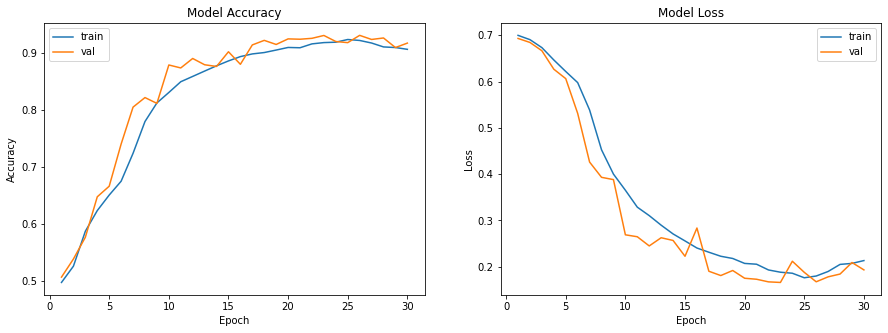

In [24]:
print('train loss:', history.history['loss'][-1])
print('train accuracy:', history.history['output_accuracy'][-1])

print('dev loss:', history.history['val_loss'][-1])
print('dev accuracy:', history.history['val_output_accuracy'][-1])

fig, axs = plt.subplots(1,2,figsize=(15,5))

axs[0].plot(range(1,len(history.history['output_accuracy'])+1), history.history['output_accuracy'])
axs[0].plot(range(1,len(history.history['val_output_accuracy'])+1),history.history['val_output_accuracy'])
axs[0].set_title('Model Accuracy')
axs[0].set_ylabel('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].legend(['train', 'val'], loc='best')

axs[1].plot(range(1,len(history.history['output_loss'])+1),history.history['output_loss'])
axs[1].plot(range(1,len(history.history['val_output_loss'])+1),history.history['val_output_loss'])
axs[1].set_title('Model Loss')
axs[1].set_ylabel('Loss')
axs[1].set_xlabel('Epoch')
axs[1].legend(['train', 'val'], loc='best')

plt.show()

In [25]:
print('train loss:', history.history['loss'][-2])
print('train accuracy:', history.history['output_accuracy'][-2])

print('dev loss:', history.history['val_loss'][-2])
print('dev accuracy:', history.history['val_output_accuracy'][-2])

train loss: 1.0204076766967773
train accuracy: 0.9096222519874573
dev loss: 0.9123575091362
dev accuracy: 0.909600019454956


In [26]:
predictions = model.predict(x_test)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Ide

Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:

Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_predict_function_760442 in device /job:

In [27]:
print(predictions)

pred = np.array(predictions)

print(pred.shape)

[array([[6.9647169e-01, 3.0352828e-01],
       [1.0000000e+00, 2.5980925e-21],
       [9.9999988e-01, 1.4298654e-07],
       ...,
       [1.0544711e-01, 8.9455289e-01],
       [2.3272833e-01, 7.6727170e-01],
       [1.8074097e-02, 9.8192596e-01]], dtype=float32), array([[4.0527511e-01, 5.9472489e-01],
       [1.0000000e+00, 0.0000000e+00],
       [1.0000000e+00, 0.0000000e+00],
       ...,
       [1.6766502e-34, 1.0000000e+00],
       [5.6178127e-08, 1.0000000e+00],
       [2.8263876e-01, 7.1736127e-01]], dtype=float32), array([[6.0673803e-01, 3.9326194e-01],
       [1.0000000e+00, 0.0000000e+00],
       [1.0000000e+00, 1.2277968e-11],
       ...,
       [3.5219053e-03, 9.9647814e-01],
       [8.7359779e-02, 9.1264015e-01],
       [1.8089247e-04, 9.9981910e-01]], dtype=float32)]
(3, 5000, 2)


In [28]:
y_pred = []

for i in pred[2]:
    if i[0] < i[1]:
        y_pred.append(1)
    else:
        y_pred.append(0)

In [29]:
from sklearn.metrics import confusion_matrix

confusion_mtx = confusion_matrix(y_test, y_pred)

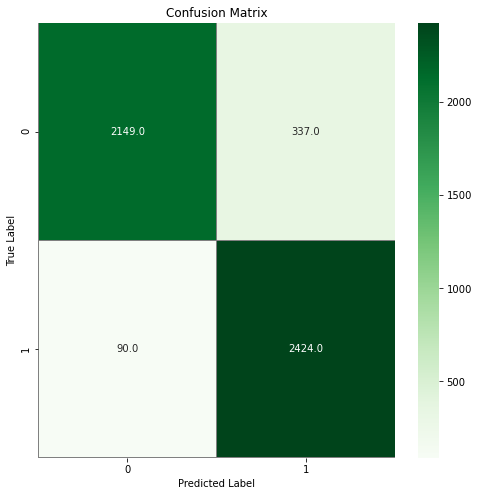

In [30]:
import seaborn as sns

f, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(confusion_mtx, annot=True, linewidths=0.01, cmap="Greens",linecolor="gray", fmt='.1f', ax=ax)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [31]:
from sklearn.metrics import classification_report

# Generate a classification report
report = classification_report(y_test, y_pred, target_names=['cat', 'dog'])

In [32]:
print(report)

              precision    recall  f1-score   support

         cat       0.96      0.86      0.91      2486
         dog       0.88      0.96      0.92      2514

    accuracy                           0.91      5000
   macro avg       0.92      0.91      0.91      5000
weighted avg       0.92      0.91      0.91      5000

